In [1]:
import tensorflow as tf
from tensorflow import keras 
from tensorflow.keras import layers
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import glob
import os

## 数据集

In [2]:
(train_images, train_labels), (_, _) = tf.keras.datasets.mnist.load_data()

train_images = train_images.astype('float32')
train_images = (train_images - 127.5)/127.5 

BATCH_SIZE = 256
BUFFER_SIZE = 60000
class_choose = 10

datasets = tf.data.Dataset.from_tensor_slices(train_images)
datasets = datasets.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [3]:
datasets

<BatchDataset shapes: (None, 28, 28), types: tf.float32>

In [4]:
train_images.shape

(60000, 28, 28)

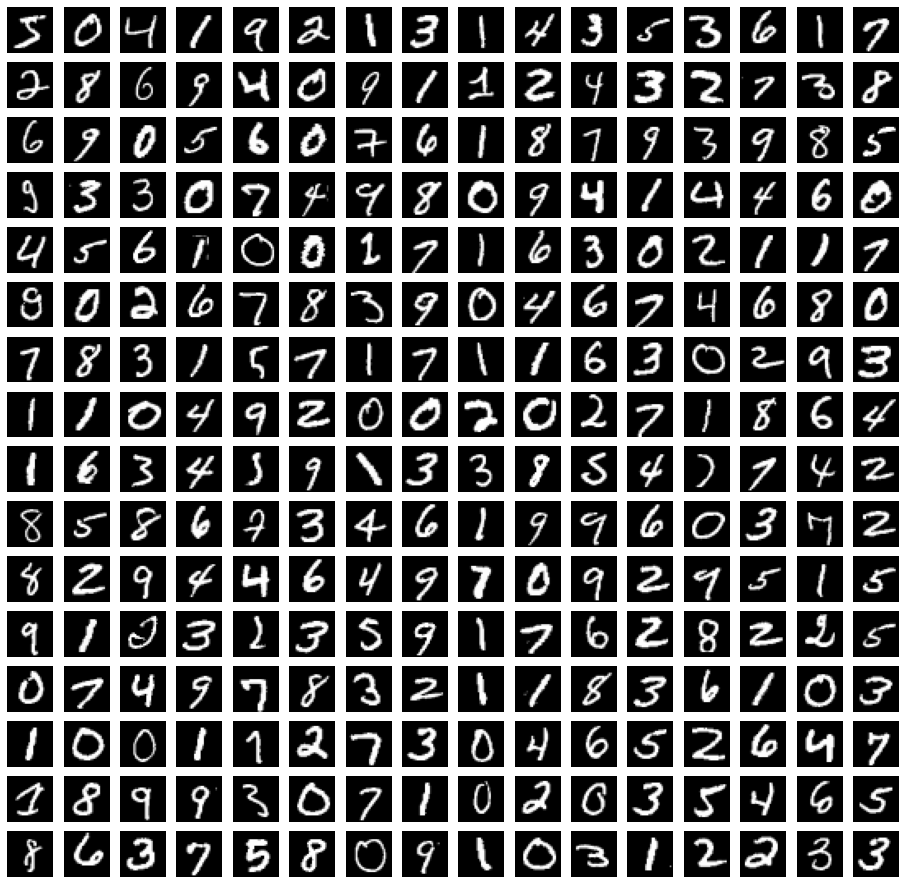

In [5]:
fig = plt.figure(figsize=(16, 16))
for i in range(256):
    plt.subplot(16, 16, i+1)
    plt.imshow(train_images[i, :, :], cmap='gray')
    plt.axis('off')  #不显示坐标轴

In [6]:
train_images_0 = np.zeros((5923, 28, 28))
train_images_1 = np.zeros((6742, 28, 28))
train_images_2 = np.zeros((5958, 28, 28))
train_images_3 = np.zeros((6131, 28, 28))
train_images_4 = np.zeros((5842, 28, 28))
train_images_5 = np.zeros((5421, 28, 28))
train_images_6 = np.zeros((5918, 28, 28))
train_images_7 = np.zeros((6265, 28, 28))
train_images_8 = np.zeros((5851, 28, 28))
train_images_9 = np.zeros((5949, 28, 28))
j_0 = 0
j_1 = 0
j_2 = 0
j_3 = 0
j_4 = 0
j_5 = 0
j_6 = 0
j_7 = 0
j_8 = 0
j_9 = 0
for i in range(60000):
    if train_labels[i]==0:
        train_images_0[j_0] = train_images[i]
        j_0+=1
    if train_labels[i]==1:
        train_images_1[j_1] = train_images[i]
        j_1+=1
    if train_labels[i]==2:
        train_images_2[j_2] = train_images[i]
        j_2+=1
    if train_labels[i]==3:
        train_images_3[j_3] = train_images[i]
        j_3+=1
    if train_labels[i]==4:
        train_images_4[j_4] = train_images[i]
        j_4+=1
    if train_labels[i]==5:
        train_images_5[j_5] = train_images[i]
        j_5+=1
    if train_labels[i]==6:
        train_images_6[j_6] = train_images[i]
        j_6+=1
    if train_labels[i]==7:
        train_images_7[j_7] = train_images[i]
        j_7+=1
    if train_labels[i]==8:
        train_images_8[j_8] = train_images[i]
        j_8+=1
    if train_labels[i]==9:
        train_images_9[j_9] = train_images[i]
        j_9+=1

In [7]:
train_images_0 = train_images_0[0:5888]
datasets_0 = tf.data.Dataset.from_tensor_slices(train_images_0)
datasets_0 = datasets_0.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

## 标签

In [8]:
train_real_labels_one_hot = np.ones([BATCH_SIZE,])
train_fake_labels_one_hot = np.zeros([BATCH_SIZE,])

train_real_labels_one_hot = tf.one_hot(train_real_labels_one_hot, depth=2)
train_fake_labels_one_hot = tf.one_hot(train_fake_labels_one_hot, depth=2)

In [9]:
train_real_labels_one_hot

<tf.Tensor: shape=(256, 2), dtype=float32, numpy=
array([[0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [0., 1.]

## 生成器

In [10]:
def generator_model():
    model = keras.Sequential()
    model.add(layers.Dense(512, input_shape=(100,), use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Dense(512, use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Dense(28*28*1, use_bias=False, activation='tanh'))
    model.add(layers.BatchNormalization())
    
    model.add(layers.Reshape((28, 28, 1)))
    
    return model

## 检测器

In [11]:
def discriminator_model():
    model = keras.Sequential()
    model.add(layers.Flatten())
    
    model.add(layers.Dense(512, use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Dense(256, use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
#     model.add(layers.Dense(1))
    model.add(layers.Dense(2, activation='softmax'))
    
    return model

## 损失函数

In [12]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(
    from_logits=True,
)

In [13]:
def generator_loss(fake_output):
    '''这里想要判别器输出错误，这样才对'''
    return cross_entropy(train_real_labels_one_hot[0:fake_output.shape[0]], fake_output) 

In [14]:
def discriminator_real_loss(real_output):
    real_loss = cross_entropy(train_real_labels_one_hot[0:real_output.shape[0]], real_output)
    return real_loss 

In [15]:
def discriminator_fake_loss(fake_output):
    fake_loss = cross_entropy(train_fake_labels_one_hot[0:fake_output.shape[0]], fake_output)
    return fake_loss

## 训练参数设置

In [16]:
generator_optimizer = tf.keras.optimizers.Adam(3e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(3e-4)

epochs = 100
noise_dim = 100
generate_show_num = 16

## 模型生成

In [17]:
generator = generator_model()
discriminator = discriminator_model()

## 训练步设计

In [18]:
gen_loss_ = []
disc_real_loss_ = []
disc_fake_loss_ = []

def train_steps(images, class_choose):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        real_output = discriminator(images, training=True)
        
        gen_image = generator(noise, training=True)
        fake_output = discriminator(gen_image, training=True)
        
        gen_loss = generator_loss(fake_output)
        disc_real_loss = discriminator_real_loss(real_output)
        disc_fake_loss = discriminator_fake_loss(fake_output)
        disc_loss = disc_real_loss + disc_fake_loss
        
    gradient_gen = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradient_disc = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(gradient_gen, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradient_disc, discriminator.trainable_variables))
    
#     print('real_output:', real_output)
#     print('fake_output:', fake_output)
    print('gen_loss:', gen_loss)
    print('disc_real_loss:', disc_real_loss)
    print('disc_fake_loss:', disc_fake_loss)
    
    gen_loss_.append(gen_loss)
    disc_real_loss_.append(disc_real_loss)
    disc_fake_loss_.append(disc_fake_loss)
    
    if class_choose==10:
        real_o = discriminator(train_images[0:BATCH_SIZE], training=False)
        print('test_discriminator_output:', real_o)


## 模型训练结果展示

In [19]:
def generate_show(generator, show_noise):
    gen_image_show = generator(show_noise, training=False)
    
    fig = plt.figure(figsize=(4, 4))
    for i in range(gen_image_show.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((gen_image_show[i, :, :, 0] + 1)/2, cmap='gray')
        plt.axis('off')  #不显示坐标轴
        
    plt.show()

## 训练函数

In [20]:
def train(datasets, epochs):
    for epoch in range(epochs):
        print(epoch)
        for image_batch in datasets_0:
            train_steps(image_batch, class_choose=class_choose)
#             print(image_batch.shape)
#             print('.', end='')
        generate_show(generator, seed)

## 训练

0
gen_loss: tf.Tensor(0.77532995, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.7778671, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.80070126, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.28783813 0.7121618 ]
 [0.19546878 0.8045312 ]
 [0.1521715  0.84782845]
 [0.22709057 0.77290946]
 [0.23705904 0.762941  ]
 [0.53627276 0.46372727]
 [0.26211706 0.737883  ]
 [0.2175775  0.7824225 ]
 [0.1546246  0.8453754 ]
 [0.18424958 0.8157504 ]
 [0.18808636 0.8119136 ]
 [0.27988753 0.72011244]
 [0.19476688 0.8052331 ]
 [0.27254772 0.7274523 ]
 [0.14816155 0.85183847]
 [0.3765167  0.6234833 ]
 [0.36242858 0.63757145]
 [0.17027889 0.8297211 ]
 [0.3373904  0.66260964]
 [0.17886221 0.8211378 ]
 [0.54632944 0.4536705 ]
 [0.24753629 0.7524637 ]
 [0.24320194 0.756798  ]
 [0.21178661 0.7882134 ]
 [0.36449346 0.63550645]
 [0.27725613 0.72274387]
 [0.34941927 0.65058064]
 [0.19919407 0.8008059 ]
 [0.19312027 0.8068797 ]
 [0.21066052 0.78933954]
 [0.21629204 0.783708  ]
 [0

gen_loss: tf.Tensor(0.74173737, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.72907674, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.7573302, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.3329283  0.6670717 ]
 [0.21707721 0.78292286]
 [0.16497782 0.8350222 ]
 [0.28448972 0.71551025]
 [0.279935   0.72006506]
 [0.5072562  0.49274376]
 [0.30324367 0.6967563 ]
 [0.24999747 0.7500025 ]
 [0.18304943 0.8169506 ]
 [0.21391203 0.786088  ]
 [0.23321868 0.7667813 ]
 [0.31259978 0.6874002 ]
 [0.29313982 0.7068602 ]
 [0.25900853 0.74099153]
 [0.18800636 0.81199366]
 [0.40220925 0.5977908 ]
 [0.36543998 0.63456   ]
 [0.23031825 0.7696818 ]
 [0.3508965  0.64910346]
 [0.22374164 0.77625835]
 [0.5364704  0.4635295 ]
 [0.2860552  0.71394473]
 [0.26645392 0.7335461 ]
 [0.26166788 0.73833215]
 [0.3720402  0.6279598 ]
 [0.30441207 0.69558793]
 [0.37966213 0.62033784]
 [0.27798375 0.7220163 ]
 [0.219874   0.78012604]
 [0.24504444 0.7549556 ]
 [0.2516665  0.7483336 ]
 [0.2

gen_loss: tf.Tensor(0.73660666, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.7227797, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.73971283, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.4470976  0.55290234]
 [0.30608204 0.69391793]
 [0.221475   0.77852494]
 [0.37791964 0.6220803 ]
 [0.3717509  0.6282491 ]
 [0.5588106  0.4411894 ]
 [0.3930918  0.60690826]
 [0.33334112 0.6666588 ]
 [0.25507057 0.74492943]
 [0.31292838 0.6870716 ]
 [0.3143502  0.6856499 ]
 [0.38922846 0.6107716 ]
 [0.37610868 0.6238913 ]
 [0.33141336 0.6685866 ]
 [0.2642539  0.73574615]
 [0.47655675 0.5234433 ]
 [0.42816678 0.5718332 ]
 [0.35307896 0.64692104]
 [0.44622466 0.5537753 ]
 [0.32118636 0.67881364]
 [0.5676653  0.43233472]
 [0.37347966 0.6265204 ]
 [0.35318968 0.64681035]
 [0.34718496 0.65281504]
 [0.44629848 0.55370146]
 [0.3809866  0.6190134 ]
 [0.4515095  0.54849046]
 [0.35988986 0.64011014]
 [0.26306283 0.73693717]
 [0.31524864 0.68475133]
 [0.30147982 0.6985201 ]
 [0.3

gen_loss: tf.Tensor(0.7269101, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.70291656, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.728329, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.5781327  0.42186737]
 [0.40763944 0.5923605 ]
 [0.29912433 0.7008757 ]
 [0.44509137 0.55490863]
 [0.44691357 0.55308646]
 [0.58677596 0.413224  ]
 [0.48444602 0.515554  ]
 [0.42421845 0.5757815 ]
 [0.33548385 0.6645162 ]
 [0.40290582 0.5970942 ]
 [0.39124572 0.6087543 ]
 [0.4635201  0.53647983]
 [0.4249896  0.57501036]
 [0.4040056  0.5959944 ]
 [0.3502138  0.64978623]
 [0.53061944 0.46938062]
 [0.50816613 0.49183393]
 [0.45907834 0.5409216 ]
 [0.54111665 0.4588834 ]
 [0.39745903 0.60254097]
 [0.590438   0.40956196]
 [0.4617488  0.5382512 ]
 [0.41720438 0.58279556]
 [0.4098338  0.5901662 ]
 [0.5112958  0.48870417]
 [0.50202376 0.49797627]
 [0.52068925 0.47931075]
 [0.42305306 0.576947  ]
 [0.3260145  0.6739855 ]
 [0.35114542 0.6488545 ]
 [0.3406256  0.65937436]
 [0.415

gen_loss: tf.Tensor(0.7218051, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.69996774, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.7261882, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.63487023 0.36512974]
 [0.45053345 0.54946655]
 [0.33203185 0.6679681 ]
 [0.45788068 0.5421193 ]
 [0.4744037  0.52559626]
 [0.60255355 0.3974465 ]
 [0.5060781  0.49392194]
 [0.48362568 0.51637435]
 [0.3566959  0.64330405]
 [0.44032598 0.559674  ]
 [0.4372181  0.5627819 ]
 [0.47438738 0.5256126 ]
 [0.41219643 0.58780354]
 [0.41882786 0.5811721 ]
 [0.37653875 0.6234613 ]
 [0.55516315 0.4448369 ]
 [0.53576183 0.46423814]
 [0.5097414  0.49025857]
 [0.56835747 0.4316425 ]
 [0.4303516  0.56964844]
 [0.58964956 0.41035047]
 [0.50588393 0.494116  ]
 [0.44297865 0.55702126]
 [0.4225472  0.57745284]
 [0.5376382  0.46236187]
 [0.5537095  0.44629052]
 [0.54213935 0.45786062]
 [0.46101663 0.5389834 ]
 [0.34989646 0.6501035 ]
 [0.35853156 0.6414685 ]
 [0.3451809  0.6548191 ]
 [0.44

gen_loss: tf.Tensor(0.7154393, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.68945897, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.7197789, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.66771036 0.3322897 ]
 [0.46410158 0.53589845]
 [0.36011901 0.63988096]
 [0.47288454 0.52711546]
 [0.50334716 0.49665284]
 [0.6205804  0.3794197 ]
 [0.51911116 0.48088887]
 [0.53327405 0.46672592]
 [0.37341976 0.62658024]
 [0.48077795 0.519222  ]
 [0.47276774 0.52723217]
 [0.47868997 0.5213101 ]
 [0.39856702 0.601433  ]
 [0.42844516 0.57155484]
 [0.39596736 0.60403264]
 [0.57882506 0.4211749 ]
 [0.5522247  0.4477753 ]
 [0.54898447 0.45101547]
 [0.59187853 0.4081215 ]
 [0.4639669  0.5360331 ]
 [0.59956396 0.400436  ]
 [0.52578086 0.47421914]
 [0.47303113 0.5269689 ]
 [0.4365375  0.56346244]
 [0.55581355 0.44418648]
 [0.5834609  0.41653907]
 [0.56408507 0.4359149 ]
 [0.49178    0.50822   ]
 [0.37047318 0.62952685]
 [0.3695874  0.6304126 ]
 [0.34796926 0.65203077]
 [0.47

gen_loss: tf.Tensor(0.71885216, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6908087, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.71373653, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.68356586 0.31643414]
 [0.455277   0.5447229 ]
 [0.3829985  0.6170015 ]
 [0.48710102 0.512899  ]
 [0.5408233  0.45917675]
 [0.6362386  0.36376143]
 [0.53143346 0.46856657]
 [0.56394756 0.4360525 ]
 [0.3892376  0.61076236]
 [0.5156988  0.48430124]
 [0.4993106  0.5006894 ]
 [0.48252174 0.5174783 ]
 [0.39731285 0.6026872 ]
 [0.43501592 0.5649841 ]
 [0.41332197 0.58667797]
 [0.59665275 0.4033473 ]
 [0.55944633 0.44055367]
 [0.5763471  0.42365286]
 [0.60748893 0.39251104]
 [0.49414828 0.50585175]
 [0.615243   0.38475695]
 [0.52171254 0.4782875 ]
 [0.5000159  0.4999841 ]
 [0.4508109  0.5491891 ]
 [0.56800854 0.43199146]
 [0.5985687  0.40143138]
 [0.58541757 0.41458246]
 [0.510425   0.48957497]
 [0.39241427 0.6075857 ]
 [0.38610512 0.6138949 ]
 [0.35426354 0.6457365 ]
 [0.4

gen_loss: tf.Tensor(0.7215519, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.68390715, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.70600677, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.69564515 0.30435482]
 [0.45655873 0.54344124]
 [0.40835264 0.5916473 ]
 [0.5091477  0.4908522 ]
 [0.58344316 0.41655686]
 [0.6519464  0.3480535 ]
 [0.55352354 0.44647643]
 [0.5848726  0.41512737]
 [0.41495058 0.5850494 ]
 [0.5495059  0.4504941 ]
 [0.5274353  0.4725647 ]
 [0.4977286  0.50227135]
 [0.41520685 0.58479315]
 [0.46127167 0.53872836]
 [0.43748745 0.5625126 ]
 [0.61095697 0.38904297]
 [0.5720896  0.4279104 ]
 [0.6003566  0.39964342]
 [0.63583803 0.36416197]
 [0.5255142  0.4744858 ]
 [0.6398021  0.36019787]
 [0.51956385 0.48043618]
 [0.5339884  0.46601155]
 [0.47350696 0.5264931 ]
 [0.5898083  0.4101917 ]
 [0.62117106 0.3788289 ]
 [0.6166238  0.38337627]
 [0.5249372  0.47506276]
 [0.41355428 0.58644575]
 [0.41328287 0.5867171 ]
 [0.3621091  0.63789093]
 [0.5

gen_loss: tf.Tensor(0.7283771, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6786412, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.70023173, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.70222837 0.2977716 ]
 [0.46655065 0.5334494 ]
 [0.41345924 0.58654076]
 [0.5160302  0.4839699 ]
 [0.60501236 0.39498764]
 [0.6510397  0.34896025]
 [0.56134325 0.43865675]
 [0.590356   0.409644  ]
 [0.42256945 0.5774306 ]
 [0.55451477 0.44548523]
 [0.5412479  0.4587521 ]
 [0.4994856  0.5005144 ]
 [0.43286598 0.567134  ]
 [0.47482526 0.5251747 ]
 [0.4441637  0.5558363 ]
 [0.61051536 0.3894846 ]
 [0.5744318  0.42556816]
 [0.60058683 0.3994131 ]
 [0.6482351  0.35176492]
 [0.52878356 0.47121638]
 [0.64960945 0.3503906 ]
 [0.531578   0.46842203]
 [0.5405049  0.45949513]
 [0.4809408  0.51905924]
 [0.6063319  0.3936681 ]
 [0.6373401  0.36265996]
 [0.6346598  0.36534017]
 [0.53773737 0.4622627 ]
 [0.4147548  0.58524525]
 [0.41742024 0.5825798 ]
 [0.35742444 0.64257556]
 [0.51

 [0.50122964 0.49877036]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(0.7235298, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6774784, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.69799465, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.7063296  0.29367045]
 [0.49466062 0.50533944]
 [0.4004284  0.59957165]
 [0.505712   0.494288  ]
 [0.60843456 0.39156547]
 [0.64242035 0.35757968]
 [0.55868757 0.44131243]
 [0.58677596 0.413224  ]
 [0.41580325 0.5841967 ]
 [0.5449683  0.4550317 ]
 [0.54427457 0.4557255 ]
 [0.49334997 0.50665   ]
 [0.43267122 0.5673288 ]
 [0.47399703 0.52600294]
 [0.43605828 0.5639417 ]
 [0.6008319  0.39916807]
 [0.5717667  0.4282333 ]
 [0.5888395  0.4111605 ]
 [0.6399723  0.3600277 ]
 [0.5154855  0.48451447]
 [0.6414584  0.3585416 ]
 [0.5663911  0.4336089 ]
 [0.5270358  0.4729642 ]
 [0.4714974  0.5285026 ]
 [0.6211931  0.37880692]
 [0.63285524 0.3671448 ]
 [0.6363608  0.36363915]
 [0.54111975 0.45888022]
 [0.38698408 0.61301595

gen_loss: tf.Tensor(0.7307359, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6793915, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.69248307, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.7335088  0.26649112]
 [0.53493965 0.46506035]
 [0.40454823 0.5954517 ]
 [0.50878793 0.4912121 ]
 [0.62050855 0.37949142]
 [0.6357594  0.36424062]
 [0.572972   0.427028  ]
 [0.5938742  0.40612578]
 [0.43047228 0.56952775]
 [0.55185163 0.44814834]
 [0.55946046 0.44053957]
 [0.5082087  0.49179125]
 [0.4256175  0.57438254]
 [0.48244494 0.5175551 ]
 [0.4480956  0.5519045 ]
 [0.6000729  0.39992702]
 [0.5875721  0.41242793]
 [0.58596134 0.41403866]
 [0.6493295  0.35067052]
 [0.51261795 0.48738202]
 [0.6379733  0.3620266 ]
 [0.61703366 0.38296634]
 [0.5274947  0.4725053 ]
 [0.4769667  0.5230333 ]
 [0.6589958  0.34100425]
 [0.62230366 0.37769634]
 [0.660018   0.33998197]
 [0.5468806  0.45311934]
 [0.34381223 0.6561878 ]
 [0.39419386 0.6058062 ]
 [0.3300768  0.6699232 ]
 [0.53

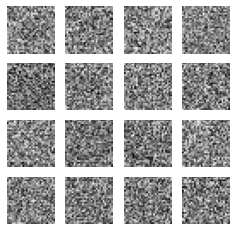

1
gen_loss: tf.Tensor(0.728863, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6668314, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6916141, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.7466541  0.25334594]
 [0.5444185  0.45558158]
 [0.41601294 0.58398706]
 [0.51831955 0.4816805 ]
 [0.6278342  0.37216577]
 [0.638822   0.36117798]
 [0.58414197 0.415858  ]
 [0.60246474 0.39753532]
 [0.44351712 0.5564829 ]
 [0.56185687 0.43814322]
 [0.5704743  0.4295256 ]
 [0.5206844  0.4793156 ]
 [0.4297412  0.5702588 ]
 [0.49268338 0.5073166 ]
 [0.4607014  0.5392986 ]
 [0.60729355 0.3927064 ]
 [0.6015411  0.3984589 ]
 [0.5893052  0.41069478]
 [0.65973383 0.3402662 ]
 [0.51848847 0.4815115 ]
 [0.64384454 0.35615546]
 [0.6273669  0.37263307]
 [0.5357025  0.46429747]
 [0.4866004  0.51339954]
 [0.6751065  0.3248934 ]
 [0.6237074  0.37629256]
 [0.67461497 0.32538503]
 [0.5529359  0.44706407]
 [0.34189436 0.6581056 ]
 [0.40171742 0.5982826 ]
 [0.33661458 0.6633854 ]
 [0.54

gen_loss: tf.Tensor(0.73061454, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6620429, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6883495, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.77456063 0.22543934]
 [0.5535661  0.44643387]
 [0.43953535 0.56046456]
 [0.537108   0.46289203]
 [0.6419626  0.3580374 ]
 [0.6502803  0.34971973]
 [0.60678226 0.39321777]
 [0.63184017 0.3681598 ]
 [0.46816975 0.53183025]
 [0.5825381  0.41746187]
 [0.5995206  0.40047935]
 [0.5417284  0.45827165]
 [0.4434514  0.5565486 ]
 [0.5170918  0.4829082 ]
 [0.48577222 0.51422775]
 [0.62139744 0.37860262]
 [0.63409984 0.3659002 ]
 [0.6001333  0.3998667 ]
 [0.682661   0.31733897]
 [0.5335101  0.4664899 ]
 [0.6563645  0.3436355 ]
 [0.63114446 0.36885557]
 [0.55613303 0.44386697]
 [0.5063269  0.49367303]
 [0.7004023  0.2995977 ]
 [0.6408104  0.35918957]
 [0.7020594  0.29794058]
 [0.5732382  0.42676178]
 [0.356377   0.64362305]
 [0.4153618  0.5846382 ]
 [0.34916058 0.6508394 ]
 [0.56

gen_loss: tf.Tensor(0.73186994, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.662522, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.68590534, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8069203  0.19307967]
 [0.56869316 0.43130684]
 [0.47092512 0.52907497]
 [0.563542   0.436458  ]
 [0.6593241  0.34067598]
 [0.6689196  0.33108035]
 [0.6306701  0.36932993]
 [0.680302   0.319698  ]
 [0.4951466  0.50485337]
 [0.60390574 0.39609432]
 [0.6425365  0.35746348]
 [0.5598954  0.44010457]
 [0.47029784 0.52970225]
 [0.5436702  0.4563298 ]
 [0.5120923  0.4879077 ]
 [0.64142233 0.35857764]
 [0.6697321  0.33026794]
 [0.6256851  0.3743148 ]
 [0.7118414  0.28815857]
 [0.55724376 0.44275627]
 [0.6738973  0.32610264]
 [0.6341446  0.36585546]
 [0.58364475 0.41635525]
 [0.5319428  0.46805727]
 [0.72217745 0.27782252]
 [0.67281365 0.3271863 ]
 [0.7289868  0.27101317]
 [0.6125098  0.38749024]
 [0.38877723 0.6112228 ]
 [0.43193787 0.56806207]
 [0.36524874 0.63475126]
 [0.58

gen_loss: tf.Tensor(0.730623, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.66610485, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.68277985, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.83357793 0.16642205]
 [0.5899086  0.41009137]
 [0.4926763  0.50732374]
 [0.5849483  0.41505173]
 [0.6710505  0.32894957]
 [0.6866733  0.3133267 ]
 [0.64592487 0.35407516]
 [0.7227622  0.27723777]
 [0.5153769  0.48462307]
 [0.6223616  0.3776384 ]
 [0.6817661  0.3182339 ]
 [0.57228917 0.42771077]
 [0.4871084  0.51289153]
 [0.5564701  0.4435299 ]
 [0.52952385 0.47047618]
 [0.66198075 0.33801922]
 [0.6964483  0.3035517 ]
 [0.6508517  0.3491482 ]
 [0.72849876 0.2715012 ]
 [0.5803675  0.41963252]
 [0.67790973 0.32209033]
 [0.6466792  0.35332075]
 [0.60346746 0.3965325 ]
 [0.5535383  0.4464617 ]
 [0.74145234 0.2585477 ]
 [0.692144   0.30785602]
 [0.74950355 0.25049645]
 [0.64566773 0.35433224]
 [0.41187435 0.58812565]
 [0.44143215 0.5585678 ]
 [0.3730105  0.6269895 ]
 [0.61

gen_loss: tf.Tensor(0.7359173, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6601979, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6780464, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8487001  0.15129983]
 [0.6131449  0.38685513]
 [0.5032944  0.49670562]
 [0.596088   0.403912  ]
 [0.67054075 0.32945925]
 [0.69372874 0.3062713 ]
 [0.646454   0.35354602]
 [0.7453375  0.25466254]
 [0.5230323  0.47696763]
 [0.6324848  0.36751515]
 [0.70423174 0.2957682 ]
 [0.5797779  0.42022207]
 [0.49698153 0.50301844]
 [0.54447114 0.4555288 ]
 [0.5355574  0.46444264]
 [0.6748193  0.32518065]
 [0.7065594  0.2934406 ]
 [0.66296154 0.3370385 ]
 [0.7272217  0.2727783 ]
 [0.59341866 0.40658134]
 [0.66409826 0.33590174]
 [0.6691995  0.33080047]
 [0.6048802  0.39511982]
 [0.5632566  0.43674338]
 [0.75302917 0.24697086]
 [0.6930751  0.30692482]
 [0.7583617  0.2416383 ]
 [0.66703653 0.33296347]
 [0.41910183 0.58089817]
 [0.43920866 0.5607914 ]
 [0.3717816  0.6282184 ]
 [0.637

gen_loss: tf.Tensor(0.7382988, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6604169, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.67607164, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.85635054 0.14364938]
 [0.63869524 0.36130473]
 [0.5054556  0.4945444 ]
 [0.6030176  0.39698243]
 [0.66803604 0.33196396]
 [0.69571227 0.3042877 ]
 [0.639788   0.36021206]
 [0.75737554 0.24262448]
 [0.52485925 0.4751407 ]
 [0.6313643  0.36863568]
 [0.7178658  0.2821342 ]
 [0.5882794  0.41172054]
 [0.5069534  0.49304658]
 [0.5291022  0.47089773]
 [0.5361567  0.46384335]
 [0.68208516 0.31791484]
 [0.70752317 0.2924769 ]
 [0.66720974 0.33279026]
 [0.71854424 0.28145576]
 [0.59506774 0.40493226]
 [0.64981765 0.35018232]
 [0.69611084 0.3038892 ]
 [0.5962895  0.40371048]
 [0.56958014 0.4304199 ]
 [0.7581212  0.24187881]
 [0.6909265  0.30907357]
 [0.76184374 0.23815627]
 [0.68488467 0.31511533]
 [0.41549122 0.5845088 ]
 [0.43596336 0.56403667]
 [0.36707756 0.6329225 ]
 [0.64

gen_loss: tf.Tensor(0.74183565, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.65985334, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.67313933, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.86305106 0.13694893]
 [0.667273   0.33272702]
 [0.51295024 0.48704973]
 [0.61319345 0.38680652]
 [0.67717737 0.32282257]
 [0.70675963 0.29324034]
 [0.6430707  0.35692924]
 [0.7714191  0.2285809 ]
 [0.53507644 0.4649236 ]
 [0.636075   0.363925  ]
 [0.7365331  0.2634669 ]
 [0.60168165 0.39831838]
 [0.5348226  0.4651774 ]
 [0.5352889  0.46471116]
 [0.5450536  0.45494637]
 [0.69050246 0.30949748]
 [0.71330076 0.2866992 ]
 [0.67472816 0.3252718 ]
 [0.7230469  0.2769531 ]
 [0.60193634 0.3980636 ]
 [0.648194   0.35180598]
 [0.72085786 0.2791421 ]
 [0.5977885  0.4022115 ]
 [0.5810164  0.4189836 ]
 [0.76844835 0.23155162]
 [0.69532084 0.30467913]
 [0.76968914 0.23031081]
 [0.70650214 0.29349786]
 [0.41632357 0.5836764 ]
 [0.4437133  0.55628675]
 [0.37100077 0.62899923]
 [0.

 [0.73788756 0.26211253]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(0.74411374, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.66045964, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6691596, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8667161  0.13328393]
 [0.6902608  0.30973914]
 [0.52466834 0.47533172]
 [0.6176547  0.38234526]
 [0.6854606  0.31453937]
 [0.71197665 0.28802332]
 [0.65120655 0.34879354]
 [0.78116375 0.21883628]
 [0.54548705 0.4545129 ]
 [0.6350656  0.36493447]
 [0.7517729  0.24822718]
 [0.61407954 0.3859205 ]
 [0.56444204 0.43555796]
 [0.5465812  0.4534188 ]
 [0.5551721  0.4448279 ]
 [0.69410264 0.30589733]
 [0.71971893 0.28028104]
 [0.67428267 0.32571733]
 [0.73334384 0.26665616]
 [0.6038527  0.39614734]
 [0.6478374  0.35216257]
 [0.7390952  0.26090473]
 [0.5948609  0.40513915]
 [0.588773   0.411227  ]
 [0.7785497  0.22145037]
 [0.7043364  0.29566357]
 [0.7759393  0.22406076]
 [0.7216202  0.2783798 ]
 [0.416642   0.583358 

gen_loss: tf.Tensor(0.75096464, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6500898, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.66121864, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.87298745 0.12701249]
 [0.71674776 0.28325227]
 [0.5509781  0.44902188]
 [0.6376682  0.36233184]
 [0.703551   0.296449  ]
 [0.7294305  0.27056956]
 [0.6763007  0.32369927]
 [0.7984095  0.20159045]
 [0.56916726 0.43083268]
 [0.653459   0.34654102]
 [0.78257525 0.21742478]
 [0.64406973 0.3559303 ]
 [0.59052145 0.40947855]
 [0.5819895  0.41801047]
 [0.57793194 0.42206812]
 [0.7086887  0.29131132]
 [0.7448698  0.25513014]
 [0.68602055 0.31397942]
 [0.7610871  0.23891282]
 [0.6228231  0.37717688]
 [0.6573106  0.34268937]
 [0.75639594 0.24360405]
 [0.60952425 0.39047578]
 [0.610237   0.38976297]
 [0.79870594 0.20129406]
 [0.71722174 0.28277823]
 [0.7897871  0.21021283]
 [0.7388636  0.2611364 ]
 [0.423262   0.576738  ]
 [0.46927842 0.5307216 ]
 [0.39685157 0.60314834]
 [0.6

gen_loss: tf.Tensor(0.74857014, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6510383, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.66244745, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8764055  0.12359452]
 [0.7324449  0.26755503]
 [0.55901253 0.4409875 ]
 [0.6518646  0.34813538]
 [0.7140771  0.28592288]
 [0.7402397  0.25976026]
 [0.6898182  0.3101818 ]
 [0.8061905  0.19380946]
 [0.57904416 0.4209559 ]
 [0.6643035  0.33569655]
 [0.7992092  0.2007909 ]
 [0.65927655 0.34072343]
 [0.5947159  0.40528408]
 [0.60155505 0.398445  ]
 [0.58984715 0.41015285]
 [0.7208537  0.27914634]
 [0.76073855 0.23926137]
 [0.69485253 0.30514747]
 [0.7723731  0.2276269 ]
 [0.6349158  0.3650841 ]
 [0.6628159  0.3371841 ]
 [0.76671267 0.23328729]
 [0.620896   0.37910396]
 [0.6241417  0.37585834]
 [0.81302184 0.18697816]
 [0.72419214 0.27580783]
 [0.7974779  0.20252204]
 [0.7437744  0.2562255 ]
 [0.42696404 0.57303596]
 [0.481128   0.51887196]
 [0.40770748 0.5922925 ]
 [0.6

gen_loss: tf.Tensor(0.74352825, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.65194035, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.66800404, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8777726  0.12222739]
 [0.7468748  0.25312516]
 [0.5546467  0.44535336]
 [0.6530857  0.3469143 ]
 [0.7156349  0.28436503]
 [0.7406126  0.25938737]
 [0.6924657  0.30753428]
 [0.8080302  0.19196987]
 [0.5780881  0.42191184]
 [0.65848637 0.34151363]
 [0.80737245 0.19262753]
 [0.6647541  0.3352459 ]
 [0.59199864 0.40800127]
 [0.59998095 0.40001902]
 [0.5914032  0.40859678]
 [0.7254646  0.27453536]
 [0.7675781  0.23242183]
 [0.69490874 0.3050913 ]
 [0.77232796 0.22767206]
 [0.6349487  0.3650513 ]
 [0.6550023  0.34499767]
 [0.778772   0.22122797]
 [0.62025356 0.3797464 ]
 [0.6250956  0.37490436]
 [0.82030255 0.17969747]
 [0.7261873  0.2738127 ]
 [0.7964973  0.20350271]
 [0.74261683 0.25738317]
 [0.42050233 0.57949764]
 [0.47789133 0.52210873]
 [0.4128299  0.5871701 ]
 [0.

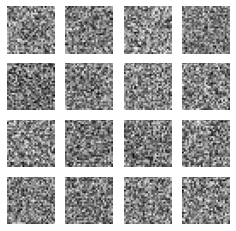

2
gen_loss: tf.Tensor(0.7545484, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.64439535, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6567228, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.87648726 0.12351277]
 [0.7506796  0.24932043]
 [0.54762185 0.4523782 ]
 [0.6486047  0.35139534]
 [0.7144086  0.2855914 ]
 [0.73703736 0.2629626 ]
 [0.6907442  0.30925572]
 [0.8060687  0.19393127]
 [0.5742833  0.4257167 ]
 [0.6534988  0.34650108]
 [0.81192523 0.18807471]
 [0.6656462  0.33435383]
 [0.5921983  0.40780172]
 [0.5886619  0.41133806]
 [0.5883616  0.4116384 ]
 [0.7283512  0.2716488 ]
 [0.76869094 0.23130909]
 [0.6948457  0.3051543 ]
 [0.76902586 0.23097411]
 [0.63540906 0.36459094]
 [0.643979   0.35602096]
 [0.78435534 0.21564473]
 [0.61730814 0.38269186]
 [0.6230932  0.3769068 ]
 [0.82428545 0.17571454]
 [0.72322285 0.27677715]
 [0.79362744 0.20637257]
 [0.73952574 0.2604743 ]
 [0.42029202 0.579708  ]
 [0.47280508 0.52719486]
 [0.41862774 0.5813722 ]
 [0.

gen_loss: tf.Tensor(0.75136334, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.64189947, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.65795445, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8786572  0.12134279]
 [0.75484747 0.24515252]
 [0.54976666 0.45023334]
 [0.65124905 0.34875098]
 [0.72042024 0.2795798 ]
 [0.74100137 0.2589987 ]
 [0.6958046  0.30419534]
 [0.8128232  0.18717682]
 [0.5802243  0.41977575]
 [0.6611789  0.33882105]
 [0.82111514 0.17888492]
 [0.67009807 0.32990193]
 [0.5988715  0.4011285 ]
 [0.58387256 0.41612744]
 [0.5929329  0.40706712]
 [0.736107   0.26389304]
 [0.77679455 0.22320548]
 [0.70493364 0.2950664 ]
 [0.77343    0.22656995]
 [0.644884   0.35511607]
 [0.63906103 0.360939  ]
 [0.7908958  0.20910417]
 [0.62816215 0.37183788]
 [0.6277097  0.3722903 ]
 [0.83257324 0.16742675]
 [0.72336906 0.27663094]
 [0.7993135  0.20068651]
 [0.74216217 0.25783777]
 [0.42517865 0.57482135]
 [0.4770317  0.5229683 ]
 [0.43068397 0.56931597]
 [0.

gen_loss: tf.Tensor(0.75519276, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.63929796, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.653872, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8841235  0.11587653]
 [0.76259935 0.23740062]
 [0.557858   0.44214198]
 [0.65617305 0.34382698]
 [0.7303859  0.26961404]
 [0.7491994  0.25080058]
 [0.7021657  0.29783425]
 [0.8275252  0.17247476]
 [0.587103   0.41289696]
 [0.6694236  0.3305764 ]
 [0.83322287 0.1667771 ]
 [0.67217886 0.32782114]
 [0.6095423  0.39045766]
 [0.5889962  0.4110038 ]
 [0.59925133 0.4007486 ]
 [0.7491788  0.2508211 ]
 [0.7897647  0.21023534]
 [0.71714664 0.2828534 ]
 [0.78285086 0.21714912]
 [0.65623343 0.34376654]
 [0.6430636  0.35693634]
 [0.7980925  0.2019075 ]
 [0.6461708  0.3538292 ]
 [0.63445085 0.36554912]
 [0.8419445  0.15805548]
 [0.7296125  0.27038744]
 [0.80808324 0.19191675]
 [0.75189066 0.24810934]
 [0.4397952  0.56020474]
 [0.48662013 0.5133799 ]
 [0.44338214 0.5566179 ]
 [0.67

gen_loss: tf.Tensor(0.7585819, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6305493, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.65099084, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8879514  0.11204863]
 [0.7717403  0.2282597 ]
 [0.5594652  0.44053483]
 [0.6548032  0.34519678]
 [0.73464406 0.26535597]
 [0.75237584 0.24762414]
 [0.6988439  0.301156  ]
 [0.8424889  0.15751106]
 [0.58306295 0.41693702]
 [0.6681473  0.33185264]
 [0.84346384 0.15653619]
 [0.66688067 0.3331193 ]
 [0.6175158  0.38248423]
 [0.59015703 0.409843  ]
 [0.5959021  0.40409797]
 [0.7560835  0.24391653]
 [0.8003838  0.19961627]
 [0.72177815 0.2782219 ]
 [0.7848842  0.21511574]
 [0.6570583  0.3429417 ]
 [0.64947516 0.3505249 ]
 [0.80481935 0.19518061]
 [0.65299433 0.34700564]
 [0.63475    0.36525   ]
 [0.8469248  0.15307517]
 [0.73937094 0.26062903]
 [0.81043905 0.18956098]
 [0.76475024 0.23524979]
 [0.45064202 0.54935795]
 [0.48739758 0.51260245]
 [0.44771928 0.5522808 ]
 [0.68

 [0.83099973 0.16900033]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(0.76666486, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.63370633, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6451894, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.89064115 0.10935887]
 [0.77916014 0.2208399 ]
 [0.5625717  0.4374283 ]
 [0.6561485  0.34385148]
 [0.73398095 0.26601902]
 [0.75075233 0.2492476 ]
 [0.69356275 0.3064373 ]
 [0.8542131  0.14578682]
 [0.5776419  0.42235804]
 [0.6670314  0.33296856]
 [0.8524237  0.14757624]
 [0.6656142  0.33438575]
 [0.62164664 0.3783534 ]
 [0.5889277  0.41107228]
 [0.5924813  0.40751863]
 [0.7589947  0.24100533]
 [0.8092282  0.19077183]
 [0.7211331  0.27886695]
 [0.7850731  0.21492696]
 [0.65589434 0.3441056 ]
 [0.6547359  0.3452641 ]
 [0.8096438  0.19035618]
 [0.6576043  0.34239575]
 [0.6363167  0.36368325]
 [0.84989935 0.15010057]
 [0.74464756 0.25535244]
 [0.811915   0.18808508]
 [0.7732566  0.22674337]
 [0.452197   0.5478030

gen_loss: tf.Tensor(0.7700582, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.62584686, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.63876426, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8899836  0.11001641]
 [0.78655386 0.21344608]
 [0.55796486 0.4420351 ]
 [0.65822285 0.34177718]
 [0.7279609  0.2720391 ]
 [0.7443823  0.25561774]
 [0.6825244  0.31747562]
 [0.8641578  0.13584217]
 [0.5644151  0.4355849 ]
 [0.6636257  0.33637428]
 [0.85938764 0.14061244]
 [0.6677294  0.3322706 ]
 [0.62029636 0.37970367]
 [0.57489276 0.42510724]
 [0.5797485  0.4202515 ]
 [0.76106656 0.23893343]
 [0.8142858  0.1857142 ]
 [0.7191204  0.28087962]
 [0.78014445 0.2198555 ]
 [0.64771193 0.35228807]
 [0.64850247 0.35149747]
 [0.8185139  0.1814862 ]
 [0.6567987  0.3432013 ]
 [0.6387945  0.36120552]
 [0.85539716 0.14460288]
 [0.7374574  0.2625426 ]
 [0.8116772  0.18832278]
 [0.781059   0.21894106]
 [0.43476173 0.5652383 ]
 [0.48782593 0.51217407]
 [0.43374252 0.5662574 ]
 [0.6

gen_loss: tf.Tensor(0.76801467, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.62920344, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.64166975, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8905295  0.10947047]
 [0.7899317  0.2100683 ]
 [0.5591009  0.44089907]
 [0.66045094 0.3395491 ]
 [0.7282345  0.27176544]
 [0.7460737  0.25392634]
 [0.6816566  0.31834337]
 [0.87022007 0.12977992]
 [0.5628719  0.4371282 ]
 [0.6683377  0.3316623 ]
 [0.86468977 0.1353102 ]
 [0.6755119  0.32448807]
 [0.6204933  0.37950674]
 [0.5737364  0.42626357]
 [0.57724607 0.42275396]
 [0.764749   0.23525098]
 [0.8194641  0.1805359 ]
 [0.71902436 0.28097558]
 [0.78342915 0.21657087]
 [0.6466544  0.35334563]
 [0.6484243  0.35157564]
 [0.822667   0.177333  ]
 [0.66118664 0.33881333]
 [0.64277124 0.35722876]
 [0.8624289  0.13757114]
 [0.73749685 0.26250312]
 [0.81489176 0.18510824]
 [0.7875722  0.21242781]
 [0.42464337 0.5753566 ]
 [0.49823725 0.50176275]
 [0.432247   0.56775296]
 [0.

gen_loss: tf.Tensor(0.76570845, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6290779, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.642051, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8938311  0.10616893]
 [0.7965901  0.20340998]
 [0.57012594 0.42987412]
 [0.66961193 0.33038813]
 [0.73520046 0.26479948]
 [0.7527842  0.24721579]
 [0.68755764 0.3124424 ]
 [0.8748411  0.12515889]
 [0.57461685 0.42538312]
 [0.6825527  0.3174473 ]
 [0.87200475 0.12799525]
 [0.6930958  0.30690414]
 [0.62102133 0.37897876]
 [0.5789423  0.42105764]
 [0.5876051  0.41239497]
 [0.7714977  0.22850232]
 [0.82660997 0.17339009]
 [0.724943   0.275057  ]
 [0.7950927  0.20490725]
 [0.65649605 0.34350395]
 [0.64981335 0.3501867 ]
 [0.827344   0.17265601]
 [0.67741096 0.3225891 ]
 [0.6543198  0.34568012]
 [0.87326616 0.12673378]
 [0.7371386  0.2628614 ]
 [0.8224344  0.17756557]
 [0.7905536  0.20944636]
 [0.4152363  0.58476365]
 [0.5205232  0.47947675]
 [0.43706563 0.56293434]
 [0.687

gen_loss: tf.Tensor(0.7808275, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.63222563, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.63315916, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8996127  0.10038724]
 [0.8054976  0.19450246]
 [0.58286524 0.4171347 ]
 [0.6833196  0.31668037]
 [0.7432728  0.25672716]
 [0.7598207  0.24017935]
 [0.69787806 0.30212194]
 [0.8795749  0.12042507]
 [0.5927791  0.40722084]
 [0.70082575 0.2991743 ]
 [0.8820459  0.11795404]
 [0.71656066 0.28343937]
 [0.6225721  0.37742788]
 [0.58558923 0.41441077]
 [0.6039096  0.3960903 ]
 [0.78000957 0.21999048]
 [0.8364795  0.16352051]
 [0.73433334 0.26566663]
 [0.80764467 0.19235535]
 [0.6718818  0.32811818]
 [0.6484252  0.35157475]
 [0.8341853  0.16581473]
 [0.6963917  0.3036083 ]
 [0.6693066  0.33069348]
 [0.8854769  0.11452308]
 [0.7360081  0.26399192]
 [0.8326887  0.16731137]
 [0.7934568  0.20654319]
 [0.4048027  0.59519726]
 [0.5420484  0.45795155]
 [0.44372484 0.5562751 ]
 [0.6

gen_loss: tf.Tensor(0.78222805, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6298686, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6289674, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.90381616 0.09618385]
 [0.8148384  0.18516162]
 [0.5885355  0.41146445]
 [0.69201577 0.3079842 ]
 [0.7477277  0.25227234]
 [0.76142085 0.23857912]
 [0.7016317  0.29836825]
 [0.8826448  0.11735529]
 [0.6037797  0.3962203 ]
 [0.7107609  0.2892391 ]
 [0.8890817  0.11091826]
 [0.73445064 0.2655494 ]
 [0.62047935 0.37952068]
 [0.5847801  0.4152199 ]
 [0.61373013 0.38626984]
 [0.7846878  0.21531214]
 [0.8445851  0.15541483]
 [0.7388395  0.26116046]
 [0.81513214 0.1848679 ]
 [0.67779845 0.32220152]
 [0.6430972  0.35690278]
 [0.84237975 0.15762019]
 [0.70879835 0.29120162]
 [0.67752105 0.32247898]
 [0.89251727 0.10748281]
 [0.74062175 0.25937828]
 [0.8396231  0.16037686]
 [0.7954053  0.20459466]
 [0.3991988  0.60080117]
 [0.5505859  0.44941404]
 [0.4466849  0.5533151 ]
 [0.69

gen_loss: tf.Tensor(0.7852746, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6360636, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6269257, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9041641  0.09583594]
 [0.8188605  0.18113951]
 [0.5847081  0.4152919 ]
 [0.69427437 0.30572566]
 [0.7496813  0.25031877]
 [0.7611544  0.23884559]
 [0.6981981  0.301802  ]
 [0.8813187  0.11868133]
 [0.6063572  0.39364272]
 [0.71759415 0.28240582]
 [0.8921442  0.10785581]
 [0.74787647 0.25212353]
 [0.6129471  0.38705292]
 [0.57267565 0.4273244 ]
 [0.6144365  0.38556352]
 [0.7907567  0.20924333]
 [0.8492732  0.15072674]
 [0.73997957 0.26002046]
 [0.81254923 0.18745078]
 [0.68057364 0.31942636]
 [0.6334464  0.36655357]
 [0.8466412  0.15335885]
 [0.71435493 0.28564504]
 [0.68009436 0.3199057 ]
 [0.8964331  0.10356684]
 [0.738266   0.26173404]
 [0.84189576 0.15810424]
 [0.79375833 0.20624168]
 [0.39972135 0.6002787 ]
 [0.55532473 0.4446752 ]
 [0.44847307 0.55152696]
 [0.698

 [0.8555842  0.14441578]], shape=(256, 2), dtype=float32)


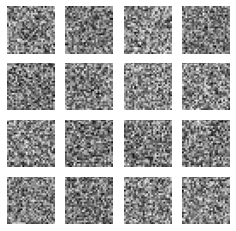

3
gen_loss: tf.Tensor(0.7870034, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.61757064, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.623382, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9082195  0.09178047]
 [0.82849395 0.17150605]
 [0.58486223 0.4151378 ]
 [0.69678926 0.30321077]
 [0.75602674 0.24397326]
 [0.7658335  0.23416646]
 [0.6987995  0.30120048]
 [0.8879197  0.11208034]
 [0.610327   0.38967305]
 [0.72498804 0.27501196]
 [0.8996084  0.10039163]
 [0.7577569  0.24224314]
 [0.61627305 0.38372695]
 [0.5783612  0.42163873]
 [0.6173628  0.38263717]
 [0.79898477 0.20101528]
 [0.855481   0.14451902]
 [0.74853796 0.25146207]
 [0.8180559  0.18194404]
 [0.68686634 0.31313363]
 [0.6304028  0.3695972 ]
 [0.8524866  0.14751345]
 [0.7220419  0.27795804]
 [0.68268436 0.31731567]
 [0.8985795  0.10142049]
 [0.7484666  0.25153342]
 [0.84634215 0.15365793]
 [0.8030799  0.19692005]
 [0.41448644 0.5855136 ]
 [0.5605002  0.4394998 ]
 [0.44798875 0.5520113 ]
 [0.7

gen_loss: tf.Tensor(0.7839507, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6054026, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.62561154, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.91541755 0.08458243]
 [0.84186727 0.15813278]
 [0.5921499  0.40785012]
 [0.7040192  0.2959809 ]
 [0.764613   0.23538701]
 [0.7748062  0.22519378]
 [0.7049982  0.29500178]
 [0.89886016 0.10113983]
 [0.6192127  0.3807873 ]
 [0.7379075  0.26209253]
 [0.9087581  0.09124184]
 [0.7654377  0.23456223]
 [0.6219958  0.3780042 ]
 [0.5995865  0.40041357]
 [0.62626404 0.3737359 ]
 [0.8080222  0.19197777]
 [0.86206365 0.1379363 ]
 [0.7625038  0.2374962 ]
 [0.8304843  0.16951574]
 [0.69727564 0.30272433]
 [0.63472843 0.36527157]
 [0.85987484 0.14012513]
 [0.73577344 0.2642266 ]
 [0.68939704 0.31060293]
 [0.90211064 0.09788938]
 [0.7629604  0.23703964]
 [0.8540515  0.14594854]
 [0.8181053  0.18189469]
 [0.42840257 0.57159746]
 [0.57065624 0.42934373]
 [0.44898796 0.5510121 ]
 [0.72

gen_loss: tf.Tensor(0.7906258, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.61294955, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6205696, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.91986924 0.08013072]
 [0.8509028  0.14909728]
 [0.59226096 0.40773904]
 [0.7067017  0.2932983 ]
 [0.7671331  0.23286691]
 [0.77315956 0.22684047]
 [0.70676583 0.29323417]
 [0.9054447  0.09455536]
 [0.6226381  0.37736183]
 [0.7387219  0.26127812]
 [0.91352206 0.08647795]
 [0.7690827  0.23091729]
 [0.6277099  0.37229007]
 [0.60548174 0.39451823]
 [0.6288456  0.37115446]
 [0.812391   0.18760899]
 [0.86458516 0.13541484]
 [0.7701472  0.2298528 ]
 [0.83474344 0.1652566 ]
 [0.7005683  0.29943165]
 [0.6316813  0.36831868]
 [0.8662194  0.13378058]
 [0.74234116 0.2576588 ]
 [0.692336   0.30766395]
 [0.90370244 0.09629755]
 [0.7727523  0.22724773]
 [0.85795397 0.14204608]
 [0.8283268  0.17167325]
 [0.43233675 0.56766325]
 [0.5720111  0.4279889 ]
 [0.45117912 0.54882085]
 [0.73

gen_loss: tf.Tensor(0.7905744, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6105046, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.61991644, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9235414  0.07645861]
 [0.85241646 0.14758356]
 [0.5966932  0.40330675]
 [0.7119637  0.2880363 ]
 [0.76954997 0.23045005]
 [0.7699865  0.23001349]
 [0.7097119  0.2902881 ]
 [0.90771514 0.09228488]
 [0.6301475  0.36985254]
 [0.7402039  0.25979614]
 [0.9156074  0.08439259]
 [0.7776273  0.22237268]
 [0.6324896  0.36751038]
 [0.605611   0.39438894]
 [0.63397807 0.36602193]
 [0.81659895 0.1834011 ]
 [0.8654737  0.1345263 ]
 [0.7768982  0.22310182]
 [0.83721274 0.16278726]
 [0.7061169  0.2938831 ]
 [0.62384814 0.3761518 ]
 [0.8690888  0.13091113]
 [0.74943733 0.2505626 ]
 [0.6985263  0.30147365]
 [0.907105   0.09289494]
 [0.7725283  0.22747168]
 [0.86213404 0.13786596]
 [0.83205    0.16794994]
 [0.43461922 0.5653807 ]
 [0.5770673  0.42293265]
 [0.46182123 0.53817874]
 [0.73

gen_loss: tf.Tensor(0.80018866, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6042874, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6123129, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9288766  0.07112346]
 [0.8532215  0.14677858]
 [0.60681576 0.3931842 ]
 [0.7237277  0.2762723 ]
 [0.7758651  0.22413492]
 [0.77132106 0.2286789 ]
 [0.71893126 0.2810687 ]
 [0.91137946 0.0886206 ]
 [0.64325464 0.35674533]
 [0.74769926 0.25230068]
 [0.91978645 0.08021357]
 [0.7910849  0.20891513]
 [0.63529843 0.3647016 ]
 [0.60955966 0.39044037]
 [0.64336365 0.35663638]
 [0.82403636 0.17596358]
 [0.8699339  0.13006614]
 [0.7888917  0.21110831]
 [0.84223443 0.1577655 ]
 [0.71766573 0.28233427]
 [0.6207838  0.3792162 ]
 [0.87250876 0.12749127]
 [0.76093906 0.23906094]
 [0.71164006 0.28835994]
 [0.9126298  0.08737019]
 [0.7718996  0.2281004 ]
 [0.86933625 0.13066371]
 [0.8365346  0.16346534]
 [0.43787938 0.5621206 ]
 [0.5903184  0.40968162]
 [0.47473755 0.5252625 ]
 [0.74

gen_loss: tf.Tensor(0.7986266, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.61297154, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.61370987, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9388874  0.06111252]
 [0.85246986 0.14753008]
 [0.628078   0.371922  ]
 [0.7428468  0.2571532 ]
 [0.7919634  0.20803653]
 [0.78458846 0.21541159]
 [0.7391331  0.26086694]
 [0.92093086 0.07906912]
 [0.66533965 0.33466038]
 [0.76545316 0.23454686]
 [0.9305847  0.06941525]
 [0.8048314  0.19516854]
 [0.6449018  0.35509816]
 [0.6297086  0.37029144]
 [0.66244733 0.3375527 ]
 [0.8379279  0.16207218]
 [0.885402   0.11459795]
 [0.8099745  0.19002552]
 [0.8594757  0.14052439]
 [0.74363667 0.2563634 ]
 [0.6360554  0.36394462]
 [0.87191355 0.12808646]
 [0.78392655 0.21607351]
 [0.7324499  0.2675501 ]
 [0.92204726 0.07795274]
 [0.7801471  0.2198529 ]
 [0.8836848  0.11631512]
 [0.8473041  0.15269592]
 [0.45380294 0.54619706]
 [0.61645603 0.3835439 ]
 [0.49567896 0.504321  ]
 [0.7

gen_loss: tf.Tensor(0.80131054, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.59782344, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6118288, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9455507  0.05444933]
 [0.85479164 0.14520839]
 [0.64651954 0.35348043]
 [0.75746745 0.24253261]
 [0.8050661  0.19493389]
 [0.7920811  0.20791885]
 [0.75422734 0.24577263]
 [0.928469   0.07153095]
 [0.6821088  0.31789115]
 [0.77479535 0.22520465]
 [0.93856627 0.06143372]
 [0.8165045  0.18349554]
 [0.6571437  0.34285626]
 [0.6423043  0.35769567]
 [0.6769337  0.3230663 ]
 [0.84838074 0.1516193 ]
 [0.89792496 0.10207503]
 [0.82545304 0.17454691]
 [0.87322336 0.12677664]
 [0.7622487  0.2377513 ]
 [0.64845955 0.35154036]
 [0.87291235 0.12708771]
 [0.80040777 0.19959225]
 [0.7486348  0.2513652 ]
 [0.9289356  0.07106445]
 [0.79011005 0.20988989]
 [0.8947706  0.10522932]
 [0.8565676  0.14343245]
 [0.46557194 0.5344281 ]
 [0.6370901  0.36290988]
 [0.51176304 0.48823693]
 [0.7

gen_loss: tf.Tensor(0.8060636, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.60886437, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6077429, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.94825    0.05175001]
 [0.85229486 0.14770517]
 [0.6471211  0.3528789 ]
 [0.7567755  0.2432245 ]
 [0.8065983  0.1934017 ]
 [0.7902081  0.20979194]
 [0.75392145 0.24607854]
 [0.9312257  0.06877425]
 [0.6800915  0.31990853]
 [0.7696178  0.23038222]
 [0.9416356  0.05836443]
 [0.81872195 0.18127802]
 [0.65621    0.34379   ]
 [0.6384587  0.3615413 ]
 [0.67296916 0.32703078]
 [0.85145104 0.14854895]
 [0.90381646 0.09618354]
 [0.8293575  0.17064248]
 [0.87445074 0.12554924]
 [0.763851   0.23614898]
 [0.64588183 0.35411817]
 [0.8713434  0.12865663]
 [0.8002682  0.19973181]
 [0.74951315 0.25048688]
 [0.9309756  0.06902441]
 [0.7967382  0.2032618 ]
 [0.89765906 0.10234085]
 [0.8593641  0.14063585]
 [0.46651962 0.53348035]
 [0.6388867  0.36111325]
 [0.5175771  0.48242295]
 [0.77

gen_loss: tf.Tensor(0.8134904, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5973706, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.6020328, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9507309  0.04926909]
 [0.8545583  0.14544174]
 [0.64258355 0.35741648]
 [0.75597435 0.24402569]
 [0.8072542  0.19274583]
 [0.788484   0.21151596]
 [0.75403476 0.24596524]
 [0.93490833 0.06509168]
 [0.67767584 0.3223241 ]
 [0.7640211  0.23597886]
 [0.9451299  0.05487006]
 [0.8190552  0.18094479]
 [0.65683705 0.34316292]
 [0.6345623  0.3654377 ]
 [0.6684268  0.33157325]
 [0.85403275 0.1459672 ]
 [0.90816104 0.091839  ]
 [0.8327009  0.1672991 ]
 [0.87503016 0.1249698 ]
 [0.7637281  0.23627198]
 [0.6402332  0.3597668 ]
 [0.87405133 0.12594865]
 [0.800688   0.19931205]
 [0.74965245 0.2503475 ]
 [0.9327102  0.06728984]
 [0.80326146 0.19673856]
 [0.8995179  0.10048211]
 [0.86304504 0.136955  ]
 [0.46874225 0.53125775]
 [0.63978523 0.36021477]
 [0.5173839  0.48261607]
 [0.777

gen_loss: tf.Tensor(0.8196126, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.6021896, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5957775, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9548064  0.04519358]
 [0.86443686 0.13556312]
 [0.63822824 0.3617718 ]
 [0.76177186 0.23822816]
 [0.8123127  0.1876873 ]
 [0.79937565 0.2006244 ]
 [0.75592154 0.24407846]
 [0.9412799  0.05872013]
 [0.6755074  0.3244925 ]
 [0.77427125 0.2257287 ]
 [0.95113075 0.04886923]
 [0.82153064 0.17846937]
 [0.6497868  0.3502133 ]
 [0.6461352  0.35386482]
 [0.66602266 0.33397734]
 [0.86210144 0.13789858]
 [0.91385555 0.08614444]
 [0.8424246  0.15757538]
 [0.87938845 0.12061153]
 [0.773001   0.22699894]
 [0.6341694  0.36583057]
 [0.88430107 0.11569893]
 [0.80976325 0.19023675]
 [0.75664735 0.24335267]
 [0.9380949  0.06190502]
 [0.80566454 0.19433549]
 [0.9040022  0.09599778]
 [0.8698508  0.13014919]
 [0.46336487 0.5366351 ]
 [0.65159714 0.34840292]
 [0.51066357 0.48933643]
 [0.789

gen_loss: tf.Tensor(0.81911916, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.59627235, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.59757924, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.959126   0.04087401]
 [0.8730745  0.12692545]
 [0.64512855 0.35487142]
 [0.7741072  0.22589286]
 [0.8215998  0.17840013]
 [0.8157277  0.18427221]
 [0.76523197 0.23476805]
 [0.947717   0.05228303]
 [0.6836148  0.31638515]
 [0.7956157  0.20438431]
 [0.95696044 0.04303951]
 [0.8297078  0.17029223]
 [0.6418594  0.35814062]
 [0.67036945 0.3296305 ]
 [0.6720301  0.3279699 ]
 [0.87189317 0.12810686]
 [0.9198603  0.08013972]
 [0.8562647  0.14373527]
 [0.8895426  0.11045738]
 [0.78870916 0.21129085]
 [0.63465977 0.36534026]
 [0.8923413  0.10765872]
 [0.8277276  0.17227241]
 [0.7698099  0.23019007]
 [0.94408894 0.0559111 ]
 [0.8085719  0.19142812]
 [0.9097273  0.09027271]
 [0.87486243 0.12513761]
 [0.46206057 0.5379394 ]
 [0.67256516 0.32743484]
 [0.5054747  0.49452534]
 [0.

gen_loss: tf.Tensor(0.82385457, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5954834, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.59432757, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.96181536 0.0381847 ]
 [0.87317055 0.12682948]
 [0.6618378  0.33816215]
 [0.7910416  0.20895836]
 [0.8283088  0.17169116]
 [0.82477623 0.17522378]
 [0.7783315  0.22166851]
 [0.9520394  0.04796053]
 [0.6984685  0.30153152]
 [0.8112184  0.18878165]
 [0.9613809  0.03861903]
 [0.84116095 0.15883906]
 [0.653363   0.34663698]
 [0.68175966 0.3182404 ]
 [0.68676996 0.31323007]
 [0.8767539  0.12324606]
 [0.92539555 0.07460447]
 [0.86606234 0.13393761]
 [0.90096176 0.09903828]
 [0.8013337  0.19866635]
 [0.6446994  0.35530058]
 [0.8924373  0.10756266]
 [0.84517324 0.15482679]
 [0.7867796  0.21322034]
 [0.94814235 0.05185758]
 [0.818942   0.18105805]
 [0.9170004  0.08299957]
 [0.88149965 0.11850031]
 [0.4728892  0.5271108 ]
 [0.6942049  0.30579504]
 [0.51719975 0.48280022]
 [0.8

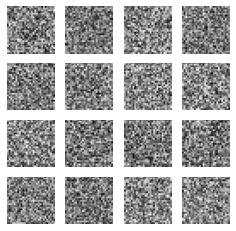

4
gen_loss: tf.Tensor(0.82674867, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5911261, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5911285, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9625997  0.03740028]
 [0.8731771  0.1268229 ]
 [0.6680971  0.33190292]
 [0.7970635  0.2029365 ]
 [0.8293022  0.17069784]
 [0.8257836  0.17421636]
 [0.78292155 0.21707848]
 [0.95308965 0.04691032]
 [0.7048494  0.29515058]
 [0.813769   0.18623108]
 [0.96225005 0.03774994]
 [0.8458253  0.15417464]
 [0.6572961  0.34270385]
 [0.6829508  0.3170492 ]
 [0.6934216  0.30657846]
 [0.8767829  0.12321714]
 [0.9262913  0.07370867]
 [0.8678758  0.13212426]
 [0.9055947  0.09440528]
 [0.80395514 0.19604479]
 [0.6460293  0.35397062]
 [0.8941021  0.10589794]
 [0.84997034 0.15002963]
 [0.7929478  0.20705217]
 [0.9493024  0.05069768]
 [0.8206826  0.17931743]
 [0.9195473  0.08045268]
 [0.8831909  0.11680911]
 [0.47036994 0.52963006]
 [0.70085263 0.2991474 ]
 [0.5204017  0.47959825]
 [0.

gen_loss: tf.Tensor(0.8280933, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.58505046, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5890951, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9626449  0.03735513]
 [0.8734521  0.12654784]
 [0.68438804 0.31561193]
 [0.80767524 0.19232471]
 [0.8273958  0.17260417]
 [0.81848955 0.1815104 ]
 [0.7904101  0.20958991]
 [0.95315385 0.04684613]
 [0.715597   0.28440297]
 [0.8108572  0.18914278]
 [0.96119374 0.03880625]
 [0.8573418  0.14265817]
 [0.66838247 0.33161756]
 [0.6808811  0.31911895]
 [0.7078287  0.29217127]
 [0.8766509  0.12334911]
 [0.92586905 0.07413093]
 [0.8631308  0.13686916]
 [0.91256166 0.08743837]
 [0.80086195 0.19913799]
 [0.6427412  0.3572588 ]
 [0.90007246 0.09992751]
 [0.85090977 0.1490902 ]
 [0.80421257 0.19578737]
 [0.9499322  0.05006786]
 [0.8224871  0.17751284]
 [0.9238962  0.07610377]
 [0.8829816  0.11701837]
 [0.45738772 0.5426123 ]
 [0.7116635  0.28833658]
 [0.51944673 0.4805532 ]
 [0.82

gen_loss: tf.Tensor(0.8329841, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.57829976, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5874474, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.96450925 0.0354907 ]
 [0.8747708  0.12522914]
 [0.6996617  0.30033836]
 [0.8226758  0.17732419]
 [0.829096   0.170904  ]
 [0.820281   0.17971896]
 [0.80105984 0.19894016]
 [0.95459276 0.04540719]
 [0.72873044 0.27126956]
 [0.8213535  0.17864655]
 [0.9626872  0.03731279]
 [0.8710182  0.12898178]
 [0.6706628  0.32933715]
 [0.6894585  0.3105415 ]
 [0.722198   0.277802  ]
 [0.8830415  0.11695846]
 [0.9295258  0.07047419]
 [0.8649904  0.13500954]
 [0.9164892  0.08351082]
 [0.8085912  0.19140881]
 [0.64031607 0.35968393]
 [0.9044531  0.09554693]
 [0.8562969  0.14370313]
 [0.81939995 0.18060005]
 [0.95255446 0.04744555]
 [0.82107365 0.17892636]
 [0.9290346  0.07096545]
 [0.88439566 0.1156043 ]
 [0.46090737 0.5390926 ]
 [0.72841847 0.27158147]
 [0.52373964 0.47626042]
 [0.83

gen_loss: tf.Tensor(0.8341522, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5699452, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5866182, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9675154  0.03248461]
 [0.88022673 0.11977334]
 [0.714779   0.28522092]
 [0.8408156  0.15918437]
 [0.83546156 0.16453846]
 [0.8300587  0.16994128]
 [0.8117461  0.18825385]
 [0.957275   0.04272505]
 [0.7439323  0.25606775]
 [0.84285593 0.15714405]
 [0.96571666 0.03428335]
 [0.88534945 0.11465058]
 [0.6650664  0.3349336 ]
 [0.7053261  0.29467392]
 [0.73565793 0.26434207]
 [0.89528304 0.10471696]
 [0.93612283 0.06387722]
 [0.8747849  0.12521507]
 [0.9204074  0.07959258]
 [0.8270174  0.17298257]
 [0.63225347 0.36774656]
 [0.9098945  0.09010551]
 [0.86812234 0.13187765]
 [0.8372073  0.16279273]
 [0.95768    0.04232004]
 [0.8177308  0.18226917]
 [0.9343457  0.06565427]
 [0.8867261  0.1132739 ]
 [0.47100633 0.5289937 ]
 [0.7523783  0.24762167]
 [0.5293076  0.47069237]
 [0.851

gen_loss: tf.Tensor(0.84043765, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5725358, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.58241594, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.96943206 0.03056791]
 [0.8819519  0.11804814]
 [0.7192117  0.28078833]
 [0.85088843 0.1491116 ]
 [0.83753496 0.16246499]
 [0.83324647 0.16675355]
 [0.8165804  0.18341963]
 [0.95824534 0.04175469]
 [0.7505411  0.2494589 ]
 [0.85059166 0.14940837]
 [0.9678008  0.03219917]
 [0.8925167  0.10748335]
 [0.6604173  0.3395827 ]
 [0.7002338  0.29976615]
 [0.740365   0.25963503]
 [0.90353286 0.09646713]
 [0.9407969  0.05920315]
 [0.88094044 0.11905961]
 [0.9200725  0.07992749]
 [0.8381427  0.16185734]
 [0.62125677 0.3787432 ]
 [0.9125785  0.0874215 ]
 [0.87237746 0.12762251]
 [0.8467072  0.15329279]
 [0.9602206  0.03977946]
 [0.8258645  0.17413545]
 [0.9373312  0.06266879]
 [0.88756543 0.11243454]
 [0.48557702 0.51442295]
 [0.761192   0.23880793]
 [0.5363332  0.4636668 ]
 [0.8

gen_loss: tf.Tensor(0.8488264, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.56707704, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.574049, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9719667  0.02803334]
 [0.88672394 0.11327606]
 [0.71351904 0.286481  ]
 [0.85293216 0.14706792]
 [0.83632225 0.1636778 ]
 [0.8350696  0.16493039]
 [0.8152522  0.18474783]
 [0.9606613  0.03933866]
 [0.745292   0.25470802]
 [0.8495876  0.1504124 ]
 [0.97006536 0.02993468]
 [0.89146966 0.10853039]
 [0.65328485 0.34671515]
 [0.68839353 0.31160644]
 [0.7322372  0.26776278]
 [0.90831876 0.09168129]
 [0.9428967  0.05710325]
 [0.88417643 0.1158236 ]
 [0.9195583  0.08044165]
 [0.84329957 0.15670043]
 [0.60043544 0.39956453]
 [0.9175613  0.08243863]
 [0.8725349  0.12746508]
 [0.8482855  0.15171452]
 [0.96199465 0.03800535]
 [0.83565474 0.16434528]
 [0.9384591  0.06154091]
 [0.89218926 0.10781068]
 [0.4890005  0.51099944]
 [0.7565831  0.24341697]
 [0.5381906  0.46180937]
 [0.867

gen_loss: tf.Tensor(0.85360205, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.59054834, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.56869805, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9744849  0.02551507]
 [0.88976055 0.1102395 ]
 [0.71405363 0.2859463 ]
 [0.8522599  0.14774011]
 [0.83588946 0.1641105 ]
 [0.8358043  0.16419579]
 [0.8129884  0.18701153]
 [0.96428907 0.03571091]
 [0.7407606  0.25923938]
 [0.8432334  0.15676661]
 [0.97295165 0.02704833]
 [0.88584423 0.11415584]
 [0.66402745 0.33597252]
 [0.67518574 0.32481426]
 [0.7234571  0.2765429 ]
 [0.910446   0.08955406]
 [0.94483405 0.05516595]
 [0.88795143 0.11204851]
 [0.92188764 0.07811236]
 [0.84664154 0.15335852]
 [0.58871347 0.41128656]
 [0.918883   0.08111701]
 [0.8720604  0.12793958]
 [0.84770423 0.15229581]
 [0.962321   0.03767898]
 [0.8540319  0.14596806]
 [0.93938935 0.06061059]
 [0.9014191  0.09858085]
 [0.50927746 0.4907225 ]
 [0.74898565 0.2510143 ]
 [0.54771024 0.45228976]
 [0.

gen_loss: tf.Tensor(0.85671586, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.571324, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5675471, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9780291  0.0219709 ]
 [0.8930195  0.10698052]
 [0.7393133  0.26068667]
 [0.8616566  0.13834336]
 [0.84573644 0.15426356]
 [0.8485404  0.15145953]
 [0.82287806 0.17712192]
 [0.97021925 0.0297807 ]
 [0.75047296 0.24952708]
 [0.8558661  0.14413394]
 [0.97830576 0.02169426]
 [0.88931924 0.11068074]
 [0.6924449  0.30755508]
 [0.6965504  0.30344954]
 [0.7310334  0.26896662]
 [0.9181439  0.08185614]
 [0.95332414 0.04667581]
 [0.8997749  0.1002251 ]
 [0.93225276 0.06774722]
 [0.864518   0.13548207]
 [0.61855763 0.3814424 ]
 [0.9174227  0.08257722]
 [0.88527554 0.11472449]
 [0.85708    0.14292   ]
 [0.96540457 0.03459546]
 [0.8784129  0.12158709]
 [0.945738   0.05426206]
 [0.91519654 0.08480344]
 [0.5522157  0.44778436]
 [0.76523525 0.23476483]
 [0.5764677  0.4235323 ]
 [0.879

gen_loss: tf.Tensor(0.8623328, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.57101023, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5651542, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9803325  0.01966756]
 [0.9006911  0.09930887]
 [0.7531313  0.24686877]
 [0.86823356 0.13176642]
 [0.8529957  0.14700429]
 [0.8569351  0.14306484]
 [0.82932323 0.17067677]
 [0.9733599  0.02664019]
 [0.758431   0.24156904]
 [0.8641756  0.13582437]
 [0.9808865  0.01911345]
 [0.89403015 0.10596983]
 [0.6980401  0.30195984]
 [0.710473   0.289527  ]
 [0.73617846 0.2638215 ]
 [0.92259943 0.07740054]
 [0.95699984 0.04300015]
 [0.907057   0.09294302]
 [0.9379678  0.06203217]
 [0.87693906 0.12306098]
 [0.6357069  0.36429313]
 [0.92219543 0.07780453]
 [0.89301157 0.10698835]
 [0.8632234  0.13677666]
 [0.9682215  0.03177855]
 [0.88501054 0.11498944]
 [0.9487643  0.05123567]
 [0.92173743 0.07826255]
 [0.5597224  0.44027758]
 [0.7775886  0.22241136]
 [0.5953556  0.40464434]
 [0.88

gen_loss: tf.Tensor(0.8598032, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.55956036, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5654309, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9804463  0.01955369]
 [0.9023552  0.09764479]
 [0.755691   0.24430904]
 [0.86863357 0.13136649]
 [0.8493888  0.15061115]
 [0.8561887  0.14381127]
 [0.82853234 0.17146768]
 [0.9726571  0.02734289]
 [0.75834763 0.24165235]
 [0.86469877 0.13530126]
 [0.98066497 0.01933508]
 [0.8994386  0.10056142]
 [0.6806456  0.3193545 ]
 [0.7029268  0.29707316]
 [0.73084474 0.26915523]
 [0.9221529  0.07784714]
 [0.9565489  0.04345104]
 [0.9055077  0.09449233]
 [0.93805087 0.0619491 ]
 [0.8791127  0.12088725]
 [0.6349176  0.36508238]
 [0.92704237 0.07295766]
 [0.89188963 0.10811041]
 [0.8634475  0.13655256]
 [0.96932864 0.03067139]
 [0.87738574 0.1226142 ]
 [0.94756734 0.05243267]
 [0.91926676 0.08073328]
 [0.5364925  0.46350744]
 [0.7798091  0.22019084]
 [0.5989799  0.40102014]
 [0.88

gen_loss: tf.Tensor(0.8659661, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5802702, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5620731, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.98086345 0.01913654]
 [0.90904754 0.09095244]
 [0.76146704 0.23853296]
 [0.8745814  0.12541857]
 [0.84567505 0.1543249 ]
 [0.8545325  0.1454675 ]
 [0.8307525  0.16924751]
 [0.9718178  0.02818216]
 [0.765172   0.23482798]
 [0.8717404  0.12825954]
 [0.9800444  0.01995557]
 [0.9105345  0.08946543]
 [0.64931583 0.35068417]
 [0.7002762  0.29972377]
 [0.7317516  0.2682484 ]
 [0.9230565  0.07694357]
 [0.95567364 0.04432631]
 [0.9054896  0.09451038]
 [0.9397795  0.0602205 ]
 [0.88433874 0.11566132]
 [0.6201167  0.37988326]
 [0.93687415 0.06312582]
 [0.89455193 0.10544811]
 [0.86993355 0.13006648]
 [0.9713382  0.02866178]
 [0.85653025 0.14346972]
 [0.9487124  0.05128764]
 [0.91376954 0.08623052]
 [0.49137905 0.508621  ]
 [0.7889037  0.21109629]
 [0.59145373 0.40854633]
 [0.883

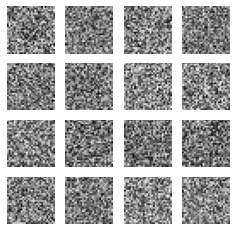

5
gen_loss: tf.Tensor(0.86869675, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.54873574, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5575341, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.98210055 0.01789948]
 [0.9147162  0.08528381]
 [0.79342955 0.20657042]
 [0.8950024  0.10499757]
 [0.85332143 0.14667855]
 [0.8619563  0.13804369]
 [0.84758526 0.15241478]
 [0.97260654 0.0273934 ]
 [0.7973108  0.20268919]
 [0.89383906 0.10616094]
 [0.98088545 0.01911459]
 [0.9313072  0.06869275]
 [0.6444414  0.35555854]
 [0.7272396  0.27276036]
 [0.7603407  0.23965932]
 [0.92875314 0.07124691]
 [0.95888525 0.0411148 ]
 [0.913692   0.08630802]
 [0.94975215 0.05024781]
 [0.90146995 0.09853002]
 [0.6300929  0.36990705]
 [0.9423617  0.05763827]
 [0.9110911  0.0889089 ]
 [0.89209694 0.10790305]
 [0.9754049  0.02459515]
 [0.8450531  0.15494692]
 [0.95728326 0.04271679]
 [0.9104965  0.08950347]
 [0.464749   0.535251  ]
 [0.82200044 0.1779996 ]
 [0.6044882  0.39551187]
 [0

gen_loss: tf.Tensor(0.8670796, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5526556, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5600263, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9837704  0.01622967]
 [0.9122183  0.08778172]
 [0.8283161  0.17168395]
 [0.9168588  0.08314121]
 [0.8704808  0.12951924]
 [0.8742777  0.12572229]
 [0.8735948  0.12640516]
 [0.9753538  0.02464625]
 [0.8337844  0.16621558]
 [0.91564125 0.08435869]
 [0.9840628  0.01593716]
 [0.9479477  0.05205229]
 [0.6782878  0.32171217]
 [0.76662225 0.23337778]
 [0.7992119  0.20078808]
 [0.9376571  0.06234282]
 [0.9656127  0.03438732]
 [0.9254607  0.0745393 ]
 [0.9615333  0.03846664]
 [0.91978496 0.08021501]
 [0.6678169  0.3321831 ]
 [0.9405264  0.05947356]
 [0.9306365  0.06936345]
 [0.91548085 0.08451916]
 [0.97961104 0.020389  ]
 [0.8601179  0.13988212]
 [0.9680305  0.03196945]
 [0.9158241  0.08417592]
 [0.4843537  0.5156463 ]
 [0.8602677  0.13973226]
 [0.6439341  0.35606593]
 [0.899

gen_loss: tf.Tensor(0.8718608, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5662106, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5574825, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.98492557 0.01507446]
 [0.9068132  0.09318676]
 [0.8438671  0.15613292]
 [0.9308226  0.06917741]
 [0.8862453  0.11375473]
 [0.88535637 0.11464363]
 [0.8902539  0.10974611]
 [0.97767603 0.02232393]
 [0.85300213 0.14699787]
 [0.92839134 0.07160871]
 [0.986935   0.01306502]
 [0.95612764 0.04387238]
 [0.7181664  0.2818336 ]
 [0.79468316 0.2053168 ]
 [0.8205659  0.1794341 ]
 [0.9450054  0.05499456]
 [0.9707266  0.02927336]
 [0.93556136 0.06443868]
 [0.96839136 0.03160866]
 [0.9315922  0.06840771]
 [0.69594157 0.3040585 ]
 [0.93642944 0.06357056]
 [0.9423081  0.0576919 ]
 [0.930473   0.06952696]
 [0.9821047  0.01789534]
 [0.883362   0.11663795]
 [0.974552   0.02544802]
 [0.922733   0.07726706]
 [0.53727835 0.46272162]
 [0.88604575 0.11395428]
 [0.67541134 0.3245887 ]
 [0.905

gen_loss: tf.Tensor(0.88383627, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5528238, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5487382, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9854798  0.0145202 ]
 [0.9065218  0.0934782 ]
 [0.8343928  0.16560718]
 [0.9334574  0.06654262]
 [0.8910956  0.10890447]
 [0.89288497 0.10711503]
 [0.8915965  0.10840346]
 [0.97854793 0.02145206]
 [0.84996325 0.15003672]
 [0.93344426 0.06655572]
 [0.98836863 0.01163131]
 [0.95787287 0.04212715]
 [0.7181094  0.28189054]
 [0.8034866  0.19651341]
 [0.81443065 0.1855693 ]
 [0.9486113  0.05138863]
 [0.9726458  0.02735418]
 [0.9403295  0.05967048]
 [0.9679052  0.03209476]
 [0.9352499  0.06475011]
 [0.69087315 0.30912688]
 [0.93838906 0.06161096]
 [0.94497305 0.05502697]
 [0.93315136 0.0668486 ]
 [0.9835136  0.01648633]
 [0.89006215 0.10993788]
 [0.97559035 0.02440957]
 [0.92484134 0.0751586 ]
 [0.56447685 0.43552315]
 [0.89410126 0.10589875]
 [0.67354465 0.3264553 ]
 [0.90

gen_loss: tf.Tensor(0.88328254, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.55004853, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.55132174, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9863353  0.01366466]
 [0.91103756 0.08896247]
 [0.8093094  0.19069058]
 [0.9304252  0.06957478]
 [0.88883156 0.11116849]
 [0.89441603 0.105584  ]
 [0.88390505 0.11609497]
 [0.9792102  0.02078977]
 [0.8338403  0.16615967]
 [0.93250644 0.06749355]
 [0.9892727  0.01072736]
 [0.95522845 0.04477155]
 [0.70747167 0.29252836]
 [0.8007973  0.19920275]
 [0.79247695 0.207523  ]
 [0.9495202  0.05047983]
 [0.9728286  0.02717139]
 [0.9420659  0.05793413]
 [0.9637058  0.03629426]
 [0.93460834 0.06539163]
 [0.6672739  0.33272612]
 [0.9439622  0.05603781]
 [0.94220537 0.05779463]
 [0.92978233 0.07021766]
 [0.98377085 0.01622918]
 [0.88893366 0.11106641]
 [0.9735473  0.02645273]
 [0.9278255  0.07217446]
 [0.58578694 0.41421306]
 [0.89097196 0.10902808]
 [0.6517564  0.34824356]
 [0.

gen_loss: tf.Tensor(0.8888978, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5439726, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5440509, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9863127  0.01368729]
 [0.9115589  0.08844116]
 [0.77352524 0.22647478]
 [0.9209692  0.07903081]
 [0.878775   0.12122501]
 [0.8846073  0.11539275]
 [0.86767364 0.13232632]
 [0.9790885  0.02091152]
 [0.80454373 0.19545627]
 [0.9224652  0.07753481]
 [0.98914075 0.01085919]
 [0.9469885  0.05301153]
 [0.6878522  0.31214783]
 [0.7708842  0.22911578]
 [0.757441   0.24255903]
 [0.94655746 0.05344256]
 [0.9708495  0.02915051]
 [0.9383665  0.06163346]
 [0.9560967  0.04390325]
 [0.9270595  0.0729405 ]
 [0.63194    0.36806002]
 [0.94727224 0.05272774]
 [0.9316254  0.06837457]
 [0.91986626 0.08013371]
 [0.98228765 0.01771229]
 [0.88695025 0.11304976]
 [0.96873546 0.03126446]
 [0.92917    0.07082996]
 [0.5914968  0.40850317]
 [0.87272555 0.12727444]
 [0.61437106 0.38562897]
 [0.911

gen_loss: tf.Tensor(0.8950006, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5509763, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.54163116, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.98679954 0.01320043]
 [0.9051469  0.0948531 ]
 [0.78249514 0.2175048 ]
 [0.9243987  0.07560123]
 [0.88011783 0.11988223]
 [0.8834499  0.11655012]
 [0.8689634  0.13103655]
 [0.98010796 0.01989201]
 [0.8066037  0.1933963 ]
 [0.92231584 0.07768416]
 [0.9896243  0.01037562]
 [0.9483142  0.05168581]
 [0.70841354 0.29158646]
 [0.75924337 0.24075665]
 [0.7599942  0.24000579]
 [0.9473015  0.05269842]
 [0.9719743  0.02802566]
 [0.9384929  0.06150706]
 [0.95764005 0.04235998]
 [0.9289747  0.07102533]
 [0.63915086 0.3608491 ]
 [0.9444013  0.05559863]
 [0.93205327 0.06794668]
 [0.92343456 0.07656538]
 [0.9823235  0.01767642]
 [0.89653325 0.10346675]
 [0.9703535  0.02964652]
 [0.93355525 0.06644477]
 [0.61803305 0.38196698]
 [0.8753119  0.12468811]
 [0.6250209  0.3749791 ]
 [0.91

gen_loss: tf.Tensor(0.90122443, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5589658, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5357443, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.98927045 0.01072958]
 [0.9093883  0.09061173]
 [0.83087444 0.16912557]
 [0.9389006  0.06109948]
 [0.90017176 0.09982821]
 [0.898311   0.10168903]
 [0.88997537 0.11002465]
 [0.9848636  0.01513639]
 [0.8408514  0.15914862]
 [0.9351573  0.06484271]
 [0.99194264 0.00805737]
 [0.95513624 0.04486382]
 [0.753986   0.24601394]
 [0.80007195 0.19992808]
 [0.79797816 0.20202184]
 [0.9545859  0.04541404]
 [0.9777133  0.02228673]
 [0.94826883 0.05173117]
 [0.9699581  0.0300419 ]
 [0.9428091  0.0571909 ]
 [0.6847604  0.3152396 ]
 [0.9432748  0.05672517]
 [0.94673264 0.05326732]
 [0.93792236 0.06207761]
 [0.9847302  0.01526982]
 [0.9166086  0.08339144]
 [0.9778903  0.02210967]
 [0.94475764 0.05524233]
 [0.64972705 0.35027298]
 [0.89805126 0.10194872]
 [0.6586446  0.34135535]
 [0.92

gen_loss: tf.Tensor(0.90895396, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.52876675, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.531256, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99077725 0.0092227 ]
 [0.9152199  0.08478013]
 [0.8638194  0.13618058]
 [0.94952685 0.05047321]
 [0.9138813  0.08611867]
 [0.9096466  0.09035339]
 [0.90406096 0.095939  ]
 [0.98726195 0.01273808]
 [0.8658008  0.13419923]
 [0.945532   0.05446796]
 [0.993135   0.00686501]
 [0.96190387 0.03809611]
 [0.7734644  0.22653566]
 [0.83192223 0.1680777 ]
 [0.82659966 0.17340027]
 [0.9608778  0.03912226]
 [0.98063964 0.01936039]
 [0.9550255  0.04497451]
 [0.97594315 0.0240568 ]
 [0.9529464  0.0470536 ]
 [0.7084406  0.2915594 ]
 [0.94439834 0.05560166]
 [0.9556083  0.04439172]
 [0.9487375  0.0512625 ]
 [0.98664665 0.01335338]
 [0.9235227  0.0764773 ]
 [0.9820129  0.01798701]
 [0.95042026 0.04957977]
 [0.66133183 0.33866814]
 [0.91543263 0.08456734]
 [0.684174   0.315826  ]
 [0.93

gen_loss: tf.Tensor(0.90749764, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5350853, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.53110206, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99112403 0.00887593]
 [0.92034197 0.07965799]
 [0.87606645 0.12393358]
 [0.95186895 0.048131  ]
 [0.91416675 0.08583327]
 [0.9091504  0.09084965]
 [0.9070867  0.09291327]
 [0.9871718  0.01282823]
 [0.8744879  0.1255121 ]
 [0.94603974 0.05396025]
 [0.993005   0.006995  ]
 [0.96530616 0.03469381]
 [0.760008   0.23999205]
 [0.83180106 0.16819891]
 [0.8361791  0.16382095]
 [0.96342105 0.03657897]
 [0.98020625 0.01979375]
 [0.9548406  0.04515935]
 [0.9759704  0.02402959]
 [0.95539707 0.04460294]
 [0.69217503 0.30782503]
 [0.94959486 0.05040517]
 [0.9554334  0.04456654]
 [0.9514065  0.04859352]
 [0.98755383 0.01244613]
 [0.9150898  0.08491019]
 [0.98274213 0.01725795]
 [0.9493237  0.05067632]
 [0.6323432  0.36765674]
 [0.9190628  0.08093718]
 [0.6958953  0.3041047 ]
 [0.9

gen_loss: tf.Tensor(0.91169715, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.51703054, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5283781, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9912292  0.00877076]
 [0.92912865 0.07087142]
 [0.8758789  0.12412112]
 [0.9507431  0.04925684]
 [0.91187215 0.08812785]
 [0.9079276  0.0920724 ]
 [0.90583986 0.09416015]
 [0.98652333 0.01347671]
 [0.8739985  0.12600149]
 [0.94224316 0.05775686]
 [0.9924779  0.00752205]
 [0.96564674 0.03435331]
 [0.7212913  0.27870864]
 [0.8321195  0.1678804 ]
 [0.833381   0.16661897]
 [0.96424586 0.03575416]
 [0.9787083  0.02129168]
 [0.9532418  0.04675823]
 [0.9743448  0.02565522]
 [0.95501214 0.0449879 ]
 [0.6609991  0.33900088]
 [0.9568223  0.04317772]
 [0.95296675 0.04703321]
 [0.9505701  0.04942995]
 [0.9880703  0.01192967]
 [0.9032634  0.09673662]
 [0.9819002  0.01809984]
 [0.9450428  0.05495723]
 [0.5901686  0.4098314 ]
 [0.91750854 0.08249151]
 [0.6876421  0.31235784]
 [0.9

gen_loss: tf.Tensor(0.9225681, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.520826, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.52104664, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99140936 0.00859067]
 [0.9293769  0.07062304]
 [0.8841541  0.11584595]
 [0.9544234  0.04557661]
 [0.9140034  0.08599661]
 [0.90850013 0.09149989]
 [0.9107221  0.08927799]
 [0.9851976  0.01480233]
 [0.88389593 0.11610407]
 [0.94429874 0.05570125]
 [0.991983   0.00801702]
 [0.97055143 0.02944854]
 [0.68995714 0.3100428 ]
 [0.834805   0.165195  ]
 [0.844611   0.155389  ]
 [0.96717316 0.03282681]
 [0.97870106 0.02129896]
 [0.9541424  0.04585759]
 [0.973796   0.02620394]
 [0.9587856  0.04121435]
 [0.6556418  0.3443582 ]
 [0.95883393 0.04116608]
 [0.95475507 0.04524489]
 [0.9547103  0.04528965]
 [0.9893042  0.01069578]
 [0.89371395 0.1062861 ]
 [0.9824869  0.01751309]
 [0.93806994 0.06193   ]
 [0.5862282  0.4137718 ]
 [0.92478836 0.0752117 ]
 [0.70423466 0.2957654 ]
 [0.945

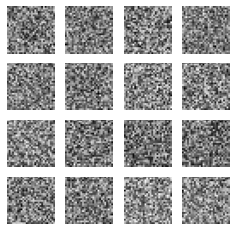

6
gen_loss: tf.Tensor(0.9216516, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5241041, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5241565, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99198896 0.00801101]
 [0.9303778  0.06962223]
 [0.89441794 0.10558204]
 [0.9600053  0.03999471]
 [0.9199094  0.08009055]
 [0.9150339  0.08496616]
 [0.91767603 0.08232399]
 [0.9853976  0.01460245]
 [0.8945445  0.10545553]
 [0.95210296 0.04789707]
 [0.9925718  0.0074282 ]
 [0.97492707 0.02507289]
 [0.68728435 0.31271565]
 [0.8497336  0.15026644]
 [0.8583094  0.14169055]
 [0.9709909  0.02900903]
 [0.98060304 0.0193969 ]
 [0.95844513 0.04155489]
 [0.9755215  0.02447853]
 [0.9643447  0.03565526]
 [0.6706043  0.3293957 ]
 [0.9598871  0.04011285]
 [0.96017957 0.03982039]
 [0.960391   0.03960906]
 [0.9906024  0.00939769]
 [0.89083844 0.10916152]
 [0.98415726 0.01584279]
 [0.9375601  0.0624399 ]
 [0.6057793  0.3942207 ]
 [0.9353664  0.06463366]
 [0.72177625 0.2782237 ]
 [0.9

gen_loss: tf.Tensor(0.91890484, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5331478, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5236243, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9938817  0.00611827]
 [0.93898755 0.06101238]
 [0.91986865 0.08013132]
 [0.97136164 0.02863837]
 [0.9358751  0.06412494]
 [0.9310507  0.06894925]
 [0.9353155  0.06468446]
 [0.9885506  0.01144947]
 [0.9200184  0.07998157]
 [0.9663058  0.03369417]
 [0.99459463 0.0054054 ]
 [0.9814262  0.01857385]
 [0.72919685 0.27080318]
 [0.8901735  0.1098265 ]
 [0.8913707  0.10862921]
 [0.9780342  0.02196577]
 [0.9856941  0.01430582]
 [0.9690964  0.03090355]
 [0.982872   0.01712797]
 [0.9749774  0.02502262]
 [0.7199557  0.28004435]
 [0.9631737  0.03682635]
 [0.97258276 0.02741724]
 [0.9715218  0.02847818]
 [0.99290985 0.00709012]
 [0.90842694 0.09157301]
 [0.9886553  0.01134466]
 [0.9458619  0.05413807]
 [0.65943074 0.3405693 ]
 [0.9536803  0.04631974]
 [0.7570574  0.24294257]
 [0.96

gen_loss: tf.Tensor(0.9309929, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.50615877, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5162926, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9945708  0.00542916]
 [0.9441607  0.05583936]
 [0.9294075  0.07059246]
 [0.97382903 0.02617095]
 [0.94035596 0.05964403]
 [0.9320978  0.06790221]
 [0.9404809  0.05951915]
 [0.99015653 0.0098435 ]
 [0.92628485 0.07371511]
 [0.9669154  0.03308464]
 [0.99536043 0.00463953]
 [0.9818303  0.01816963]
 [0.7703417  0.22965828]
 [0.90079576 0.0992043 ]
 [0.90024656 0.09975346]
 [0.9793352  0.02066485]
 [0.98722976 0.01277021]
 [0.9717167  0.02828323]
 [0.9864645  0.01353545]
 [0.9773219  0.02267813]
 [0.74008584 0.25991413]
 [0.9646842  0.03531587]
 [0.9755617  0.02443838]
 [0.9737439  0.02625606]
 [0.993212   0.00678802]
 [0.92784894 0.07215101]
 [0.99005055 0.00994945]
 [0.95226437 0.04773566]
 [0.6954321  0.3045679 ]
 [0.9557979  0.04420205]
 [0.76872754 0.23127244]
 [0.96

gen_loss: tf.Tensor(0.9355093, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.52397335, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.51456964, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99445194 0.00554806]
 [0.9401204  0.05987952]
 [0.91985124 0.08014882]
 [0.9708915  0.02910855]
 [0.9364899  0.06351009]
 [0.92239773 0.07760226]
 [0.9369386  0.06306142]
 [0.9902446  0.00975537]
 [0.9183181  0.08168192]
 [0.95907634 0.0409237 ]
 [0.9954383  0.00456177]
 [0.97814846 0.02185151]
 [0.7835449  0.21645507]
 [0.8817431  0.11825693]
 [0.8918463  0.10815369]
 [0.97772276 0.02227725]
 [0.98674726 0.01325268]
 [0.9688756  0.03112437]
 [0.98569816 0.01430183]
 [0.97457516 0.02542482]
 [0.71942776 0.28057224]
 [0.96358836 0.03641168]
 [0.9723096  0.02769042]
 [0.97071767 0.02928235]
 [0.99251723 0.00748278]
 [0.9371318  0.06286822]
 [0.98955524 0.01044479]
 [0.95375335 0.04624662]
 [0.71406776 0.2859323 ]
 [0.9470599  0.05294005]
 [0.75899196 0.24100813]
 [0.9

gen_loss: tf.Tensor(0.94567716, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.51696205, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5087305, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99442    0.00557998]
 [0.94026786 0.05973212]
 [0.9038226  0.09617742]
 [0.9678623  0.03213767]
 [0.9309243  0.06907573]
 [0.9200313  0.07996874]
 [0.9306805  0.06931943]
 [0.9899311  0.0100689 ]
 [0.9071035  0.09289658]
 [0.95618576 0.04381425]
 [0.99535984 0.00464015]
 [0.9760342  0.02396574]
 [0.75937796 0.24062204]
 [0.8662667  0.13373324]
 [0.8785626  0.12143736]
 [0.9771905  0.02280951]
 [0.9859995  0.01400041]
 [0.9670098  0.03299024]
 [0.9836668  0.0163332 ]
 [0.9724879  0.02751212]
 [0.6712186  0.3287814 ]
 [0.9659314  0.0340686 ]
 [0.96952194 0.03047813]
 [0.96785706 0.03214291]
 [0.9924624  0.00753763]
 [0.9319732  0.06802678]
 [0.98838985 0.01161011]
 [0.9518543  0.04814571]
 [0.6934479  0.3065521 ]
 [0.94026625 0.05973374]
 [0.7328146  0.26718542]
 [0.9

gen_loss: tf.Tensor(0.9503596, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.50511366, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5046496, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9950948  0.00490518]
 [0.93687403 0.06312595]
 [0.90671796 0.09328205]
 [0.97071797 0.02928196]
 [0.93535864 0.0646413 ]
 [0.92944396 0.07055608]
 [0.9363197  0.06368027]
 [0.9904399  0.00956015]
 [0.9146932  0.0853068 ]
 [0.9647382  0.03526176]
 [0.9960884  0.00391163]
 [0.97908485 0.02091514]
 [0.75426763 0.24573235]
 [0.8750399  0.12496018]
 [0.8866963  0.11330367]
 [0.9796127  0.02038733]
 [0.98769766 0.01230238]
 [0.97105473 0.02894529]
 [0.9847169  0.01528317]
 [0.9766333  0.02336672]
 [0.660103   0.33989695]
 [0.96391666 0.03608332]
 [0.97393125 0.02606879]
 [0.97094226 0.0290578 ]
 [0.99347734 0.00652267]
 [0.9283858  0.07161418]
 [0.9894461  0.0105539 ]
 [0.9519724  0.04802749]
 [0.72361517 0.27638483]
 [0.94693893 0.05306107]
 [0.74244434 0.25755575]
 [0.96

gen_loss: tf.Tensor(0.9526313, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5089086, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.5018829, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99582845 0.00417153]
 [0.94117224 0.05882781]
 [0.91274655 0.08725347]
 [0.9728977  0.02710231]
 [0.9406437  0.05935623]
 [0.9384574  0.06154254]
 [0.9412627  0.0587372 ]
 [0.9916692  0.00833076]
 [0.9211649  0.0788352 ]
 [0.9704497  0.02955035]
 [0.99675214 0.00324786]
 [0.9812035  0.01879646]
 [0.753104   0.2468961 ]
 [0.8927395  0.1072605 ]
 [0.8942139  0.10578614]
 [0.98169047 0.01830955]
 [0.9889559  0.01104404]
 [0.97476035 0.02523964]
 [0.98654616 0.01345386]
 [0.97973216 0.02026778]
 [0.6507697  0.34923026]
 [0.96566767 0.03433236]
 [0.97704756 0.02295238]
 [0.97327405 0.02672593]
 [0.9942151  0.00578489]
 [0.9271314  0.07286864]
 [0.9904213  0.00957872]
 [0.9544735  0.0455265 ]
 [0.7335674  0.26643264]
 [0.9532094  0.04679057]
 [0.74112993 0.25887012]
 [0.968

gen_loss: tf.Tensor(0.957737, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.47594315, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.50147676, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9959357  0.00406433]
 [0.9416666  0.05833337]
 [0.92429966 0.07570035]
 [0.9739663  0.02603373]
 [0.9447964  0.05520361]
 [0.94084626 0.0591537 ]
 [0.94477916 0.05522091]
 [0.9916821  0.00831794]
 [0.92899865 0.07100129]
 [0.9704352  0.02956479]
 [0.9967109  0.00328915]
 [0.9835104  0.01648961]
 [0.7678659  0.23213413]
 [0.89941037 0.10058968]
 [0.9039229  0.09607708]
 [0.98227215 0.01772783]
 [0.9895426  0.01045738]
 [0.9743069  0.02569309]
 [0.9881294  0.01187057]
 [0.979518   0.02048201]
 [0.6524322  0.34756774]
 [0.96590537 0.0340946 ]
 [0.97717285 0.02282714]
 [0.97470224 0.02529782]
 [0.99431473 0.00568528]
 [0.93135196 0.06864805]
 [0.9911767  0.00882326]
 [0.953792   0.04620808]
 [0.7291489  0.2708511 ]
 [0.95654166 0.04345839]
 [0.74912584 0.25087416]
 [0.96

gen_loss: tf.Tensor(0.95864314, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.49729598, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.4988134, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9958553  0.00414471]
 [0.9416364  0.05836366]
 [0.9308562  0.0691438 ]
 [0.97577447 0.02422555]
 [0.94942915 0.0505709 ]
 [0.9413634  0.05863656]
 [0.94844294 0.05155705]
 [0.99095833 0.00904169]
 [0.9358125  0.06418751]
 [0.9693634  0.03063662]
 [0.99651635 0.00348359]
 [0.98674405 0.01325598]
 [0.7698955  0.23010449]
 [0.89960194 0.10039806]
 [0.91607124 0.08392881]
 [0.983563   0.01643708]
 [0.99073434 0.00926572]
 [0.9720643  0.02793564]
 [0.98873377 0.01126619]
 [0.9789367  0.02106335]
 [0.6510447  0.34895524]
 [0.9686515  0.03134853]
 [0.9767572  0.02324273]
 [0.97692716 0.02307276]
 [0.9947062  0.00529384]
 [0.93582916 0.06417087]
 [0.9922072  0.00779273]
 [0.9498324  0.05016767]
 [0.720756   0.27924398]
 [0.96144116 0.03855878]
 [0.7542243  0.24577564]
 [0.9

gen_loss: tf.Tensor(0.9719109, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.49364495, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.49137282, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99647    0.00352998]
 [0.9476684  0.05233163]
 [0.9299517  0.07004824]
 [0.97973895 0.02026109]
 [0.9588985  0.04110153]
 [0.9554644  0.04453559]
 [0.9542947  0.04570534]
 [0.9919131  0.0080869 ]
 [0.94029325 0.0597068 ]
 [0.9790837  0.02091635]
 [0.9972356  0.00276444]
 [0.9895865  0.01041348]
 [0.73991704 0.260083  ]
 [0.9243635  0.07563654]
 [0.9234963  0.07650367]
 [0.98758507 0.01241488]
 [0.9928966  0.00710342]
 [0.9776044  0.02239565]
 [0.9891538  0.01084623]
 [0.9834554  0.01654462]
 [0.68842024 0.31157976]
 [0.973195   0.02680496]
 [0.9815067  0.01849328]
 [0.98070174 0.01929826]
 [0.9960829  0.00391707]
 [0.93385285 0.06614708]
 [0.9934981  0.00650194]
 [0.9519586  0.04804141]
 [0.7699719  0.23002814]
 [0.97258705 0.0274129 ]
 [0.75470567 0.24529429]
 [0.9

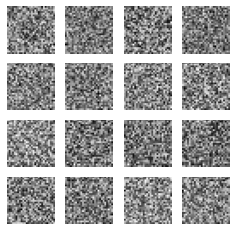

7
gen_loss: tf.Tensor(0.98520404, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.5213711, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.48422378, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9967049  0.00329517]
 [0.95331365 0.0466864 ]
 [0.9346225  0.0653775 ]
 [0.98438174 0.01561823]
 [0.9655592  0.03444086]
 [0.9623729  0.03762712]
 [0.9612088  0.03879113]
 [0.9923267  0.00767335]
 [0.9511478  0.04885221]
 [0.98447126 0.01552871]
 [0.99742055 0.00257951]
 [0.9929745  0.00702551]
 [0.72700655 0.27299345]
 [0.9314033  0.06859676]
 [0.9384867  0.06151328]
 [0.98979175 0.0102082 ]
 [0.9939632  0.00603677]
 [0.9806498  0.01935019]
 [0.9898571  0.010143  ]
 [0.9862104  0.01378955]
 [0.7048539  0.29514608]
 [0.97902316 0.02097688]
 [0.98461145 0.01538853]
 [0.9853544  0.01464554]
 [0.99685436 0.00314571]
 [0.92427105 0.07572893]
 [0.9948724  0.0051276 ]
 [0.9521743  0.04782571]
 [0.7654352  0.23456475]
 [0.98070323 0.0192968 ]
 [0.7627906  0.2372094 ]
 [0

gen_loss: tf.Tensor(0.97886014, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.49765736, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.48717153, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.996403   0.00359702]
 [0.94135666 0.05864336]
 [0.93849814 0.06150188]
 [0.9855693  0.01443072]
 [0.9667923  0.03320779]
 [0.95790076 0.04209929]
 [0.9642776  0.03572233]
 [0.99207544 0.00792452]
 [0.9574172  0.04258281]
 [0.9826132  0.01738677]
 [0.99729186 0.00270807]
 [0.9933884  0.00661155]
 [0.77314913 0.22685082]
 [0.91148186 0.08851817]
 [0.9459679  0.05403212]
 [0.9895335  0.01046647]
 [0.99435884 0.00564121]
 [0.97982544 0.02017461]
 [0.9900767  0.00992326]
 [0.98621154 0.01378848]
 [0.71345526 0.28654474]
 [0.9745249  0.02547512]
 [0.9853382  0.01466176]
 [0.98661906 0.01338093]
 [0.9966331  0.00336692]
 [0.9369509  0.06304901]
 [0.9956468  0.00435325]
 [0.95253545 0.04746453]
 [0.7880148  0.21198513]
 [0.98110217 0.01889786]
 [0.7864802  0.21351983]
 [0.

gen_loss: tf.Tensor(0.9866662, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.50988054, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.48163533, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9969626  0.00303739]
 [0.941772   0.05822796]
 [0.9494155  0.05058449]
 [0.98831856 0.01168146]
 [0.9718426  0.0281574 ]
 [0.96325    0.03675   ]
 [0.9710968  0.02890324]
 [0.9937882  0.00621184]
 [0.9675592  0.03244076]
 [0.98682123 0.01317881]
 [0.9979081  0.00209191]
 [0.99479264 0.00520734]
 [0.79978096 0.20021911]
 [0.9163192  0.08368079]
 [0.95695335 0.04304666]
 [0.99119735 0.00880264]
 [0.99571747 0.00428254]
 [0.98472786 0.01527218]
 [0.9923137  0.00768632]
 [0.98984057 0.01015946]
 [0.7256832  0.2743167 ]
 [0.9731131  0.02688682]
 [0.989571   0.01042908]
 [0.9890526  0.01094746]
 [0.9971558  0.00284417]
 [0.9472008  0.05279925]
 [0.99689734 0.00310261]
 [0.9582268  0.04177321]
 [0.81734514 0.1826548 ]
 [0.9845062  0.01549376]
 [0.80988985 0.19011016]
 [0.9

gen_loss: tf.Tensor(0.99523383, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.48731405, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.47665313, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9975096  0.00249033]
 [0.9521771  0.04782284]
 [0.95950264 0.04049736]
 [0.98993623 0.01006377]
 [0.975621   0.02437901]
 [0.9701442  0.02985583]
 [0.9751483  0.02485172]
 [0.99481106 0.00518891]
 [0.9734865  0.0265135 ]
 [0.9902852  0.00971483]
 [0.99828535 0.00171461]
 [0.9958669  0.00413311]
 [0.7830328  0.21696727]
 [0.93370754 0.06629248]
 [0.9637267  0.03627323]
 [0.9925708  0.0074292 ]
 [0.9964485  0.00355148]
 [0.9881755  0.01182446]
 [0.99396646 0.00603348]
 [0.9922422  0.00775777]
 [0.731817   0.26818305]
 [0.97742426 0.02257574]
 [0.9919397  0.00806031]
 [0.9903741  0.00962599]
 [0.99772114 0.00227885]
 [0.9458882  0.0541117 ]
 [0.99744225 0.00255779]
 [0.9599637  0.04003629]
 [0.7891677  0.21083225]
 [0.9873469  0.01265313]
 [0.82170844 0.17829156]
 [0.

gen_loss: tf.Tensor(1.0048774, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.47086588, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.47104797, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9974564  0.00254369]
 [0.9596946  0.0403054 ]
 [0.96426624 0.03573382]
 [0.988701   0.01129895]
 [0.97550905 0.02449092]
 [0.9698378  0.03016219]
 [0.973696   0.02630403]
 [0.99452376 0.00547629]
 [0.9732686  0.02673138]
 [0.98881125 0.0111888 ]
 [0.9980768  0.00192316]
 [0.9960622  0.00393778]
 [0.74560577 0.2543942 ]
 [0.93848956 0.0615105 ]
 [0.9628101  0.03718986]
 [0.992542   0.00745798]
 [0.99650586 0.00349412]
 [0.987608   0.01239197]
 [0.99434483 0.0056552 ]
 [0.99172395 0.00827612]
 [0.7277907  0.2722093 ]
 [0.9817171  0.01828289]
 [0.9911248  0.00887518]
 [0.9890449  0.01095507]
 [0.99759847 0.00240152]
 [0.9510351  0.04896491]
 [0.99722594 0.00277399]
 [0.95595646 0.04404349]
 [0.7289308  0.2710693 ]
 [0.9864244  0.01357567]
 [0.8197897  0.18021028]
 [0.9

gen_loss: tf.Tensor(1.0082244, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.44445688, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.46772182, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9973062  0.00269371]
 [0.9585851  0.0414149 ]
 [0.9622306  0.03776937]
 [0.9876654  0.01233458]
 [0.9750974  0.02490263]
 [0.9703152  0.02968478]
 [0.97146356 0.02853646]
 [0.9941498  0.00585028]
 [0.9705246  0.02947538]
 [0.98775464 0.01224531]
 [0.99791604 0.00208395]
 [0.9960997  0.00390025]
 [0.7240646  0.2759354 ]
 [0.93841434 0.06158569]
 [0.9599917  0.04000835]
 [0.992489   0.00751099]
 [0.99663144 0.00336852]
 [0.9867715  0.01322845]
 [0.99377924 0.00622077]
 [0.9907534  0.00924662]
 [0.7198557  0.2801443 ]
 [0.98231965 0.01768039]
 [0.9900187  0.00998129]
 [0.98809415 0.01190586]
 [0.9974796  0.00252039]
 [0.9567929  0.04320709]
 [0.9969976  0.00300242]
 [0.95477206 0.04522801]
 [0.7113704  0.28862962]
 [0.98565626 0.01434369]
 [0.81290096 0.18709907]
 [0.9

gen_loss: tf.Tensor(1.0197212, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.45801964, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.4622262, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99778193 0.00221802]
 [0.9516183  0.04838167]
 [0.9710317  0.02896831]
 [0.989804   0.01019592]
 [0.979254   0.02074599]
 [0.97730595 0.02269399]
 [0.9764691  0.02353082]
 [0.9950545  0.00494544]
 [0.97568274 0.02431724]
 [0.9916482  0.00835177]
 [0.9984646  0.00153541]
 [0.99710685 0.00289315]
 [0.7468597  0.2531403 ]
 [0.95368093 0.04631902]
 [0.96774477 0.0322553 ]
 [0.993806   0.00619398]
 [0.9976865  0.00231351]
 [0.98911536 0.01088465]
 [0.99491173 0.00508825]
 [0.9923847  0.00761533]
 [0.7611039  0.23889612]
 [0.97893834 0.02106163]
 [0.99213696 0.0078631 ]
 [0.99041724 0.00958283]
 [0.9978714  0.00212862]
 [0.9675153  0.03248476]
 [0.9977106  0.00228935]
 [0.96132165 0.03867836]
 [0.79765254 0.20234741]
 [0.9895475  0.01045246]
 [0.8401058  0.15989427]
 [0.98

gen_loss: tf.Tensor(1.0222452, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.47233653, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.4608603, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99794286 0.00205709]
 [0.95783424 0.04216573]
 [0.9696186  0.03038143]
 [0.9874621  0.01253785]
 [0.9746245  0.02537545]
 [0.97293174 0.02706827]
 [0.97299474 0.02700526]
 [0.9951292  0.0048708 ]
 [0.97275984 0.02724015]
 [0.99047905 0.00952089]
 [0.9982508  0.00174919]
 [0.9964557  0.00354424]
 [0.72698194 0.2730181 ]
 [0.9459787  0.05402135]
 [0.96294945 0.03705059]
 [0.9920133  0.00798668]
 [0.99724483 0.00275518]
 [0.9872502  0.01274981]
 [0.9942819  0.00571813]
 [0.9907273  0.0092727 ]
 [0.71453214 0.28546783]
 [0.98137546 0.01862458]
 [0.99038273 0.00961729]
 [0.9883499  0.0116501 ]
 [0.9974477  0.0025523 ]
 [0.96429616 0.0357038 ]
 [0.9971125  0.00288749]
 [0.96265    0.03735005]
 [0.818299   0.18170102]
 [0.9867828  0.01321725]
 [0.81997985 0.18002015]
 [0.98

gen_loss: tf.Tensor(1.0386906, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.4846219, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.45441318, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.99842703 0.001573  ]
 [0.96960616 0.03039378]
 [0.9730079  0.026992  ]
 [0.9893113  0.01068866]
 [0.97741413 0.0225858 ]
 [0.9760601  0.02393994]
 [0.9761371  0.02386288]
 [0.99608177 0.0039183 ]
 [0.97663933 0.02336072]
 [0.9927573  0.00724265]
 [0.9985436  0.0014564 ]
 [0.9970625  0.00293744]
 [0.71041024 0.2895897 ]
 [0.9560779  0.04392216]
 [0.96756    0.03243997]
 [0.9926036  0.00739643]
 [0.99759173 0.00240829]
 [0.9892014  0.01079853]
 [0.99534225 0.00465776]
 [0.9921923  0.00780769]
 [0.70086193 0.29913807]
 [0.9861974  0.01380256]
 [0.9919634  0.00803663]
 [0.99001825 0.00998178]
 [0.9979063  0.00209374]
 [0.9615886  0.03841135]
 [0.9975478  0.00245223]
 [0.9659611  0.03403893]
 [0.7937516  0.20624842]
 [0.98870194 0.01129804]
 [0.8165683  0.18343171]
 [0.98

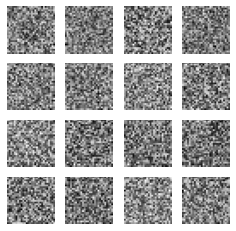

8
gen_loss: tf.Tensor(1.0448163, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.44787964, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.45044807, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9886668e-01 1.1333163e-03]
 [9.6301907e-01 3.6980890e-02]
 [9.8415595e-01 1.5843993e-02]
 [9.9477249e-01 5.2275471e-03]
 [9.8751152e-01 1.2488506e-02]
 [9.8157513e-01 1.8424887e-02]
 [9.8724568e-01 1.2754299e-02]
 [9.9709904e-01 2.9010316e-03]
 [9.8804981e-01 1.1950251e-02]
 [9.9587965e-01 4.1203862e-03]
 [9.9919420e-01 8.0576644e-04]
 [9.9846148e-01 1.5385442e-03]
 [7.9864371e-01 2.0135628e-01]
 [9.6441478e-01 3.5585187e-02]
 [9.8381108e-01 1.6188938e-02]
 [9.9515885e-01 4.8411903e-03]
 [9.9869436e-01 1.3056950e-03]
 [9.9355811e-01 6.4418609e-03]
 [9.9731785e-01 2.6821052e-03]
 [9.9592280e-01 4.0772338e-03]
 [8.0301464e-01 1.9698533e-01]
 [9.8239440e-01 1.7605610e-02]
 [9.9580210e-01 4.1979463e-03]
 [9.9520171e-01 4.7983378e-03]
 [9.9870312e-01 1.2968113e-03]
 [9

test_discriminator_output: tf.Tensor(
[[9.98820364e-01 1.17957953e-03]
 [9.59520519e-01 4.04794812e-02]
 [9.84319150e-01 1.56808700e-02]
 [9.95111287e-01 4.88868449e-03]
 [9.88341153e-01 1.16587831e-02]
 [9.81039643e-01 1.89604145e-02]
 [9.87920284e-01 1.20797697e-02]
 [9.96866047e-01 3.13389255e-03]
 [9.88770485e-01 1.12295896e-02]
 [9.95879292e-01 4.12065629e-03]
 [9.99179542e-01 8.20395537e-04]
 [9.98611808e-01 1.38821511e-03]
 [8.04921627e-01 1.95078358e-01]
 [9.60313439e-01 3.96865495e-02]
 [9.85071838e-01 1.49281910e-02]
 [9.95330215e-01 4.66978783e-03]
 [9.98722613e-01 1.27731066e-03]
 [9.93685186e-01 6.31481037e-03]
 [9.97199297e-01 2.80067651e-03]
 [9.96015847e-01 3.98408202e-03]
 [8.07674885e-01 1.92325175e-01]
 [9.81472015e-01 1.85279734e-02]
 [9.95784581e-01 4.21541557e-03]
 [9.95545030e-01 4.45494102e-03]
 [9.98732507e-01 1.26744225e-03]
 [9.76037145e-01 2.39628274e-02]
 [9.99018908e-01 9.81109799e-04]
 [9.71728444e-01 2.82715484e-02]
 [8.60844612e-01 1.39155358e-01]
 [9.9

gen_loss: tf.Tensor(1.0595598, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.45599818, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.44110307, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98997152e-01 1.00289553e-03]
 [9.66272414e-01 3.37276049e-02]
 [9.83411372e-01 1.65886898e-02]
 [9.95480418e-01 4.51961672e-03]
 [9.89893734e-01 1.01062451e-02]
 [9.83024955e-01 1.69749949e-02]
 [9.88398135e-01 1.16019109e-02]
 [9.97054696e-01 2.94526760e-03]
 [9.89147961e-01 1.08520463e-02]
 [9.96316433e-01 3.68351024e-03]
 [9.99275029e-01 7.24986719e-04]
 [9.98722851e-01 1.27709901e-03]
 [7.81563878e-01 2.18436092e-01]
 [9.61957276e-01 3.80427167e-02]
 [9.85725641e-01 1.42743289e-02]
 [9.96127665e-01 3.87239200e-03]
 [9.98823464e-01 1.17653504e-03]
 [9.94640589e-01 5.35934418e-03]
 [9.97093081e-01 2.90696020e-03]
 [9.96480286e-01 3.51972203e-03]
 [7.93221533e-01 2.06778452e-01]
 [9.85841155e-01 1.41588077e-02]
 [9.96004760e-01 3.99519131e-03]
 [9.95870292e-01 4.12

gen_loss: tf.Tensor(1.0644553, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.45663282, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.43946904, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99296427e-01 7.03554251e-04]
 [9.76567805e-01 2.34321840e-02]
 [9.84799087e-01 1.52008859e-02]
 [9.96321440e-01 3.67862103e-03]
 [9.92548645e-01 7.45140202e-03]
 [9.87730443e-01 1.22695938e-02]
 [9.89831388e-01 1.01686791e-02]
 [9.97785330e-01 2.21468625e-03]
 [9.90555704e-01 9.44428891e-03]
 [9.97423530e-01 2.57653324e-03]
 [9.99488592e-01 5.11400751e-04]
 [9.98912573e-01 1.08744134e-03]
 [7.50199676e-01 2.49800369e-01]
 [9.74881530e-01 2.51185149e-02]
 [9.87617314e-01 1.23827122e-02]
 [9.97269690e-01 2.73025385e-03]
 [9.99085188e-01 9.14774893e-04]
 [9.96149540e-01 3.85053223e-03]
 [9.97615457e-01 2.38459464e-03]
 [9.97420192e-01 2.57981918e-03]
 [7.89668262e-01 2.10331693e-01]
 [9.90485072e-01 9.51491017e-03]
 [9.96964395e-01 3.03557445e-03]
 [9.96626973e-01 3.37

gen_loss: tf.Tensor(1.0670857, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.4416086, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.4385816, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99215126e-01 7.84800504e-04]
 [9.75734591e-01 2.42653452e-02]
 [9.84699965e-01 1.53000308e-02]
 [9.95960534e-01 4.03951015e-03]
 [9.92177427e-01 7.82256946e-03]
 [9.85820055e-01 1.41799226e-02]
 [9.89355266e-01 1.06446631e-02]
 [9.97567713e-01 2.43224739e-03]
 [9.90198731e-01 9.80134029e-03]
 [9.96750474e-01 3.24953254e-03]
 [9.99426246e-01 5.73762634e-04]
 [9.98820484e-01 1.17946102e-03]
 [7.53384292e-01 2.46615678e-01]
 [9.73335803e-01 2.66641751e-02]
 [9.87401068e-01 1.25989290e-02]
 [9.97157693e-01 2.84231361e-03]
 [9.99021649e-01 9.78309894e-04]
 [9.95528042e-01 4.47199214e-03]
 [9.97486472e-01 2.51350203e-03]
 [9.97048318e-01 2.95165693e-03]
 [7.74335206e-01 2.25664780e-01]
 [9.90078926e-01 9.92112793e-03]
 [9.96463954e-01 3.53603903e-03]
 [9.96328533e-01 3.6714

gen_loss: tf.Tensor(1.0901806, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.45621738, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.42742488, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98826325e-01 1.17363723e-03]
 [9.65872765e-01 3.41272205e-02]
 [9.81255949e-01 1.87441017e-02]
 [9.94804084e-01 5.19588077e-03]
 [9.89919543e-01 1.00804418e-02]
 [9.80720878e-01 1.92790870e-02]
 [9.86948848e-01 1.30511895e-02]
 [9.96569276e-01 3.43067478e-03]
 [9.88029063e-01 1.19708739e-02]
 [9.95220125e-01 4.77982918e-03]
 [9.99205410e-01 7.94647553e-04]
 [9.98613238e-01 1.38669170e-03]
 [7.58630395e-01 2.41369620e-01]
 [9.60966289e-01 3.90336849e-02]
 [9.84565258e-01 1.54347746e-02]
 [9.96498585e-01 3.50137986e-03]
 [9.98851299e-01 1.14871119e-03]
 [9.93598342e-01 6.40162174e-03]
 [9.96342361e-01 3.65767721e-03]
 [9.95868444e-01 4.13156999e-03]
 [7.50923932e-01 2.49076098e-01]
 [9.86225605e-01 1.37744267e-02]
 [9.94926572e-01 5.07342815e-03]
 [9.95384753e-01 4.61

gen_loss: tf.Tensor(1.0941751, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.44527262, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.42534173, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99106348e-01 8.93669960e-04]
 [9.71687794e-01 2.83121988e-02]
 [9.83512223e-01 1.64877344e-02]
 [9.96346176e-01 3.65381083e-03]
 [9.92307127e-01 7.69290235e-03]
 [9.87828612e-01 1.21713914e-02]
 [9.89928901e-01 1.00711491e-02]
 [9.97292578e-01 2.70738872e-03]
 [9.91107821e-01 8.89220834e-03]
 [9.97537374e-01 2.46268045e-03]
 [9.99484897e-01 5.15056250e-04]
 [9.99142408e-01 8.57535691e-04]
 [7.27905631e-01 2.72094399e-01]
 [9.74475980e-01 2.55240630e-02]
 [9.88049567e-01 1.19504528e-02]
 [9.97581005e-01 2.41898559e-03]
 [9.99224305e-01 7.75648514e-04]
 [9.95912492e-01 4.08749888e-03]
 [9.96994019e-01 3.00602033e-03]
 [9.97481644e-01 2.51833186e-03]
 [7.61773467e-01 2.38226593e-01]
 [9.88260925e-01 1.17390892e-02]
 [9.96868789e-01 3.13124829e-03]
 [9.96780753e-01 3.21

gen_loss: tf.Tensor(1.0843449, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.45291173, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.4310233, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99254644e-01 7.45363068e-04]
 [9.78334963e-01 2.16650274e-02]
 [9.84997630e-01 1.50023410e-02]
 [9.96857047e-01 3.14291799e-03]
 [9.93622243e-01 6.37782738e-03]
 [9.90397096e-01 9.60291550e-03]
 [9.91458476e-01 8.54153186e-03]
 [9.97771919e-01 2.22808658e-03]
 [9.92856264e-01 7.14370841e-03]
 [9.98102605e-01 1.89741666e-03]
 [9.99582946e-01 4.17100819e-04]
 [9.99322295e-01 6.77721691e-04]
 [7.17774808e-01 2.82225221e-01]
 [9.80087817e-01 1.99122038e-02]
 [9.90130007e-01 9.86999925e-03]
 [9.97958899e-01 2.04109936e-03]
 [9.99329686e-01 6.70365233e-04]
 [9.96786356e-01 3.21365288e-03]
 [9.97648895e-01 2.35106191e-03]
 [9.98065531e-01 1.93450239e-03]
 [7.61381209e-01 2.38618821e-01]
 [9.90667284e-01 9.33276489e-03]
 [9.97579396e-01 2.42062705e-03]
 [9.97229159e-01 2.770

gen_loss: tf.Tensor(1.087852, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3939749, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.43003356, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99130428e-01 8.69537238e-04]
 [9.76733923e-01 2.32660212e-02]
 [9.84559000e-01 1.54410135e-02]
 [9.96446788e-01 3.55324172e-03]
 [9.93193209e-01 6.80682249e-03]
 [9.88219738e-01 1.17802061e-02]
 [9.91001904e-01 8.99814256e-03]
 [9.97421384e-01 2.57861335e-03]
 [9.93023515e-01 6.97644241e-03]
 [9.97128785e-01 2.87119928e-03]
 [9.99456823e-01 5.43142145e-04]
 [9.99267280e-01 7.32667686e-04]
 [7.29219258e-01 2.70780772e-01]
 [9.74566996e-01 2.54329313e-02]
 [9.90526080e-01 9.47391428e-03]
 [9.97586131e-01 2.41387868e-03]
 [9.99220133e-01 7.79825961e-04]
 [9.95937347e-01 4.06269683e-03]
 [9.97781813e-01 2.21815472e-03]
 [9.97642219e-01 2.35771155e-03]
 [7.34365821e-01 2.65634120e-01]
 [9.90297019e-01 9.70296748e-03]
 [9.97042239e-01 2.95779295e-03]
 [9.96915579e-01 3.0843

gen_loss: tf.Tensor(1.0864134, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.4621276, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.42863956, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99167562e-01 8.32468446e-04]
 [9.71884489e-01 2.81155445e-02]
 [9.88250136e-01 1.17498869e-02]
 [9.97077465e-01 2.92260363e-03]
 [9.94286478e-01 5.71354665e-03]
 [9.89035785e-01 1.09642036e-02]
 [9.92456675e-01 7.54335988e-03]
 [9.97396469e-01 2.60354439e-03]
 [9.94607389e-01 5.39266132e-03]
 [9.97407496e-01 2.59244489e-03]
 [9.99476492e-01 5.23536874e-04]
 [9.99429524e-01 5.70503238e-04]
 [7.56505609e-01 2.43494362e-01]
 [9.74806786e-01 2.51932666e-02]
 [9.92665827e-01 7.33414618e-03]
 [9.97804940e-01 2.19505979e-03]
 [9.99324918e-01 6.75083196e-04]
 [9.96262968e-01 3.73700494e-03]
 [9.98256981e-01 1.74302689e-03]
 [9.98051882e-01 1.94814464e-03]
 [7.64899731e-01 2.35100284e-01]
 [9.88413632e-01 1.15864249e-02]
 [9.97565866e-01 2.43412261e-03]
 [9.97500837e-01 2.499

gen_loss: tf.Tensor(1.10004, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.41524154, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.41893956, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9934357e-01 6.5644039e-04]
 [9.6811599e-01 3.1883985e-02]
 [9.9062657e-01 9.3734749e-03]
 [9.9781549e-01 2.1845284e-03]
 [9.9571675e-01 4.2832000e-03]
 [9.9219185e-01 7.8081791e-03]
 [9.9412513e-01 5.8748215e-03]
 [9.9769729e-01 2.3026611e-03]
 [9.9579656e-01 4.2034592e-03]
 [9.9853814e-01 1.4618189e-03]
 [9.9962866e-01 3.7128630e-04]
 [9.9958664e-01 4.1334584e-04]
 [7.6557761e-01 2.3442237e-01]
 [9.7965795e-01 2.0342024e-02]
 [9.9421471e-01 5.7852636e-03]
 [9.9834013e-01 1.6598190e-03]
 [9.9950659e-01 4.9339049e-04]
 [9.9736100e-01 2.6390159e-03]
 [9.9856228e-01 1.4377479e-03]
 [9.9875081e-01 1.2491869e-03]
 [8.0577052e-01 1.9422941e-01]
 [9.8723781e-01 1.2762216e-02]
 [9.9840242e-01 1.5976310e-03]
 [9.9814105e-01 1.8588859e-03]
 [9.9951816e-01 4.8185865e-04]
 [9.796

gen_loss: tf.Tensor(1.1086853, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.40546632, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.41879857, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99290586e-01 7.09368731e-04]
 [9.66138065e-01 3.38618755e-02]
 [9.88403261e-01 1.15967887e-02]
 [9.97147381e-01 2.85266573e-03]
 [9.95054483e-01 4.94547654e-03]
 [9.91329551e-01 8.67040176e-03]
 [9.92947936e-01 7.05206254e-03]
 [9.97386992e-01 2.61295913e-03]
 [9.94694769e-01 5.30523574e-03]
 [9.98372138e-01 1.62790099e-03]
 [9.99581158e-01 4.18815413e-04]
 [9.99485850e-01 5.14132844e-04]
 [7.49620318e-01 2.50379682e-01]
 [9.74401832e-01 2.55981982e-02]
 [9.92602527e-01 7.39748683e-03]
 [9.98066962e-01 1.93303160e-03]
 [9.99395847e-01 6.04188303e-04]
 [9.97062504e-01 2.93745333e-03]
 [9.98082757e-01 1.91729481e-03]
 [9.98519957e-01 1.48003653e-03]
 [7.79704928e-01 2.20295101e-01]
 [9.87663805e-01 1.23361461e-02]
 [9.97965217e-01 2.03482481e-03]
 [9.97586489e-01 2.41

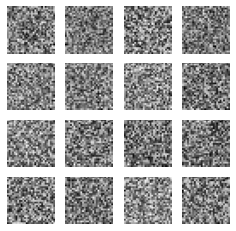

9
gen_loss: tf.Tensor(1.1235449, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.40096813, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.40892732, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99212384e-01 7.87606288e-04]
 [9.73023653e-01 2.69763116e-02]
 [9.85204697e-01 1.47953583e-02]
 [9.95405555e-01 4.59441310e-03]
 [9.93703544e-01 6.29639067e-03]
 [9.88881290e-01 1.11186402e-02]
 [9.90242779e-01 9.75717232e-03]
 [9.97377038e-01 2.62296479e-03]
 [9.92434919e-01 7.56503735e-03]
 [9.97550905e-01 2.44910945e-03]
 [9.99447286e-01 5.52714395e-04]
 [9.99158859e-01 8.41094006e-04]
 [7.14150548e-01 2.85849452e-01]
 [9.69286323e-01 3.07136737e-02]
 [9.89436030e-01 1.05639165e-02]
 [9.97371435e-01 2.62857438e-03]
 [9.99112427e-01 8.87601927e-04]
 [9.96153891e-01 3.84606794e-03]
 [9.97604609e-01 2.39533093e-03]
 [9.97759700e-01 2.24022521e-03]
 [7.26827979e-01 2.73172051e-01]
 [9.90571141e-01 9.42886714e-03]
 [9.96957898e-01 3.04207532e-03]
 [9.96133327e-01 3.

gen_loss: tf.Tensor(1.1305088, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.39892447, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.4064451, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99185145e-01 8.14792351e-04]
 [9.74425197e-01 2.55747885e-02]
 [9.87007678e-01 1.29923578e-02]
 [9.95282471e-01 4.71756794e-03]
 [9.94023502e-01 5.97646181e-03]
 [9.87936556e-01 1.20634660e-02]
 [9.90138769e-01 9.86130349e-03]
 [9.97544825e-01 2.45509995e-03]
 [9.92829859e-01 7.17019895e-03]
 [9.97320235e-01 2.67972867e-03]
 [9.99410510e-01 5.89482079e-04]
 [9.99135315e-01 8.64721078e-04]
 [7.41552770e-01 2.58447230e-01]
 [9.68608618e-01 3.13914195e-02]
 [9.90297258e-01 9.70271043e-03]
 [9.97240305e-01 2.75972392e-03]
 [9.99078751e-01 9.21276514e-04]
 [9.95834708e-01 4.16527689e-03]
 [9.97863829e-01 2.13615084e-03]
 [9.97583270e-01 2.41668895e-03]
 [7.39774108e-01 2.60225832e-01]
 [9.90865648e-01 9.13436897e-03]
 [9.97015953e-01 2.98408419e-03]
 [9.96067643e-01 3.932

gen_loss: tf.Tensor(1.1395869, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.4195789, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.40402305, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99450266e-01 5.49674034e-04]
 [9.72680867e-01 2.73191333e-02]
 [9.94108796e-01 5.89127839e-03]
 [9.98237848e-01 1.76210015e-03]
 [9.97299254e-01 2.70077423e-03]
 [9.93553162e-01 6.44681975e-03]
 [9.94966924e-01 5.03309444e-03]
 [9.98341441e-01 1.65859016e-03]
 [9.96941984e-01 3.05802026e-03]
 [9.99124944e-01 8.75038211e-04]
 [9.99697924e-01 3.02093133e-04]
 [9.99723732e-01 2.76289589e-04]
 [8.05917919e-01 1.94082111e-01]
 [9.83342052e-01 1.66578982e-02]
 [9.96037841e-01 3.96217592e-03]
 [9.98650134e-01 1.34988350e-03]
 [9.99576509e-01 4.23471560e-04]
 [9.97964025e-01 2.03601224e-03]
 [9.98995125e-01 1.00492942e-03]
 [9.99050915e-01 9.49086854e-04]
 [8.49775136e-01 1.50224850e-01]
 [9.89728451e-01 1.02715632e-02]
 [9.98941958e-01 1.05805486e-03]
 [9.98543143e-01 1.456

gen_loss: tf.Tensor(1.1469274, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.4100197, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.40116945, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99352396e-01 6.47581182e-04]
 [9.62926567e-01 3.70734073e-02]
 [9.95014250e-01 4.98579349e-03]
 [9.98332918e-01 1.66710443e-03]
 [9.97293890e-01 2.70609162e-03]
 [9.92411673e-01 7.58830039e-03]
 [9.95027959e-01 4.97207511e-03]
 [9.97840524e-01 2.15943879e-03]
 [9.97317016e-01 2.68301112e-03]
 [9.99026418e-01 9.73605958e-04]
 [9.99649763e-01 3.50279588e-04]
 [9.99781668e-01 2.18372370e-04]
 [7.96762049e-01 2.03237936e-01]
 [9.79627490e-01 2.03725416e-02]
 [9.96672034e-01 3.32793337e-03]
 [9.98550236e-01 1.44979183e-03]
 [9.99576509e-01 4.23483056e-04]
 [9.97758210e-01 2.24177982e-03]
 [9.98966455e-01 1.03352300e-03]
 [9.99053776e-01 9.46264889e-04]
 [8.65092397e-01 1.34907618e-01]
 [9.86337245e-01 1.36627788e-02]
 [9.98933733e-01 1.06624793e-03]
 [9.98620749e-01 1.379

gen_loss: tf.Tensor(1.1538643, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.45071644, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3969503, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98998463e-01 1.00149808e-03]
 [9.71180558e-01 2.88194939e-02]
 [9.89963949e-01 1.00360820e-02]
 [9.94790912e-01 5.20916795e-03]
 [9.93970275e-01 6.02976885e-03]
 [9.82999921e-01 1.70000922e-02]
 [9.88521218e-01 1.14787314e-02]
 [9.96429622e-01 3.57041927e-03]
 [9.93622959e-01 6.37701666e-03]
 [9.96453285e-01 3.54667497e-03]
 [9.99189556e-01 8.10385391e-04]
 [9.99381185e-01 6.18735445e-04]
 [6.78305507e-01 3.21694553e-01]
 [9.60715234e-01 3.92847508e-02]
 [9.92151737e-01 7.84831494e-03]
 [9.96711969e-01 3.28808767e-03]
 [9.98922884e-01 1.07710238e-03]
 [9.94777560e-01 5.22239413e-03]
 [9.97766733e-01 2.23331572e-03]
 [9.97266293e-01 2.73372675e-03]
 [7.49529660e-01 2.50470281e-01]
 [9.89768624e-01 1.02313142e-02]
 [9.96649444e-01 3.35054123e-03]
 [9.95595634e-01 4.404

gen_loss: tf.Tensor(1.1515708, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.4164764, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.39525154, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99292493e-01 7.07485189e-04]
 [9.83472705e-01 1.65272783e-02]
 [9.88766253e-01 1.12337610e-02]
 [9.93843317e-01 6.15665223e-03]
 [9.94100988e-01 5.89894317e-03]
 [9.85723674e-01 1.42762819e-02]
 [9.87441182e-01 1.25587732e-02]
 [9.97284770e-01 2.71523860e-03]
 [9.93011773e-01 6.98825903e-03]
 [9.96932626e-01 3.06732347e-03]
 [9.99351323e-01 6.48719724e-04]
 [9.99308825e-01 6.91115158e-04]
 [5.78651428e-01 4.21348572e-01]
 [9.73160565e-01 2.68394090e-02]
 [9.91216898e-01 8.78309738e-03]
 [9.96798992e-01 3.20100272e-03]
 [9.98911381e-01 1.08859688e-03]
 [9.95561242e-01 4.43876907e-03]
 [9.97869849e-01 2.13016989e-03]
 [9.97347236e-01 2.65272264e-03]
 [6.97272718e-01 3.02727222e-01]
 [9.93977189e-01 6.02279976e-03]
 [9.96657372e-01 3.34258587e-03]
 [9.94598866e-01 5.401

gen_loss: tf.Tensor(1.1526895, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.40723705, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.39533475, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99511123e-01 4.88932128e-04]
 [9.81829762e-01 1.81702878e-02]
 [9.91977513e-01 8.02255981e-03]
 [9.96863127e-01 3.13695287e-03]
 [9.96520877e-01 3.47915618e-03]
 [9.92180705e-01 7.81925395e-03]
 [9.92584527e-01 7.41542084e-03]
 [9.98089731e-01 1.91019394e-03]
 [9.95877504e-01 4.12246445e-03]
 [9.98768032e-01 1.23196898e-03]
 [9.99698281e-01 3.01796332e-04]
 [9.99662519e-01 3.37530888e-04]
 [6.14082634e-01 3.85917395e-01]
 [9.85091984e-01 1.49079664e-02]
 [9.94823933e-01 5.17609250e-03]
 [9.98102009e-01 1.89805985e-03]
 [9.99470174e-01 5.29785349e-04]
 [9.97535944e-01 2.46409094e-03]
 [9.98681962e-01 1.31805323e-03]
 [9.98645127e-01 1.35485048e-03]
 [7.57723451e-01 2.42276475e-01]
 [9.93665993e-01 6.33403100e-03]
 [9.98422623e-01 1.57737487e-03]
 [9.97273386e-01 2.72

gen_loss: tf.Tensor(1.1580603, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.40396953, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3956307, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9934238e-01 6.5764959e-04]
 [9.7244298e-01 2.7556989e-02]
 [9.9281305e-01 7.1869255e-03]
 [9.9790883e-01 2.0912518e-03]
 [9.9668890e-01 3.3110988e-03]
 [9.9320954e-01 6.7904363e-03]
 [9.9415839e-01 5.8416193e-03]
 [9.9767298e-01 2.3269975e-03]
 [9.9691606e-01 3.0839958e-03]
 [9.9908042e-01 9.1952167e-04]
 [9.9969387e-01 3.0612777e-04]
 [9.9982458e-01 1.7541424e-04]
 [6.4071941e-01 3.5928059e-01]
 [9.8392892e-01 1.6071023e-02]
 [9.9611950e-01 3.8805006e-03]
 [9.9838948e-01 1.6105544e-03]
 [9.9961001e-01 3.9004631e-04]
 [9.9744463e-01 2.5554276e-03]
 [9.9863380e-01 1.3661692e-03]
 [9.9877375e-01 1.2262774e-03]
 [7.4847090e-01 2.5152910e-01]
 [9.9161208e-01 8.3879456e-03]
 [9.9863261e-01 1.3673563e-03]
 [9.9823797e-01 1.7620265e-03]
 [9.9963081e-01 3.6918430e-04]
 [9.80

gen_loss: tf.Tensor(1.1780269, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3881179, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.38739526, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98868585e-01 1.13142002e-03]
 [9.67474520e-01 3.25254612e-02]
 [9.91346896e-01 8.65305774e-03]
 [9.97616768e-01 2.38327333e-03]
 [9.95342612e-01 4.65744874e-03]
 [9.91200507e-01 8.79951101e-03]
 [9.93141472e-01 6.85855001e-03]
 [9.96763110e-01 3.23691545e-03]
 [9.96444643e-01 3.55531694e-03]
 [9.98636544e-01 1.36347208e-03]
 [9.99463379e-01 5.36578067e-04]
 [9.99831557e-01 1.68424231e-04]
 [6.33257270e-01 3.66742700e-01]
 [9.78444993e-01 2.15550419e-02]
 [9.95498836e-01 4.50108806e-03]
 [9.97986197e-01 2.01373640e-03]
 [9.99496102e-01 5.03929856e-04]
 [9.96134639e-01 3.86539567e-03]
 [9.98020172e-01 1.97977503e-03]
 [9.98070657e-01 1.92937744e-03]
 [6.88262701e-01 3.11737299e-01]
 [9.90361929e-01 9.63811204e-03]
 [9.97884452e-01 2.11548386e-03]
 [9.98051047e-01 1.948

gen_loss: tf.Tensor(1.1687812, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.39806214, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.38905424, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98961568e-01 1.03842234e-03]
 [9.75556433e-01 2.44434960e-02]
 [9.89742517e-01 1.02575691e-02]
 [9.97440934e-01 2.55901017e-03]
 [9.95213866e-01 4.78614867e-03]
 [9.91741180e-01 8.25882051e-03]
 [9.92673337e-01 7.32660200e-03]
 [9.97568786e-01 2.43122736e-03]
 [9.95910048e-01 4.09000972e-03]
 [9.98487949e-01 1.51202222e-03]
 [9.99510765e-01 4.89267753e-04]
 [9.99784052e-01 2.15993699e-04]
 [6.30046248e-01 3.69953752e-01]
 [9.81411636e-01 1.85883418e-02]
 [9.94649112e-01 5.35089942e-03]
 [9.98040020e-01 1.96005194e-03]
 [9.99506354e-01 4.93646599e-04]
 [9.96393025e-01 3.60696204e-03]
 [9.97997820e-01 2.00219732e-03]
 [9.97905970e-01 2.09409371e-03]
 [6.74614310e-01 3.25385660e-01]
 [9.91813779e-01 8.18629935e-03]
 [9.97795224e-01 2.20476254e-03]
 [9.97905135e-01 2.09

gen_loss: tf.Tensor(1.189184, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.38984212, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.38417673, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99367535e-01 6.32517796e-04]
 [9.80758727e-01 1.92412306e-02]
 [9.91232216e-01 8.76778364e-03]
 [9.98294175e-01 1.70578167e-03]
 [9.96875644e-01 3.12437350e-03]
 [9.94909823e-01 5.09012816e-03]
 [9.94645357e-01 5.35469549e-03]
 [9.98472631e-01 1.52734830e-03]
 [9.96987522e-01 3.01254401e-03]
 [9.99183357e-01 8.16613960e-04]
 [9.99729931e-01 2.70065590e-04]
 [9.99841928e-01 1.58008785e-04]
 [6.45657361e-01 3.54342610e-01]
 [9.88898695e-01 1.11013539e-02]
 [9.95862961e-01 4.13705921e-03]
 [9.98732984e-01 1.26698730e-03]
 [9.99685764e-01 3.14296805e-04]
 [9.98010933e-01 1.98910269e-03]
 [9.98578548e-01 1.42148696e-03]
 [9.98804092e-01 1.19587651e-03]
 [7.27066100e-01 2.72933871e-01]
 [9.92717981e-01 7.28195207e-03]
 [9.98756886e-01 1.24313473e-03]
 [9.98598397e-01 1.401

gen_loss: tf.Tensor(1.1760087, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.40479663, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.38465554, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99596298e-01 4.03707410e-04]
 [9.75241363e-01 2.47586612e-02]
 [9.95143414e-01 4.85660648e-03]
 [9.99242187e-01 7.57787086e-04]
 [9.98430908e-01 1.56904978e-03]
 [9.96951699e-01 3.04832333e-03]
 [9.97302890e-01 2.69713555e-03]
 [9.98749137e-01 1.25085679e-03]
 [9.98669147e-01 1.33080967e-03]
 [9.99636054e-01 3.63892788e-04]
 [9.99850631e-01 1.49380328e-04]
 [9.99933124e-01 6.68885841e-05]
 [7.15711176e-01 2.84288824e-01]
 [9.92114723e-01 7.88528193e-03]
 [9.98113871e-01 1.88617478e-03]
 [9.99294639e-01 7.05323531e-04]
 [9.99841213e-01 1.58704439e-04]
 [9.98953223e-01 1.04674010e-03]
 [9.99224305e-01 7.75705907e-04]
 [9.99510884e-01 4.89125494e-04]
 [8.17569196e-01 1.82430789e-01]
 [9.90325809e-01 9.67419986e-03]
 [9.99492049e-01 5.07984369e-04]
 [9.99381065e-01 6.18

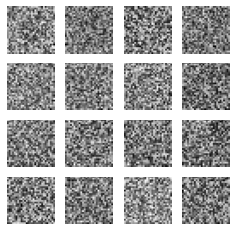

10
gen_loss: tf.Tensor(1.1907638, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.39898783, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.37929922, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99530196e-01 4.69794846e-04]
 [9.67292905e-01 3.27071212e-02]
 [9.95178461e-01 4.82151657e-03]
 [9.99234676e-01 7.65351753e-04]
 [9.98369277e-01 1.63073279e-03]
 [9.96263564e-01 3.73640866e-03]
 [9.97350693e-01 2.64935032e-03]
 [9.98301268e-01 1.69872306e-03]
 [9.98755455e-01 1.24453031e-03]
 [9.99540210e-01 4.59828327e-04]
 [9.99814689e-01 1.85365323e-04]
 [9.99936104e-01 6.39412319e-05]
 [7.14329183e-01 2.85670847e-01]
 [9.88739789e-01 1.12602329e-02]
 [9.98252213e-01 1.74773415e-03]
 [9.99231339e-01 7.68682163e-04]
 [9.99829650e-01 1.70360800e-04]
 [9.98750925e-01 1.24909775e-03]
 [9.99165893e-01 8.34125618e-04]
 [9.99483943e-01 5.16066852e-04]
 [8.10346425e-01 1.89653590e-01]
 [9.88480210e-01 1.15197515e-02]
 [9.99441087e-01 5.58956875e-04]
 [9.99389410e-01 6

gen_loss: tf.Tensor(1.1978576, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.39545333, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.37741297, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99336779e-01 6.63168088e-04]
 [9.67658579e-01 3.23414057e-02]
 [9.93491113e-01 6.50881557e-03]
 [9.98595297e-01 1.40471384e-03]
 [9.97571051e-01 2.42898264e-03]
 [9.93211627e-01 6.78836880e-03]
 [9.96026397e-01 3.97364935e-03]
 [9.97461319e-01 2.53859954e-03]
 [9.98110652e-01 1.88929122e-03]
 [9.98841465e-01 1.15853536e-03]
 [9.99658823e-01 3.41235514e-04]
 [9.99879956e-01 1.20057462e-04]
 [6.58210993e-01 3.41789067e-01]
 [9.78093386e-01 2.19066273e-02]
 [9.97424960e-01 2.57502473e-03]
 [9.98733938e-01 1.26602582e-03]
 [9.99698639e-01 3.01432010e-04]
 [9.97777641e-01 2.22240435e-03]
 [9.98823941e-01 1.17609592e-03]
 [9.99073744e-01 9.26284643e-04]
 [7.33426332e-01 2.66573608e-01]
 [9.90011275e-01 9.98870842e-03]
 [9.98907208e-01 1.09276187e-03]
 [9.98914123e-01 1.08

gen_loss: tf.Tensor(1.2062106, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.42510796, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.37364283, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99469340e-01 5.30628138e-04]
 [9.79816318e-01 2.01837309e-02]
 [9.95592177e-01 4.40777512e-03]
 [9.98604119e-01 1.39590434e-03]
 [9.97964501e-01 2.03547557e-03]
 [9.94106412e-01 5.89362159e-03]
 [9.96412933e-01 3.58708273e-03]
 [9.98272777e-01 1.72720617e-03]
 [9.98361290e-01 1.63865881e-03]
 [9.98946607e-01 1.05336844e-03]
 [9.99726355e-01 2.73657468e-04]
 [9.99868989e-01 1.30979708e-04]
 [6.88765347e-01 3.11234713e-01]
 [9.85300958e-01 1.46989841e-02]
 [9.97768879e-01 2.23113946e-03]
 [9.98782098e-01 1.21786038e-03]
 [9.99718249e-01 2.81784363e-04]
 [9.98227179e-01 1.77285227e-03]
 [9.99193966e-01 8.06069060e-04]
 [9.99233842e-01 7.66165438e-04]
 [7.75204360e-01 2.24795625e-01]
 [9.92371440e-01 7.62856007e-03]
 [9.99060690e-01 9.39359772e-04]
 [9.98899460e-01 1.10

gen_loss: tf.Tensor(1.2020549, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35469744, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.37275904, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99649882e-01 3.50060553e-04]
 [9.86426115e-01 1.35739436e-02]
 [9.96407807e-01 3.59217543e-03]
 [9.98938262e-01 1.06174732e-03]
 [9.98617172e-01 1.38280401e-03]
 [9.96913433e-01 3.08652548e-03]
 [9.97104824e-01 2.89513101e-03]
 [9.99030232e-01 9.69727873e-04]
 [9.98596370e-01 1.40364398e-03]
 [9.99550641e-01 4.49346058e-04]
 [9.99854207e-01 1.45785540e-04]
 [9.99897242e-01 1.02739774e-04]
 [6.76798403e-01 3.23201597e-01]
 [9.92906928e-01 7.09310314e-03]
 [9.98071134e-01 1.92893308e-03]
 [9.99201119e-01 7.98934780e-04]
 [9.99813735e-01 1.86272649e-04]
 [9.99084115e-01 9.15844925e-04]
 [9.99365985e-01 6.33978867e-04]
 [9.99569952e-01 4.30014799e-04]
 [8.20859373e-01 1.79140642e-01]
 [9.94160354e-01 5.83960069e-03]
 [9.99468863e-01 5.31191879e-04]
 [9.99154687e-01 8.45

 [9.99433458e-01 5.66509727e-04]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(1.2011969, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.38968492, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.37268698, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99694705e-01 3.05298250e-04]
 [9.80957508e-01 1.90424714e-02]
 [9.96662140e-01 3.33784893e-03]
 [9.99288142e-01 7.11837900e-04]
 [9.99032140e-01 9.67924832e-04]
 [9.98042107e-01 1.95790385e-03]
 [9.97819304e-01 2.18075467e-03]
 [9.99223471e-01 7.76558649e-04]
 [9.98858094e-01 1.14190218e-03]
 [9.99756873e-01 2.43149858e-04]
 [9.99909282e-01 9.07284775e-05]
 [9.99929786e-01 7.02158868e-05]
 [7.08261013e-01 2.91739047e-01]
 [9.94547606e-01 5.45244431e-03]
 [9.98519957e-01 1.48010079e-03]
 [9.99448121e-01 5.51824982e-04]
 [9.99886155e-01 1.13830356e-04]
 [9.99385595e-01 6.14333665e-04]
 [9.99419093e-01 5.80974855e-04]
 [9.99715269e-01 2.84656562e-04]
 [8.58132422e-01 1.41867667e-01]
 [9.92446244e-01 7.55

gen_loss: tf.Tensor(1.2102882, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.38400912, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.36982822, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99566257e-01 4.33708774e-04]
 [9.72151279e-01 2.78486554e-02]
 [9.95545387e-01 4.45463462e-03]
 [9.99105155e-01 8.94862867e-04]
 [9.98776853e-01 1.22313120e-03]
 [9.97468948e-01 2.53104395e-03]
 [9.97367918e-01 2.63208710e-03]
 [9.98935997e-01 1.06405653e-03]
 [9.98545527e-01 1.45451713e-03]
 [9.99645233e-01 3.54815827e-04]
 [9.99876142e-01 1.23828926e-04]
 [9.99915361e-01 8.46460534e-05]
 [7.04216123e-01 2.95783848e-01]
 [9.91732836e-01 8.26719124e-03]
 [9.98215854e-01 1.78415282e-03]
 [9.99306679e-01 6.93374488e-04]
 [9.99862909e-01 1.37031515e-04]
 [9.99113500e-01 8.86490510e-04]
 [9.99159455e-01 8.40513152e-04]
 [9.99583423e-01 4.16628725e-04]
 [8.34416091e-01 1.65583879e-01]
 [9.90198493e-01 9.80154891e-03]
 [9.99528408e-01 4.71617881e-04]
 [9.99318600e-01 6.81

gen_loss: tf.Tensor(1.2263714, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.38912755, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.36785728, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99043882e-01 9.56074800e-04]
 [9.57459569e-01 4.25403938e-02]
 [9.90880251e-01 9.11969785e-03]
 [9.98054862e-01 1.94519944e-03]
 [9.97293651e-01 2.70638266e-03]
 [9.94582355e-01 5.41760633e-03]
 [9.95012820e-01 4.98712994e-03]
 [9.97596562e-01 2.40344065e-03]
 [9.97197390e-01 2.80262972e-03]
 [9.98944700e-01 1.05534284e-03]
 [9.99656558e-01 3.43392603e-04]
 [9.99849439e-01 1.50564243e-04]
 [6.25554085e-01 3.74445885e-01]
 [9.79261220e-01 2.07388308e-02]
 [9.96684611e-01 3.31536285e-03]
 [9.98561203e-01 1.43879838e-03]
 [9.99701440e-01 2.98484141e-04]
 [9.97642577e-01 2.35734344e-03]
 [9.97793674e-01 2.20635557e-03]
 [9.98792112e-01 1.20790699e-03]
 [7.16643631e-01 2.83356428e-01]
 [9.87410128e-01 1.25898626e-02]
 [9.98611093e-01 1.38894119e-03]
 [9.98573184e-01 1.42

test_discriminator_output: tf.Tensor(
[[9.98933256e-01 1.06669893e-03]
 [9.60597515e-01 3.94024886e-02]
 [9.89456952e-01 1.05430754e-02]
 [9.97698128e-01 2.30184197e-03]
 [9.96674418e-01 3.32561112e-03]
 [9.93689656e-01 6.31026644e-03]
 [9.94176626e-01 5.82339568e-03]
 [9.97168720e-01 2.83131911e-03]
 [9.96908367e-01 3.09163705e-03]
 [9.98781383e-01 1.21864770e-03]
 [9.99568284e-01 4.31757653e-04]
 [9.99845982e-01 1.54051362e-04]
 [5.76806843e-01 4.23193127e-01]
 [9.76088583e-01 2.39114333e-02]
 [9.96296823e-01 3.70321842e-03]
 [9.98254240e-01 1.74570130e-03]
 [9.99628425e-01 3.71555070e-04]
 [9.97176409e-01 2.82363826e-03]
 [9.97213304e-01 2.78675766e-03]
 [9.98497009e-01 1.50304253e-03]
 [6.66103363e-01 3.33896637e-01]
 [9.88067150e-01 1.19328536e-02]
 [9.98270631e-01 1.72933354e-03]
 [9.98327076e-01 1.67294370e-03]
 [9.99593318e-01 4.06724110e-04]
 [9.82960880e-01 1.70391500e-02]
 [9.99717772e-01 2.82164488e-04]
 [9.51439798e-01 4.85602058e-02]
 [8.81507814e-01 1.18492223e-01]
 [9.9

gen_loss: tf.Tensor(1.2305868, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.37617898, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.36369038, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99317527e-01 6.82450540e-04]
 [9.79140699e-01 2.08592694e-02]
 [9.91362035e-01 8.63794796e-03]
 [9.98164833e-01 1.83519255e-03]
 [9.97418642e-01 2.58135097e-03]
 [9.95785892e-01 4.21414711e-03]
 [9.95092869e-01 4.90717264e-03]
 [9.98022676e-01 1.97738851e-03]
 [9.97715712e-01 2.28426326e-03]
 [9.99320984e-01 6.79035380e-04]
 [9.99689817e-01 3.10178759e-04]
 [9.99902248e-01 9.77747768e-05]
 [5.25888383e-01 4.74111587e-01]
 [9.87802446e-01 1.21975569e-02]
 [9.97093678e-01 2.90630781e-03]
 [9.98577356e-01 1.42259861e-03]
 [9.99678731e-01 3.21238942e-04]
 [9.98101175e-01 1.89880421e-03]
 [9.97943938e-01 2.05604732e-03]
 [9.98921990e-01 1.07805186e-03]
 [6.65469229e-01 3.34530860e-01]
 [9.92362738e-01 7.63730053e-03]
 [9.98754025e-01 1.24591787e-03]
 [9.98650372e-01 1.34

test_discriminator_output: tf.Tensor(
[[9.99555409e-01 4.44570818e-04]
 [9.83857274e-01 1.61427148e-02]
 [9.94541943e-01 5.45809139e-03]
 [9.98831213e-01 1.16881542e-03]
 [9.98356402e-01 1.64352905e-03]
 [9.97272193e-01 2.72783241e-03]
 [9.96670902e-01 3.32918041e-03]
 [9.98650014e-01 1.35000702e-03]
 [9.98580217e-01 1.41980266e-03]
 [9.99639630e-01 3.60328180e-04]
 [9.99810636e-01 1.89354701e-04]
 [9.99940395e-01 5.96148238e-05]
 [5.71136773e-01 4.28863257e-01]
 [9.93684232e-01 6.31571980e-03]
 [9.98149276e-01 1.85079244e-03]
 [9.99010205e-01 9.89740947e-04]
 [9.99785841e-01 2.14214917e-04]
 [9.98825967e-01 1.17397646e-03]
 [9.98816848e-01 1.18322007e-03]
 [9.99362648e-01 6.37404155e-04]
 [7.39805043e-01 2.60194957e-01]
 [9.92909849e-01 7.09010055e-03]
 [9.99288797e-01 7.11141853e-04]
 [9.99130189e-01 8.69769661e-04]
 [9.99807894e-01 1.92141015e-04]
 [9.81241167e-01 1.87588371e-02]
 [9.99849558e-01 1.50403532e-04]
 [9.63671029e-01 3.63289230e-02]
 [9.15952861e-01 8.40471461e-02]
 [9.9

gen_loss: tf.Tensor(1.2451434, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.33799183, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3590798, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99740064e-01 2.59933295e-04]
 [9.85419452e-01 1.45805236e-02]
 [9.96840835e-01 3.15913302e-03]
 [9.99361694e-01 6.38267607e-04]
 [9.99174535e-01 8.25391151e-04]
 [9.98205066e-01 1.79497665e-03]
 [9.98187006e-01 1.81299797e-03]
 [9.99159098e-01 8.40888126e-04]
 [9.99277771e-01 7.22208410e-04]
 [9.99768078e-01 2.31911181e-04]
 [9.99904752e-01 9.52031551e-05]
 [9.99959707e-01 4.03245685e-05]
 [6.91171288e-01 3.08828712e-01]
 [9.96750236e-01 3.24978284e-03]
 [9.99041975e-01 9.57954442e-04]
 [9.99389887e-01 6.10052200e-04]
 [9.99885321e-01 1.14664086e-04]
 [9.99305725e-01 6.94292248e-04]
 [9.99505877e-01 4.94082808e-04]
 [9.99656320e-01 3.43680673e-04]
 [8.20320010e-01 1.79679975e-01]
 [9.92571175e-01 7.42879789e-03]
 [9.99656439e-01 3.43527674e-04]
 [9.99522805e-01 4.772

gen_loss: tf.Tensor(1.2551534, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3601141, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3548749, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99663949e-01 3.36050842e-04]
 [9.82528329e-01 1.74716245e-02]
 [9.95203137e-01 4.79691289e-03]
 [9.99162316e-01 8.37702770e-04]
 [9.98912215e-01 1.08783087e-03]
 [9.97403085e-01 2.59685260e-03]
 [9.97762203e-01 2.23777955e-03]
 [9.98847723e-01 1.15220482e-03]
 [9.99032140e-01 9.67876404e-04]
 [9.99547660e-01 4.52342792e-04]
 [9.99862432e-01 1.37570125e-04]
 [9.99940872e-01 5.91361495e-05]
 [6.36904776e-01 3.63095164e-01]
 [9.94580925e-01 5.41899633e-03]
 [9.98750925e-01 1.24909950e-03]
 [9.99231815e-01 7.68219412e-04]
 [9.99865055e-01 1.34887770e-04]
 [9.98883545e-01 1.11650815e-03]
 [9.99315262e-01 6.84717670e-04]
 [9.99433100e-01 5.66844596e-04]
 [7.28390038e-01 2.71609962e-01]
 [9.93227661e-01 6.77239709e-03]
 [9.99455154e-01 5.44865674e-04]
 [9.99385357e-01 6.1462

gen_loss: tf.Tensor(1.2592757, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.40076295, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.35285452, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99591053e-01 4.08926106e-04]
 [9.70369339e-01 2.96306964e-02]
 [9.95682955e-01 4.31706104e-03]
 [9.99471605e-01 5.28357981e-04]
 [9.99008000e-01 9.92068206e-04]
 [9.97737765e-01 2.26228707e-03]
 [9.98280525e-01 1.71949994e-03]
 [9.98468935e-01 1.53101911e-03]
 [9.99251187e-01 7.48798950e-04]
 [9.99729931e-01 2.70110671e-04]
 [9.99862075e-01 1.37876108e-04]
 [9.99970675e-01 2.93171288e-05]
 [6.14659548e-01 3.85340452e-01]
 [9.93967772e-01 6.03219261e-03]
 [9.99051392e-01 9.48639412e-04]
 [9.99384761e-01 6.15174242e-04]
 [9.99908090e-01 9.18653677e-05]
 [9.98941004e-01 1.05897605e-03]
 [9.99217510e-01 7.82445306e-04]
 [9.99554217e-01 4.45760466e-04]
 [7.33212054e-01 2.66787946e-01]
 [9.90686595e-01 9.31341387e-03]
 [9.99583304e-01 4.16720664e-04]
 [9.99624372e-01 3.75

test_discriminator_output: tf.Tensor(
[[9.99614716e-01 3.85270949e-04]
 [9.66440499e-01 3.35594341e-02]
 [9.97008979e-01 2.99110077e-03]
 [9.99662280e-01 3.37764592e-04]
 [9.99229550e-01 7.70466460e-04]
 [9.98163760e-01 1.83627079e-03]
 [9.98776257e-01 1.22376403e-03]
 [9.98581529e-01 1.41846598e-03]
 [9.99485135e-01 5.14843967e-04]
 [9.99835134e-01 1.64815676e-04]
 [9.99888659e-01 1.11346664e-04]
 [9.99982953e-01 1.70172007e-05]
 [6.54819548e-01 3.45180422e-01]
 [9.95288849e-01 4.71119815e-03]
 [9.99346316e-01 6.53626106e-04]
 [9.99510765e-01 4.89264261e-04]
 [9.99933720e-01 6.63097671e-05]
 [9.99191821e-01 8.08228040e-04]
 [9.99396443e-01 6.03525259e-04]
 [9.99695063e-01 3.04956484e-04]
 [7.87585080e-01 2.12414980e-01]
 [9.89064574e-01 1.09354453e-02]
 [9.99725163e-01 2.74838821e-04]
 [9.99761999e-01 2.38035762e-04]
 [9.99913573e-01 8.64003887e-05]
 [9.90012407e-01 9.98752937e-03]
 [9.99960542e-01 3.95096722e-05]
 [9.63221669e-01 3.67782973e-02]
 [9.17196155e-01 8.28038231e-02]
 [9.9

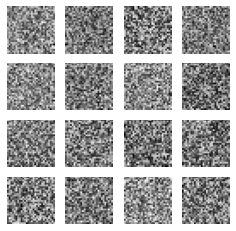

11
gen_loss: tf.Tensor(1.2774498, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.37636003, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34825337, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99634862e-01 3.65182495e-04]
 [9.69170511e-01 3.08294725e-02]
 [9.97372150e-01 2.62783817e-03]
 [9.99685526e-01 3.14524630e-04]
 [9.99269426e-01 7.30552420e-04]
 [9.98227417e-01 1.77262025e-03]
 [9.98881638e-01 1.11833960e-03]
 [9.98751640e-01 1.24831975e-03]
 [9.99517918e-01 4.82075964e-04]
 [9.99849081e-01 1.50911219e-04]
 [9.99897003e-01 1.03028608e-04]
 [9.99983191e-01 1.68019069e-05]
 [6.72470808e-01 3.27529222e-01]
 [9.95861590e-01 4.13839333e-03]
 [9.99378324e-01 6.21705083e-04]
 [9.99510765e-01 4.89234168e-04]
 [9.99935746e-01 6.42834857e-05]
 [9.99274671e-01 7.25305232e-04]
 [9.99471366e-01 5.28601289e-04]
 [9.99724686e-01 2.75274884e-04]
 [8.05253088e-01 1.94746897e-01]
 [9.89264190e-01 1.07358005e-02]
 [9.99753416e-01 2.46640528e-04]
 [9.99777615e-01 2

gen_loss: tf.Tensor(1.2772508, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.36421525, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34723502, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99653339e-01 3.46660527e-04]
 [9.83333290e-01 1.66666470e-02]
 [9.96201694e-01 3.79835116e-03]
 [9.99481618e-01 5.18383516e-04]
 [9.98973608e-01 1.02640025e-03]
 [9.97789025e-01 2.21098354e-03]
 [9.98413324e-01 1.58671220e-03]
 [9.98954058e-01 1.04590436e-03]
 [9.99219894e-01 7.80067116e-04]
 [9.99785960e-01 2.14107102e-04]
 [9.99876618e-01 1.23324688e-04]
 [9.99968290e-01 3.17437371e-05]
 [5.67919075e-01 4.32080954e-01]
 [9.95817602e-01 4.18242253e-03]
 [9.98964906e-01 1.03514118e-03]
 [9.99275029e-01 7.24953483e-04]
 [9.99893665e-01 1.06339496e-04]
 [9.99207675e-01 7.92305451e-04]
 [9.99371707e-01 6.28344889e-04]
 [9.99624491e-01 3.75453616e-04]
 [7.33131051e-01 2.66868949e-01]
 [9.93910909e-01 6.08911831e-03]
 [9.99642849e-01 3.57173180e-04]
 [9.99626398e-01 3.73

gen_loss: tf.Tensor(1.2736201, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.34927362, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34778202, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99701023e-01 2.99009087e-04]
 [9.83429670e-01 1.65703017e-02]
 [9.96892512e-01 3.10755032e-03]
 [9.99585450e-01 4.14589129e-04]
 [9.99202192e-01 7.97778775e-04]
 [9.98059452e-01 1.94057892e-03]
 [9.98718739e-01 1.28129392e-03]
 [9.99122083e-01 8.77955055e-04]
 [9.99380589e-01 6.19406404e-04]
 [9.99833822e-01 1.66125246e-04]
 [9.99905586e-01 9.43587147e-05]
 [9.99974728e-01 2.52814843e-05]
 [5.76471210e-01 4.23528761e-01]
 [9.96274710e-01 3.72534222e-03]
 [9.99182403e-01 8.17564258e-04]
 [9.99342382e-01 6.57547382e-04]
 [9.99906421e-01 9.35617500e-05]
 [9.99424100e-01 5.75977087e-04]
 [9.99524713e-01 4.75273613e-04]
 [9.99725997e-01 2.73968384e-04]
 [7.69932091e-01 2.30067939e-01]
 [9.93651092e-01 6.34896755e-03]
 [9.99738634e-01 2.61368172e-04]
 [9.99703467e-01 2.96

gen_loss: tf.Tensor(1.2685028, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32727104, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34767935, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99624133e-01 3.75898089e-04]
 [9.73518372e-01 2.64816917e-02]
 [9.97622788e-01 2.37722229e-03]
 [9.99671817e-01 3.28177877e-04]
 [9.99357164e-01 6.42788713e-04]
 [9.97936368e-01 2.06367532e-03]
 [9.98961091e-01 1.03888137e-03]
 [9.98894632e-01 1.10536651e-03]
 [9.99545991e-01 4.53948800e-04]
 [9.99826610e-01 1.73412467e-04]
 [9.99899030e-01 1.00951496e-04]
 [9.99982953e-01 1.70967287e-05]
 [6.48801804e-01 3.51198196e-01]
 [9.94842350e-01 5.15761599e-03]
 [9.99432623e-01 5.67339768e-04]
 [9.99382138e-01 6.17886661e-04]
 [9.99913692e-01 8.63257737e-05]
 [9.99412417e-01 5.87569550e-04]
 [9.99593794e-01 4.06175823e-04]
 [9.99759853e-01 2.40126494e-04]
 [8.16074550e-01 1.83925480e-01]
 [9.90226269e-01 9.77371819e-03]
 [9.99777377e-01 2.22634670e-04]
 [9.99774396e-01 2.25

gen_loss: tf.Tensor(1.282037, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3733964, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3427307, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99614954e-01 3.84973537e-04]
 [9.80488658e-01 1.95113514e-02]
 [9.97306585e-01 2.69347103e-03]
 [9.99628305e-01 3.71628557e-04]
 [9.99357045e-01 6.42917352e-04]
 [9.98124063e-01 1.87594001e-03]
 [9.98743594e-01 1.25637744e-03]
 [9.98897672e-01 1.10231235e-03]
 [9.99487400e-01 5.12627186e-04]
 [9.99825418e-01 1.74644723e-04]
 [9.99884486e-01 1.15534109e-04]
 [9.99983788e-01 1.62506731e-05]
 [5.76474190e-01 4.23525780e-01]
 [9.94706929e-01 5.29308058e-03]
 [9.99356210e-01 6.43830455e-04]
 [9.99429882e-01 5.70102653e-04]
 [9.99898195e-01 1.01758123e-04]
 [9.99389410e-01 6.10605464e-04]
 [9.99539018e-01 4.61026299e-04]
 [9.99742687e-01 2.57366162e-04]
 [7.70061851e-01 2.29938120e-01]
 [9.93669450e-01 6.33055950e-03]
 [9.99751747e-01 2.48215656e-04]
 [9.99745548e-01 2.54442

disc_fake_loss: tf.Tensor(0.3426171, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99664783e-01 3.35247518e-04]
 [9.83615100e-01 1.63848531e-02]
 [9.97478783e-01 2.52124434e-03]
 [9.99659181e-01 3.40837229e-04]
 [9.99452531e-01 5.47456555e-04]
 [9.98521388e-01 1.47865608e-03]
 [9.98773515e-01 1.22648012e-03]
 [9.99045312e-01 9.54685325e-04]
 [9.99503851e-01 4.96197899e-04]
 [9.99865890e-01 1.34103670e-04]
 [9.99903917e-01 9.60939869e-05]
 [9.99985814e-01 1.41401488e-05]
 [5.64221501e-01 4.35778558e-01]
 [9.95915830e-01 4.08417545e-03]
 [9.99372303e-01 6.27749949e-04]
 [9.99523997e-01 4.75983572e-04]
 [9.99906421e-01 9.35548742e-05]
 [9.99495864e-01 5.04163618e-04]
 [9.99585688e-01 4.14373819e-04]
 [9.99783814e-01 2.16165296e-04]
 [7.76136935e-01 2.23863095e-01]
 [9.94729757e-01 5.27017750e-03]
 [9.99792278e-01 2.07750534e-04]
 [9.99765217e-01 2.34827326e-04]
 [9.99911785e-01 8.82132008e-05]
 [9.90575790e-01 9.42419190e-03]
 [9.99958277e-01 4.16829862e-05]
 [9.65685

gen_loss: tf.Tensor(1.2997532, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.33981806, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3376909, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99525428e-01 4.74565371e-04]
 [9.80501592e-01 1.94984209e-02]
 [9.97123897e-01 2.87610455e-03]
 [9.99573052e-01 4.27002495e-04]
 [9.99356449e-01 6.43567822e-04]
 [9.98301208e-01 1.69877149e-03]
 [9.98420477e-01 1.57955347e-03]
 [9.98585820e-01 1.41417002e-03]
 [9.99387980e-01 6.11968746e-04]
 [9.99829173e-01 1.70834493e-04]
 [9.99860883e-01 1.39066280e-04]
 [9.99985814e-01 1.41691044e-05]
 [5.44523001e-01 4.55476969e-01]
 [9.95055199e-01 4.94478922e-03]
 [9.99221206e-01 7.78816000e-04]
 [9.99456704e-01 5.43266942e-04]
 [9.99875188e-01 1.24853934e-04]
 [9.99332130e-01 6.67795073e-04]
 [9.99423265e-01 5.76802006e-04]
 [9.99718249e-01 2.81699758e-04]
 [7.63863325e-01 2.36136630e-01]
 [9.94105220e-01 5.89473592e-03]
 [9.99704897e-01 2.95042322e-04]
 [9.99709904e-01 2.901

gen_loss: tf.Tensor(1.2897604, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32512534, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33982736, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9909043e-01 9.0960442e-04]
 [9.7659463e-01 2.3405379e-02]
 [9.9566936e-01 4.3305885e-03]
 [9.9909782e-01 9.0216083e-04]
 [9.9870968e-01 1.2903701e-03]
 [9.9669975e-01 3.3002556e-03]
 [9.9712688e-01 2.8731660e-03]
 [9.9734133e-01 2.6586535e-03]
 [9.9893433e-01 1.0657208e-03]
 [9.9953198e-01 4.6802571e-04]
 [9.9966192e-01 3.3804774e-04]
 [9.9997520e-01 2.4762285e-05]
 [5.0485182e-01 4.9514818e-01]
 [9.9084646e-01 9.1536073e-03]
 [9.9864978e-01 1.3502024e-03]
 [9.9896526e-01 1.0347808e-03]
 [9.9974281e-01 2.5720720e-04]
 [9.9852753e-01 1.4724334e-03]
 [9.9881256e-01 1.1874773e-03]
 [9.9931395e-01 6.8610412e-04]
 [6.9185460e-01 3.0814543e-01]
 [9.9266511e-01 7.3348647e-03]
 [9.9921989e-01 7.8005443e-04]
 [9.9939573e-01 6.0429081e-04]
 [9.9976414e-01 2.3584196e-04]
 [9.8

gen_loss: tf.Tensor(1.2980766, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.33197173, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33902827, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99229789e-01 7.70233746e-04]
 [9.80020404e-01 1.99796539e-02]
 [9.95929420e-01 4.07060143e-03]
 [9.98997986e-01 1.00205361e-03]
 [9.98737276e-01 1.26270682e-03]
 [9.96595085e-01 3.40484572e-03]
 [9.97062385e-01 2.93762935e-03]
 [9.97909963e-01 2.08999123e-03]
 [9.98934925e-01 1.06505200e-03]
 [9.99486089e-01 5.13863924e-04]
 [9.99717772e-01 2.82259483e-04]
 [9.99969840e-01 3.01388282e-05]
 [5.36746144e-01 4.63253856e-01]
 [9.92128372e-01 7.87161756e-03]
 [9.98629808e-01 1.37018773e-03]
 [9.98930514e-01 1.06951140e-03]
 [9.99757349e-01 2.42636888e-04]
 [9.98600900e-01 1.39915047e-03]
 [9.98933256e-01 1.06670393e-03]
 [9.99306202e-01 6.93795504e-04]
 [7.10517287e-01 2.89482683e-01]
 [9.92893040e-01 7.10695237e-03]
 [9.99223709e-01 7.76239729e-04]
 [9.99316335e-01 6.83

gen_loss: tf.Tensor(1.3031738, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32457367, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33330804, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99532342e-01 4.67635487e-04]
 [9.80241179e-01 1.97588112e-02]
 [9.97164786e-01 2.83517572e-03]
 [9.99360263e-01 6.39732578e-04]
 [9.99205053e-01 7.95010361e-04]
 [9.97761488e-01 2.23848759e-03]
 [9.98003066e-01 1.99697306e-03]
 [9.98797894e-01 1.20210194e-03]
 [9.99291420e-01 7.08518841e-04]
 [9.99735296e-01 2.64736416e-04]
 [9.99871016e-01 1.28918939e-04]
 [9.99978304e-01 2.16514891e-05]
 [5.94933450e-01 4.05066580e-01]
 [9.94810820e-01 5.18917618e-03]
 [9.99069750e-01 9.30336537e-04]
 [9.99283135e-01 7.16893410e-04]
 [9.99867320e-01 1.32612055e-04]
 [9.99194205e-01 8.05757998e-04]
 [9.99333203e-01 6.66769047e-04]
 [9.99626398e-01 3.73636198e-04]
 [7.77087629e-01 2.22912356e-01]
 [9.92718101e-01 7.28184870e-03]
 [9.99611080e-01 3.89002322e-04]
 [9.99552190e-01 4.47

gen_loss: tf.Tensor(1.2896819, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35430557, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34309524, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99670267e-01 3.29721166e-04]
 [9.80279088e-01 1.97208989e-02]
 [9.97216940e-01 2.78300419e-03]
 [9.99570549e-01 4.29422915e-04]
 [9.99441922e-01 5.58107218e-04]
 [9.98510063e-01 1.48993440e-03]
 [9.98469532e-01 1.53045065e-03]
 [9.99087453e-01 9.12563759e-04]
 [9.99445379e-01 5.54623897e-04]
 [9.99864459e-01 1.35472452e-04]
 [9.99922037e-01 7.79646580e-05]
 [9.99985099e-01 1.48432500e-05]
 [5.30062020e-01 4.69937921e-01]
 [9.95857298e-01 4.14266950e-03]
 [9.99258578e-01 7.41396623e-04]
 [9.99497056e-01 5.02911571e-04]
 [9.99918222e-01 8.17470936e-05]
 [9.99463499e-01 5.36524109e-04]
 [9.99431551e-01 5.68381045e-04]
 [9.99766886e-01 2.33162762e-04]
 [7.72553563e-01 2.27446452e-01]
 [9.94333029e-01 5.66693302e-03]
 [9.99769986e-01 2.30035119e-04]
 [9.99692202e-01 3.07

gen_loss: tf.Tensor(1.309008, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32165843, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33517304, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99462664e-01 5.37391112e-04]
 [9.68722284e-01 3.12777460e-02]
 [9.97230589e-01 2.76941783e-03]
 [9.99624252e-01 3.75673058e-04]
 [9.99392748e-01 6.07257884e-04]
 [9.98388410e-01 1.61157362e-03]
 [9.98605549e-01 1.39446266e-03]
 [9.98538613e-01 1.46134500e-03]
 [9.99501586e-01 4.98426612e-04]
 [9.99865532e-01 1.34427319e-04]
 [9.99882340e-01 1.17674332e-04]
 [9.99989867e-01 1.01257801e-05]
 [5.00059307e-01 4.99940753e-01]
 [9.94455874e-01 5.54409297e-03]
 [9.99352872e-01 6.47170295e-04]
 [9.99498487e-01 5.01521979e-04]
 [9.99923348e-01 7.66987287e-05]
 [9.99254644e-01 7.45359575e-04]
 [9.99303460e-01 6.96533592e-04]
 [9.99724925e-01 2.75038299e-04]
 [7.68921137e-01 2.31078833e-01]
 [9.92861450e-01 7.13858008e-03]
 [9.99741733e-01 2.58261396e-04]
 [9.99737203e-01 2.628

test_discriminator_output: tf.Tensor(
[[9.99184191e-01 8.15744046e-04]
 [9.54353929e-01 4.56460156e-02]
 [9.97555852e-01 2.44412245e-03]
 [9.99637008e-01 3.62942810e-04]
 [9.99322057e-01 6.77906442e-04]
 [9.98067319e-01 1.93273555e-03]
 [9.98650610e-01 1.34943810e-03]
 [9.97931719e-01 2.06831959e-03]
 [9.99533772e-01 4.66190337e-04]
 [9.99848127e-01 1.51875385e-04]
 [9.99835730e-01 1.64281140e-04]
 [9.99991536e-01 8.51122604e-06]
 [5.42528987e-01 4.57471043e-01]
 [9.93160486e-01 6.83953660e-03]
 [9.99411106e-01 5.88932890e-04]
 [9.99442875e-01 5.57101914e-04]
 [9.99921679e-01 7.83544674e-05]
 [9.99000967e-01 9.99086187e-04]
 [9.99230385e-01 7.69569015e-04]
 [9.99671936e-01 3.28134134e-04]
 [8.00445139e-01 1.99554846e-01]
 [9.89731133e-01 1.02688391e-02]
 [9.99700546e-01 2.99490988e-04]
 [9.99748647e-01 2.51313730e-04]
 [9.99853373e-01 1.46627310e-04]
 [9.88287747e-01 1.17123071e-02]
 [9.99963284e-01 3.66760360e-05]
 [9.50861990e-01 4.91380766e-02]
 [8.57900381e-01 1.42099708e-01]
 [9.9

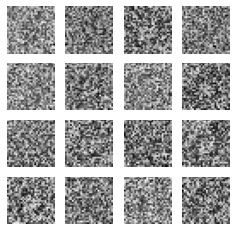

12
gen_loss: tf.Tensor(1.3222289, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.37774536, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3287251, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98771012e-01 1.22893811e-03]
 [9.43687379e-01 5.63125648e-02]
 [9.97889578e-01 2.11039465e-03]
 [9.99577582e-01 4.22466226e-04]
 [9.99145985e-01 8.54024081e-04]
 [9.97444153e-01 2.55590142e-03]
 [9.98544574e-01 1.45548710e-03]
 [9.97212946e-01 2.78710201e-03]
 [9.99517441e-01 4.82554111e-04]
 [9.99803245e-01 1.96799243e-04]
 [9.99761403e-01 2.38583103e-04]
 [9.99991298e-01 8.69201449e-06]
 [5.86507678e-01 4.13492352e-01]
 [9.91588891e-01 8.41105543e-03]
 [9.99402046e-01 5.97930630e-04]
 [9.99294043e-01 7.05956365e-04]
 [9.99908328e-01 9.16297577e-05]
 [9.98592436e-01 1.40753272e-03]
 [9.99120891e-01 8.79169675e-04]
 [9.99565899e-01 4.34035901e-04]
 [8.26518059e-01 1.73481867e-01]
 [9.86290157e-01 1.37098245e-02]
 [9.99611676e-01 3.88362008e-04]
 [9.99708951e-01 2.

gen_loss: tf.Tensor(1.3021476, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35686654, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33559954, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98693407e-01 1.30656455e-03]
 [9.55639601e-01 4.43604067e-02]
 [9.98099864e-01 1.90015312e-03]
 [9.99504566e-01 4.95377753e-04]
 [9.99023080e-01 9.76946438e-04]
 [9.97185290e-01 2.81469990e-03]
 [9.98426557e-01 1.57351978e-03]
 [9.97238278e-01 2.76168250e-03]
 [9.99483228e-01 5.16721222e-04]
 [9.99779999e-01 2.19998255e-04]
 [9.99726117e-01 2.73862621e-04]
 [9.99990106e-01 9.90190256e-06]
 [5.64315438e-01 4.35684592e-01]
 [9.92522776e-01 7.47718289e-03]
 [9.99358594e-01 6.41441729e-04]
 [9.99200881e-01 7.99160567e-04]
 [9.99894977e-01 1.05027793e-04]
 [9.98463035e-01 1.53702637e-03]
 [9.99143839e-01 8.56173923e-04]
 [9.99505162e-01 4.94828622e-04]
 [8.30673277e-01 1.69326738e-01]
 [9.88072395e-01 1.19275926e-02]
 [9.99563038e-01 4.36975795e-04]
 [9.99654889e-01 3.45

gen_loss: tf.Tensor(1.3173201, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32099056, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33083487, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99312520e-01 6.87521533e-04]
 [9.88596976e-01 1.14030633e-02]
 [9.98597205e-01 1.40282221e-03]
 [9.99411345e-01 5.88661816e-04]
 [9.99188602e-01 8.11425911e-04]
 [9.97975409e-01 2.02455767e-03]
 [9.98467386e-01 1.53260678e-03]
 [9.98670697e-01 1.32937194e-03]
 [9.99488950e-01 5.11081307e-04]
 [9.99832630e-01 1.67303631e-04]
 [9.99807775e-01 1.92275184e-04]
 [9.99986529e-01 1.34366610e-05]
 [4.79905248e-01 5.20094812e-01]
 [9.97326970e-01 2.67304550e-03]
 [9.99342859e-01 6.57069380e-04]
 [9.99321461e-01 6.78519835e-04]
 [9.99887943e-01 1.12097092e-04]
 [9.99076009e-01 9.24027176e-04]
 [9.99509454e-01 4.90551465e-04]
 [9.99621511e-01 3.78498982e-04]
 [8.32349598e-01 1.67650431e-01]
 [9.95843709e-01 4.15628124e-03]
 [9.99662757e-01 3.37207603e-04]
 [9.99565303e-01 4.34

gen_loss: tf.Tensor(1.3268334, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.37494832, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32650608, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99228954e-01 7.71086430e-04]
 [9.87918556e-01 1.20814759e-02]
 [9.98640239e-01 1.35979848e-03]
 [9.99335945e-01 6.63980725e-04]
 [9.99202192e-01 7.97784072e-04]
 [9.97623503e-01 2.37655081e-03]
 [9.98456717e-01 1.54332456e-03]
 [9.98385310e-01 1.61471020e-03]
 [9.99486089e-01 5.13927080e-04]
 [9.99793589e-01 2.06399054e-04]
 [9.99799669e-01 2.00332594e-04]
 [9.99984145e-01 1.58876974e-05]
 [4.94916260e-01 5.05083740e-01]
 [9.97191489e-01 2.80854502e-03]
 [9.99339521e-01 6.60409278e-04]
 [9.99289274e-01 7.10700464e-04]
 [9.99873877e-01 1.26164901e-04]
 [9.99056995e-01 9.42986517e-04]
 [9.99526739e-01 4.73252148e-04]
 [9.99627829e-01 3.72133538e-04]
 [8.49714816e-01 1.50285169e-01]
 [9.95184481e-01 4.81556961e-03]
 [9.99665380e-01 3.34608601e-04]
 [9.99508739e-01 4.91

gen_loss: tf.Tensor(1.3229601, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35391396, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33126408, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98979092e-01 1.02096517e-03]
 [9.72867131e-01 2.71329358e-02]
 [9.98670697e-01 1.32929278e-03]
 [9.99456942e-01 5.43097092e-04]
 [9.99285400e-01 7.14592694e-04]
 [9.97167170e-01 2.83283112e-03]
 [9.98750091e-01 1.24990218e-03]
 [9.97403920e-01 2.59608589e-03]
 [9.99599993e-01 4.00053919e-04]
 [9.99773562e-01 2.26461358e-04]
 [9.99809444e-01 1.90559542e-04]
 [9.99987006e-01 1.29993532e-05]
 [5.60870290e-01 4.39129740e-01]
 [9.94952440e-01 5.04753739e-03]
 [9.99504566e-01 4.95439104e-04]
 [9.99326587e-01 6.73482195e-04]
 [9.99894977e-01 1.05044630e-04]
 [9.98977900e-01 1.02211558e-03]
 [9.99507070e-01 4.92900435e-04]
 [9.99689460e-01 3.10598669e-04]
 [8.65162671e-01 1.34837285e-01]
 [9.90023673e-01 9.97634325e-03]
 [9.99726355e-01 2.73684622e-04]
 [9.99611914e-01 3.88

gen_loss: tf.Tensor(1.3334081, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32374984, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32539216, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98897195e-01 1.10272598e-03]
 [9.77084458e-01 2.29155198e-02]
 [9.97748554e-01 2.25142529e-03]
 [9.99138117e-01 8.61835841e-04]
 [9.98988211e-01 1.01173599e-03]
 [9.96341646e-01 3.65838292e-03]
 [9.98206854e-01 1.79317733e-03]
 [9.96951461e-01 3.04849423e-03]
 [9.99415517e-01 5.84506430e-04]
 [9.99640822e-01 3.59121361e-04]
 [9.99763191e-01 2.36867549e-04]
 [9.99979258e-01 2.07002686e-05]
 [4.42679763e-01 5.57320237e-01]
 [9.92007732e-01 7.99230300e-03]
 [9.99276221e-01 7.23766920e-04]
 [9.99155402e-01 8.44557420e-04]
 [9.99854922e-01 1.45081343e-04]
 [9.98746514e-01 1.25343946e-03]
 [9.99208629e-01 7.91422266e-04]
 [9.99570191e-01 4.29769338e-04]
 [7.59425998e-01 2.40574002e-01]
 [9.92544174e-01 7.45589286e-03]
 [9.99587595e-01 4.12437017e-04]
 [9.99389291e-01 6.10

gen_loss: tf.Tensor(1.321619, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30622536, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33329478, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99376237e-01 6.23734784e-04]
 [9.86802638e-01 1.31973047e-02]
 [9.97804344e-01 2.19560694e-03]
 [9.99501586e-01 4.98399022e-04]
 [9.99362290e-01 6.37686928e-04]
 [9.98378038e-01 1.62189954e-03]
 [9.98696029e-01 1.30403345e-03]
 [9.98431504e-01 1.56848447e-03]
 [9.99553978e-01 4.46059945e-04]
 [9.99886513e-01 1.13420356e-04]
 [9.99893069e-01 1.06934662e-04]
 [9.99989152e-01 1.08538834e-05]
 [4.16883200e-01 5.83116770e-01]
 [9.96381998e-01 3.61802755e-03]
 [9.99432027e-01 5.67965501e-04]
 [9.99512196e-01 4.87836893e-04]
 [9.99915242e-01 8.47481497e-05]
 [9.99449074e-01 5.50895580e-04]
 [9.99414563e-01 5.85505390e-04]
 [9.99775112e-01 2.24918491e-04]
 [7.55053759e-01 2.44946197e-01]
 [9.95473802e-01 4.52618208e-03]
 [9.99792397e-01 2.07605975e-04]
 [9.99637485e-01 3.625

test_discriminator_output: tf.Tensor(
[[9.99412179e-01 5.87783812e-04]
 [9.85479474e-01 1.45205678e-02]
 [9.98262107e-01 1.73795491e-03]
 [9.99694824e-01 3.05195863e-04]
 [9.99515653e-01 4.84397780e-04]
 [9.98873413e-01 1.12657493e-03]
 [9.99047458e-01 9.52481118e-04]
 [9.98599946e-01 1.40001811e-03]
 [9.99684453e-01 3.15518409e-04]
 [9.99938965e-01 6.10004172e-05]
 [9.99917984e-01 8.20052228e-05]
 [9.99994278e-01 5.76175125e-06]
 [4.80825901e-01 5.19174159e-01]
 [9.97356892e-01 2.64311302e-03]
 [9.99601781e-01 3.98217642e-04]
 [9.99628305e-01 3.71620554e-04]
 [9.99939799e-01 6.01820793e-05]
 [9.99597132e-01 4.02849313e-04]
 [9.99525070e-01 4.74928733e-04]
 [9.99838829e-01 1.61184231e-04]
 [8.00909638e-01 1.99090376e-01]
 [9.94741082e-01 5.25894109e-03]
 [9.99858141e-01 1.41797645e-04]
 [9.99772847e-01 2.27154873e-04]
 [9.99904513e-01 9.54548668e-05]
 [9.82098937e-01 1.79010741e-02]
 [9.99968171e-01 3.18349557e-05]
 [9.50137913e-01 4.98620383e-02]
 [8.51183057e-01 1.48816943e-01]
 [9.9

gen_loss: tf.Tensor(1.340896, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2606644, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32305855, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99259055e-01 7.40898773e-04]
 [9.81566310e-01 1.84336714e-02]
 [9.98531938e-01 1.46807986e-03]
 [9.99747097e-01 2.52873637e-04]
 [9.99528289e-01 4.71678097e-04]
 [9.98908043e-01 1.09199912e-03]
 [9.99238133e-01 7.61918142e-04]
 [9.98373985e-01 1.62601261e-03]
 [9.99746144e-01 2.53891689e-04]
 [9.99936700e-01 6.32580850e-05]
 [9.99907613e-01 9.24331180e-05]
 [9.99995708e-01 4.31573289e-06]
 [6.02327824e-01 3.97672206e-01]
 [9.97617781e-01 2.38222932e-03]
 [9.99690533e-01 3.09518829e-04]
 [9.99612629e-01 3.87396751e-04]
 [9.99945045e-01 5.49100005e-05]
 [9.99536991e-01 4.63021366e-04]
 [9.99603450e-01 3.96612275e-04]
 [9.99823630e-01 1.76350033e-04]
 [8.32439542e-01 1.67560443e-01]
 [9.92948174e-01 7.05180177e-03]
 [9.99851346e-01 1.48686711e-04]
 [9.99809921e-01 1.9014

 [9.99337852e-01 6.62114064e-04]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(1.3489044, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32083336, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3212516, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99085784e-01 9.14162316e-04]
 [9.80765939e-01 1.92339793e-02]
 [9.98535633e-01 1.46433862e-03]
 [9.99676943e-01 3.23043583e-04]
 [9.99400735e-01 5.99313935e-04]
 [9.98535514e-01 1.46449625e-03]
 [9.99200881e-01 7.99125468e-04]
 [9.97891366e-01 2.10860185e-03]
 [9.99727786e-01 2.72146048e-04]
 [9.99896288e-01 1.03722778e-04]
 [9.99859214e-01 1.40790435e-04]
 [9.99994755e-01 5.27151860e-06]
 [6.02214456e-01 3.97785515e-01]
 [9.97355700e-01 2.64435401e-03]
 [9.99676228e-01 3.23842221e-04]
 [9.99476254e-01 5.23793395e-04]
 [9.99931812e-01 6.81770616e-05]
 [9.99293447e-01 7.06501480e-04]
 [9.99595225e-01 4.04834078e-04]
 [9.99734342e-01 2.65622803e-04]
 [8.15780580e-01 1.84219420e-01]
 [9.92966533e-01 7.033

gen_loss: tf.Tensor(1.340908, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.34225488, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3233471, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99134481e-01 8.65603215e-04]
 [9.80403066e-01 1.95969269e-02]
 [9.98874366e-01 1.12562079e-03]
 [9.99714553e-01 2.85392191e-04]
 [9.99455988e-01 5.44063398e-04]
 [9.98568058e-01 1.43197121e-03]
 [9.99325037e-01 6.75009913e-04]
 [9.97793674e-01 2.20630108e-03]
 [9.99780834e-01 2.19127789e-04]
 [9.99906301e-01 9.37281075e-05]
 [9.99862075e-01 1.37877418e-04]
 [9.99995708e-01 4.26669840e-06]
 [6.10000134e-01 3.89999837e-01]
 [9.97551262e-01 2.44875089e-03]
 [9.99735653e-01 2.64389819e-04]
 [9.99503732e-01 4.96291381e-04]
 [9.99938130e-01 6.18790800e-05]
 [9.99348462e-01 6.51526731e-04]
 [9.99655128e-01 3.44889704e-04]
 [9.99772608e-01 2.27443350e-04]
 [8.34616184e-01 1.65383846e-01]
 [9.93017912e-01 6.98215701e-03]
 [9.99808609e-01 1.91448853e-04]
 [9.99781907e-01 2.1812

 [9.99203742e-01 7.96234701e-04]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(1.3504441, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.28871417, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3196637, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99139905e-01 8.60029017e-04]
 [9.83638406e-01 1.63615402e-02]
 [9.98949707e-01 1.05030776e-03]
 [9.99684453e-01 3.15541867e-04]
 [9.99390364e-01 6.09659299e-04]
 [9.98538256e-01 1.46173115e-03]
 [9.99285758e-01 7.14295486e-04]
 [9.97275412e-01 2.72455090e-03]
 [9.99782026e-01 2.17940527e-04]
 [9.99905467e-01 9.44678395e-05]
 [9.99829292e-01 1.70693485e-04]
 [9.99996185e-01 3.80570009e-06]
 [4.74139363e-01 5.25860608e-01]
 [9.97332096e-01 2.66788155e-03]
 [9.99727786e-01 2.72227277e-04]
 [9.99483228e-01 5.16688917e-04]
 [9.99929309e-01 7.07028885e-05]
 [9.99358475e-01 6.41572871e-04]
 [9.99578774e-01 4.21196484e-04]
 [9.99783695e-01 2.16330882e-04]
 [8.02283466e-01 1.97716489e-01]
 [9.95202303e-01 4.797

gen_loss: tf.Tensor(1.3308425, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30799273, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32936108, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99266207e-01 7.33799767e-04]
 [9.85237420e-01 1.47625450e-02]
 [9.99115884e-01 8.84157664e-04]
 [9.99726713e-01 2.73276033e-04]
 [9.99484301e-01 5.15668071e-04]
 [9.98764873e-01 1.23511255e-03]
 [9.99383330e-01 6.16659119e-04]
 [9.97603357e-01 2.39670579e-03]
 [9.99815285e-01 1.84775941e-04]
 [9.99922991e-01 7.69684193e-05]
 [9.99856830e-01 1.43102719e-04]
 [9.99996781e-01 3.25977817e-06]
 [4.61306572e-01 5.38693488e-01]
 [9.97717381e-01 2.28262274e-03]
 [9.99768078e-01 2.31909187e-04]
 [9.99560297e-01 4.39645868e-04]
 [9.99940038e-01 5.99997984e-05]
 [9.99483585e-01 5.16361615e-04]
 [9.99634862e-01 3.65158805e-04]
 [9.99832034e-01 1.67929669e-04]
 [8.16718996e-01 1.83281034e-01]
 [9.95781779e-01 4.21818439e-03]
 [9.99834776e-01 1.65228586e-04]
 [9.99788582e-01 2.11

gen_loss: tf.Tensor(1.3591058, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.34668827, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.31559405, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99472678e-01 5.27400523e-04]
 [9.86215830e-01 1.37842102e-02]
 [9.99451816e-01 5.48175070e-04]
 [9.99842763e-01 1.57196700e-04]
 [9.99726593e-01 2.73360201e-04]
 [9.99193490e-01 8.06510798e-04]
 [9.99609649e-01 3.90353525e-04]
 [9.98467863e-01 1.53216836e-03]
 [9.99883056e-01 1.16903953e-04]
 [9.99954104e-01 4.59405128e-05]
 [9.99926448e-01 7.34895802e-05]
 [9.99997735e-01 2.26191992e-06]
 [5.73740005e-01 4.26259965e-01]
 [9.98625159e-01 1.37482211e-03]
 [9.99856591e-01 1.43373429e-04]
 [9.99729216e-01 2.70816701e-04]
 [9.99964356e-01 3.56251840e-05]
 [9.99710739e-01 2.89203599e-04]
 [9.99798715e-01 2.01280724e-04]
 [9.99913335e-01 8.66949485e-05]
 [8.94919634e-01 1.05080403e-01]
 [9.95740652e-01 4.25930833e-03]
 [9.99921679e-01 7.83441574e-05]
 [9.99877214e-01 1.22

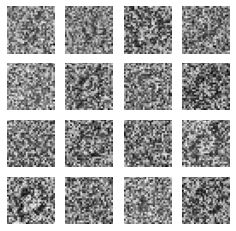

13
gen_loss: tf.Tensor(1.350565, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.28222752, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32356763, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99514699e-01 4.85254335e-04]
 [9.88664627e-01 1.13353115e-02]
 [9.99432743e-01 5.67226729e-04]
 [9.99840021e-01 1.59914664e-04]
 [9.99751508e-01 2.48465454e-04]
 [9.99218822e-01 7.81125971e-04]
 [9.99597847e-01 4.02156176e-04]
 [9.98774230e-01 1.22572388e-03]
 [9.99873281e-01 1.26675528e-04]
 [9.99949813e-01 5.01286595e-05]
 [9.99935508e-01 6.44720785e-05]
 [9.99997258e-01 2.77089066e-06]
 [6.00079954e-01 3.99920017e-01]
 [9.98782694e-01 1.21725316e-03]
 [9.99848127e-01 1.51857428e-04]
 [9.99741852e-01 2.58187036e-04]
 [9.99964952e-01 3.49870970e-05]
 [9.99729335e-01 2.70686578e-04]
 [9.99823153e-01 1.76885747e-04]
 [9.99913931e-01 8.60112195e-05]
 [9.00701046e-01 9.92989093e-02]
 [9.96494710e-01 3.50531517e-03]
 [9.99926329e-01 7.36893053e-05]
 [9.99875307e-01 1.

gen_loss: tf.Tensor(1.3741093, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3284882, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.31079167, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99348223e-01 6.51713694e-04]
 [9.89693463e-01 1.03065055e-02]
 [9.99097109e-01 9.02875385e-04]
 [9.99732077e-01 2.67931289e-04]
 [9.99630451e-01 3.69531655e-04]
 [9.98852372e-01 1.14765740e-03]
 [9.99350607e-01 6.49330148e-04]
 [9.98567820e-01 1.43220578e-03]
 [9.99783218e-01 2.16759698e-04]
 [9.99898195e-01 1.01820639e-04]
 [9.99904275e-01 9.57343582e-05]
 [9.99994755e-01 5.30138504e-06]
 [5.68706751e-01 4.31293249e-01]
 [9.98216689e-01 1.78333255e-03]
 [9.99746144e-01 2.53861654e-04]
 [9.99617219e-01 3.82728933e-04]
 [9.99945283e-01 5.46615265e-05]
 [9.99577463e-01 4.22497571e-04]
 [9.99733388e-01 2.66577728e-04]
 [9.99845147e-01 1.54828755e-04]
 [8.72171640e-01 1.27828300e-01]
 [9.96979594e-01 3.02041671e-03]
 [9.99866486e-01 1.33439346e-04]
 [9.99793947e-01 2.060

gen_loss: tf.Tensor(1.3847008, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.36290467, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.30733556, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9875152e-01 1.2484852e-03]
 [9.8379344e-01 1.6206512e-02]
 [9.9845695e-01 1.5429981e-03]
 [9.9966371e-01 3.3633821e-04]
 [9.9946028e-01 5.3977926e-04]
 [9.9838901e-01 1.6110153e-03]
 [9.9899465e-01 1.0053623e-03]
 [9.9764758e-01 2.3523688e-03]
 [9.9964356e-01 3.5645749e-04]
 [9.9984956e-01 1.5044110e-04]
 [9.9984741e-01 1.5252161e-04]
 [9.9999380e-01 6.1496612e-06]
 [5.4174948e-01 4.5825049e-01]
 [9.9686277e-01 3.1372195e-03]
 [9.9959832e-01 4.0168836e-04]
 [9.9944764e-01 5.5234676e-04]
 [9.9992383e-01 7.6122946e-05]
 [9.9928194e-01 7.1812113e-04]
 [9.9948490e-01 5.1508151e-04]
 [9.9972969e-01 2.7027397e-04]
 [8.6388433e-01 1.3611569e-01]
 [9.9585032e-01 4.1496134e-03]
 [9.9977487e-01 2.2519272e-04]
 [9.9975079e-01 2.4920236e-04]
 [9.9983144e-01 1.6848654e-04]
 [9.8

gen_loss: tf.Tensor(1.387836, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.304177, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.30674934, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98006165e-01 1.99380144e-03]
 [9.76066709e-01 2.39333175e-02]
 [9.97698605e-01 2.30137771e-03]
 [9.99613345e-01 3.86684085e-04]
 [9.99270380e-01 7.29606196e-04]
 [9.98165071e-01 1.83500058e-03]
 [9.98653769e-01 1.34621351e-03]
 [9.96404290e-01 3.59574961e-03]
 [9.99494076e-01 5.05858741e-04]
 [9.99833345e-01 1.66597165e-04]
 [9.99779522e-01 2.20433925e-04]
 [9.99993920e-01 6.02293449e-06]
 [4.79902238e-01 5.20097792e-01]
 [9.95471478e-01 4.52855043e-03]
 [9.99426723e-01 5.73250989e-04]
 [9.99313712e-01 6.86235784e-04]
 [9.99903083e-01 9.68661479e-05]
 [9.99036789e-01 9.63261991e-04]
 [9.99044001e-01 9.55978699e-04]
 [9.99632359e-01 3.67673842e-04]
 [8.63138676e-01 1.36861369e-01]
 [9.94576454e-01 5.42359380e-03]
 [9.99684572e-01 3.15443816e-04]
 [9.99720752e-01 2.79200

test_discriminator_output: tf.Tensor(
[[9.9819487e-01 1.8051312e-03]
 [9.7949392e-01 2.0506142e-02]
 [9.9751651e-01 2.4834587e-03]
 [9.9956399e-01 4.3604645e-04]
 [9.9923563e-01 7.6442352e-04]
 [9.9812490e-01 1.8750607e-03]
 [9.9855429e-01 1.4457039e-03]
 [9.9690872e-01 3.0913067e-03]
 [9.9942601e-01 5.7406735e-04]
 [9.9980646e-01 1.9359621e-04]
 [9.9978310e-01 2.1685644e-04]
 [9.9999213e-01 7.8611065e-06]
 [4.6919191e-01 5.3080803e-01]
 [9.9561113e-01 4.3888474e-03]
 [9.9933761e-01 6.6234381e-04]
 [9.9925977e-01 7.4021355e-04]
 [9.9989212e-01 1.0781962e-04]
 [9.9906832e-01 9.3172438e-04]
 [9.9902225e-01 9.7770139e-04]
 [9.9960965e-01 3.9040306e-04]
 [8.6170548e-01 1.3829456e-01]
 [9.9517500e-01 4.8249429e-03]
 [9.9966908e-01 3.3093331e-04]
 [9.9968266e-01 3.1733327e-04]
 [9.9975425e-01 2.4579870e-04]
 [9.8336279e-01 1.6637141e-02]
 [9.9992990e-01 7.0085844e-05]
 [9.1079217e-01 8.9207813e-02]
 [9.3365330e-01 6.6346645e-02]
 [9.9975532e-01 2.4461918e-04]
 [9.3687069e-01 6.3129358e-02]
 

gen_loss: tf.Tensor(1.3608012, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3370703, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3145049, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98669267e-01 1.33069884e-03]
 [9.85755265e-01 1.42446635e-02]
 [9.97984171e-01 2.01580534e-03]
 [9.99515414e-01 4.84585966e-04]
 [9.99215722e-01 7.84246600e-04]
 [9.98002708e-01 1.99731905e-03]
 [9.98616338e-01 1.38366153e-03]
 [9.97850657e-01 2.14941986e-03]
 [9.99437988e-01 5.61969937e-04]
 [9.99750555e-01 2.49497883e-04]
 [9.99791205e-01 2.08864178e-04]
 [9.99989271e-01 1.07024789e-05]
 [4.82755601e-01 5.17244339e-01]
 [9.96269345e-01 3.73067264e-03]
 [9.99328971e-01 6.71024492e-04]
 [9.99176204e-01 8.23775772e-04]
 [9.99877095e-01 1.22917088e-04]
 [9.99131978e-01 8.68008297e-04]
 [9.99196231e-01 8.03750358e-04]
 [9.99607146e-01 3.92857182e-04]
 [8.65672290e-01 1.34327695e-01]
 [9.96241927e-01 3.75809451e-03]
 [9.99678969e-01 3.21028929e-04]
 [9.99638677e-01 3.6129

gen_loss: tf.Tensor(1.3906555, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.31580707, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.31534678, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98594820e-01 1.40516332e-03]
 [9.81297135e-01 1.87028870e-02]
 [9.98483717e-01 1.51634437e-03]
 [9.99573410e-01 4.26601939e-04]
 [9.99243975e-01 7.56016991e-04]
 [9.97758269e-01 2.24175840e-03]
 [9.98860002e-01 1.13995897e-03]
 [9.97588396e-01 2.41162931e-03]
 [9.99550760e-01 4.49165324e-04]
 [9.99718368e-01 2.81591259e-04]
 [9.99779522e-01 2.20493443e-04]
 [9.99990702e-01 9.31309569e-06]
 [5.31570733e-01 4.68429238e-01]
 [9.95809078e-01 4.19087568e-03]
 [9.99451697e-01 5.48313546e-04]
 [9.99134004e-01 8.66068120e-04]
 [9.99879360e-01 1.20626522e-04]
 [9.99076009e-01 9.23995511e-04]
 [9.99240994e-01 7.59038143e-04]
 [9.99626517e-01 3.73510673e-04]
 [8.90994966e-01 1.09005004e-01]
 [9.95050251e-01 4.94968565e-03]
 [9.99703348e-01 2.96668732e-04]
 [9.99680161e-01 3.19

gen_loss: tf.Tensor(1.369053, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.36333913, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.31267822, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98992622e-01 1.00740592e-03]
 [9.82298732e-01 1.77013353e-02]
 [9.98874366e-01 1.12560741e-03]
 [9.99776304e-01 2.23671916e-04]
 [9.99504447e-01 4.95577522e-04]
 [9.98686492e-01 1.31353177e-03]
 [9.99316812e-01 6.83242513e-04]
 [9.97930288e-01 2.06968607e-03]
 [9.99744833e-01 2.55132880e-04]
 [9.99898553e-01 1.01423138e-04]
 [9.99861240e-01 1.38729883e-04]
 [9.99996185e-01 3.85495514e-06]
 [4.60235983e-01 5.39763987e-01]
 [9.97166812e-01 2.83324369e-03]
 [9.99668479e-01 3.31480493e-04]
 [9.99424458e-01 5.75538608e-04]
 [9.99923229e-01 7.67924794e-05]
 [9.99438107e-01 5.61844092e-04]
 [9.99389410e-01 6.10524497e-04]
 [9.99802053e-01 1.97970425e-04]
 [8.95956218e-01 1.04043789e-01]
 [9.95847702e-01 4.15225280e-03]
 [9.99850035e-01 1.49884407e-04]
 [9.99831676e-01 1.683

gen_loss: tf.Tensor(1.3448318, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3023256, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32878846, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99211550e-01 7.88433827e-04]
 [9.88900185e-01 1.10997716e-02]
 [9.99067366e-01 9.32715193e-04]
 [9.99835014e-01 1.64970552e-04]
 [9.99617457e-01 3.82526312e-04]
 [9.99025106e-01 9.74935654e-04]
 [9.99534249e-01 4.65747056e-04]
 [9.98359025e-01 1.64096011e-03]
 [9.99829054e-01 1.70914980e-04]
 [9.99928594e-01 7.13454938e-05]
 [9.99887586e-01 1.12348134e-04]
 [9.99997377e-01 2.65664517e-06]
 [4.13295031e-01 5.86704969e-01]
 [9.98150527e-01 1.84947846e-03]
 [9.99767363e-01 2.32633814e-04]
 [9.99512672e-01 4.87299607e-04]
 [9.99933958e-01 6.60577498e-05]
 [9.99533415e-01 4.66556667e-04]
 [9.99586046e-01 4.13947564e-04]
 [9.99842048e-01 1.57923409e-04]
 [8.75166118e-01 1.24833897e-01]
 [9.97322738e-01 2.67727417e-03]
 [9.99889135e-01 1.10808265e-04]
 [9.99874949e-01 1.250

gen_loss: tf.Tensor(1.3561659, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.33319002, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32129663, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98397410e-01 1.60261767e-03]
 [9.80022132e-01 1.99779067e-02]
 [9.99051273e-01 9.48706234e-04]
 [9.99777615e-01 2.22340212e-04]
 [9.99501348e-01 4.98658977e-04]
 [9.98287380e-01 1.71256554e-03]
 [9.99501586e-01 4.98360081e-04]
 [9.96980369e-01 3.01958108e-03]
 [9.99813855e-01 1.86114819e-04]
 [9.99829054e-01 1.70963074e-04]
 [9.99808490e-01 1.91540501e-04]
 [9.99996305e-01 3.65344454e-06]
 [5.39184570e-01 4.60815370e-01]
 [9.97119546e-01 2.88043986e-03]
 [9.99750435e-01 2.49524019e-04]
 [9.99218941e-01 7.81073933e-04]
 [9.99906421e-01 9.35143762e-05]
 [9.99003589e-01 9.96478717e-04]
 [9.99576271e-01 4.23726364e-04]
 [9.99717772e-01 2.82172026e-04]
 [8.96944284e-01 1.03055671e-01]
 [9.94379103e-01 5.62089495e-03]
 [9.99820173e-01 1.79804469e-04]
 [9.99835134e-01 1.64

gen_loss: tf.Tensor(1.342953, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3497483, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32943383, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97090340e-01 2.90967338e-03]
 [9.75356698e-01 2.46432815e-02]
 [9.98099983e-01 1.90009351e-03]
 [9.99469459e-01 5.30613761e-04]
 [9.99129236e-01 8.70766817e-04]
 [9.97115135e-01 2.88482825e-03]
 [9.99049246e-01 9.50754911e-04]
 [9.94997621e-01 5.00242459e-03]
 [9.99576032e-01 4.24006401e-04]
 [9.99588788e-01 4.11175308e-04]
 [9.99678731e-01 3.21294996e-04]
 [9.99990702e-01 9.29580074e-06]
 [5.11960864e-01 4.88039166e-01]
 [9.95708585e-01 4.29138914e-03]
 [9.99427736e-01 5.72194112e-04]
 [9.98593867e-01 1.40616694e-03]
 [9.99824464e-01 1.75603534e-04]
 [9.98117924e-01 1.88215915e-03]
 [9.99158025e-01 8.41939996e-04]
 [9.99398828e-01 6.01213076e-04]
 [8.85155380e-01 1.14844583e-01]
 [9.92223978e-01 7.77595071e-03]
 [9.99597132e-01 4.02830716e-04]
 [9.99612153e-01 3.8782

gen_loss: tf.Tensor(1.3190984, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3649342, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33620122, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.96769786e-01 3.23019130e-03]
 [9.84337032e-01 1.56629439e-02]
 [9.95594323e-01 4.40568337e-03]
 [9.98632967e-01 1.36695651e-03]
 [9.98260558e-01 1.73939893e-03]
 [9.96227741e-01 3.77224945e-03]
 [9.97828424e-01 2.17160978e-03]
 [9.94034350e-01 5.96563658e-03]
 [9.98912930e-01 1.08708453e-03]
 [9.99382973e-01 6.17051905e-04]
 [9.99554574e-01 4.45406651e-04]
 [9.99976635e-01 2.33720548e-05]
 [3.32062274e-01 6.67937756e-01]
 [9.94138479e-01 5.86150540e-03]
 [9.98433411e-01 1.56657258e-03]
 [9.97704327e-01 2.29564123e-03]
 [9.99642730e-01 3.57277400e-04]
 [9.97661471e-01 2.33848533e-03]
 [9.97880995e-01 2.11901008e-03]
 [9.99017239e-01 9.82797937e-04]
 [8.04325342e-01 1.95674628e-01]
 [9.95039523e-01 4.96042985e-03]
 [9.99198139e-01 8.01924325e-04]
 [9.98967767e-01 1.032

gen_loss: tf.Tensor(1.3645785, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.29670382, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32376504, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98117328e-01 1.88265438e-03]
 [9.87202466e-01 1.27975419e-02]
 [9.97238755e-01 2.76128063e-03]
 [9.99359071e-01 6.40888116e-04]
 [9.99044716e-01 9.55254887e-04]
 [9.98121560e-01 1.87842001e-03]
 [9.98640597e-01 1.35936774e-03]
 [9.96236384e-01 3.76367569e-03]
 [9.99349892e-01 6.50053378e-04]
 [9.99772251e-01 2.27716737e-04]
 [9.99785960e-01 2.14017273e-04]
 [9.99988914e-01 1.10382589e-05]
 [3.67665797e-01 6.32334173e-01]
 [9.97022569e-01 2.97743944e-03]
 [9.99028206e-01 9.71759844e-04]
 [9.98818934e-01 1.18098990e-03]
 [9.99799907e-01 2.00092050e-04]
 [9.99034643e-01 9.65351122e-04]
 [9.98657584e-01 1.34243851e-03]
 [9.99629498e-01 3.70482798e-04]
 [8.63878310e-01 1.36121750e-01]
 [9.95673478e-01 4.32653446e-03]
 [9.99676108e-01 3.23898741e-04]
 [9.99487162e-01 5.12

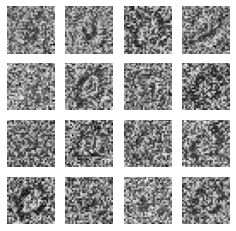

14
gen_loss: tf.Tensor(1.302094, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.31370482, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3463887, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97997224e-01 2.00276519e-03]
 [9.84638751e-01 1.53612662e-02]
 [9.97410476e-01 2.58954545e-03]
 [9.99413133e-01 5.86864131e-04]
 [9.99050200e-01 9.49777022e-04]
 [9.97809231e-01 2.19082390e-03]
 [9.98730361e-01 1.26966985e-03]
 [9.95714128e-01 4.28583054e-03]
 [9.99402046e-01 5.97954262e-04]
 [9.99706566e-01 2.93461781e-04]
 [9.99765456e-01 2.34527033e-04]
 [9.99989033e-01 1.09242683e-05]
 [4.12713945e-01 5.87285995e-01]
 [9.96495545e-01 3.50446091e-03]
 [9.99124229e-01 8.75800150e-04]
 [9.98764753e-01 1.23527262e-03]
 [9.99793589e-01 2.06473473e-04]
 [9.98956442e-01 1.04348373e-03]
 [9.98751163e-01 1.24880625e-03]
 [9.99632478e-01 3.67511559e-04]
 [8.66814435e-01 1.33185536e-01]
 [9.94980514e-01 5.01952088e-03]
 [9.99674559e-01 3.25421570e-04]
 [9.99535203e-01 4.6

 [9.98639286e-01 1.36071420e-03]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(1.3003445, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.29519182, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34581438, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97713089e-01 2.28686188e-03]
 [9.82675433e-01 1.73245948e-02]
 [9.97111559e-01 2.88846437e-03]
 [9.99339163e-01 6.60831865e-04]
 [9.98878777e-01 1.12122507e-03]
 [9.96964753e-01 3.03528016e-03]
 [9.98615146e-01 1.38483348e-03]
 [9.94909704e-01 5.09033119e-03]
 [9.99335945e-01 6.63983868e-04]
 [9.99494314e-01 5.05611417e-04]
 [9.99692321e-01 3.07743991e-04]
 [9.99985456e-01 1.45139938e-05]
 [4.32627410e-01 5.67372620e-01]
 [9.95261788e-01 4.73813806e-03]
 [9.99055922e-01 9.44063475e-04]
 [9.98470485e-01 1.52955030e-03]
 [9.99747694e-01 2.52279307e-04]
 [9.98636663e-01 1.36334286e-03]
 [9.98683274e-01 1.31671072e-03]
 [9.99529123e-01 4.70912608e-04]
 [8.43600333e-01 1.56399682e-01]
 [9.94662642e-01 5.33

gen_loss: tf.Tensor(1.308883, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.29632542, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34033787, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97674406e-01 2.32555182e-03]
 [9.80910838e-01 1.90892126e-02]
 [9.97658253e-01 2.34176638e-03]
 [9.99440253e-01 5.59785927e-04]
 [9.98958468e-01 1.04152539e-03]
 [9.96549010e-01 3.45098390e-03]
 [9.98821795e-01 1.17823260e-03]
 [9.94741201e-01 5.25881397e-03]
 [9.99442399e-01 5.57603606e-04]
 [9.99375165e-01 6.24836423e-04]
 [9.99670148e-01 3.29882780e-04]
 [9.99985933e-01 1.40932871e-05]
 [5.04078269e-01 4.95921731e-01]
 [9.95129347e-01 4.87068435e-03]
 [9.99223113e-01 7.76937639e-04]
 [9.98480022e-01 1.51994464e-03]
 [9.99751508e-01 2.48501718e-04]
 [9.98578787e-01 1.42117415e-03]
 [9.98951554e-01 1.04841124e-03]
 [9.99538660e-01 4.61320800e-04]
 [8.52553427e-01 1.47446617e-01]
 [9.94113505e-01 5.88654401e-03]
 [9.99594390e-01 4.05589439e-04]
 [9.99561131e-01 4.388

gen_loss: tf.Tensor(1.3448522, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30229712, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33298862, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97539282e-01 2.46068137e-03]
 [9.73704338e-01 2.62956452e-02]
 [9.98326719e-01 1.67329493e-03]
 [9.99647737e-01 3.52308765e-04]
 [9.99145031e-01 8.54952203e-04]
 [9.96728063e-01 3.27190454e-03]
 [9.99153018e-01 8.46971525e-04]
 [9.94369566e-01 5.63042797e-03]
 [9.99600470e-01 3.99511569e-04]
 [9.99515295e-01 4.84693359e-04]
 [9.99706209e-01 2.93782330e-04]
 [9.99990702e-01 9.24275355e-06]
 [6.00047112e-01 3.99952918e-01]
 [9.95994687e-01 4.00526822e-03]
 [9.99454081e-01 5.45926159e-04]
 [9.98690069e-01 1.30995747e-03]
 [9.99795735e-01 2.04268581e-04]
 [9.98778999e-01 1.22104946e-03]
 [9.99188244e-01 8.11736740e-04]
 [9.99636889e-01 3.63084342e-04]
 [8.94509196e-01 1.05490752e-01]
 [9.91418481e-01 8.58146790e-03]
 [9.99702871e-01 2.97114835e-04]
 [9.99727905e-01 2.72

gen_loss: tf.Tensor(1.3250427, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3524369, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33801574, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.96498704e-01 3.50126997e-03]
 [9.81784463e-01 1.82155650e-02]
 [9.96467471e-01 3.53252585e-03]
 [9.99078035e-01 9.21942119e-04]
 [9.98110890e-01 1.88913126e-03]
 [9.93935525e-01 6.06451137e-03]
 [9.98198688e-01 1.80135993e-03]
 [9.92415428e-01 7.58459931e-03]
 [9.98989165e-01 1.01085880e-03]
 [9.98680294e-01 1.31964590e-03]
 [9.99432623e-01 5.67358162e-04]
 [9.99969959e-01 2.99866242e-05]
 [4.50509727e-01 5.49490333e-01]
 [9.94260907e-01 5.73912077e-03]
 [9.98606145e-01 1.39390840e-03]
 [9.97341454e-01 2.65857019e-03]
 [9.99475539e-01 5.24497882e-04]
 [9.97725189e-01 2.27477401e-03]
 [9.98346806e-01 1.65321399e-03]
 [9.99045193e-01 9.54811752e-04]
 [8.22587311e-01 1.77412719e-01]
 [9.94156480e-01 5.84356394e-03]
 [9.99173939e-01 8.26071831e-04]
 [9.99259651e-01 7.403

gen_loss: tf.Tensor(1.2621473, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32947534, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.36209846, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.93983924e-01 6.01607515e-03]
 [9.74715352e-01 2.52846871e-02]
 [9.94890571e-01 5.10947127e-03]
 [9.98371065e-01 1.62895373e-03]
 [9.96943176e-01 3.05685191e-03]
 [9.89517272e-01 1.04826689e-02]
 [9.97204959e-01 2.79499171e-03]
 [9.88484919e-01 1.15151601e-02]
 [9.98269677e-01 1.73033250e-03]
 [9.96767879e-01 3.23218526e-03]
 [9.99082208e-01 9.17756697e-04]
 [9.99937892e-01 6.21553190e-05]
 [4.58009094e-01 5.41990936e-01]
 [9.89930630e-01 1.00693321e-02]
 [9.97697890e-01 2.30208295e-03]
 [9.95734394e-01 4.26566787e-03]
 [9.99048054e-01 9.51930066e-04]
 [9.96256113e-01 3.74382804e-03]
 [9.97339547e-01 2.66050035e-03]
 [9.98168826e-01 1.83112652e-03]
 [8.24355304e-01 1.75644681e-01]
 [9.92011607e-01 7.98834115e-03]
 [9.98316765e-01 1.68328639e-03]
 [9.98678744e-01 1.32

gen_loss: tf.Tensor(1.3834112, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30254847, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.31096327, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.94226396e-01 5.77364862e-03]
 [9.66187596e-01 3.38123664e-02]
 [9.96591568e-01 3.40850349e-03]
 [9.99186218e-01 8.13805789e-04]
 [9.98191416e-01 1.80864369e-03]
 [9.93982255e-01 6.01771474e-03]
 [9.98367250e-01 1.63275166e-03]
 [9.89608705e-01 1.03912903e-02]
 [9.99003232e-01 9.96746239e-04]
 [9.98650491e-01 1.34948560e-03]
 [9.99460280e-01 5.39698987e-04]
 [9.99974370e-01 2.56133189e-05]
 [5.51512301e-01 4.48487669e-01]
 [9.93471146e-01 6.52888604e-03]
 [9.98713493e-01 1.28650689e-03]
 [9.97723997e-01 2.27596704e-03]
 [9.99432862e-01 5.67094248e-04]
 [9.97810662e-01 2.18940875e-03]
 [9.98144984e-01 1.85505114e-03]
 [9.99063194e-01 9.36847238e-04]
 [8.98471534e-01 1.01528466e-01]
 [9.89499211e-01 1.05008278e-02]
 [9.99139190e-01 8.60765693e-04]
 [9.99336302e-01 6.63

gen_loss: tf.Tensor(1.2951488, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30104184, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34959686, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.92524207e-01 7.47582829e-03]
 [9.74207103e-01 2.57929023e-02]
 [9.94571984e-01 5.42798825e-03]
 [9.98227298e-01 1.77266309e-03]
 [9.96663272e-01 3.33671016e-03]
 [9.89872932e-01 1.01270843e-02]
 [9.97151196e-01 2.84881890e-03]
 [9.86351550e-01 1.36484364e-02]
 [9.98173833e-01 1.82617945e-03]
 [9.96612251e-01 3.38779297e-03]
 [9.99036074e-01 9.63960600e-04]
 [9.99937415e-01 6.25509128e-05]
 [4.53614801e-01 5.46385169e-01]
 [9.90253627e-01 9.74639878e-03]
 [9.97659445e-01 2.34049861e-03]
 [9.96466756e-01 3.53325112e-03]
 [9.98860955e-01 1.13902334e-03]
 [9.96130228e-01 3.86975869e-03]
 [9.97071981e-01 2.92797992e-03]
 [9.98086214e-01 1.91382959e-03]
 [8.27639401e-01 1.72360554e-01]
 [9.92525697e-01 7.47430325e-03]
 [9.98026073e-01 1.97385508e-03]
 [9.98528957e-01 1.47

gen_loss: tf.Tensor(1.3148999, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3707544, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34259668, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.93755937e-01 6.24407874e-03]
 [9.76390004e-01 2.36099306e-02]
 [9.96674657e-01 3.32537573e-03]
 [9.98724401e-01 1.27558003e-03]
 [9.97389019e-01 2.61105155e-03]
 [9.91597116e-01 8.40295199e-03]
 [9.98057663e-01 1.94230850e-03]
 [9.86988902e-01 1.30111305e-02]
 [9.98858452e-01 1.14159018e-03]
 [9.97662544e-01 2.33748555e-03]
 [9.99192774e-01 8.07212025e-04]
 [9.99958992e-01 4.10409666e-05]
 [5.21761537e-01 4.78238463e-01]
 [9.93554354e-01 6.44564675e-03]
 [9.98552144e-01 1.44782150e-03]
 [9.97210324e-01 2.78969295e-03]
 [9.99019504e-01 9.80507000e-04]
 [9.96953368e-01 3.04663694e-03]
 [9.98104215e-01 1.89572864e-03]
 [9.98674273e-01 1.32577098e-03]
 [8.73610020e-01 1.26389980e-01]
 [9.92049396e-01 7.95065146e-03]
 [9.98701334e-01 1.29861757e-03]
 [9.98909593e-01 1.090

gen_loss: tf.Tensor(1.2781236, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.34686393, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.35618922, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.95378494e-01 4.62151365e-03]
 [9.82941687e-01 1.70582794e-02]
 [9.97864068e-01 2.13594362e-03]
 [9.98929679e-01 1.07034529e-03]
 [9.97674644e-01 2.32530967e-03]
 [9.91792440e-01 8.20764434e-03]
 [9.98467147e-01 1.53282646e-03]
 [9.89894211e-01 1.01058260e-02]
 [9.99182045e-01 8.17931257e-04]
 [9.97835577e-01 2.16443930e-03]
 [9.99271810e-01 7.28153740e-04]
 [9.99959350e-01 4.06369509e-05]
 [5.90467930e-01 4.09532130e-01]
 [9.95367050e-01 4.63301130e-03]
 [9.98936474e-01 1.06358482e-03]
 [9.97403800e-01 2.59619602e-03]
 [9.99094367e-01 9.05594439e-04]
 [9.97289658e-01 2.71039316e-03]
 [9.98818219e-01 1.18180423e-03]
 [9.98929799e-01 1.07021269e-03]
 [8.80846798e-01 1.19153224e-01]
 [9.93573010e-01 6.42694812e-03]
 [9.99044001e-01 9.55960015e-04]
 [9.99056995e-01 9.42

gen_loss: tf.Tensor(1.2635424, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.36412305, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.36142159, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9306160e-01 6.9384342e-03]
 [9.8252249e-01 1.7477546e-02]
 [9.9647969e-01 3.5202922e-03]
 [9.9824631e-01 1.7537554e-03]
 [9.9597150e-01 4.0284237e-03]
 [9.8778582e-01 1.2214148e-02]
 [9.9749410e-01 2.5058696e-03]
 [9.8449022e-01 1.5509740e-02]
 [9.9862897e-01 1.3710897e-03]
 [9.9645573e-01 3.5442596e-03]
 [9.9862015e-01 1.3798808e-03]
 [9.9993861e-01 6.1397499e-05]
 [4.8434389e-01 5.1565605e-01]
 [9.9316895e-01 6.8310420e-03]
 [9.9820817e-01 1.7918198e-03]
 [9.9640602e-01 3.5939475e-03]
 [9.9860841e-01 1.3916502e-03]
 [9.9500090e-01 4.9990527e-03]
 [9.9778557e-01 2.2144017e-03]
 [9.9802339e-01 1.9766809e-03]
 [7.9657799e-01 2.0342200e-01]
 [9.9447531e-01 5.5247252e-03]
 [9.9812204e-01 1.8779302e-03]
 [9.9844521e-01 1.5547697e-03]
 [9.9875486e-01 1.2451505e-03]
 [9.3

test_discriminator_output: tf.Tensor(
[[9.91410732e-01 8.58927704e-03]
 [9.74077463e-01 2.59225797e-02]
 [9.96822357e-01 3.17762699e-03]
 [9.98706460e-01 1.29355711e-03]
 [9.96576369e-01 3.42359697e-03]
 [9.89476323e-01 1.05236927e-02]
 [9.97960448e-01 2.03956710e-03]
 [9.80443180e-01 1.95568893e-02]
 [9.98892367e-01 1.10761216e-03]
 [9.97376204e-01 2.62385840e-03]
 [9.98669267e-01 1.33072166e-03]
 [9.99959707e-01 4.02647383e-05]
 [5.28915405e-01 4.71084565e-01]
 [9.93265033e-01 6.73495932e-03]
 [9.98541832e-01 1.45818538e-03]
 [9.97131824e-01 2.86816200e-03]
 [9.98903275e-01 1.09673745e-03]
 [9.95245159e-01 4.75482550e-03]
 [9.97729838e-01 2.27014348e-03]
 [9.98395979e-01 1.60400220e-03]
 [8.34474802e-01 1.65525198e-01]
 [9.92145121e-01 7.85484072e-03]
 [9.98478353e-01 1.52166653e-03]
 [9.98881400e-01 1.11855054e-03]
 [9.98898268e-01 1.10165146e-03]
 [9.32172179e-01 6.78278655e-02]
 [9.99599636e-01 4.00392339e-04]
 [7.63297558e-01 2.36702457e-01]
 [8.32525373e-01 1.67474642e-01]
 [9.9

gen_loss: tf.Tensor(1.3917066, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3395174, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32200527, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.93295968e-01 6.70399005e-03]
 [9.73917007e-01 2.60829758e-02]
 [9.97706771e-01 2.29325308e-03]
 [9.99210119e-01 7.89905491e-04]
 [9.98025179e-01 1.97480014e-03]
 [9.93541002e-01 6.45896234e-03]
 [9.98751760e-01 1.24817889e-03]
 [9.85194385e-01 1.48056131e-02]
 [9.99280989e-01 7.19008967e-04]
 [9.98334348e-01 1.66571001e-03]
 [9.99231339e-01 7.68682919e-04]
 [9.99970794e-01 2.92177683e-05]
 [6.56004369e-01 3.43995631e-01]
 [9.96233523e-01 3.76646570e-03]
 [9.99035478e-01 9.64548555e-04]
 [9.98259604e-01 1.74034561e-03]
 [9.99301910e-01 6.98090298e-04]
 [9.97289538e-01 2.71048606e-03]
 [9.98489380e-01 1.51054934e-03]
 [9.99114931e-01 8.85102956e-04]
 [9.00103271e-01 9.98967513e-02]
 [9.90424097e-01 9.57582798e-03]
 [9.99211550e-01 7.88422534e-04]
 [9.99319792e-01 6.802

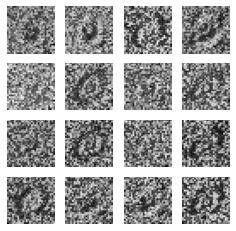

15
gen_loss: tf.Tensor(1.277926, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.34211808, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3508498, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.94759023e-01 5.24095166e-03]
 [9.86319721e-01 1.36803072e-02]
 [9.96457398e-01 3.54260439e-03]
 [9.98797655e-01 1.20228750e-03]
 [9.97604847e-01 2.39515118e-03]
 [9.93646026e-01 6.35395618e-03]
 [9.98357713e-01 1.64232624e-03]
 [9.88417327e-01 1.15826232e-02]
 [9.98908520e-01 1.09142344e-03]
 [9.97640848e-01 2.35916465e-03]
 [9.99232769e-01 7.67234655e-04]
 [9.99944448e-01 5.55489132e-05]
 [5.71393728e-01 4.28606272e-01]
 [9.96720374e-01 3.27967387e-03]
 [9.98526931e-01 1.47301471e-03]
 [9.98153865e-01 1.84613641e-03]
 [9.99052703e-01 9.47271008e-04]
 [9.97552097e-01 2.44788895e-03]
 [9.98153746e-01 1.84622256e-03]
 [9.98926461e-01 1.07356091e-03]
 [8.48192811e-01 1.51807249e-01]
 [9.94372845e-01 5.62711852e-03]
 [9.98966813e-01 1.03316165e-03]
 [9.98902559e-01 1.0

gen_loss: tf.Tensor(1.4194489, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.40569216, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.30670977, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.93631780e-01 6.36824314e-03]
 [9.81706440e-01 1.82935689e-02]
 [9.96466994e-01 3.53298243e-03]
 [9.98767614e-01 1.23243139e-03]
 [9.97280836e-01 2.71914061e-03]
 [9.92287517e-01 7.71255465e-03]
 [9.98309016e-01 1.69099565e-03]
 [9.85311508e-01 1.46884918e-02]
 [9.98909831e-01 1.09012029e-03]
 [9.96997595e-01 3.00237816e-03]
 [9.99061763e-01 9.38296667e-04]
 [9.99944806e-01 5.52140773e-05]
 [5.97682536e-01 4.02317464e-01]
 [9.95551348e-01 4.44862479e-03]
 [9.98518407e-01 1.48159266e-03]
 [9.97909129e-01 2.09082570e-03]
 [9.98969436e-01 1.03062356e-03]
 [9.97186720e-01 2.81332317e-03]
 [9.97912943e-01 2.08708830e-03]
 [9.98808742e-01 1.19123398e-03]
 [8.52351069e-01 1.47648916e-01]
 [9.92248893e-01 7.75111280e-03]
 [9.98827994e-01 1.17205025e-03]
 [9.98878539e-01 1.12

gen_loss: tf.Tensor(1.3411502, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.37460816, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33357227, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.92468774e-01 7.53120333e-03]
 [9.68710423e-01 3.12895812e-02]
 [9.97149765e-01 2.85029318e-03]
 [9.99101996e-01 8.98021099e-04]
 [9.97481644e-01 2.51843268e-03]
 [9.91636574e-01 8.36335123e-03]
 [9.98663545e-01 1.33645814e-03]
 [9.79557037e-01 2.04429980e-02]
 [9.99216557e-01 7.83380121e-04]
 [9.96804357e-01 3.19563947e-03]
 [9.98924315e-01 1.07561657e-03]
 [9.99961019e-01 3.89578163e-05]
 [6.74473763e-01 3.25526267e-01]
 [9.93975341e-01 6.02470152e-03]
 [9.98876989e-01 1.12305838e-03]
 [9.97899413e-01 2.10062135e-03]
 [9.99076843e-01 9.23196960e-04]
 [9.97305036e-01 2.69489549e-03]
 [9.97995615e-01 2.00438220e-03]
 [9.99040067e-01 9.59955447e-04]
 [8.96016419e-01 1.03983589e-01]
 [9.85358119e-01 1.46419136e-02]
 [9.98999894e-01 1.00017758e-03]
 [9.99194205e-01 8.05

gen_loss: tf.Tensor(1.3965068, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35242975, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.31001687, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.94687319e-01 5.31271426e-03]
 [9.80308294e-01 1.96916610e-02]
 [9.96027708e-01 3.97234736e-03]
 [9.98706698e-01 1.29325641e-03]
 [9.96993542e-01 3.00647039e-03]
 [9.89644170e-01 1.03558004e-02]
 [9.98324335e-01 1.67563919e-03]
 [9.84678030e-01 1.53220305e-02]
 [9.98890698e-01 1.10935245e-03]
 [9.93760169e-01 6.23982493e-03]
 [9.98941362e-01 1.05861377e-03]
 [9.99895573e-01 1.04475213e-04]
 [6.77255452e-01 3.22744548e-01]
 [9.93545055e-01 6.45499816e-03]
 [9.98408735e-01 1.59125484e-03]
 [9.97236192e-01 2.76379753e-03]
 [9.98701811e-01 1.29814458e-03]
 [9.97229993e-01 2.77000223e-03]
 [9.98102129e-01 1.89787010e-03]
 [9.98788059e-01 1.21193950e-03]
 [8.70081246e-01 1.29918814e-01]
 [9.89382803e-01 1.06171798e-02]
 [9.98674631e-01 1.32538215e-03]
 [9.98761058e-01 1.23

disc_real_loss: tf.Tensor(0.32168233, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.32366985, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.95370567e-01 4.62946761e-03]
 [9.83479738e-01 1.65202729e-02]
 [9.95308697e-01 4.69126180e-03]
 [9.98444855e-01 1.55512861e-03]
 [9.96732950e-01 3.26702534e-03]
 [9.88837838e-01 1.11621786e-02]
 [9.98076200e-01 1.92384119e-03]
 [9.85935092e-01 1.40648969e-02]
 [9.98641312e-01 1.35864748e-03]
 [9.92016554e-01 7.98348151e-03]
 [9.98919845e-01 1.08012010e-03]
 [9.99842644e-01 1.57327755e-04]
 [6.71735942e-01 3.28264058e-01]
 [9.93926466e-01 6.07350515e-03]
 [9.98083234e-01 1.91678747e-03]
 [9.96856809e-01 3.14314803e-03]
 [9.98444498e-01 1.55554793e-03]
 [9.97074485e-01 2.92550330e-03]
 [9.98106360e-01 1.89357705e-03]
 [9.98603642e-01 1.39631773e-03]
 [8.63029838e-01 1.36970147e-01]
 [9.90511239e-01 9.48872417e-03]
 [9.98413444e-01 1.58656167e-03]
 [9.98466611e-01 1.53344555e-03]
 [9.97978628e-01 2.02136720e-03]
 [9.7252017

gen_loss: tf.Tensor(1.339504, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.309188, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33164227, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.94070232e-01 5.92977880e-03]
 [9.75309730e-01 2.46902835e-02]
 [9.95546818e-01 4.45312914e-03]
 [9.98735368e-01 1.26465142e-03]
 [9.96984780e-01 3.01519153e-03]
 [9.89440620e-01 1.05593428e-02]
 [9.98174310e-01 1.82571623e-03]
 [9.79891717e-01 2.01082993e-02]
 [9.98707056e-01 1.29290542e-03]
 [9.93906200e-01 6.09378936e-03]
 [9.98599112e-01 1.40084233e-03]
 [9.99884129e-01 1.15907191e-04]
 [6.80173695e-01 3.19826275e-01]
 [9.94720697e-01 5.27929515e-03]
 [9.98228252e-01 1.77177077e-03]
 [9.96994257e-01 3.00569437e-03]
 [9.98345256e-01 1.65470911e-03]
 [9.96641397e-01 3.35858879e-03]
 [9.98024106e-01 1.97593309e-03]
 [9.98628139e-01 1.37190882e-03]
 [8.93483758e-01 1.06516205e-01]
 [9.86780822e-01 1.32192140e-02]
 [9.98295128e-01 1.70491228e-03]
 [9.98747945e-01 1.25206

gen_loss: tf.Tensor(1.3076234, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.34269127, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3437027, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.90916431e-01 9.08356905e-03]
 [9.69548106e-01 3.04518789e-02]
 [9.95963693e-01 4.03626729e-03]
 [9.98633087e-01 1.36691751e-03]
 [9.96573448e-01 3.42662144e-03]
 [9.87977207e-01 1.20228268e-02]
 [9.97833431e-01 2.16652569e-03]
 [9.72312987e-01 2.76870057e-02]
 [9.98503685e-01 1.49634189e-03]
 [9.93146598e-01 6.85336767e-03]
 [9.97684360e-01 2.31559086e-03]
 [9.99875307e-01 1.24668470e-04]
 [6.84668958e-01 3.15331012e-01]
 [9.94890094e-01 5.10990247e-03]
 [9.98024821e-01 1.97520177e-03]
 [9.96653616e-01 3.34636867e-03]
 [9.97492313e-01 2.50775390e-03]
 [9.95440483e-01 4.55948850e-03]
 [9.97714281e-01 2.28576362e-03]
 [9.98225510e-01 1.77447987e-03]
 [8.97968233e-01 1.02031775e-01]
 [9.84804928e-01 1.51950121e-02]
 [9.97566700e-01 2.43331911e-03]
 [9.98601615e-01 1.398

gen_loss: tf.Tensor(1.3497291, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.31371883, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33120528, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.92152274e-01 7.84772448e-03]
 [9.69241619e-01 3.07583194e-02]
 [9.97410595e-01 2.58937036e-03]
 [9.99003470e-01 9.96536459e-04]
 [9.97348547e-01 2.65144347e-03]
 [9.91105855e-01 8.89412500e-03]
 [9.98439372e-01 1.56057486e-03]
 [9.76555169e-01 2.34448221e-02]
 [9.99004900e-01 9.95120965e-04]
 [9.95206773e-01 4.79324488e-03]
 [9.98037040e-01 1.96295953e-03]
 [9.99906301e-01 9.36761062e-05]
 [7.27558970e-01 2.72441059e-01]
 [9.96398330e-01 3.60166025e-03]
 [9.98607457e-01 1.39257836e-03]
 [9.97497141e-01 2.50289403e-03]
 [9.97517347e-01 2.48265220e-03]
 [9.96610701e-01 3.38925794e-03]
 [9.98259008e-01 1.74103503e-03]
 [9.98787701e-01 1.21228746e-03]
 [9.24559534e-01 7.54404515e-02]
 [9.84301150e-01 1.56988446e-02]
 [9.98244166e-01 1.75589113e-03]
 [9.98967409e-01 1.03

gen_loss: tf.Tensor(1.3267837, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30752894, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33364087, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.95036781e-01 4.96325316e-03]
 [9.71934676e-01 2.80653313e-02]
 [9.98488665e-01 1.51130836e-03]
 [9.99454796e-01 5.45241288e-04]
 [9.98482049e-01 1.51792122e-03]
 [9.94151771e-01 5.84821077e-03]
 [9.99230266e-01 7.69793114e-04]
 [9.85668302e-01 1.43317292e-02]
 [9.99506116e-01 4.93852072e-04]
 [9.96744633e-01 3.25529673e-03]
 [9.98929083e-01 1.07090874e-03]
 [9.99929905e-01 7.00706078e-05]
 [8.12183678e-01 1.87816322e-01]
 [9.97960091e-01 2.03988049e-03]
 [9.99269307e-01 7.30640080e-04]
 [9.98479426e-01 1.52060192e-03]
 [9.98226583e-01 1.77345658e-03]
 [9.98189747e-01 1.81024987e-03]
 [9.99123752e-01 8.76238395e-04]
 [9.99406695e-01 5.93319011e-04]
 [9.55758572e-01 4.42414545e-02]
 [9.83742774e-01 1.62572470e-02]
 [9.99175012e-01 8.24950868e-04]
 [9.99452770e-01 5.47

test_discriminator_output: tf.Tensor(
[[9.92536962e-01 7.46300956e-03]
 [9.70074773e-01 2.99252551e-02]
 [9.97826397e-01 2.17352388e-03]
 [9.99026895e-01 9.73085640e-04]
 [9.97637987e-01 2.36197188e-03]
 [9.90385056e-01 9.61494446e-03]
 [9.98910666e-01 1.08928152e-03]
 [9.81359184e-01 1.86408702e-02]
 [9.99224305e-01 7.75706256e-04]
 [9.92017150e-01 7.98287615e-03]
 [9.98206973e-01 1.79306651e-03]
 [9.99855995e-01 1.43969359e-04]
 [8.10871243e-01 1.89128786e-01]
 [9.96822596e-01 3.17746401e-03]
 [9.98899460e-01 1.10046461e-03]
 [9.97669995e-01 2.32995488e-03]
 [9.97017741e-01 2.98227882e-03]
 [9.96937752e-01 3.06224916e-03]
 [9.98741090e-01 1.25887664e-03]
 [9.98926342e-01 1.07358594e-03]
 [9.45723474e-01 5.42765260e-02]
 [9.83044982e-01 1.69549696e-02]
 [9.98376727e-01 1.62320037e-03]
 [9.99034524e-01 9.65452287e-04]
 [9.96929705e-01 3.07033770e-03]
 [9.67376232e-01 3.26237231e-02]
 [9.99449790e-01 5.50152326e-04]
 [8.14130545e-01 1.85869470e-01]
 [6.65841579e-01 3.34158450e-01]
 [9.9

gen_loss: tf.Tensor(1.3076525, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32295474, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3529076, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.85156775e-01 1.48432544e-02]
 [9.62778568e-01 3.72214057e-02]
 [9.96868551e-01 3.13141942e-03]
 [9.98512328e-01 1.48761075e-03]
 [9.96667445e-01 3.33256787e-03]
 [9.88531947e-01 1.14680016e-02]
 [9.98594344e-01 1.40560372e-03]
 [9.68435287e-01 3.15647312e-02]
 [9.98819649e-01 1.18029385e-03]
 [9.86001968e-01 1.39980307e-02]
 [9.96650279e-01 3.34970048e-03]
 [9.99806583e-01 1.93468324e-04]
 [8.14690471e-01 1.85309544e-01]
 [9.96220648e-01 3.77937383e-03]
 [9.98352647e-01 1.64735643e-03]
 [9.97291267e-01 2.70871003e-03]
 [9.95650589e-01 4.34940122e-03]
 [9.95504677e-01 4.49536555e-03]
 [9.97714758e-01 2.28529493e-03]
 [9.98295844e-01 1.70413905e-03]
 [9.54639137e-01 4.53608595e-02]
 [9.79166090e-01 2.08338611e-02]
 [9.96968091e-01 3.03191692e-03]
 [9.98549521e-01 1.450

gen_loss: tf.Tensor(1.361155, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.4437194, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3273708, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.79457617e-01 2.05424242e-02]
 [9.50160205e-01 4.98398654e-02]
 [9.97143328e-01 2.85667391e-03]
 [9.98593867e-01 1.40614063e-03]
 [9.96716559e-01 3.28346668e-03]
 [9.90110815e-01 9.88914631e-03]
 [9.98754144e-01 1.24580879e-03]
 [9.55300272e-01 4.46997844e-02]
 [9.98891294e-01 1.10868737e-03]
 [9.86045301e-01 1.39546804e-02]
 [9.95778918e-01 4.22108825e-03]
 [9.99852419e-01 1.47538347e-04]
 [8.47214520e-01 1.52785495e-01]
 [9.96878386e-01 3.12164775e-03]
 [9.98422623e-01 1.57742377e-03]
 [9.97698367e-01 2.30160542e-03]
 [9.95971978e-01 4.02802555e-03]
 [9.95584309e-01 4.41576773e-03]
 [9.97129261e-01 2.87072430e-03]
 [9.98441041e-01 1.55894714e-03]
 [9.74732459e-01 2.52675563e-02]
 [9.70457911e-01 2.95421481e-02]
 [9.96767402e-01 3.23258759e-03]
 [9.98681486e-01 1.31848

gen_loss: tf.Tensor(1.3876235, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.34143022, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3131693, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.88664865e-01 1.13351513e-02]
 [9.75225627e-01 2.47743949e-02]
 [9.96456563e-01 3.54338880e-03]
 [9.97550786e-01 2.44924682e-03]
 [9.96268094e-01 3.73197044e-03]
 [9.88982856e-01 1.10171288e-02]
 [9.98558700e-01 1.44129142e-03]
 [9.72771764e-01 2.72282138e-02]
 [9.98561800e-01 1.43825042e-03]
 [9.76207554e-01 2.37925090e-02]
 [9.96723831e-01 3.27623379e-03]
 [9.99551117e-01 4.48896113e-04]
 [8.52729738e-01 1.47270188e-01]
 [9.97833431e-01 2.16662907e-03]
 [9.97838676e-01 2.16137152e-03]
 [9.97403800e-01 2.59615993e-03]
 [9.95285809e-01 4.71417466e-03]
 [9.96173084e-01 3.82695906e-03]
 [9.97449934e-01 2.55002314e-03]
 [9.98302341e-01 1.69764063e-03]
 [9.74770963e-01 2.52289753e-02]
 [9.80217934e-01 1.97820663e-02]
 [9.96339440e-01 3.66061530e-03]
 [9.97651875e-01 2.348

test_discriminator_output: tf.Tensor(
[[9.92221177e-01 7.77879870e-03]
 [9.76526320e-01 2.34736446e-02]
 [9.96679902e-01 3.32012633e-03]
 [9.97662663e-01 2.33732769e-03]
 [9.96828735e-01 3.17126838e-03]
 [9.88918722e-01 1.10812485e-02]
 [9.98797059e-01 1.20295596e-03]
 [9.79481101e-01 2.05188841e-02]
 [9.98774469e-01 1.22557208e-03]
 [9.73915040e-01 2.60849800e-02]
 [9.97628152e-01 2.37192819e-03]
 [9.99368846e-01 6.31181523e-04]
 [8.75215709e-01 1.24784291e-01]
 [9.98043656e-01 1.95632223e-03]
 [9.98096406e-01 1.90362346e-03]
 [9.97559190e-01 2.44077761e-03]
 [9.95970666e-01 4.02928470e-03]
 [9.96858120e-01 3.14186048e-03]
 [9.98085856e-01 1.91410899e-03]
 [9.98624802e-01 1.37523992e-03]
 [9.77243781e-01 2.27562413e-02]
 [9.78945315e-01 2.10547261e-02]
 [9.97285247e-01 2.71474547e-03]
 [9.97757852e-01 2.24212324e-03]
 [9.94910419e-01 5.08953631e-03]
 [9.77608800e-01 2.23912001e-02]
 [9.98386502e-01 1.61346374e-03]
 [8.39733303e-01 1.60266772e-01]
 [6.38752043e-01 3.61247957e-01]
 [9.9

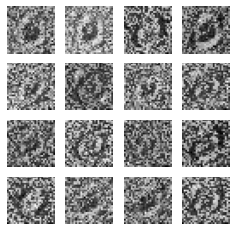

16
gen_loss: tf.Tensor(1.316974, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35570812, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.34501225, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.94136572e-01 5.86342579e-03]
 [9.69668925e-01 3.03310528e-02]
 [9.97594774e-01 2.40526279e-03]
 [9.98478830e-01 1.52114197e-03]
 [9.97732401e-01 2.26751948e-03]
 [9.90403056e-01 9.59688425e-03]
 [9.99206126e-01 7.93943647e-04]
 [9.83129799e-01 1.68701708e-02]
 [9.99230146e-01 7.69866107e-04]
 [9.78785276e-01 2.12147273e-02]
 [9.98358786e-01 1.64118910e-03]
 [9.99442399e-01 5.57640858e-04]
 [9.12280083e-01 8.77199396e-02]
 [9.98201847e-01 1.79809681e-03]
 [9.98749018e-01 1.25093723e-03]
 [9.98099625e-01 1.90042623e-03]
 [9.97247636e-01 2.75234808e-03]
 [9.97718990e-01 2.28100317e-03]
 [9.98748064e-01 1.25190080e-03]
 [9.99129355e-01 8.70642369e-04]
 [9.83680367e-01 1.63196474e-02]
 [9.71073627e-01 2.89264154e-02]
 [9.98466790e-01 1.53312995e-03]
 [9.98538971e-01 1.

 [9.77115870e-01 2.28841249e-02]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(1.3707356, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35898197, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3266021, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9461305e-01 5.3870096e-03]
 [9.5913595e-01 4.0864028e-02]
 [9.9796909e-01 2.0309088e-03]
 [9.9885893e-01 1.1410411e-03]
 [9.9803370e-01 1.9662760e-03]
 [9.9083966e-01 9.1602951e-03]
 [9.9935061e-01 6.4943789e-04]
 [9.8476958e-01 1.5230373e-02]
 [9.9939454e-01 6.0549751e-04]
 [9.8047608e-01 1.9523963e-02]
 [9.9861181e-01 1.3881510e-03]
 [9.9945623e-01 5.4376008e-04]
 [9.3623745e-01 6.3762575e-02]
 [9.9807680e-01 1.9231765e-03]
 [9.9896920e-01 1.0308198e-03]
 [9.9826616e-01 1.7338572e-03]
 [9.9780291e-01 2.1970239e-03]
 [9.9802220e-01 1.9777967e-03]
 [9.9899668e-01 1.0032916e-03]
 [9.9931443e-01 6.8557367e-04]
 [9.8720890e-01 1.2791152e-02]
 [9.6031237e-01 3.9687589e-02]
 [9.9892682e-01 1.0732005e-03]
 [

gen_loss: tf.Tensor(1.3384519, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35451585, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.33591127, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.93150949e-01 6.84901327e-03]
 [9.59548473e-01 4.04514857e-02]
 [9.96880889e-01 3.11911711e-03]
 [9.98335779e-01 1.66420231e-03]
 [9.96907055e-01 3.09292786e-03]
 [9.88327563e-01 1.16723962e-02]
 [9.98980463e-01 1.01945270e-03]
 [9.81968820e-01 1.80311650e-02]
 [9.99044359e-01 9.55590745e-04]
 [9.74084139e-01 2.59158425e-02]
 [9.97927547e-01 2.07241392e-03]
 [9.99189794e-01 8.10176134e-04]
 [9.15312946e-01 8.46870020e-02]
 [9.97350335e-01 2.64970819e-03]
 [9.98291552e-01 1.70841289e-03]
 [9.97545421e-01 2.45461194e-03]
 [9.96883214e-01 3.11679789e-03]
 [9.97209728e-01 2.79032975e-03]
 [9.98389244e-01 1.61078374e-03]
 [9.98957872e-01 1.04209012e-03]
 [9.80882585e-01 1.91173833e-02]
 [9.63057458e-01 3.69425043e-02]
 [9.98327076e-01 1.67296687e-03]
 [9.98348951e-01 1.65

gen_loss: tf.Tensor(1.369267, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.34100533, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3210207, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.8964614e-01 1.0353820e-02]
 [9.7326565e-01 2.6734339e-02]
 [9.9467921e-01 5.3208494e-03]
 [9.9705088e-01 2.9490998e-03]
 [9.9422604e-01 5.7740435e-03]
 [9.8602784e-01 1.3972230e-02]
 [9.9793208e-01 2.0679347e-03]
 [9.7819430e-01 2.1805681e-02]
 [9.9794298e-01 2.0569791e-03]
 [9.6707082e-01 3.2929219e-02]
 [9.9571145e-01 4.2886194e-03]
 [9.9879873e-01 1.2013065e-03]
 [8.6733055e-01 1.3266940e-01]
 [9.9734038e-01 2.6595779e-03]
 [9.9603313e-01 3.9668079e-03]
 [9.9626225e-01 3.7376832e-03]
 [9.9420089e-01 5.7991329e-03]
 [9.9537224e-01 4.6277209e-03]
 [9.9675447e-01 3.2455379e-03]
 [9.9785680e-01 2.1431646e-03]
 [9.6995229e-01 3.0047776e-02]
 [9.7630459e-01 2.3695389e-02]
 [9.9627787e-01 3.7221187e-03]
 [9.9697864e-01 3.0214279e-03]
 [9.9165338e-01 8.3466535e-03]
 [9.663

gen_loss: tf.Tensor(1.4132073, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.35162526, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3151145, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.85094309e-01 1.49057200e-02]
 [9.56182241e-01 4.38177399e-02]
 [9.96151507e-01 3.84848029e-03]
 [9.97542620e-01 2.45740637e-03]
 [9.95068431e-01 4.93152998e-03]
 [9.84538913e-01 1.54610621e-02]
 [9.98117447e-01 1.88254693e-03]
 [9.73926842e-01 2.60731522e-02]
 [9.98169303e-01 1.83072407e-03]
 [9.60039020e-01 3.99609990e-02]
 [9.94443595e-01 5.55643765e-03]
 [9.98983920e-01 1.01609295e-03]
 [9.23731923e-01 7.62680694e-02]
 [9.97272432e-01 2.72751693e-03]
 [9.96395648e-01 3.60442372e-03]
 [9.96372342e-01 3.62763344e-03]
 [9.94484007e-01 5.51597122e-03]
 [9.94410813e-01 5.58920158e-03]
 [9.97010231e-01 2.98976689e-03]
 [9.97660756e-01 2.33921199e-03]
 [9.84335661e-01 1.56643558e-02]
 [9.58883584e-01 4.11164500e-02]
 [9.96364772e-01 3.63528403e-03]
 [9.97546017e-01 2.453

gen_loss: tf.Tensor(1.4067353, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.36155033, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.31233042, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.89478528e-01 1.05214780e-02]
 [9.55614328e-01 4.43856493e-02]
 [9.96249974e-01 3.75003717e-03]
 [9.98284876e-01 1.71510270e-03]
 [9.96656179e-01 3.34382197e-03]
 [9.89457726e-01 1.05422782e-02]
 [9.98586535e-01 1.41352578e-03]
 [9.76850390e-01 2.31496487e-02]
 [9.98679578e-01 1.32037071e-03]
 [9.70018685e-01 2.99813617e-02]
 [9.96222138e-01 3.77783715e-03]
 [9.99140859e-01 8.59103573e-04]
 [8.97980630e-01 1.02019362e-01]
 [9.97514844e-01 2.48517585e-03]
 [9.97213423e-01 2.78662238e-03]
 [9.97857273e-01 2.14271480e-03]
 [9.96221304e-01 3.77866626e-03]
 [9.96497869e-01 3.50211374e-03]
 [9.97295678e-01 2.70437822e-03]
 [9.98641312e-01 1.35869673e-03]
 [9.83919203e-01 1.60808135e-02]
 [9.59543645e-01 4.04563285e-02]
 [9.97885168e-01 2.11485615e-03]
 [9.98265326e-01 1.73

gen_loss: tf.Tensor(1.4569905, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3038691, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3045242, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.91969883e-01 8.03015195e-03]
 [9.63183880e-01 3.68161239e-02]
 [9.96626496e-01 3.37358750e-03]
 [9.98582363e-01 1.41770649e-03]
 [9.97498214e-01 2.50179088e-03]
 [9.91419196e-01 8.58081970e-03]
 [9.98784244e-01 1.21578807e-03]
 [9.78992999e-01 2.10070349e-02]
 [9.98946249e-01 1.05380162e-03]
 [9.73093510e-01 2.69065369e-02]
 [9.97073174e-01 2.92686676e-03]
 [9.99040186e-01 9.59726691e-04]
 [9.06638741e-01 9.33612660e-02]
 [9.97968256e-01 2.03167810e-03]
 [9.97554362e-01 2.44562863e-03]
 [9.98382092e-01 1.61792804e-03]
 [9.96637225e-01 3.36279883e-03]
 [9.97666955e-01 2.33306619e-03]
 [9.97571170e-01 2.42884737e-03]
 [9.99094725e-01 9.05334018e-04]
 [9.88056183e-01 1.19438218e-02]
 [9.59898770e-01 4.01012525e-02]
 [9.98529553e-01 1.47044507e-03]
 [9.98544455e-01 1.4555

gen_loss: tf.Tensor(1.4279741, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3064104, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.30755073, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.86280560e-01 1.37194348e-02]
 [9.65528369e-01 3.44716534e-02]
 [9.96970892e-01 3.02905007e-03]
 [9.98003304e-01 1.99666992e-03]
 [9.96825814e-01 3.17422766e-03]
 [9.86671031e-01 1.33289918e-02]
 [9.98396337e-01 1.60362036e-03]
 [9.66728449e-01 3.32715735e-02]
 [9.98690784e-01 1.30920147e-03]
 [9.46706772e-01 5.32932580e-02]
 [9.94157791e-01 5.84219536e-03]
 [9.98414278e-01 1.58576143e-03]
 [9.36318338e-01 6.36816621e-02]
 [9.97720778e-01 2.27921759e-03]
 [9.96945560e-01 3.05442140e-03]
 [9.97568786e-01 2.43124249e-03]
 [9.94166613e-01 5.83336409e-03]
 [9.96161461e-01 3.83854494e-03]
 [9.97261047e-01 2.73891585e-03]
 [9.98544455e-01 1.45559246e-03]
 [9.91294563e-01 8.70540738e-03]
 [9.57336426e-01 4.26635966e-02]
 [9.97637391e-01 2.36258423e-03]
 [9.97961640e-01 2.038

gen_loss: tf.Tensor(1.4715271, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3053437, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2946877, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.81348038e-01 1.86519492e-02]
 [9.68472660e-01 3.15272920e-02]
 [9.94721055e-01 5.27897011e-03]
 [9.96967971e-01 3.03209038e-03]
 [9.95713353e-01 4.28661611e-03]
 [9.84810412e-01 1.51896058e-02]
 [9.97479975e-01 2.52004550e-03]
 [9.55150366e-01 4.48496193e-02]
 [9.97694194e-01 2.30582943e-03]
 [9.26056623e-01 7.39433765e-02]
 [9.91809547e-01 8.19052104e-03]
 [9.96923864e-01 3.07609653e-03]
 [9.20394480e-01 7.96055421e-02]
 [9.97066796e-01 2.93317856e-03]
 [9.94544268e-01 5.45578357e-03]
 [9.97154117e-01 2.84586614e-03]
 [9.91999328e-01 8.00073892e-03]
 [9.94935572e-01 5.06450655e-03]
 [9.95598674e-01 4.40134387e-03]
 [9.97919500e-01 2.08046357e-03]
 [9.88239169e-01 1.17608281e-02]
 [9.67079401e-01 3.29205915e-02]
 [9.96546447e-01 3.45354970e-03]
 [9.96909916e-01 3.0901

gen_loss: tf.Tensor(1.46829, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30592, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.3067238, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.86007512e-01 1.39924772e-02]
 [9.66860652e-01 3.31393294e-02]
 [9.94678259e-01 5.32178069e-03]
 [9.98027623e-01 1.97232724e-03]
 [9.97101009e-01 2.89891334e-03]
 [9.92322505e-01 7.67748384e-03]
 [9.98144269e-01 1.85572845e-03]
 [9.65972543e-01 3.40275019e-02]
 [9.98075604e-01 1.92442897e-03]
 [9.66781020e-01 3.32189910e-02]
 [9.95359361e-01 4.64059459e-03]
 [9.97662902e-01 2.33712327e-03]
 [9.26881015e-01 7.31189772e-02]
 [9.98144507e-01 1.85544742e-03]
 [9.95183647e-01 4.81640175e-03]
 [9.98365700e-01 1.63433037e-03]
 [9.94786024e-01 5.21394890e-03]
 [9.97413456e-01 2.58659129e-03]
 [9.96244729e-01 3.75528540e-03]
 [9.98902798e-01 1.09721592e-03]
 [9.91243362e-01 8.75665154e-03]
 [9.68312800e-01 3.16871814e-02]
 [9.98170733e-01 1.82926247e-03]
 [9.98022437e-01 1.97754242

gen_loss: tf.Tensor(1.4866725, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.33422428, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.28756917, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.79303062e-01 2.06969194e-02]
 [9.52444553e-01 4.75554429e-02]
 [9.92236078e-01 7.76387053e-03]
 [9.96083260e-01 3.91672039e-03]
 [9.94814157e-01 5.18581690e-03]
 [9.84156311e-01 1.58437118e-02]
 [9.96987760e-01 3.01222457e-03]
 [9.50357616e-01 4.96423915e-02]
 [9.96623278e-01 3.37666692e-03]
 [9.05598223e-01 9.44017693e-02]
 [9.92098689e-01 7.90133886e-03]
 [9.93742645e-01 6.25730911e-03]
 [9.39336956e-01 6.06630743e-02]
 [9.96249259e-01 3.75075685e-03]
 [9.91621494e-01 8.37850384e-03]
 [9.96627510e-01 3.37243639e-03]
 [9.90144134e-01 9.85588040e-03]
 [9.95029032e-01 4.97094309e-03]
 [9.95027959e-01 4.97205369e-03]
 [9.97693241e-01 2.30675866e-03]
 [9.89755452e-01 1.02445204e-02]
 [9.54082668e-01 4.59172763e-02]
 [9.96555328e-01 3.44468281e-03]
 [9.96112943e-01 3.88

test_discriminator_output: tf.Tensor(
[[9.75337446e-01 2.46625617e-02]
 [9.51881468e-01 4.81185429e-02]
 [9.89696741e-01 1.03032766e-02]
 [9.94059443e-01 5.94052253e-03]
 [9.92315114e-01 7.68490881e-03]
 [9.77900088e-01 2.20998786e-02]
 [9.95815098e-01 4.18486213e-03]
 [9.38197613e-01 6.18023723e-02]
 [9.95272458e-01 4.72757267e-03]
 [8.54499936e-01 1.45500064e-01]
 [9.88740146e-01 1.12598334e-02]
 [9.90182698e-01 9.81727708e-03]
 [9.29295182e-01 7.07048997e-02]
 [9.94708419e-01 5.29158441e-03]
 [9.88055825e-01 1.19442046e-02]
 [9.95135605e-01 4.86445706e-03]
 [9.85746264e-01 1.42537467e-02]
 [9.93101716e-01 6.89832866e-03]
 [9.93260205e-01 6.73979707e-03]
 [9.96552348e-01 3.44765000e-03]
 [9.86185491e-01 1.38145220e-02]
 [9.54695880e-01 4.53041531e-02]
 [9.94792640e-01 5.20728249e-03]
 [9.94145870e-01 5.85411629e-03]
 [9.82880533e-01 1.71194412e-02]
 [9.71053183e-01 2.89468057e-02]
 [9.95543659e-01 4.45641205e-03]
 [7.76011884e-01 2.23988041e-01]
 [7.06976116e-01 2.93023914e-01]
 [9.9

gen_loss: tf.Tensor(1.4930408, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.32363546, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.29329842, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.73388314e-01 2.66117025e-02]
 [9.38966453e-01 6.10334948e-02]
 [9.89656806e-01 1.03432387e-02]
 [9.95176435e-01 4.82358597e-03]
 [9.92378354e-01 7.62161007e-03]
 [9.83320534e-01 1.66794546e-02]
 [9.96199787e-01 3.80023173e-03]
 [9.28362787e-01 7.16372505e-02]
 [9.95811820e-01 4.18815808e-03]
 [9.11653876e-01 8.83461386e-02]
 [9.88625646e-01 1.13744056e-02]
 [9.94228005e-01 5.77204255e-03]
 [9.17487562e-01 8.25124159e-02]
 [9.95181859e-01 4.81809489e-03]
 [9.88877714e-01 1.11223124e-02]
 [9.96109903e-01 3.89010622e-03]
 [9.87687409e-01 1.23125818e-02]
 [9.94375706e-01 5.62435528e-03]
 [9.91654634e-01 8.34534224e-03]
 [9.97292459e-01 2.70748278e-03]
 [9.87191677e-01 1.28083471e-02]
 [9.44785833e-01 5.52141070e-02]
 [9.95534062e-01 4.46596695e-03]
 [9.95457172e-01 4.54

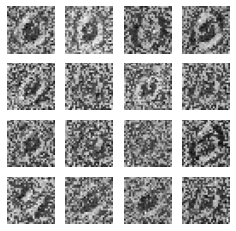

17
gen_loss: tf.Tensor(1.4883194, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3242419, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.29640847, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.64046836e-01 3.59531865e-02]
 [9.11820650e-01 8.81792605e-02]
 [9.89924371e-01 1.00756474e-02]
 [9.95364666e-01 4.63531632e-03]
 [9.91350412e-01 8.64958577e-03]
 [9.81326222e-01 1.86737552e-02]
 [9.96288419e-01 3.71162337e-03]
 [9.13005412e-01 8.69945884e-02]
 [9.95997667e-01 4.00232105e-03]
 [9.05024230e-01 9.49757919e-02]
 [9.85660076e-01 1.43398875e-02]
 [9.95567977e-01 4.43196762e-03]
 [9.25599873e-01 7.44001269e-02]
 [9.93127942e-01 6.87209750e-03]
 [9.89739895e-01 1.02600716e-02]
 [9.95985448e-01 4.01455024e-03]
 [9.87725079e-01 1.22749461e-02]
 [9.93626833e-01 6.37312932e-03]
 [9.89137948e-01 1.08620627e-02]
 [9.97180223e-01 2.81980913e-03]
 [9.88354445e-01 1.16455387e-02]
 [9.22859848e-01 7.71401301e-02]
 [9.95056510e-01 4.94354405e-03]
 [9.95819926e-01 4.

gen_loss: tf.Tensor(1.5141319, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3093938, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.28466225, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.66851890e-01 3.31481695e-02]
 [9.33302343e-01 6.66976571e-02]
 [9.86158907e-01 1.38411112e-02]
 [9.92152393e-01 7.84760620e-03]
 [9.87900257e-01 1.20997364e-02]
 [9.72248554e-01 2.77515203e-02]
 [9.94866729e-01 5.13325585e-03]
 [9.24805582e-01 7.51944408e-02]
 [9.93745804e-01 6.25418779e-03]
 [8.21653068e-01 1.78346962e-01]
 [9.83249426e-01 1.67505443e-02]
 [9.90022361e-01 9.97765735e-03]
 [9.20559347e-01 7.94406384e-02]
 [9.92058992e-01 7.94100203e-03]
 [9.84320879e-01 1.56790726e-02]
 [9.94031131e-01 5.96882403e-03]
 [9.81707156e-01 1.82929114e-02]
 [9.91721034e-01 8.27897061e-03]
 [9.87378418e-01 1.26215676e-02]
 [9.95692194e-01 4.30776738e-03]
 [9.85883057e-01 1.41168768e-02]
 [9.34671044e-01 6.53289780e-02]
 [9.92395878e-01 7.60418549e-03]
 [9.92491663e-01 7.508

gen_loss: tf.Tensor(1.4856126, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.27668375, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.28523728, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.57812488e-01 4.21875603e-02]
 [9.02019262e-01 9.79807526e-02]
 [9.83491123e-01 1.65088866e-02]
 [9.89817917e-01 1.01820296e-02]
 [9.84747708e-01 1.52523024e-02]
 [9.65236306e-01 3.47637460e-02]
 [9.93547976e-01 6.45204447e-03]
 [8.95110369e-01 1.04889624e-01]
 [9.91859138e-01 8.14085640e-03]
 [7.97667861e-01 2.02332124e-01]
 [9.80038822e-01 1.99611913e-02]
 [9.88163948e-01 1.18360706e-02]
 [9.13455784e-01 8.65441561e-02]
 [9.90045011e-01 9.95502248e-03]
 [9.78622913e-01 2.13770662e-02]
 [9.92331982e-01 7.66798202e-03]
 [9.75930095e-01 2.40698773e-02]
 [9.89732206e-01 1.02678323e-02]
 [9.82782662e-01 1.72174014e-02]
 [9.94652510e-01 5.34744142e-03]
 [9.86451030e-01 1.35489497e-02]
 [9.04304922e-01 9.56951156e-02]
 [9.90424097e-01 9.57587361e-03]
 [9.90084529e-01 9.91

gen_loss: tf.Tensor(1.4941835, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.28691062, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.28635156, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.50169146e-01 4.98308651e-02]
 [8.70230258e-01 1.29769728e-01]
 [9.80430305e-01 1.95697099e-02]
 [9.86246347e-01 1.37537010e-02]
 [9.82109964e-01 1.78900696e-02]
 [9.55897093e-01 4.41029109e-02]
 [9.91830766e-01 8.16921983e-03]
 [8.77572477e-01 1.22427538e-01]
 [9.89129186e-01 1.08707435e-02]
 [7.50151217e-01 2.49848828e-01]
 [9.78937685e-01 2.10623760e-02]
 [9.82494533e-01 1.75054558e-02]
 [9.24592853e-01 7.54072070e-02]
 [9.88771260e-01 1.12287253e-02]
 [9.70592320e-01 2.94076372e-02]
 [9.89481211e-01 1.05188284e-02]
 [9.69790101e-01 3.02099064e-02]
 [9.86600816e-01 1.33991512e-02]
 [9.80471909e-01 1.95280127e-02]
 [9.92453158e-01 7.54682673e-03]
 [9.87378657e-01 1.26213720e-02]
 [8.65397632e-01 1.34602398e-01]
 [9.88283277e-01 1.17166499e-02]
 [9.86333907e-01 1.36

gen_loss: tf.Tensor(1.5006748, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.29235768, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.29138708, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.95224977 0.04775022]
 [0.8950205  0.10497949]
 [0.97985363 0.02014646]
 [0.98517793 0.01482209]
 [0.98179746 0.01820251]
 [0.9523088  0.04769117]
 [0.99148047 0.00851956]
 [0.8907168  0.10928319]
 [0.9892636  0.01073638]
 [0.7508034  0.24919662]
 [0.9799684  0.02003164]
 [0.98032033 0.0196796 ]
 [0.9355138  0.06448624]
 [0.98875684 0.01124314]
 [0.9707791  0.02922092]
 [0.9881522  0.01184782]
 [0.9672171  0.03278287]
 [0.9860386  0.01396141]
 [0.98173606 0.01826394]
 [0.99082524 0.00917474]
 [0.9838045  0.01619548]
 [0.88408494 0.11591513]
 [0.9877094  0.01229058]
 [0.9850331  0.01496688]
 [0.94980603 0.05019397]
 [0.9428312  0.05716873]
 [0.98692364 0.01307636]
 [0.73278064 0.2672194 ]
 [0.8394155  0.16058452]
 [0.9718534  0.02814664]
 [0.9395594  0.06044065]
 [0.9

gen_loss: tf.Tensor(1.5476227, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3219841, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2659555, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.95656204 0.04343796]
 [0.89607865 0.10392131]
 [0.9837015  0.01629845]
 [0.9906697  0.00933024]
 [0.9854295  0.01457049]
 [0.9616249  0.03837505]
 [0.9940851  0.00591489]
 [0.8899713  0.11002871]
 [0.993733   0.00626699]
 [0.84746355 0.15253645]
 [0.98364913 0.01635086]
 [0.9892513  0.01074867]
 [0.93942946 0.06057051]
 [0.9888494  0.01115063]
 [0.9826627  0.01733734]
 [0.9911299  0.0088701 ]
 [0.9761353  0.02386469]
 [0.9900641  0.00993598]
 [0.9839798  0.01602017]
 [0.993751   0.00624902]
 [0.9812635  0.01873647]
 [0.8870559  0.11294413]
 [0.9919742  0.00802585]
 [0.99071044 0.00928952]
 [0.9648639  0.03513607]
 [0.9344937  0.06550635]
 [0.9915279  0.00847201]
 [0.7041681  0.29583192]
 [0.826253   0.17374697]
 [0.98084575 0.01915424]
 [0.955153   0.04484707]
 [0.968

gen_loss: tf.Tensor(1.5347574, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.31206703, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2736162, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9571955  0.04280449]
 [0.9048484  0.0951516 ]
 [0.982079   0.01792097]
 [0.9901102  0.0098898 ]
 [0.9846311  0.01536886]
 [0.9510901  0.04890994]
 [0.99376315 0.00623686]
 [0.87105185 0.12894814]
 [0.9935824  0.00641756]
 [0.7987455  0.20125455]
 [0.98060375 0.01939629]
 [0.98688704 0.01311297]
 [0.9312919  0.06870814]
 [0.9884399  0.01156002]
 [0.9830373  0.01696274]
 [0.98969203 0.010308  ]
 [0.97202635 0.02797365]
 [0.98844445 0.0115555 ]
 [0.9853709  0.01462914]
 [0.9923327  0.00766735]
 [0.97511387 0.02488618]
 [0.8992108  0.10078922]
 [0.99098235 0.00901762]
 [0.98996687 0.01003315]
 [0.96481997 0.03518003]
 [0.93081427 0.06918579]
 [0.99083847 0.00916149]
 [0.6475429  0.3524571 ]
 [0.746981   0.25301898]
 [0.977798   0.022202  ]
 [0.95207626 0.04792376]
 [0.95

 [0.7978883  0.20211169]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(1.5772071, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.24172574, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.25332183, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.94541395 0.05458603]
 [0.89052516 0.10947485]
 [0.9779553  0.02204477]
 [0.9863002  0.01369982]
 [0.9809837  0.01901639]
 [0.9247667  0.07523331]
 [0.9917672  0.00823275]
 [0.80509293 0.194907  ]
 [0.9911391  0.0088609 ]
 [0.66289294 0.337107  ]
 [0.9707809  0.02921908]
 [0.9793224  0.02067764]
 [0.92598283 0.07401722]
 [0.98479337 0.01520662]
 [0.9779634  0.02203664]
 [0.9859386  0.01406147]
 [0.9609051  0.03909488]
 [0.98231536 0.01768463]
 [0.98381674 0.01618329]
 [0.98819435 0.01180567]
 [0.97224414 0.02775587]
 [0.8922372  0.10776279]
 [0.98602664 0.0139734 ]
 [0.98587555 0.01412448]
 [0.95455563 0.04544439]
 [0.9343579  0.06564215]
 [0.98665607 0.01334391]
 [0.56041926 0.4395807 ]
 [0.75020397 0.2497961

gen_loss: tf.Tensor(1.5455923, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22936046, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.26644802, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9307407  0.06925932]
 [0.89385927 0.10614072]
 [0.9727789  0.02722116]
 [0.98503995 0.01496002]
 [0.97971237 0.02028764]
 [0.9253331  0.07466695]
 [0.98914206 0.01085791]
 [0.7446664  0.25533363]
 [0.9875965  0.01240348]
 [0.7018892  0.29811078]
 [0.9650621  0.03493795]
 [0.9818324  0.01816757]
 [0.91304713 0.08695287]
 [0.98535764 0.01464228]
 [0.96840936 0.03159063]
 [0.98502064 0.01497936]
 [0.95653564 0.04346436]
 [0.9816658  0.01833426]
 [0.97638947 0.02361054]
 [0.9870107  0.0129893 ]
 [0.97651845 0.02348159]
 [0.9051167  0.09488326]
 [0.98217654 0.01782348]
 [0.98505026 0.01494972]
 [0.95294195 0.047058  ]
 [0.9224976  0.07750241]
 [0.98069566 0.01930434]
 [0.5306817  0.4693183 ]
 [0.81931156 0.1806885 ]
 [0.9686475  0.03135251]
 [0.94985914 0.05014083]
 [0.9

gen_loss: tf.Tensor(1.5617677, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.24161077, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2644077, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.909807   0.090193  ]
 [0.8620301  0.13796987]
 [0.9690673  0.03093265]
 [0.9835702  0.01642979]
 [0.97485083 0.02514917]
 [0.8849716  0.11502841]
 [0.9866462  0.01335386]
 [0.7330397  0.26696026]
 [0.9848732  0.01512682]
 [0.60888    0.39112002]
 [0.96114033 0.03885962]
 [0.97653663 0.02346339]
 [0.94358367 0.0564163 ]
 [0.9745024  0.02549759]
 [0.9620879  0.03791204]
 [0.97690046 0.02309952]
 [0.9533799  0.04662009]
 [0.9745652  0.02543475]
 [0.97203964 0.02796039]
 [0.98185056 0.0181495 ]
 [0.97682244 0.02317763]
 [0.8824775  0.11752247]
 [0.9768916  0.02310847]
 [0.9836564  0.01634355]
 [0.92999864 0.07000141]
 [0.9434115  0.05658843]
 [0.97910726 0.02089274]
 [0.5593012  0.4406988 ]
 [0.85476846 0.14523152]
 [0.9581481  0.04185181]
 [0.9518705  0.0481295 ]
 [0.90

gen_loss: tf.Tensor(1.570156, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23412082, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.25885215, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.931137   0.06886299]
 [0.89391446 0.10608546]
 [0.9692876  0.03071246]
 [0.9865248  0.01347518]
 [0.97439945 0.02560049]
 [0.88981944 0.11018055]
 [0.9870926  0.01290736]
 [0.82952744 0.17047252]
 [0.98538846 0.01461152]
 [0.7001679  0.29983205]
 [0.9753489  0.02465115]
 [0.9751037  0.02489639]
 [0.95733374 0.04266634]
 [0.97461456 0.02538543]
 [0.9625189  0.03748114]
 [0.97478354 0.0252164 ]
 [0.96428716 0.03571284]
 [0.97952235 0.02047769]
 [0.9751311  0.02486892]
 [0.9841201  0.01587989]
 [0.97443277 0.0255672 ]
 [0.9055113  0.09448873]
 [0.98264897 0.01735107]
 [0.9860567  0.01394329]
 [0.9334817  0.06651831]
 [0.9496303  0.05036971]
 [0.9833219  0.0166781 ]
 [0.6722397  0.3277603 ]
 [0.8378234  0.16217662]
 [0.958101   0.04189909]
 [0.9462138  0.05378625]
 [0.92

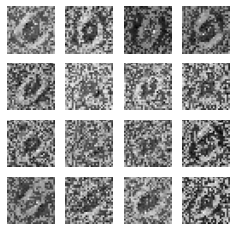

18
gen_loss: tf.Tensor(1.5269084, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23599224, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.27073234, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9114275  0.0885725 ]
 [0.8811554  0.11884457]
 [0.96681756 0.03318246]
 [0.9847846  0.01521537]
 [0.96398586 0.03601411]
 [0.8493664  0.1506335 ]
 [0.9840221  0.01597797]
 [0.7994456  0.20055434]
 [0.983318   0.016682  ]
 [0.6456672  0.35433283]
 [0.96517724 0.03482281]
 [0.97604024 0.02395976]
 [0.9553463  0.04465368]
 [0.9588572  0.04114286]
 [0.9581417  0.04185827]
 [0.9635558  0.03644424]
 [0.95950425 0.04049579]
 [0.97034544 0.02965458]
 [0.9703249  0.02967511]
 [0.9774164  0.02258358]
 [0.9622294  0.03777065]
 [0.9082779  0.09172203]
 [0.9761386  0.02386138]
 [0.98441494 0.01558513]
 [0.91445655 0.08554346]
 [0.9374266  0.06257338]
 [0.9804677  0.01953226]
 [0.64991516 0.35008484]
 [0.70026094 0.2997391 ]
 [0.94606864 0.05393133]
 [0.9401636  0.05983638]
 [

gen_loss: tf.Tensor(1.5304987, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30542493, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.272623, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9011925  0.09880746]
 [0.8395722  0.1604278 ]
 [0.9780278  0.02197218]
 [0.9896108  0.01038916]
 [0.971116   0.02888398]
 [0.87034005 0.12965997]
 [0.9880881  0.01191188]
 [0.7618444  0.23815553]
 [0.9887122  0.01128785]
 [0.7349967  0.2650033 ]
 [0.9650509  0.03494911]
 [0.9885783  0.01142165]
 [0.9629006  0.03709941]
 [0.9630498  0.03695019]
 [0.9713733  0.02862672]
 [0.96954435 0.03045571]
 [0.9698028  0.03019723]
 [0.97233224 0.02766776]
 [0.9757696  0.02423049]
 [0.98224753 0.01775247]
 [0.9691937  0.03080633]
 [0.87876123 0.12123875]
 [0.98188686 0.01811318]
 [0.9897014  0.01029857]
 [0.93200105 0.06799891]
 [0.92702454 0.0729755 ]
 [0.9863361  0.01366388]
 [0.5940243  0.4059757 ]
 [0.7466674  0.25333264]
 [0.96717256 0.03282743]
 [0.95848936 0.04151066]
 [0.896

gen_loss: tf.Tensor(1.5785758, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2514358, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2594882, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9133249  0.08667509]
 [0.8842596  0.11574047]
 [0.97823197 0.02176801]
 [0.98748857 0.01251146]
 [0.9737545  0.02624547]
 [0.88907874 0.11092127]
 [0.9869292  0.01307079]
 [0.78533715 0.21466284]
 [0.9873016  0.01269844]
 [0.7387848  0.26121518]
 [0.9681351  0.03186489]
 [0.98729277 0.01270729]
 [0.9596161  0.04038391]
 [0.9755974  0.02440261]
 [0.96619374 0.03380628]
 [0.9706942  0.02930579]
 [0.9707921  0.02920789]
 [0.97373205 0.02626799]
 [0.97646856 0.02353143]
 [0.9809456  0.01905443]
 [0.9709355  0.02906448]
 [0.90079165 0.09920837]
 [0.9800418  0.01995816]
 [0.9875759  0.01242409]
 [0.9374854  0.06251461]
 [0.92253107 0.07746895]
 [0.98463005 0.01536998]
 [0.58897996 0.41102007]
 [0.73704123 0.26295877]
 [0.9655524  0.03444767]
 [0.9516627  0.0483373 ]
 [0.899

gen_loss: tf.Tensor(1.5815035, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23259374, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2611909, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8976089  0.10239112]
 [0.84001005 0.15999   ]
 [0.97043824 0.02956177]
 [0.9853227  0.01467733]
 [0.97416013 0.02583986]
 [0.8850228  0.11497724]
 [0.98373955 0.01626044]
 [0.74062437 0.2593756 ]
 [0.98482054 0.01517939]
 [0.6886571  0.31134292]
 [0.96888566 0.03111435]
 [0.9834817  0.01651836]
 [0.94909376 0.05090618]
 [0.95741445 0.04258559]
 [0.95593554 0.04406438]
 [0.97354555 0.02645446]
 [0.9743235  0.02567641]
 [0.9731145  0.02688552]
 [0.9605132  0.03948681]
 [0.9798986  0.02010142]
 [0.96620077 0.03379922]
 [0.8824867  0.11751327]
 [0.97826207 0.02173793]
 [0.98591435 0.01408558]
 [0.93396777 0.0660322 ]
 [0.921378   0.07862201]
 [0.9849561  0.01504387]
 [0.518456   0.48154405]
 [0.77803403 0.221966  ]
 [0.9586951  0.04130489]
 [0.9558943  0.04410571]
 [0.89

gen_loss: tf.Tensor(1.5764878, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.29048657, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2815127, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.94076145 0.05923855]
 [0.93001306 0.06998692]
 [0.9762931  0.02370695]
 [0.9871421  0.01285787]
 [0.97976583 0.02023417]
 [0.9245638  0.07543617]
 [0.98470855 0.01529146]
 [0.8422841  0.1577159 ]
 [0.9867236  0.01327635]
 [0.8138726  0.18612741]
 [0.97916657 0.02083343]
 [0.9846918  0.01530819]
 [0.93913025 0.06086973]
 [0.98019767 0.01980233]
 [0.9569146  0.04308543]
 [0.9794064  0.02059358]
 [0.9777573  0.0222427 ]
 [0.98422354 0.01577647]
 [0.9714116  0.02858844]
 [0.98392016 0.0160798 ]
 [0.9646528  0.03534726]
 [0.93831235 0.06168762]
 [0.98486185 0.01513819]
 [0.9872794  0.01272065]
 [0.95034826 0.04965173]
 [0.89153105 0.10846892]
 [0.98796767 0.01203237]
 [0.5722314  0.4277686 ]
 [0.73400587 0.26599413]
 [0.9642374  0.03576254]
 [0.943002   0.05699804]
 [0.94

gen_loss: tf.Tensor(1.5384723, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.29055038, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2757973, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8017308  0.19826917]
 [0.84292674 0.15707323]
 [0.9740664  0.02593364]
 [0.9826166  0.01738338]
 [0.96253765 0.0374624 ]
 [0.8258633  0.17413674]
 [0.974939   0.02506098]
 [0.54897094 0.45102906]
 [0.9850794  0.01492061]
 [0.6259352  0.37406474]
 [0.9110441  0.08895587]
 [0.99053955 0.00946046]
 [0.9136049  0.08639507]
 [0.91492003 0.08507997]
 [0.95269597 0.04730399]
 [0.95879877 0.0412012 ]
 [0.9586364  0.04136362]
 [0.9503766  0.04962346]
 [0.9394731  0.06052691]
 [0.958564   0.04143608]
 [0.92704695 0.07295298]
 [0.9073609  0.09263902]
 [0.9598368  0.04016317]
 [0.98441136 0.0155887 ]
 [0.89596486 0.10403511]
 [0.8164968  0.18350317]
 [0.98433685 0.01566314]
 [0.27736846 0.7226316 ]
 [0.5829002  0.41709977]
 [0.94483894 0.05516105]
 [0.94862    0.05137997]
 [0.83

gen_loss: tf.Tensor(1.6232402, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.26149577, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.27292997, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9031992  0.0968008 ]
 [0.9136171  0.08638296]
 [0.9806256  0.01937441]
 [0.99059373 0.00940625]
 [0.97994274 0.02005721]
 [0.90217847 0.09782152]
 [0.9849191  0.01508098]
 [0.70584303 0.29415694]
 [0.99072194 0.00927803]
 [0.80662346 0.19337651]
 [0.96048623 0.03951381]
 [0.99402505 0.00597495]
 [0.90195936 0.09804065]
 [0.9655196  0.03448045]
 [0.9695301  0.0304699 ]
 [0.9767156  0.02328435]
 [0.9779312  0.02206874]
 [0.97789484 0.02210511]
 [0.9663255  0.03367443]
 [0.97933894 0.02066107]
 [0.9517841  0.04821592]
 [0.9414432  0.05855681]
 [0.9815819  0.01841807]
 [0.9915262  0.00847377]
 [0.9507779  0.04922214]
 [0.8428036  0.15719642]
 [0.99155796 0.00844206]
 [0.34612253 0.65387744]
 [0.56570625 0.43429375]
 [0.9704532  0.0295468 ]
 [0.9620366  0.03796344]
 [0.9

gen_loss: tf.Tensor(1.5712917, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.26120198, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.27446705, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.96681345 0.03318655]
 [0.94533366 0.05466634]
 [0.9850456  0.01495435]
 [0.99504507 0.00495489]
 [0.9912149  0.00878513]
 [0.9520133  0.04798671]
 [0.99178994 0.00821   ]
 [0.89032334 0.10967667]
 [0.99369836 0.00630165]
 [0.90048116 0.09951878]
 [0.98941994 0.01058003]
 [0.9942977  0.00570234]
 [0.9273982  0.07260177]
 [0.9881209  0.01187909]
 [0.9794881  0.02051194]
 [0.9888881  0.01111195]
 [0.9911841  0.00881591]
 [0.9916436  0.00835637]
 [0.98554707 0.01445291]
 [0.99099606 0.00900392]
 [0.978404   0.02159604]
 [0.9529076  0.0470923 ]
 [0.99296135 0.0070386 ]
 [0.9955232  0.00447683]
 [0.97744864 0.0225514 ]
 [0.9378278  0.06217219]
 [0.9958823  0.00411777]
 [0.5745396  0.4254604 ]
 [0.6347626  0.36523739]
 [0.98523533 0.0147647 ]
 [0.9747781  0.02522185]
 [0.9

gen_loss: tf.Tensor(1.5035611, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21952522, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2905727, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.30269539e-01 6.97304681e-02]
 [8.31582606e-01 1.68417364e-01]
 [9.80769753e-01 1.92302857e-02]
 [9.94319260e-01 5.68080880e-03]
 [9.86972511e-01 1.30275460e-02]
 [9.15954292e-01 8.40456784e-02]
 [9.88701224e-01 1.12988027e-02]
 [8.09606373e-01 1.90393567e-01]
 [9.91531670e-01 8.46834574e-03]
 [8.10038984e-01 1.89961061e-01]
 [9.84037638e-01 1.59624107e-02]
 [9.94621277e-01 5.37866633e-03]
 [9.31051552e-01 6.89484254e-02]
 [9.60202098e-01 3.97978798e-02]
 [9.75511849e-01 2.44881865e-02]
 [9.84199286e-01 1.58007704e-02]
 [9.91675496e-01 8.32444895e-03]
 [9.83053505e-01 1.69464275e-02]
 [9.76339877e-01 2.36600973e-02]
 [9.85114992e-01 1.48849450e-02]
 [9.76563334e-01 2.34366022e-02]
 [8.94102573e-01 1.05897389e-01]
 [9.88671184e-01 1.13288481e-02]
 [9.95314598e-01 4.685

gen_loss: tf.Tensor(1.5125751, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.26636386, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.29584843, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.92158765 0.07841234]
 [0.87352926 0.12647077]
 [0.97103834 0.02896161]
 [0.9895622  0.01043777]
 [0.9756645  0.02433555]
 [0.8853635  0.11463644]
 [0.9778365  0.02216347]
 [0.82306045 0.17693958]
 [0.9831972  0.01680282]
 [0.747754   0.25224593]
 [0.98050827 0.01949179]
 [0.99021626 0.00978376]
 [0.9092118  0.09078822]
 [0.93467885 0.06532111]
 [0.9542773  0.04572275]
 [0.97701705 0.02298294]
 [0.9878351  0.01216482]
 [0.97642756 0.02357247]
 [0.95946795 0.04053208]
 [0.97570294 0.02429703]
 [0.96493864 0.03506133]
 [0.9245726  0.07542744]
 [0.9818571  0.01814289]
 [0.9911623  0.0088377 ]
 [0.939595   0.06040509]
 [0.9444984  0.05550154]
 [0.9911157  0.00888428]
 [0.5365727  0.46342728]
 [0.62975514 0.3702449 ]
 [0.96050555 0.03949438]
 [0.9699516  0.0300484 ]
 [0.9

gen_loss: tf.Tensor(1.5556362, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.25330824, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.278894, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.96248984 0.03751019]
 [0.9393493  0.06065074]
 [0.97616893 0.02383108]
 [0.9917916  0.00820846]
 [0.98111856 0.0188814 ]
 [0.92409235 0.07590771]
 [0.9812501  0.01874985]
 [0.92262316 0.07737683]
 [0.9849556  0.0150444 ]
 [0.85170716 0.14829278]
 [0.99134237 0.00865771]
 [0.98906237 0.01093759]
 [0.93622065 0.06377935]
 [0.9658393  0.03416065]
 [0.9588167  0.04118329]
 [0.98245424 0.01754577]
 [0.9907314  0.00926863]
 [0.98775685 0.01224313]
 [0.97446    0.02553992]
 [0.98456687 0.01543321]
 [0.97367156 0.02632843]
 [0.9533938  0.04660616]
 [0.9897445  0.01025552]
 [0.99258196 0.00741804]
 [0.95161855 0.04838147]
 [0.94846827 0.05153173]
 [0.99265045 0.00734951]
 [0.71513623 0.28486383]
 [0.68401164 0.3159884 ]
 [0.9674788  0.03252126]
 [0.9642189  0.03578107]
 [0.955

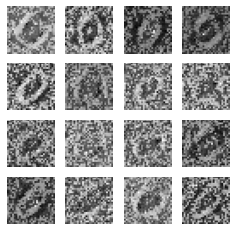

19
gen_loss: tf.Tensor(1.5924696, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2557642, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.25872412, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.53961849e-01 4.60381508e-02]
 [8.69494855e-01 1.30505204e-01]
 [9.86745059e-01 1.32549275e-02]
 [9.96700704e-01 3.29929730e-03]
 [9.88730609e-01 1.12693617e-02]
 [9.21383023e-01 7.86169916e-02]
 [9.90157366e-01 9.84268356e-03]
 [9.00035679e-01 9.99642909e-02]
 [9.93084788e-01 6.91526756e-03]
 [8.76652598e-01 1.23347431e-01]
 [9.92765665e-01 7.23432517e-03]
 [9.95797396e-01 4.20263689e-03]
 [9.68120039e-01 3.18799987e-02]
 [9.59236741e-01 4.07632627e-02]
 [9.82199430e-01 1.78005360e-02]
 [9.84540820e-01 1.54591091e-02]
 [9.93831396e-01 6.16861787e-03]
 [9.88644123e-01 1.13558350e-02]
 [9.85131681e-01 1.48682781e-02]
 [9.89565730e-01 1.04342485e-02]
 [9.84272599e-01 1.57274306e-02]
 [8.99074733e-01 1.00925282e-01]
 [9.93928432e-01 6.07149908e-03]
 [9.97108519e-01 2.

gen_loss: tf.Tensor(1.6052928, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22545561, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2582395, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.29103494e-01 7.08964691e-02]
 [8.73317897e-01 1.26682058e-01]
 [9.77883339e-01 2.21166611e-02]
 [9.93832469e-01 6.16753334e-03]
 [9.79746342e-01 2.02536695e-02]
 [8.48775625e-01 1.51224419e-01]
 [9.83917475e-01 1.60825122e-02]
 [8.13484013e-01 1.86515987e-01]
 [9.89102840e-01 1.08970935e-02]
 [7.42271245e-01 2.57728755e-01]
 [9.84993994e-01 1.50059341e-02]
 [9.93554473e-01 6.44556154e-03]
 [9.37688470e-01 6.23115003e-02]
 [9.20514703e-01 7.94853419e-02]
 [9.72884059e-01 2.71159783e-02]
 [9.68794882e-01 3.12051028e-02]
 [9.87744629e-01 1.22553622e-02]
 [9.75375772e-01 2.46242937e-02]
 [9.74174500e-01 2.58254949e-02]
 [9.78894353e-01 2.11056564e-02]
 [9.67048585e-01 3.29514295e-02]
 [9.14949179e-01 8.50508139e-02]
 [9.86743331e-01 1.32566988e-02]
 [9.94622111e-01 5.377

gen_loss: tf.Tensor(1.6277081, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.25660682, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.25226498, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9215819  0.0784181 ]
 [0.9362385  0.06376152]
 [0.95369685 0.04630314]
 [0.98214865 0.01785135]
 [0.962368   0.037632  ]
 [0.79391325 0.20608675]
 [0.9665628  0.03343725]
 [0.77433264 0.22566736]
 [0.97363484 0.02636515]
 [0.58853906 0.41146094]
 [0.9766272  0.02337281]
 [0.98235345 0.01764651]
 [0.87418085 0.12581915]
 [0.9310213  0.06897869]
 [0.9334228  0.06657726]
 [0.9469887  0.05301125]
 [0.97322017 0.02677986]
 [0.95882964 0.04117038]
 [0.9508336  0.04916632]
 [0.9563002  0.04369977]
 [0.9462956  0.05370435]
 [0.9540817  0.0459183 ]
 [0.96855587 0.03144412]
 [0.9839505  0.01604956]
 [0.8953009  0.10469903]
 [0.90804857 0.09195141]
 [0.9836916  0.0163084 ]
 [0.48423365 0.5157664 ]
 [0.5656584  0.43434152]
 [0.92127156 0.07872844]
 [0.9492349  0.0507651 ]
 [0.8

gen_loss: tf.Tensor(1.6468494, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.264842, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24521855, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9277639  0.07223617]
 [0.92833424 0.07166585]
 [0.96183    0.03816995]
 [0.9862343  0.01376572]
 [0.9726115  0.02738853]
 [0.86086804 0.13913193]
 [0.97528994 0.02471007]
 [0.78620106 0.21379893]
 [0.9785144  0.02148557]
 [0.7135017  0.28649834]
 [0.98318166 0.01681833]
 [0.9870657  0.01293438]
 [0.89675415 0.10324586]
 [0.9675827  0.03241732]
 [0.9435011  0.05649893]
 [0.9640558  0.03594417]
 [0.97955966 0.02044034]
 [0.9704892  0.02951079]
 [0.9583049  0.04169516]
 [0.9696582  0.03034182]
 [0.97259665 0.02740336]
 [0.93941724 0.06058273]
 [0.9771928  0.02280725]
 [0.988032   0.01196799]
 [0.9207495  0.0792505 ]
 [0.9238717  0.07612832]
 [0.98622906 0.01377097]
 [0.5030647  0.49693525]
 [0.8444096  0.15559044]
 [0.95154655 0.04845349]
 [0.96092695 0.03907301]
 [0.894

gen_loss: tf.Tensor(1.601305, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.24868459, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2617833, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.09865737e-01 9.01342630e-02]
 [8.50697041e-01 1.49302945e-01]
 [9.70497668e-01 2.95023918e-02]
 [9.91526783e-01 8.47318396e-03]
 [9.77062106e-01 2.29378603e-02]
 [8.74335945e-01 1.25664070e-01]
 [9.82600629e-01 1.73994135e-02]
 [7.54733503e-01 2.45266467e-01]
 [9.85278189e-01 1.47218350e-02]
 [7.61698246e-01 2.38301769e-01]
 [9.85232472e-01 1.47675043e-02]
 [9.92360890e-01 7.63911149e-03]
 [9.26810086e-01 7.31899515e-02]
 [9.62425232e-01 3.75747196e-02]
 [9.62828398e-01 3.71715464e-02]
 [9.68652010e-01 3.13479342e-02]
 [9.84465837e-01 1.55341066e-02]
 [9.72643971e-01 2.73560546e-02]
 [9.63618815e-01 3.63811590e-02]
 [9.76780117e-01 2.32198834e-02]
 [9.78498876e-01 2.15011630e-02]
 [8.81936312e-01 1.18063621e-01]
 [9.81858015e-01 1.81419365e-02]
 [9.92751837e-01 7.2482

gen_loss: tf.Tensor(1.6312511, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2497534, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24639735, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.91123176 0.0887683 ]
 [0.88386136 0.11613862]
 [0.9495498  0.05045015]
 [0.98436916 0.01563085]
 [0.95661    0.04339003]
 [0.79759115 0.20240888]
 [0.97140974 0.02859019]
 [0.74474394 0.25525603]
 [0.9769644  0.02303557]
 [0.5959957  0.4040042 ]
 [0.97945213 0.02054791]
 [0.9834155  0.01658454]
 [0.88439095 0.11560912]
 [0.92134506 0.07865497]
 [0.9434504  0.05654965]
 [0.94373137 0.05626866]
 [0.97183484 0.02816524]
 [0.9582797  0.0417203 ]
 [0.94527143 0.05472863]
 [0.9619444  0.03805564]
 [0.9363014  0.06369864]
 [0.9172438  0.08275621]
 [0.9673332  0.03266681]
 [0.9851746  0.01482544]
 [0.89178294 0.10821702]
 [0.9066374  0.09336261]
 [0.9847706  0.01522933]
 [0.43758026 0.5624197 ]
 [0.66305023 0.3369498 ]
 [0.9258193  0.07418066]
 [0.9596071  0.04039289]
 [0.87

gen_loss: tf.Tensor(1.6254296, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.25052127, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24138606, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9357165  0.06428346]
 [0.89814675 0.10185327]
 [0.9592427  0.04075732]
 [0.9879094  0.01209064]
 [0.96105194 0.03894806]
 [0.8075343  0.19246574]
 [0.9768828  0.02311722]
 [0.80309856 0.19690141]
 [0.98235863 0.01764133]
 [0.66060877 0.33939132]
 [0.98569393 0.01430605]
 [0.9842726  0.01572739]
 [0.9143001  0.08569989]
 [0.9327923  0.06720766]
 [0.9548591  0.04514086]
 [0.94408387 0.05591613]
 [0.97343034 0.02656964]
 [0.96896744 0.03103257]
 [0.95908576 0.04091427]
 [0.97139186 0.02860815]
 [0.93424726 0.0657528 ]
 [0.91780084 0.08219913]
 [0.9761752  0.02382483]
 [0.98774606 0.01225395]
 [0.90078974 0.09921024]
 [0.9073272  0.0926728 ]
 [0.9884638  0.01153621]
 [0.48779082 0.51220924]
 [0.696841   0.30315906]
 [0.93152404 0.06847596]
 [0.9631648  0.03683518]
 [0.9

gen_loss: tf.Tensor(1.6193488, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.26223487, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24564458, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.43007290e-01 5.69926649e-02]
 [8.52983713e-01 1.47016287e-01]
 [9.81009722e-01 1.89903509e-02]
 [9.94746745e-01 5.25322417e-03]
 [9.80374753e-01 1.96252484e-02]
 [8.47777903e-01 1.52222082e-01]
 [9.89377677e-01 1.06223207e-02]
 [8.14505458e-01 1.85494557e-01]
 [9.92591619e-01 7.40834884e-03]
 [7.32230067e-01 2.67769873e-01]
 [9.90450084e-01 9.54997819e-03]
 [9.91489410e-01 8.51066317e-03]
 [9.64869678e-01 3.51302959e-02]
 [9.56382632e-01 4.36173230e-02]
 [9.81169045e-01 1.88309625e-02]
 [9.64446604e-01 3.55533659e-02]
 [9.83866811e-01 1.61331352e-02]
 [9.78925824e-01 2.10742354e-02]
 [9.81435478e-01 1.85644608e-02]
 [9.85440910e-01 1.45591367e-02]
 [9.70509529e-01 2.94904336e-02]
 [8.65644097e-01 1.34355873e-01]
 [9.88400936e-01 1.15991281e-02]
 [9.94729638e-01 5.27

gen_loss: tf.Tensor(1.6153466, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.27314192, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24784625, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.35416043e-01 6.45839721e-02]
 [8.89719546e-01 1.10280447e-01]
 [9.69921350e-01 3.00787352e-02]
 [9.90328133e-01 9.67188366e-03]
 [9.71119523e-01 2.88805086e-02]
 [8.37576270e-01 1.62423730e-01]
 [9.84656394e-01 1.53436204e-02]
 [7.67597675e-01 2.32402310e-01]
 [9.88084614e-01 1.19153820e-02]
 [6.39089644e-01 3.60910386e-01]
 [9.86946523e-01 1.30535616e-02]
 [9.86211896e-01 1.37881199e-02]
 [9.35072064e-01 6.49280027e-02]
 [9.57389235e-01 4.26107496e-02]
 [9.69419479e-01 3.05805374e-02]
 [9.55623567e-01 4.43764776e-02]
 [9.75218356e-01 2.47816890e-02]
 [9.71633315e-01 2.83666812e-02]
 [9.72251236e-01 2.77487449e-02]
 [9.79113877e-01 2.08861064e-02]
 [9.56727326e-01 4.32727262e-02]
 [9.08789515e-01 9.12104771e-02]
 [9.80133295e-01 1.98667403e-02]
 [9.90163386e-01 9.83

test_discriminator_output: tf.Tensor(
[[0.9337515  0.06624842]
 [0.9142448  0.08575521]
 [0.954162   0.04583796]
 [0.9845803  0.0154198 ]
 [0.96050256 0.03949738]
 [0.8265923  0.17340767]
 [0.97876406 0.02123595]
 [0.7574843  0.24251564]
 [0.9814006  0.0185994 ]
 [0.5674672  0.4325328 ]
 [0.9851539  0.01484613]
 [0.97791433 0.02208564]
 [0.90366614 0.09633389]
 [0.95698684 0.04301316]
 [0.9521363  0.04786373]
 [0.9453422  0.05465781]
 [0.96817714 0.0318229 ]
 [0.9652637  0.03473631]
 [0.9628165  0.03718353]
 [0.9716191  0.02838086]
 [0.9401224  0.05987756]
 [0.93355626 0.06644375]
 [0.9709112  0.02908878]
 [0.98406744 0.01593253]
 [0.9105972  0.08940278]
 [0.9072302  0.09276984]
 [0.9882415  0.01175852]
 [0.39509246 0.6049075 ]
 [0.6995441  0.30045593]
 [0.9271222  0.07287777]
 [0.97247046 0.02752959]
 [0.89759177 0.10240821]
 [0.9533726  0.0466274 ]
 [0.94335747 0.05664251]
 [0.9258676  0.07413241]
 [0.91794425 0.08205572]
 [0.87392706 0.12607296]
 [0.9252008  0.07479921]
 [0.8299768 

gen_loss: tf.Tensor(1.6197559, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22847152, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.26046646, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.922257   0.07774304]
 [0.88409555 0.11590447]
 [0.9471744  0.05282567]
 [0.98433334 0.01566665]
 [0.96102893 0.03897108]
 [0.8453974  0.15460256]
 [0.9791119  0.02088802]
 [0.73135805 0.26864195]
 [0.97942436 0.0205756 ]
 [0.5583482  0.44165182]
 [0.98667866 0.01332127]
 [0.97656065 0.0234394 ]
 [0.9090563  0.09094374]
 [0.95828    0.04172001]
 [0.9482641  0.05173585]
 [0.94516236 0.05483768]
 [0.9720704  0.02792958]
 [0.96346074 0.03653925]
 [0.96066904 0.03933104]
 [0.9715551  0.02844487]
 [0.9491933  0.05080667]
 [0.9154935  0.08450656]
 [0.97046477 0.02953526]
 [0.984353   0.01564696]
 [0.91411614 0.0858838 ]
 [0.9269424  0.07305757]
 [0.98983264 0.01016738]
 [0.37117878 0.6288213 ]
 [0.7707114  0.22928861]
 [0.9349646  0.06503542]
 [0.9752651  0.02473491]
 [0.8

gen_loss: tf.Tensor(1.644748, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22787617, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2481409, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.15486276e-01 8.45137239e-02]
 [8.81678283e-01 1.18321754e-01]
 [9.56997097e-01 4.30029184e-02]
 [9.86614287e-01 1.33856675e-02]
 [9.58632767e-01 4.13672328e-02]
 [8.54823947e-01 1.45176068e-01]
 [9.81827796e-01 1.81722175e-02]
 [7.42438138e-01 2.57561833e-01]
 [9.84317780e-01 1.56822670e-02]
 [6.36822581e-01 3.63177389e-01]
 [9.86575067e-01 1.34249004e-02]
 [9.85067725e-01 1.49322785e-02]
 [9.39459622e-01 6.05404004e-02]
 [9.56417501e-01 4.35825288e-02]
 [9.59033966e-01 4.09660228e-02]
 [9.31525409e-01 6.84745610e-02]
 [9.70321715e-01 2.96783019e-02]
 [9.60217834e-01 3.97821218e-02]
 [9.67543721e-01 3.24562564e-02]
 [9.71857667e-01 2.81422753e-02]
 [9.49208796e-01 5.07912301e-02]
 [9.12734509e-01 8.72654393e-02]
 [9.69958901e-01 3.00410762e-02]
 [9.86813009e-01 1.3186

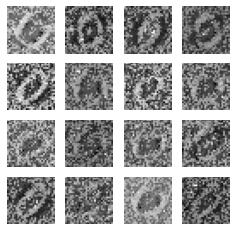

20
gen_loss: tf.Tensor(1.6436989, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2484543, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24301393, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.92502576 0.07497424]
 [0.92174613 0.0782539 ]
 [0.95226985 0.0477302 ]
 [0.98281914 0.01718091]
 [0.952921   0.04707902]
 [0.8441275  0.15587251]
 [0.9790789  0.02092112]
 [0.76527375 0.23472622]
 [0.9825492  0.01745086]
 [0.60121226 0.39878777]
 [0.9850397  0.01496031]
 [0.98149914 0.01850083]
 [0.93403184 0.06596817]
 [0.9576272  0.04237288]
 [0.9525525  0.04744752]
 [0.91866136 0.08133867]
 [0.962323   0.03767706]
 [0.95539564 0.0446043 ]
 [0.967856   0.03214406]
 [0.9671167  0.03288328]
 [0.9347717  0.06522825]
 [0.94192153 0.05807843]
 [0.96255165 0.03744832]
 [0.9828027  0.01719738]
 [0.90156114 0.09843887]
 [0.91046524 0.08953476]
 [0.98935026 0.01064969]
 [0.3847725  0.61522746]
 [0.69259953 0.30740038]
 [0.92660266 0.07339731]
 [0.97060937 0.02939061]
 [0

gen_loss: tf.Tensor(1.5829494, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21940872, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2547571, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.95358974 0.04641021]
 [0.920173   0.07982695]
 [0.9696779  0.03032213]
 [0.99119675 0.00880323]
 [0.9757342  0.02426581]
 [0.90257657 0.09742348]
 [0.98909944 0.01090056]
 [0.8181755  0.18182442]
 [0.9915991  0.00840096]
 [0.7520017  0.24799834]
 [0.99128574 0.0087142 ]
 [0.99041116 0.00958882]
 [0.95418406 0.04581595]
 [0.9748136  0.02518646]
 [0.97564256 0.02435742]
 [0.94856745 0.05143251]
 [0.9770339  0.02296614]
 [0.97468096 0.02531902]
 [0.9837413  0.01625874]
 [0.984664   0.01533598]
 [0.95685893 0.0431411 ]
 [0.9387123  0.06128769]
 [0.9816191  0.01838087]
 [0.9915183  0.0084817 ]
 [0.943778   0.05622205]
 [0.9232956  0.07670432]
 [0.9950293  0.00497077]
 [0.43392506 0.56607497]
 [0.7869383  0.21306175]
 [0.96670145 0.03329859]
 [0.9826553  0.01734465]
 [0.91

gen_loss: tf.Tensor(1.6193533, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20335871, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24752542, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.36245918e-01 6.37541413e-02]
 [8.90564024e-01 1.09436043e-01]
 [9.51109707e-01 4.88903187e-02]
 [9.86360192e-01 1.36397853e-02]
 [9.66925323e-01 3.30746919e-02]
 [8.82457733e-01 1.17542207e-01]
 [9.84533668e-01 1.54662961e-02]
 [7.52160728e-01 2.47839287e-01]
 [9.88113701e-01 1.18862912e-02]
 [6.23839915e-01 3.76160145e-01]
 [9.87054706e-01 1.29452283e-02]
 [9.84625459e-01 1.53746149e-02]
 [9.41030741e-01 5.89692630e-02]
 [9.62135255e-01 3.78647633e-02]
 [9.65909123e-01 3.40907983e-02]
 [9.32595611e-01 6.74044043e-02]
 [9.67752337e-01 3.22476104e-02]
 [9.63432312e-01 3.65677327e-02]
 [9.77382600e-01 2.26173904e-02]
 [9.78869915e-01 2.11300030e-02]
 [9.45161402e-01 5.48385940e-02]
 [9.25824285e-01 7.41756484e-02]
 [9.71321821e-01 2.86782421e-02]
 [9.86872554e-01 1.31

gen_loss: tf.Tensor(1.6524472, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2673813, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.23754536, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.91150004 0.08849989]
 [0.9156151  0.08438493]
 [0.9201654  0.07983458]
 [0.97051406 0.02948599]
 [0.933619   0.06638093]
 [0.85577536 0.14422463]
 [0.9700127  0.02998726]
 [0.70659894 0.2934011 ]
 [0.97557074 0.02442923]
 [0.5302505  0.46974954]
 [0.97913384 0.02086609]
 [0.9725552  0.02744475]
 [0.90546    0.09454001]
 [0.9541563  0.0458437 ]
 [0.9294768  0.07052324]
 [0.88991517 0.11008488]
 [0.93825567 0.06174434]
 [0.94188154 0.05811841]
 [0.9589933  0.04100674]
 [0.9600365  0.03996348]
 [0.9190191  0.08098093]
 [0.9429667  0.05703332]
 [0.94032013 0.05967985]
 [0.9703879  0.02961217]
 [0.8747006  0.12529938]
 [0.87082565 0.12917426]
 [0.97920996 0.02079002]
 [0.36042392 0.6395761 ]
 [0.8425623  0.1574377 ]
 [0.8941449  0.1058551 ]
 [0.9664042  0.0335958 ]
 [0.84

gen_loss: tf.Tensor(1.6404902, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23531473, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24612658, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.92547405 0.07452597]
 [0.91472346 0.08527648]
 [0.9306511  0.06934891]
 [0.9729287  0.02707122]
 [0.940136   0.05986397]
 [0.8714314  0.12856854]
 [0.9740908  0.02590919]
 [0.7800934  0.21990654]
 [0.97843915 0.02156083]
 [0.5505522  0.4494478 ]
 [0.9853736  0.01462631]
 [0.9662525  0.03374755]
 [0.9354852  0.06451482]
 [0.9617155  0.03828445]
 [0.9386831  0.06131692]
 [0.87935334 0.12064669]
 [0.94141304 0.05858688]
 [0.9508085  0.0491915 ]
 [0.97062564 0.02937437]
 [0.9633603  0.03663973]
 [0.94191706 0.05808295]
 [0.928159   0.07184099]
 [0.95026815 0.04973183]
 [0.97252697 0.02747308]
 [0.8626436  0.1373564 ]
 [0.9100726  0.08992735]
 [0.98152727 0.01847272]
 [0.45357057 0.54642946]
 [0.92357296 0.07642707]
 [0.89136654 0.10863339]
 [0.96954155 0.03045849]
 [0.8

gen_loss: tf.Tensor(1.6102331, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19586185, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.25117606, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.91945934 0.08054069]
 [0.9229667  0.07703336]
 [0.91427857 0.08572149]
 [0.96750534 0.03249468]
 [0.9248069  0.07519313]
 [0.837788   0.16221201]
 [0.9708793  0.02912069]
 [0.7642983  0.23570165]
 [0.9774065  0.02259354]
 [0.446275   0.553725  ]
 [0.9814781  0.01852193]
 [0.9608715  0.03912848]
 [0.9220047  0.07799535]
 [0.9400942  0.05990582]
 [0.9400487  0.05995134]
 [0.83811384 0.16188607]
 [0.9256807  0.07431934]
 [0.93375653 0.06624348]
 [0.9673845  0.03261551]
 [0.95056224 0.04943777]
 [0.91109306 0.08890693]
 [0.9368711  0.06312889]
 [0.93345    0.06654998]
 [0.9670591  0.03294086]
 [0.834672   0.16532804]
 [0.90982497 0.09017502]
 [0.97874147 0.02125853]
 [0.43002367 0.5699764 ]
 [0.8350947  0.16490534]
 [0.8549226  0.14507738]
 [0.96792567 0.03207432]
 [0.8

gen_loss: tf.Tensor(1.6129129, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.27601534, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2519431, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9440269  0.05597304]
 [0.9382673  0.06173268]
 [0.9385381  0.06146196]
 [0.9824119  0.01758812]
 [0.94983196 0.05016806]
 [0.8984244  0.10157566]
 [0.98280966 0.01719029]
 [0.81921065 0.18078937]
 [0.9868248  0.01317518]
 [0.6332725  0.36672744]
 [0.98870903 0.01129092]
 [0.9791221  0.02087791]
 [0.926943   0.07305703]
 [0.96640944 0.03359051]
 [0.96550727 0.03449275]
 [0.8872384  0.11276163]
 [0.948399   0.05160099]
 [0.9600222  0.03997777]
 [0.9798149  0.02018506]
 [0.97215974 0.02784021]
 [0.9333749  0.06662515]
 [0.9450451  0.05495483]
 [0.962104   0.03789599]
 [0.98196155 0.01803847]
 [0.89577705 0.10422299]
 [0.9148278  0.08517213]
 [0.98795855 0.01204139]
 [0.48101112 0.5189889 ]
 [0.80607826 0.19392179]
 [0.92021114 0.07978886]
 [0.97745514 0.02254487]
 [0.90

gen_loss: tf.Tensor(1.6934135, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.26769707, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.23293981, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9433306  0.05666937]
 [0.93374205 0.06625792]
 [0.95943755 0.04056248]
 [0.9888926  0.01110734]
 [0.9603052  0.03969472]
 [0.92127454 0.07872552]
 [0.98812395 0.0118761 ]
 [0.80074614 0.1992538 ]
 [0.9913249  0.00867508]
 [0.7647782  0.23522179]
 [0.98999983 0.01000024]
 [0.9887339  0.01126617]
 [0.9398135  0.0601865 ]
 [0.98225844 0.01774156]
 [0.97632754 0.02367244]
 [0.9008057  0.09919429]
 [0.9544641  0.04553597]
 [0.9656631  0.03433691]
 [0.9865724  0.01342757]
 [0.97916174 0.02083823]
 [0.9580944  0.04190557]
 [0.93120545 0.06879447]
 [0.97147256 0.02852746]
 [0.98881686 0.01118309]
 [0.9184474  0.08155265]
 [0.9060652  0.09393483]
 [0.99163884 0.00836113]
 [0.45361435 0.5463857 ]
 [0.8782955  0.12170453]
 [0.95543855 0.04456146]
 [0.98229986 0.01770012]
 [0.9

gen_loss: tf.Tensor(1.6400706, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.24473608, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24182245, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.89180124e-01 1.10819854e-01]
 [9.29959357e-01 7.00406209e-02]
 [9.19061780e-01 8.09382126e-02]
 [9.71120179e-01 2.88798530e-02]
 [9.11512434e-01 8.84875208e-02]
 [7.86309004e-01 2.13690981e-01]
 [9.73732710e-01 2.62672864e-02]
 [6.46724582e-01 3.53275448e-01]
 [9.81773198e-01 1.82268377e-02]
 [3.88886899e-01 6.11113131e-01]
 [9.71845746e-01 2.81542260e-02]
 [9.66208220e-01 3.37917656e-02]
 [9.24175739e-01 7.58242905e-02]
 [9.52826560e-01 4.71733846e-02]
 [9.53737319e-01 4.62627336e-02]
 [7.54119337e-01 2.45880604e-01]
 [8.91258776e-01 1.08741164e-01]
 [8.93587410e-01 1.06412604e-01]
 [9.76920605e-01 2.30794493e-02]
 [9.34753954e-01 6.52460232e-02]
 [9.12435889e-01 8.75641480e-02]
 [9.31338966e-01 6.86610714e-02]
 [9.07035887e-01 9.29641649e-02]
 [9.70926642e-01 2.90

gen_loss: tf.Tensor(1.6737972, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.3227664, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24071924, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.91640335 0.0835966 ]
 [0.92702365 0.07297634]
 [0.9140773  0.08592269]
 [0.97527266 0.02472727]
 [0.9238166  0.07618341]
 [0.8505645  0.14943552]
 [0.9750216  0.02497842]
 [0.70127267 0.2987273 ]
 [0.9823086  0.01769142]
 [0.5097106  0.49028945]
 [0.9814749  0.01852511]
 [0.9616369  0.03836308]
 [0.9195918  0.08040819]
 [0.9652012  0.03479886]
 [0.9528241  0.04717587]
 [0.79470086 0.20529918]
 [0.91521287 0.08478712]
 [0.9240363  0.0759636 ]
 [0.9782306  0.0217694 ]
 [0.9544916  0.0455084 ]
 [0.9332909  0.06670907]
 [0.9227131  0.07728685]
 [0.9326022  0.06739771]
 [0.9745054  0.02549456]
 [0.8673211  0.13267896]
 [0.9043988  0.09560122]
 [0.9842987  0.01570132]
 [0.3845954  0.61540467]
 [0.84066874 0.15933122]
 [0.894297   0.10570303]
 [0.96947527 0.03052474]
 [0.81

gen_loss: tf.Tensor(1.7785071, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21626754, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2310712, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9416173  0.05838263]
 [0.93249184 0.06750817]
 [0.93060184 0.06939815]
 [0.98497343 0.01502662]
 [0.94341516 0.0565848 ]
 [0.9265423  0.07345773]
 [0.9803687  0.01963129]
 [0.7557851  0.24421489]
 [0.98719424 0.01280576]
 [0.76435673 0.23564327]
 [0.98856467 0.01143531]
 [0.9773885  0.0226115 ]
 [0.88720673 0.11279329]
 [0.97801197 0.02198806]
 [0.9644545  0.03554551]
 [0.86263734 0.13736267]
 [0.93774563 0.06225442]
 [0.959843   0.04015709]
 [0.9817364  0.01826352]
 [0.97722274 0.02277723]
 [0.9450634  0.05493655]
 [0.93400294 0.06599712]
 [0.96297777 0.03702229]
 [0.9839315  0.01606851]
 [0.92027324 0.07972676]
 [0.8440981  0.15590188]
 [0.9901687  0.00983135]
 [0.40387478 0.59612525]
 [0.79416716 0.20583287]
 [0.9410844  0.05891562]
 [0.9700824  0.02991759]
 [0.90

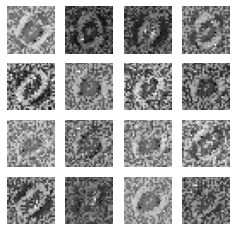

21
gen_loss: tf.Tensor(1.6683561, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23765042, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.23557584, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.88345104 0.11654899]
 [0.9180857  0.08191424]
 [0.8993767  0.10062325]
 [0.970753   0.02924702]
 [0.91468716 0.08531281]
 [0.8141568  0.18584324]
 [0.9665444  0.03345564]
 [0.58133096 0.41866902]
 [0.98311573 0.01688422]
 [0.3806361  0.6193639 ]
 [0.9670492  0.03295082]
 [0.96103287 0.03896713]
 [0.8857028  0.11429721]
 [0.9285388  0.07146116]
 [0.95457953 0.04542053]
 [0.7203034  0.27969658]
 [0.8629193  0.13708071]
 [0.8871985  0.11280157]
 [0.9778567  0.02214331]
 [0.94125503 0.0587449 ]
 [0.8986511  0.10134893]
 [0.93322545 0.06677448]
 [0.9049014  0.09509864]
 [0.96969146 0.03030848]
 [0.8495196  0.15048033]
 [0.8265214  0.1734786 ]
 [0.9845123  0.0154877 ]
 [0.2767941  0.7232059 ]
 [0.64444166 0.35555834]
 [0.87079287 0.1292071 ]
 [0.9608661  0.03913391]
 [

gen_loss: tf.Tensor(1.6907161, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2374176, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.26432443, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.16603208e-01 8.33967626e-02]
 [9.20581639e-01 7.94183239e-02]
 [9.28030610e-01 7.19693452e-02]
 [9.81126130e-01 1.88738089e-02]
 [9.47834373e-01 5.21656759e-02]
 [8.57998431e-01 1.42001495e-01]
 [9.78610516e-01 2.13895570e-02]
 [6.27471983e-01 3.72527987e-01]
 [9.90466535e-01 9.53345653e-03]
 [4.35826361e-01 5.64173579e-01]
 [9.78048801e-01 2.19512284e-02]
 [9.70726550e-01 2.92734317e-02]
 [9.19790924e-01 8.02091435e-02]
 [9.46076870e-01 5.39231859e-02]
 [9.73095298e-01 2.69046761e-02]
 [7.67383039e-01 2.32616976e-01]
 [8.91303122e-01 1.08696930e-01]
 [9.19609904e-01 8.03901255e-02]
 [9.87787068e-01 1.22129405e-02]
 [9.61660624e-01 3.83393168e-02]
 [9.40254986e-01 5.97449690e-02]
 [9.21224236e-01 7.87757784e-02]
 [9.37068582e-01 6.29313886e-02]
 [9.80711818e-01 1.928

gen_loss: tf.Tensor(1.6632717, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.25165, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24708906, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9635059  0.03649414]
 [0.96790564 0.0320944 ]
 [0.935508   0.06449191]
 [0.98551524 0.01448477]
 [0.964319   0.03568102]
 [0.9396863  0.06031372]
 [0.9841711  0.01582885]
 [0.7877991  0.2122009 ]
 [0.991916   0.00808399]
 [0.6857721  0.31422785]
 [0.99124485 0.00875518]
 [0.9745489  0.02545108]
 [0.90225816 0.09774189]
 [0.98501426 0.01498571]
 [0.97370434 0.02629565]
 [0.8501749  0.14982508]
 [0.92444843 0.07555154]
 [0.96042705 0.03957295]
 [0.9924425  0.00755756]
 [0.9771616  0.02283843]
 [0.95662683 0.0433732 ]
 [0.96003926 0.0399608 ]
 [0.9588457  0.04115438]
 [0.9847809  0.01521915]
 [0.93810123 0.06189882]
 [0.8583726  0.14162737]
 [0.99255425 0.00744578]
 [0.4597913  0.54020876]
 [0.8457083  0.15429167]
 [0.94999385 0.05000621]
 [0.9684401  0.03155988]
 [0.8846

gen_loss: tf.Tensor(1.6551317, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23732707, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2508476, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9012416  0.09875846]
 [0.95340294 0.04659712]
 [0.8686841  0.13131586]
 [0.9654952  0.03450474]
 [0.92927724 0.07072273]
 [0.8614606  0.13853936]
 [0.96630305 0.03369694]
 [0.5410293  0.4589707 ]
 [0.9834156  0.01658443]
 [0.34195817 0.65804183]
 [0.9730906  0.02690939]
 [0.9622839  0.03771612]
 [0.8672611  0.1327389 ]
 [0.96075594 0.03924408]
 [0.9496124  0.05038756]
 [0.704069   0.29593092]
 [0.8470573  0.15294278]
 [0.8716811  0.12831894]
 [0.9842339  0.01576613]
 [0.92740804 0.07259191]
 [0.9149455  0.08505449]
 [0.95667255 0.04332747]
 [0.8701908  0.12980914]
 [0.9655551  0.03444492]
 [0.8832707  0.1167293 ]
 [0.83467084 0.16532914]
 [0.9823497  0.01765028]
 [0.2865433  0.7134567 ]
 [0.8077892  0.1922108 ]
 [0.8845717  0.11542833]
 [0.9542294  0.04577052]
 [0.69

gen_loss: tf.Tensor(1.7250509, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20886055, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.22645554, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9052266  0.09477347]
 [0.94376487 0.05623513]
 [0.9293548  0.07064521]
 [0.9840014  0.01599855]
 [0.96069795 0.03930203]
 [0.9029163  0.09708371]
 [0.9806831  0.01931696]
 [0.57343274 0.42656726]
 [0.9917693  0.00823068]
 [0.47323862 0.52676135]
 [0.98067963 0.01932041]
 [0.98498267 0.01501726]
 [0.92899895 0.07100101]
 [0.9767006  0.0232994 ]
 [0.97434604 0.02565396]
 [0.7807231  0.21927693]
 [0.8999097  0.10009033]
 [0.90294456 0.09705539]
 [0.9923153  0.00768469]
 [0.9545429  0.04545709]
 [0.9501901  0.04980986]
 [0.9421734  0.0578266 ]
 [0.9165808  0.08341917]
 [0.98468566 0.01531433]
 [0.91687703 0.08312298]
 [0.88245976 0.11754023]
 [0.9916583  0.00834168]
 [0.3206056  0.67939436]
 [0.88097334 0.11902663]
 [0.94859844 0.05140153]
 [0.97263634 0.02736366]
 [0.7

gen_loss: tf.Tensor(1.6495919, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.25129148, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24077252, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9455139  0.05448607]
 [0.96723896 0.03276108]
 [0.9502282  0.04977175]
 [0.9871717  0.01282829]
 [0.9675318  0.03246816]
 [0.9378948  0.06210515]
 [0.98351187 0.01648816]
 [0.73233443 0.26766557]
 [0.9931297  0.00687035]
 [0.6435649  0.35643515]
 [0.989051   0.01094901]
 [0.98580176 0.0141983 ]
 [0.9403225  0.0596775 ]
 [0.988197   0.01180296]
 [0.9758531  0.02414684]
 [0.82532775 0.17467222]
 [0.9195848  0.08041517]
 [0.93744445 0.06255563]
 [0.9949786  0.00502136]
 [0.96588236 0.03411761]
 [0.9624097  0.03759029]
 [0.95684147 0.04315859]
 [0.93874675 0.06125331]
 [0.98709977 0.01290016]
 [0.93205357 0.06794641]
 [0.8846772  0.11532287]
 [0.9928457  0.0071543 ]
 [0.45987937 0.5401206 ]
 [0.89112824 0.1088718 ]
 [0.9605162  0.03948374]
 [0.9694509  0.03054913]
 [0.8

gen_loss: tf.Tensor(1.6423764, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.28157848, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.24224576, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.90454197 0.09545802]
 [0.971301   0.02869902]
 [0.90308124 0.09691872]
 [0.96955115 0.03044889]
 [0.92580247 0.0741976 ]
 [0.89497423 0.10502573]
 [0.961857   0.03814303]
 [0.60748446 0.3925155 ]
 [0.9854952  0.01450476]
 [0.47093627 0.5290638 ]
 [0.97356707 0.02643296]
 [0.974423   0.025577  ]
 [0.89009637 0.10990366]
 [0.9684627  0.03153728]
 [0.94706744 0.05293263]
 [0.71216285 0.2878372 ]
 [0.8397327  0.16026734]
 [0.88152456 0.11847542]
 [0.98722535 0.01277461]
 [0.92082185 0.07917816]
 [0.9174598  0.08254022]
 [0.9668278  0.03317217]
 [0.8595271  0.14047293]
 [0.96845645 0.03154358]
 [0.87849224 0.12150784]
 [0.7860647  0.21393532]
 [0.98069614 0.01930384]
 [0.34322882 0.6567711 ]
 [0.86234736 0.13765271]
 [0.89639837 0.10360162]
 [0.9396138  0.06038625]
 [0.8

gen_loss: tf.Tensor(1.6790218, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.24202365, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2346579, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.00288641e-01 9.97112840e-02]
 [9.60243106e-01 3.97568680e-02]
 [9.41762924e-01 5.82371354e-02]
 [9.81630504e-01 1.83694866e-02]
 [9.47592795e-01 5.24071828e-02]
 [9.09351051e-01 9.06488970e-02]
 [9.74061370e-01 2.59385780e-02]
 [6.15270913e-01 3.84729087e-01]
 [9.91247773e-01 8.75215232e-03]
 [5.32273233e-01 4.67726767e-01]
 [9.74819005e-01 2.51809955e-02]
 [9.83715892e-01 1.62840895e-02]
 [9.38509703e-01 6.14903122e-02]
 [9.71552551e-01 2.84474567e-02]
 [9.67794120e-01 3.22059318e-02]
 [7.56503046e-01 2.43497014e-01]
 [8.69508922e-01 1.30491108e-01]
 [9.01750624e-01 9.82493609e-02]
 [9.92469013e-01 7.53095746e-03]
 [9.38395143e-01 6.16048574e-02]
 [9.54539657e-01 4.54603918e-02]
 [9.50974524e-01 4.90254499e-02]
 [8.99016023e-01 1.00983992e-01]
 [9.81647193e-01 1.835

gen_loss: tf.Tensor(1.6324255, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23074389, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2521507, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9183474  0.08165256]
 [0.9704761  0.02952388]
 [0.94008744 0.05991258]
 [0.97675407 0.02324593]
 [0.9439523  0.05604762]
 [0.9032192  0.0967808 ]
 [0.9707134  0.02928657]
 [0.69228095 0.30771902]
 [0.98936474 0.0106353 ]
 [0.43953198 0.560468  ]
 [0.9779048  0.02209523]
 [0.9701533  0.02984669]
 [0.9371001  0.06289986]
 [0.9764212  0.02357884]
 [0.9607895  0.0392105 ]
 [0.73417455 0.26582548]
 [0.8526218  0.14737822]
 [0.89532137 0.10467864]
 [0.99443144 0.00556852]
 [0.9228616  0.07713839]
 [0.9561885  0.04381156]
 [0.9616214  0.03837857]
 [0.88766026 0.11233971]
 [0.9766004  0.02339961]
 [0.8708315  0.12916857]
 [0.8785376  0.12146246]
 [0.98532736 0.01467268]
 [0.45431256 0.54568744]
 [0.92087203 0.07912797]
 [0.9183717  0.08162834]
 [0.95589453 0.04410546]
 [0.81

gen_loss: tf.Tensor(1.6896689, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.30688182, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.23204572, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.8977867  0.10221335]
 [0.95022345 0.04977654]
 [0.9191481  0.08085191]
 [0.9748287  0.02517125]
 [0.93918115 0.06081884]
 [0.9024194  0.09758061]
 [0.9676146  0.03238541]
 [0.63576245 0.36423764]
 [0.9869061  0.01309394]
 [0.42263013 0.57736987]
 [0.97540873 0.0245912 ]
 [0.968229   0.03177099]
 [0.92411745 0.07588248]
 [0.97085047 0.02914952]
 [0.95310706 0.04689297]
 [0.7191053  0.28089473]
 [0.84904414 0.15095583]
 [0.8790198  0.12098023]
 [0.9932488  0.00675123]
 [0.91308016 0.08691981]
 [0.9563612  0.04363886]
 [0.9479211  0.05207891]
 [0.87778974 0.12221024]
 [0.9751256  0.02487437]
 [0.86718005 0.13281995]
 [0.880461   0.11953899]
 [0.9846748  0.01532517]
 [0.42975715 0.5702428 ]
 [0.93418765 0.06581239]
 [0.91770524 0.08229478]
 [0.9592462  0.04075385]
 [0.7

gen_loss: tf.Tensor(1.7000506, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.25531125, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.23047902, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.86758447e-01 1.13241605e-01]
 [9.35449719e-01 6.45502880e-02]
 [9.06823695e-01 9.31762680e-02]
 [9.72574651e-01 2.74253041e-02]
 [9.29958701e-01 7.00412542e-02]
 [8.92881155e-01 1.07118867e-01]
 [9.65196073e-01 3.48039679e-02]
 [6.42985582e-01 3.57014418e-01]
 [9.85414028e-01 1.45859914e-02]
 [3.79145771e-01 6.20854259e-01]
 [9.75327134e-01 2.46728510e-02]
 [9.59227562e-01 4.07724753e-02]
 [9.35684800e-01 6.43151402e-02]
 [9.57015216e-01 4.29847278e-02]
 [9.46775794e-01 5.32241762e-02]
 [6.85815930e-01 3.14184099e-01]
 [8.49622130e-01 1.50377944e-01]
 [8.73878777e-01 1.26121178e-01]
 [9.91850317e-01 8.14966206e-03]
 [9.02491689e-01 9.75082889e-02]
 [9.60553646e-01 3.94464098e-02]
 [9.32842314e-01 6.71577081e-02]
 [8.72845173e-01 1.27154768e-01]
 [9.73318636e-01 2.66

gen_loss: tf.Tensor(1.700893, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22975956, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.22902316, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.93672925 0.06327077]
 [0.97167945 0.02832048]
 [0.8901644  0.10983569]
 [0.96854794 0.03145204]
 [0.9285134  0.07148653]
 [0.91779333 0.08220665]
 [0.96172714 0.03827294]
 [0.80502385 0.19497614]
 [0.98215485 0.01784511]
 [0.44553196 0.55446804]
 [0.98501354 0.01498644]
 [0.9409784  0.0590216 ]
 [0.9240868  0.07591319]
 [0.9670397  0.03296034]
 [0.9328455  0.06715456]
 [0.69285667 0.3071434 ]
 [0.8562444  0.14375567]
 [0.90210766 0.09789233]
 [0.992268   0.00773201]
 [0.9029932  0.09700678]
 [0.95061994 0.04938002]
 [0.96626216 0.03373784]
 [0.8773136  0.12268635]
 [0.9684605  0.03153957]
 [0.86024195 0.13975807]
 [0.9243714  0.07562858]
 [0.98349434 0.01650568]
 [0.6079931  0.3920068 ]
 [0.8956288  0.10437124]
 [0.8741043  0.1258957 ]
 [0.93779045 0.0622095 ]
 [0.82

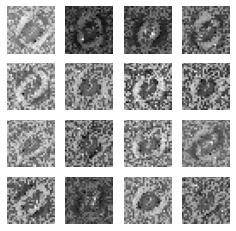

22
gen_loss: tf.Tensor(1.681652, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22675397, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2423176, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9432786  0.05672132]
 [0.97370976 0.02629017]
 [0.8918221  0.10817792]
 [0.97043097 0.0295691 ]
 [0.9324053  0.06759476]
 [0.9126516  0.08734835]
 [0.9630061  0.036994  ]
 [0.8188094  0.1811906 ]
 [0.98286426 0.01713578]
 [0.42762494 0.57237506]
 [0.98631454 0.01368547]
 [0.9424464  0.05755359]
 [0.9328466  0.06715342]
 [0.96509236 0.03490762]
 [0.9366407  0.0633593 ]
 [0.68148327 0.31851673]
 [0.8573604  0.14263965]
 [0.9016587  0.09834133]
 [0.99290365 0.00709638]
 [0.9027541  0.09724583]
 [0.9498783  0.05012172]
 [0.96882665 0.03117331]
 [0.87788635 0.12211362]
 [0.9703626  0.02963741]
 [0.86027104 0.13972898]
 [0.93197167 0.06802839]
 [0.9847536  0.0152464 ]
 [0.63142025 0.36857978]
 [0.8905008  0.10949926]
 [0.8742695  0.1257305 ]
 [0.93779844 0.06220154]
 [0.

gen_loss: tf.Tensor(1.6899548, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22223194, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.23149128, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9434401  0.05655994]
 [0.96240556 0.0375944 ]
 [0.9380909  0.0619091 ]
 [0.9862586  0.01374136]
 [0.95773333 0.04226664]
 [0.9276868  0.07231317]
 [0.9788305  0.02116943]
 [0.7695412  0.23045875]
 [0.9909473  0.00905269]
 [0.5796303  0.4203697 ]
 [0.98775625 0.01224375]
 [0.98064053 0.01935946]
 [0.953004   0.04699606]
 [0.9744835  0.02551655]
 [0.967841   0.03215901]
 [0.7363718  0.26362818]
 [0.89347535 0.10652465]
 [0.91908807 0.08091192]
 [0.9952911  0.00470888]
 [0.939844   0.06015597]
 [0.9647339  0.03526614]
 [0.9603747  0.03962534]
 [0.9174231  0.08257686]
 [0.9867027  0.01329733]
 [0.89978564 0.10021439]
 [0.9256347  0.07436527]
 [0.99176425 0.00823574]
 [0.5722897  0.4277102 ]
 [0.9410729  0.0589271 ]
 [0.9448789  0.05512112]
 [0.9627335  0.03726647]
 [0.8

gen_loss: tf.Tensor(1.7045279, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22638625, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.23704685, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.91125214 0.08874793]
 [0.9625708  0.03742927]
 [0.92554104 0.07445894]
 [0.9797706  0.02022941]
 [0.94354725 0.05645272]
 [0.8988305  0.1011695 ]
 [0.96862364 0.03137634]
 [0.6377703  0.36222968]
 [0.98670435 0.01329563]
 [0.4720292  0.52797073]
 [0.97502625 0.02497373]
 [0.98103654 0.01896347]
 [0.93386203 0.06613795]
 [0.966921   0.03307901]
 [0.9567439  0.04325609]
 [0.64901716 0.35098284]
 [0.83171105 0.16828887]
 [0.86656255 0.13343744]
 [0.9921355  0.00786451]
 [0.90311664 0.09688339]
 [0.95048445 0.04951552]
 [0.9693155  0.03068439]
 [0.8545809  0.14541908]
 [0.9802334  0.01976662]
 [0.8677691  0.13223085]
 [0.89105034 0.10894968]
 [0.9867014  0.01329858]
 [0.44644898 0.553551  ]
 [0.9038822  0.09611776]
 [0.9241408  0.07585926]
 [0.95251703 0.04748299]
 [0.7

gen_loss: tf.Tensor(1.7060032, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.28750658, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.23163193, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[0.9504818  0.04951824]
 [0.9760082  0.02399175]
 [0.965492   0.03450795]
 [0.9888123  0.01118768]
 [0.97285044 0.02714964]
 [0.95630425 0.04369572]
 [0.98338    0.01662   ]
 [0.79807365 0.20192635]
 [0.99248075 0.00751921]
 [0.73830974 0.26169026]
 [0.9887834  0.01121658]
 [0.99027634 0.00972364]
 [0.95121706 0.04878293]
 [0.98858494 0.01141501]
 [0.975706   0.02429399]
 [0.77296007 0.22703992]
 [0.90543264 0.09456737]
 [0.93405503 0.06594504]
 [0.9960502  0.00394989]
 [0.9492483  0.05075172]
 [0.9775262  0.02247381]
 [0.97648674 0.02351325]
 [0.9221491  0.0778509 ]
 [0.98951703 0.01048298]
 [0.921927   0.07807305]
 [0.9302064  0.0697936 ]
 [0.9934558  0.00654418]
 [0.59654105 0.40345895]
 [0.93079144 0.06920853]
 [0.96590537 0.03409465]
 [0.97066104 0.02933894]
 [0.8

gen_loss: tf.Tensor(1.699101, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21358086, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2299254, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.35783148e-01 6.42169118e-02]
 [9.81534719e-01 1.84652898e-02]
 [9.65310395e-01 3.46896648e-02]
 [9.77482498e-01 2.25174949e-02]
 [9.59172189e-01 4.08277847e-02]
 [9.26251829e-01 7.37481564e-02]
 [9.75617707e-01 2.43822671e-02]
 [7.99960852e-01 2.00039104e-01]
 [9.88943458e-01 1.10564968e-02]
 [5.29604793e-01 4.70395267e-01]
 [9.81481314e-01 1.85186807e-02]
 [9.81723368e-01 1.82767119e-02]
 [9.57093120e-01 4.29069251e-02]
 [9.79739249e-01 2.02607233e-02]
 [9.67453778e-01 3.25462595e-02]
 [6.51630640e-01 3.48369360e-01]
 [8.45154405e-01 1.54845595e-01]
 [8.88335943e-01 1.11663997e-01]
 [9.95221674e-01 4.77827806e-03]
 [9.02787745e-01 9.72122028e-02]
 [9.71126139e-01 2.88738888e-02]
 [9.79382634e-01 2.06174310e-02]
 [8.53068411e-01 1.46931633e-01]
 [9.79286909e-01 2.0713

gen_loss: tf.Tensor(1.7422401, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20868191, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.22665752, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.17837024e-01 8.21629614e-02]
 [9.83929753e-01 1.60702560e-02]
 [9.54243958e-01 4.57559861e-02]
 [9.60051000e-01 3.99489403e-02]
 [9.37956333e-01 6.20436259e-02]
 [9.00350988e-01 9.96489525e-02]
 [9.61012065e-01 3.89879160e-02]
 [7.84618676e-01 2.15381250e-01]
 [9.82885599e-01 1.71143934e-02]
 [3.81480992e-01 6.18519008e-01]
 [9.71377134e-01 2.86228098e-02]
 [9.68772769e-01 3.12272459e-02]
 [9.56078053e-01 4.39219736e-02]
 [9.61875677e-01 3.81243266e-02]
 [9.49473739e-01 5.05262949e-02]
 [5.46536207e-01 4.53463793e-01]
 [7.65134454e-01 2.34865591e-01]
 [8.44439566e-01 1.55560449e-01]
 [9.92435992e-01 7.56402873e-03]
 [8.46904933e-01 1.53095007e-01]
 [9.62976217e-01 3.70238312e-02]
 [9.81491327e-01 1.85087249e-02]
 [7.78015852e-01 2.21984148e-01]
 [9.62397754e-01 3.76

test_discriminator_output: tf.Tensor(
[[9.44666028e-01 5.53340018e-02]
 [9.84778702e-01 1.52213220e-02]
 [9.73677576e-01 2.63224710e-02]
 [9.79226351e-01 2.07736921e-02]
 [9.63427901e-01 3.65720801e-02]
 [9.48102832e-01 5.18971756e-02]
 [9.77640271e-01 2.23597158e-02]
 [8.59148145e-01 1.40851840e-01]
 [9.90432322e-01 9.56769288e-03]
 [5.99416018e-01 4.00583982e-01]
 [9.84927535e-01 1.50724724e-02]
 [9.83310401e-01 1.66896489e-02]
 [9.71475780e-01 2.85241995e-02]
 [9.77665007e-01 2.23349612e-02]
 [9.70089793e-01 2.99102049e-02]
 [6.74928069e-01 3.25071990e-01]
 [8.53260696e-01 1.46739319e-01]
 [9.17561233e-01 8.24387968e-02]
 [9.95525420e-01 4.47460171e-03]
 [9.19442892e-01 8.05570707e-02]
 [9.80319440e-01 1.96805522e-02]
 [9.79908645e-01 2.00912859e-02]
 [8.82548988e-01 1.17451034e-01]
 [9.80687559e-01 1.93125065e-02]
 [8.66811574e-01 1.33188426e-01]
 [9.59197700e-01 4.08022255e-02]
 [9.89422977e-01 1.05769737e-02]
 [7.57333279e-01 2.42666692e-01]
 [9.50377226e-01 4.96228114e-02]
 [9.2

gen_loss: tf.Tensor(1.7924098, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.25528812, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.22184521, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.59247530e-01 4.07524593e-02]
 [9.83260095e-01 1.67398509e-02]
 [9.85925257e-01 1.40747996e-02]
 [9.89873171e-01 1.01268552e-02]
 [9.78319347e-01 2.16806754e-02]
 [9.72768426e-01 2.72316523e-02]
 [9.87198174e-01 1.28018009e-02]
 [9.03000295e-01 9.69997495e-02]
 [9.94940639e-01 5.05934283e-03]
 [7.65528917e-01 2.34471053e-01]
 [9.91340220e-01 8.65980610e-03]
 [9.91514921e-01 8.48502573e-03]
 [9.84155536e-01 1.58445146e-02]
 [9.86278474e-01 1.37214931e-02]
 [9.83423710e-01 1.65763572e-02]
 [7.82275796e-01 2.17724219e-01]
 [9.10759509e-01 8.92404988e-02]
 [9.56578195e-01 4.34218794e-02]
 [9.97478902e-01 2.52110045e-03]
 [9.59253788e-01 4.07462642e-02]
 [9.90759254e-01 9.24073253e-03]
 [9.75521028e-01 2.44789235e-02]
 [9.41615641e-01 5.83843626e-02]
 [9.90948737e-01 9.05

gen_loss: tf.Tensor(1.823697, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2249923, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.19682634, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.25388336e-01 7.46116564e-02]
 [9.83627558e-01 1.63724255e-02]
 [9.66543734e-01 3.34562249e-02]
 [9.70732808e-01 2.92672347e-02]
 [9.48621333e-01 5.13787381e-02]
 [9.34606969e-01 6.53930455e-02]
 [9.65133905e-01 3.48661579e-02]
 [8.44347298e-01 1.55652747e-01]
 [9.87209082e-01 1.27909165e-02]
 [4.54201221e-01 5.45798779e-01]
 [9.76430714e-01 2.35692784e-02]
 [9.75756168e-01 2.42438726e-02]
 [9.74576175e-01 2.54237615e-02]
 [9.62309659e-01 3.76903303e-02]
 [9.59756970e-01 4.02430259e-02]
 [6.08589053e-01 3.91410917e-01]
 [7.88597465e-01 2.11402461e-01]
 [8.87983799e-01 1.12016186e-01]
 [9.93959308e-01 6.04066998e-03]
 [8.82257164e-01 1.17742844e-01]
 [9.78127122e-01 2.18728539e-02]
 [9.81628895e-01 1.83710475e-02]
 [8.31755698e-01 1.68244347e-01]
 [9.74029303e-01 2.5970

gen_loss: tf.Tensor(1.8011258, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2799518, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20590484, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.48183060e-01 5.18168733e-02]
 [9.83297825e-01 1.67022459e-02]
 [9.74639237e-01 2.53607724e-02]
 [9.79880929e-01 2.01190840e-02]
 [9.67335999e-01 3.26639712e-02]
 [9.62864995e-01 3.71350199e-02]
 [9.74998474e-01 2.50015296e-02]
 [8.87155294e-01 1.12844706e-01]
 [9.91042614e-01 8.95737577e-03]
 [6.03446364e-01 3.96553695e-01]
 [9.86356854e-01 1.36431996e-02]
 [9.79100585e-01 2.08994020e-02]
 [9.78053689e-01 2.19462868e-02]
 [9.75282550e-01 2.47174650e-02]
 [9.69037056e-01 3.09629515e-02]
 [7.11599708e-01 2.88400233e-01]
 [8.49456608e-01 1.50543481e-01]
 [9.31893885e-01 6.81060925e-02]
 [9.95891809e-01 4.10818681e-03]
 [9.31063235e-01 6.89367354e-02]
 [9.86480713e-01 1.35192322e-02]
 [9.82208073e-01 1.77919772e-02]
 [8.96199763e-01 1.03800274e-01]
 [9.82315481e-01 1.768

gen_loss: tf.Tensor(1.801595, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21782401, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20484824, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.61557567e-01 3.84424701e-02]
 [9.79540884e-01 2.04590727e-02]
 [9.88833189e-01 1.11667998e-02]
 [9.90842104e-01 9.15784203e-03]
 [9.82039511e-01 1.79605410e-02]
 [9.79448020e-01 2.05520019e-02]
 [9.86812770e-01 1.31872557e-02]
 [9.01942492e-01 9.80574712e-02]
 [9.95684624e-01 4.31543402e-03]
 [7.72974908e-01 2.27025062e-01]
 [9.91978526e-01 8.02142080e-03]
 [9.88823235e-01 1.11767231e-02]
 [9.85803843e-01 1.41961696e-02]
 [9.87193882e-01 1.28060803e-02]
 [9.83610749e-01 1.63892210e-02]
 [8.11235249e-01 1.88764721e-01]
 [9.09108341e-01 9.08917114e-02]
 [9.65252817e-01 3.47471684e-02]
 [9.97906327e-01 2.09372491e-03]
 [9.69101429e-01 3.08985766e-02]
 [9.94256318e-01 5.74375456e-03]
 [9.76465464e-01 2.35345215e-02]
 [9.50259089e-01 4.97408435e-02]
 [9.91986513e-01 8.013

gen_loss: tf.Tensor(1.7665125, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19325525, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21740371, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.53400433e-01 4.65995744e-02]
 [9.80359495e-01 1.96404736e-02]
 [9.89620328e-01 1.03796311e-02]
 [9.89947915e-01 1.00520551e-02]
 [9.80213583e-01 1.97863784e-02]
 [9.73365605e-01 2.66343523e-02]
 [9.85461056e-01 1.45390099e-02]
 [8.81359160e-01 1.18640848e-01]
 [9.95609701e-01 4.39025369e-03]
 [7.01854348e-01 2.98145622e-01]
 [9.88882124e-01 1.11178122e-02]
 [9.87787306e-01 1.22126983e-02]
 [9.86275434e-01 1.37246111e-02]
 [9.84889388e-01 1.51106548e-02]
 [9.83208716e-01 1.67913232e-02]
 [7.81094849e-01 2.18905166e-01]
 [8.87755454e-01 1.12244591e-01]
 [9.57817495e-01 4.21824306e-02]
 [9.97929096e-01 2.07086513e-03]
 [9.62547481e-01 3.74525301e-02]
 [9.93527353e-01 6.47262437e-03]
 [9.78404701e-01 2.15952527e-02]
 [9.39049602e-01 6.09504096e-02]
 [9.91273224e-01 8.72

test_discriminator_output: tf.Tensor(
[[9.34555531e-01 6.54443949e-02]
 [9.83994246e-01 1.60057899e-02]
 [9.87897038e-01 1.21029736e-02]
 [9.85145330e-01 1.48546938e-02]
 [9.71675217e-01 2.83248425e-02]
 [9.58058417e-01 4.19415981e-02]
 [9.79193628e-01 2.08063461e-02]
 [8.48780572e-01 1.51219457e-01]
 [9.94063199e-01 5.93681820e-03]
 [5.48291028e-01 4.51709002e-01]
 [9.79648411e-01 2.03516241e-02]
 [9.82707322e-01 1.72926206e-02]
 [9.83712673e-01 1.62873678e-02]
 [9.78159308e-01 2.18406916e-02]
 [9.77779508e-01 2.22204700e-02]
 [7.04910636e-01 2.95089334e-01]
 [8.26700032e-01 1.73299909e-01]
 [9.35456693e-01 6.45432770e-02]
 [9.97323871e-01 2.67614005e-03]
 [9.37857389e-01 6.21426441e-02]
 [9.90140378e-01 9.85966902e-03]
 [9.83885527e-01 1.61144603e-02]
 [8.98393929e-01 1.01606071e-01]
 [9.86981452e-01 1.30185410e-02]
 [8.86197746e-01 1.13802195e-01]
 [9.65544045e-01 3.44559774e-02]
 [9.87400115e-01 1.25998957e-02]
 [7.62673259e-01 2.37326801e-01]
 [9.38749075e-01 6.12509586e-02]
 [9.5

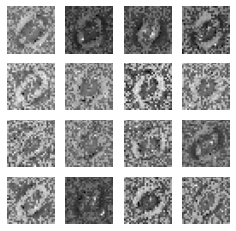

23
gen_loss: tf.Tensor(1.7981844, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20425224, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20291841, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.17511165e-01 8.24888349e-02]
 [9.86584663e-01 1.34152593e-02]
 [9.87466753e-01 1.25332307e-02]
 [9.82028008e-01 1.79720167e-02]
 [9.65657651e-01 3.43423150e-02]
 [9.47726190e-01 5.22738360e-02]
 [9.74085510e-01 2.59145033e-02]
 [8.28299165e-01 1.71700850e-01]
 [9.92792964e-01 7.20704114e-03]
 [4.53594476e-01 5.46405494e-01]
 [9.69878495e-01 3.01215611e-02]
 [9.79745090e-01 2.02548783e-02]
 [9.81551945e-01 1.84481051e-02]
 [9.73606229e-01 2.63936948e-02]
 [9.73601639e-01 2.63983775e-02]
 [6.58508003e-01 3.41491967e-01]
 [7.78070986e-01 2.21929058e-01]
 [9.18617189e-01 8.13828111e-02]
 [9.96920228e-01 3.07978084e-03]
 [9.17439818e-01 8.25601742e-02]
 [9.87481713e-01 1.25182969e-02]
 [9.87464786e-01 1.25351958e-02]
 [8.62882793e-01 1.37117237e-01]
 [9.83834088e-01 1

gen_loss: tf.Tensor(1.7897289, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19011904, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20976818, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.21233654e-01 7.87663162e-02]
 [9.83128726e-01 1.68712959e-02]
 [9.93949413e-01 6.05061604e-03]
 [9.92283523e-01 7.71651464e-03]
 [9.78870392e-01 2.11296193e-02]
 [9.74075437e-01 2.59246156e-02]
 [9.84822392e-01 1.51775694e-02]
 [8.54226291e-01 1.45773694e-01]
 [9.95734394e-01 4.26568650e-03]
 [6.97849572e-01 3.02150428e-01]
 [9.78993177e-01 2.10067835e-02]
 [9.92666543e-01 7.33349333e-03]
 [9.86927450e-01 1.30724944e-02]
 [9.83458996e-01 1.65410563e-02]
 [9.84566033e-01 1.54339904e-02]
 [7.69548893e-01 2.30451062e-01]
 [8.58452559e-01 1.41547471e-01]
 [9.58378136e-01 4.16219085e-02]
 [9.97945726e-01 2.05431529e-03]
 [9.60800290e-01 3.91997322e-02]
 [9.93831992e-01 6.16796874e-03]
 [9.84774292e-01 1.52256461e-02]
 [9.27616835e-01 7.23831058e-02]
 [9.93111730e-01 6.88

gen_loss: tf.Tensor(1.7703826, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18624187, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21247041, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.29381132e-01 7.06188455e-02]
 [9.81085181e-01 1.89147703e-02]
 [9.95006025e-01 4.99395141e-03]
 [9.93763864e-01 6.23612106e-03]
 [9.83017206e-01 1.69827770e-02]
 [9.79944944e-01 2.00550016e-02]
 [9.86866713e-01 1.31332418e-02]
 [8.90825808e-01 1.09174207e-01]
 [9.95813787e-01 4.18617763e-03]
 [7.58057714e-01 2.41942316e-01]
 [9.85786557e-01 1.42134232e-02]
 [9.93496656e-01 6.50337012e-03]
 [9.89779294e-01 1.02206729e-02]
 [9.85035777e-01 1.49641978e-02]
 [9.84969854e-01 1.50300935e-02]
 [7.99901009e-01 2.00099066e-01]
 [8.84557605e-01 1.15442455e-01]
 [9.72780347e-01 2.72196531e-02]
 [9.98119295e-01 1.88071199e-03]
 [9.70444858e-01 2.95550805e-02]
 [9.96015251e-01 3.98468180e-03]
 [9.82864141e-01 1.71358548e-02]
 [9.42505300e-01 5.74947111e-02]
 [9.94483888e-01 5.51

test_discriminator_output: tf.Tensor(
[[9.09803927e-01 9.01960284e-02]
 [9.82988775e-01 1.70112457e-02]
 [9.92015362e-01 7.98457582e-03]
 [9.87963080e-01 1.20369438e-02]
 [9.72601473e-01 2.73985714e-02]
 [9.64121461e-01 3.58784981e-02]
 [9.77295578e-01 2.27044225e-02]
 [8.74213636e-01 1.25786290e-01]
 [9.92294431e-01 7.70560931e-03]
 [5.67378759e-01 4.32621181e-01]
 [9.78649735e-01 2.13502534e-02]
 [9.86185491e-01 1.38145545e-02]
 [9.87802923e-01 1.21970912e-02]
 [9.73536551e-01 2.64634416e-02]
 [9.73061800e-01 2.69382540e-02]
 [6.97841287e-01 3.02158684e-01]
 [8.13108146e-01 1.86891884e-01]
 [9.56726432e-01 4.32735942e-02]
 [9.97032285e-01 2.96765682e-03]
 [9.43840802e-01 5.61591536e-02]
 [9.93860126e-01 6.13988750e-03]
 [9.85704899e-01 1.42950425e-02]
 [8.90145481e-01 1.09854527e-01]
 [9.89279091e-01 1.07208909e-02]
 [8.55581760e-01 1.44418254e-01]
 [9.79540884e-01 2.04590522e-02]
 [9.83556747e-01 1.64432861e-02]
 [8.26697826e-01 1.73302174e-01]
 [9.54924762e-01 4.50752378e-02]
 [9.5

gen_loss: tf.Tensor(1.8305719, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17663367, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20594192, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.90782654e-01 1.09217316e-01]
 [9.85192299e-01 1.48077067e-02]
 [9.91137266e-01 8.86277296e-03]
 [9.82549787e-01 1.74502172e-02]
 [9.60118175e-01 3.98817882e-02]
 [9.45316374e-01 5.46836406e-02]
 [9.66818690e-01 3.31812836e-02]
 [8.71781528e-01 1.28218487e-01]
 [9.88565624e-01 1.14343408e-02]
 [4.09872055e-01 5.90127885e-01]
 [9.70645785e-01 2.93541830e-02]
 [9.79318917e-01 2.06811242e-02]
 [9.87470329e-01 1.25296665e-02]
 [9.59763765e-01 4.02362086e-02]
 [9.60830212e-01 3.91698070e-02]
 [6.00042224e-01 3.99957806e-01]
 [7.42590070e-01 2.57409871e-01]
 [9.40343499e-01 5.96564934e-02]
 [9.96137917e-01 3.86202405e-03]
 [9.11852419e-01 8.81476030e-02]
 [9.92428958e-01 7.57107651e-03]
 [9.88521814e-01 1.14781903e-02]
 [8.28046501e-01 1.71953455e-01]
 [9.84400451e-01 1.55

gen_loss: tf.Tensor(1.7918159, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22372198, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20952895, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.15820599e-01 8.41793939e-02]
 [9.82614100e-01 1.73858590e-02]
 [9.96326625e-01 3.67338140e-03]
 [9.93426561e-01 6.57348800e-03]
 [9.79321420e-01 2.06785295e-02]
 [9.75031018e-01 2.49689799e-02]
 [9.84260499e-01 1.57395024e-02]
 [9.10683513e-01 8.93164650e-02]
 [9.94504392e-01 5.49560133e-03]
 [6.68531120e-01 3.31468940e-01]
 [9.84386623e-01 1.56133976e-02]
 [9.92517710e-01 7.48232706e-03]
 [9.93019640e-01 6.98030181e-03]
 [9.79819596e-01 2.01803967e-02]
 [9.80278552e-01 1.97214168e-02]
 [7.55869269e-01 2.44130716e-01]
 [8.65380108e-01 1.34619847e-01]
 [9.72124577e-01 2.78754309e-02]
 [9.97943223e-01 2.05677329e-03]
 [9.62494552e-01 3.75053920e-02]
 [9.97042954e-01 2.95704650e-03]
 [9.85950530e-01 1.40494918e-02]
 [9.25070703e-01 7.49292821e-02]
 [9.94342685e-01 5.65

gen_loss: tf.Tensor(1.8731004, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23054022, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1946151, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.42509294e-01 5.74907213e-02]
 [9.84589756e-01 1.54102938e-02]
 [9.97659564e-01 2.34042527e-03]
 [9.96311367e-01 3.68862017e-03]
 [9.86808479e-01 1.31915063e-02]
 [9.83148813e-01 1.68511849e-02]
 [9.90750492e-01 9.24946740e-03]
 [9.34444368e-01 6.55556619e-02]
 [9.96723711e-01 3.27631482e-03]
 [7.67451704e-01 2.32548282e-01]
 [9.90927756e-01 9.07219760e-03]
 [9.94346917e-01 5.65311499e-03]
 [9.94640410e-01 5.35957562e-03]
 [9.87918913e-01 1.20811528e-02]
 [9.87535894e-01 1.24640716e-02]
 [8.26817930e-01 1.73182040e-01]
 [9.13798392e-01 8.62016082e-02]
 [9.83170927e-01 1.68290231e-02]
 [9.98844743e-01 1.15525571e-03]
 [9.78782475e-01 2.12175250e-02]
 [9.98104453e-01 1.89555646e-03]
 [9.86808777e-01 1.31911645e-02]
 [9.60952401e-01 3.90475839e-02]
 [9.96843576e-01 3.156

test_discriminator_output: tf.Tensor(
[[9.43034530e-01 5.69654889e-02]
 [9.89972115e-01 1.00278417e-02]
 [9.96596038e-01 3.40397260e-03]
 [9.94219065e-01 5.78093948e-03]
 [9.82115269e-01 1.78847518e-02]
 [9.77390885e-01 2.26091407e-02]
 [9.87422585e-01 1.25773903e-02]
 [9.29812551e-01 7.01874048e-02]
 [9.95427251e-01 4.57272027e-03]
 [6.65496051e-01 3.34504038e-01]
 [9.89013672e-01 1.09864147e-02]
 [9.89689708e-01 1.03103202e-02]
 [9.92140710e-01 7.85930175e-03]
 [9.86020625e-01 1.39793782e-02]
 [9.82110202e-01 1.78898107e-02]
 [7.86325574e-01 2.13674366e-01]
 [8.83094966e-01 1.16905026e-01]
 [9.78233755e-01 2.17662212e-02]
 [9.98580337e-01 1.41968904e-03]
 [9.69345689e-01 3.06543075e-02]
 [9.96885478e-01 3.11450521e-03]
 [9.91490781e-01 8.50915350e-03]
 [9.45498049e-01 5.45019098e-02]
 [9.94898021e-01 5.10198157e-03]
 [8.98828983e-01 1.01171024e-01]
 [9.84304607e-01 1.56954490e-02]
 [9.89474654e-01 1.05253812e-02]
 [9.05153155e-01 9.48468223e-02]
 [9.48536813e-01 5.14632575e-02]
 [9.8

gen_loss: tf.Tensor(1.784659, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.25025725, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21037436, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.05337930e-01 9.46620479e-02]
 [9.91220295e-01 8.77973158e-03]
 [9.94609237e-01 5.39073348e-03]
 [9.90248621e-01 9.75135621e-03]
 [9.70684409e-01 2.93156244e-02]
 [9.65332925e-01 3.46670784e-02]
 [9.78783011e-01 2.12170016e-02]
 [8.81373405e-01 1.18626609e-01]
 [9.92717385e-01 7.28256209e-03]
 [5.01659572e-01 4.98340458e-01]
 [9.78733122e-01 2.12668553e-02]
 [9.85417426e-01 1.45826070e-02]
 [9.87955630e-01 1.20443804e-02]
 [9.80580688e-01 1.94193441e-02]
 [9.71652806e-01 2.83472054e-02]
 [7.24087298e-01 2.75912702e-01]
 [8.22424591e-01 1.77575409e-01]
 [9.63187933e-01 3.68120931e-02]
 [9.97709036e-01 2.29090615e-03]
 [9.42275226e-01 5.77247404e-02]
 [9.95148599e-01 4.85144695e-03]
 [9.92819965e-01 7.18008354e-03]
 [9.06594872e-01 9.34051797e-02]
 [9.91400003e-01 8.599

gen_loss: tf.Tensor(1.8228014, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2322512, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20530799, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.64987135e-01 1.35012895e-01]
 [9.83591378e-01 1.64086502e-02]
 [9.95387495e-01 4.61251382e-03]
 [9.93065059e-01 6.93492591e-03]
 [9.75092769e-01 2.49071904e-02]
 [9.74159896e-01 2.58401278e-02]
 [9.82907474e-01 1.70925669e-02]
 [8.36972356e-01 1.63027659e-01]
 [9.94203627e-01 5.79634076e-03]
 [6.12909079e-01 3.87090921e-01]
 [9.79034424e-01 2.09655222e-02]
 [9.91774499e-01 8.22550245e-03]
 [9.89230812e-01 1.07691959e-02]
 [9.83126998e-01 1.68730337e-02]
 [9.77592289e-01 2.24076714e-02]
 [7.83333719e-01 2.16666281e-01]
 [8.60517621e-01 1.39482349e-01]
 [9.70154881e-01 2.98451204e-02]
 [9.97694552e-01 2.30539055e-03]
 [9.54744339e-01 4.52556461e-02]
 [9.97133732e-01 2.86620157e-03]
 [9.86122191e-01 1.38778677e-02]
 [9.33808684e-01 6.61913157e-02]
 [9.94123638e-01 5.876

gen_loss: tf.Tensor(1.761971, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23073813, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21510689, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.97613585e-01 1.02386408e-01]
 [9.88661945e-01 1.13380319e-02]
 [9.95165110e-01 4.83493414e-03]
 [9.92617309e-01 7.38273328e-03]
 [9.75160003e-01 2.48400085e-02]
 [9.82477486e-01 1.75225399e-02]
 [9.84213471e-01 1.57865323e-02]
 [8.89168739e-01 1.10831298e-01]
 [9.94187474e-01 5.81252575e-03]
 [7.28033960e-01 2.71966070e-01]
 [9.86639023e-01 1.33609865e-02]
 [9.90602851e-01 9.39712487e-03]
 [9.85823989e-01 1.41760306e-02]
 [9.88705575e-01 1.12944515e-02]
 [9.76938546e-01 2.30614338e-02]
 [8.20590496e-01 1.79409459e-01]
 [8.78606856e-01 1.21393174e-01]
 [9.79189634e-01 2.08103526e-02]
 [9.97874498e-01 2.12551747e-03]
 [9.63843226e-01 3.61568257e-02]
 [9.96442616e-01 3.55741102e-03]
 [9.89270926e-01 1.07290205e-02]
 [9.47588503e-01 5.24114817e-02]
 [9.93446767e-01 6.553

gen_loss: tf.Tensor(1.8109341, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20199822, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21216154, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.62529635e-01 1.37470379e-01]
 [9.86316979e-01 1.36829950e-02]
 [9.93597031e-01 6.40291674e-03]
 [9.88672554e-01 1.13274325e-02]
 [9.63890731e-01 3.61092426e-02]
 [9.70748663e-01 2.92513613e-02]
 [9.78651822e-01 2.13481970e-02]
 [8.32563639e-01 1.67436376e-01]
 [9.92605448e-01 7.39459554e-03]
 [5.56833327e-01 4.43166643e-01]
 [9.77064848e-01 2.29351241e-02]
 [9.85547960e-01 1.44520085e-02]
 [9.79962111e-01 2.00378802e-02]
 [9.79407668e-01 2.05923207e-02]
 [9.72320318e-01 2.76796222e-02]
 [7.44341969e-01 2.55658060e-01]
 [8.05955708e-01 1.94044292e-01]
 [9.64581549e-01 3.54184695e-02]
 [9.97157693e-01 2.84231897e-03]
 [9.44206476e-01 5.57934903e-02]
 [9.93985355e-01 6.01466652e-03]
 [9.89260554e-01 1.07394885e-02]
 [9.15897489e-01 8.41024593e-02]
 [9.90036130e-01 9.96

gen_loss: tf.Tensor(1.8105199, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21939361, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21199122, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[7.72481203e-01 2.27518782e-01]
 [9.73147094e-01 2.68528201e-02]
 [9.91874635e-01 8.12539272e-03]
 [9.83241558e-01 1.67583916e-02]
 [9.42990541e-01 5.70094436e-02]
 [9.43860352e-01 5.61396480e-02]
 [9.69030142e-01 3.09699215e-02]
 [7.03859806e-01 2.96140194e-01]
 [9.89445031e-01 1.05549302e-02]
 [3.32062691e-01 6.67937338e-01]
 [9.55085099e-01 4.49148528e-02]
 [9.78030980e-01 2.19690260e-02]
 [9.79419112e-01 2.05808934e-02]
 [9.55492735e-01 4.45073023e-02]
 [9.63878870e-01 3.61210927e-02]
 [6.20769858e-01 3.79230112e-01]
 [7.04832911e-01 2.95167059e-01]
 [9.26064909e-01 7.39351287e-02]
 [9.95801151e-01 4.19888925e-03]
 [9.02676702e-01 9.73233134e-02]
 [9.93168712e-01 6.83130464e-03]
 [9.83240962e-01 1.67590287e-02]
 [8.57954919e-01 1.42045021e-01]
 [9.85625327e-01 1.43

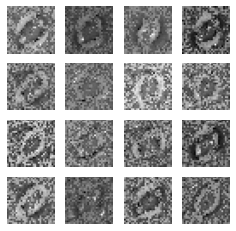

24
gen_loss: tf.Tensor(1.8278005, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21348011, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21110435, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[7.61041760e-01 2.38958225e-01]
 [9.68941927e-01 3.10581066e-02]
 [9.92508709e-01 7.49136275e-03]
 [9.82737064e-01 1.72629077e-02]
 [9.36351895e-01 6.36481047e-02]
 [9.50128675e-01 4.98713516e-02]
 [9.67605233e-01 3.23947854e-02]
 [6.90833986e-01 3.09166044e-01]
 [9.88085628e-01 1.19143259e-02]
 [3.89642537e-01 6.10357463e-01]
 [9.55116451e-01 4.48835418e-02]
 [9.79452848e-01 2.05471348e-02]
 [9.77440655e-01 2.25593410e-02]
 [9.64244843e-01 3.57552171e-02]
 [9.59872067e-01 4.01279479e-02]
 [6.20145142e-01 3.79854828e-01]
 [7.08107173e-01 2.91892827e-01]
 [9.23652649e-01 7.63473585e-02]
 [9.95559931e-01 4.44006687e-03]
 [9.01285827e-01 9.87141058e-02]
 [9.94215071e-01 5.78497583e-03]
 [9.80938017e-01 1.90620478e-02]
 [8.56767595e-01 1.43232450e-01]
 [9.85274136e-01 1

gen_loss: tf.Tensor(1.7931688, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19164407, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21229258, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.09134722e-01 1.90865263e-01]
 [9.81078625e-01 1.89213194e-02]
 [9.92136717e-01 7.86328129e-03]
 [9.73776102e-01 2.62239166e-02]
 [9.09775317e-01 9.02246535e-02]
 [9.53225434e-01 4.67745103e-02]
 [9.58061934e-01 4.19381037e-02]
 [7.70263493e-01 2.29736477e-01]
 [9.80925024e-01 1.90749839e-02]
 [4.31152493e-01 5.68847537e-01]
 [9.63395119e-01 3.66048664e-02]
 [9.63851750e-01 3.61482315e-02]
 [9.69520926e-01 3.04790698e-02]
 [9.77327347e-01 2.26725824e-02]
 [9.36231375e-01 6.37686551e-02]
 [5.81264555e-01 4.18735415e-01]
 [6.66653335e-01 3.33346725e-01]
 [9.18849170e-01 8.11507627e-02]
 [9.95234787e-01 4.76528006e-03]
 [8.75602365e-01 1.24397635e-01]
 [9.93657649e-01 6.34228904e-03]
 [9.87867832e-01 1.21321417e-02]
 [8.25195312e-01 1.74804702e-01]
 [9.76286173e-01 2.37

gen_loss: tf.Tensor(1.8091707, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23025873, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2135337, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.29699576e-01 1.70300364e-01]
 [9.77777004e-01 2.22230498e-02]
 [9.94188070e-01 5.81193110e-03]
 [9.81122136e-01 1.88779160e-02]
 [9.23725784e-01 7.62742311e-02]
 [9.39419866e-01 6.05801120e-02]
 [9.69878256e-01 3.01217847e-02]
 [7.79765546e-01 2.20234409e-01]
 [9.87135947e-01 1.28641240e-02]
 [3.61168891e-01 6.38831079e-01]
 [9.70514178e-01 2.94858553e-02]
 [9.67178941e-01 3.28210443e-02]
 [9.82197940e-01 1.78020466e-02]
 [9.73054230e-01 2.69457716e-02]
 [9.57578540e-01 4.24215049e-02]
 [5.69845796e-01 4.30154115e-01]
 [6.86961472e-01 3.13038558e-01]
 [9.17461693e-01 8.25383514e-02]
 [9.97065127e-01 2.93492526e-03]
 [8.85416925e-01 1.14583097e-01]
 [9.95099962e-01 4.90007643e-03]
 [9.86325085e-01 1.36748636e-02]
 [8.57420027e-01 1.42580032e-01]
 [9.83151197e-01 1.684

gen_loss: tf.Tensor(1.7946784, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17426942, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21030483, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.27880800e-01 1.72119215e-01]
 [9.73188221e-01 2.68118270e-02]
 [9.94829953e-01 5.17005567e-03]
 [9.86149907e-01 1.38500687e-02]
 [9.26018178e-01 7.39817545e-02]
 [9.27352071e-01 7.26479664e-02]
 [9.74603355e-01 2.53966283e-02]
 [7.38873005e-01 2.61126965e-01]
 [9.90719795e-01 9.28013958e-03]
 [3.27041656e-01 6.72958255e-01]
 [9.72648978e-01 2.73510106e-02]
 [9.75149333e-01 2.48506535e-02]
 [9.84647155e-01 1.53528079e-02]
 [9.57056940e-01 4.29431051e-02]
 [9.68973160e-01 3.10268551e-02]
 [5.57485044e-01 4.42514956e-01]
 [6.98549807e-01 3.01450193e-01]
 [9.17612731e-01 8.23873430e-02]
 [9.97328758e-01 2.67129042e-03]
 [9.00138557e-01 9.98614207e-02]
 [9.94912267e-01 5.08773047e-03]
 [9.84912694e-01 1.50872236e-02]
 [8.79354298e-01 1.20645694e-01]
 [9.87377822e-01 1.26

gen_loss: tf.Tensor(1.8305297, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20568435, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2095398, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.57782543e-01 1.42217442e-01]
 [9.87267554e-01 1.27324266e-02]
 [9.93704259e-01 6.29571034e-03]
 [9.81190324e-01 1.88097302e-02]
 [9.00423884e-01 9.95761007e-02]
 [9.34240818e-01 6.57592416e-02]
 [9.63997483e-01 3.60025130e-02]
 [7.69889951e-01 2.30110034e-01]
 [9.86544669e-01 1.34553891e-02]
 [3.26383799e-01 6.73616171e-01]
 [9.74168301e-01 2.58316901e-02]
 [9.61514056e-01 3.84859517e-02]
 [9.77850080e-01 2.21499037e-02]
 [9.61803854e-01 3.81961353e-02]
 [9.51825202e-01 4.81747538e-02]
 [5.38986087e-01 4.61013943e-01]
 [6.59288466e-01 3.40711504e-01]
 [9.25048411e-01 7.49516115e-02]
 [9.96244848e-01 3.75513709e-03]
 [8.89087975e-01 1.10912085e-01]
 [9.93281126e-01 6.71886047e-03]
 [9.91670609e-01 8.32939520e-03]
 [8.66133094e-01 1.33866981e-01]
 [9.81331229e-01 1.866

gen_loss: tf.Tensor(1.8368864, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20075703, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21163476, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.46471608e-01 1.53528377e-01]
 [9.89221692e-01 1.07783331e-02]
 [9.94821787e-01 5.17825829e-03]
 [9.84271705e-01 1.57282930e-02]
 [9.15528834e-01 8.44712257e-02]
 [9.45054710e-01 5.49453124e-02]
 [9.64371324e-01 3.56287025e-02]
 [7.80874193e-01 2.19125777e-01]
 [9.87199247e-01 1.28007466e-02]
 [3.40205312e-01 6.59794688e-01]
 [9.74122345e-01 2.58776769e-02]
 [9.66403663e-01 3.35963219e-02]
 [9.83665407e-01 1.63346492e-02]
 [9.72280204e-01 2.77198534e-02]
 [9.54204142e-01 4.57958877e-02]
 [6.02601290e-01 3.97398740e-01]
 [6.98586822e-01 3.01413149e-01]
 [9.34615552e-01 6.53844997e-02]
 [9.96442735e-01 3.55729251e-03]
 [8.91132295e-01 1.08867720e-01]
 [9.95779514e-01 4.22051921e-03]
 [9.91523504e-01 8.47651437e-03]
 [8.81976128e-01 1.18023917e-01]
 [9.84369755e-01 1.56

test_discriminator_output: tf.Tensor(
[[8.44689727e-01 1.55310214e-01]
 [9.87720788e-01 1.22792600e-02]
 [9.94930089e-01 5.06994408e-03]
 [9.86292124e-01 1.37077998e-02]
 [9.29909945e-01 7.00900331e-02]
 [9.44222629e-01 5.57773411e-02]
 [9.67163801e-01 3.28362137e-02]
 [7.84454942e-01 2.15545073e-01]
 [9.88422573e-01 1.15774451e-02]
 [3.08737487e-01 6.91262484e-01]
 [9.75626230e-01 2.43737511e-02]
 [9.66255188e-01 3.37448344e-02]
 [9.87253249e-01 1.27467969e-02]
 [9.70933735e-01 2.90662553e-02]
 [9.59149659e-01 4.08502743e-02]
 [6.35830402e-01 3.64169568e-01]
 [7.27067232e-01 2.72932768e-01]
 [9.36944902e-01 6.30551577e-02]
 [9.96753275e-01 3.24674440e-03]
 [8.94384742e-01 1.05615228e-01]
 [9.96662796e-01 3.33717791e-03]
 [9.90344703e-01 9.65522230e-03]
 [8.91604006e-01 1.08396024e-01]
 [9.86547589e-01 1.34524461e-02]
 [8.48074436e-01 1.51925549e-01]
 [9.87494290e-01 1.25057362e-02]
 [9.63107765e-01 3.68922539e-02]
 [8.41248333e-01 1.58751652e-01]
 [9.16304171e-01 8.36958736e-02]
 [9.5

gen_loss: tf.Tensor(1.8497051, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.23559164, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20791647, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.02338064e-01 1.97661906e-01]
 [9.86899614e-01 1.31004304e-02]
 [9.91845071e-01 8.15492962e-03]
 [9.80488002e-01 1.95120182e-02]
 [9.16567802e-01 8.34321603e-02]
 [9.24972415e-01 7.50276521e-02]
 [9.54851508e-01 4.51484993e-02]
 [6.95858598e-01 3.04141432e-01]
 [9.83780086e-01 1.62199922e-02]
 [1.93633869e-01 8.06366086e-01]
 [9.59748089e-01 4.02518958e-02]
 [9.54923213e-01 4.50768024e-02]
 [9.77567792e-01 2.24321522e-02]
 [9.54469681e-01 4.55303155e-02]
 [9.46354449e-01 5.36455214e-02]
 [5.76419890e-01 4.23580110e-01]
 [6.59503937e-01 3.40496093e-01]
 [8.97493899e-01 1.02506153e-01]
 [9.95085895e-01 4.91405558e-03]
 [8.38500559e-01 1.61499470e-01]
 [9.94584262e-01 5.41571528e-03]
 [9.92319167e-01 7.68084871e-03]
 [8.33500981e-01 1.66499004e-01]
 [9.81143713e-01 1.88

gen_loss: tf.Tensor(1.8496238, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20388766, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20150167, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.03251052e-01 9.67489108e-02]
 [9.91400242e-01 8.59976839e-03]
 [9.95529711e-01 4.47035534e-03]
 [9.88715112e-01 1.12848599e-02]
 [9.44056451e-01 5.59435487e-02]
 [9.59900618e-01 4.00994159e-02]
 [9.73084271e-01 2.69157123e-02]
 [8.22595716e-01 1.77404314e-01]
 [9.90336061e-01 9.66398045e-03]
 [3.48221689e-01 6.51778400e-01]
 [9.81220722e-01 1.87792908e-02]
 [9.64776158e-01 3.52238044e-02]
 [9.79839861e-01 2.01600771e-02]
 [9.82787788e-01 1.72121711e-02]
 [9.67040598e-01 3.29593867e-02]
 [6.74734354e-01 3.25265646e-01]
 [7.76829004e-01 2.23171070e-01]
 [9.40048754e-01 5.99512272e-02]
 [9.97703254e-01 2.29674904e-03]
 [9.12039995e-01 8.79600048e-02]
 [9.96786833e-01 3.21319746e-03]
 [9.94120419e-01 5.87953534e-03]
 [9.14695144e-01 8.53048712e-02]
 [9.88821864e-01 1.11

gen_loss: tf.Tensor(1.8628374, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21691932, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21872668, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.22333479e-01 7.76665658e-02]
 [9.87923443e-01 1.20766293e-02]
 [9.97821450e-01 2.17859331e-03]
 [9.95542467e-01 4.45753895e-03]
 [9.70448554e-01 2.95514427e-02]
 [9.72945869e-01 2.70541366e-02]
 [9.86923635e-01 1.30764339e-02]
 [8.58760536e-01 1.41239494e-01]
 [9.95818675e-01 4.18140646e-03]
 [5.16414464e-01 4.83585507e-01]
 [9.89037097e-01 1.09628905e-02]
 [9.81284440e-01 1.87156387e-02]
 [9.91272151e-01 8.72778334e-03]
 [9.88009632e-01 1.19903926e-02]
 [9.85890031e-01 1.41099505e-02]
 [7.53319085e-01 2.46680915e-01]
 [8.69202375e-01 1.30797595e-01]
 [9.65423465e-01 3.45765315e-02]
 [9.98928964e-01 1.07100862e-03]
 [9.57555890e-01 4.24440801e-02]
 [9.98781741e-01 1.21829484e-03]
 [9.90493715e-01 9.50632244e-03]
 [9.66633260e-01 3.33666615e-02]
 [9.95524526e-01 4.47

test_discriminator_output: tf.Tensor(
[[9.07488227e-01 9.25117508e-02]
 [9.89158034e-01 1.08419880e-02]
 [9.96742308e-01 3.25766648e-03]
 [9.93537247e-01 6.46269321e-03]
 [9.61922228e-01 3.80778201e-02]
 [9.57962036e-01 4.20379750e-02]
 [9.82138395e-01 1.78615656e-02]
 [8.47549200e-01 1.52450785e-01]
 [9.94501352e-01 5.49861416e-03]
 [3.60895723e-01 6.39104307e-01]
 [9.85102296e-01 1.48977339e-02]
 [9.69738126e-01 3.02618910e-02]
 [9.91239250e-01 8.76072049e-03]
 [9.78166819e-01 2.18331888e-02]
 [9.81882393e-01 1.81176309e-02]
 [6.77688003e-01 3.22311938e-01]
 [8.19974184e-01 1.80025801e-01]
 [9.53948498e-01 4.60515395e-02]
 [9.98522341e-01 1.47765724e-03]
 [9.38869774e-01 6.11302480e-02]
 [9.98099744e-01 1.90023170e-03]
 [9.91949916e-01 8.05012975e-03]
 [9.50380564e-01 4.96194847e-02]
 [9.93494570e-01 6.50543766e-03]
 [9.04789448e-01 9.52105820e-02]
 [9.89741683e-01 1.02582891e-02]
 [9.81216729e-01 1.87833160e-02]
 [8.96133006e-01 1.03866979e-01]
 [9.16953504e-01 8.30465332e-02]
 [9.7

gen_loss: tf.Tensor(1.8010474, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18815762, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2178814, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.82331669e-01 1.17668338e-01]
 [9.91820335e-01 8.17967393e-03]
 [9.93731797e-01 6.26822421e-03]
 [9.87751722e-01 1.22482236e-02]
 [9.44926977e-01 5.50730564e-02]
 [9.42187786e-01 5.78121543e-02]
 [9.69818354e-01 3.01816370e-02]
 [8.37926567e-01 1.62073404e-01]
 [9.90115404e-01 9.88465268e-03]
 [2.57216603e-01 7.42783427e-01]
 [9.78470445e-01 2.15295982e-02]
 [9.45906162e-01 5.40938415e-02]
 [9.89159882e-01 1.08401114e-02]
 [9.62991238e-01 3.70087400e-02]
 [9.67612386e-01 3.23876105e-02]
 [5.94927609e-01 4.05072451e-01]
 [7.45129347e-01 2.54870623e-01]
 [9.40795839e-01 5.92041388e-02]
 [9.97162104e-01 2.83796270e-03]
 [9.03194249e-01 9.68057439e-02]
 [9.96673703e-01 3.32625257e-03]
 [9.94376183e-01 5.62385935e-03]
 [9.14146602e-01 8.58533606e-02]
 [9.87743378e-01 1.225

gen_loss: tf.Tensor(1.8050264, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19723386, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20917162, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.29473102e-01 7.05268905e-02]
 [9.92694974e-01 7.30502885e-03]
 [9.96864855e-01 3.13508604e-03]
 [9.94911373e-01 5.08860964e-03]
 [9.77025270e-01 2.29747053e-02]
 [9.81589139e-01 1.84107833e-02]
 [9.86024320e-01 1.39756855e-02]
 [9.01028931e-01 9.89710540e-02]
 [9.94828641e-01 5.17135998e-03]
 [6.16192222e-01 3.83807749e-01]
 [9.91203427e-01 8.79662018e-03]
 [9.79690433e-01 2.03096103e-02]
 [9.91425157e-01 8.57485831e-03]
 [9.89487290e-01 1.05127301e-02]
 [9.82853234e-01 1.71468295e-02]
 [7.96504915e-01 2.03495145e-01]
 [8.79864573e-01 1.20135404e-01]
 [9.78839993e-01 2.11600382e-02]
 [9.98539805e-01 1.46015151e-03]
 [9.63821292e-01 3.61786634e-02]
 [9.98744607e-01 1.25539408e-03]
 [9.94106650e-01 5.89332823e-03]
 [9.68879163e-01 3.11208609e-02]
 [9.94891882e-01 5.10

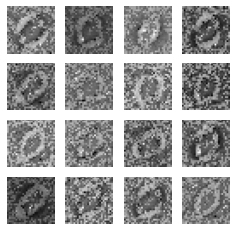

25
gen_loss: tf.Tensor(1.9185951, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20590793, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.19305569, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.31631744e-01 6.83681816e-02]
 [9.94490385e-01 5.50955301e-03]
 [9.96715188e-01 3.28484969e-03]
 [9.93107140e-01 6.89285528e-03]
 [9.75159883e-01 2.48400867e-02]
 [9.81278002e-01 1.87219903e-02]
 [9.84055758e-01 1.59442183e-02]
 [9.02628601e-01 9.73713696e-02]
 [9.93576348e-01 6.42361492e-03]
 [5.80422342e-01 4.19577628e-01]
 [9.90521193e-01 9.47885681e-03]
 [9.74099994e-01 2.59000268e-02]
 [9.89405334e-01 1.05946995e-02]
 [9.91347611e-01 8.65236204e-03]
 [9.78563011e-01 2.14369614e-02]
 [7.85033107e-01 2.14966893e-01]
 [8.64309192e-01 1.35690793e-01]
 [9.76714909e-01 2.32850462e-02]
 [9.98501301e-01 1.49871199e-03]
 [9.56509650e-01 4.34902720e-02]
 [9.98689830e-01 1.31016085e-03]
 [9.95283663e-01 4.71629854e-03]
 [9.61764038e-01 3.82359847e-02]
 [9.93127823e-01 6

gen_loss: tf.Tensor(1.8099735, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17244953, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20701557, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.91852558e-01 1.08147517e-01]
 [9.93537247e-01 6.46270858e-03]
 [9.95652795e-01 4.34717955e-03]
 [9.85295653e-01 1.47043597e-02]
 [9.62284803e-01 3.77151966e-02]
 [9.58076596e-01 4.19233888e-02]
 [9.73978937e-01 2.60209907e-02]
 [8.21557641e-01 1.78442389e-01]
 [9.89678621e-01 1.03214392e-02]
 [2.76724786e-01 7.23275185e-01]
 [9.78110909e-01 2.18890738e-02]
 [9.51926947e-01 4.80730459e-02]
 [9.85293329e-01 1.47066666e-02]
 [9.81567025e-01 1.84330214e-02]
 [9.66133893e-01 3.38661224e-02]
 [6.53484464e-01 3.46515566e-01]
 [7.63328552e-01 2.36671478e-01]
 [9.47145879e-01 5.28541096e-02]
 [9.97920096e-01 2.07986683e-03]
 [9.07403648e-01 9.25963670e-02]
 [9.98097003e-01 1.90305104e-03]
 [9.95067120e-01 4.93287574e-03]
 [9.19826329e-01 8.01737383e-02]
 [9.86087263e-01 1.39

gen_loss: tf.Tensor(1.8572388, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16796029, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2067541, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.94778073e-01 1.05221964e-01]
 [9.89897609e-01 1.01024015e-02]
 [9.97314632e-01 2.68532499e-03]
 [9.91960585e-01 8.03944841e-03]
 [9.72842395e-01 2.71576215e-02]
 [9.67173815e-01 3.28261778e-02]
 [9.83562410e-01 1.64376274e-02]
 [8.05528224e-01 1.94471791e-01]
 [9.94191110e-01 5.80888428e-03]
 [3.82611841e-01 6.17388129e-01]
 [9.81363773e-01 1.86362695e-02]
 [9.76601243e-01 2.33987737e-02]
 [9.86801505e-01 1.31984726e-02]
 [9.81561959e-01 1.84381008e-02]
 [9.80594456e-01 1.94055419e-02]
 [7.24623203e-01 2.75376737e-01]
 [8.29535902e-01 1.70464054e-01]
 [9.59180713e-01 4.08192836e-02]
 [9.98566329e-01 1.43367890e-03]
 [9.42691267e-01 5.73086925e-02]
 [9.98435676e-01 1.56432111e-03]
 [9.93272126e-01 6.72791386e-03]
 [9.53991771e-01 4.60082591e-02]
 [9.92422044e-01 7.578

gen_loss: tf.Tensor(1.8774247, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18164743, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.19838615, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.22674000e-01 7.73259997e-02]
 [9.92868602e-01 7.13141914e-03]
 [9.98259962e-01 1.74003758e-03]
 [9.93858159e-01 6.14180788e-03]
 [9.76740181e-01 2.32597701e-02]
 [9.78355169e-01 2.16447972e-02]
 [9.87305641e-01 1.26943672e-02]
 [8.53541374e-01 1.46458611e-01]
 [9.95671272e-01 4.32878034e-03]
 [5.54439843e-01 4.45560217e-01]
 [9.85692382e-01 1.43075725e-02]
 [9.83390689e-01 1.66092757e-02]
 [9.86844182e-01 1.31558515e-02]
 [9.88185048e-01 1.18149016e-02]
 [9.84814227e-01 1.51858404e-02]
 [7.85825431e-01 2.14174584e-01]
 [8.69343996e-01 1.30655944e-01]
 [9.71527636e-01 2.84723416e-02]
 [9.98919964e-01 1.08006771e-03]
 [9.60731745e-01 3.92682105e-02]
 [9.98529911e-01 1.47008116e-03]
 [9.95409310e-01 4.59068082e-03]
 [9.68749464e-01 3.12505066e-02]
 [9.94120896e-01 5.87

test_discriminator_output: tf.Tensor(
[[9.32022691e-01 6.79773316e-02]
 [9.94378507e-01 5.62149147e-03]
 [9.98157203e-01 1.84279890e-03]
 [9.92856026e-01 7.14394543e-03]
 [9.75266337e-01 2.47337017e-02]
 [9.77069080e-01 2.29308829e-02]
 [9.86395717e-01 1.36042852e-02]
 [8.78663719e-01 1.21336296e-01]
 [9.95241880e-01 4.75814799e-03]
 [5.31750143e-01 4.68249857e-01]
 [9.86172020e-01 1.38279293e-02]
 [9.78304982e-01 2.16950085e-02]
 [9.86919761e-01 1.30801927e-02]
 [9.88268614e-01 1.17313806e-02]
 [9.83252287e-01 1.67477578e-02]
 [7.82034874e-01 2.17965096e-01]
 [8.66419911e-01 1.33580178e-01]
 [9.71228600e-01 2.87714601e-02]
 [9.98923242e-01 1.07676687e-03]
 [9.57787752e-01 4.22121957e-02]
 [9.98176455e-01 1.82355451e-03]
 [9.96479809e-01 3.52024916e-03]
 [9.66400683e-01 3.35993692e-02]
 [9.93099809e-01 6.90017082e-03]
 [9.54850376e-01 4.51496206e-02]
 [9.86062467e-01 1.39374733e-02]
 [9.79870677e-01 2.01293919e-02]
 [9.16366637e-01 8.36333930e-02]
 [7.18675196e-01 2.81324893e-01]
 [9.7

test_discriminator_output: tf.Tensor(
[[9.36911166e-01 6.30887672e-02]
 [9.94569302e-01 5.43074915e-03]
 [9.97981787e-01 2.01824051e-03]
 [9.91492808e-01 8.50720797e-03]
 [9.74193871e-01 2.58061457e-02]
 [9.72360671e-01 2.76392959e-02]
 [9.85242188e-01 1.47578018e-02]
 [8.92968416e-01 1.07031524e-01]
 [9.94633436e-01 5.36651956e-03]
 [4.57227677e-01 5.42772293e-01]
 [9.86245513e-01 1.37544628e-02]
 [9.69130576e-01 3.08694728e-02]
 [9.88084137e-01 1.19158523e-02]
 [9.86641109e-01 1.33588742e-02]
 [9.81644094e-01 1.83559041e-02]
 [7.69095480e-01 2.30904549e-01]
 [8.61608386e-01 1.38391644e-01]
 [9.68426049e-01 3.15739699e-02]
 [9.98933971e-01 1.06598064e-03]
 [9.51868653e-01 4.81313989e-02]
 [9.97960806e-01 2.03920249e-03]
 [9.96660709e-01 3.33935348e-03]
 [9.62104023e-01 3.78960185e-02]
 [9.91834283e-01 8.16572085e-03]
 [9.50351894e-01 4.96481284e-02]
 [9.90078449e-01 9.92159732e-03]
 [9.78481829e-01 2.15181243e-02]
 [9.29309070e-01 7.06909895e-02]
 [7.03048408e-01 2.96951532e-01]
 [9.7

gen_loss: tf.Tensor(1.911662, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20305088, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.18979254, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.40101027e-01 5.98990098e-02]
 [9.89590704e-01 1.04093459e-02]
 [9.98288095e-01 1.71185157e-03]
 [9.93530571e-01 6.46942994e-03]
 [9.81656253e-01 1.83437318e-02]
 [9.72163558e-01 2.78363805e-02]
 [9.88614917e-01 1.13850748e-02]
 [9.04094160e-01 9.59058329e-02]
 [9.95643854e-01 4.35612537e-03]
 [4.76497799e-01 5.23502171e-01]
 [9.89861369e-01 1.01385713e-02]
 [9.69116867e-01 3.08830570e-02]
 [9.91985083e-01 8.01492017e-03]
 [9.84798968e-01 1.52010154e-02]
 [9.86406744e-01 1.35933030e-02]
 [8.11233580e-01 1.88766360e-01]
 [9.01968300e-01 9.80317369e-02]
 [9.72659767e-01 2.73402110e-02]
 [9.99143124e-01 8.56856990e-04]
 [9.62824881e-01 3.71751338e-02]
 [9.98656034e-01 1.34392490e-03]
 [9.94173229e-01 5.82682295e-03]
 [9.73796368e-01 2.62036491e-02]
 [9.93909359e-01 6.090

test_discriminator_output: tf.Tensor(
[[9.54896033e-01 4.51039746e-02]
 [9.90938783e-01 9.06122290e-03]
 [9.98522818e-01 1.47724804e-03]
 [9.94973779e-01 5.02624596e-03]
 [9.86114383e-01 1.38856480e-02]
 [9.79716063e-01 2.02839226e-02]
 [9.90926147e-01 9.07387491e-03]
 [9.28824008e-01 7.11760223e-02]
 [9.96377647e-01 3.62235657e-03]
 [5.90010583e-01 4.09989387e-01]
 [9.93457854e-01 6.54219603e-03]
 [9.72344756e-01 2.76552718e-02]
 [9.92410898e-01 7.58912694e-03]
 [9.88495708e-01 1.15042329e-02]
 [9.88719165e-01 1.12807900e-02]
 [8.58174384e-01 1.41825706e-01]
 [9.27202404e-01 7.27975965e-02]
 [9.80924010e-01 1.90759506e-02]
 [9.99290824e-01 7.09113898e-04]
 [9.74528074e-01 2.54719164e-02]
 [9.98779595e-01 1.22045982e-03]
 [9.94998217e-01 5.00175031e-03]
 [9.82618451e-01 1.73814762e-02]
 [9.95161235e-01 4.83882008e-03]
 [9.67351019e-01 3.26489843e-02]
 [9.95271623e-01 4.72836709e-03]
 [9.90470290e-01 9.52967536e-03]
 [9.51733410e-01 4.82665636e-02]
 [8.80617321e-01 1.19382724e-01]
 [9.8

gen_loss: tf.Tensor(1.9510766, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20564684, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.18262546, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.51659381e-01 4.83405888e-02]
 [9.94760215e-01 5.23979310e-03]
 [9.98453021e-01 1.54701609e-03]
 [9.93112981e-01 6.88701170e-03]
 [9.83437955e-01 1.65619962e-02]
 [9.78784621e-01 2.12154202e-02]
 [9.88030136e-01 1.19698299e-02]
 [9.27345514e-01 7.26545379e-02]
 [9.95301366e-01 4.69861506e-03]
 [5.66971540e-01 4.33028519e-01]
 [9.91830885e-01 8.16911180e-03]
 [9.62510467e-01 3.74895483e-02]
 [9.89613235e-01 1.03868051e-02]
 [9.88075733e-01 1.19241914e-02]
 [9.85202134e-01 1.47978310e-02]
 [8.55043769e-01 1.44956246e-01]
 [9.14659142e-01 8.53408203e-02]
 [9.79299963e-01 2.07000747e-02]
 [9.99032378e-01 9.67685541e-04]
 [9.70170677e-01 2.98292749e-02]
 [9.98317957e-01 1.68204959e-03]
 [9.97153997e-01 2.84594297e-03]
 [9.79266107e-01 2.07339190e-02]
 [9.93142247e-01 6.85

test_discriminator_output: tf.Tensor(
[[9.35912609e-01 6.40873760e-02]
 [9.95365739e-01 4.63426020e-03]
 [9.98530507e-01 1.46949047e-03]
 [9.92471695e-01 7.52828876e-03]
 [9.81826663e-01 1.81734189e-02]
 [9.72677708e-01 2.73222886e-02]
 [9.87291813e-01 1.27081256e-02]
 [9.05011714e-01 9.49882418e-02]
 [9.95344102e-01 4.65587014e-03]
 [4.84251738e-01 5.15748322e-01]
 [9.87948775e-01 1.20512126e-02]
 [9.65058744e-01 3.49412486e-02]
 [9.89391088e-01 1.06089041e-02]
 [9.85988855e-01 1.40111269e-02]
 [9.85566854e-01 1.44330915e-02]
 [8.33606422e-01 1.66393593e-01]
 [8.98484230e-01 1.01515792e-01]
 [9.73786414e-01 2.62136348e-02]
 [9.98956680e-01 1.04328408e-03]
 [9.63312924e-01 3.66870910e-02]
 [9.98077393e-01 1.92256144e-03]
 [9.97437596e-01 2.56232289e-03]
 [9.74593282e-01 2.54066605e-02]
 [9.92752552e-01 7.24749500e-03]
 [9.58694577e-01 4.13054749e-02]
 [9.92903769e-01 7.09629431e-03]
 [9.83739913e-01 1.62600465e-02]
 [9.28037941e-01 7.19620883e-02]
 [6.99407816e-01 3.00592154e-01]
 [9.7

gen_loss: tf.Tensor(1.915195, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21109651, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.19512594, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.06912625e-01 9.30874124e-02]
 [9.94374752e-01 5.62526193e-03]
 [9.99060810e-01 9.39244346e-04]
 [9.94862616e-01 5.13738254e-03]
 [9.85105991e-01 1.48940245e-02]
 [9.71341610e-01 2.86584441e-02]
 [9.90650415e-01 9.34953243e-03]
 [8.46298933e-01 1.53701097e-01]
 [9.96900558e-01 3.09946877e-03]
 [4.92411852e-01 5.07588089e-01]
 [9.82594788e-01 1.74052194e-02]
 [9.84931588e-01 1.50684677e-02]
 [9.89839077e-01 1.01609156e-02]
 [9.87579286e-01 1.24207437e-02]
 [9.90768731e-01 9.23130754e-03]
 [8.45562458e-01 1.54437527e-01]
 [9.08134460e-01 9.18654799e-02]
 [9.72790956e-01 2.72089969e-02]
 [9.99130785e-01 8.69240670e-04]
 [9.66803193e-01 3.31967734e-02]
 [9.98585224e-01 1.41480996e-03]
 [9.96850073e-01 3.14990571e-03]
 [9.75800574e-01 2.41994672e-02]
 [9.95430708e-01 4.569

test_discriminator_output: tf.Tensor(
[[9.18807745e-01 8.11922476e-02]
 [9.94693816e-01 5.30613586e-03]
 [9.99175370e-01 8.24641669e-04]
 [9.95620668e-01 4.37926687e-03]
 [9.86967862e-01 1.30320946e-02]
 [9.74850714e-01 2.51492932e-02]
 [9.92055058e-01 7.94496294e-03]
 [8.56566310e-01 1.43433735e-01]
 [9.97246981e-01 2.75301165e-03]
 [5.40228963e-01 4.59771067e-01]
 [9.85470533e-01 1.45295020e-02]
 [9.87997174e-01 1.20028146e-02]
 [9.89578664e-01 1.04213376e-02]
 [9.90186214e-01 9.81382001e-03]
 [9.91987348e-01 8.01266078e-03]
 [8.63627851e-01 1.36372164e-01]
 [9.21295583e-01 7.87044242e-02]
 [9.76218879e-01 2.37811022e-02]
 [9.99257863e-01 7.42153788e-04]
 [9.71658289e-01 2.83417292e-02]
 [9.98665690e-01 1.33426429e-03]
 [9.96993780e-01 3.00618005e-03]
 [9.78477836e-01 2.15221494e-02]
 [9.96150732e-01 3.84929217e-03]
 [9.69594061e-01 3.04059256e-02]
 [9.93102312e-01 6.89772749e-03]
 [9.86899674e-01 1.31002693e-02]
 [8.85080695e-01 1.14919312e-01]
 [6.60941958e-01 3.39057982e-01]
 [9.8

gen_loss: tf.Tensor(1.906806, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22775348, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.18791437, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.55912232e-01 4.40877266e-02]
 [9.96077597e-01 3.92238190e-03]
 [9.99244690e-01 7.55360292e-04]
 [9.96435642e-01 3.56434076e-03]
 [9.89515781e-01 1.04842819e-02]
 [9.81902242e-01 1.80977304e-02]
 [9.93834615e-01 6.16542669e-03]
 [9.18160558e-01 8.18393752e-02]
 [9.97429192e-01 2.57075182e-03]
 [6.67251468e-01 3.32748532e-01]
 [9.93599296e-01 6.40077004e-03]
 [9.88610029e-01 1.13899428e-02]
 [9.90115404e-01 9.88464244e-03]
 [9.94484246e-01 5.51573373e-03]
 [9.92653847e-01 7.34620588e-03]
 [8.89201641e-01 1.10798389e-01]
 [9.45410132e-01 5.45898750e-02]
 [9.85367060e-01 1.46329170e-02]
 [9.99465406e-01 5.34562394e-04]
 [9.80698287e-01 1.93017405e-02]
 [9.98789847e-01 1.21015089e-03]
 [9.97558594e-01 2.44135247e-03]
 [9.83893156e-01 1.61068570e-02]
 [9.96844649e-01 3.155

test_discriminator_output: tf.Tensor(
[[9.46830451e-01 5.31695373e-02]
 [9.95455146e-01 4.54480387e-03]
 [9.99000251e-01 9.99703072e-04]
 [9.95337486e-01 4.66252165e-03]
 [9.85810757e-01 1.41892238e-02]
 [9.75208819e-01 2.47911084e-02]
 [9.91714299e-01 8.28569196e-03]
 [9.07694280e-01 9.23057348e-02]
 [9.96453285e-01 3.54675623e-03]
 [5.86442292e-01 4.13557649e-01]
 [9.92466629e-01 7.53331371e-03]
 [9.84637678e-01 1.53623261e-02]
 [9.89228725e-01 1.07712736e-02]
 [9.92039561e-01 7.96040520e-03]
 [9.90291774e-01 9.70818754e-03]
 [8.54791462e-01 1.45208523e-01]
 [9.32494104e-01 6.75059035e-02]
 [9.81480539e-01 1.85195394e-02]
 [9.99289632e-01 7.10374094e-04]
 [9.74256754e-01 2.57432237e-02]
 [9.98424411e-01 1.57563819e-03]
 [9.97274101e-01 2.72586499e-03]
 [9.77493286e-01 2.25066971e-02]
 [9.95846927e-01 4.15310077e-03]
 [9.73510444e-01 2.64896080e-02]
 [9.92962778e-01 7.03729317e-03]
 [9.86577630e-01 1.34224193e-02]
 [9.22121763e-01 7.78782219e-02]
 [7.37975419e-01 2.62024581e-01]
 [9.8

gen_loss: tf.Tensor(1.9140452, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21513864, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.18894558, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.84352863e-01 1.15647115e-01]
 [9.94926691e-01 5.07330988e-03]
 [9.97359097e-01 2.64087506e-03]
 [9.86961365e-01 1.30386539e-02]
 [9.61059988e-01 3.89400423e-02]
 [9.38418031e-01 6.15819804e-02]
 [9.76193666e-01 2.38062833e-02]
 [8.41720402e-01 1.58279628e-01]
 [9.89806354e-01 1.01935798e-02]
 [2.73156613e-01 7.26843417e-01]
 [9.80053484e-01 1.99464671e-02]
 [9.58807647e-01 4.11924236e-02]
 [9.83817816e-01 1.61822401e-02]
 [9.73889649e-01 2.61104144e-02]
 [9.74765778e-01 2.52342969e-02]
 [6.91335320e-01 3.08664709e-01]
 [8.44040096e-01 1.55959949e-01]
 [9.52448368e-01 4.75516655e-02]
 [9.97962713e-01 2.03731284e-03]
 [9.20777798e-01 7.92222172e-02]
 [9.95307624e-01 4.69242036e-03]
 [9.97277558e-01 2.72247661e-03]
 [9.23901916e-01 7.60980695e-02]
 [9.87698257e-01 1.23

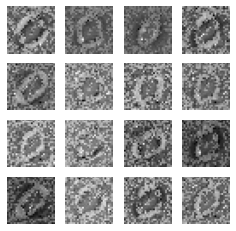

26
gen_loss: tf.Tensor(1.8133172, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19195446, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.21079853, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.65937829e-01 1.34062201e-01]
 [9.94423926e-01 5.57605037e-03]
 [9.97599065e-01 2.40092329e-03]
 [9.88697529e-01 1.13025159e-02]
 [9.61216569e-01 3.87834236e-02]
 [9.40077126e-01 5.99229112e-02]
 [9.76863682e-01 2.31362637e-02]
 [8.40048134e-01 1.59951910e-01]
 [9.90602851e-01 9.39715188e-03]
 [2.93354720e-01 7.06645250e-01]
 [9.78813827e-01 2.11861152e-02]
 [9.64782715e-01 3.52172926e-02]
 [9.87184584e-01 1.28154224e-02]
 [9.72093284e-01 2.79067047e-02]
 [9.77644801e-01 2.23552082e-02]
 [6.93128884e-01 3.06871116e-01]
 [8.51599097e-01 1.48400918e-01]
 [9.54522133e-01 4.54777889e-02]
 [9.98036444e-01 1.96353230e-03]
 [9.23677921e-01 7.63220936e-02]
 [9.95371401e-01 4.62861964e-03]
 [9.96828020e-01 3.17198620e-03]
 [9.29433644e-01 7.05663860e-02]
 [9.89385068e-01 1

gen_loss: tf.Tensor(1.7972071, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17533417, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20986725, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.17300045e-01 8.26999098e-02]
 [9.94971395e-01 5.02859522e-03]
 [9.98985708e-01 1.01424428e-03]
 [9.96200740e-01 3.79922055e-03]
 [9.82325375e-01 1.76745560e-02]
 [9.76599991e-01 2.34000403e-02]
 [9.90607262e-01 9.39269178e-03]
 [9.11766887e-01 8.82331356e-02]
 [9.96349096e-01 3.65087320e-03]
 [6.36116266e-01 3.63883734e-01]
 [9.91773307e-01 8.22664518e-03]
 [9.87609029e-01 1.23909004e-02]
 [9.93811607e-01 6.18831301e-03]
 [9.88131762e-01 1.18682832e-02]
 [9.91518438e-01 8.48152861e-03]
 [8.36392164e-01 1.63607776e-01]
 [9.33739185e-01 6.62608817e-02]
 [9.83783782e-01 1.62162166e-02]
 [9.99197185e-01 8.02803144e-04]
 [9.74786699e-01 2.52133105e-02]
 [9.97408450e-01 2.59151030e-03]
 [9.96580303e-01 3.41974525e-03]
 [9.78185058e-01 2.18149684e-02]
 [9.96503830e-01 3.49

gen_loss: tf.Tensor(1.8289475, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20348895, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20779987, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.42752600e-01 5.72474301e-02]
 [9.96564686e-01 3.43536679e-03]
 [9.98520195e-01 1.47976307e-03]
 [9.95196283e-01 4.80365986e-03]
 [9.81996953e-01 1.80030279e-02]
 [9.75956678e-01 2.40433011e-02]
 [9.90078211e-01 9.92181711e-03]
 [9.29209828e-01 7.07901269e-02]
 [9.95701373e-01 4.29866137e-03]
 [5.62250733e-01 4.37749237e-01]
 [9.93731678e-01 6.26833132e-03]
 [9.79273081e-01 2.07269415e-02]
 [9.91743267e-01 8.25670362e-03]
 [9.85360086e-01 1.46399392e-02]
 [9.90289867e-01 9.71010886e-03]
 [8.27750623e-01 1.72249377e-01]
 [9.26156640e-01 7.38433450e-02]
 [9.84738827e-01 1.52611788e-02]
 [9.99124229e-01 8.75786005e-04]
 [9.75857079e-01 2.41429172e-02]
 [9.94929731e-01 5.07018901e-03]
 [9.97892559e-01 2.10748054e-03]
 [9.77295578e-01 2.27043573e-02]
 [9.95420277e-01 4.57

gen_loss: tf.Tensor(1.8195137, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1953353, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20885871, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.38962758e-01 6.10372163e-02]
 [9.94071186e-01 5.92878647e-03]
 [9.98069823e-01 1.93018920e-03]
 [9.95492935e-01 4.50705085e-03]
 [9.85589564e-01 1.44104064e-02]
 [9.71524596e-01 2.84754224e-02]
 [9.90970492e-01 9.02954303e-03]
 [8.96657348e-01 1.03342630e-01]
 [9.95854259e-01 4.14578943e-03]
 [4.62287903e-01 5.37712038e-01]
 [9.93432403e-01 6.56759599e-03]
 [9.78220761e-01 2.17792820e-02]
 [9.89797056e-01 1.02030188e-02]
 [9.82929349e-01 1.70706790e-02]
 [9.91106570e-01 8.89341813e-03]
 [8.35715234e-01 1.64284721e-01]
 [9.24389243e-01 7.56106898e-02]
 [9.83545005e-01 1.64549649e-02]
 [9.99055684e-01 9.44315398e-04]
 [9.77014005e-01 2.29860209e-02]
 [9.94584620e-01 5.41536836e-03]
 [9.97005641e-01 2.99431290e-03]
 [9.77369606e-01 2.26303712e-02]
 [9.95731294e-01 4.268

gen_loss: tf.Tensor(1.8419623, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1945008, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20172822, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.41831708e-01 5.81682324e-02]
 [9.93378639e-01 6.62127649e-03]
 [9.98424768e-01 1.57523155e-03]
 [9.96465445e-01 3.53458780e-03]
 [9.88673508e-01 1.13264928e-02]
 [9.75012422e-01 2.49875672e-02]
 [9.92498577e-01 7.50139449e-03]
 [8.84901881e-01 1.15098163e-01]
 [9.96544540e-01 3.45551665e-03]
 [5.30320466e-01 4.69679564e-01]
 [9.93492901e-01 6.50709262e-03]
 [9.85161841e-01 1.48381582e-02]
 [9.89242017e-01 1.07579436e-02]
 [9.89579618e-01 1.04204332e-02]
 [9.92664397e-01 7.33557623e-03]
 [8.67398918e-01 1.32601082e-01]
 [9.35108721e-01 6.48912042e-02]
 [9.86664057e-01 1.33359162e-02]
 [9.99135077e-01 8.64964211e-04]
 [9.80480075e-01 1.95199288e-02]
 [9.96477902e-01 3.52207921e-03]
 [9.96496856e-01 3.50312213e-03]
 [9.80941236e-01 1.90587509e-02]
 [9.96640444e-01 3.359

gen_loss: tf.Tensor(1.902859, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.24362877, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.18885659, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.26486015e-01 7.35140294e-02]
 [9.94640946e-01 5.35901636e-03]
 [9.98692214e-01 1.30779447e-03]
 [9.96116161e-01 3.88385309e-03]
 [9.84818816e-01 1.51812043e-02]
 [9.66654480e-01 3.33455764e-02]
 [9.90713954e-01 9.28605255e-03]
 [8.73854101e-01 1.26145855e-01]
 [9.96302605e-01 3.69743491e-03]
 [5.08781612e-01 4.91218358e-01]
 [9.89333034e-01 1.06669534e-02]
 [9.87044394e-01 1.29555967e-02]
 [9.89068329e-01 1.09316707e-02]
 [9.88947272e-01 1.10526914e-02]
 [9.92301464e-01 7.69854616e-03]
 [8.41656446e-01 1.58343509e-01]
 [9.21945214e-01 7.80547932e-02]
 [9.83216643e-01 1.67833567e-02]
 [9.99004781e-01 9.95183014e-04]
 [9.73191738e-01 2.68083196e-02]
 [9.96669352e-01 3.33069009e-03]
 [9.96643543e-01 3.35652917e-03]
 [9.76293087e-01 2.37069130e-02]
 [9.96233046e-01 3.766

gen_loss: tf.Tensor(1.8768419, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22828692, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.20032, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.48571205e-01 5.14287911e-02]
 [9.96357739e-01 3.64224380e-03]
 [9.98143196e-01 1.85683370e-03]
 [9.95354295e-01 4.64569218e-03]
 [9.81033325e-01 1.89667046e-02]
 [9.61068988e-01 3.89309973e-02]
 [9.89205122e-01 1.07948529e-02]
 [9.13703620e-01 8.62963423e-02]
 [9.95639205e-01 4.36076056e-03]
 [4.95109737e-01 5.04890323e-01]
 [9.91322637e-01 8.67740158e-03]
 [9.80785906e-01 1.92140471e-02]
 [9.85136330e-01 1.48636699e-02]
 [9.83881831e-01 1.61181502e-02]
 [9.90939260e-01 9.06076003e-03]
 [8.29922795e-01 1.70077249e-01]
 [9.20562565e-01 7.94374719e-02]
 [9.84983504e-01 1.50165111e-02]
 [9.98866439e-01 1.13363925e-03]
 [9.73436356e-01 2.65636593e-02]
 [9.94428992e-01 5.57097839e-03]
 [9.97599304e-01 2.40064226e-03]
 [9.77583289e-01 2.24166606e-02]
 [9.95319784e-01 4.68020

gen_loss: tf.Tensor(1.8990297, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14776444, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.19829628, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.63058889e-01 3.69411148e-02]
 [9.94219542e-01 5.78044634e-03]
 [9.98306036e-01 1.69394026e-03]
 [9.97653067e-01 2.34690751e-03]
 [9.87622559e-01 1.23775182e-02]
 [9.72942710e-01 2.70572491e-02]
 [9.93464172e-01 6.53581787e-03]
 [9.30896461e-01 6.91034719e-02]
 [9.97194648e-01 2.80534290e-03]
 [6.77812636e-01 3.22187304e-01]
 [9.95884240e-01 4.11574589e-03]
 [9.88565505e-01 1.14345355e-02]
 [9.85806584e-01 1.41933933e-02]
 [9.85920966e-01 1.40790008e-02]
 [9.94297802e-01 5.70221338e-03]
 [8.93686414e-01 1.06313616e-01]
 [9.56120551e-01 4.38794047e-02]
 [9.91749525e-01 8.25049821e-03]
 [9.99194682e-01 8.05340882e-04]
 [9.87214565e-01 1.27854133e-02]
 [9.95757878e-01 4.24216548e-03]
 [9.96344864e-01 3.65508185e-03]
 [9.89894331e-01 1.01056630e-02]
 [9.97604966e-01 2.39

gen_loss: tf.Tensor(1.9299637, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18562551, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1933772, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.42033231e-01 5.79667315e-02]
 [9.93625045e-01 6.37488952e-03]
 [9.97276485e-01 2.72352784e-03]
 [9.95181978e-01 4.81796451e-03]
 [9.78716671e-01 2.12833099e-02]
 [9.49959815e-01 5.00401743e-02]
 [9.88699019e-01 1.13010183e-02]
 [8.94086778e-01 1.05913222e-01]
 [9.94702280e-01 5.29766129e-03]
 [4.64545846e-01 5.35454154e-01]
 [9.92302299e-01 7.69770145e-03]
 [9.74779487e-01 2.52205785e-02]
 [9.84982669e-01 1.50172934e-02]
 [9.77638423e-01 2.23615225e-02]
 [9.89969671e-01 1.00303283e-02]
 [8.30256581e-01 1.69743359e-01]
 [9.22433138e-01 7.75668025e-02]
 [9.84922528e-01 1.50774568e-02]
 [9.98719215e-01 1.28079497e-03]
 [9.74870324e-01 2.51296721e-02]
 [9.94594872e-01 5.40514104e-03]
 [9.95752215e-01 4.24776226e-03]
 [9.79618788e-01 2.03812364e-02]
 [9.94944274e-01 5.055

gen_loss: tf.Tensor(1.9230777, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19399711, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.19110212, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.03436959e-01 9.65631083e-02]
 [9.95467663e-01 4.53238050e-03]
 [9.95609105e-01 4.39089816e-03]
 [9.88356531e-01 1.16434861e-02]
 [9.58654225e-01 4.13457453e-02]
 [9.20979083e-01 7.90209621e-02]
 [9.77264643e-01 2.27353275e-02]
 [8.40067625e-01 1.59932375e-01]
 [9.88924682e-01 1.10753616e-02]
 [3.14810634e-01 6.85189426e-01]
 [9.83717561e-01 1.62824076e-02]
 [9.50694859e-01 4.93051261e-02]
 [9.82796550e-01 1.72034800e-02]
 [9.69576240e-01 3.04237716e-02]
 [9.78918970e-01 2.10810117e-02]
 [7.26281643e-01 2.73718357e-01]
 [8.48343432e-01 1.51656583e-01]
 [9.72086608e-01 2.79133394e-02]
 [9.97482359e-01 2.51767319e-03]
 [9.46607471e-01 5.33925705e-02]
 [9.90620613e-01 9.37944558e-03]
 [9.96994615e-01 3.00539425e-03]
 [9.52600539e-01 4.73994240e-02]
 [9.87455845e-01 1.25

gen_loss: tf.Tensor(1.9949908, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19741386, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17305858, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.17968452e-01 8.20315108e-02]
 [9.91445541e-01 8.55448004e-03]
 [9.97101009e-01 2.89898552e-03]
 [9.94747460e-01 5.25256433e-03]
 [9.74849224e-01 2.51507182e-02]
 [9.55621302e-01 4.43787239e-02]
 [9.87653792e-01 1.23461904e-02]
 [8.57619345e-01 1.42380610e-01]
 [9.93867218e-01 6.13274751e-03]
 [5.81921339e-01 4.18078631e-01]
 [9.92119431e-01 7.88057502e-03]
 [9.78977084e-01 2.10229550e-02]
 [9.88843083e-01 1.11569688e-02]
 [9.79136825e-01 2.08631754e-02]
 [9.88244295e-01 1.17556462e-02]
 [8.32768083e-01 1.67231843e-01]
 [9.20261443e-01 7.97385648e-02]
 [9.85152245e-01 1.48477452e-02]
 [9.98264134e-01 1.73585978e-03]
 [9.75765347e-01 2.42346283e-02]
 [9.93821859e-01 6.17817603e-03]
 [9.94683921e-01 5.31607121e-03]
 [9.80242789e-01 1.97571758e-02]
 [9.94457126e-01 5.54

gen_loss: tf.Tensor(1.9776304, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19270366, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17969973, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.27521646e-01 7.24783838e-02]
 [9.88885880e-01 1.11141177e-02]
 [9.95682359e-01 4.31765523e-03]
 [9.92186189e-01 7.81382620e-03]
 [9.66612101e-01 3.33879255e-02]
 [9.35955405e-01 6.40446246e-02]
 [9.82927501e-01 1.70725510e-02]
 [8.65189910e-01 1.34810090e-01]
 [9.91002023e-01 8.99804011e-03]
 [4.50292557e-01 5.49707413e-01]
 [9.92552161e-01 7.44785462e-03]
 [9.55146313e-01 4.48537059e-02]
 [9.89557445e-01 1.04426173e-02]
 [9.66466129e-01 3.35338227e-02]
 [9.83242512e-01 1.67575460e-02]
 [7.90290654e-01 2.09709406e-01]
 [8.97501647e-01 1.02498345e-01]
 [9.81598914e-01 1.84010658e-02]
 [9.97846603e-01 2.15334632e-03]
 [9.68326449e-01 3.16735581e-02]
 [9.90957141e-01 9.04282089e-03]
 [9.93430436e-01 6.56953454e-03]
 [9.74112093e-01 2.58879829e-02]
 [9.91545975e-01 8.45

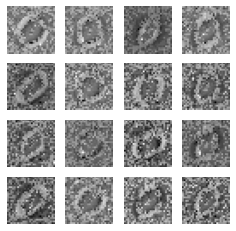

27
gen_loss: tf.Tensor(1.9460329, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18047756, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1788288, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.16181982e-01 8.38179812e-02]
 [9.89559650e-01 1.04403459e-02]
 [9.91416395e-01 8.58360250e-03]
 [9.81652558e-01 1.83474049e-02]
 [9.40005720e-01 5.99943213e-02]
 [8.88728321e-01 1.11271665e-01]
 [9.65620041e-01 3.43799330e-02]
 [8.38206649e-01 1.61793336e-01]
 [9.80612218e-01 1.93877742e-02]
 [2.44155422e-01 7.55844593e-01]
 [9.88051176e-01 1.19487736e-02]
 [8.82055342e-01 1.17944665e-01]
 [9.84562337e-01 1.54376719e-02]
 [9.41222608e-01 5.87774143e-02]
 [9.64205384e-01 3.57946567e-02]
 [6.77703798e-01 3.22296262e-01]
 [8.21626365e-01 1.78373605e-01]
 [9.66511130e-01 3.34888510e-02]
 [9.95959461e-01 4.04049829e-03]
 [9.33875740e-01 6.61242977e-02]
 [9.83357191e-01 1.66428629e-02]
 [9.94052231e-01 5.94771607e-03]
 [9.40893888e-01 5.91061488e-02]
 [9.79406953e-01 2.

gen_loss: tf.Tensor(1.969145, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2175234, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17806944, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.15151060e-01 8.48489106e-02]
 [9.81643856e-01 1.83561947e-02]
 [9.93713319e-01 6.28664205e-03]
 [9.87619638e-01 1.23803969e-02]
 [9.54672635e-01 4.53274027e-02]
 [9.17461693e-01 8.25382844e-02]
 [9.74565864e-01 2.54340786e-02]
 [7.88517594e-01 2.11482450e-01]
 [9.85203981e-01 1.47960456e-02]
 [3.73375654e-01 6.26624405e-01]
 [9.89257395e-01 1.07425833e-02]
 [9.32189047e-01 6.78109005e-02]
 [9.83241558e-01 1.67584252e-02]
 [9.60379004e-01 3.96209992e-02]
 [9.71834004e-01 2.81659700e-02]
 [7.50981629e-01 2.49018401e-01]
 [8.59949231e-01 1.40050754e-01]
 [9.74286437e-01 2.57135946e-02]
 [9.96266186e-01 3.73388221e-03]
 [9.52609420e-01 4.73906137e-02]
 [9.89510298e-01 1.04897702e-02]
 [9.88892257e-01 1.11077419e-02]
 [9.56865370e-01 4.31346148e-02]
 [9.86700296e-01 1.3299

gen_loss: tf.Tensor(1.9937676, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16592649, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.18168, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.45863366e-01 5.41365519e-02]
 [9.82376337e-01 1.76235978e-02]
 [9.96732950e-01 3.26711731e-03]
 [9.94350016e-01 5.65003091e-03]
 [9.76745725e-01 2.32542139e-02]
 [9.54825401e-01 4.51745801e-02]
 [9.87261295e-01 1.27386795e-02]
 [8.26385498e-01 1.73614502e-01]
 [9.92781878e-01 7.21808989e-03]
 [6.35522842e-01 3.64477098e-01]
 [9.94274199e-01 5.72577119e-03]
 [9.70030129e-01 2.99698822e-02]
 [9.85701442e-01 1.42985787e-02]
 [9.81887102e-01 1.81128774e-02]
 [9.85697508e-01 1.43024623e-02]
 [8.59262884e-01 1.40737116e-01]
 [9.19602633e-01 8.03973675e-02]
 [9.87120569e-01 1.28794461e-02]
 [9.98023868e-01 1.97615684e-03]
 [9.79093194e-01 2.09068004e-02]
 [9.93023515e-01 6.97649922e-03]
 [9.87570465e-01 1.24295736e-02]
 [9.81564105e-01 1.84358936e-02]
 [9.94046450e-01 5.95349

disc_fake_loss: tf.Tensor(0.17832553, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.32602644e-01 6.73973709e-02]
 [9.83189464e-01 1.68105401e-02]
 [9.94838655e-01 5.16136363e-03]
 [9.90310490e-01 9.68948286e-03]
 [9.66511428e-01 3.34886089e-02]
 [9.19508517e-01 8.04914981e-02]
 [9.80219185e-01 1.97808277e-02]
 [7.83844531e-01 2.16155410e-01]
 [9.88975644e-01 1.10243112e-02]
 [4.19238329e-01 5.80761671e-01]
 [9.90325987e-01 9.67396144e-03]
 [9.41890240e-01 5.81098273e-02]
 [9.83335018e-01 1.66650079e-02]
 [9.63031828e-01 3.69681455e-02]
 [9.79055226e-01 2.09447891e-02]
 [7.80677557e-01 2.19322458e-01]
 [8.58584106e-01 1.41415849e-01]
 [9.77351844e-01 2.26481110e-02]
 [9.97177243e-01 2.82280054e-03]
 [9.63838041e-01 3.61619927e-02]
 [9.87458348e-01 1.25416731e-02]
 [9.88792717e-01 1.12072881e-02]
 [9.66852546e-01 3.31474952e-02]
 [9.89667296e-01 1.03327502e-02]
 [9.68949854e-01 3.10501494e-02]
 [9.60668385e-01 3.93316932e-02]
 [9.61174607e-01 3.88254076e-02]
 [9.1215

gen_loss: tf.Tensor(2.0419014, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20702541, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1694529, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.12277341e-01 8.77226442e-02]
 [9.84440446e-01 1.55596156e-02]
 [9.90409613e-01 9.59041994e-03]
 [9.78688240e-01 2.13117860e-02]
 [9.41670179e-01 5.83298653e-02]
 [8.40044320e-01 1.59955636e-01]
 [9.62375104e-01 3.76249440e-02]
 [7.41474867e-01 2.58525103e-01]
 [9.78768170e-01 2.12318581e-02]
 [1.94136560e-01 8.05863440e-01]
 [9.82686043e-01 1.73139125e-02]
 [8.55221331e-01 1.44778594e-01]
 [9.80704844e-01 1.92951709e-02]
 [9.14973199e-01 8.50267857e-02]
 [9.62061524e-01 3.79385054e-02]
 [6.37546897e-01 3.62453103e-01]
 [7.44419277e-01 2.55580693e-01]
 [9.54067409e-01 4.59325500e-02]
 [9.95221317e-01 4.77870926e-03]
 [9.23934281e-01 7.60657638e-02]
 [9.75532174e-01 2.44678613e-02]
 [9.89980638e-01 1.00193387e-02]
 [9.26941693e-01 7.30582997e-02]
 [9.76904988e-01 2.309

gen_loss: tf.Tensor(1.9706714, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1999374, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.2125367, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.04125631e-01 9.58743915e-02]
 [9.80498374e-01 1.95016004e-02]
 [9.90325451e-01 9.67457891e-03]
 [9.81753528e-01 1.82464756e-02]
 [9.43139911e-01 5.68600670e-02]
 [8.50330770e-01 1.49669245e-01]
 [9.63928938e-01 3.60711105e-02]
 [7.37102985e-01 2.62897015e-01]
 [9.79321778e-01 2.06781756e-02]
 [2.46396929e-01 7.53603101e-01]
 [9.83367562e-01 1.66324563e-02]
 [8.83666754e-01 1.16333172e-01]
 [9.81633246e-01 1.83666702e-02]
 [9.10282195e-01 8.97177756e-02]
 [9.64100122e-01 3.58998701e-02]
 [6.51003182e-01 3.48996878e-01]
 [7.62255132e-01 2.37744853e-01]
 [9.57093000e-01 4.29069921e-02]
 [9.94762957e-01 5.23702288e-03]
 [9.29612577e-01 7.03874230e-02]
 [9.76232409e-01 2.37676352e-02]
 [9.87739146e-01 1.22608468e-02]
 [9.31625545e-01 6.83744475e-02]
 [9.80473995e-01 1.9526

gen_loss: tf.Tensor(2.002857, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19433269, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17159323, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.19384062e-01 8.06159675e-02]
 [9.76028621e-01 2.39713192e-02]
 [9.91233289e-01 8.76671914e-03]
 [9.89027500e-01 1.09725222e-02]
 [9.56265867e-01 4.37341593e-02]
 [9.20310974e-01 7.96889961e-02]
 [9.73098457e-01 2.69014779e-02]
 [8.14546347e-01 1.85453683e-01]
 [9.81486022e-01 1.85140111e-02]
 [5.48313856e-01 4.51686114e-01]
 [9.91409719e-01 8.59030895e-03]
 [9.41428781e-01 5.85711971e-02]
 [9.82027531e-01 1.79724880e-02]
 [9.50200856e-01 4.97991405e-02]
 [9.69552398e-01 3.04475706e-02]
 [7.68126190e-01 2.31873780e-01]
 [8.63180041e-01 1.36820003e-01]
 [9.76067245e-01 2.39327215e-02]
 [9.95196164e-01 4.80382890e-03]
 [9.57008600e-01 4.29914407e-02]
 [9.81312096e-01 1.86878741e-02]
 [9.84878242e-01 1.51217850e-02]
 [9.58321631e-01 4.16783169e-02]
 [9.88637507e-01 1.136

test_discriminator_output: tf.Tensor(
[[9.29155588e-01 7.08444491e-02]
 [9.77225244e-01 2.27747820e-02]
 [9.90875125e-01 9.12488718e-03]
 [9.88984585e-01 1.10154459e-02]
 [9.57149982e-01 4.28500548e-02]
 [9.30778742e-01 6.92212731e-02]
 [9.73263621e-01 2.67364010e-02]
 [8.53264391e-01 1.46735549e-01]
 [9.79416668e-01 2.05832627e-02]
 [6.06671035e-01 3.93328935e-01]
 [9.93265271e-01 6.73467200e-03]
 [9.40683365e-01 5.93166426e-02]
 [9.83167708e-01 1.68322995e-02]
 [9.59127069e-01 4.08729240e-02]
 [9.67468500e-01 3.25314477e-02]
 [7.90605128e-01 2.09394887e-01]
 [8.82884622e-01 1.17115371e-01]
 [9.78949010e-01 2.10509561e-02]
 [9.95427966e-01 4.57206974e-03]
 [9.59180176e-01 4.08197939e-02]
 [9.81632471e-01 1.83675308e-02]
 [9.85005558e-01 1.49943652e-02]
 [9.60802078e-01 3.91979925e-02]
 [9.88739252e-01 1.12607526e-02]
 [9.63371992e-01 3.66280042e-02]
 [9.54284012e-01 4.57159281e-02]
 [9.61699247e-01 3.83008420e-02]
 [9.52114224e-01 4.78857867e-02]
 [3.44481468e-01 6.55518532e-01]
 [9.4

gen_loss: tf.Tensor(2.0212774, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17410505, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.18079858, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.13475096e-01 8.65249410e-02]
 [9.66851413e-01 3.31485495e-02]
 [9.89866376e-01 1.01335580e-02]
 [9.86881852e-01 1.31181534e-02]
 [9.48927760e-01 5.10722473e-02]
 [9.06802595e-01 9.31974277e-02]
 [9.68344569e-01 3.16554420e-02]
 [8.39639306e-01 1.60360739e-01]
 [9.74393904e-01 2.56060157e-02]
 [5.05387187e-01 4.94612724e-01]
 [9.91724551e-01 8.27552285e-03]
 [9.22509432e-01 7.74905160e-02]
 [9.88292873e-01 1.17070964e-02]
 [9.44588482e-01 5.54114692e-02]
 [9.62553859e-01 3.74460854e-02]
 [7.58966923e-01 2.41033047e-01]
 [8.71822417e-01 1.28177583e-01]
 [9.71497178e-01 2.85028145e-02]
 [9.95459497e-01 4.54048486e-03]
 [9.48072791e-01 5.19272052e-02]
 [9.81909752e-01 1.80903021e-02]
 [9.76956427e-01 2.30435990e-02]
 [9.52779949e-01 4.72200476e-02]
 [9.86822248e-01 1.31

gen_loss: tf.Tensor(2.0025513, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16711545, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17449054, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.21625257e-01 7.83747733e-02]
 [9.75529134e-01 2.44709235e-02]
 [9.85901833e-01 1.40981888e-02]
 [9.76633608e-01 2.33663190e-02]
 [9.27205205e-01 7.27947652e-02]
 [8.79177511e-01 1.20822504e-01]
 [9.48598146e-01 5.14018238e-02]
 [8.36230755e-01 1.63769260e-01]
 [9.59023893e-01 4.09760475e-02]
 [3.90747011e-01 6.09252989e-01]
 [9.89875257e-01 1.01246992e-02]
 [8.55862319e-01 1.44137710e-01]
 [9.84294891e-01 1.57050639e-02]
 [9.24480975e-01 7.55190849e-02]
 [9.37401056e-01 6.25989065e-02]
 [7.01811373e-01 2.98188657e-01]
 [8.23912740e-01 1.76087245e-01]
 [9.61034536e-01 3.89654264e-02]
 [9.93763626e-01 6.23633992e-03]
 [9.29101646e-01 7.08983243e-02]
 [9.72645700e-01 2.73543298e-02]
 [9.83838797e-01 1.61612257e-02]
 [9.23514068e-01 7.64858872e-02]
 [9.75928485e-01 2.40

gen_loss: tf.Tensor(2.081584, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18600893, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1581036, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.50123250e-01 4.98767495e-02]
 [9.74988639e-01 2.50114128e-02]
 [9.92130578e-01 7.86938332e-03]
 [9.87098634e-01 1.29014160e-02]
 [9.56933260e-01 4.30667624e-02]
 [9.28768873e-01 7.12310970e-02]
 [9.69010770e-01 3.09892688e-02]
 [8.81576180e-01 1.18423857e-01]
 [9.76670444e-01 2.33294796e-02]
 [5.68048716e-01 4.31951314e-01]
 [9.94861305e-01 5.13869431e-03]
 [9.15284872e-01 8.47151056e-02]
 [9.89450514e-01 1.05494745e-02]
 [9.53632891e-01 4.63670716e-02]
 [9.61471617e-01 3.85284014e-02]
 [8.13520193e-01 1.86479762e-01]
 [8.99593413e-01 1.00406550e-01]
 [9.76648152e-01 2.33518183e-02]
 [9.96611178e-01 3.38879437e-03]
 [9.66058075e-01 3.39419246e-02]
 [9.83032882e-01 1.69670712e-02]
 [9.83188212e-01 1.68118440e-02]
 [9.60864544e-01 3.91353965e-02]
 [9.86760139e-01 1.3239

test_discriminator_output: tf.Tensor(
[[9.46362793e-01 5.36371693e-02]
 [9.71926689e-01 2.80733444e-02]
 [9.91704702e-01 8.29534791e-03]
 [9.86868262e-01 1.31317601e-02]
 [9.58658695e-01 4.13412265e-02]
 [9.27940190e-01 7.20598325e-02]
 [9.68049109e-01 3.19508761e-02]
 [8.71798038e-01 1.28201991e-01]
 [9.76312041e-01 2.36878991e-02]
 [5.56275904e-01 4.43724126e-01]
 [9.94678736e-01 5.32125309e-03]
 [9.19657886e-01 8.03420916e-02]
 [9.89515066e-01 1.04849301e-02]
 [9.53658462e-01 4.63415012e-02]
 [9.59483862e-01 4.05160971e-02]
 [8.15538585e-01 1.84461415e-01]
 [9.01930630e-01 9.80693251e-02]
 [9.72869456e-01 2.71304753e-02]
 [9.96605396e-01 3.39460652e-03]
 [9.64574039e-01 3.54260281e-02]
 [9.81807888e-01 1.81920938e-02]
 [9.82624233e-01 1.73757356e-02]
 [9.58835363e-01 4.11646515e-02]
 [9.86878216e-01 1.31217269e-02]
 [9.68825996e-01 3.11740302e-02]
 [9.55279589e-01 4.47204374e-02]
 [9.67347145e-01 3.26528624e-02]
 [9.73859191e-01 2.61407793e-02]
 [2.65718371e-01 7.34281600e-01]
 [9.5

gen_loss: tf.Tensor(2.0557547, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21273053, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1684881, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.21513677e-01 7.84863606e-02]
 [9.65879798e-01 3.41202542e-02]
 [9.88609314e-01 1.13906469e-02]
 [9.79765475e-01 2.02344880e-02]
 [9.45740342e-01 5.42596877e-02]
 [9.04101312e-01 9.58987251e-02]
 [9.50242519e-01 4.97574210e-02]
 [8.43921721e-01 1.56078264e-01]
 [9.63892817e-01 3.61071341e-02]
 [4.45679337e-01 5.54320633e-01]
 [9.92687225e-01 7.31280260e-03]
 [8.94599378e-01 1.05400667e-01]
 [9.89795268e-01 1.02046896e-02]
 [9.47537780e-01 5.24622202e-02]
 [9.35578763e-01 6.44211918e-02]
 [7.70739675e-01 2.29260340e-01]
 [8.82459402e-01 1.17540628e-01]
 [9.52829719e-01 4.71702889e-02]
 [9.95673954e-01 4.32604132e-03]
 [9.39909935e-01 6.00900725e-02]
 [9.75942552e-01 2.40574609e-02]
 [9.79197621e-01 2.08023805e-02]
 [9.35284317e-01 6.47157207e-02]
 [9.81002927e-01 1.899

gen_loss: tf.Tensor(2.00541, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16537061, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17556886, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.78111660e-01 1.21888280e-01]
 [9.64082062e-01 3.59179080e-02]
 [9.80276346e-01 1.97236557e-02]
 [9.62456703e-01 3.75432782e-02]
 [9.15665329e-01 8.43346119e-02]
 [8.82495821e-01 1.17504209e-01]
 [9.06783819e-01 9.32161659e-02]
 [7.91978836e-01 2.08021209e-01]
 [9.32135582e-01 6.78644106e-02]
 [3.93356174e-01 6.06643856e-01]
 [9.89471734e-01 1.05282217e-02]
 [8.60549927e-01 1.39450103e-01]
 [9.85552967e-01 1.44470027e-02]
 [9.36800778e-01 6.31991774e-02]
 [8.76268983e-01 1.23731017e-01]
 [7.16959417e-01 2.83040583e-01]
 [8.62798989e-01 1.37200996e-01]
 [9.28036273e-01 7.19637573e-02]
 [9.91502881e-01 8.49709008e-03]
 [8.95497501e-01 1.04502484e-01]
 [9.66265321e-01 3.37347537e-02]
 [9.77659762e-01 2.23402269e-02]
 [8.89466465e-01 1.10533588e-01]
 [9.66718197e-01 3.3281

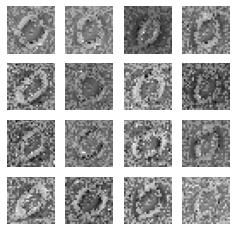

28
gen_loss: tf.Tensor(1.9884205, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16408202, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17581704, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[8.77596140e-01 1.22403808e-01]
 [9.73804951e-01 2.61950344e-02]
 [9.68522727e-01 3.14772241e-02]
 [9.44442272e-01 5.55577613e-02]
 [8.91318262e-01 1.08681783e-01]
 [8.72948766e-01 1.27051279e-01]
 [8.66656840e-01 1.33343145e-01]
 [7.87707388e-01 2.12292627e-01]
 [9.03021872e-01 9.69781801e-02]
 [3.91882330e-01 6.08117640e-01]
 [9.89604473e-01 1.03955027e-02]
 [8.18626344e-01 1.81373700e-01]
 [9.76555884e-01 2.34441813e-02]
 [9.30371583e-01 6.96284324e-02]
 [8.20273101e-01 1.79726884e-01]
 [6.92225397e-01 3.07774633e-01]
 [8.63874078e-01 1.36125907e-01]
 [9.20005083e-01 7.99949244e-02]
 [9.86595154e-01 1.34048890e-02]
 [8.72406006e-01 1.27593920e-01]
 [9.48837221e-01 5.11627942e-02]
 [9.83799577e-01 1.62004642e-02]
 [8.61260533e-01 1.38739437e-01]
 [9.50715542e-01 4

gen_loss: tf.Tensor(2.020348, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15674499, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16633774, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.00832891e-01 9.91671532e-02]
 [9.75004017e-01 2.49959975e-02]
 [9.81000841e-01 1.89991519e-02]
 [9.71318066e-01 2.86819469e-02]
 [9.33588386e-01 6.64116591e-02]
 [9.00231004e-01 9.97689590e-02]
 [9.22730148e-01 7.72699118e-02]
 [8.33274841e-01 1.66725188e-01]
 [9.50913072e-01 4.90868986e-02]
 [4.96870190e-01 5.03129840e-01]
 [9.92911875e-01 7.08817132e-03]
 [9.01086867e-01 9.89130661e-02]
 [9.86142933e-01 1.38570257e-02]
 [9.55021143e-01 4.49788310e-02]
 [9.04799104e-01 9.52008739e-02]
 [7.68901765e-01 2.31098294e-01]
 [9.16721046e-01 8.32790062e-02]
 [9.43705738e-01 5.62942103e-02]
 [9.94062245e-01 5.93769597e-03]
 [9.21137869e-01 7.88621977e-02]
 [9.64101017e-01 3.58990692e-02]
 [9.82474744e-01 1.75252147e-02]
 [9.24144268e-01 7.58557543e-02]
 [9.75734949e-01 2.426

gen_loss: tf.Tensor(2.027064, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18412095, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16967624, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.23853755e-01 7.61462525e-02]
 [9.74350333e-01 2.56496537e-02]
 [9.89798903e-01 1.02011217e-02]
 [9.87172067e-01 1.28279086e-02]
 [9.64633048e-01 3.53669263e-02]
 [9.42445993e-01 5.75540178e-02]
 [9.60561335e-01 3.94386724e-02]
 [8.74334276e-01 1.25665709e-01]
 [9.76168334e-01 2.38317028e-02]
 [6.75723374e-01 3.24276596e-01]
 [9.95541394e-01 4.45865886e-03]
 [9.58645880e-01 4.13541123e-02]
 [9.90571618e-01 9.42835025e-03]
 [9.78556275e-01 2.14437656e-02]
 [9.53776002e-01 4.62239496e-02]
 [8.61841083e-01 1.38158888e-01]
 [9.56532598e-01 4.34674136e-02]
 [9.66579139e-01 3.34208235e-02]
 [9.97460067e-01 2.54001422e-03]
 [9.58841145e-01 4.11588140e-02]
 [9.78960395e-01 2.10395548e-02]
 [9.80634928e-01 1.93650685e-02]
 [9.63077724e-01 3.69222723e-02]
 [9.89675343e-01 1.032

test_discriminator_output: tf.Tensor(
[[9.37562943e-01 6.24370500e-02]
 [9.70365047e-01 2.96349041e-02]
 [9.93593633e-01 6.40640361e-03]
 [9.92680073e-01 7.31994724e-03]
 [9.77459788e-01 2.25402024e-02]
 [9.64325547e-01 3.56744565e-02]
 [9.75500166e-01 2.44998634e-02]
 [8.88550103e-01 1.11449860e-01]
 [9.85183179e-01 1.48167945e-02]
 [7.98900902e-01 2.01099113e-01]
 [9.96861696e-01 3.13829491e-03]
 [9.78624761e-01 2.13752668e-02]
 [9.92147267e-01 7.85272662e-03]
 [9.86715853e-01 1.32841654e-02]
 [9.71374214e-01 2.86257323e-02]
 [9.10857916e-01 8.91421288e-02]
 [9.72957075e-01 2.70429179e-02]
 [9.78682399e-01 2.13176236e-02]
 [9.98403966e-01 1.59602391e-03]
 [9.76060808e-01 2.39392128e-02]
 [9.86847818e-01 1.31522426e-02]
 [9.76923645e-01 2.30763722e-02]
 [9.78727758e-01 2.12722067e-02]
 [9.94263113e-01 5.73692285e-03]
 [9.88067865e-01 1.19321682e-02]
 [9.74408329e-01 2.55917311e-02]
 [9.88335729e-01 1.16642416e-02]
 [9.80670333e-01 1.93296876e-02]
 [2.17717573e-01 7.82282472e-01]
 [9.8

gen_loss: tf.Tensor(2.017679, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14974807, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17366052, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.17171597e-01 8.28284621e-02]
 [9.73240376e-01 2.67595928e-02]
 [9.88195896e-01 1.18040955e-02]
 [9.81818914e-01 1.81810670e-02]
 [9.57988381e-01 4.20116074e-02]
 [9.39561367e-01 6.04385547e-02]
 [9.49926615e-01 5.00734262e-02]
 [8.36726069e-01 1.63273960e-01]
 [9.65849400e-01 3.41505557e-02]
 [5.81999898e-01 4.18000072e-01]
 [9.93482053e-01 6.51789363e-03]
 [9.45205510e-01 5.47944680e-02]
 [9.88611639e-01 1.13883866e-02]
 [9.74342525e-01 2.56574843e-02]
 [9.37169909e-01 6.28300607e-02]
 [8.48385870e-01 1.51614070e-01]
 [9.47362065e-01 5.26378751e-02]
 [9.58498776e-01 4.15012054e-02]
 [9.96822000e-01 3.17803491e-03]
 [9.48593020e-01 5.14070019e-02]
 [9.80825603e-01 1.91744529e-02]
 [9.80916679e-01 1.90833453e-02]
 [9.48527992e-01 5.14719561e-02]
 [9.85657632e-01 1.434

gen_loss: tf.Tensor(2.0046806, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17410463, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17927836, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.21827674e-01 7.81723484e-02]
 [9.83757913e-01 1.62420478e-02]
 [9.78555024e-01 2.14450322e-02]
 [9.61728990e-01 3.82709913e-02]
 [9.31241572e-01 6.87585026e-02]
 [9.21009898e-01 7.89900571e-02]
 [9.08579350e-01 9.14206132e-02]
 [8.52489531e-01 1.47510454e-01]
 [9.29884493e-01 7.01154768e-02]
 [4.26353246e-01 5.73646724e-01]
 [9.92071688e-01 7.92836864e-03]
 [8.67903292e-01 1.32096782e-01]
 [9.88134503e-01 1.18654976e-02]
 [9.58289206e-01 4.17107269e-02]
 [8.73643637e-01 1.26356363e-01]
 [7.81686425e-01 2.18313560e-01]
 [9.20402348e-01 7.95975700e-02]
 [9.43933010e-01 5.60670383e-02]
 [9.93849337e-01 6.15071552e-03]
 [9.14272368e-01 8.57276693e-02]
 [9.70928669e-01 2.90713292e-02]
 [9.88123834e-01 1.18761761e-02]
 [9.08902347e-01 9.10975933e-02]
 [9.68545437e-01 3.14

gen_loss: tf.Tensor(2.0213966, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17134087, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17347233, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.41021502e-01 5.89784868e-02]
 [9.81793761e-01 1.82062294e-02]
 [9.85596597e-01 1.44033991e-02]
 [9.79535878e-01 2.04640850e-02]
 [9.56641853e-01 4.33580913e-02]
 [9.54109371e-01 4.58906107e-02]
 [9.40263331e-01 5.97367138e-02]
 [9.02413905e-01 9.75860730e-02]
 [9.53576982e-01 4.64230292e-02]
 [6.12185240e-01 3.87814701e-01]
 [9.96043324e-01 3.95663595e-03]
 [9.24055874e-01 7.59440660e-02]
 [9.94481564e-01 5.51840477e-03]
 [9.70324337e-01 2.96756811e-02]
 [9.14712012e-01 8.52880180e-02]
 [8.54172528e-01 1.45827428e-01]
 [9.58337963e-01 4.16621007e-02]
 [9.66189146e-01 3.38107757e-02]
 [9.95604753e-01 4.39529447e-03]
 [9.47341859e-01 5.26581667e-02]
 [9.83842969e-01 1.61570720e-02]
 [9.85724509e-01 1.42755723e-02]
 [9.50627506e-01 4.93724458e-02]
 [9.82903421e-01 1.70

gen_loss: tf.Tensor(2.0276952, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15508346, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17154366, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.41854775e-01 5.81452250e-02]
 [9.84279096e-01 1.57208983e-02]
 [9.83286381e-01 1.67136509e-02]
 [9.77372468e-01 2.26275548e-02]
 [9.56053257e-01 4.39467914e-02]
 [9.55095649e-01 4.49043103e-02]
 [9.31366563e-01 6.86335117e-02]
 [9.16053593e-01 8.39464143e-02]
 [9.47784901e-01 5.22151031e-02]
 [5.94457150e-01 4.05542821e-01]
 [9.96297181e-01 3.70283844e-03]
 [9.23027039e-01 7.69729391e-02]
 [9.95396316e-01 4.60371468e-03]
 [9.70120072e-01 2.98798699e-02]
 [9.03988838e-01 9.60111916e-02]
 [8.48433256e-01 1.51566774e-01]
 [9.60704684e-01 3.92953530e-02]
 [9.62813079e-01 3.71868834e-02]
 [9.94817913e-01 5.18208416e-03]
 [9.35978889e-01 6.40210733e-02]
 [9.80082452e-01 1.99174974e-02]
 [9.88189816e-01 1.18101873e-02]
 [9.43791866e-01 5.62081635e-02]
 [9.81186748e-01 1.88

gen_loss: tf.Tensor(2.0650308, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22654054, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16725801, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.44077492e-01 5.59224710e-02]
 [9.87605453e-01 1.23945791e-02]
 [9.75909412e-01 2.40905620e-02]
 [9.69710767e-01 3.02892029e-02]
 [9.53358829e-01 4.66411896e-02]
 [9.54822123e-01 4.51779142e-02]
 [9.15769517e-01 8.42305422e-02]
 [9.06587899e-01 9.34120715e-02]
 [9.34053957e-01 6.59460500e-02]
 [5.56779921e-01 4.43220049e-01]
 [9.96047080e-01 3.95292090e-03]
 [9.19320464e-01 8.06795210e-02]
 [9.91855502e-01 8.14451184e-03]
 [9.75931466e-01 2.40685008e-02]
 [8.78087997e-01 1.21912055e-01]
 [8.52059960e-01 1.47940055e-01]
 [9.61625040e-01 3.83750275e-02]
 [9.60285962e-01 3.97140011e-02]
 [9.92645979e-01 7.35406484e-03]
 [9.21777666e-01 7.82223791e-02]
 [9.67874587e-01 3.21254060e-02]
 [9.91151154e-01 8.84876773e-03]
 [9.31788862e-01 6.82111159e-02]
 [9.76006150e-01 2.39

gen_loss: tf.Tensor(2.0824332, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13074309, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1582143, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.46119845e-01 5.38801923e-02]
 [9.85191822e-01 1.48081379e-02]
 [9.81143236e-01 1.88568030e-02]
 [9.77155924e-01 2.28440892e-02]
 [9.66542721e-01 3.34573016e-02]
 [9.61620629e-01 3.83794308e-02]
 [9.34904754e-01 6.50951788e-02]
 [8.65231752e-01 1.34768233e-01]
 [9.52119172e-01 4.78808321e-02]
 [6.47350729e-01 3.52649242e-01]
 [9.96373117e-01 3.62689607e-03]
 [9.56904888e-01 4.30951342e-02]
 [9.88578558e-01 1.14214718e-02]
 [9.86174941e-01 1.38251092e-02]
 [9.08656240e-01 9.13438126e-02]
 [8.93749654e-01 1.06250390e-01]
 [9.72359002e-01 2.76410691e-02]
 [9.68617558e-01 3.13823894e-02]
 [9.93344426e-01 6.65556034e-03]
 [9.41999793e-01 5.80002554e-02]
 [9.75510299e-01 2.44896691e-02]
 [9.89118159e-01 1.08818607e-02]
 [9.53816712e-01 4.61832918e-02]
 [9.83031034e-01 1.696

gen_loss: tf.Tensor(2.1126335, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22585857, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15957262, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.69264507e-01 3.07355057e-02]
 [9.87914801e-01 1.20851295e-02]
 [9.94415283e-01 5.58465533e-03]
 [9.92472887e-01 7.52717769e-03]
 [9.86232638e-01 1.37673868e-02]
 [9.78766143e-01 2.12338828e-02]
 [9.76597011e-01 2.34029647e-02]
 [8.99830163e-01 1.00169905e-01]
 [9.85710144e-01 1.42898709e-02]
 [8.45254302e-01 1.54745668e-01]
 [9.98300493e-01 1.69948582e-03]
 [9.87946808e-01 1.20532233e-02]
 [9.93985116e-01 6.01489749e-03]
 [9.95048702e-01 4.95129731e-03]
 [9.71366763e-01 2.86332611e-02]
 [9.49474394e-01 5.05255684e-02]
 [9.88139868e-01 1.18600642e-02]
 [9.86374259e-01 1.36257829e-02]
 [9.97891843e-01 2.10816646e-03]
 [9.78893578e-01 2.11064555e-02]
 [9.90884006e-01 9.11594462e-03]
 [9.87893164e-01 1.21068694e-02]
 [9.85404789e-01 1.45952469e-02]
 [9.94553089e-01 5.44

gen_loss: tf.Tensor(2.082484, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1612165, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16510893, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.71021593e-01 2.89784372e-02]
 [9.94760931e-01 5.23901498e-03]
 [9.92465377e-01 7.53463292e-03]
 [9.82405245e-01 1.75947603e-02]
 [9.76916730e-01 2.30832472e-02]
 [9.64734077e-01 3.52659374e-02]
 [9.60440576e-01 3.95593904e-02]
 [9.07873929e-01 9.21260640e-02]
 [9.75064635e-01 2.49353144e-02]
 [7.34381974e-01 2.65618026e-01]
 [9.97590542e-01 2.40945257e-03]
 [9.70461965e-01 2.95380596e-02]
 [9.92851913e-01 7.14802509e-03]
 [9.93383706e-01 6.61629206e-03]
 [9.50528502e-01 4.94715422e-02]
 [9.15042460e-01 8.49575624e-02]
 [9.79073167e-01 2.09268574e-02]
 [9.77303684e-01 2.26963032e-02]
 [9.96996045e-01 3.00401752e-03]
 [9.58562791e-01 4.14372869e-02]
 [9.86364305e-01 1.36357006e-02]
 [9.93837416e-01 6.16259314e-03]
 [9.71998215e-01 2.80017890e-02]
 [9.86967862e-01 1.3032

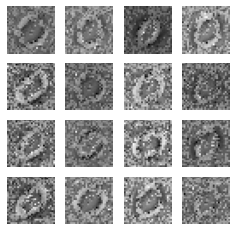

29
gen_loss: tf.Tensor(2.081304, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1547477, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1757034, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.72641051e-01 2.73589808e-02]
 [9.93044555e-01 6.95538148e-03]
 [9.93391275e-01 6.60878420e-03]
 [9.88728404e-01 1.12716472e-02]
 [9.82892513e-01 1.71075296e-02]
 [9.77894962e-01 2.21050307e-02]
 [9.70499694e-01 2.95003168e-02]
 [9.16963160e-01 8.30368549e-02]
 [9.80671167e-01 1.93289015e-02]
 [8.65715981e-01 1.34284005e-01]
 [9.98393953e-01 1.60604704e-03]
 [9.84092951e-01 1.59070194e-02]
 [9.91795957e-01 8.20407365e-03]
 [9.94168997e-01 5.83101157e-03]
 [9.61692929e-01 3.83070670e-02]
 [9.42771256e-01 5.72287180e-02]
 [9.86772478e-01 1.32275326e-02]
 [9.84205961e-01 1.57940313e-02]
 [9.97172534e-01 2.82753468e-03]
 [9.71013725e-01 2.89862789e-02]
 [9.88165498e-01 1.18345432e-02]
 [9.93499637e-01 6.50034798e-03]
 [9.82029855e-01 1.79701131e-02]
 [9.91896570e-01 8.10

gen_loss: tf.Tensor(2.0355449, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15471676, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17528367, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.67130542e-01 3.28695029e-02]
 [9.88851488e-01 1.11484705e-02]
 [9.92853701e-01 7.14632729e-03]
 [9.90360379e-01 9.63962264e-03]
 [9.84386623e-01 1.56133585e-02]
 [9.80536938e-01 1.94630623e-02]
 [9.72204566e-01 2.77954489e-02]
 [9.04853106e-01 9.51468796e-02]
 [9.81147051e-01 1.88529473e-02]
 [8.87888193e-01 1.12111799e-01]
 [9.98405993e-01 1.59396604e-03]
 [9.87694263e-01 1.23056816e-02]
 [9.91572261e-01 8.42773635e-03]
 [9.93399143e-01 6.60089077e-03]
 [9.63241160e-01 3.67588364e-02]
 [9.49850857e-01 5.01490869e-02]
 [9.88535345e-01 1.14646945e-02]
 [9.84871686e-01 1.51283052e-02]
 [9.96840477e-01 3.15950112e-03]
 [9.72885311e-01 2.71146856e-02]
 [9.89229083e-01 1.07709020e-02]
 [9.91151273e-01 8.84866342e-03]
 [9.83966172e-01 1.60337947e-02]
 [9.93294775e-01 6.70

gen_loss: tf.Tensor(2.0861032, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17469242, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16354021, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.66604412e-01 3.33955251e-02]
 [9.88915801e-01 1.10841542e-02]
 [9.88634348e-01 1.13657005e-02]
 [9.84856725e-01 1.51432389e-02]
 [9.80477214e-01 1.95228085e-02]
 [9.77136910e-01 2.28631459e-02]
 [9.61229801e-01 3.87702882e-02]
 [9.10193205e-01 8.98067579e-02]
 [9.69693244e-01 3.03066857e-02]
 [8.44743490e-01 1.55256480e-01]
 [9.98349071e-01 1.65092852e-03]
 [9.78524983e-01 2.14749705e-02]
 [9.90507841e-01 9.49212164e-03]
 [9.92017627e-01 7.98243470e-03]
 [9.41847801e-01 5.81522286e-02]
 [9.41382229e-01 5.86177967e-02]
 [9.85783219e-01 1.42167639e-02]
 [9.80885029e-01 1.91149432e-02]
 [9.95758951e-01 4.24106978e-03]
 [9.61648643e-01 3.83513868e-02]
 [9.86001134e-01 1.39987804e-02]
 [9.91951704e-01 8.04837514e-03]
 [9.77221608e-01 2.27783471e-02]
 [9.89583790e-01 1.04

gen_loss: tf.Tensor(2.1354356, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13994852, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15152198, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.61312413e-01 3.86875756e-02]
 [9.90238786e-01 9.76123847e-03]
 [9.77459908e-01 2.25400236e-02]
 [9.59889531e-01 4.01104279e-02]
 [9.66112614e-01 3.38874012e-02]
 [9.64329183e-01 3.56707759e-02]
 [9.20877159e-01 7.91228265e-02]
 [9.06261742e-01 9.37382579e-02]
 [9.24904466e-01 7.50954971e-02]
 [6.79738879e-01 3.20261091e-01]
 [9.97423887e-01 2.57609808e-03]
 [9.37925935e-01 6.20740876e-02]
 [9.90073800e-01 9.92627721e-03]
 [9.88570631e-01 1.14293294e-02]
 [8.64520431e-01 1.35479525e-01]
 [9.07391071e-01 9.26089287e-02]
 [9.73544657e-01 2.64553837e-02]
 [9.64910984e-01 3.50890085e-02]
 [9.93020713e-01 6.97932392e-03]
 [9.13560927e-01 8.64390656e-02]
 [9.80518222e-01 1.94817521e-02]
 [9.93165791e-01 6.83422294e-03]
 [9.47434962e-01 5.25650978e-02]
 [9.72549736e-01 2.74

gen_loss: tf.Tensor(2.1152065, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13886532, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15616032, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.52828228e-01 4.71718125e-02]
 [9.86831427e-01 1.31685156e-02]
 [9.88311350e-01 1.16886292e-02]
 [9.79514599e-01 2.04854365e-02]
 [9.77885067e-01 2.21149325e-02]
 [9.76188898e-01 2.38110870e-02]
 [9.46849048e-01 5.31509407e-02]
 [8.76874983e-01 1.23125024e-01]
 [9.56230998e-01 4.37690057e-02]
 [7.95294583e-01 2.04705492e-01]
 [9.96844411e-01 3.15555534e-03]
 [9.78526115e-01 2.14739032e-02]
 [9.92681324e-01 7.31868949e-03]
 [9.92278337e-01 7.72169745e-03]
 [9.19023573e-01 8.09765086e-02]
 [9.37305629e-01 6.26943484e-02]
 [9.79470789e-01 2.05292031e-02]
 [9.72916782e-01 2.70831808e-02]
 [9.95092034e-01 4.90801362e-03]
 [9.40916240e-01 5.90837821e-02]
 [9.88645315e-01 1.13546345e-02]
 [9.91468430e-01 8.53160396e-03]
 [9.65952754e-01 3.40472050e-02]
 [9.86628532e-01 1.33

gen_loss: tf.Tensor(2.122657, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16419467, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16120249, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.70967174e-01 2.90327836e-02]
 [9.91401970e-01 8.59798677e-03]
 [9.93907273e-01 6.09271508e-03]
 [9.89597023e-01 1.04029514e-02]
 [9.87817824e-01 1.21822441e-02]
 [9.83685672e-01 1.63142867e-02]
 [9.71901000e-01 2.80990191e-02]
 [9.10266399e-01 8.97336081e-02]
 [9.79872286e-01 2.01277025e-02]
 [8.75952005e-01 1.24047957e-01]
 [9.98064816e-01 1.93513941e-03]
 [9.89331841e-01 1.06682125e-02]
 [9.95318234e-01 4.68172878e-03]
 [9.95375991e-01 4.62403707e-03]
 [9.60995138e-01 3.90049368e-02]
 [9.58405614e-01 4.15944122e-02]
 [9.85604286e-01 1.43956775e-02]
 [9.84639406e-01 1.53605659e-02]
 [9.97842550e-01 2.15741992e-03]
 [9.69025433e-01 3.09745781e-02]
 [9.91512954e-01 8.48709326e-03]
 [9.94136333e-01 5.86360320e-03]
 [9.83294249e-01 1.67057142e-02]
 [9.93061364e-01 6.938

gen_loss: tf.Tensor(2.1296668, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.142728, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15210389, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.82028484e-01 1.79714765e-02]
 [9.94369566e-01 5.63043309e-03]
 [9.94902492e-01 5.09744743e-03]
 [9.91844237e-01 8.15570820e-03]
 [9.90794480e-01 9.20549780e-03]
 [9.86835063e-01 1.31649412e-02]
 [9.79978502e-01 2.00214665e-02]
 [9.37516689e-01 6.24833331e-02]
 [9.85728860e-01 1.42711299e-02]
 [8.98375392e-01 1.01624615e-01]
 [9.98845220e-01 1.15470833e-03]
 [9.90502119e-01 9.49788000e-03]
 [9.95677888e-01 4.32215305e-03]
 [9.96381283e-01 3.61864432e-03]
 [9.72063303e-01 2.79366858e-02]
 [9.66950595e-01 3.30493860e-02]
 [9.88761723e-01 1.12382378e-02]
 [9.88909304e-01 1.10906893e-02]
 [9.98587608e-01 1.41243800e-03]
 [9.77772117e-01 2.22279001e-02]
 [9.91623700e-01 8.37633386e-03]
 [9.96108830e-01 3.89113929e-03]
 [9.88106251e-01 1.18937362e-02]
 [9.94266331e-01 5.7337

gen_loss: tf.Tensor(2.0705574, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14069125, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1606216, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.79115367e-01 2.08846107e-02]
 [9.94710922e-01 5.28906239e-03]
 [9.92579997e-01 7.42007699e-03]
 [9.87460136e-01 1.25399251e-02]
 [9.87400055e-01 1.26000214e-02]
 [9.82796311e-01 1.72036961e-02]
 [9.72700953e-01 2.72990949e-02]
 [9.22001958e-01 7.79980570e-02]
 [9.80303049e-01 1.96970105e-02]
 [8.43731344e-01 1.56268626e-01]
 [9.98553932e-01 1.44606340e-03]
 [9.87393737e-01 1.26062082e-02]
 [9.94831264e-01 5.16877603e-03]
 [9.94934738e-01 5.06529445e-03]
 [9.62019801e-01 3.79801206e-02]
 [9.56542850e-01 4.34571914e-02]
 [9.85885859e-01 1.41141443e-02]
 [9.83368933e-01 1.66310202e-02]
 [9.98005569e-01 1.99448480e-03]
 [9.66421723e-01 3.35783176e-02]
 [9.87962782e-01 1.20372446e-02]
 [9.96380985e-01 3.61900404e-03]
 [9.80787396e-01 1.92126054e-02]
 [9.91081178e-01 8.918

 [9.77285147e-01 2.27149203e-02]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.1529636, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18083654, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14935638, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.78820920e-01 2.11791079e-02]
 [9.94897068e-01 5.10290125e-03]
 [9.93007302e-01 6.99271774e-03]
 [9.89708960e-01 1.02910055e-02]
 [9.89060879e-01 1.09391380e-02]
 [9.88019764e-01 1.19802393e-02]
 [9.74909067e-01 2.50909328e-02]
 [9.28583205e-01 7.14167655e-02]
 [9.80979502e-01 1.90204643e-02]
 [8.87208819e-01 1.12791188e-01]
 [9.98908401e-01 1.09155755e-03]
 [9.91050482e-01 8.94956570e-03]
 [9.95905280e-01 4.09465795e-03]
 [9.96519566e-01 3.48046259e-03]
 [9.63259697e-01 3.67402434e-02]
 [9.66314018e-01 3.36859077e-02]
 [9.89901185e-01 1.00988057e-02]
 [9.85658109e-01 1.43418415e-02]
 [9.98066008e-01 1.93397107e-03]
 [9.70159352e-01 2.98405904e-02]
 [9.90064204e-01 9.93582793e-03]
 [9.96203482e-01 3.79

gen_loss: tf.Tensor(2.1342816, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15660779, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15234283, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.78012204e-01 2.19877996e-02]
 [9.95056629e-01 4.94336989e-03]
 [9.92578566e-01 7.42148515e-03]
 [9.89844084e-01 1.01559097e-02]
 [9.88848567e-01 1.11514088e-02]
 [9.88568664e-01 1.14313122e-02]
 [9.73640382e-01 2.63596233e-02]
 [9.30635333e-01 6.93647265e-02]
 [9.79265213e-01 2.07347460e-02]
 [8.89065504e-01 1.10934459e-01]
 [9.98977304e-01 1.02269067e-03]
 [9.90783215e-01 9.21677798e-03]
 [9.96264160e-01 3.73585499e-03]
 [9.96620417e-01 3.37956636e-03]
 [9.60631609e-01 3.93684134e-02]
 [9.66529012e-01 3.34709063e-02]
 [9.90231335e-01 9.76864249e-03]
 [9.85577166e-01 1.44227920e-02]
 [9.97933745e-01 2.06623878e-03]
 [9.69089150e-01 3.09109185e-02]
 [9.90065932e-01 9.93407890e-03]
 [9.96294320e-01 3.70570342e-03]
 [9.81514037e-01 1.84858982e-02]
 [9.92731512e-01 7.26

gen_loss: tf.Tensor(2.1331866, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16410135, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1576162, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.72855747e-01 2.71442309e-02]
 [9.95815575e-01 4.18439507e-03]
 [9.84169245e-01 1.58307720e-02]
 [9.82833982e-01 1.71660557e-02]
 [9.81865108e-01 1.81349069e-02]
 [9.85075891e-01 1.49240894e-02]
 [9.54178870e-01 4.58211936e-02]
 [9.17826533e-01 8.21733996e-02]
 [9.60042119e-01 3.99578586e-02]
 [8.43953788e-01 1.56046152e-01]
 [9.98733819e-01 1.26620207e-03]
 [9.83853817e-01 1.61462221e-02]
 [9.93307173e-01 6.69290265e-03]
 [9.94693100e-01 5.30694472e-03]
 [9.25563633e-01 7.44364113e-02]
 [9.56328571e-01 4.36713994e-02]
 [9.86714661e-01 1.32853715e-02]
 [9.80327904e-01 1.96721107e-02]
 [9.95759666e-01 4.24029818e-03]
 [9.52176034e-01 4.78239767e-02]
 [9.81419325e-01 1.85807236e-02]
 [9.97151434e-01 2.84859398e-03]
 [9.67631698e-01 3.23683098e-02]
 [9.87266183e-01 1.273

 [9.71890807e-01 2.81091984e-02]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.0800729, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14502218, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15607195, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.61263895e-01 3.87360901e-02]
 [9.92312968e-01 7.68697774e-03]
 [9.80445445e-01 1.95545182e-02]
 [9.83294725e-01 1.67053323e-02]
 [9.81288314e-01 1.87116377e-02]
 [9.82372880e-01 1.76270809e-02]
 [9.50215816e-01 4.97841388e-02]
 [8.85298431e-01 1.14701636e-01]
 [9.57950175e-01 4.20497730e-02]
 [8.20788503e-01 1.79211453e-01]
 [9.98433173e-01 1.56675512e-03]
 [9.86336350e-01 1.36636980e-02]
 [9.92983341e-01 7.01665785e-03]
 [9.91840363e-01 8.15966725e-03]
 [9.24126208e-01 7.58737177e-02]
 [9.53688622e-01 4.63113748e-02]
 [9.85999286e-01 1.40007101e-02]
 [9.77609277e-01 2.23907642e-02]
 [9.94785845e-01 5.21416636e-03]
 [9.49923158e-01 5.00769019e-02]
 [9.82415020e-01 1.75850037e-02]
 [9.95405436e-01 4.59

gen_loss: tf.Tensor(2.0840678, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14459682, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15830317, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.63492274e-01 3.65077630e-02]
 [9.91427958e-01 8.57196748e-03]
 [9.84844863e-01 1.51551776e-02]
 [9.87876058e-01 1.21239563e-02]
 [9.86017942e-01 1.39820399e-02]
 [9.85638320e-01 1.43616935e-02]
 [9.61439967e-01 3.85600328e-02]
 [8.93783987e-01 1.06216028e-01]
 [9.68205810e-01 3.17941755e-02]
 [8.63222420e-01 1.36777595e-01]
 [9.98725355e-01 1.27463392e-03]
 [9.90369380e-01 9.63056833e-03]
 [9.94548142e-01 5.45186223e-03]
 [9.93260324e-01 6.73970161e-03]
 [9.42650139e-01 5.73498905e-02]
 [9.62915957e-01 3.70840952e-02]
 [9.88850653e-01 1.11493431e-02]
 [9.82868195e-01 1.71318501e-02]
 [9.95901763e-01 4.09824355e-03]
 [9.63376880e-01 3.66230942e-02]
 [9.87296104e-01 1.27038788e-02]
 [9.94694293e-01 5.30577451e-03]
 [9.76209342e-01 2.37906240e-02]
 [9.91431594e-01 8.56

gen_loss: tf.Tensor(2.0727987, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16329312, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16398178, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.84161317e-01 1.58386622e-02]
 [9.95682240e-01 4.31777863e-03]
 [9.94067788e-01 5.93226170e-03]
 [9.95089769e-01 4.91015147e-03]
 [9.94795501e-01 5.20450948e-03]
 [9.93970275e-01 6.02972321e-03]
 [9.83720779e-01 1.62792858e-02]
 [9.49883997e-01 5.01159579e-02]
 [9.86652672e-01 1.33473082e-02]
 [9.56621170e-01 4.33788076e-02]
 [9.99535441e-01 4.64627228e-04]
 [9.95919824e-01 4.08009626e-03]
 [9.96598423e-01 3.40155349e-03]
 [9.98064220e-01 1.93574000e-03]
 [9.74982023e-01 2.50179712e-02]
 [9.84073639e-01 1.59263778e-02]
 [9.95073497e-01 4.92651528e-03]
 [9.93952453e-01 6.04754826e-03]
 [9.98422027e-01 1.57798326e-03]
 [9.87641811e-01 1.23581849e-02]
 [9.94356930e-01 5.64299989e-03]
 [9.96599853e-01 3.40019609e-03]
 [9.91841078e-01 8.15896504e-03]
 [9.96533632e-01 3.46

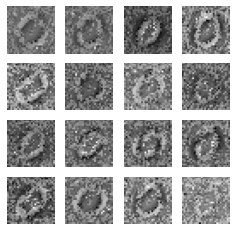

30
gen_loss: tf.Tensor(2.0961637, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14867234, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15623832, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.85938787e-01 1.40611799e-02]
 [9.96513546e-01 3.48642142e-03]
 [9.94517148e-01 5.48280962e-03]
 [9.94797051e-01 5.20292670e-03]
 [9.94908631e-01 5.09132305e-03]
 [9.93430197e-01 6.56984560e-03]
 [9.83587325e-01 1.64126828e-02]
 [9.49362099e-01 5.06378897e-02]
 [9.87080991e-01 1.29190506e-02]
 [9.51873839e-01 4.81262095e-02]
 [9.99512076e-01 4.87917569e-04]
 [9.95679080e-01 4.32089530e-03]
 [9.96267259e-01 3.73270432e-03]
 [9.98044729e-01 1.95528544e-03]
 [9.75561798e-01 2.44381577e-02]
 [9.83480871e-01 1.65191106e-02]
 [9.94655609e-01 5.34445234e-03]
 [9.93799388e-01 6.20061625e-03]
 [9.98439491e-01 1.56054157e-03]
 [9.87925053e-01 1.20749492e-02]
 [9.94168758e-01 5.83121879e-03]
 [9.97188509e-01 2.81145726e-03]
 [9.91647601e-01 8.35236907e-03]
 [9.96318102e-01 3

test_discriminator_output: tf.Tensor(
[[9.79388237e-01 2.06118077e-02]
 [9.96064723e-01 3.93534591e-03]
 [9.93342102e-01 6.65794453e-03]
 [9.92661238e-01 7.33879581e-03]
 [9.92792606e-01 7.20738899e-03]
 [9.90406930e-01 9.59301926e-03]
 [9.76571202e-01 2.34287456e-02]
 [9.17336166e-01 8.26638713e-02]
 [9.83379543e-01 1.66204497e-02]
 [9.22930062e-01 7.70699456e-02]
 [9.99066532e-01 9.33501986e-04]
 [9.95327115e-01 4.67283186e-03]
 [9.94297087e-01 5.70295425e-03]
 [9.96745229e-01 3.25480336e-03]
 [9.68419909e-01 3.15801501e-02]
 [9.76707220e-01 2.32928358e-02]
 [9.92067933e-01 7.93210045e-03]
 [9.90166306e-01 9.83360596e-03]
 [9.97489929e-01 2.51005194e-03]
 [9.81919944e-01 1.80800464e-02]
 [9.92398083e-01 7.60191493e-03]
 [9.97199416e-01 2.80057266e-03]
 [9.86848176e-01 1.31518338e-02]
 [9.94868994e-01 5.13101649e-03]
 [9.96748209e-01 3.25177563e-03]
 [9.81028378e-01 1.89715642e-02]
 [9.94014323e-01 5.98570425e-03]
 [9.89677548e-01 1.03224311e-02]
 [2.48810053e-01 7.51189947e-01]
 [9.9

test_discriminator_output: tf.Tensor(
[[9.66833472e-01 3.31664942e-02]
 [9.95016158e-01 4.98389918e-03]
 [9.91078436e-01 8.92155524e-03]
 [9.88538921e-01 1.14610465e-02]
 [9.88822699e-01 1.11772818e-02]
 [9.85198438e-01 1.48015730e-02]
 [9.63801146e-01 3.61989141e-02]
 [8.63273501e-01 1.36726469e-01]
 [9.75968599e-01 2.40314789e-02]
 [8.70650411e-01 1.29349589e-01]
 [9.98091400e-01 1.90856750e-03]
 [9.94481802e-01 5.51821617e-03]
 [9.91849899e-01 8.15017987e-03]
 [9.94159102e-01 5.84090780e-03]
 [9.54319775e-01 4.56803106e-02]
 [9.65106368e-01 3.48936953e-02]
 [9.87618089e-01 1.23818424e-02]
 [9.82691705e-01 1.73083581e-02]
 [9.95582163e-01 4.41778405e-03]
 [9.69705820e-01 3.02941985e-02]
 [9.90555823e-01 9.44421813e-03]
 [9.96854484e-01 3.14559066e-03]
 [9.77066100e-01 2.29338631e-02]
 [9.92118716e-01 7.88129866e-03]
 [9.94929671e-01 5.07039670e-03]
 [9.73171175e-01 2.68288646e-02]
 [9.90090489e-01 9.90947150e-03]
 [9.83535290e-01 1.64646618e-02]
 [2.60794789e-01 7.39205241e-01]
 [9.8

gen_loss: tf.Tensor(2.188093, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14547202, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1505053, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.78470445e-01 2.15295218e-02]
 [9.96939421e-01 3.06062214e-03]
 [9.91295695e-01 8.70427117e-03]
 [9.86740112e-01 1.32599361e-02]
 [9.89367306e-01 1.06326584e-02]
 [9.87665892e-01 1.23341316e-02]
 [9.64891434e-01 3.51085290e-02]
 [9.07640040e-01 9.23600048e-02]
 [9.72474754e-01 2.75252797e-02]
 [8.95881057e-01 1.04118951e-01]
 [9.98661518e-01 1.33852824e-03]
 [9.93765712e-01 6.23428961e-03]
 [9.92203355e-01 7.79663213e-03]
 [9.96206641e-01 3.79335461e-03]
 [9.45194960e-01 5.48050143e-02]
 [9.69746172e-01 3.02538164e-02]
 [9.89949465e-01 1.00505855e-02]
 [9.83943105e-01 1.60569306e-02]
 [9.96101856e-01 3.89815774e-03]
 [9.71017301e-01 2.89826542e-02]
 [9.92714226e-01 7.28575559e-03]
 [9.97644246e-01 2.35575973e-03]
 [9.78487670e-01 2.15123668e-02]
 [9.91012335e-01 8.9876

gen_loss: tf.Tensor(2.1407278, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13380359, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14907372, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.86807048e-01 1.31929787e-02]
 [9.97733593e-01 2.26639560e-03]
 [9.92304146e-01 7.69583276e-03]
 [9.87370014e-01 1.26299066e-02]
 [9.91252363e-01 8.74758698e-03]
 [9.89663303e-01 1.03366561e-02]
 [9.71256018e-01 2.87440382e-02]
 [9.44647551e-01 5.53524233e-02]
 [9.73784685e-01 2.62153186e-02]
 [9.14288878e-01 8.57110843e-02]
 [9.99201715e-01 7.98331690e-04]
 [9.92605686e-01 7.39425933e-03]
 [9.94217873e-01 5.78217348e-03]
 [9.97513294e-01 2.48675561e-03]
 [9.46804345e-01 5.31956516e-02]
 [9.74510729e-01 2.54892390e-02]
 [9.92311299e-01 7.68864388e-03]
 [9.87207830e-01 1.27921570e-02]
 [9.97319281e-01 2.68076919e-03]
 [9.75926220e-01 2.40737945e-02]
 [9.94503260e-01 5.49671100e-03]
 [9.97856796e-01 2.14322587e-03]
 [9.83462632e-01 1.65373888e-02]
 [9.91428554e-01 8.57

 [9.86047745e-01 1.39522990e-02]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.1226766, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16317515, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16042337, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.84909832e-01 1.50901806e-02]
 [9.96630251e-01 3.36970016e-03]
 [9.92250860e-01 7.74906250e-03]
 [9.88393366e-01 1.16066253e-02]
 [9.90727305e-01 9.27269086e-03]
 [9.88130093e-01 1.18698645e-02]
 [9.72535610e-01 2.74643265e-02]
 [9.43051994e-01 5.69479801e-02]
 [9.75429833e-01 2.45701205e-02]
 [9.06401992e-01 9.35979933e-02]
 [9.99106228e-01 8.93716293e-04]
 [9.93275762e-01 6.72423700e-03]
 [9.95298803e-01 4.70117573e-03]
 [9.96664464e-01 3.33546381e-03]
 [9.49623108e-01 5.03768250e-02]
 [9.72560644e-01 2.74393447e-02]
 [9.92667258e-01 7.33271893e-03]
 [9.84555423e-01 1.54446401e-02]
 [9.97519553e-01 2.48045917e-03]
 [9.72981632e-01 2.70183105e-02]
 [9.94817555e-01 5.18249255e-03]
 [9.96674180e-01 3.32

gen_loss: tf.Tensor(2.1599212, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12893748, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14595929, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.76334810e-01 2.36651935e-02]
 [9.94254410e-01 5.74560557e-03]
 [9.92317915e-01 7.68212834e-03]
 [9.89455402e-01 1.05446177e-02]
 [9.89273489e-01 1.07265478e-02]
 [9.86235440e-01 1.37646105e-02]
 [9.70885754e-01 2.91142818e-02]
 [9.11091328e-01 8.89087021e-02]
 [9.76918876e-01 2.30810847e-02]
 [8.97342324e-01 1.02657661e-01]
 [9.98568416e-01 1.43155118e-03]
 [9.95171487e-01 4.82851872e-03]
 [9.94835019e-01 5.16496645e-03]
 [9.95050728e-01 4.94921859e-03]
 [9.53421891e-01 4.65780832e-02]
 [9.69406307e-01 3.05936858e-02]
 [9.91922140e-01 8.07782356e-03]
 [9.80058432e-01 1.99416131e-02]
 [9.96976137e-01 3.02392524e-03]
 [9.68760312e-01 3.12396232e-02]
 [9.94435072e-01 5.56490105e-03]
 [9.94906425e-01 5.09361876e-03]
 [9.82364595e-01 1.76353902e-02]
 [9.93098795e-01 6.90

gen_loss: tf.Tensor(2.122555, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.22259769, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15392879, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.72018361e-01 2.79816352e-02]
 [9.95654225e-01 4.34578070e-03]
 [9.92484152e-01 7.51585793e-03]
 [9.87793148e-01 1.22068208e-02]
 [9.84335184e-01 1.56647358e-02]
 [9.86891448e-01 1.31085701e-02]
 [9.60811079e-01 3.91889401e-02]
 [8.81387174e-01 1.18612789e-01]
 [9.71653700e-01 2.83462722e-02]
 [9.09634829e-01 9.03651938e-02]
 [9.97788310e-01 2.21168832e-03]
 [9.95802343e-01 4.19771904e-03]
 [9.90167260e-01 9.83271003e-03]
 [9.95235264e-01 4.76476690e-03]
 [9.42925632e-01 5.70743605e-02]
 [9.66005802e-01 3.39941755e-02]
 [9.90073562e-01 9.92647931e-03]
 [9.78586614e-01 2.14133859e-02]
 [9.95616078e-01 4.38393047e-03]
 [9.61367369e-01 3.86326388e-02]
 [9.92072523e-01 7.92743359e-03]
 [9.96241808e-01 3.75816179e-03]
 [9.75178242e-01 2.48217098e-02]
 [9.91686761e-01 8.313

 [9.78371501e-01 2.16285549e-02]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.183887, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16357261, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15104699, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.71815467e-01 2.81845517e-02]
 [9.96426284e-01 3.57371336e-03]
 [9.91784692e-01 8.21535196e-03]
 [9.83456433e-01 1.65435225e-02]
 [9.78146493e-01 2.18534470e-02]
 [9.83918428e-01 1.60815306e-02]
 [9.47272420e-01 5.27275950e-02]
 [8.59489858e-01 1.40510142e-01]
 [9.60001707e-01 3.99983749e-02]
 [8.85690987e-01 1.14309005e-01]
 [9.97142136e-01 2.85783946e-03]
 [9.94080245e-01 5.91969909e-03]
 [9.87353981e-01 1.26460511e-02]
 [9.95904982e-01 4.09503561e-03]
 [9.25659597e-01 7.43403882e-02]
 [9.54475462e-01 4.55245115e-02]
 [9.85854328e-01 1.41456285e-02]
 [9.75444019e-01 2.45559718e-02]
 [9.95384395e-01 4.61561047e-03]
 [9.48197365e-01 5.18026948e-02]
 [9.91183400e-01 8.81665759e-03]
 [9.96772826e-01 3.227

gen_loss: tf.Tensor(2.2160103, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.120279305, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14452931, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.64808345e-01 3.51916626e-02]
 [9.95480061e-01 4.51986957e-03]
 [9.90377247e-01 9.62277129e-03]
 [9.78015721e-01 2.19842419e-02]
 [9.71710563e-01 2.82895025e-02]
 [9.75260913e-01 2.47390661e-02]
 [9.33535159e-01 6.64648190e-02]
 [8.21279347e-01 1.78720698e-01]
 [9.49592412e-01 5.04076220e-02]
 [8.14511776e-01 1.85488194e-01]
 [9.96079981e-01 3.92000750e-03]
 [9.91788208e-01 8.21176730e-03]
 [9.88618612e-01 1.13813663e-02]
 [9.94403958e-01 5.59605146e-03]
 [9.10442889e-01 8.95571336e-02]
 [9.34931338e-01 6.50686547e-02]
 [9.79853511e-01 2.01464966e-02]
 [9.66007948e-01 3.39920521e-02]
 [9.95014966e-01 4.98506473e-03]
 [9.27402437e-01 7.25975633e-02]
 [9.91343260e-01 8.65671877e-03]
 [9.95923996e-01 4.07599658e-03]
 [9.51676846e-01 4.83230911e-02]
 [9.84478712e-01 1.5

test_discriminator_output: tf.Tensor(
[[9.63599503e-01 3.64004113e-02]
 [9.94286239e-01 5.71376877e-03]
 [9.88314390e-01 1.16856052e-02]
 [9.70817268e-01 2.91827079e-02]
 [9.66641963e-01 3.33580114e-02]
 [9.62891340e-01 3.71087343e-02]
 [9.21695113e-01 7.83048496e-02]
 [8.12107563e-01 1.87892422e-01]
 [9.37426925e-01 6.25730157e-02]
 [7.11627603e-01 2.88372368e-01]
 [9.95925665e-01 4.07430716e-03]
 [9.86155093e-01 1.38448728e-02]
 [9.91387665e-01 8.61230958e-03]
 [9.92276728e-01 7.72329047e-03]
 [8.92677367e-01 1.07322648e-01]
 [9.12006259e-01 8.79937708e-02]
 [9.73865211e-01 2.61348393e-02]
 [9.58262980e-01 4.17370498e-02]
 [9.95127797e-01 4.87222150e-03]
 [9.08679068e-01 9.13208872e-02]
 [9.91892099e-01 8.10790248e-03]
 [9.94649708e-01 5.35031594e-03]
 [9.39703584e-01 6.02964684e-02]
 [9.79494810e-01 2.05052271e-02]
 [9.88214612e-01 1.17853712e-02]
 [9.74053264e-01 2.59467252e-02]
 [9.72939909e-01 2.70601623e-02]
 [9.76485968e-01 2.35140622e-02]
 [3.83438081e-01 6.16561949e-01]
 [9.5

gen_loss: tf.Tensor(2.1742496, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1881594, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15480053, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.71889198e-01 2.81108078e-02]
 [9.94130552e-01 5.86946029e-03]
 [9.90379691e-01 9.62036848e-03]
 [9.80952442e-01 1.90475713e-02]
 [9.76103604e-01 2.38963589e-02]
 [9.74939406e-01 2.50605270e-02]
 [9.41465557e-01 5.85344248e-02]
 [8.49916518e-01 1.50083497e-01]
 [9.52882409e-01 4.71175723e-02]
 [8.26278329e-01 1.73721686e-01]
 [9.97886717e-01 2.11331388e-03]
 [9.90345061e-01 9.65487491e-03]
 [9.93414640e-01 6.58535911e-03]
 [9.94293630e-01 5.70638618e-03]
 [9.12308872e-01 8.76910910e-02]
 [9.39411759e-01 6.05881847e-02]
 [9.83376741e-01 1.66231990e-02]
 [9.76692975e-01 2.33070515e-02]
 [9.96538997e-01 3.46104451e-03]
 [9.47627187e-01 5.23728095e-02]
 [9.93591070e-01 6.40891725e-03]
 [9.94518340e-01 5.48164453e-03]
 [9.64059412e-01 3.59405391e-02]
 [9.86634493e-01 1.336

gen_loss: tf.Tensor(2.177827, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.16223289, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1457567, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.77065861e-01 2.29341146e-02]
 [9.95126963e-01 4.87303548e-03]
 [9.91745889e-01 8.25414341e-03]
 [9.86673594e-01 1.33263897e-02]
 [9.81740475e-01 1.82595681e-02]
 [9.83277857e-01 1.67221073e-02]
 [9.52800632e-01 4.71993461e-02]
 [8.85357738e-01 1.14642270e-01]
 [9.61915672e-01 3.80843021e-02]
 [8.95352900e-01 1.04647040e-01]
 [9.98628497e-01 1.37150823e-03]
 [9.93015289e-01 6.98468275e-03]
 [9.93721783e-01 6.27820892e-03]
 [9.95840192e-01 4.15982772e-03]
 [9.25153971e-01 7.48460516e-02]
 [9.57425475e-01 4.25745472e-02]
 [9.88372982e-01 1.16270361e-02]
 [9.85140800e-01 1.48591595e-02]
 [9.97098446e-01 2.90161115e-03]
 [9.64975595e-01 3.50244716e-02]
 [9.93616581e-01 6.38337107e-03]
 [9.95564759e-01 4.43520490e-03]
 [9.75467265e-01 2.45327521e-02]
 [9.90546942e-01 9.4530

gen_loss: tf.Tensor(2.181289, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1611996, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15172477, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.74341094e-01 2.56589018e-02]
 [9.95236754e-01 4.76326747e-03]
 [9.91331935e-01 8.66812002e-03]
 [9.87497985e-01 1.25019737e-02]
 [9.81649816e-01 1.83502156e-02]
 [9.84556913e-01 1.54431155e-02]
 [9.50758815e-01 4.92411032e-02]
 [8.87936056e-01 1.12063915e-01]
 [9.60880101e-01 3.91199552e-02]
 [9.02079046e-01 9.79209840e-02]
 [9.98622060e-01 1.37791620e-03]
 [9.93388057e-01 6.61187107e-03]
 [9.93263841e-01 6.73611416e-03]
 [9.95709658e-01 4.29035071e-03]
 [9.21585023e-01 7.84149170e-02]
 [9.60355163e-01 3.96448858e-02]
 [9.88916516e-01 1.10835070e-02]
 [9.85886812e-01 1.41132688e-02]
 [9.96727228e-01 3.27279442e-03]
 [9.65424001e-01 3.45759653e-02]
 [9.92675960e-01 7.32403714e-03]
 [9.96008873e-01 3.99108743e-03]
 [9.75614429e-01 2.43855212e-02]
 [9.91106570e-01 8.8934

gen_loss: tf.Tensor(2.186436, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18034762, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14570366, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.43425119e-01 5.65748252e-02]
 [9.89131451e-01 1.08685344e-02]
 [9.93762672e-01 6.23738673e-03]
 [9.90134060e-01 9.86595545e-03]
 [9.81630087e-01 1.83699392e-02]
 [9.79291618e-01 2.07084436e-02]
 [9.52643812e-01 4.73562032e-02]
 [8.25847685e-01 1.74152330e-01]
 [9.66772556e-01 3.32275182e-02]
 [8.53988528e-01 1.46011472e-01]
 [9.97492313e-01 2.50764377e-03]
 [9.95003521e-01 4.99648741e-03]
 [9.95017231e-01 4.98280907e-03]
 [9.92805302e-01 7.19471462e-03]
 [9.34909463e-01 6.50905669e-02]
 [9.56931174e-01 4.30688746e-02]
 [9.87417817e-01 1.25821400e-02]
 [9.80095863e-01 1.99041218e-02]
 [9.95774686e-01 4.22526896e-03]
 [9.57980275e-01 4.20197174e-02]
 [9.95456219e-01 4.54373192e-03]
 [9.92151737e-01 7.84827769e-03]
 [9.70944941e-01 2.90550534e-02]
 [9.93362427e-01 6.637

gen_loss: tf.Tensor(2.1758313, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17502654, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1586418, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.46256757e-01 5.37431836e-02]
 [9.92771327e-01 7.22862175e-03]
 [9.94988978e-01 5.01098810e-03]
 [9.86392438e-01 1.36074964e-02]
 [9.77152646e-01 2.28473581e-02]
 [9.74170923e-01 2.58291494e-02]
 [9.44298327e-01 5.57016470e-02]
 [8.45999837e-01 1.54000148e-01]
 [9.57797170e-01 4.22027707e-02]
 [7.95766294e-01 2.04233661e-01]
 [9.97014642e-01 2.98530422e-03]
 [9.91543770e-01 8.45623575e-03]
 [9.94562685e-01 5.43736154e-03]
 [9.92460191e-01 7.53982319e-03]
 [9.16712701e-01 8.32872763e-02]
 [9.51379597e-01 4.86203618e-02]
 [9.83437181e-01 1.65628605e-02]
 [9.75308418e-01 2.46916041e-02]
 [9.94589925e-01 5.41007798e-03]
 [9.44570959e-01 5.54290451e-02]
 [9.96351361e-01 3.64857377e-03]
 [9.93934810e-01 6.06515491e-03]
 [9.56088424e-01 4.39115614e-02]
 [9.90787685e-01 9.212

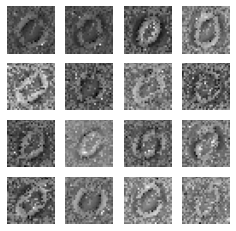

31
gen_loss: tf.Tensor(2.1643631, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12311368, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15441333, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.63711798e-01 3.62882167e-02]
 [9.95289564e-01 4.71038138e-03]
 [9.95260298e-01 4.73970780e-03]
 [9.85228062e-01 1.47719951e-02]
 [9.77836251e-01 2.21637674e-02]
 [9.77450609e-01 2.25494467e-02]
 [9.47019219e-01 5.29808439e-02]
 [8.82632554e-01 1.17367432e-01]
 [9.55254138e-01 4.47459370e-02]
 [8.31427038e-01 1.68572962e-01]
 [9.97883618e-01 2.11631344e-03]
 [9.89440978e-01 1.05590699e-02]
 [9.93469477e-01 6.53048838e-03]
 [9.93812084e-01 6.18792092e-03]
 [9.07704473e-01 9.22954977e-02]
 [9.59147513e-01 4.08525355e-02]
 [9.85109925e-01 1.48900924e-02]
 [9.79422510e-01 2.05774568e-02]
 [9.94511485e-01 5.48851723e-03]
 [9.52038229e-01 4.79617119e-02]
 [9.96499300e-01 3.50073446e-03]
 [9.95726705e-01 4.27327352e-03]
 [9.58175480e-01 4.18244600e-02]
 [9.89786506e-01 1

gen_loss: tf.Tensor(2.1350973, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13510893, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1596618, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.72510040e-01 2.74899323e-02]
 [9.94542599e-01 5.45741338e-03]
 [9.97196317e-01 2.80366093e-03]
 [9.92370963e-01 7.62908347e-03]
 [9.87046719e-01 1.29532432e-02]
 [9.84324455e-01 1.56754740e-02]
 [9.71997857e-01 2.80021187e-02]
 [8.98112118e-01 1.01887815e-01]
 [9.75194871e-01 2.48051137e-02]
 [9.07433867e-01 9.25661027e-02]
 [9.98655438e-01 1.34456193e-03]
 [9.94509161e-01 5.49083343e-03]
 [9.94674087e-01 5.32582821e-03]
 [9.95810270e-01 4.18969756e-03]
 [9.47390139e-01 5.26099280e-02]
 [9.75607753e-01 2.43922342e-02]
 [9.90693629e-01 9.30633210e-03]
 [9.86634910e-01 1.33650657e-02]
 [9.96547043e-01 3.45299509e-03]
 [9.74504173e-01 2.54958384e-02]
 [9.98237967e-01 1.76205847e-03]
 [9.95118260e-01 4.88171168e-03]
 [9.77948308e-01 2.20517125e-02]
 [9.94932592e-01 5.067

gen_loss: tf.Tensor(2.199392, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13716933, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14415117, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.65741813e-01 3.42581868e-02]
 [9.95317459e-01 4.68254462e-03]
 [9.95930493e-01 4.06955415e-03]
 [9.86261904e-01 1.37380809e-02]
 [9.81423020e-01 1.85770020e-02]
 [9.71072316e-01 2.89277546e-02]
 [9.60218847e-01 3.97811793e-02]
 [8.75279248e-01 1.24720797e-01]
 [9.62317586e-01 3.76824550e-02]
 [8.11995625e-01 1.88004449e-01]
 [9.97915685e-01 2.08431925e-03]
 [9.89673734e-01 1.03262709e-02]
 [9.93310928e-01 6.68914383e-03]
 [9.94541824e-01 5.45814820e-03]
 [9.23054516e-01 7.69454986e-02]
 [9.61273372e-01 3.87266278e-02]
 [9.84295368e-01 1.57046691e-02]
 [9.75926578e-01 2.40734201e-02]
 [9.95278478e-01 4.72155027e-03]
 [9.53379095e-01 4.66209352e-02]
 [9.97843742e-01 2.15624995e-03]
 [9.95977998e-01 4.02195845e-03]
 [9.59362566e-01 4.06374559e-02]
 [9.91034091e-01 8.965

gen_loss: tf.Tensor(2.1312923, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15137267, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1562614, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.66561198e-01 3.34387459e-02]
 [9.95848417e-01 4.15159063e-03]
 [9.96002972e-01 3.99697153e-03]
 [9.83135760e-01 1.68642569e-02]
 [9.78528082e-01 2.14719642e-02]
 [9.58296359e-01 4.17036787e-02]
 [9.57969010e-01 4.20309342e-02]
 [8.80825877e-01 1.19174086e-01]
 [9.60252702e-01 3.97473238e-02]
 [7.48279810e-01 2.51720190e-01]
 [9.97862756e-01 2.13729590e-03]
 [9.85734880e-01 1.42650735e-02]
 [9.94455993e-01 5.54398028e-03]
 [9.93378997e-01 6.62095984e-03]
 [9.19260442e-01 8.07395577e-02]
 [9.47420597e-01 5.25793619e-02]
 [9.81799960e-01 1.82000026e-02]
 [9.72734213e-01 2.72657555e-02]
 [9.95577812e-01 4.42218687e-03]
 [9.41800833e-01 5.81991039e-02]
 [9.98076797e-01 1.92314526e-03]
 [9.96045291e-01 3.95467086e-03]
 [9.51724887e-01 4.82750833e-02]
 [9.88944590e-01 1.105

gen_loss: tf.Tensor(2.24508, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12631243, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14041278, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.71125126e-01 2.88748629e-02]
 [9.95780587e-01 4.21939697e-03]
 [9.97972071e-01 2.02787551e-03]
 [9.91415799e-01 8.58417898e-03]
 [9.86704707e-01 1.32952631e-02]
 [9.78902280e-01 2.10977886e-02]
 [9.76391613e-01 2.36083604e-02]
 [8.92351210e-01 1.07648805e-01]
 [9.78747964e-01 2.12520584e-02]
 [9.09921587e-01 9.00784135e-02]
 [9.98605907e-01 1.39408233e-03]
 [9.94532704e-01 5.46729332e-03]
 [9.95039761e-01 4.96027293e-03]
 [9.96864736e-01 3.13519477e-03]
 [9.54211652e-01 4.57883552e-02]
 [9.70234632e-01 2.97653526e-02]
 [9.90873337e-01 9.12669487e-03]
 [9.87316132e-01 1.26838591e-02]
 [9.96935010e-01 3.06494324e-03]
 [9.72236276e-01 2.77637020e-02]
 [9.99010444e-01 9.89530585e-04]
 [9.95476425e-01 4.52355715e-03]
 [9.76478457e-01 2.35215127e-02]
 [9.94509935e-01 5.4900

gen_loss: tf.Tensor(2.1624742, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15519732, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1552492, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.51706111e-01 4.82938848e-02]
 [9.96057630e-01 3.94232711e-03]
 [9.95374382e-01 4.62563289e-03]
 [9.69571114e-01 3.04289218e-02]
 [9.64309692e-01 3.56903002e-02]
 [9.56509888e-01 4.34901156e-02]
 [9.40710902e-01 5.92890531e-02]
 [8.12285900e-01 1.87714070e-01]
 [9.42118585e-01 5.78813851e-02]
 [7.63261080e-01 2.36738935e-01]
 [9.96389389e-01 3.61064333e-03]
 [9.83329594e-01 1.66703220e-02]
 [9.90201294e-01 9.79870744e-03]
 [9.93263960e-01 6.73605083e-03]
 [8.78594279e-01 1.21405706e-01]
 [9.32420552e-01 6.75795004e-02]
 [9.77267265e-01 2.27327514e-02]
 [9.68463600e-01 3.15364003e-02]
 [9.91875768e-01 8.12424347e-03]
 [9.17523205e-01 8.24768171e-02]
 [9.97761130e-01 2.23885919e-03]
 [9.95832860e-01 4.16714652e-03]
 [9.21777248e-01 7.82226995e-02]
 [9.80133533e-01 1.986

gen_loss: tf.Tensor(2.1647887, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13895473, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15314302, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.39866781e-01 6.01332709e-02]
 [9.94223773e-01 5.77626610e-03]
 [9.94673967e-01 5.32606384e-03]
 [9.54859078e-01 4.51409258e-02]
 [9.53431070e-01 4.65689264e-02]
 [9.43822980e-01 5.61769754e-02]
 [9.26072955e-01 7.39269927e-02]
 [7.80500829e-01 2.19499201e-01]
 [9.21787143e-01 7.82128572e-02]
 [6.60058796e-01 3.39941233e-01]
 [9.94975567e-01 5.02442149e-03]
 [9.73373532e-01 2.66264789e-02]
 [9.92079318e-01 7.92066101e-03]
 [9.90977287e-01 9.02268849e-03]
 [8.48345280e-01 1.51654646e-01]
 [9.08512235e-01 9.14876908e-02]
 [9.68850374e-01 3.11496016e-02]
 [9.55632389e-01 4.43676449e-02]
 [9.90960896e-01 9.03909188e-03]
 [8.82889092e-01 1.17110915e-01]
 [9.97888863e-01 2.11119838e-03]
 [9.93514538e-01 6.48547895e-03]
 [8.93582165e-01 1.06417887e-01]
 [9.70976293e-01 2.90

gen_loss: tf.Tensor(2.2177994, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17320253, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14603432, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.62330043e-01 3.76699865e-02]
 [9.94637549e-01 5.36248460e-03]
 [9.97741103e-01 2.25888193e-03]
 [9.83585358e-01 1.64145995e-02]
 [9.77509916e-01 2.24900935e-02]
 [9.74585831e-01 2.54141837e-02]
 [9.66499209e-01 3.35007869e-02]
 [8.37100565e-01 1.62899479e-01]
 [9.67571199e-01 3.24288495e-02]
 [8.79783034e-01 1.20216988e-01]
 [9.97267365e-01 2.73269881e-03]
 [9.91634488e-01 8.36551189e-03]
 [9.95009184e-01 4.99078212e-03]
 [9.95538652e-01 4.46135178e-03]
 [9.38923657e-01 6.10762760e-02]
 [9.54311252e-01 4.56887484e-02]
 [9.84897792e-01 1.51022403e-02]
 [9.80747044e-01 1.92529876e-02]
 [9.96140540e-01 3.85950110e-03]
 [9.54219759e-01 4.57801856e-02]
 [9.98569965e-01 1.43006817e-03]
 [9.93419349e-01 6.58066291e-03]
 [9.57929611e-01 4.20703106e-02]
 [9.89787459e-01 1.02

gen_loss: tf.Tensor(2.1944451, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19089624, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1488148, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.71271873e-01 2.87281722e-02]
 [9.95184958e-01 4.81503271e-03]
 [9.98502254e-01 1.49771397e-03]
 [9.88847733e-01 1.11522982e-02]
 [9.83669877e-01 1.63301360e-02]
 [9.78172541e-01 2.18274873e-02]
 [9.76989865e-01 2.30101608e-02]
 [8.30469489e-01 1.69530556e-01]
 [9.79843318e-01 2.01566797e-02]
 [8.99441719e-01 1.00558333e-01]
 [9.97407138e-01 2.59282836e-03]
 [9.93776798e-01 6.22319104e-03]
 [9.95095015e-01 4.90498682e-03]
 [9.95625734e-01 4.37428197e-03]
 [9.65389907e-01 3.46101224e-02]
 [9.62553442e-01 3.74465063e-02]
 [9.86513078e-01 1.34869274e-02]
 [9.84614909e-01 1.53850848e-02]
 [9.97401953e-01 2.59804982e-03]
 [9.70035136e-01 2.99647991e-02]
 [9.98489022e-01 1.51094072e-03]
 [9.94011939e-01 5.98800229e-03]
 [9.67735708e-01 3.22642550e-02]
 [9.93058324e-01 6.941

test_discriminator_output: tf.Tensor(
[[9.74204242e-01 2.57957168e-02]
 [9.94821072e-01 5.17893676e-03]
 [9.98499155e-01 1.50081480e-03]
 [9.87704039e-01 1.22959204e-02]
 [9.84150231e-01 1.58498082e-02]
 [9.77517426e-01 2.24825777e-02]
 [9.77641940e-01 2.23580301e-02]
 [8.25126469e-01 1.74873516e-01]
 [9.79144037e-01 2.08559781e-02]
 [8.83146703e-01 1.16853252e-01]
 [9.97447968e-01 2.55207974e-03]
 [9.91740704e-01 8.25924985e-03]
 [9.94843841e-01 5.15611656e-03]
 [9.95443821e-01 4.55617439e-03]
 [9.65403140e-01 3.45968008e-02]
 [9.61944699e-01 3.80552821e-02]
 [9.86147344e-01 1.38526345e-02]
 [9.84709680e-01 1.52902920e-02]
 [9.97409046e-01 2.59090634e-03]
 [9.69910920e-01 3.00891045e-02]
 [9.98681605e-01 1.31833379e-03]
 [9.93380308e-01 6.61964621e-03]
 [9.66546774e-01 3.34532149e-02]
 [9.92314279e-01 7.68570509e-03]
 [9.93506074e-01 6.49392791e-03]
 [9.79339600e-01 2.06603501e-02]
 [9.88453090e-01 1.15468837e-02]
 [9.72115934e-01 2.78840307e-02]
 [6.62319124e-01 3.37680906e-01]
 [9.7

gen_loss: tf.Tensor(2.1864986, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17141967, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14323479, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.63242471e-01 3.67575102e-02]
 [9.96355653e-01 3.64437466e-03]
 [9.96355653e-01 3.64433485e-03]
 [9.53654349e-01 4.63455990e-02]
 [9.61146057e-01 3.88539359e-02]
 [9.54699039e-01 4.53009568e-02]
 [9.40869927e-01 5.91300838e-02]
 [7.26344407e-01 2.73655564e-01]
 [9.37148452e-01 6.28515184e-02]
 [6.76299453e-01 3.23700577e-01]
 [9.93511975e-01 6.48799911e-03]
 [9.67538178e-01 3.24618593e-02]
 [9.85478401e-01 1.45215560e-02]
 [9.90654767e-01 9.34528466e-03]
 [9.02933717e-01 9.70662609e-02]
 [9.24690902e-01 7.53091052e-02]
 [9.66292143e-01 3.37078385e-02]
 [9.63332713e-01 3.66673097e-02]
 [9.92740095e-01 7.25992490e-03]
 [9.10037875e-01 8.99621099e-02]
 [9.97148812e-01 2.85121892e-03]
 [9.95620668e-01 4.37926687e-03]
 [8.90765131e-01 1.09234802e-01]
 [9.69804943e-01 3.01

gen_loss: tf.Tensor(2.168027, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15681708, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15140542, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.81763184e-01 1.82367358e-02]
 [9.97501075e-01 2.49887328e-03]
 [9.99142289e-01 8.57668056e-04]
 [9.93453979e-01 6.54605264e-03]
 [9.91834402e-01 8.16565473e-03]
 [9.90876734e-01 9.12328809e-03]
 [9.87033129e-01 1.29668275e-02]
 [8.70264471e-01 1.29735574e-01]
 [9.87098753e-01 1.29012708e-02]
 [9.66006458e-01 3.39935459e-02]
 [9.98471677e-01 1.52831059e-03]
 [9.96262848e-01 3.73712229e-03]
 [9.92244780e-01 7.75522133e-03]
 [9.98713255e-01 1.28681085e-03]
 [9.80627120e-01 1.93728302e-02]
 [9.84796405e-01 1.52036063e-02]
 [9.93281484e-01 6.71851030e-03]
 [9.93576467e-01 6.42358186e-03]
 [9.98365223e-01 1.63482456e-03]
 [9.84526038e-01 1.54738855e-02]
 [9.99199450e-01 8.00540030e-04]
 [9.96829689e-01 3.17033730e-03]
 [9.83694494e-01 1.63055453e-02]
 [9.95867014e-01 4.133

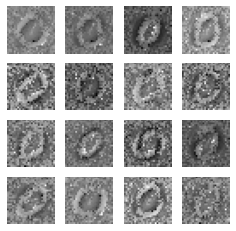

32
gen_loss: tf.Tensor(2.1485918, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12244806, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15753964, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.64150548e-01 3.58494520e-02]
 [9.96239901e-01 3.76008707e-03]
 [9.99040067e-01 9.59952245e-04]
 [9.93247867e-01 6.75211055e-03]
 [9.89521742e-01 1.04782730e-02]
 [9.76461172e-01 2.35388745e-02]
 [9.86865222e-01 1.31347505e-02]
 [7.49815166e-01 2.50184864e-01]
 [9.88566101e-01 1.14339218e-02]
 [9.02040362e-01 9.79596600e-02]
 [9.96454239e-01 3.54578206e-03]
 [9.96937513e-01 3.06250970e-03]
 [9.93137777e-01 6.86215563e-03]
 [9.97286320e-01 2.71373871e-03]
 [9.85972047e-01 1.40279755e-02]
 [9.71103311e-01 2.88966261e-02]
 [9.87182856e-01 1.28171109e-02]
 [9.82104242e-01 1.78957935e-02]
 [9.98723567e-01 1.27637782e-03]
 [9.72291827e-01 2.77081598e-02]
 [9.98671770e-01 1.32821139e-03]
 [9.96097684e-01 3.90227744e-03]
 [9.76243675e-01 2.37563420e-02]
 [9.95730460e-01 4

gen_loss: tf.Tensor(2.1061726, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13005559, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.17060894, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.68747914e-01 3.12520862e-02]
 [9.98049378e-01 1.95061043e-03]
 [9.97496784e-01 2.50323466e-03]
 [9.75249648e-01 2.47503035e-02]
 [9.72332239e-01 2.76677236e-02]
 [9.43353176e-01 5.66467904e-02]
 [9.66638625e-01 3.33614051e-02]
 [7.40440011e-01 2.59559929e-01]
 [9.63061988e-01 3.69380265e-02]
 [7.43781447e-01 2.56218523e-01]
 [9.95382369e-01 4.61763050e-03]
 [9.86339092e-01 1.36609208e-02]
 [9.85050797e-01 1.49492342e-02]
 [9.94147182e-01 5.85281756e-03]
 [9.57586467e-01 4.24134694e-02]
 [9.30790126e-01 6.92099035e-02]
 [9.67723906e-01 3.22761089e-02]
 [9.58791554e-01 4.12084796e-02]
 [9.97256339e-01 2.74367398e-03]
 [9.30813015e-01 6.91869259e-02]
 [9.96043921e-01 3.95615539e-03]
 [9.97889102e-01 2.11091386e-03]
 [9.31678712e-01 6.83212280e-02]
 [9.82364714e-01 1.76

gen_loss: tf.Tensor(2.1851726, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1213735, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16163263, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.82174933e-01 1.78250391e-02]
 [9.98217881e-01 1.78213872e-03]
 [9.98437464e-01 1.56259350e-03]
 [9.79891717e-01 2.01082993e-02]
 [9.77501154e-01 2.24987883e-02]
 [9.58875835e-01 4.11242060e-02]
 [9.74827588e-01 2.51724049e-02]
 [8.38257730e-01 1.61742181e-01]
 [9.66717958e-01 3.32820080e-02]
 [8.37036371e-01 1.62963569e-01]
 [9.97956395e-01 2.04364187e-03]
 [9.84952152e-01 1.50479013e-02]
 [9.88122761e-01 1.18771708e-02]
 [9.95645940e-01 4.35406016e-03]
 [9.62852716e-01 3.71472016e-02]
 [9.42766786e-01 5.72332256e-02]
 [9.76348519e-01 2.36514527e-02]
 [9.76687431e-01 2.33125761e-02]
 [9.98092234e-01 1.90780568e-03]
 [9.58754897e-01 4.12450321e-02]
 [9.97566700e-01 2.43328908e-03]
 [9.97632146e-01 2.36781291e-03]
 [9.56552863e-01 4.34471145e-02]
 [9.85462308e-01 1.453

gen_loss: tf.Tensor(2.2075424, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.168534, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1509083, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.61783230e-01 3.82167436e-02]
 [9.95341659e-01 4.65836329e-03]
 [9.98506129e-01 1.49384048e-03]
 [9.80038822e-01 1.99612025e-02]
 [9.70457435e-01 2.95426045e-02]
 [9.49553370e-01 5.04466444e-02]
 [9.69928145e-01 3.00718676e-02]
 [7.30069876e-01 2.69930154e-01]
 [9.62176085e-01 3.78238708e-02]
 [7.72385180e-01 2.27614865e-01]
 [9.96044636e-01 3.95542243e-03]
 [9.86944377e-01 1.30556365e-02]
 [9.86748695e-01 1.32513735e-02]
 [9.91675138e-01 8.32484383e-03]
 [9.61940646e-01 3.80593948e-02]
 [9.27914023e-01 7.20860139e-02]
 [9.69757140e-01 3.02428510e-02]
 [9.65522826e-01 3.44771445e-02]
 [9.97176647e-01 2.82335631e-03]
 [9.45077300e-01 5.49227484e-02]
 [9.97726619e-01 2.27338052e-03]
 [9.95076954e-01 4.92312293e-03]
 [9.42044437e-01 5.79555221e-02]
 [9.85830724e-01 1.41693

gen_loss: tf.Tensor(2.2227726, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.114886925, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1480964, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.39336538e-01 6.06634542e-02]
 [9.96966422e-01 3.03359097e-03]
 [9.96963084e-01 3.03690834e-03]
 [9.57190812e-01 4.28091697e-02]
 [9.39601362e-01 6.03986233e-02]
 [9.23990667e-01 7.60093853e-02]
 [9.26393628e-01 7.36064166e-02]
 [6.70711994e-01 3.29287946e-01]
 [9.06690001e-01 9.33099538e-02]
 [5.68823338e-01 4.31176722e-01]
 [9.91091251e-01 8.90877284e-03]
 [9.70092475e-01 2.99074911e-02]
 [9.73746955e-01 2.62530707e-02]
 [9.86185730e-01 1.38142817e-02]
 [9.09286022e-01 9.07139927e-02]
 [8.83014500e-01 1.16985425e-01]
 [9.37947571e-01 6.20525032e-02]
 [9.30565834e-01 6.94341362e-02]
 [9.93605494e-01 6.39444683e-03]
 [8.69030774e-01 1.30969226e-01]
 [9.93404329e-01 6.59564231e-03]
 [9.97454464e-01 2.54555536e-03]
 [8.46823812e-01 1.53176144e-01]
 [9.68528330e-01 3.14

gen_loss: tf.Tensor(2.2189972, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18354566, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.145387, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.56136823e-01 4.38632034e-02]
 [9.95466352e-01 4.53365827e-03]
 [9.99131024e-01 8.69015406e-04]
 [9.93171811e-01 6.82816980e-03]
 [9.83386457e-01 1.66135449e-02]
 [9.81089771e-01 1.89101975e-02]
 [9.77592945e-01 2.24069823e-02]
 [7.46750236e-01 2.53249764e-01]
 [9.75255311e-01 2.47446764e-02]
 [9.09952402e-01 9.00475979e-02]
 [9.96811450e-01 3.18858121e-03]
 [9.96068835e-01 3.93112702e-03]
 [9.85173762e-01 1.48261581e-02]
 [9.96027589e-01 3.97237716e-03]
 [9.77171063e-01 2.28289273e-02]
 [9.67403054e-01 3.25970091e-02]
 [9.83515143e-01 1.64848343e-02]
 [9.82913315e-01 1.70867033e-02]
 [9.97571290e-01 2.42872257e-03]
 [9.67922390e-01 3.20775732e-02]
 [9.98155534e-01 1.84442732e-03]
 [9.96612370e-01 3.38765769e-03]
 [9.65250373e-01 3.47496420e-02]
 [9.95155931e-01 4.8441

test_discriminator_output: tf.Tensor(
[[9.57945287e-01 4.20546941e-02]
 [9.95299697e-01 4.70027654e-03]
 [9.99348342e-01 6.51603099e-04]
 [9.95291471e-01 4.70860302e-03]
 [9.86883461e-01 1.31165115e-02]
 [9.83440995e-01 1.65589843e-02]
 [9.82531369e-01 1.74686890e-02]
 [7.27394938e-01 2.72605002e-01]
 [9.82634008e-01 1.73659623e-02]
 [9.24189746e-01 7.58102909e-02]
 [9.96918201e-01 3.08176503e-03]
 [9.97437358e-01 2.56264489e-03]
 [9.85797465e-01 1.42024970e-02]
 [9.96566534e-01 3.43343266e-03]
 [9.84362841e-01 1.56372190e-02]
 [9.73614812e-01 2.63851508e-02]
 [9.85895693e-01 1.41043412e-02]
 [9.86451149e-01 1.35488492e-02]
 [9.97990489e-01 2.00949004e-03]
 [9.75030303e-01 2.49696411e-02]
 [9.98609304e-01 1.39063259e-03]
 [9.96447146e-01 3.55287036e-03]
 [9.72777545e-01 2.72224154e-02]
 [9.96634662e-01 3.36537790e-03]
 [9.96470451e-01 3.52955121e-03]
 [9.82448816e-01 1.75511371e-02]
 [9.86547470e-01 1.34525085e-02]
 [9.54056978e-01 4.59430143e-02]
 [7.96929777e-01 2.03070238e-01]
 [9.8

gen_loss: tf.Tensor(2.2188678, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12498601, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14058892, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.58771706e-01 4.12282534e-02]
 [9.98388052e-01 1.61198049e-03]
 [9.98651683e-01 1.34830957e-03]
 [9.81527269e-01 1.84727684e-02]
 [9.65992153e-01 3.40078287e-02]
 [9.48684156e-01 5.13158329e-02]
 [9.52917159e-01 4.70827706e-02]
 [6.90194011e-01 3.09806049e-01]
 [9.53582406e-01 4.64176163e-02]
 [6.51797295e-01 3.48202705e-01]
 [9.92588520e-01 7.41140638e-03]
 [9.86792326e-01 1.32077243e-02]
 [9.75492597e-01 2.45074201e-02]
 [9.92949963e-01 7.05004297e-03]
 [9.59333718e-01 4.06662785e-02]
 [9.32925642e-01 6.70743510e-02]
 [9.53250051e-01 4.67499197e-02]
 [9.66744661e-01 3.32552679e-02]
 [9.96219099e-01 3.78091610e-03]
 [9.21395540e-01 7.86045119e-02]
 [9.96300936e-01 3.69899999e-03]
 [9.98466372e-01 1.53369457e-03]
 [9.02811468e-01 9.71885026e-02]
 [9.86127615e-01 1.38

gen_loss: tf.Tensor(2.2763643, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13467327, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14313293, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.73878682e-01 2.61213910e-02]
 [9.98794198e-01 1.20577519e-03]
 [9.99133646e-01 8.66344490e-04]
 [9.89852726e-01 1.01472521e-02]
 [9.81274545e-01 1.87254865e-02]
 [9.71929073e-01 2.80709770e-02]
 [9.71673727e-01 2.83262506e-02]
 [7.68428564e-01 2.31571436e-01]
 [9.72346485e-01 2.76535321e-02]
 [8.10741425e-01 1.89258561e-01]
 [9.95911598e-01 4.08844091e-03]
 [9.92732584e-01 7.26745510e-03]
 [9.76927996e-01 2.30720732e-02]
 [9.96995449e-01 3.00461310e-03]
 [9.75211680e-01 2.47882716e-02]
 [9.63294208e-01 3.67057137e-02]
 [9.74568367e-01 2.54316591e-02]
 [9.85367596e-01 1.46323312e-02]
 [9.97636557e-01 2.36345106e-03]
 [9.59742785e-01 4.02571894e-02]
 [9.97687697e-01 2.31230399e-03]
 [9.98588264e-01 1.41165371e-03]
 [9.52980399e-01 4.70196418e-02]
 [9.92243350e-01 7.75

test_discriminator_output: tf.Tensor(
[[9.7332507e-01 2.6674943e-02]
 [9.9853849e-01 1.4615302e-03]
 [9.9910516e-01 8.9477538e-04]
 [9.9284792e-01 7.1520265e-03]
 [9.8595053e-01 1.4049532e-02]
 [9.8098695e-01 1.9013019e-02]
 [9.7675484e-01 2.3245169e-02]
 [7.6625383e-01 2.3374620e-01]
 [9.7754514e-01 2.2454925e-02]
 [8.8395536e-01 1.1604465e-01]
 [9.9655318e-01 3.4467916e-03]
 [9.9578178e-01 4.2181825e-03]
 [9.7188628e-01 2.8113773e-02]
 [9.9772888e-01 2.2711353e-03]
 [9.7920680e-01 2.0793255e-02]
 [9.7420472e-01 2.5795287e-02]
 [9.8239279e-01 1.7607210e-02]
 [9.8997039e-01 1.0029627e-02]
 [9.9759442e-01 2.4055946e-03]
 [9.7059160e-01 2.9408330e-02]
 [9.9786001e-01 2.1399332e-03]
 [9.9840754e-01 1.5924475e-03]
 [9.6731168e-01 3.2688346e-02]
 [9.9459559e-01 5.4044183e-03]
 [9.9595731e-01 4.0426170e-03]
 [9.8699111e-01 1.3008939e-02]
 [9.7546321e-01 2.4536820e-02]
 [9.5348907e-01 4.6510965e-02]
 [7.5676280e-01 2.4323723e-01]
 [9.7712266e-01 2.2877339e-02]
 [9.9863845e-01 1.3615646e-03]
 

gen_loss: tf.Tensor(2.2779508, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1179121, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13355692, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.69620883e-01 3.03791519e-02]
 [9.97950017e-01 2.05001165e-03]
 [9.98640954e-01 1.35908369e-03]
 [9.94012892e-01 5.98709146e-03]
 [9.88681078e-01 1.13189127e-02]
 [9.83494937e-01 1.65050086e-02]
 [9.78548050e-01 2.14519501e-02]
 [7.60104835e-01 2.39895180e-01]
 [9.78697836e-01 2.13021990e-02]
 [9.09256518e-01 9.07434747e-02]
 [9.96592581e-01 3.40743456e-03]
 [9.96773899e-01 3.22612259e-03]
 [9.64400947e-01 3.55990678e-02]
 [9.97607231e-01 2.39276653e-03]
 [9.80339706e-01 1.96602605e-02]
 [9.78140354e-01 2.18596943e-02]
 [9.86129463e-01 1.38705149e-02]
 [9.92322922e-01 7.67710619e-03]
 [9.97258663e-01 2.74133682e-03]
 [9.73891973e-01 2.61079501e-02]
 [9.97429192e-01 2.57075671e-03]
 [9.98079658e-01 1.92030007e-03]
 [9.75535810e-01 2.44642422e-02]
 [9.95544136e-01 4.455

gen_loss: tf.Tensor(2.27815, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15678489, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13544041, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.77930069e-01 2.20699720e-02]
 [9.98375177e-01 1.62485417e-03]
 [9.98598874e-01 1.40117458e-03]
 [9.94075060e-01 5.92494896e-03]
 [9.89900053e-01 1.00999307e-02]
 [9.77023304e-01 2.29767170e-02]
 [9.80993152e-01 1.90068390e-02]
 [8.36918592e-01 1.63081437e-01]
 [9.81484175e-01 1.85157768e-02]
 [8.93050075e-01 1.06949911e-01]
 [9.97066677e-01 2.93336972e-03]
 [9.95195568e-01 4.80446732e-03]
 [9.81024384e-01 1.89756136e-02]
 [9.96841550e-01 3.15848459e-03]
 [9.83667016e-01 1.63330026e-02]
 [9.73475993e-01 2.65239719e-02]
 [9.85708594e-01 1.42913610e-02]
 [9.93458807e-01 6.54119160e-03]
 [9.98205900e-01 1.79413625e-03]
 [9.74525034e-01 2.54750457e-02]
 [9.97503340e-01 2.49661133e-03]
 [9.98276949e-01 1.72302558e-03]
 [9.80296075e-01 1.97039992e-02]
 [9.95517910e-01 4.4821

gen_loss: tf.Tensor(2.2572575, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17996296, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14034009, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.91856694e-01 8.14336725e-03]
 [9.99434650e-01 5.65288588e-04]
 [9.98854637e-01 1.14532514e-03]
 [9.96525466e-01 3.47448071e-03]
 [9.95071650e-01 4.92833415e-03]
 [9.88743305e-01 1.12566864e-02]
 [9.88462508e-01 1.15374392e-02]
 [9.01433527e-01 9.85664725e-02]
 [9.89162564e-01 1.08374842e-02]
 [9.68027174e-01 3.19728144e-02]
 [9.98627543e-01 1.37248635e-03]
 [9.96611059e-01 3.38892639e-03]
 [9.76683199e-01 2.33168341e-02]
 [9.98579025e-01 1.42096577e-03]
 [9.89645481e-01 1.03545934e-02]
 [9.85490203e-01 1.45097766e-02]
 [9.90668833e-01 9.33118258e-03]
 [9.97745693e-01 2.25422345e-03]
 [9.98921514e-01 1.07848842e-03]
 [9.89307463e-01 1.06925480e-02]
 [9.97428596e-01 2.57139630e-03]
 [9.99478042e-01 5.21963811e-04]
 [9.90669012e-01 9.33094881e-03]
 [9.97272074e-01 2.72

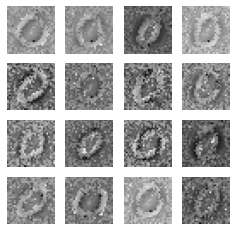

33
gen_loss: tf.Tensor(2.2261505, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17069864, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15923458, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.88020599e-01 1.19793648e-02]
 [9.99133170e-01 8.66843737e-04]
 [9.98643339e-01 1.35667832e-03]
 [9.96749163e-01 3.25082685e-03]
 [9.95232165e-01 4.76783141e-03]
 [9.86812413e-01 1.31875528e-02]
 [9.88506198e-01 1.14938328e-02]
 [8.17500651e-01 1.82499334e-01]
 [9.90009964e-01 9.99005325e-03]
 [9.61306214e-01 3.86937559e-02]
 [9.97426450e-01 2.57354463e-03]
 [9.97479260e-01 2.52072373e-03]
 [9.66009796e-01 3.39902192e-02]
 [9.98026073e-01 1.97394146e-03]
 [9.90764976e-01 9.23495740e-03]
 [9.84540641e-01 1.54593503e-02]
 [9.88311589e-01 1.16883423e-02]
 [9.97053742e-01 2.94627040e-03]
 [9.98651326e-01 1.34866207e-03]
 [9.87921000e-01 1.20789725e-02]
 [9.97019589e-01 2.98043760e-03]
 [9.99409556e-01 5.90425043e-04]
 [9.88958240e-01 1.10417996e-02]
 [9.97504532e-01 2

gen_loss: tf.Tensor(2.2466602, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13278538, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16145912, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.84336257e-01 1.56637207e-02]
 [9.97669756e-01 2.33026640e-03]
 [9.98669982e-01 1.32997974e-03]
 [9.96752262e-01 3.24776000e-03]
 [9.96158183e-01 3.84180830e-03]
 [9.79353249e-01 2.06468012e-02]
 [9.90751982e-01 9.24800802e-03]
 [7.25901902e-01 2.74098158e-01]
 [9.91397381e-01 8.60255677e-03]
 [9.06711280e-01 9.32887420e-02]
 [9.95962083e-01 4.03792830e-03]
 [9.97195244e-01 2.80469446e-03]
 [9.70658243e-01 2.93417331e-02]
 [9.96756732e-01 3.24332039e-03]
 [9.92761135e-01 7.23893009e-03]
 [9.80963349e-01 1.90366060e-02]
 [9.85335231e-01 1.46648409e-02]
 [9.95201826e-01 4.79822466e-03]
 [9.98941839e-01 1.05817872e-03]
 [9.84254479e-01 1.57454722e-02]
 [9.98100340e-01 1.89971470e-03]
 [9.98733819e-01 1.26616936e-03]
 [9.87425625e-01 1.25744129e-02]
 [9.97640252e-01 2.35

gen_loss: tf.Tensor(2.1863441, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10916042, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1609934, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.95286822e-01 4.71313205e-03]
 [9.99128282e-01 8.71677417e-04]
 [9.99249637e-01 7.50378356e-04]
 [9.97466683e-01 2.53328285e-03]
 [9.97882307e-01 2.11769273e-03]
 [9.88902628e-01 1.10973706e-02]
 [9.94470239e-01 5.52971009e-03]
 [9.22800303e-01 7.71996900e-02]
 [9.92806435e-01 7.19350483e-03]
 [9.42888677e-01 5.71113117e-02]
 [9.98909593e-01 1.09043147e-03]
 [9.96441305e-01 3.55868554e-03]
 [9.75019455e-01 2.49805450e-02]
 [9.98793364e-01 1.20663107e-03]
 [9.94158864e-01 5.84109826e-03]
 [9.89558935e-01 1.04410108e-02]
 [9.92693543e-01 7.30643608e-03]
 [9.97913897e-01 2.08612229e-03]
 [9.99500751e-01 4.99193964e-04]
 [9.91352320e-01 8.64772964e-03]
 [9.98902202e-01 1.09773711e-03]
 [9.99402285e-01 5.97725739e-04]
 [9.92769003e-01 7.23105250e-03]
 [9.98080492e-01 1.919

gen_loss: tf.Tensor(2.2208476, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.19642445, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.16143796, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.96092975e-01 3.90698481e-03]
 [9.99340355e-01 6.59660145e-04]
 [9.99437869e-01 5.62109519e-04]
 [9.98505235e-01 1.49482244e-03]
 [9.98342991e-01 1.65699515e-03]
 [9.92457390e-01 7.54259573e-03]
 [9.96144891e-01 3.85514391e-03]
 [9.48381722e-01 5.16182370e-02]
 [9.95251298e-01 4.74864151e-03]
 [9.70501781e-01 2.94982269e-02]
 [9.99227047e-01 7.72971252e-04]
 [9.98297155e-01 1.70291378e-03]
 [9.66551065e-01 3.34489271e-02]
 [9.98480380e-01 1.51965965e-03]
 [9.96127188e-01 3.87287769e-03]
 [9.93569255e-01 6.43078657e-03]
 [9.96001661e-01 3.99833871e-03]
 [9.98578787e-01 1.42125413e-03]
 [9.99514580e-01 4.85463475e-04]
 [9.94902253e-01 5.09768445e-03]
 [9.98600900e-01 1.39916386e-03]
 [9.99605715e-01 3.94337054e-04]
 [9.95394886e-01 4.60503623e-03]
 [9.98812556e-01 1.18

test_discriminator_output: tf.Tensor(
[[9.94573414e-01 5.42658288e-03]
 [9.98808146e-01 1.19187869e-03]
 [9.99620199e-01 3.79817560e-04]
 [9.99175251e-01 8.24762275e-04]
 [9.98667955e-01 1.33205240e-03]
 [9.92811739e-01 7.18821818e-03]
 [9.97331262e-01 2.66870647e-03]
 [9.37834322e-01 6.21657036e-02]
 [9.97317135e-01 2.68290890e-03]
 [9.78154302e-01 2.18457133e-02]
 [9.99141455e-01 8.58475862e-04]
 [9.99230862e-01 7.69095437e-04]
 [9.74404693e-01 2.55953092e-02]
 [9.97730196e-01 2.26979912e-03]
 [9.97858942e-01 2.14105775e-03]
 [9.94748890e-01 5.25106909e-03]
 [9.97197032e-01 2.80291587e-03]
 [9.98670936e-01 1.32908579e-03]
 [9.99590814e-01 4.09158878e-04]
 [9.96385098e-01 3.61486385e-03]
 [9.98867273e-01 1.13274436e-03]
 [9.99343574e-01 6.56420947e-04]
 [9.96946156e-01 3.05387285e-03]
 [9.99339759e-01 6.60189136e-04]
 [9.99097109e-01 9.02906409e-04]
 [9.97158051e-01 2.84190546e-03]
 [9.98306036e-01 1.69400091e-03]
 [9.76989746e-01 2.30102129e-02]
 [4.69920009e-01 5.30080080e-01]
 [9.9

gen_loss: tf.Tensor(2.3384917, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18605682, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14023009, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.89943266e-01 1.00567499e-02]
 [9.98798251e-01 1.20179064e-03]
 [9.99655843e-01 3.44128668e-04]
 [9.98615503e-01 1.38448412e-03]
 [9.97471690e-01 2.52837525e-03]
 [9.85155046e-01 1.48449978e-02]
 [9.95624006e-01 4.37600818e-03]
 [9.14083958e-01 8.59160125e-02]
 [9.96408641e-01 3.59130488e-03]
 [9.53455567e-01 4.65443730e-02]
 [9.98019814e-01 1.98020390e-03]
 [9.98804927e-01 1.19504076e-03]
 [9.80738580e-01 1.92613937e-02]
 [9.94423807e-01 5.57619054e-03]
 [9.97083485e-01 2.91654048e-03]
 [9.90561306e-01 9.43866931e-03]
 [9.95191216e-01 4.80880123e-03]
 [9.97430503e-01 2.56947917e-03]
 [9.99388814e-01 6.11203373e-04]
 [9.93639290e-01 6.36064913e-03]
 [9.98868644e-01 1.13136729e-03]
 [9.99267995e-01 7.31989043e-04]
 [9.94501829e-01 5.49813965e-03]
 [9.98857617e-01 1.14

gen_loss: tf.Tensor(2.2357602, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17711246, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.15142643, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.93180156e-01 6.81986148e-03]
 [9.99580443e-01 4.19601129e-04]
 [9.99645352e-01 3.54662334e-04]
 [9.96235073e-01 3.76496697e-03]
 [9.96043086e-01 3.95691441e-03]
 [9.80497479e-01 1.95024777e-02]
 [9.92670417e-01 7.32963812e-03]
 [9.44974422e-01 5.50255924e-02]
 [9.92677808e-01 7.32217869e-03]
 [9.26713824e-01 7.32861310e-02]
 [9.98302341e-01 1.69766566e-03]
 [9.95305300e-01 4.69472772e-03]
 [9.83459055e-01 1.65409390e-02]
 [9.96705711e-01 3.29432427e-03]
 [9.93768334e-01 6.23170845e-03]
 [9.86074626e-01 1.39253354e-02]
 [9.92023110e-01 7.97689799e-03]
 [9.96936440e-01 3.06350994e-03]
 [9.99287903e-01 7.12075969e-04]
 [9.90947306e-01 9.05265007e-03]
 [9.99103963e-01 8.95949313e-04]
 [9.99647260e-01 3.52723611e-04]
 [9.90331531e-01 9.66843590e-03]
 [9.96785760e-01 3.21

gen_loss: tf.Tensor(2.2842689, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11668216, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14316308, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.92520690e-01 7.47929607e-03]
 [9.98815060e-01 1.18492940e-03]
 [9.99700904e-01 2.99085194e-04]
 [9.98285592e-01 1.71441876e-03]
 [9.97990370e-01 2.00969097e-03]
 [9.89030182e-01 1.09698260e-02]
 [9.96262848e-01 3.73713998e-03]
 [9.08296108e-01 9.17038172e-02]
 [9.96316433e-01 3.68348579e-03]
 [9.70466852e-01 2.95331404e-02]
 [9.98749852e-01 1.25011418e-03]
 [9.98395741e-01 1.60429557e-03]
 [9.81384993e-01 1.86150689e-02]
 [9.98209357e-01 1.79065694e-03]
 [9.97004688e-01 2.99533550e-03]
 [9.92786705e-01 7.21326005e-03]
 [9.95567262e-01 4.43269592e-03]
 [9.97866571e-01 2.13342486e-03]
 [9.99430001e-01 5.69951895e-04]
 [9.95877385e-01 4.12264699e-03]
 [9.99272048e-01 7.27898441e-04]
 [9.99300480e-01 6.99505792e-04]
 [9.95193303e-01 4.80669737e-03]
 [9.98615384e-01 1.38

test_discriminator_output: tf.Tensor(
[[9.92265224e-01 7.73482863e-03]
 [9.98281837e-01 1.71818433e-03]
 [9.99666572e-01 3.33384873e-04]
 [9.98522699e-01 1.47737877e-03]
 [9.98260081e-01 1.73988671e-03]
 [9.87854898e-01 1.21451337e-02]
 [9.96785760e-01 3.21421493e-03]
 [8.89183342e-01 1.10816695e-01]
 [9.96889293e-01 3.11073079e-03]
 [9.68003631e-01 3.19963805e-02]
 [9.98727858e-01 1.27216289e-03]
 [9.98611569e-01 1.38841220e-03]
 [9.81296360e-01 1.87036116e-02]
 [9.98000085e-01 1.99985644e-03]
 [9.97576058e-01 2.42395024e-03]
 [9.92950082e-01 7.04995263e-03]
 [9.95590568e-01 4.40941658e-03]
 [9.97678578e-01 2.32138718e-03]
 [9.99485493e-01 5.14465733e-04]
 [9.96284842e-01 3.71508393e-03]
 [9.99068201e-01 9.31779738e-04]
 [9.99138474e-01 8.61528853e-04]
 [9.95656729e-01 4.34323540e-03]
 [9.98840988e-01 1.15901558e-03]
 [9.98360932e-01 1.63909886e-03]
 [9.96411741e-01 3.58827598e-03]
 [9.96182978e-01 3.81701533e-03]
 [9.57118511e-01 4.28814106e-02]
 [8.68139923e-01 1.31860048e-01]
 [9.9

gen_loss: tf.Tensor(2.3015966, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.17661045, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13959754, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.94974256e-01 5.02569182e-03]
 [9.99277413e-01 7.22560217e-04]
 [9.99620318e-01 3.79627862e-04]
 [9.98069346e-01 1.93063938e-03]
 [9.98242378e-01 1.75766647e-03]
 [9.83054459e-01 1.69455465e-02]
 [9.96786237e-01 3.21371364e-03]
 [9.26233709e-01 7.37662464e-02]
 [9.97017503e-01 2.98257545e-03]
 [9.51573670e-01 4.84263338e-02]
 [9.98753905e-01 1.24606164e-03]
 [9.97796178e-01 2.20386079e-03]
 [9.83095884e-01 1.69040933e-02]
 [9.98309612e-01 1.69037667e-03]
 [9.97782648e-01 2.21736636e-03]
 [9.91280496e-01 8.71947501e-03]
 [9.94078994e-01 5.92104113e-03]
 [9.97627556e-01 2.37244810e-03]
 [9.99616504e-01 3.83475446e-04]
 [9.95714962e-01 4.28501237e-03]
 [9.98105288e-01 1.89465343e-03]
 [9.99604762e-01 3.95208626e-04]
 [9.94938731e-01 5.06132655e-03]
 [9.98522103e-01 1.47

gen_loss: tf.Tensor(2.2940874, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.099336535, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.14847583, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.96695280e-01 3.30473646e-03]
 [9.99428213e-01 5.71699115e-04]
 [9.99804676e-01 1.95309360e-04]
 [9.99089718e-01 9.10263334e-04]
 [9.99066651e-01 9.33345349e-04]
 [9.92468536e-01 7.53148552e-03]
 [9.98367488e-01 1.63252943e-03]
 [9.61383343e-01 3.86166871e-02]
 [9.98568773e-01 1.43125479e-03]
 [9.85325158e-01 1.46748479e-02]
 [9.99398947e-01 6.01075822e-04]
 [9.98970628e-01 1.02940225e-03]
 [9.88535583e-01 1.14644626e-02]
 [9.99316335e-01 6.83693914e-04]
 [9.98886287e-01 1.11374306e-03]
 [9.95374143e-01 4.62587224e-03]
 [9.97205913e-01 2.79411091e-03]
 [9.99088287e-01 9.11685929e-04]
 [9.99745905e-01 2.54082726e-04]
 [9.98083949e-01 1.91601203e-03]
 [9.99137759e-01 8.62194400e-04]
 [9.99620557e-01 3.79381469e-04]
 [9.97873664e-01 2.12633074e-03]
 [9.99293685e-01 7.0

gen_loss: tf.Tensor(2.2971163, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14377017, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1322734, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.95988429e-01 4.01153881e-03]
 [9.99195158e-01 8.04893614e-04]
 [9.99863863e-01 1.36088885e-04]
 [9.99525785e-01 4.74252680e-04]
 [9.99338329e-01 6.61677564e-04]
 [9.95449841e-01 4.55017900e-03]
 [9.99067008e-01 9.32990573e-04]
 [9.52716827e-01 4.72831242e-02]
 [9.99283850e-01 7.16129958e-04]
 [9.93754745e-01 6.24527736e-03]
 [9.99437034e-01 5.62992645e-04]
 [9.99648452e-01 3.51493858e-04]
 [9.85407650e-01 1.45923253e-02]
 [9.99343693e-01 6.56257733e-04]
 [9.99404669e-01 5.95385558e-04]
 [9.96866763e-01 3.13326134e-03]
 [9.98292983e-01 1.70704979e-03]
 [9.99401331e-01 5.98665385e-04]
 [9.99711335e-01 2.88664218e-04]
 [9.98886764e-01 1.11324620e-03]
 [9.99334872e-01 6.65135740e-04]
 [9.99514580e-01 4.85389406e-04]
 [9.98692930e-01 1.30714721e-03]
 [9.99630213e-01 3.697

gen_loss: tf.Tensor(2.26791, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1187031, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13868132, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.95942056e-01 4.05787444e-03]
 [9.99349535e-01 6.50466769e-04]
 [9.99834180e-01 1.65823760e-04]
 [9.99345601e-01 6.54341013e-04]
 [9.99173582e-01 8.26334290e-04]
 [9.93096292e-01 6.90366141e-03]
 [9.98974562e-01 1.02543505e-03]
 [9.49883580e-01 5.01163900e-02]
 [9.99203622e-01 7.96413457e-04]
 [9.88040507e-01 1.19595155e-02]
 [9.99313831e-01 6.86218904e-04]
 [9.99484658e-01 5.15366672e-04]
 [9.83892441e-01 1.61075126e-02]
 [9.99022245e-01 9.77798481e-04]
 [9.99341786e-01 6.58190052e-04]
 [9.95671511e-01 4.32846136e-03]
 [9.97567654e-01 2.43235542e-03]
 [9.99128401e-01 8.71646800e-04]
 [9.99689460e-01 3.10588017e-04]
 [9.98522818e-01 1.47723884e-03]
 [9.99008894e-01 9.91125358e-04]
 [9.99613941e-01 3.86105385e-04]
 [9.98189509e-01 1.81044452e-03]
 [9.99489903e-01 5.10036

gen_loss: tf.Tensor(2.281405, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.124649994, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13848324, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.96356726e-01 3.64334462e-03]
 [9.99518991e-01 4.81039053e-04]
 [9.99803364e-01 1.96690627e-04]
 [9.99046981e-01 9.52997245e-04]
 [9.98993218e-01 1.00682303e-03]
 [9.89339888e-01 1.06600663e-02]
 [9.98871863e-01 1.12811918e-03]
 [9.56027329e-01 4.39726524e-02]
 [9.99066293e-01 9.33693140e-04]
 [9.75211799e-01 2.47882586e-02]
 [9.99266446e-01 7.33559253e-04]
 [9.99078631e-01 9.21311555e-04]
 [9.85632539e-01 1.43674864e-02]
 [9.98706341e-01 1.29366620e-03]
 [9.99245882e-01 7.54180015e-04]
 [9.93846357e-01 6.15365990e-03]
 [9.96425092e-01 3.57490056e-03]
 [9.98781979e-01 1.21802918e-03]
 [9.99705732e-01 2.94273457e-04]
 [9.98018742e-01 1.98127469e-03]
 [9.98671174e-01 1.32883014e-03]
 [9.99700546e-01 2.99528096e-04]
 [9.97484565e-01 2.51545873e-03]
 [9.99255359e-01 7.44

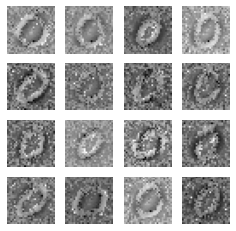

34
gen_loss: tf.Tensor(2.328019, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13595062, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13039827, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97309327e-01 2.69063376e-03]
 [9.99606550e-01 3.93427414e-04]
 [9.99818981e-01 1.81025505e-04]
 [9.99025106e-01 9.74902650e-04]
 [9.99105036e-01 8.94887897e-04]
 [9.88564670e-01 1.14353392e-02]
 [9.99064028e-01 9.35968419e-04]
 [9.70916152e-01 2.90838759e-02]
 [9.99127924e-01 8.72034696e-04]
 [9.67985213e-01 3.20148058e-02]
 [9.99478400e-01 5.21657465e-04]
 [9.98721659e-01 1.27832813e-03]
 [9.89420295e-01 1.05796894e-02]
 [9.98830974e-01 1.16908539e-03]
 [9.99322653e-01 6.77362026e-04]
 [9.93533254e-01 6.46671792e-03]
 [9.96333361e-01 3.66661465e-03]
 [9.98809218e-01 1.19074783e-03]
 [9.99786913e-01 2.13057079e-04]
 [9.98184144e-01 1.81586423e-03]
 [9.98739898e-01 1.26013346e-03]
 [9.99738514e-01 2.61448673e-04]
 [9.97669876e-01 2.33015791e-03]
 [9.99236584e-01 7.

gen_loss: tf.Tensor(2.3167207, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11811839, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12803695, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97876406e-01 2.12362898e-03]
 [9.99538422e-01 4.61564923e-04]
 [9.99863863e-01 1.36121191e-04]
 [9.99335110e-01 6.64912630e-04]
 [9.99392509e-01 6.07452355e-04]
 [9.93658245e-01 6.34172745e-03]
 [9.99412894e-01 5.87101327e-04]
 [9.81789887e-01 1.82101522e-02]
 [9.99282897e-01 7.17163668e-04]
 [9.81182158e-01 1.88178923e-02]
 [9.99728978e-01 2.70962337e-04]
 [9.98985827e-01 1.01419899e-03]
 [9.91077542e-01 8.92245024e-03]
 [9.99373496e-01 6.26547320e-04]
 [9.99462664e-01 5.37335523e-04]
 [9.95773852e-01 4.22612578e-03]
 [9.97528374e-01 2.47168983e-03]
 [9.99173939e-01 8.26086791e-04]
 [9.99831438e-01 1.68547602e-04]
 [9.98892486e-01 1.10753102e-03]
 [9.99185622e-01 8.14388797e-04]
 [9.99710977e-01 2.89037678e-04]
 [9.98455882e-01 1.54409918e-03]
 [9.99483585e-01 5.16

test_discriminator_output: tf.Tensor(
[[9.9751580e-01 2.4841949e-03]
 [9.9935824e-01 6.4171379e-04]
 [9.9985147e-01 1.4847305e-04]
 [9.9934024e-01 6.5978285e-04]
 [9.9937111e-01 6.2891742e-04]
 [9.9462444e-01 5.3754887e-03]
 [9.9939239e-01 6.0762290e-04]
 [9.8039448e-01 1.9605532e-02]
 [9.9918312e-01 8.1691792e-04]
 [9.8361939e-01 1.6380599e-02]
 [9.9973017e-01 2.6979664e-04]
 [9.9905008e-01 9.4986847e-04]
 [9.8987645e-01 1.0123586e-02]
 [9.9937952e-01 6.2041666e-04]
 [9.9938941e-01 6.1052979e-04]
 [9.9611628e-01 3.8837017e-03]
 [9.9763119e-01 2.3687468e-03]
 [9.9916029e-01 8.3970028e-04]
 [9.9978131e-01 2.1865987e-04]
 [9.9891949e-01 1.0804794e-03]
 [9.9926609e-01 7.3387555e-04]
 [9.9963820e-01 3.6184076e-04]
 [9.9839371e-01 1.6063025e-03]
 [9.9949276e-01 5.0718745e-04]
 [9.9893695e-01 1.0630651e-03]
 [9.9929988e-01 7.0012605e-04]
 [9.9815458e-01 1.8453916e-03]
 [9.8645473e-01 1.3545267e-02]
 [8.1513703e-01 1.8486299e-01]
 [9.9809533e-01 1.9046393e-03]
 [9.9979156e-01 2.0839728e-04]
 

gen_loss: tf.Tensor(2.3776507, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12248597, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11893826, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.96234119e-01 3.76591668e-03]
 [9.99285996e-01 7.14074005e-04]
 [9.99825060e-01 1.74943052e-04]
 [9.99168754e-01 8.31222394e-04]
 [9.99161720e-01 8.38343229e-04]
 [9.94222581e-01 5.77734457e-03]
 [9.99151468e-01 8.48489697e-04]
 [9.76966560e-01 2.30334643e-02]
 [9.98833597e-01 1.16638513e-03]
 [9.81251955e-01 1.87480263e-02]
 [9.99579251e-01 4.20789176e-04]
 [9.98944581e-01 1.05549069e-03]
 [9.87906098e-01 1.20938951e-02]
 [9.99279320e-01 7.20667013e-04]
 [9.99122918e-01 8.77042767e-04]
 [9.95822072e-01 4.17793449e-03]
 [9.96753156e-01 3.24680889e-03]
 [9.98969197e-01 1.03075302e-03]
 [9.99627829e-01 3.72109091e-04]
 [9.98605907e-01 1.39416137e-03]
 [9.99130666e-01 8.69378215e-04]
 [9.99665260e-01 3.34760145e-04]
 [9.97711658e-01 2.28833570e-03]
 [9.99368012e-01 6.31

disc_real_loss: tf.Tensor(0.10435073, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.122733355, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97076273e-01 2.92375009e-03]
 [9.99330401e-01 6.69570873e-04]
 [9.99899387e-01 1.00645841e-04]
 [9.99583066e-01 4.16919123e-04]
 [9.99475300e-01 5.24663832e-04]
 [9.96415615e-01 3.58441845e-03]
 [9.99483109e-01 5.16847824e-04]
 [9.84108269e-01 1.58916935e-02]
 [9.99338210e-01 6.61761092e-04]
 [9.90751386e-01 9.24856309e-03]
 [9.99733031e-01 2.67002295e-04]
 [9.99427617e-01 5.72383986e-04]
 [9.92357552e-01 7.64242280e-03]
 [9.99563754e-01 4.36221017e-04]
 [9.99507785e-01 4.92168940e-04]
 [9.97351289e-01 2.64867721e-03]
 [9.97928977e-01 2.07100995e-03]
 [9.99422431e-01 5.77637111e-04]
 [9.99773324e-01 2.26738994e-04]
 [9.99238729e-01 7.61316507e-04]
 [9.99481022e-01 5.19008958e-04]
 [9.99669075e-01 3.30926036e-04]
 [9.98825610e-01 1.17435283e-03]
 [9.99679923e-01 3.20065970e-04]
 [9.98937428e-01 1.06263033e-03]
 [9.994933

gen_loss: tf.Tensor(2.3855836, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10355224, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.124392755, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97858107e-01 2.14185659e-03]
 [9.99450862e-01 5.49131830e-04]
 [9.99938965e-01 6.10637435e-05]
 [9.99763668e-01 2.36357460e-04]
 [9.99652028e-01 3.47967725e-04]
 [9.97693241e-01 2.30677961e-03]
 [9.99658108e-01 3.41859384e-04]
 [9.89153326e-01 1.08466018e-02]
 [9.99590456e-01 4.09609289e-04]
 [9.95073378e-01 4.92663030e-03]
 [9.99826372e-01 1.73655542e-04]
 [9.99648690e-01 3.51354509e-04]
 [9.94695961e-01 5.30408835e-03]
 [9.99749482e-01 2.50545301e-04]
 [9.99694586e-01 3.05403955e-04]
 [9.98242497e-01 1.75755855e-03]
 [9.98586297e-01 1.41369877e-03]
 [9.99665022e-01 3.34966695e-04]
 [9.99857426e-01 1.42530203e-04]
 [9.99548852e-01 4.51083703e-04]
 [9.99664068e-01 3.35884135e-04]
 [9.99713242e-01 2.86721188e-04]
 [9.99346197e-01 6.53757597e-04]
 [9.99815047e-01 1.8

gen_loss: tf.Tensor(2.369833, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11732542, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.117412195, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98293817e-01 1.70613651e-03]
 [9.99654889e-01 3.45099834e-04]
 [9.99946475e-01 5.34838291e-05]
 [9.99742925e-01 2.57084874e-04]
 [9.99628067e-01 3.71871836e-04]
 [9.97174859e-01 2.82515865e-03]
 [9.99643803e-01 3.56167002e-04]
 [9.90863204e-01 9.13680252e-03]
 [9.99591410e-01 4.08565684e-04]
 [9.94194925e-01 5.80512406e-03]
 [9.99821484e-01 1.78493268e-04]
 [9.99582112e-01 4.17835225e-04]
 [9.95418906e-01 4.58113011e-03]
 [9.99773562e-01 2.26423363e-04]
 [9.99698400e-01 3.01580876e-04]
 [9.98070896e-01 1.92911748e-03]
 [9.98268604e-01 1.73135567e-03]
 [9.99667406e-01 3.32576979e-04]
 [9.99876499e-01 1.23458711e-04]
 [9.99528766e-01 4.71308711e-04]
 [9.99655485e-01 3.44549218e-04]
 [9.99813259e-01 1.86809455e-04]
 [9.99328971e-01 6.71041838e-04]
 [9.99794662e-01 2.05

gen_loss: tf.Tensor(2.3881445, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13374302, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11914108, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.97921050e-01 2.07897439e-03]
 [9.99660015e-01 3.40009021e-04]
 [9.99939442e-01 6.05959067e-05]
 [9.99640942e-01 3.58994701e-04]
 [9.99462306e-01 5.37643151e-04]
 [9.95576978e-01 4.42301854e-03]
 [9.99517083e-01 4.82980278e-04]
 [9.87417936e-01 1.25820870e-02]
 [9.99470532e-01 5.29478712e-04]
 [9.90550280e-01 9.44967475e-03]
 [9.99710619e-01 2.89310032e-04]
 [9.99479234e-01 5.20822767e-04]
 [9.94690418e-01 5.30959060e-03]
 [9.99664783e-01 3.35240795e-04]
 [9.99622226e-01 3.77764314e-04]
 [9.97283220e-01 2.71677808e-03]
 [9.97429669e-01 2.57029687e-03]
 [9.99474943e-01 5.25034033e-04]
 [9.99845862e-01 1.54116875e-04]
 [9.99295354e-01 7.04619451e-04]
 [9.99561131e-01 4.38872288e-04]
 [9.99825299e-01 1.74745175e-04]
 [9.98994887e-01 1.00516120e-03]
 [9.99712169e-01 2.87

gen_loss: tf.Tensor(2.392343, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.107379474, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12030814, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9772507e-01 2.2748909e-03]
 [9.9955696e-01 4.4296775e-04]
 [9.9996126e-01 3.8691607e-05]
 [9.9970299e-01 2.9702761e-04]
 [9.9940908e-01 5.9088611e-04]
 [9.9512154e-01 4.8784004e-03]
 [9.9955875e-01 4.4129160e-04]
 [9.8563921e-01 1.4360728e-02]
 [9.9954128e-01 4.5877846e-04]
 [9.9079996e-01 9.2000375e-03]
 [9.9965167e-01 3.4834494e-04]
 [9.9962664e-01 3.7329897e-04]
 [9.9512154e-01 4.8784679e-03]
 [9.9961251e-01 3.8753875e-04]
 [9.9969411e-01 3.0591743e-04]
 [9.9720073e-01 2.7992893e-03]
 [9.9745268e-01 2.5473116e-03]
 [9.9933797e-01 6.6201692e-04]
 [9.9987292e-01 1.2705853e-04]
 [9.9929416e-01 7.0581509e-04]
 [9.9967480e-01 3.2523487e-04]
 [9.9976856e-01 2.3143781e-04]
 [9.9908268e-01 9.1728591e-04]
 [9.9976021e-01 2.3983409e-04]
 [9.9869365e-01 1.3063493e-03]
 [9.9

gen_loss: tf.Tensor(2.4324012, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.20276096, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11630449, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.98767853e-01 1.23216561e-03]
 [9.99744952e-01 2.55054794e-04]
 [9.99973416e-01 2.65593953e-05]
 [9.99789417e-01 2.10618207e-04]
 [9.99528885e-01 4.71143401e-04]
 [9.97518539e-01 2.48149061e-03]
 [9.99670982e-01 3.29051050e-04]
 [9.92777884e-01 7.22203031e-03]
 [9.99604762e-01 3.95239709e-04]
 [9.95638430e-01 4.36154939e-03]
 [9.99823749e-01 1.76334928e-04]
 [9.99722779e-01 2.77236075e-04]
 [9.93520558e-01 6.47944165e-03]
 [9.99802649e-01 1.97331348e-04]
 [9.99739707e-01 2.60290893e-04]
 [9.98321593e-01 1.67840708e-03]
 [9.98545051e-01 1.45502074e-03]
 [9.99590337e-01 4.09699482e-04]
 [9.99906182e-01 9.38282610e-05]
 [9.99561608e-01 4.38320189e-04]
 [9.99739945e-01 2.60058965e-04]
 [9.99851346e-01 1.48691397e-04]
 [9.99425411e-01 5.74644306e-04]
 [9.99828815e-01 1.71

gen_loss: tf.Tensor(2.3806462, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15362039, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12662512, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99150753e-01 8.49214790e-04]
 [9.99772251e-01 2.27758443e-04]
 [9.99979615e-01 2.03885629e-05]
 [9.99858022e-01 1.41956218e-04]
 [9.99674678e-01 3.25306813e-04]
 [9.98321235e-01 1.67877146e-03]
 [9.99767244e-01 2.32724095e-04]
 [9.95173752e-01 4.82623000e-03]
 [9.99701321e-01 2.98640138e-04]
 [9.97028053e-01 2.97193369e-03]
 [9.99893665e-01 1.06337364e-04]
 [9.99777496e-01 2.22468312e-04]
 [9.93968010e-01 6.03199285e-03]
 [9.99872327e-01 1.27700463e-04]
 [9.99801695e-01 1.98337526e-04]
 [9.98887360e-01 1.11263758e-03]
 [9.99019265e-01 9.80707351e-04]
 [9.99723852e-01 2.76165287e-04]
 [9.99936700e-01 6.32746742e-05]
 [9.99715626e-01 2.84379930e-04]
 [9.99800265e-01 1.99808768e-04]
 [9.99859452e-01 1.40487202e-04]
 [9.99642134e-01 3.57804674e-04]
 [9.99885559e-01 1.14

disc_real_loss: tf.Tensor(0.1154325, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12408389, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99228597e-01 7.71367049e-04]
 [9.99779165e-01 2.20852380e-04]
 [9.99976873e-01 2.31140912e-05]
 [9.99847770e-01 1.52257169e-04]
 [9.99662042e-01 3.38021026e-04]
 [9.98211741e-01 1.78823108e-03]
 [9.99752939e-01 2.47086777e-04]
 [9.95428443e-01 4.57150675e-03]
 [9.99669671e-01 3.30366835e-04]
 [9.96375620e-01 3.62435868e-03]
 [9.99898076e-01 1.01889113e-04]
 [9.99733627e-01 2.66401679e-04]
 [9.93001580e-01 6.99849473e-03]
 [9.99859452e-01 1.40491102e-04]
 [9.99778807e-01 2.21234906e-04]
 [9.98922348e-01 1.07762683e-03]
 [9.98995364e-01 1.00462406e-03]
 [9.99704540e-01 2.95482605e-04]
 [9.99938130e-01 6.18778940e-05]
 [9.99706089e-01 2.93937279e-04]
 [9.99766767e-01 2.33191211e-04]
 [9.99868751e-01 1.31256020e-04]
 [9.99636054e-01 3.63936153e-04]
 [9.99878883e-01 1.21061748e-04]
 [9.99387145e-01 6.12799544e-04]
 [9.99697924

gen_loss: tf.Tensor(2.3564389, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13885513, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12815738, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99216199e-01 7.83785654e-04]
 [9.99791801e-01 2.08185971e-04]
 [9.99972224e-01 2.78310017e-05]
 [9.99844193e-01 1.55773974e-04]
 [9.99637485e-01 3.62473744e-04]
 [9.98044848e-01 1.95515528e-03]
 [9.99730051e-01 2.69960554e-04]
 [9.95046735e-01 4.95324749e-03]
 [9.99648094e-01 3.51847033e-04]
 [9.95572805e-01 4.42718389e-03]
 [9.99888659e-01 1.11276815e-04]
 [9.99733031e-01 2.66956224e-04]
 [9.90854979e-01 9.14504286e-03]
 [9.99823749e-01 1.76284317e-04]
 [9.99760926e-01 2.39059693e-04]
 [9.98939455e-01 1.06055243e-03]
 [9.98914123e-01 1.08591130e-03]
 [9.99692321e-01 3.07682058e-04]
 [9.99933481e-01 6.65714324e-05]
 [9.99693155e-01 3.06883740e-04]
 [9.99671698e-01 3.28268332e-04]
 [9.99888420e-01 1.11578796e-04]
 [9.99613464e-01 3.86511412e-04]
 [9.99876857e-01 1.23

gen_loss: tf.Tensor(2.309823, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1186299, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13173717, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99082565e-01 9.17452911e-04]
 [9.99716938e-01 2.83093890e-04]
 [9.99978781e-01 2.12623272e-05]
 [9.99905229e-01 9.47415465e-05]
 [9.99722660e-01 2.77376734e-04]
 [9.98486996e-01 1.51296717e-03]
 [9.99782145e-01 2.17880282e-04]
 [9.94948864e-01 5.05106617e-03]
 [9.99750674e-01 2.49325240e-04]
 [9.96737897e-01 3.26209120e-03]
 [9.99891400e-01 1.08588625e-04]
 [9.99847770e-01 1.52228415e-04]
 [9.93837416e-01 6.16257265e-03]
 [9.99804437e-01 1.95567452e-04]
 [9.99829292e-01 1.70695115e-04]
 [9.99236822e-01 7.63245800e-04]
 [9.99079347e-01 9.20650840e-04]
 [9.99784172e-01 2.15838882e-04]
 [9.99947309e-01 5.26912008e-05]
 [9.99776423e-01 2.23595795e-04]
 [9.99796927e-01 2.03099829e-04]
 [9.99854207e-01 1.45828235e-04]
 [9.99767244e-01 2.32802005e-04]
 [9.99926090e-01 7.3897

gen_loss: tf.Tensor(2.3971503, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14005801, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11459175, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99247968e-01 7.52035936e-04]
 [9.99859929e-01 1.40065618e-04]
 [9.99979496e-01 2.05468605e-05]
 [9.99902487e-01 9.75464354e-05]
 [9.99728620e-01 2.71344179e-04]
 [9.99030113e-01 9.69872985e-04]
 [9.99743164e-01 2.56872707e-04]
 [9.96718109e-01 3.28185642e-03]
 [9.99731123e-01 2.68901174e-04]
 [9.98028815e-01 1.97120965e-03]
 [9.99917150e-01 8.28990378e-05]
 [9.99858856e-01 1.41123761e-04]
 [9.94024098e-01 5.97588159e-03]
 [9.99873996e-01 1.26016530e-04]
 [9.99805748e-01 1.94275577e-04]
 [9.99430001e-01 5.69988566e-04]
 [9.99184668e-01 8.15372681e-04]
 [9.99861836e-01 1.38195974e-04]
 [9.99942541e-01 5.74230653e-05]
 [9.99793947e-01 2.06054552e-04]
 [9.99840617e-01 1.59310599e-04]
 [9.99922991e-01 7.69753242e-05]
 [9.99791324e-01 2.08696365e-04]
 [9.99919653e-01 8.03

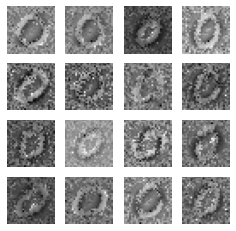

35
gen_loss: tf.Tensor(2.3194609, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11874304, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12940161, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99308348e-01 6.91674009e-04]
 [9.99893665e-01 1.06362619e-04]
 [9.99982238e-01 1.77421371e-05]
 [9.99910951e-01 8.90836527e-05]
 [9.99746025e-01 2.53956561e-04]
 [9.99165893e-01 8.34114442e-04]
 [9.99739468e-01 2.60484550e-04]
 [9.97151852e-01 2.84811994e-03]
 [9.99750435e-01 2.49531411e-04]
 [9.98381853e-01 1.61819311e-03]
 [9.99920487e-01 7.95479064e-05]
 [9.99881625e-01 1.18378863e-04]
 [9.94431436e-01 5.56856487e-03]
 [9.99899149e-01 1.00818732e-04]
 [9.99821484e-01 1.78592702e-04]
 [9.99491692e-01 5.08248748e-04]
 [9.99221206e-01 7.78798130e-04]
 [9.99882936e-01 1.17058895e-04]
 [9.99947667e-01 5.23407907e-05]
 [9.99804318e-01 1.95732922e-04]
 [9.99860406e-01 1.39524534e-04]
 [9.99942064e-01 5.78946128e-05]
 [9.99805987e-01 1.94033448e-04]
 [9.99925137e-01 7

test_discriminator_output: tf.Tensor(
[[9.99355257e-01 6.44742278e-04]
 [9.99888539e-01 1.11423666e-04]
 [9.99986053e-01 1.40025768e-05]
 [9.99938011e-01 6.19866260e-05]
 [9.99807894e-01 1.92169609e-04]
 [9.99255240e-01 7.44767429e-04]
 [9.99791682e-01 2.08385973e-04]
 [9.97323215e-01 2.67681223e-03]
 [9.99813974e-01 1.86023273e-04]
 [9.98669386e-01 1.33064250e-03]
 [9.99929309e-01 7.06511273e-05]
 [9.99917984e-01 8.20052228e-05]
 [9.95592415e-01 4.40757442e-03]
 [9.99913931e-01 8.61074150e-05]
 [9.99870539e-01 1.29476291e-04]
 [9.99582589e-01 4.17394331e-04]
 [9.99334514e-01 6.65426312e-04]
 [9.99902964e-01 9.69874964e-05]
 [9.99961376e-01 3.86782522e-05]
 [9.99843955e-01 1.56017020e-04]
 [9.99879360e-01 1.20680714e-04]
 [9.99944925e-01 5.51040393e-05]
 [9.99854684e-01 1.45253114e-04]
 [9.99947548e-01 5.24518655e-05]
 [9.99544680e-01 4.55334783e-04]
 [9.99861002e-01 1.38999079e-04]
 [9.99699593e-01 3.00457061e-04]
 [9.93614674e-01 6.38532499e-03]
 [7.58396029e-01 2.41604000e-01]
 [9.9

test_discriminator_output: tf.Tensor(
[[9.99439180e-01 5.60799497e-04]
 [9.99851942e-01 1.48069274e-04]
 [9.99989748e-01 1.02976810e-05]
 [9.99963760e-01 3.62408828e-05]
 [9.99877334e-01 1.22609083e-04]
 [9.99317527e-01 6.82515267e-04]
 [9.99857664e-01 1.42265155e-04]
 [9.97421622e-01 2.57834233e-03]
 [9.99879003e-01 1.20923643e-04]
 [9.98886526e-01 1.11348578e-03]
 [9.99944448e-01 5.55792758e-05]
 [9.99947309e-01 5.27456505e-05]
 [9.96641397e-01 3.35857598e-03]
 [9.99924064e-01 7.58821043e-05]
 [9.99919534e-01 8.04048032e-05]
 [9.99691963e-01 3.08116520e-04]
 [9.99505162e-01 4.94784093e-04]
 [9.99922991e-01 7.70420156e-05]
 [9.99975204e-01 2.47493263e-05]
 [9.99893069e-01 1.06968422e-04]
 [9.99905467e-01 9.45296633e-05]
 [9.99936700e-01 6.33069649e-05]
 [9.99908209e-01 9.18197475e-05]
 [9.99969721e-01 3.02884564e-05]
 [9.99649763e-01 3.50233866e-04]
 [9.99897361e-01 1.02610138e-04]
 [9.99831676e-01 1.68237719e-04]
 [9.93916333e-01 6.08373014e-03]
 [7.52670407e-01 2.47329637e-01]
 [9.9

gen_loss: tf.Tensor(2.3555715, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12232165, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12200102, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99451935e-01 5.48024604e-04]
 [9.99791086e-01 2.08904385e-04]
 [9.99989867e-01 1.01032656e-05]
 [9.99970555e-01 2.94587717e-05]
 [9.99898434e-01 1.01611040e-04]
 [9.99202669e-01 7.97336805e-04]
 [9.99864578e-01 1.35428811e-04]
 [9.97052908e-01 2.94705061e-03]
 [9.99890089e-01 1.09858222e-04]
 [9.98759627e-01 1.24035752e-03]
 [9.99950528e-01 4.95287568e-05]
 [9.99954939e-01 4.50440784e-05]
 [9.96737540e-01 3.26241856e-03]
 [9.99896884e-01 1.03135753e-04]
 [9.99928951e-01 7.10938766e-05]
 [9.99738753e-01 2.61196052e-04]
 [9.99547064e-01 4.52950364e-04]
 [9.99919415e-01 8.05465461e-05]
 [9.99975443e-01 2.45653955e-05]
 [9.99908805e-01 9.12026226e-05]
 [9.99905944e-01 9.40574173e-05]
 [9.99929190e-01 7.07791842e-05]
 [9.99918580e-01 8.13747029e-05]
 [9.99975562e-01 2.43

test_discriminator_output: tf.Tensor(
[[9.99523282e-01 4.76747140e-04]
 [9.99811709e-01 1.88342936e-04]
 [9.99989390e-01 1.05642230e-05]
 [9.99969363e-01 3.05805152e-05]
 [9.99904394e-01 9.55463838e-05]
 [9.99339759e-01 6.60206075e-04]
 [9.99855399e-01 1.44618520e-04]
 [9.97613668e-01 2.38629640e-03]
 [9.99874353e-01 1.25668783e-04]
 [9.99039292e-01 9.60680947e-04]
 [9.99961853e-01 3.82006147e-05]
 [9.99949574e-01 5.03949632e-05]
 [9.96416450e-01 3.58347804e-03]
 [9.99910116e-01 8.99251972e-05]
 [9.99917269e-01 8.27107797e-05]
 [9.99779642e-01 2.20371105e-04]
 [9.99603212e-01 3.96865857e-04]
 [9.99931574e-01 6.84053230e-05]
 [9.99970794e-01 2.91499127e-05]
 [9.99919772e-01 8.02751820e-05]
 [9.99918938e-01 8.11027930e-05]
 [9.99936104e-01 6.39136852e-05]
 [9.99922276e-01 7.77332607e-05]
 [9.99974489e-01 2.54650422e-05]
 [9.99705613e-01 2.94371683e-04]
 [9.99916196e-01 8.38248816e-05]
 [9.99871016e-01 1.28924832e-04]
 [9.94914055e-01 5.08598844e-03]
 [8.14056337e-01 1.85943663e-01]
 [9.9

 [9.98376250e-01 1.62369187e-03]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.349596, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12439009, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.122101404, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99451578e-01 5.48421463e-04]
 [9.99859452e-01 1.40533157e-04]
 [9.99986649e-01 1.33592966e-05]
 [9.99932647e-01 6.73422328e-05]
 [9.99819934e-01 1.80092378e-04]
 [9.98964787e-01 1.03520323e-03]
 [9.99727190e-01 2.72796256e-04]
 [9.97557759e-01 2.44216318e-03]
 [9.99756038e-01 2.43915143e-04]
 [9.98111486e-01 1.88854255e-03]
 [9.99945283e-01 5.47725140e-05]
 [9.99889374e-01 1.10638604e-04]
 [9.95713353e-01 4.28664451e-03]
 [9.99845624e-01 1.54309077e-04]
 [9.99833345e-01 1.66658821e-04]
 [9.99649644e-01 3.50352406e-04]
 [9.99364316e-01 6.35682372e-04]
 [9.99885917e-01 1.14071903e-04]
 [9.99944925e-01 5.51222765e-05]
 [9.99859333e-01 1.40589997e-04]
 [9.99910474e-01 8.94704863e-05]
 [9.99945998e-01 5.40

 [9.98005092e-01 1.99496630e-03]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.3074539, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.106476665, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12621158, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99510288e-01 4.89686674e-04]
 [9.99899149e-01 1.00842102e-04]
 [9.99986410e-01 1.35572664e-05]
 [9.99903202e-01 9.67860979e-05]
 [9.99763548e-01 2.36415159e-04]
 [9.98667598e-01 1.33235811e-03]
 [9.99660373e-01 3.39595630e-04]
 [9.97861683e-01 2.13830895e-03]
 [9.99694943e-01 3.05080932e-04]
 [9.97154951e-01 2.84502446e-03]
 [9.99940157e-01 5.98569241e-05]
 [9.99824464e-01 1.75581430e-04]
 [9.95641589e-01 4.35836380e-03]
 [9.99812663e-01 1.87353522e-04]
 [9.99787152e-01 2.12808998e-04]
 [9.99544442e-01 4.55565751e-04]
 [9.99181092e-01 8.18913511e-04]
 [9.99853849e-01 1.46118575e-04]
 [9.99938965e-01 6.10115821e-05]
 [9.99821484e-01 1.78505172e-04]
 [9.99903679e-01 9.62805425e-05]
 [9.99956608e-01 4.3

gen_loss: tf.Tensor(2.3346593, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12470173, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12863967, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99551356e-01 4.48577834e-04]
 [9.99919295e-01 8.06985408e-05]
 [9.99987960e-01 1.20869990e-05]
 [9.99884009e-01 1.15953611e-04]
 [9.99718845e-01 2.81081622e-04]
 [9.98486638e-01 1.51331071e-03]
 [9.99632716e-01 3.67215951e-04]
 [9.98006403e-01 1.99355651e-03]
 [9.99676943e-01 3.23053129e-04]
 [9.96700823e-01 3.29914200e-03]
 [9.99937177e-01 6.28335110e-05]
 [9.99787986e-01 2.11995284e-04]
 [9.95556772e-01 4.44320031e-03]
 [9.99781311e-01 2.18648609e-04]
 [9.99767959e-01 2.32097445e-04]
 [9.99464691e-01 5.35338477e-04]
 [9.99061286e-01 9.38706566e-04]
 [9.99830961e-01 1.69043662e-04]
 [9.99937177e-01 6.28745111e-05]
 [9.99804556e-01 1.95503148e-04]
 [9.99905586e-01 9.43759951e-05]
 [9.99961853e-01 3.81156060e-05]
 [9.99738276e-01 2.61695066e-04]
 [9.99903679e-01 9.63

gen_loss: tf.Tensor(2.2938557, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13888486, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13293147, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99617100e-01 3.82924569e-04]
 [9.99908566e-01 9.14828270e-05]
 [9.99994993e-01 4.97346127e-06]
 [9.99953628e-01 4.63238648e-05]
 [9.99847770e-01 1.52161665e-04]
 [9.99221563e-01 7.78394518e-04]
 [9.99828458e-01 1.71494816e-04]
 [9.98468459e-01 1.53152365e-03]
 [9.99856949e-01 1.43034515e-04]
 [9.98854518e-01 1.14543736e-03]
 [9.99956250e-01 4.37811468e-05]
 [9.99918699e-01 8.12729631e-05]
 [9.96881723e-01 3.11834505e-03]
 [9.99871135e-01 1.28795451e-04]
 [9.99895096e-01 1.04890380e-04]
 [9.99684691e-01 3.15312151e-04]
 [9.99425530e-01 5.74458390e-04]
 [9.99904990e-01 9.49735622e-05]
 [9.99966383e-01 3.36472622e-05]
 [9.99906898e-01 9.31510876e-05]
 [9.99962211e-01 3.77602955e-05]
 [9.99953628e-01 4.63211290e-05]
 [9.99894261e-01 1.05763269e-04]
 [9.99961615e-01 3.83

gen_loss: tf.Tensor(2.3145733, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12742949, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13020624, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99565542e-01 4.34453628e-04]
 [9.99937057e-01 6.29319766e-05]
 [9.99991775e-01 8.18974331e-06]
 [9.99930143e-01 6.98598378e-05]
 [9.99815762e-01 1.84230201e-04]
 [9.99178469e-01 8.21499329e-04]
 [9.99776542e-01 2.23423383e-04]
 [9.98345256e-01 1.65473984e-03]
 [9.99796927e-01 2.03052579e-04]
 [9.98669267e-01 1.33074261e-03]
 [9.99933481e-01 6.64972613e-05]
 [9.99897003e-01 1.02983613e-04]
 [9.94681418e-01 5.31860348e-03]
 [9.99899626e-01 1.00376892e-04]
 [9.99838114e-01 1.61890595e-04]
 [9.99595344e-01 4.04648512e-04]
 [9.99078631e-01 9.21358995e-04]
 [9.99878883e-01 1.21078832e-04]
 [9.99956489e-01 4.34516369e-05]
 [9.99855757e-01 1.44262478e-04]
 [9.99942183e-01 5.77843530e-05]
 [9.99971151e-01 2.88805204e-05]
 [9.99844909e-01 1.55023299e-04]
 [9.99942303e-01 5.76

gen_loss: tf.Tensor(2.3450856, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1433446, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12735175, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99540806e-01 4.59237432e-04]
 [9.99921322e-01 7.86392047e-05]
 [9.99989867e-01 1.01021678e-05]
 [9.99942183e-01 5.77825376e-05]
 [9.99834180e-01 1.65757840e-04]
 [9.99201238e-01 7.98811030e-04]
 [9.99801695e-01 1.98376307e-04]
 [9.98319328e-01 1.68066006e-03]
 [9.99830723e-01 1.69199251e-04]
 [9.98685062e-01 1.31498382e-03]
 [9.99921203e-01 7.87927929e-05]
 [9.99917030e-01 8.29412529e-05]
 [9.94393826e-01 5.60610602e-03]
 [9.99905348e-01 9.45858264e-05]
 [9.99855042e-01 1.44942373e-04]
 [9.99555647e-01 4.44317004e-04]
 [9.99020219e-01 9.79769276e-04]
 [9.99885440e-01 1.14590090e-04]
 [9.99960661e-01 3.92807633e-05]
 [9.99853492e-01 1.46471357e-04]
 [9.99941111e-01 5.88838193e-05]
 [9.99964595e-01 3.53900541e-05]
 [9.99860764e-01 1.39171883e-04]
 [9.99951839e-01 4.813

gen_loss: tf.Tensor(2.3368244, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13494113, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12287122, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99720991e-01 2.78936059e-04]
 [9.99924421e-01 7.56000663e-05]
 [9.99994874e-01 5.15714055e-06]
 [9.99969959e-01 3.00102820e-05]
 [9.99883413e-01 1.16532225e-04]
 [9.99476969e-01 5.23048802e-04]
 [9.99889255e-01 1.10741719e-04]
 [9.99012709e-01 9.87295178e-04]
 [9.99913573e-01 8.63772366e-05]
 [9.99302626e-01 6.97317999e-04]
 [9.99948382e-01 5.15833926e-05]
 [9.99945521e-01 5.44940413e-05]
 [9.96358573e-01 3.64137487e-03]
 [9.99933004e-01 6.70125737e-05]
 [9.99923587e-01 7.63542048e-05]
 [9.99674797e-01 3.25270201e-04]
 [9.99340594e-01 6.59410958e-04]
 [9.99934077e-01 6.59525685e-05]
 [9.99979138e-01 2.08143083e-05]
 [9.99920368e-01 7.96102031e-05]
 [9.99968171e-01 3.18340462e-05]
 [9.99960780e-01 3.92636539e-05]
 [9.99932528e-01 6.74961484e-05]
 [9.99974370e-01 2.55

gen_loss: tf.Tensor(2.4186273, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13178453, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11983227, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99778688e-01 2.21380295e-04]
 [9.99941587e-01 5.84028785e-05]
 [9.99997020e-01 3.03272191e-06]
 [9.99978662e-01 2.13461335e-05]
 [9.99892235e-01 1.07798456e-04]
 [9.99630213e-01 3.69822053e-04]
 [9.99917030e-01 8.29493219e-05]
 [9.99105513e-01 8.94495868e-04]
 [9.99941826e-01 5.81496315e-05]
 [9.99586284e-01 4.13718168e-04]
 [9.99947190e-01 5.28057899e-05]
 [9.99961257e-01 3.87820764e-05]
 [9.95977342e-01 4.02268814e-03]
 [9.99951243e-01 4.87125835e-05]
 [9.99945760e-01 5.41791487e-05]
 [9.99755323e-01 2.44637398e-04]
 [9.99481380e-01 5.18676359e-04]
 [9.99951124e-01 4.89104168e-05]
 [9.99982238e-01 1.77964321e-05]
 [9.99947190e-01 5.28526471e-05]
 [9.99978304e-01 2.17214147e-05]
 [9.99967933e-01 3.20913059e-05]
 [9.99950171e-01 4.98044574e-05]
 [9.99981523e-01 1.84

gen_loss: tf.Tensor(2.4094286, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09034298, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11923556, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99774754e-01 2.25219555e-04]
 [9.99949098e-01 5.09250276e-05]
 [9.99997258e-01 2.74629019e-06]
 [9.99969125e-01 3.08827621e-05]
 [9.99845028e-01 1.54930807e-04]
 [9.99454081e-01 5.45961317e-04]
 [9.99909401e-01 9.06470159e-05]
 [9.98677909e-01 1.32210599e-03]
 [9.99938250e-01 6.17234837e-05]
 [9.99283969e-01 7.15996895e-04]
 [9.99920249e-01 7.97370085e-05]
 [9.99951124e-01 4.88791266e-05]
 [9.94487345e-01 5.51269250e-03]
 [9.99943137e-01 5.68562718e-05]
 [9.99943256e-01 5.67432835e-05]
 [9.99701202e-01 2.98776285e-04]
 [9.99335229e-01 6.64764026e-04]
 [9.99910116e-01 8.98805301e-05]
 [9.99982357e-01 1.75884616e-05]
 [9.99931574e-01 6.84074694e-05]
 [9.99973059e-01 2.69982775e-05]
 [9.99973416e-01 2.66417937e-05]
 [9.99927402e-01 7.25497011e-05]
 [9.99974251e-01 2.57

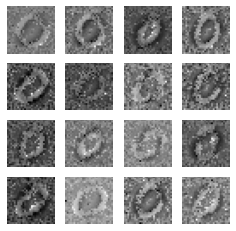

36
gen_loss: tf.Tensor(2.4545538, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10514781, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.113703236, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99753892e-01 2.46071606e-04]
 [9.99934435e-01 6.55330296e-05]
 [9.99997973e-01 1.96894621e-06]
 [9.99972701e-01 2.73013575e-05]
 [9.99852777e-01 1.47151848e-04]
 [9.99515057e-01 4.84975521e-04]
 [9.99925017e-01 7.49635074e-05]
 [9.98420954e-01 1.57902855e-03]
 [9.99949813e-01 5.01976428e-05]
 [9.99418974e-01 5.81042375e-04]
 [9.99929667e-01 7.03484620e-05]
 [9.99967217e-01 3.27900198e-05]
 [9.95002687e-01 4.99726459e-03]
 [9.99943614e-01 5.64394541e-05]
 [9.99955416e-01 4.45621408e-05]
 [9.99774635e-01 2.25391646e-04]
 [9.99537110e-01 4.62895143e-04]
 [9.99887586e-01 1.12448033e-04]
 [9.99982953e-01 1.70365402e-05]
 [9.99939203e-01 6.08520313e-05]
 [9.99979973e-01 2.00207414e-05]
 [9.99964952e-01 3.50790106e-05]
 [9.99938130e-01 6.19157872e-05]
 [9.99978542e-01 

gen_loss: tf.Tensor(2.4681, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1029865, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.110205054, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99716222e-01 2.83718022e-04]
 [9.99951363e-01 4.86037716e-05]
 [9.99996066e-01 3.96424821e-06]
 [9.99936581e-01 6.33741365e-05]
 [9.99738872e-01 2.61063338e-04]
 [9.99459088e-01 5.40860230e-04]
 [9.99855638e-01 1.44328384e-04]
 [9.98545766e-01 1.45426218e-03]
 [9.99881387e-01 1.18584707e-04]
 [9.99238849e-01 7.61225761e-04]
 [9.99931812e-01 6.81913007e-05]
 [9.99930143e-01 6.97997093e-05]
 [9.93528068e-01 6.47191936e-03]
 [9.99943256e-01 5.67489114e-05]
 [9.99893665e-01 1.06367683e-04]
 [9.99726236e-01 2.73698184e-04]
 [9.99430358e-01 5.69634431e-04]
 [9.99809802e-01 1.90263803e-04]
 [9.99964714e-01 3.52603529e-05]
 [9.99880314e-01 1.19674100e-04]
 [9.99970317e-01 2.97096958e-05]
 [9.99974608e-01 2.53901162e-05]
 [9.99880075e-01 1.19929995e-04]
 [9.99948859e-01 5.11132

gen_loss: tf.Tensor(2.424372, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.115726024, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11852368, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99762833e-01 2.37143220e-04]
 [9.99972701e-01 2.72679990e-05]
 [9.99995232e-01 4.71363228e-06]
 [9.99915242e-01 8.47323026e-05]
 [9.99690056e-01 3.10021482e-04]
 [9.99474943e-01 5.25101670e-04]
 [9.99804437e-01 1.95554763e-04]
 [9.99159813e-01 8.40221008e-04]
 [9.99831557e-01 1.68414757e-04]
 [9.99279320e-01 7.20638083e-04]
 [9.99947667e-01 5.23876806e-05]
 [9.99894500e-01 1.05478233e-04]
 [9.94468927e-01 5.53103210e-03]
 [9.99958277e-01 4.17558367e-05]
 [9.99848604e-01 1.51397238e-04]
 [9.99702752e-01 2.97241757e-04]
 [9.99414563e-01 5.85442816e-04]
 [9.99803007e-01 1.96959722e-04]
 [9.99960542e-01 3.93987539e-05]
 [9.99848008e-01 1.51944623e-04]
 [9.99968290e-01 3.17113954e-05]
 [9.99983788e-01 1.62625965e-05]
 [9.99868155e-01 1.31837034e-04]
 [9.99928355e-01 7.16

gen_loss: tf.Tensor(2.3916001, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10996325, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.121215165, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99759257e-01 2.40783120e-04]
 [9.99952555e-01 4.74808221e-05]
 [9.99995470e-01 4.53297025e-06]
 [9.99951959e-01 4.80021954e-05]
 [9.99762714e-01 2.37281187e-04]
 [9.99511957e-01 4.88034799e-04]
 [9.99843597e-01 1.56364171e-04]
 [9.99201238e-01 7.98828609e-04]
 [9.99881387e-01 1.18626784e-04]
 [9.99478400e-01 5.21598791e-04]
 [9.99958038e-01 4.19506068e-05]
 [9.99933600e-01 6.64158288e-05]
 [9.95757639e-01 4.24230192e-03]
 [9.99936581e-01 6.34141543e-05]
 [9.99887943e-01 1.12027730e-04]
 [9.99744833e-01 2.55142833e-04]
 [9.99546230e-01 4.53713263e-04]
 [9.99845862e-01 1.54158930e-04]
 [9.99966741e-01 3.32006384e-05]
 [9.99893546e-01 1.06466017e-04]
 [9.99972463e-01 2.75519251e-05]
 [9.99975204e-01 2.47480039e-05]
 [9.99925613e-01 7.43536657e-05]
 [9.99957442e-01 4.2

gen_loss: tf.Tensor(2.4467802, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15861312, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.120636284, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99736011e-01 2.63928378e-04]
 [9.99933839e-01 6.61643571e-05]
 [9.99997377e-01 2.58667365e-06]
 [9.99976158e-01 2.38159973e-05]
 [9.99837995e-01 1.61948337e-04]
 [9.99606550e-01 3.93487629e-04]
 [9.99901652e-01 9.83879509e-05]
 [9.99060333e-01 9.39641206e-04]
 [9.99936938e-01 6.30589639e-05]
 [9.99670029e-01 3.29968345e-04]
 [9.99959350e-01 4.07058360e-05]
 [9.99973655e-01 2.63618895e-05]
 [9.96862769e-01 3.13727325e-03]
 [9.99939561e-01 6.04704692e-05]
 [9.99937892e-01 6.20836363e-05]
 [9.99808848e-01 1.91167186e-04]
 [9.99671936e-01 3.28037451e-04]
 [9.99876499e-01 1.23450591e-04]
 [9.99978542e-01 2.14606207e-05]
 [9.99930739e-01 6.92128524e-05]
 [9.99980569e-01 1.93995238e-05]
 [9.99966741e-01 3.32751952e-05]
 [9.99958158e-01 4.18012532e-05]
 [9.99978781e-01 2.1

gen_loss: tf.Tensor(2.480596, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11266976, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11902188, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99783337e-01 2.16726854e-04]
 [9.99940038e-01 5.99665073e-05]
 [9.99998927e-01 1.12966507e-06]
 [9.99989152e-01 1.08908989e-05]
 [9.99908686e-01 9.12756950e-05]
 [9.99760091e-01 2.39855115e-04]
 [9.99946713e-01 5.33290586e-05]
 [9.99226928e-01 7.73010950e-04]
 [9.99969482e-01 3.05202702e-05]
 [9.99861121e-01 1.38836549e-04]
 [9.99971509e-01 2.84491343e-05]
 [9.99989390e-01 1.05800318e-05]
 [9.97939408e-01 2.06054491e-03]
 [9.99965787e-01 3.42660423e-05]
 [9.99968171e-01 3.17917875e-05]
 [9.99884367e-01 1.15596915e-04]
 [9.99808013e-01 1.91981148e-04]
 [9.99923110e-01 7.69124454e-05]
 [9.99988556e-01 1.14894247e-05]
 [9.99963403e-01 3.65690939e-05]
 [9.99989867e-01 1.01568248e-05]
 [9.99966979e-01 3.30704534e-05]
 [9.99980927e-01 1.91085710e-05]
 [9.99990344e-01 9.695

gen_loss: tf.Tensor(2.4694662, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1429019, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12057041, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99825656e-01 1.74406261e-04]
 [9.99970198e-01 2.98354171e-05]
 [9.99999285e-01 7.48137325e-07]
 [9.99988079e-01 1.18840608e-05]
 [9.99907494e-01 9.25415952e-05]
 [9.99768078e-01 2.31942380e-04]
 [9.99948859e-01 5.11691105e-05]
 [9.99383450e-01 6.16554520e-04]
 [9.99971032e-01 2.89448726e-05]
 [9.99879241e-01 1.20741715e-04]
 [9.99972343e-01 2.76280680e-05]
 [9.99988437e-01 1.15410921e-05]
 [9.98259962e-01 1.74000429e-03]
 [9.99977112e-01 2.28903446e-05]
 [9.99968767e-01 3.12436568e-05]
 [9.99886632e-01 1.13332353e-04]
 [9.99802291e-01 1.97686721e-04]
 [9.99923348e-01 7.66343219e-05]
 [9.99990344e-01 9.60353645e-06]
 [9.99962687e-01 3.72982249e-05]
 [9.99991655e-01 8.34097045e-06]
 [9.99981046e-01 1.89964467e-05]
 [9.99980569e-01 1.93863925e-05]
 [9.99989390e-01 1.059

gen_loss: tf.Tensor(2.4448695, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10907672, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12570152, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99808490e-01 1.91589090e-04]
 [9.99986410e-01 1.35409855e-05]
 [9.99999046e-01 9.40602490e-07]
 [9.99969721e-01 3.02290118e-05]
 [9.99817669e-01 1.82328178e-04]
 [9.99610722e-01 3.89345660e-04]
 [9.99911666e-01 8.83596076e-05]
 [9.99048054e-01 9.51973139e-04]
 [9.99944687e-01 5.53322570e-05]
 [9.99735296e-01 2.64659146e-04]
 [9.99946833e-01 5.31351361e-05]
 [9.99973655e-01 2.63302336e-05]
 [9.96742189e-01 3.25787719e-03]
 [9.99976635e-01 2.33850296e-05]
 [9.99936938e-01 6.30540380e-05]
 [9.99824226e-01 1.75808091e-04]
 [9.99642134e-01 3.57892714e-04]
 [9.99850154e-01 1.49818676e-04]
 [9.99983072e-01 1.69479317e-05]
 [9.99918818e-01 8.11577193e-05]
 [9.99987721e-01 1.22474721e-05]
 [9.99991298e-01 8.72361306e-06]
 [9.99951601e-01 4.84007214e-05]
 [9.99972105e-01 2.79

test_discriminator_output: tf.Tensor(
[[9.99691129e-01 3.08951916e-04]
 [9.99973536e-01 2.64448809e-05]
 [9.99998689e-01 1.25410691e-06]
 [9.99957919e-01 4.20433644e-05]
 [9.99741971e-01 2.57974432e-04]
 [9.99393940e-01 6.06038433e-04]
 [9.99884367e-01 1.15597024e-04]
 [9.98009264e-01 1.99073530e-03]
 [9.99926567e-01 7.34049754e-05]
 [9.99499917e-01 5.00110793e-04]
 [9.99904394e-01 9.55647920e-05]
 [9.99968171e-01 3.18171733e-05]
 [9.95397151e-01 4.60281223e-03]
 [9.99956250e-01 4.37472991e-05]
 [9.99917030e-01 8.29471101e-05]
 [9.99768078e-01 2.31946120e-04]
 [9.99524593e-01 4.75378707e-04]
 [9.99744356e-01 2.55604973e-04]
 [9.99972701e-01 2.72991711e-05]
 [9.99875665e-01 1.24327285e-04]
 [9.99986291e-01 1.37344960e-05]
 [9.99985218e-01 1.47873297e-05]
 [9.99923468e-01 7.65444856e-05]
 [9.99961257e-01 3.87267501e-05]
 [9.99670506e-01 3.29524744e-04]
 [9.99886274e-01 1.13767310e-04]
 [9.99862432e-01 1.37604118e-04]
 [9.95521784e-01 4.47821384e-03]
 [9.82515693e-01 1.74843259e-02]
 [9.9

gen_loss: tf.Tensor(2.493587, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11683606, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11437407, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99770582e-01 2.29463185e-04]
 [9.99962807e-01 3.72341856e-05]
 [9.99998450e-01 1.58688817e-06]
 [9.99958873e-01 4.11415203e-05]
 [9.99787748e-01 2.12259838e-04]
 [9.99540448e-01 4.59635106e-04]
 [9.99897957e-01 1.01984275e-04]
 [9.98600066e-01 1.39991008e-03]
 [9.99922156e-01 7.78662870e-05]
 [9.99603689e-01 3.96338815e-04]
 [9.99942899e-01 5.71219171e-05]
 [9.99957681e-01 4.23254460e-05]
 [9.94598627e-01 5.40135847e-03]
 [9.99954939e-01 4.50988409e-05]
 [9.99909043e-01 9.09601222e-05]
 [9.99845147e-01 1.54842637e-04]
 [9.99680281e-01 3.19724117e-04]
 [9.99786794e-01 2.13254258e-04]
 [9.99969840e-01 3.01193486e-05]
 [9.99903560e-01 9.63858110e-05]
 [9.99985695e-01 1.42592617e-05]
 [9.99981284e-01 1.87286205e-05]
 [9.99940634e-01 5.93193690e-05]
 [9.99961019e-01 3.902

test_discriminator_output: tf.Tensor(
[[9.99853611e-01 1.46342092e-04]
 [9.99977112e-01 2.29438465e-05]
 [9.99998331e-01 1.63964410e-06]
 [9.99957323e-01 4.26688239e-05]
 [9.99823511e-01 1.76551272e-04]
 [9.99654055e-01 3.45927285e-04]
 [9.99906301e-01 9.36468059e-05]
 [9.99307752e-01 6.92304166e-04]
 [9.99919415e-01 8.06121752e-05]
 [9.99733627e-01 2.66332849e-04]
 [9.99966979e-01 3.30790353e-05]
 [9.99942541e-01 5.74802689e-05]
 [9.95576620e-01 4.42337524e-03]
 [9.99967575e-01 3.23717504e-05]
 [9.99904871e-01 9.50762260e-05]
 [9.99873281e-01 1.26755287e-04]
 [9.99730885e-01 2.69052951e-04]
 [9.99851346e-01 1.48621781e-04]
 [9.99973655e-01 2.63908187e-05]
 [9.99920964e-01 7.90589183e-05]
 [9.99985456e-01 1.45916865e-05]
 [9.99987483e-01 1.25497036e-05]
 [9.99953628e-01 4.63746983e-05]
 [9.99957800e-01 4.22237717e-05]
 [9.99802887e-01 1.97117159e-04]
 [9.99934912e-01 6.50952425e-05]
 [9.99905467e-01 9.45066713e-05]
 [9.98172879e-01 1.82710530e-03]
 [9.85770226e-01 1.42298024e-02]
 [9.9

gen_loss: tf.Tensor(2.468783, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.119995244, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11998208, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99858499e-01 1.41437369e-04]
 [9.99978900e-01 2.10808939e-05]
 [9.99998450e-01 1.50469680e-06]
 [9.99968648e-01 3.13661476e-05]
 [9.99856830e-01 1.43145153e-04]
 [9.99709070e-01 2.90884025e-04]
 [9.99918461e-01 8.15026942e-05]
 [9.99453127e-01 5.46860974e-04]
 [9.99934077e-01 6.59580473e-05]
 [9.99838710e-01 1.61317075e-04]
 [9.99969602e-01 3.04036639e-05]
 [9.99956012e-01 4.39673313e-05]
 [9.96502399e-01 3.49759171e-03]
 [9.99970436e-01 2.95483569e-05]
 [9.99919772e-01 8.02080031e-05]
 [9.99880791e-01 1.19142809e-04]
 [9.99750197e-01 2.49796809e-04]
 [9.99890804e-01 1.09131419e-04]
 [9.99976516e-01 2.34927247e-05]
 [9.99935627e-01 6.43318708e-05]
 [9.99984145e-01 1.58124349e-05]
 [9.99988794e-01 1.11839026e-05]
 [9.99967337e-01 3.26883637e-05]
 [9.99968290e-01 3.17

gen_loss: tf.Tensor(2.5047941, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12893894, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11266133, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99753654e-01 2.46319280e-04]
 [9.99951124e-01 4.89176928e-05]
 [9.99998450e-01 1.58167256e-06]
 [9.99981284e-01 1.86767902e-05]
 [9.99864817e-01 1.35108538e-04]
 [9.99625921e-01 3.74022144e-04]
 [9.99930024e-01 6.99467637e-05]
 [9.98795629e-01 1.20431732e-03]
 [9.99954820e-01 4.51520245e-05]
 [9.99828458e-01 1.71566309e-04]
 [9.99942422e-01 5.75973027e-05]
 [9.99982357e-01 1.76621179e-05]
 [9.95336235e-01 4.66373004e-03]
 [9.99955773e-01 4.42644814e-05]
 [9.99944448e-01 5.55402257e-05]
 [9.99866128e-01 1.33856709e-04]
 [9.99730766e-01 2.69220298e-04]
 [9.99872208e-01 1.27757594e-04]
 [9.99977827e-01 2.22199360e-05]
 [9.99935389e-01 6.45840701e-05]
 [9.99974489e-01 2.54817569e-05]
 [9.99980688e-01 1.93177038e-05]
 [9.99970078e-01 2.99789353e-05]
 [9.99982357e-01 1.76

test_discriminator_output: tf.Tensor(
[[9.99803483e-01 1.96486653e-04]
 [9.99933124e-01 6.68631401e-05]
 [9.99999166e-01 8.09412313e-07]
 [9.99992967e-01 7.08368043e-06]
 [9.99931812e-01 6.81470920e-05]
 [9.99797881e-01 2.02118448e-04]
 [9.99965668e-01 3.42888852e-05]
 [9.99026656e-01 9.73387971e-04]
 [9.99979019e-01 2.10124945e-05]
 [9.99929428e-01 7.06228384e-05]
 [9.99964476e-01 3.55299162e-05]
 [9.99993324e-01 6.72074384e-06]
 [9.96384144e-01 3.61586735e-03]
 [9.99977469e-01 2.24719461e-05]
 [9.99973178e-01 2.68527892e-05]
 [9.99925852e-01 7.41323456e-05]
 [9.99858856e-01 1.41135868e-04]
 [9.99933839e-01 6.61094891e-05]
 [9.99988317e-01 1.16689189e-05]
 [9.99970078e-01 2.98913492e-05]
 [9.99986529e-01 1.34439924e-05]
 [9.99972105e-01 2.78778825e-05]
 [9.99987841e-01 1.21186240e-05]
 [9.99993563e-01 6.48591413e-06]
 [9.99873400e-01 1.26570012e-04]
 [9.99928951e-01 7.10210879e-05]
 [9.99968410e-01 3.15708421e-05]
 [9.97031450e-01 2.96851341e-03]
 [9.90675807e-01 9.32413619e-03]
 [9.9

gen_loss: tf.Tensor(2.481855, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12029342, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12078216, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99928236e-01 7.17220464e-05]
 [9.99976993e-01 2.30065089e-05]
 [9.99999523e-01 4.81259463e-07]
 [9.99995112e-01 4.90368711e-06]
 [9.99955297e-01 4.47025559e-05]
 [9.99896288e-01 1.03716346e-04]
 [9.99978065e-01 2.19729682e-05]
 [9.99616504e-01 3.83459905e-04]
 [9.99985099e-01 1.49136140e-05]
 [9.99958634e-01 4.13529415e-05]
 [9.99986053e-01 1.39523499e-05]
 [9.99992490e-01 7.54824805e-06]
 [9.95295465e-01 4.70451033e-03]
 [9.99991536e-01 8.43797807e-06]
 [9.99978065e-01 2.18773930e-05]
 [9.99961734e-01 3.83026454e-05]
 [9.99917507e-01 8.24421077e-05]
 [9.99969363e-01 3.05854155e-05]
 [9.99992371e-01 7.60961120e-06]
 [9.99984384e-01 1.55911366e-05]
 [9.99990344e-01 9.65173967e-06]
 [9.99987721e-01 1.23369628e-05]
 [9.99993801e-01 6.24575978e-06]
 [9.99995232e-01 4.789

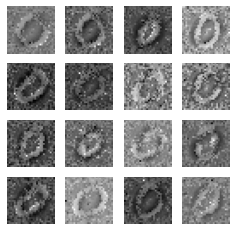

37
gen_loss: tf.Tensor(2.4490957, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11474028, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.111896984, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99942660e-01 5.73951511e-05]
 [9.99989867e-01 1.00991520e-05]
 [9.99999285e-01 7.28259693e-07]
 [9.99988914e-01 1.10590063e-05]
 [9.99915600e-01 8.43527450e-05]
 [9.99845505e-01 1.54484267e-04]
 [9.99961257e-01 3.87746441e-05]
 [9.99663472e-01 3.36496480e-04]
 [9.99972224e-01 2.77703948e-05]
 [9.99909759e-01 9.01836684e-05]
 [9.99983788e-01 1.61716416e-05]
 [9.99979615e-01 2.03652817e-05]
 [9.91679966e-01 8.32005031e-03]
 [9.99987245e-01 1.27788435e-05]
 [9.99955773e-01 4.41942066e-05]
 [9.99946713e-01 5.32911799e-05]
 [9.99879003e-01 1.20995275e-04]
 [9.99954462e-01 4.55055342e-05]
 [9.99987006e-01 1.30313274e-05]
 [9.99973655e-01 2.63203401e-05]
 [9.99981999e-01 1.80278912e-05]
 [9.99994040e-01 6.01791680e-06]
 [9.99988079e-01 1.19800216e-05]
 [9.99988556e-01 

gen_loss: tf.Tensor(2.3752582, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08795926, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12492029, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99929547e-01 7.04900158e-05]
 [9.99986887e-01 1.30742346e-05]
 [9.99999285e-01 7.20444802e-07]
 [9.99987602e-01 1.23698537e-05]
 [9.99894500e-01 1.05531566e-04]
 [9.99807298e-01 1.92725041e-04]
 [9.99959350e-01 4.06626932e-05]
 [9.99532461e-01 4.67546168e-04]
 [9.99970794e-01 2.92452260e-05]
 [9.99843001e-01 1.56950759e-04]
 [9.99980330e-01 1.96378187e-05]
 [9.99976158e-01 2.38215180e-05]
 [9.90646958e-01 9.35304910e-03]
 [9.99976277e-01 2.37223376e-05]
 [9.99946952e-01 5.30766993e-05]
 [9.99945879e-01 5.41084155e-05]
 [9.99888420e-01 1.11602953e-04]
 [9.99933004e-01 6.70353329e-05]
 [9.99984384e-01 1.56557417e-05]
 [9.99971747e-01 2.82423698e-05]
 [9.99983788e-01 1.62531996e-05]
 [9.99991179e-01 8.77674302e-06]
 [9.99987721e-01 1.22448209e-05]
 [9.99987245e-01 1.27

gen_loss: tf.Tensor(2.4844272, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1113102, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11621234, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99944091e-01 5.59543550e-05]
 [9.99989510e-01 1.04947158e-05]
 [9.99999642e-01 4.12348754e-07]
 [9.99992847e-01 7.18141109e-06]
 [9.99933362e-01 6.66624037e-05]
 [9.99861479e-01 1.38498566e-04]
 [9.99974251e-01 2.57190077e-05]
 [9.99658227e-01 3.41727078e-04]
 [9.99982834e-01 1.71124684e-05]
 [9.99907255e-01 9.27938891e-05]
 [9.99986172e-01 1.38062633e-05]
 [9.99984264e-01 1.57558097e-05]
 [9.93714273e-01 6.28573075e-03]
 [9.99984026e-01 1.59876472e-05]
 [9.99966025e-01 3.39387443e-05]
 [9.99961138e-01 3.88772423e-05]
 [9.99918699e-01 8.13090810e-05]
 [9.99951839e-01 4.81219140e-05]
 [9.99991417e-01 8.55538110e-06]
 [9.99983311e-01 1.66821283e-05]
 [9.99991179e-01 8.87652550e-06]
 [9.99991179e-01 8.85385089e-06]
 [9.99993801e-01 6.20167748e-06]
 [9.99992490e-01 7.487

gen_loss: tf.Tensor(2.5540624, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.103980675, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1019986, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99939442e-01 6.05178866e-05]
 [9.99993920e-01 6.10936286e-06]
 [9.99999404e-01 5.53511654e-07]
 [9.99987602e-01 1.24204480e-05]
 [9.99896646e-01 1.03330851e-04]
 [9.99731123e-01 2.68858101e-04]
 [9.99957561e-01 4.24790196e-05]
 [9.99692321e-01 3.07672948e-04]
 [9.99972343e-01 2.76634491e-05]
 [9.99801219e-01 1.98750378e-04]
 [9.99980211e-01 1.97661466e-05]
 [9.99960184e-01 3.98631200e-05]
 [9.95158732e-01 4.84129554e-03]
 [9.99976873e-01 2.31110935e-05]
 [9.99941111e-01 5.89195442e-05]
 [9.99924302e-01 7.56510490e-05]
 [9.99832511e-01 1.67467879e-04]
 [9.99918103e-01 8.19442503e-05]
 [9.99990463e-01 9.57144402e-06]
 [9.99970436e-01 2.95923492e-05]
 [9.99988794e-01 1.12179787e-05]
 [9.99994397e-01 5.58113288e-06]
 [9.99988794e-01 1.12189846e-05]
 [9.99986053e-01 1.39

gen_loss: tf.Tensor(2.5062556, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10879359, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11119615, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99906778e-01 9.32335461e-05]
 [9.99985337e-01 1.46814091e-05]
 [9.99999166e-01 8.36436925e-07]
 [9.99990821e-01 9.22528307e-06]
 [9.99907851e-01 9.21488536e-05]
 [9.99770939e-01 2.29065539e-04]
 [9.99955297e-01 4.46914310e-05]
 [9.99523163e-01 4.76858491e-04]
 [9.99969602e-01 3.04429486e-05]
 [9.99850512e-01 1.49481639e-04]
 [9.99978185e-01 2.18716377e-05]
 [9.99966502e-01 3.35492186e-05]
 [9.94335949e-01 5.66399936e-03]
 [9.99968886e-01 3.11540462e-05]
 [9.99931216e-01 6.87538195e-05]
 [9.99932170e-01 6.78660945e-05]
 [9.99854803e-01 1.45206184e-04]
 [9.99912858e-01 8.70914300e-05]
 [9.99986649e-01 1.33161639e-05]
 [9.99971986e-01 2.79711148e-05]
 [9.99988914e-01 1.10550836e-05]
 [9.99989629e-01 1.03287011e-05]
 [9.99989629e-01 1.04104247e-05]
 [9.99989390e-01 1.06

gen_loss: tf.Tensor(2.5623488, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12159443, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10243433, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99936581e-01 6.33750387e-05]
 [9.99983430e-01 1.66246700e-05]
 [9.99999166e-01 8.53731649e-07]
 [9.99995112e-01 4.93173275e-06]
 [9.99949336e-01 5.06040633e-05]
 [9.99901772e-01 9.81783814e-05]
 [9.99969363e-01 3.05794674e-05]
 [9.99728382e-01 2.71618017e-04]
 [9.99975920e-01 2.41315447e-05]
 [9.99940634e-01 5.93319273e-05]
 [9.99990463e-01 9.54193274e-06]
 [9.99973178e-01 2.68439289e-05]
 [9.94496524e-01 5.50346682e-03]
 [9.99982357e-01 1.76759695e-05]
 [9.99943018e-01 5.69350523e-05]
 [9.99965549e-01 3.44877517e-05]
 [9.99932647e-01 6.73178292e-05]
 [9.99956369e-01 4.36480841e-05]
 [9.99989867e-01 1.01749838e-05]
 [9.99984384e-01 1.56022033e-05]
 [9.99992251e-01 7.71545092e-06]
 [9.99989390e-01 1.05982999e-05]
 [9.99994516e-01 5.42785847e-06]
 [9.99994278e-01 5.76

gen_loss: tf.Tensor(2.5088441, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.115103155, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10781902, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99935031e-01 6.49889262e-05]
 [9.99991179e-01 8.86319413e-06]
 [9.99999166e-01 7.81219853e-07]
 [9.99993801e-01 6.19754519e-06]
 [9.99935269e-01 6.46977423e-05]
 [9.99842167e-01 1.57855669e-04]
 [9.99962807e-01 3.71570350e-05]
 [9.99768913e-01 2.31123588e-04]
 [9.99973416e-01 2.66216266e-05]
 [9.99873042e-01 1.26968924e-04]
 [9.99987841e-01 1.21542953e-05]
 [9.99951839e-01 4.81522111e-05]
 [9.96030271e-01 3.96967260e-03]
 [9.99971390e-01 2.85522819e-05]
 [9.99935150e-01 6.48811256e-05]
 [9.99955654e-01 4.43319004e-05]
 [9.99918342e-01 8.16328975e-05]
 [9.99939680e-01 6.03625012e-05]
 [9.99990463e-01 9.54939787e-06]
 [9.99978185e-01 2.18726600e-05]
 [9.99990940e-01 9.06461537e-06]
 [9.99993563e-01 6.41099905e-06]
 [9.99992251e-01 7.72654039e-06]
 [9.99992609e-01 7.3

test_discriminator_output: tf.Tensor(
[[9.99930263e-01 6.97832074e-05]
 [9.99992728e-01 7.22209052e-06]
 [9.99999166e-01 7.81803408e-07]
 [9.99994874e-01 5.10788959e-06]
 [9.99938011e-01 6.19328493e-05]
 [9.99873877e-01 1.26166458e-04]
 [9.99964237e-01 3.58053621e-05]
 [9.99738872e-01 2.61080277e-04]
 [9.99975920e-01 2.41350645e-05]
 [9.99902725e-01 9.73161150e-05]
 [9.99987245e-01 1.27050225e-05]
 [9.99965668e-01 3.42807762e-05]
 [9.94380891e-01 5.61908819e-03]
 [9.99968648e-01 3.13239070e-05]
 [9.99938130e-01 6.18355407e-05]
 [9.99964952e-01 3.50727860e-05]
 [9.99931693e-01 6.82988757e-05]
 [9.99948144e-01 5.19119567e-05]
 [9.99988198e-01 1.18223879e-05]
 [9.99981523e-01 1.85324570e-05]
 [9.99988914e-01 1.11330373e-05]
 [9.99995232e-01 4.80312247e-06]
 [9.99992728e-01 7.21551578e-06]
 [9.99993920e-01 6.09387325e-06]
 [9.99869227e-01 1.30745117e-04]
 [9.99975324e-01 2.47278131e-05]
 [9.99969363e-01 3.06127004e-05]
 [9.98900890e-01 1.09904085e-03]
 [9.97063339e-01 2.93671060e-03]
 [9.9

gen_loss: tf.Tensor(2.564118, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13854533, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11421873, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99941230e-01 5.87746472e-05]
 [9.99995232e-01 4.74841818e-06]
 [9.99999404e-01 5.78035326e-07]
 [9.99996781e-01 3.25761516e-06]
 [9.99958515e-01 4.14277383e-05]
 [9.99944925e-01 5.50935838e-05]
 [9.99972939e-01 2.70723231e-05]
 [9.99790132e-01 2.09854668e-04]
 [9.99981523e-01 1.84993842e-05]
 [9.99963760e-01 3.61838320e-05]
 [9.99991059e-01 8.99411862e-06]
 [9.99983072e-01 1.69174455e-05]
 [9.93723214e-01 6.27680821e-03]
 [9.99984980e-01 1.50126307e-05]
 [9.99951720e-01 4.82273899e-05]
 [9.99982357e-01 1.76023896e-05]
 [9.99962807e-01 3.71383649e-05]
 [9.99970436e-01 2.95185564e-05]
 [9.99989271e-01 1.07871392e-05]
 [9.99988437e-01 1.15637113e-05]
 [9.99991775e-01 8.20281275e-06]
 [9.99996662e-01 3.29955583e-06]
 [9.99995112e-01 4.91995570e-06]
 [9.99996066e-01 3.901

test_discriminator_output: tf.Tensor(
[[9.99947429e-01 5.25317555e-05]
 [9.99995589e-01 4.37812650e-06]
 [9.99999642e-01 3.87911086e-07]
 [9.99997377e-01 2.60035631e-06]
 [9.99968767e-01 3.12091724e-05]
 [9.99945641e-01 5.43903625e-05]
 [9.99978900e-01 2.11039878e-05]
 [9.99815881e-01 1.84128716e-04]
 [9.99986053e-01 1.39204394e-05]
 [9.99960423e-01 3.95912139e-05]
 [9.99991894e-01 8.09937319e-06]
 [9.99985099e-01 1.49059788e-05]
 [9.96342957e-01 3.65697336e-03]
 [9.99988675e-01 1.13318029e-05]
 [9.99964952e-01 3.50598457e-05]
 [9.99984145e-01 1.58655002e-05]
 [9.99966383e-01 3.36350386e-05]
 [9.99973297e-01 2.66890384e-05]
 [9.99993324e-01 6.69050860e-06]
 [9.99990106e-01 9.89631371e-06]
 [9.99994755e-01 5.19189052e-06]
 [9.99996424e-01 3.56662190e-06]
 [9.99995947e-01 4.11239580e-06]
 [9.99996901e-01 3.05135814e-06]
 [9.99932647e-01 6.73753093e-05]
 [9.99987364e-01 1.25974993e-05]
 [9.99980688e-01 1.93031174e-05]
 [9.98937786e-01 1.06221740e-03]
 [9.99472558e-01 5.27475437e-04]
 [9.9

gen_loss: tf.Tensor(2.4976506, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10771555, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11107327, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99966502e-01 3.34869837e-05]
 [9.99997258e-01 2.74185982e-06]
 [9.99999762e-01 1.92360957e-07]
 [9.99998689e-01 1.32022853e-06]
 [9.99984384e-01 1.56502792e-05]
 [9.99947548e-01 5.24570205e-05]
 [9.99989867e-01 1.01665937e-05]
 [9.99853373e-01 1.46619059e-04]
 [9.99994159e-01 5.81311861e-06]
 [9.99964356e-01 3.56568635e-05]
 [9.99994278e-01 5.69959593e-06]
 [9.99991655e-01 8.30203680e-06]
 [9.97572362e-01 2.42763339e-03]
 [9.99991298e-01 8.71585416e-06]
 [9.99985218e-01 1.47525097e-05]
 [9.99989986e-01 1.00193674e-05]
 [9.99971867e-01 2.81439134e-05]
 [9.99981165e-01 1.88059548e-05]
 [9.99997258e-01 2.70050714e-06]
 [9.99994636e-01 5.36003517e-06]
 [9.99995470e-01 4.53095163e-06]
 [9.99997854e-01 2.13595445e-06]
 [9.99997735e-01 2.22027211e-06]
 [9.99998450e-01 1.51

 [9.99879837e-01 1.20098208e-04]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.5240889, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09458563, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11377852, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99979854e-01 2.01616822e-05]
 [9.99997735e-01 2.21612800e-06]
 [9.99999881e-01 1.78704212e-07]
 [9.99999046e-01 9.42916984e-07]
 [9.99990821e-01 9.22933123e-06]
 [9.99966264e-01 3.37772435e-05]
 [9.99993086e-01 6.94198161e-06]
 [9.99891758e-01 1.08203079e-04]
 [9.99995708e-01 4.26490033e-06]
 [9.99979854e-01 2.01287130e-05]
 [9.99996781e-01 3.18553202e-06]
 [9.99993443e-01 6.50241236e-06]
 [9.96485233e-01 3.51480208e-03]
 [9.99993801e-01 6.15278213e-06]
 [9.99988556e-01 1.14948607e-05]
 [9.99994993e-01 5.05769185e-06]
 [9.99980569e-01 1.93877986e-05]
 [9.99988556e-01 1.14191425e-05]
 [9.99997735e-01 2.27750047e-06]
 [9.99997020e-01 2.97465954e-06]
 [9.99994993e-01 4.98869076e-06]
 [9.99998569e-01 1.41

gen_loss: tf.Tensor(2.4220686, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13114126, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12598307, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99980927e-01 1.91255986e-05]
 [9.99997973e-01 1.99458873e-06]
 [9.99999762e-01 2.39427237e-07]
 [9.99998689e-01 1.26985469e-06]
 [9.99989748e-01 1.02422273e-05]
 [9.99967694e-01 3.22515771e-05]
 [9.99991417e-01 8.61812532e-06]
 [9.99898314e-01 1.01696438e-04]
 [9.99993920e-01 6.04819161e-06]
 [9.99979138e-01 2.09139744e-05]
 [9.99996781e-01 3.21054426e-06]
 [9.99991179e-01 8.78613082e-06]
 [9.94850814e-01 5.14922664e-03]
 [9.99994636e-01 5.33704588e-06]
 [9.99984026e-01 1.59611536e-05]
 [9.99995351e-01 4.69198812e-06]
 [9.99978542e-01 2.14484662e-05]
 [9.99988317e-01 1.16692745e-05]
 [9.99996781e-01 3.17007311e-06]
 [9.99996543e-01 3.42448311e-06]
 [9.99994040e-01 5.94367793e-06]
 [9.99998808e-01 1.18020159e-06]
 [9.99998212e-01 1.79586766e-06]
 [9.99998569e-01 1.45

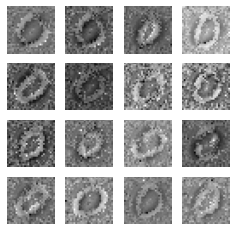

38
gen_loss: tf.Tensor(2.4106293, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09064419, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12820289, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99977708e-01 2.23043462e-05]
 [9.99995828e-01 4.21512050e-06]
 [9.99999881e-01 1.46234214e-07]
 [9.99999285e-01 6.80819142e-07]
 [9.99992728e-01 7.31362888e-06]
 [9.99968767e-01 3.12054217e-05]
 [9.99993920e-01 6.07012089e-06]
 [9.99904871e-01 9.51723923e-05]
 [9.99996185e-01 3.80239521e-06]
 [9.99982595e-01 1.73738426e-05]
 [9.99996781e-01 3.18230445e-06]
 [9.99994993e-01 5.03137699e-06]
 [9.96983945e-01 3.01609212e-03]
 [9.99995232e-01 4.77308959e-06]
 [9.99990821e-01 9.12547785e-06]
 [9.99996305e-01 3.67184202e-06]
 [9.99983311e-01 1.66624122e-05]
 [9.99991298e-01 8.74190937e-06]
 [9.99997854e-01 2.15046634e-06]
 [9.99997616e-01 2.38451776e-06]
 [9.99996662e-01 3.35472691e-06]
 [9.99997258e-01 2.77231788e-06]
 [9.99998689e-01 1.25216968e-06]
 [9.99999285e-01 7

gen_loss: tf.Tensor(2.481445, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.122011214, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.119377695, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99975204e-01 2.48034812e-05]
 [9.99997020e-01 3.00492570e-06]
 [9.99999762e-01 2.41841406e-07]
 [9.99998569e-01 1.47249102e-06]
 [9.99984860e-01 1.51476424e-05]
 [9.99928832e-01 7.11072207e-05]
 [9.99988317e-01 1.17218979e-05]
 [9.99917746e-01 8.22549773e-05]
 [9.99992967e-01 7.03320848e-06]
 [9.99953151e-01 4.68750804e-05]
 [9.99995589e-01 4.40906115e-06]
 [9.99986291e-01 1.37407196e-05]
 [9.97204363e-01 2.79563898e-03]
 [9.99988914e-01 1.10394276e-05]
 [9.99983311e-01 1.66582176e-05]
 [9.99993920e-01 6.11662654e-06]
 [9.99972224e-01 2.77910076e-05]
 [9.99985218e-01 1.48162389e-05]
 [9.99996305e-01 3.68339829e-06]
 [9.99995351e-01 4.64135110e-06]
 [9.99992371e-01 7.66138510e-06]
 [9.99998212e-01 1.83673092e-06]
 [9.99997377e-01 2.67993141e-06]
 [9.99998331e-01 1.6

gen_loss: tf.Tensor(2.5184453, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08890407, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11830878, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99978900e-01 2.11198130e-05]
 [9.99997377e-01 2.59624289e-06]
 [9.99999642e-01 2.98609166e-07]
 [9.99998331e-01 1.61263586e-06]
 [9.99983430e-01 1.65427609e-05]
 [9.99933004e-01 6.70394220e-05]
 [9.99987364e-01 1.26719769e-05]
 [9.99935985e-01 6.40084691e-05]
 [9.99992132e-01 7.83898395e-06]
 [9.99960899e-01 3.90824716e-05]
 [9.99996662e-01 3.36009975e-06]
 [9.99984026e-01 1.60326108e-05]
 [9.97040212e-01 2.95973127e-03]
 [9.99987125e-01 1.28669508e-05]
 [9.99980688e-01 1.93076467e-05]
 [9.99994636e-01 5.33443017e-06]
 [9.99975681e-01 2.42628194e-05]
 [9.99985933e-01 1.40251077e-05]
 [9.99995589e-01 4.42700184e-06]
 [9.99995470e-01 4.49284971e-06]
 [9.99989271e-01 1.07485275e-05]
 [9.99998689e-01 1.36216818e-06]
 [9.99997377e-01 2.65815584e-06]
 [9.99998093e-01 1.87

gen_loss: tf.Tensor(2.4661455, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09763771, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.115715705, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99981880e-01 1.80952375e-05]
 [9.99996543e-01 3.40180213e-06]
 [9.99999762e-01 1.89630981e-07]
 [9.99999166e-01 8.89660953e-07]
 [9.99988675e-01 1.13497135e-05]
 [9.99958396e-01 4.16610965e-05]
 [9.99992132e-01 7.86643886e-06]
 [9.99949574e-01 5.04688396e-05]
 [9.99995470e-01 4.55260442e-06]
 [9.99983072e-01 1.69713203e-05]
 [9.99997854e-01 2.12124905e-06]
 [9.99991536e-01 8.50259403e-06]
 [9.97854054e-01 2.14596069e-03]
 [9.99990463e-01 9.53791186e-06]
 [9.99988317e-01 1.16606416e-05]
 [9.99996781e-01 3.22768074e-06]
 [9.99986172e-01 1.38445266e-05]
 [9.99990821e-01 9.16035515e-06]
 [9.99996781e-01 3.17663716e-06]
 [9.99997377e-01 2.56330031e-06]
 [9.99992371e-01 7.67570418e-06]
 [9.99998212e-01 1.75525031e-06]
 [9.99998569e-01 1.40500583e-06]
 [9.99999046e-01 1.0

gen_loss: tf.Tensor(2.6003535, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08274385, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.106925875, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99979973e-01 2.00123795e-05]
 [9.99994159e-01 5.89647971e-06]
 [9.99999881e-01 1.25157598e-07]
 [9.99999523e-01 5.04883531e-07]
 [9.99991894e-01 8.15600288e-06]
 [9.99971151e-01 2.88432529e-05]
 [9.99994755e-01 5.26512804e-06]
 [9.99944568e-01 5.54640646e-05]
 [9.99997258e-01 2.75608977e-06]
 [9.99991059e-01 8.97400059e-06]
 [9.99998331e-01 1.66524887e-06]
 [9.99995947e-01 4.10472012e-06]
 [9.98405516e-01 1.59452017e-03]
 [9.99992132e-01 7.91301409e-06]
 [9.99992609e-01 7.37413939e-06]
 [9.99997854e-01 2.15998671e-06]
 [9.99991179e-01 8.86476664e-06]
 [9.99992847e-01 7.09525466e-06]
 [9.99997377e-01 2.57353895e-06]
 [9.99998331e-01 1.62246386e-06]
 [9.99994516e-01 5.46324463e-06]
 [9.99997139e-01 2.86475097e-06]
 [9.99999166e-01 8.56867928e-07]
 [9.99999404e-01 5.4

gen_loss: tf.Tensor(2.613702, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1009987, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10692395, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99976993e-01 2.30231908e-05]
 [9.99993086e-01 6.92991034e-06]
 [9.99999881e-01 1.45758321e-07]
 [9.99999404e-01 5.99966654e-07]
 [9.99990582e-01 9.38105495e-06]
 [9.99966383e-01 3.36285266e-05]
 [9.99994040e-01 6.00305930e-06]
 [9.99932766e-01 6.72388560e-05]
 [9.99996901e-01 3.14294493e-06]
 [9.99988556e-01 1.14151462e-05]
 [9.99998331e-01 1.71826184e-06]
 [9.99995351e-01 4.62590697e-06]
 [9.98385310e-01 1.61471555e-03]
 [9.99991179e-01 8.81428787e-06]
 [9.99991536e-01 8.46207422e-06]
 [9.99997854e-01 2.19920503e-06]
 [9.99990821e-01 9.22162326e-06]
 [9.99991417e-01 8.61234093e-06]
 [9.99997020e-01 3.03719662e-06]
 [9.99998093e-01 1.86374155e-06]
 [9.99993563e-01 6.46637272e-06]
 [9.99996901e-01 3.09652660e-06]
 [9.99998927e-01 1.06199263e-06]
 [9.99999404e-01 6.3823

gen_loss: tf.Tensor(2.5611913, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13676842, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11123117, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99975920e-01 2.40366862e-05]
 [9.99996305e-01 3.71133910e-06]
 [9.99999762e-01 2.30589805e-07]
 [9.99998689e-01 1.33997332e-06]
 [9.99984741e-01 1.52386619e-05]
 [9.99936581e-01 6.34038734e-05]
 [9.99989867e-01 1.01624646e-05]
 [9.99929667e-01 7.02816760e-05]
 [9.99994278e-01 5.74243677e-06]
 [9.99970078e-01 2.99009571e-05]
 [9.99997854e-01 2.10036228e-06]
 [9.99988794e-01 1.11705358e-05]
 [9.98215854e-01 1.78416050e-03]
 [9.99989390e-01 1.06631542e-05]
 [9.99984741e-01 1.53149758e-05]
 [9.99996662e-01 3.29989894e-06]
 [9.99985218e-01 1.47438732e-05]
 [9.99984980e-01 1.50162823e-05]
 [9.99995828e-01 4.14161104e-06]
 [9.99996305e-01 3.63708477e-06]
 [9.99988317e-01 1.16479932e-05]
 [9.99998331e-01 1.62707363e-06]
 [9.99997735e-01 2.30956107e-06]
 [9.99998569e-01 1.43

gen_loss: tf.Tensor(2.5415807, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10189903, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.110493004, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99982953e-01 1.70905678e-05]
 [9.99998689e-01 1.25720237e-06]
 [9.99999523e-01 4.29064016e-07]
 [9.99996543e-01 3.43498914e-06]
 [9.99974728e-01 2.52328045e-05]
 [9.99862075e-01 1.37951865e-04]
 [9.99982595e-01 1.74009037e-05]
 [9.99950051e-01 4.98944428e-05]
 [9.99989271e-01 1.07665628e-05]
 [9.99910235e-01 8.97367354e-05]
 [9.99998331e-01 1.65555161e-06]
 [9.99962449e-01 3.75410236e-05]
 [9.98535395e-01 1.46461616e-03]
 [9.99987006e-01 1.30089775e-05]
 [9.99971747e-01 2.82059791e-05]
 [9.99994516e-01 5.52665779e-06]
 [9.99976039e-01 2.39128567e-05]
 [9.99976397e-01 2.36005326e-05]
 [9.99995470e-01 4.58677914e-06]
 [9.99993086e-01 6.90537536e-06]
 [9.99971867e-01 2.81822140e-05]
 [9.99999404e-01 6.03104013e-07]
 [9.99994993e-01 4.97076780e-06]
 [9.99996185e-01 3.8

gen_loss: tf.Tensor(2.6318398, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12760827, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10348613, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99986529e-01 1.34689153e-05]
 [9.99997735e-01 2.27170631e-06]
 [9.99999762e-01 2.36862462e-07]
 [9.99999166e-01 8.30669649e-07]
 [9.99988317e-01 1.17187237e-05]
 [9.99948025e-01 5.19180867e-05]
 [9.99993324e-01 6.68805887e-06]
 [9.99956846e-01 4.31678600e-05]
 [9.99996662e-01 3.32736977e-06]
 [9.99983668e-01 1.63431141e-05]
 [9.99999285e-01 7.18616718e-07]
 [9.99993324e-01 6.63588571e-06]
 [9.98846769e-01 1.15326117e-03]
 [9.99990225e-01 9.75437797e-06]
 [9.99991059e-01 8.99149381e-06]
 [9.99997735e-01 2.26128577e-06]
 [9.99992013e-01 8.02246177e-06]
 [9.99992251e-01 7.71228770e-06]
 [9.99997377e-01 2.66618849e-06]
 [9.99998212e-01 1.83981285e-06]
 [9.99981046e-01 1.89676812e-05]
 [9.99998927e-01 1.03377101e-06]
 [9.99998808e-01 1.24368910e-06]
 [9.99999046e-01 9.47

gen_loss: tf.Tensor(2.5705779, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.095111504, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11859624, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99987960e-01 1.20431614e-05]
 [9.99998808e-01 1.24876385e-06]
 [9.99999762e-01 2.37736231e-07]
 [9.99999285e-01 7.55471888e-07]
 [9.99986887e-01 1.31212628e-05]
 [9.99943495e-01 5.65073606e-05]
 [9.99992847e-01 7.13202462e-06]
 [9.99961615e-01 3.83862716e-05]
 [9.99996901e-01 3.06299717e-06]
 [9.99982834e-01 1.71765278e-05]
 [9.99999166e-01 7.90626814e-07]
 [9.99993920e-01 6.04233401e-06]
 [9.98539805e-01 1.46021973e-03]
 [9.99991298e-01 8.73417594e-06]
 [9.99992251e-01 7.71518626e-06]
 [9.99997735e-01 2.31563945e-06]
 [9.99992013e-01 8.00526595e-06]
 [9.99993682e-01 6.28264252e-06]
 [9.99997735e-01 2.23712914e-06]
 [9.99998212e-01 1.84095200e-06]
 [9.99974847e-01 2.51936635e-05]
 [9.99999404e-01 6.47767763e-07]
 [9.99998808e-01 1.24195981e-06]
 [9.99999046e-01 9.0

gen_loss: tf.Tensor(2.5504942, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.089475445, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10775219, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99991536e-01 8.49034222e-06]
 [9.99999523e-01 4.70399925e-07]
 [9.99999762e-01 2.81377993e-07]
 [9.99998927e-01 1.05777872e-06]
 [9.99983311e-01 1.67251401e-05]
 [9.99905348e-01 9.46933214e-05]
 [9.99990940e-01 9.05638080e-06]
 [9.99969840e-01 3.01096406e-05]
 [9.99996543e-01 3.47631499e-06]
 [9.99965072e-01 3.49738257e-05]
 [9.99999046e-01 9.32785213e-07]
 [9.99988794e-01 1.12146408e-05]
 [9.97542381e-01 2.45764363e-03]
 [9.99991179e-01 8.83989560e-06]
 [9.99991775e-01 8.26352152e-06]
 [9.99997139e-01 2.90786397e-06]
 [9.99989510e-01 1.05417703e-05]
 [9.99992967e-01 7.00116698e-06]
 [9.99998212e-01 1.75898890e-06]
 [9.99997377e-01 2.62064623e-06]
 [9.99951839e-01 4.82170508e-05]
 [9.99999762e-01 2.65138567e-07]
 [9.99998331e-01 1.70631347e-06]
 [9.99998689e-01 1.3

gen_loss: tf.Tensor(2.6220934, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10653381, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.098019265, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99991536e-01 8.46043531e-06]
 [9.99998808e-01 1.22947392e-06]
 [9.99999881e-01 1.24798120e-07]
 [9.99999762e-01 2.35718844e-07]
 [9.99995112e-01 4.87169746e-06]
 [9.99969125e-01 3.08252347e-05]
 [9.99997020e-01 2.93630501e-06]
 [9.99965549e-01 3.44194741e-05]
 [9.99999046e-01 9.87164412e-07]
 [9.99993801e-01 6.23112419e-06]
 [9.99999523e-01 4.52272616e-07]
 [9.99998212e-01 1.84655937e-06]
 [9.97755945e-01 2.24402500e-03]
 [9.99996901e-01 3.08290169e-06]
 [9.99997735e-01 2.21578148e-06]
 [9.99998927e-01 1.04451044e-06]
 [9.99996901e-01 3.05245840e-06]
 [9.99997377e-01 2.63842094e-06]
 [9.99999285e-01 6.66294227e-07]
 [9.99999285e-01 7.69982250e-07]
 [9.99979138e-01 2.08024212e-05]
 [9.99999285e-01 6.92538435e-07]
 [9.99999642e-01 3.98548821e-07]
 [9.99999762e-01 2.7

test_discriminator_output: tf.Tensor(
[[9.9998927e-01 1.0752055e-05]
 [9.9999845e-01 1.6017414e-06]
 [9.9999988e-01 1.3686120e-07]
 [9.9999976e-01 2.3543441e-07]
 [9.9999487e-01 5.1777001e-06]
 [9.9996722e-01 3.2724478e-05]
 [9.9999678e-01 3.1788313e-06]
 [9.9995184e-01 4.8142570e-05]
 [9.9999905e-01 1.0052071e-06]
 [9.9999380e-01 6.1506407e-06]
 [9.9999952e-01 5.2228120e-07]
 [9.9999845e-01 1.5761420e-06]
 [9.9712378e-01 2.8762589e-03]
 [9.9999654e-01 3.4962102e-06]
 [9.9999774e-01 2.2100917e-06]
 [9.9999893e-01 1.0759026e-06]
 [9.9999714e-01 2.8603940e-06]
 [9.9999702e-01 2.9321354e-06]
 [9.9999928e-01 7.3775755e-07]
 [9.9999917e-01 8.0827914e-07]
 [9.9997616e-01 2.3868908e-05]
 [9.9999917e-01 8.4175520e-07]
 [9.9999964e-01 4.1331688e-07]
 [9.9999976e-01 2.7085264e-07]
 [9.9998617e-01 1.3857563e-05]
 [9.9999464e-01 5.3820554e-06]
 [9.9999917e-01 8.1081066e-07]
 [9.9968946e-01 3.1061232e-04]
 [9.9991715e-01 8.2838342e-05]
 [9.9999547e-01 4.5481174e-06]
 [9.9999976e-01 2.4689416e-07]
 

gen_loss: tf.Tensor(2.5532594, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1102105, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10913068, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99985933e-01 1.41130859e-05]
 [9.99999642e-01 4.07808756e-07]
 [9.99999642e-01 3.12022763e-07]
 [9.99999166e-01 8.39247093e-07]
 [9.99987364e-01 1.26109508e-05]
 [9.99924660e-01 7.52810738e-05]
 [9.99991417e-01 8.59907868e-06]
 [9.99929667e-01 7.03060723e-05]
 [9.99997258e-01 2.72754687e-06]
 [9.99981046e-01 1.89058828e-05]
 [9.99998808e-01 1.22525080e-06]
 [9.99995470e-01 4.48484434e-06]
 [9.92379069e-01 7.62095442e-03]
 [9.99995470e-01 4.51435926e-06]
 [9.99994159e-01 5.89826868e-06]
 [9.99997616e-01 2.34226263e-06]
 [9.99993205e-01 6.85391251e-06]
 [9.99992967e-01 7.00186774e-06]
 [9.99998450e-01 1.60574859e-06]
 [9.99997377e-01 2.64450182e-06]
 [9.99922633e-01 7.73724314e-05]
 [9.99999762e-01 2.11115719e-07]
 [9.99998450e-01 1.57488444e-06]
 [9.99999046e-01 9.938

gen_loss: tf.Tensor(2.6658578, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15193859, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.101266384, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99994755e-01 5.18569504e-06]
 [9.99999881e-01 1.20693230e-07]
 [9.99999881e-01 6.42897220e-08]
 [9.99999881e-01 1.30238163e-07]
 [9.99998450e-01 1.56136980e-06]
 [9.99986529e-01 1.34176962e-05]
 [9.99998331e-01 1.63206221e-06]
 [9.99981761e-01 1.82595722e-05]
 [9.99999523e-01 4.56785926e-07]
 [9.99997973e-01 2.01741159e-06]
 [9.99999762e-01 2.43244045e-07]
 [9.99999166e-01 8.22853679e-07]
 [9.96632040e-01 3.36791505e-03]
 [9.99999523e-01 4.43121991e-07]
 [9.99998927e-01 1.01650903e-06]
 [9.99999523e-01 5.14334033e-07]
 [9.99998093e-01 1.88678462e-06]
 [9.99998927e-01 1.02872968e-06]
 [9.99999762e-01 2.30628515e-07]
 [9.99999642e-01 4.04031283e-07]
 [9.99973774e-01 2.62634003e-05]
 [9.99999881e-01 1.05347837e-07]
 [9.99999762e-01 2.18154440e-07]
 [9.99999881e-01 1.4

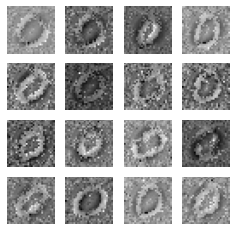

39
gen_loss: tf.Tensor(2.5448627, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12985823, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11056849, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99994874e-01 5.16056934e-06]
 [9.99999881e-01 1.74779260e-07]
 [1.00000000e+00 5.19120924e-08]
 [9.99999881e-01 6.89351864e-08]
 [9.99999166e-01 8.69563507e-07]
 [9.99990463e-01 9.51955553e-06]
 [9.99999046e-01 9.82556571e-07]
 [9.99983549e-01 1.64152952e-05]
 [9.99999762e-01 2.61318405e-07]
 [9.99998450e-01 1.58448825e-06]
 [9.99999881e-01 1.55800961e-07]
 [9.99999523e-01 4.99020985e-07]
 [9.97625053e-01 2.37499457e-03]
 [9.99999642e-01 4.05033973e-07]
 [9.99999404e-01 5.77769640e-07]
 [9.99999642e-01 3.48429325e-07]
 [9.99998689e-01 1.34614947e-06]
 [9.99999285e-01 6.72043484e-07]
 [9.99999881e-01 1.47520495e-07]
 [9.99999762e-01 2.42074918e-07]
 [9.99980092e-01 1.98511716e-05]
 [9.99999881e-01 1.59144392e-07]
 [9.99999881e-01 1.27298875e-07]
 [9.99999881e-01 7

 [9.99989390e-01 1.06164380e-05]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.537846, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.096642464, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11724232, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99992728e-01 7.22383265e-06]
 [9.99999762e-01 1.95736732e-07]
 [9.99999881e-01 1.01533523e-07]
 [9.99999881e-01 9.04210893e-08]
 [9.99998808e-01 1.14633565e-06]
 [9.99987125e-01 1.29086529e-05]
 [9.99998689e-01 1.30989940e-06]
 [9.99976873e-01 2.31097256e-05]
 [9.99999642e-01 3.58291715e-07]
 [9.99996543e-01 3.41428267e-06]
 [9.99999762e-01 2.01553732e-07]
 [9.99999285e-01 6.62761749e-07]
 [9.96753633e-01 3.24631506e-03]
 [9.99999285e-01 7.60827334e-07]
 [9.99999285e-01 7.68396319e-07]
 [9.99999523e-01 4.54172692e-07]
 [9.99998093e-01 1.94738527e-06]
 [9.99999046e-01 9.18404339e-07]
 [9.99999762e-01 2.28429059e-07]
 [9.99999642e-01 3.59554434e-07]
 [9.99964237e-01 3.57411554e-05]
 [9.99999881e-01 1.51

gen_loss: tf.Tensor(2.5499077, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0898259, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.122763366, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99990702e-01 9.34974196e-06]
 [9.99999881e-01 1.24822407e-07]
 [9.99999762e-01 2.40395963e-07]
 [9.99999881e-01 1.73243563e-07]
 [9.99997973e-01 2.05501328e-06]
 [9.99981642e-01 1.84096971e-05]
 [9.99997616e-01 2.33377659e-06]
 [9.99972105e-01 2.79473606e-05]
 [9.99999285e-01 7.10640279e-07]
 [9.99991536e-01 8.46150124e-06]
 [9.99999642e-01 2.99194966e-07]
 [9.99998689e-01 1.27422913e-06]
 [9.94288146e-01 5.71188936e-03]
 [9.99998689e-01 1.26596115e-06]
 [9.99998569e-01 1.46401544e-06]
 [9.99999285e-01 6.82500286e-07]
 [9.99996543e-01 3.40642487e-06]
 [9.99998569e-01 1.40017698e-06]
 [9.99999523e-01 4.62783873e-07]
 [9.99999285e-01 7.34900937e-07]
 [9.99916911e-01 8.31118014e-05]
 [9.99999881e-01 8.13093592e-08]
 [9.99999404e-01 5.37239600e-07]
 [9.99999762e-01 1.97

gen_loss: tf.Tensor(2.4702177, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12037684, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12023461, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99994636e-01 5.32875083e-06]
 [1.00000000e+00 5.26961088e-08]
 [9.99999762e-01 2.73091530e-07]
 [9.99999881e-01 1.49109326e-07]
 [9.99998569e-01 1.44352032e-06]
 [9.99991536e-01 8.44348415e-06]
 [9.99998212e-01 1.76781953e-06]
 [9.99989748e-01 1.02504928e-05]
 [9.99999285e-01 6.81008146e-07]
 [9.99994874e-01 5.15632883e-06]
 [9.99999881e-01 1.17957434e-07]
 [9.99998450e-01 1.55795169e-06]
 [9.94661033e-01 5.33902552e-03]
 [9.99999285e-01 7.40671908e-07]
 [9.99998569e-01 1.44856358e-06]
 [9.99999523e-01 4.33884111e-07]
 [9.99997854e-01 2.18669879e-06]
 [9.99999285e-01 6.93194579e-07]
 [9.99999523e-01 4.50371914e-07]
 [9.99999523e-01 5.33511525e-07]
 [9.99931693e-01 6.82441823e-05]
 [1.00000000e+00 3.70349973e-08]
 [9.99999523e-01 4.52071248e-07]
 [9.99999881e-01 1.70

gen_loss: tf.Tensor(2.5936103, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12064932, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10907439, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99994993e-01 4.97035080e-06]
 [9.99999881e-01 1.06088464e-07]
 [9.99999881e-01 1.05213296e-07]
 [9.99999881e-01 5.99807564e-08]
 [9.99999285e-01 7.34841365e-07]
 [9.99993086e-01 6.94104165e-06]
 [9.99999285e-01 7.68449070e-07]
 [9.99991775e-01 8.26778614e-06]
 [9.99999762e-01 2.60824919e-07]
 [9.99996305e-01 3.72237719e-06]
 [9.99999881e-01 7.67704265e-08]
 [9.99999166e-01 7.96488166e-07]
 [9.98107314e-01 1.89262745e-03]
 [9.99999285e-01 6.74208081e-07]
 [9.99999523e-01 5.33459627e-07]
 [9.99999642e-01 3.13233528e-07]
 [9.99998808e-01 1.24081259e-06]
 [9.99999523e-01 5.14180044e-07]
 [9.99999762e-01 1.84929988e-07]
 [9.99999762e-01 2.70264593e-07]
 [9.99979019e-01 2.09917835e-05]
 [9.99999881e-01 8.07110823e-08]
 [9.99999762e-01 2.26013157e-07]
 [9.99999881e-01 6.57

gen_loss: tf.Tensor(2.4980383, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08876445, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11520807, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99991775e-01 8.24059680e-06]
 [9.99999762e-01 2.05091609e-07]
 [9.99999881e-01 1.73026606e-07]
 [9.99999881e-01 8.98032013e-08]
 [9.99998569e-01 1.47936407e-06]
 [9.99981523e-01 1.84608562e-05]
 [9.99998808e-01 1.18486707e-06]
 [9.99979496e-01 2.04466633e-05]
 [9.99999642e-01 3.63413392e-07]
 [9.99989152e-01 1.07978312e-05]
 [9.99999881e-01 1.60411247e-07]
 [9.99998927e-01 1.01602541e-06]
 [9.97239709e-01 2.76024733e-03]
 [9.99997854e-01 2.09003588e-06]
 [9.99999285e-01 6.97657299e-07]
 [9.99999404e-01 6.51816833e-07]
 [9.99997735e-01 2.28192243e-06]
 [9.99998689e-01 1.33687161e-06]
 [9.99999642e-01 3.05057057e-07]
 [9.99999523e-01 5.14341423e-07]
 [9.99964833e-01 3.51941089e-05]
 [9.99999881e-01 1.08405395e-07]
 [9.99999404e-01 5.58030592e-07]
 [9.99999881e-01 9.91

test_discriminator_output: tf.Tensor(
[[9.99991298e-01 8.73442605e-06]
 [9.99999762e-01 2.45138978e-07]
 [9.99999762e-01 2.11394152e-07]
 [9.99999881e-01 1.03407615e-07]
 [9.99998212e-01 1.76168328e-06]
 [9.99977112e-01 2.28683057e-05]
 [9.99998569e-01 1.37713960e-06]
 [9.99975204e-01 2.47387070e-05]
 [9.99999642e-01 4.13142715e-07]
 [9.99988556e-01 1.14600425e-05]
 [9.99999881e-01 1.74579029e-07]
 [9.99998808e-01 1.13454178e-06]
 [9.96796906e-01 3.20310006e-03]
 [9.99997377e-01 2.60777688e-06]
 [9.99999166e-01 7.98326994e-07]
 [9.99999166e-01 7.75935405e-07]
 [9.99997377e-01 2.58198088e-06]
 [9.99998450e-01 1.58817511e-06]
 [9.99999642e-01 3.78595701e-07]
 [9.99999404e-01 5.63890126e-07]
 [9.99961615e-01 3.83489132e-05]
 [9.99999881e-01 1.20553921e-07]
 [9.99999285e-01 6.88891760e-07]
 [9.99999881e-01 1.15269685e-07]
 [9.99988317e-01 1.17151267e-05]
 [9.99997258e-01 2.68329677e-06]
 [9.99999523e-01 4.33563969e-07]
 [9.99861836e-01 1.38130607e-04]
 [9.99950528e-01 4.95028326e-05]
 [9.9

test_discriminator_output: tf.Tensor(
[[9.99992490e-01 7.50765685e-06]
 [9.99999881e-01 1.74506781e-07]
 [9.99999642e-01 3.08101562e-07]
 [9.99999881e-01 1.64182708e-07]
 [9.99997616e-01 2.33395235e-06]
 [9.99969721e-01 3.02312310e-05]
 [9.99998093e-01 1.96297333e-06]
 [9.99978304e-01 2.16517165e-05]
 [9.99999404e-01 6.10269694e-07]
 [9.99985337e-01 1.46890834e-05]
 [9.99999881e-01 1.72118789e-07]
 [9.99998093e-01 1.92086691e-06]
 [9.96448874e-01 3.55115579e-03]
 [9.99997020e-01 2.96352573e-06]
 [9.99998808e-01 1.19681761e-06]
 [9.99998927e-01 1.04622916e-06]
 [9.99996543e-01 3.49006382e-06]
 [9.99997973e-01 1.97776671e-06]
 [9.99999523e-01 4.64077488e-07]
 [9.99999285e-01 7.45209263e-07]
 [9.99951124e-01 4.89256709e-05]
 [9.99999881e-01 8.71392558e-08]
 [9.99998927e-01 1.03823584e-06]
 [9.99999762e-01 1.86593297e-07]
 [9.99985695e-01 1.42773997e-05]
 [9.99996066e-01 3.87630325e-06]
 [9.99999285e-01 6.64368486e-07]
 [9.99892354e-01 1.07627435e-04]
 [9.99931455e-01 6.84911502e-05]
 [9.9

test_discriminator_output: tf.Tensor(
[[9.99995232e-01 4.75560137e-06]
 [9.99999881e-01 1.29778186e-07]
 [9.99999642e-01 3.07955872e-07]
 [9.99999881e-01 1.58939642e-07]
 [9.99998212e-01 1.76875039e-06]
 [9.99972463e-01 2.75818147e-05]
 [9.99998212e-01 1.75926903e-06]
 [9.99988198e-01 1.17894770e-05]
 [9.99999404e-01 5.63621825e-07]
 [9.99988437e-01 1.15817338e-05]
 [9.99999881e-01 1.00807966e-07]
 [9.99997616e-01 2.39204314e-06]
 [9.97484446e-01 2.51551485e-03]
 [9.99997735e-01 2.24679752e-06]
 [9.99998927e-01 1.12519649e-06]
 [9.99999046e-01 9.30661599e-07]
 [9.99997139e-01 2.90613957e-06]
 [9.99998450e-01 1.56530439e-06]
 [9.99999642e-01 3.21327178e-07]
 [9.99999404e-01 5.80434914e-07]
 [9.99957442e-01 4.25738399e-05]
 [9.99999881e-01 7.36960217e-08]
 [9.99999166e-01 8.20832327e-07]
 [9.99999762e-01 1.82553734e-07]
 [9.99987841e-01 1.21220219e-05]
 [9.99997020e-01 2.94770712e-06]
 [9.99999523e-01 5.23921472e-07]
 [9.99938369e-01 6.15756799e-05]
 [9.99921083e-01 7.88514080e-05]
 [9.9

gen_loss: tf.Tensor(2.5254786, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14456424, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11518632, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99994278e-01 5.72058343e-06]
 [9.99999642e-01 3.08324957e-07]
 [9.99999642e-01 3.09341061e-07]
 [9.99999881e-01 1.22893894e-07]
 [9.99998450e-01 1.58662942e-06]
 [9.99961138e-01 3.88711233e-05]
 [9.99998331e-01 1.66716040e-06]
 [9.99988198e-01 1.17456093e-05]
 [9.99999642e-01 3.89717627e-07]
 [9.99988198e-01 1.18324824e-05]
 [9.99999881e-01 8.38843164e-08]
 [9.99998212e-01 1.80902441e-06]
 [9.98848081e-01 1.15193229e-03]
 [9.99995112e-01 4.87095394e-06]
 [9.99999166e-01 8.11304915e-07]
 [9.99999046e-01 9.18997500e-07]
 [9.99997735e-01 2.30540195e-06]
 [9.99998331e-01 1.67955193e-06]
 [9.99999762e-01 2.55990471e-07]
 [9.99999523e-01 4.31105804e-07]
 [9.99961138e-01 3.88243679e-05]
 [9.99999762e-01 1.79451021e-07]
 [9.99999404e-01 5.73348302e-07]
 [9.99999881e-01 1.40

test_discriminator_output: tf.Tensor(
[[9.99992132e-01 7.82921143e-06]
 [9.99999523e-01 5.02084674e-07]
 [9.99999642e-01 3.78262229e-07]
 [9.99999881e-01 1.47439621e-07]
 [9.99997854e-01 2.12174700e-06]
 [9.99945760e-01 5.41897934e-05]
 [9.99997854e-01 2.11363022e-06]
 [9.99984741e-01 1.52086959e-05]
 [9.99999523e-01 4.25461991e-07]
 [9.99984503e-01 1.54638765e-05]
 [9.99999881e-01 1.03863243e-07]
 [9.99997973e-01 2.03935929e-06]
 [9.98955965e-01 1.04405766e-03]
 [9.99990702e-01 9.24659707e-06]
 [9.99999046e-01 9.12390362e-07]
 [9.99998927e-01 1.02449724e-06]
 [9.99997616e-01 2.35730136e-06]
 [9.99997854e-01 2.13786188e-06]
 [9.99999642e-01 3.52437326e-07]
 [9.99999523e-01 4.96315181e-07]
 [9.99958515e-01 4.14982023e-05]
 [9.99999762e-01 2.72846819e-07]
 [9.99999404e-01 6.51679443e-07]
 [9.99999881e-01 1.69187132e-07]
 [9.99983430e-01 1.65707097e-05]
 [9.99998212e-01 1.84299495e-06]
 [9.99999642e-01 3.07148383e-07]
 [9.99911547e-01 8.84049441e-05]
 [9.99951720e-01 4.82777323e-05]
 [9.9

gen_loss: tf.Tensor(2.5074306, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11203636, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12889987, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99994159e-01 5.86171291e-06]
 [9.99999762e-01 1.96561686e-07]
 [9.99999404e-01 5.70249881e-07]
 [9.99999762e-01 2.89887993e-07]
 [9.99996901e-01 3.05704089e-06]
 [9.99958396e-01 4.15625982e-05]
 [9.99996424e-01 3.52048028e-06]
 [9.99991655e-01 8.34615093e-06]
 [9.99999285e-01 7.68656491e-07]
 [9.99988079e-01 1.19313818e-05]
 [9.99999881e-01 7.94987329e-08]
 [9.99995708e-01 4.26730458e-06]
 [9.98696625e-01 1.30338385e-03]
 [9.99993920e-01 6.02739919e-06]
 [9.99998212e-01 1.78642142e-06]
 [9.99999166e-01 8.71415580e-07]
 [9.99997735e-01 2.21067785e-06]
 [9.99998093e-01 1.85674821e-06]
 [9.99999404e-01 5.92002664e-07]
 [9.99999404e-01 6.46556884e-07]
 [9.99954581e-01 4.54596011e-05]
 [9.99999881e-01 1.11623841e-07]
 [9.99999166e-01 8.64977267e-07]
 [9.99999642e-01 3.42

 [9.99994516e-01 5.47641139e-06]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.5633404, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.106808275, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.115777045, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99995589e-01 4.39101768e-06]
 [9.99999881e-01 1.06028381e-07]
 [9.99999166e-01 8.15804924e-07]
 [9.99999404e-01 5.55703480e-07]
 [9.99996662e-01 3.37322490e-06]
 [9.99959111e-01 4.08391570e-05]
 [9.99995112e-01 4.91957098e-06]
 [9.99993682e-01 6.34208891e-06]
 [9.99998808e-01 1.22226538e-06]
 [9.99985456e-01 1.45206805e-05]
 [9.99999881e-01 6.79014036e-08]
 [9.99990702e-01 9.33217507e-06]
 [9.98709440e-01 1.29060796e-03]
 [9.99997020e-01 2.93990820e-06]
 [9.99997020e-01 2.97915062e-06]
 [9.99999166e-01 7.96003746e-07]
 [9.99997497e-01 2.50167341e-06]
 [9.99998093e-01 1.94064796e-06]
 [9.99999404e-01 6.40404267e-07]
 [9.99999166e-01 8.81311792e-07]
 [9.99955058e-01 4.49601393e-05]
 [9.99999881e-01 6.

gen_loss: tf.Tensor(2.5294037, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12073693, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11911534, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99995470e-01 4.56863563e-06]
 [9.99999762e-01 1.90147446e-07]
 [9.99999404e-01 6.54578912e-07]
 [9.99999642e-01 3.94209991e-07]
 [9.99997616e-01 2.44320518e-06]
 [9.99953270e-01 4.67008867e-05]
 [9.99996424e-01 3.51699714e-06]
 [9.99991775e-01 8.27993790e-06]
 [9.99999166e-01 7.76257366e-07]
 [9.99983430e-01 1.66231803e-05]
 [9.99999881e-01 6.62278481e-08]
 [9.99992967e-01 7.02615580e-06]
 [9.99049723e-01 9.50286689e-04]
 [9.99996901e-01 3.08266340e-06]
 [9.99998093e-01 1.89086109e-06]
 [9.99999285e-01 6.84120948e-07]
 [9.99997854e-01 2.12639384e-06]
 [9.99997973e-01 2.00007275e-06]
 [9.99999642e-01 3.98243344e-07]
 [9.99999285e-01 7.00018575e-07]
 [9.99962330e-01 3.76781754e-05]
 [9.99999881e-01 1.04791319e-07]
 [9.99999166e-01 8.38038602e-07]
 [9.99999523e-01 4.40

test_discriminator_output: tf.Tensor(
[[9.99993682e-01 6.34961725e-06]
 [9.99999642e-01 4.03850237e-07]
 [9.99999404e-01 5.51390485e-07]
 [9.99999762e-01 2.41169801e-07]
 [9.99998093e-01 1.94475342e-06]
 [9.99952912e-01 4.70581290e-05]
 [9.99997497e-01 2.51248275e-06]
 [9.99986172e-01 1.38768319e-05]
 [9.99999523e-01 4.60382580e-07]
 [9.99986410e-01 1.36452627e-05]
 [9.99999881e-01 7.90849484e-08]
 [9.99996662e-01 3.30021999e-06]
 [9.99215484e-01 7.84471573e-04]
 [9.99996185e-01 3.77488504e-06]
 [9.99998927e-01 1.12103214e-06]
 [9.99999404e-01 5.86575027e-07]
 [9.99998212e-01 1.76921264e-06]
 [9.99997854e-01 2.12856889e-06]
 [9.99999762e-01 2.97054982e-07]
 [9.99999404e-01 5.37889662e-07]
 [9.99963045e-01 3.68972542e-05]
 [9.99999762e-01 1.94361732e-07]
 [9.99999404e-01 5.89915146e-07]
 [9.99999762e-01 2.57148315e-07]
 [9.99991536e-01 8.44897022e-06]
 [9.99997616e-01 2.40900931e-06]
 [9.99999762e-01 2.70101992e-07]
 [9.99897242e-01 1.02751343e-04]
 [9.99931931e-01 6.80686353e-05]
 [9.9

gen_loss: tf.Tensor(2.498044, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.119759455, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12805769, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99988079e-01 1.18856588e-05]
 [9.99999762e-01 2.93352940e-07]
 [9.99999046e-01 9.23409459e-07]
 [9.99999642e-01 4.01782330e-07]
 [9.99996066e-01 3.98790962e-06]
 [9.99936700e-01 6.32785959e-05]
 [9.99995828e-01 4.18998752e-06]
 [9.99976754e-01 2.32215989e-05]
 [9.99999285e-01 6.83891358e-07]
 [9.99986410e-01 1.35977953e-05]
 [9.99999881e-01 1.60730977e-07]
 [9.99996781e-01 3.20018739e-06]
 [9.98918891e-01 1.08110218e-03]
 [9.99993563e-01 6.49649974e-06]
 [9.99998331e-01 1.61295884e-06]
 [9.99999166e-01 8.72956036e-07]
 [9.99997258e-01 2.78498442e-06]
 [9.99996305e-01 3.65877941e-06]
 [9.99999404e-01 5.74140586e-07]
 [9.99999046e-01 9.64232413e-07]
 [9.99924660e-01 7.52755441e-05]
 [9.99999881e-01 1.24464492e-07]
 [9.99998927e-01 1.11218310e-06]
 [9.99999523e-01 4.33

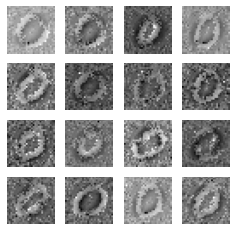

40
gen_loss: tf.Tensor(2.5103307, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07610589, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11721075, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99986768e-01 1.31990118e-05]
 [9.99999881e-01 1.68808540e-07]
 [9.99998569e-01 1.39173790e-06]
 [9.99999285e-01 7.05738387e-07]
 [9.99993682e-01 6.29220631e-06]
 [9.99929547e-01 7.04968770e-05]
 [9.99993443e-01 6.59378429e-06]
 [9.99979734e-01 2.02974006e-05]
 [9.99998808e-01 1.16028423e-06]
 [9.99985576e-01 1.44065689e-05]
 [9.99999762e-01 1.88843231e-07]
 [9.99994874e-01 5.07580171e-06]
 [9.98801470e-01 1.19856570e-03]
 [9.99993324e-01 6.64731806e-06]
 [9.99997377e-01 2.67208907e-06]
 [9.99998927e-01 1.12866792e-06]
 [9.99996305e-01 3.66695326e-06]
 [9.99995470e-01 4.56070438e-06]
 [9.99999166e-01 8.62736442e-07]
 [9.99998450e-01 1.53474309e-06]
 [9.99898791e-01 1.01245736e-04]
 [9.99999881e-01 7.62709789e-08]
 [9.99998212e-01 1.79002325e-06]
 [9.99999285e-01 7

gen_loss: tf.Tensor(2.5287964, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11735694, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.116337456, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99983311e-01 1.66671798e-05]
 [9.99999762e-01 1.89337328e-07]
 [9.99998808e-01 1.19266338e-06]
 [9.99999285e-01 7.38626966e-07]
 [9.99993920e-01 6.03881426e-06]
 [9.99922156e-01 7.78379181e-05]
 [9.99994040e-01 6.00536714e-06]
 [9.99981284e-01 1.87231035e-05]
 [9.99998927e-01 1.08048641e-06]
 [9.99986172e-01 1.37980232e-05]
 [9.99999762e-01 1.95151088e-07]
 [9.99995112e-01 4.83226449e-06]
 [9.99367774e-01 6.32207375e-04]
 [9.99994636e-01 5.30586522e-06]
 [9.99997735e-01 2.28893646e-06]
 [9.99998689e-01 1.32168475e-06]
 [9.99996424e-01 3.52955681e-06]
 [9.99994874e-01 5.11632379e-06]
 [9.99999285e-01 6.58615249e-07]
 [9.99998212e-01 1.73134185e-06]
 [9.99930382e-01 6.95739000e-05]
 [9.99999881e-01 1.10445711e-07]
 [9.99998212e-01 1.82512974e-06]
 [9.99999285e-01 7.6

gen_loss: tf.Tensor(2.5596125, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.097615905, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10838097, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99980330e-01 1.96917536e-05]
 [9.99999523e-01 4.85502824e-07]
 [9.99996662e-01 3.38275413e-06]
 [9.99998927e-01 1.02429794e-06]
 [9.99992847e-01 7.14045018e-06]
 [9.99879360e-01 1.20603167e-04]
 [9.99993086e-01 6.97033511e-06]
 [9.99968529e-01 3.14349891e-05]
 [9.99998331e-01 1.66288419e-06]
 [9.99970913e-01 2.91122160e-05]
 [9.99999762e-01 2.02201008e-07]
 [9.99993086e-01 6.88613318e-06]
 [9.98970151e-01 1.02985045e-03]
 [9.99992609e-01 7.39377219e-06]
 [9.99996781e-01 3.23327549e-06]
 [9.99998212e-01 1.75879927e-06]
 [9.99995470e-01 4.51297319e-06]
 [9.99992847e-01 7.12196515e-06]
 [9.99999166e-01 8.03878152e-07]
 [9.99997616e-01 2.38768985e-06]
 [9.99876738e-01 1.23205507e-04]
 [9.99999762e-01 2.56642153e-07]
 [9.99997020e-01 2.92494110e-06]
 [9.99998927e-01 1.0

gen_loss: tf.Tensor(2.5536509, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.122798845, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1176774, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99989510e-01 1.04946357e-05]
 [9.99999762e-01 2.39693151e-07]
 [9.99980450e-01 1.95312477e-05]
 [9.99997020e-01 3.01591263e-06]
 [9.99986649e-01 1.33394360e-05]
 [9.99826372e-01 1.73620108e-04]
 [9.99985337e-01 1.46107468e-05]
 [9.99979258e-01 2.07466310e-05]
 [9.99994874e-01 5.13082614e-06]
 [9.99942422e-01 5.75534323e-05]
 [9.99999881e-01 1.36602893e-07]
 [9.99976754e-01 2.32937291e-05]
 [9.96502876e-01 3.49709159e-03]
 [9.99991417e-01 8.61917761e-06]
 [9.99989510e-01 1.04742976e-05]
 [9.99996781e-01 3.19162291e-06]
 [9.99991655e-01 8.29639430e-06]
 [9.99991536e-01 8.51999630e-06]
 [9.99998331e-01 1.65476240e-06]
 [9.99995351e-01 4.70504528e-06]
 [9.99421120e-01 5.78901963e-04]
 [9.99999881e-01 1.19130910e-07]
 [9.99992490e-01 7.47091690e-06]
 [9.99996901e-01 3.12

gen_loss: tf.Tensor(2.5629997, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0905814, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10544949, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99990582e-01 9.40095561e-06]
 [9.99999642e-01 4.14381731e-07]
 [9.99984384e-01 1.55832877e-05]
 [9.99998331e-01 1.67671124e-06]
 [9.99989986e-01 9.96944163e-06]
 [9.99832392e-01 1.67584483e-04]
 [9.99990225e-01 9.81027824e-06]
 [9.99981403e-01 1.85915978e-05]
 [9.99997258e-01 2.70784403e-06]
 [9.99962330e-01 3.77242686e-05]
 [9.99999881e-01 1.01507581e-07]
 [9.99988198e-01 1.18482230e-05]
 [9.98312116e-01 1.68786792e-03]
 [9.99989152e-01 1.08313825e-05]
 [9.99994397e-01 5.61417710e-06]
 [9.99996305e-01 3.69890472e-06]
 [9.99992847e-01 7.13712780e-06]
 [9.99994159e-01 5.87943759e-06]
 [9.99999046e-01 1.00783620e-06]
 [9.99997139e-01 2.88769047e-06]
 [9.99570668e-01 4.29267762e-04]
 [9.99999762e-01 2.84723569e-07]
 [9.99995708e-01 4.29200054e-06]
 [9.99998212e-01 1.735

gen_loss: tf.Tensor(2.4856062, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09742993, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12112263, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99987483e-01 1.24654434e-05]
 [9.99999285e-01 7.46847093e-07]
 [9.99986649e-01 1.33472113e-05]
 [9.99998808e-01 1.23181178e-06]
 [9.99990106e-01 9.86742907e-06]
 [9.99806345e-01 1.93719738e-04]
 [9.99991179e-01 8.79797881e-06]
 [9.99977112e-01 2.29255838e-05]
 [9.99998093e-01 1.89266700e-06]
 [9.99956131e-01 4.38920579e-05]
 [9.99999881e-01 1.23220147e-07]
 [9.99992132e-01 7.87912722e-06]
 [9.99235630e-01 7.64341850e-04]
 [9.99985218e-01 1.48306590e-05]
 [9.99996066e-01 3.99257442e-06]
 [9.99994874e-01 5.15833062e-06]
 [9.99992728e-01 7.31163436e-06]
 [9.99993801e-01 6.14254532e-06]
 [9.99999166e-01 8.26402015e-07]
 [9.99997139e-01 2.91060519e-06]
 [9.99710619e-01 2.89374875e-04]
 [9.99999285e-01 6.80930896e-07]
 [9.99996305e-01 3.70421753e-06]
 [9.99998808e-01 1.24

gen_loss: tf.Tensor(2.4329596, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1436964, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12337482, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99990225e-01 9.82702022e-06]
 [9.99999762e-01 2.78511777e-07]
 [9.99946356e-01 5.36198240e-05]
 [9.99994993e-01 5.05254275e-06]
 [9.99974728e-01 2.52504487e-05]
 [9.99764502e-01 2.35504689e-04]
 [9.99973416e-01 2.66242168e-05]
 [9.99983907e-01 1.61309945e-05]
 [9.99992371e-01 7.63166099e-06]
 [9.99887466e-01 1.12507449e-04]
 [9.99999881e-01 1.42301204e-07]
 [9.99962687e-01 3.73096082e-05]
 [9.97964859e-01 2.03514425e-03]
 [9.99980688e-01 1.92614680e-05]
 [9.99981999e-01 1.80246079e-05]
 [9.99990940e-01 9.04181343e-06]
 [9.99985337e-01 1.46229168e-05]
 [9.99989748e-01 1.02011381e-05]
 [9.99997497e-01 2.51959250e-06]
 [9.99991536e-01 8.52019184e-06]
 [9.99150991e-01 8.49037722e-04]
 [9.99999762e-01 2.19490033e-07]
 [9.99987721e-01 1.22223619e-05]
 [9.99994755e-01 5.289

gen_loss: tf.Tensor(2.5519915, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13865164, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10583277, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99992371e-01 7.65422737e-06]
 [9.99999762e-01 2.87890572e-07]
 [9.99962926e-01 3.70675298e-05]
 [9.99997020e-01 2.92257096e-06]
 [9.99984264e-01 1.56869010e-05]
 [9.99888539e-01 1.11430039e-04]
 [9.99982715e-01 1.72647997e-05]
 [9.99988198e-01 1.17521868e-05]
 [9.99995112e-01 4.89788681e-06]
 [9.99949336e-01 5.06882498e-05]
 [9.99999881e-01 9.53624522e-08]
 [9.99979496e-01 2.05484284e-05]
 [9.97945368e-01 2.05466454e-03]
 [9.99988914e-01 1.10482533e-05]
 [9.99987602e-01 1.23772525e-05]
 [9.99994516e-01 5.47652098e-06]
 [9.99990821e-01 9.19405011e-06]
 [9.99993682e-01 6.31939383e-06]
 [9.99998212e-01 1.76538174e-06]
 [9.99994993e-01 4.94823553e-06]
 [9.99421835e-01 5.78170817e-04]
 [9.99999762e-01 2.22396281e-07]
 [9.99993324e-01 6.64868094e-06]
 [9.99997139e-01 2.89

gen_loss: tf.Tensor(2.557939, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12233564, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11391178, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99984145e-01 1.58893654e-05]
 [9.99999046e-01 9.10268852e-07]
 [9.99984026e-01 1.60200634e-05]
 [9.99998450e-01 1.52397786e-06]
 [9.99987841e-01 1.21877583e-05]
 [9.99909401e-01 9.06316345e-05]
 [9.99988437e-01 1.15961348e-05]
 [9.99974012e-01 2.59782319e-05]
 [9.99997497e-01 2.49498112e-06]
 [9.99956489e-01 4.35256261e-05]
 [9.99999762e-01 1.94468527e-07]
 [9.99993086e-01 6.89994431e-06]
 [9.99157786e-01 8.42202455e-04]
 [9.99988675e-01 1.13460765e-05]
 [9.99993324e-01 6.70996542e-06]
 [9.99994040e-01 5.92448214e-06]
 [9.99990463e-01 9.56089843e-06]
 [9.99991775e-01 8.17946329e-06]
 [9.99998808e-01 1.15820808e-06]
 [9.99995828e-01 4.17694901e-06]
 [9.99818385e-01 1.81630297e-04]
 [9.99999285e-01 7.04916374e-07]
 [9.99995112e-01 4.89171589e-06]
 [9.99998689e-01 1.272

gen_loss: tf.Tensor(2.6054373, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.109561354, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10928795, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99973774e-01 2.62730191e-05]
 [9.99999642e-01 4.13215986e-07]
 [9.99962687e-01 3.73071889e-05]
 [9.99985337e-01 1.46113462e-05]
 [9.99922514e-01 7.74733635e-05]
 [9.99445498e-01 5.54516970e-04]
 [9.99937415e-01 6.25254397e-05]
 [9.99952435e-01 4.75176457e-05]
 [9.99987841e-01 1.22026104e-05]
 [9.99391317e-01 6.08660106e-04]
 [9.99999166e-01 8.79515824e-07]
 [9.99936700e-01 6.32670126e-05]
 [9.99512553e-01 4.87409736e-04]
 [9.99935985e-01 6.39616628e-05]
 [9.99965549e-01 3.44858454e-05]
 [9.99959826e-01 4.01140751e-05]
 [9.99933124e-01 6.69264264e-05]
 [9.99950528e-01 4.94236338e-05]
 [9.99996781e-01 3.16592786e-06]
 [9.99970198e-01 2.98414216e-05]
 [9.99690652e-01 3.09403753e-04]
 [9.99999642e-01 3.49543598e-07]
 [9.99959826e-01 4.01559519e-05]
 [9.99988198e-01 1.1

gen_loss: tf.Tensor(2.5331335, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13574219, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.112322055, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99982119e-01 1.79379604e-05]
 [9.99999642e-01 3.54808805e-07]
 [9.99950051e-01 4.99955677e-05]
 [9.99974251e-01 2.57716983e-05]
 [9.99913931e-01 8.60842629e-05]
 [9.99585927e-01 4.14028676e-04]
 [9.99917984e-01 8.20288406e-05]
 [9.99970436e-01 2.95780155e-05]
 [9.99981999e-01 1.79689814e-05]
 [9.99650478e-01 3.49459413e-04]
 [9.99999523e-01 4.86317958e-07]
 [9.99867320e-01 1.32681118e-04]
 [9.99686956e-01 3.13114579e-04]
 [9.99938607e-01 6.13609736e-05]
 [9.99941111e-01 5.89026895e-05]
 [9.99952078e-01 4.79376467e-05]
 [9.99925971e-01 7.40039395e-05]
 [9.99960542e-01 3.94649360e-05]
 [9.99996185e-01 3.85940257e-06]
 [9.99975204e-01 2.48524939e-05]
 [9.99791801e-01 2.08208003e-04]
 [9.99999642e-01 3.45685834e-07]
 [9.99962926e-01 3.71014103e-05]
 [9.99980092e-01 1.9

gen_loss: tf.Tensor(2.474895, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12409219, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13230838, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99975324e-01 2.47334938e-05]
 [9.99999166e-01 7.83089092e-07]
 [9.99933958e-01 6.60912119e-05]
 [9.99977946e-01 2.20307538e-05]
 [9.99938965e-01 6.10219431e-05]
 [9.99717176e-01 2.82853260e-04]
 [9.99927759e-01 7.22792902e-05]
 [9.99960065e-01 3.98772572e-05]
 [9.99982834e-01 1.71404463e-05]
 [9.99789059e-01 2.10953032e-04]
 [9.99999523e-01 4.45203909e-07]
 [9.99909997e-01 8.99976803e-05]
 [9.99626040e-01 3.73963296e-04]
 [9.99947190e-01 5.28450364e-05]
 [9.99944687e-01 5.52758211e-05]
 [9.99960780e-01 3.92130569e-05]
 [9.99938846e-01 6.11329524e-05]
 [9.99965310e-01 3.47438545e-05]
 [9.99996066e-01 3.92255697e-06]
 [9.99982476e-01 1.75246041e-05]
 [9.99820292e-01 1.79701456e-04]
 [9.99999285e-01 6.70972099e-07]
 [9.99972820e-01 2.71973095e-05]
 [9.99984384e-01 1.558

 [9.99888182e-01 1.11773028e-04]], shape=(256, 2), dtype=float32)


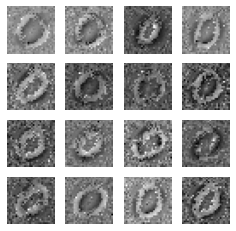

41
gen_loss: tf.Tensor(2.470982, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08585872, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.117396384, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99938250e-01 6.17349651e-05]
 [9.99998808e-01 1.14654677e-06]
 [9.99854565e-01 1.45446058e-04]
 [9.99952555e-01 4.74665139e-05]
 [9.99877334e-01 1.22695652e-04]
 [9.99185979e-01 8.14048981e-04]
 [9.99858022e-01 1.41928191e-04]
 [9.99886513e-01 1.13420028e-04]
 [9.99967098e-01 3.28979513e-05]
 [9.99135315e-01 8.64661706e-04]
 [9.99998450e-01 1.50023789e-06]
 [9.99860287e-01 1.39639524e-04]
 [9.99344885e-01 6.55120122e-04]
 [9.99875426e-01 1.24579456e-04]
 [9.99902368e-01 9.76190058e-05]
 [9.99908805e-01 9.11746101e-05]
 [9.99849558e-01 1.50456894e-04]
 [9.99889016e-01 1.10963178e-04]
 [9.99993086e-01 6.88168166e-06]
 [9.99953389e-01 4.66123020e-05]
 [9.99606550e-01 3.93431546e-04]
 [9.99999285e-01 7.62511831e-07]
 [9.99921322e-01 7.86266028e-05]
 [9.99968767e-01 3

gen_loss: tf.Tensor(2.5983267, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15839534, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10805249, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99951363e-01 4.85970486e-05]
 [9.99998808e-01 1.15818489e-06]
 [9.99908328e-01 9.17049401e-05]
 [9.99968410e-01 3.16465048e-05]
 [9.99906540e-01 9.34917407e-05]
 [9.99220729e-01 7.79223512e-04]
 [9.99891520e-01 1.08439825e-04]
 [9.99898911e-01 1.01132937e-04]
 [9.99978304e-01 2.16426743e-05]
 [9.99423862e-01 5.76124468e-04]
 [9.99998808e-01 1.20171387e-06]
 [9.99901891e-01 9.81134363e-05]
 [9.99397397e-01 6.02584973e-04]
 [9.99894500e-01 1.05508720e-04]
 [9.99933958e-01 6.60036603e-05]
 [9.99909639e-01 9.03701439e-05]
 [9.99868274e-01 1.31669061e-04]
 [9.99916911e-01 8.30233112e-05]
 [9.99995708e-01 4.24687141e-06]
 [9.99971032e-01 2.89918098e-05]
 [9.99762475e-01 2.37553293e-04]
 [9.99999046e-01 9.14510679e-07]
 [9.99948978e-01 5.10050268e-05]
 [9.99979377e-01 2.06

gen_loss: tf.Tensor(2.523786, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1444702, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11084616, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99974132e-01 2.58453856e-05]
 [9.99999046e-01 9.07806793e-07]
 [9.99929905e-01 7.00655291e-05]
 [9.99975085e-01 2.48978267e-05]
 [9.99923229e-01 7.67076490e-05]
 [9.99447405e-01 5.52619051e-04]
 [9.99904633e-01 9.53708004e-05]
 [9.99943376e-01 5.65649934e-05]
 [9.99981165e-01 1.88902395e-05]
 [9.99687791e-01 3.12265824e-04]
 [9.99999285e-01 6.57597866e-07]
 [9.99899507e-01 1.00448604e-04]
 [9.99385357e-01 6.14637160e-04]
 [9.99924660e-01 7.53822242e-05]
 [9.99935389e-01 6.45595646e-05]
 [9.99923229e-01 7.67448873e-05]
 [9.99900460e-01 9.95441806e-05]
 [9.99944568e-01 5.54726867e-05]
 [9.99996662e-01 3.28969327e-06]
 [9.99982238e-01 1.78003684e-05]
 [9.99837518e-01 1.62442928e-04]
 [9.99999166e-01 8.68226095e-07]
 [9.99964952e-01 3.50783412e-05]
 [9.99983549e-01 1.6446

gen_loss: tf.Tensor(2.6440604, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10985996, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.097446755, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99968410e-01 3.16363621e-05]
 [9.99999046e-01 9.85634870e-07]
 [9.99826968e-01 1.73029432e-04]
 [9.99927759e-01 7.22707409e-05]
 [9.99835491e-01 1.64463709e-04]
 [9.98737752e-01 1.26226200e-03]
 [9.99746501e-01 2.53455830e-04]
 [9.99924302e-01 7.57288581e-05]
 [9.99937534e-01 6.24519089e-05]
 [9.98327553e-01 1.67242449e-03]
 [9.99998689e-01 1.25979352e-06]
 [9.99602735e-01 3.97242082e-04]
 [9.99241590e-01 7.58381619e-04]
 [9.99852180e-01 1.47825631e-04]
 [9.99800384e-01 1.99588452e-04]
 [9.99851108e-01 1.48880485e-04]
 [9.99777257e-01 2.22799048e-04]
 [9.99854326e-01 1.45675614e-04]
 [9.99992847e-01 7.16518434e-06]
 [9.99944568e-01 5.54841172e-05]
 [9.99742687e-01 2.57249863e-04]
 [9.99999166e-01 8.73314093e-07]
 [9.99863267e-01 1.36766917e-04]
 [9.99951720e-01 4.8

gen_loss: tf.Tensor(2.5843325, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10102944, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.108957574, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99987721e-01 1.22445754e-05]
 [9.99999404e-01 6.55535985e-07]
 [9.99927402e-01 7.26293147e-05]
 [9.99968290e-01 3.17410449e-05]
 [9.99949098e-01 5.08838129e-05]
 [9.99253571e-01 7.46456033e-04]
 [9.99894857e-01 1.05188970e-04]
 [9.99960899e-01 3.91029025e-05]
 [9.99976516e-01 2.34998060e-05]
 [9.98809338e-01 1.19065656e-03]
 [9.99999404e-01 5.39571772e-07]
 [9.99696016e-01 3.04064917e-04]
 [9.99578774e-01 4.21179429e-04]
 [9.99941349e-01 5.86215538e-05]
 [9.99921560e-01 7.84383374e-05]
 [9.99935269e-01 6.47693523e-05]
 [9.99869943e-01 1.30083659e-04]
 [9.99934316e-01 6.57092532e-05]
 [9.99997735e-01 2.23373513e-06]
 [9.99978542e-01 2.14169067e-05]
 [9.99875069e-01 1.24956117e-04]
 [9.99999166e-01 8.83419716e-07]
 [9.99942064e-01 5.79680927e-05]
 [9.99979377e-01 2.0

test_discriminator_output: tf.Tensor(
[[9.99989629e-01 1.03960983e-05]
 [9.99999166e-01 7.95694064e-07]
 [9.99922276e-01 7.77721871e-05]
 [9.99973893e-01 2.61542282e-05]
 [9.99959826e-01 4.01500547e-05]
 [9.99430835e-01 5.69095544e-04]
 [9.99905348e-01 9.46992805e-05]
 [9.99962687e-01 3.72631694e-05]
 [9.99977708e-01 2.22815979e-05]
 [9.98980224e-01 1.01973838e-03]
 [9.99999642e-01 3.87482913e-07]
 [9.99716461e-01 2.83481146e-04]
 [9.99549210e-01 4.50814667e-04]
 [9.99943972e-01 5.60453518e-05]
 [9.99924302e-01 7.57215676e-05]
 [9.99951839e-01 4.81513853e-05]
 [9.99895453e-01 1.04479397e-04]
 [9.99948859e-01 5.11926337e-05]
 [9.99997735e-01 2.28141334e-06]
 [9.99983549e-01 1.64241264e-05]
 [9.99882102e-01 1.17923926e-04]
 [9.99998927e-01 1.07815708e-06]
 [9.99953151e-01 4.68012840e-05]
 [9.99982953e-01 1.70456078e-05]
 [9.99934554e-01 6.54167088e-05]
 [9.99963164e-01 3.67771136e-05]
 [9.99992371e-01 7.57354928e-06]
 [9.99939442e-01 6.05318528e-05]
 [9.98836100e-01 1.16389128e-03]
 [9.9

gen_loss: tf.Tensor(2.5182664, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11213148, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11136922, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99978781e-01 2.12117357e-05]
 [9.99999046e-01 9.39704080e-07]
 [9.99636412e-01 3.63551604e-04]
 [9.99915481e-01 8.44833194e-05]
 [9.99863505e-01 1.36463903e-04]
 [9.98914242e-01 1.08579954e-03]
 [9.99653220e-01 3.46766639e-04]
 [9.99923110e-01 7.68952086e-05]
 [9.99889612e-01 1.10330016e-04]
 [9.96438861e-01 3.56116518e-03]
 [9.99999166e-01 7.99970167e-07]
 [9.99274790e-01 7.25277641e-04]
 [9.99035716e-01 9.64332605e-04]
 [9.99836564e-01 1.63447563e-04]
 [9.99637604e-01 3.62418999e-04]
 [9.99901652e-01 9.83177961e-05]
 [9.99724448e-01 2.75536702e-04]
 [9.99875426e-01 1.24606304e-04]
 [9.99986649e-01 1.33665217e-05]
 [9.99941230e-01 5.87183968e-05]
 [9.99677777e-01 3.22225358e-04]
 [9.99999046e-01 9.11881443e-07]
 [9.99781072e-01 2.18965943e-04]
 [9.99940515e-01 5.94

gen_loss: tf.Tensor(2.5618417, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10867194, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.112878084, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99969125e-01 3.08692142e-05]
 [9.99998927e-01 1.02693195e-06]
 [9.99613225e-01 3.86787113e-04]
 [9.99909163e-01 9.08345246e-05]
 [9.99838471e-01 1.61447853e-04]
 [9.98837054e-01 1.16302248e-03]
 [9.99548495e-01 4.51475440e-04]
 [9.99926090e-01 7.38899835e-05]
 [9.99842048e-01 1.57877017e-04]
 [9.95097220e-01 4.90278099e-03]
 [9.99999166e-01 8.83687676e-07]
 [9.99312639e-01 6.87384920e-04]
 [9.99513030e-01 4.87024517e-04]
 [9.99809802e-01 1.90271967e-04]
 [9.99508858e-01 4.91142389e-04]
 [9.99882698e-01 1.17331023e-04]
 [9.99629855e-01 3.70138092e-04]
 [9.99853730e-01 1.46249600e-04]
 [9.99983072e-01 1.68746483e-05]
 [9.99920249e-01 7.97154134e-05]
 [9.99806702e-01 1.93334810e-04]
 [9.99998927e-01 1.02052456e-06]
 [9.99692082e-01 3.07892158e-04]
 [9.99937177e-01 6.2

gen_loss: tf.Tensor(2.566441, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12136971, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10605025, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99969125e-01 3.08428789e-05]
 [9.99998927e-01 1.11803729e-06]
 [9.99795854e-01 2.04141252e-04]
 [9.99950528e-01 4.94406522e-05]
 [9.99883533e-01 1.16396732e-04]
 [9.99099255e-01 9.00785672e-04]
 [9.99706328e-01 2.93633901e-04]
 [9.99934077e-01 6.59487341e-05]
 [9.99906898e-01 9.30397509e-05]
 [9.96896982e-01 3.10307322e-03]
 [9.99999166e-01 7.82882978e-07]
 [9.99673128e-01 3.26928508e-04]
 [9.99718249e-01 2.81710760e-04]
 [9.99851942e-01 1.47989369e-04]
 [9.99716699e-01 2.83296918e-04]
 [9.99903321e-01 9.66228690e-05]
 [9.99708712e-01 2.91298406e-04]
 [9.99888062e-01 1.11947971e-04]
 [9.99990106e-01 9.94142556e-06]
 [9.99946713e-01 5.33247367e-05]
 [9.99909401e-01 9.06100322e-05]
 [9.99998808e-01 1.21407288e-06]
 [9.99799907e-01 2.00153314e-04]
 [9.99967098e-01 3.292

test_discriminator_output: tf.Tensor(
[[9.99968648e-01 3.14086792e-05]
 [9.99999046e-01 1.01173543e-06]
 [9.99819458e-01 1.80538889e-04]
 [9.99949336e-01 5.06323522e-05]
 [9.99852896e-01 1.47089289e-04]
 [9.98885214e-01 1.11481897e-03]
 [9.99688387e-01 3.11691518e-04]
 [9.99927282e-01 7.26823855e-05]
 [9.99906898e-01 9.30439201e-05]
 [9.96334314e-01 3.66568286e-03]
 [9.99999046e-01 9.96230369e-07]
 [9.99699950e-01 3.00096348e-04]
 [9.99706805e-01 2.93183257e-04]
 [9.99803960e-01 1.96091773e-04]
 [9.99720991e-01 2.79033702e-04]
 [9.99880314e-01 1.19667136e-04]
 [9.99645352e-01 3.54642019e-04]
 [9.99867678e-01 1.32298068e-04]
 [9.99990106e-01 9.91244633e-06]
 [9.99940276e-01 5.97346698e-05]
 [9.99916315e-01 8.37275074e-05]
 [9.99998927e-01 1.05492165e-06]
 [9.99771297e-01 2.28750840e-04]
 [9.99966502e-01 3.34515207e-05]
 [9.99818504e-01 1.81542520e-04]
 [9.99931812e-01 6.81784295e-05]
 [9.99971628e-01 2.83469017e-05]
 [9.99956012e-01 4.40007643e-05]
 [9.99197066e-01 8.02983006e-04]
 [9.9

test_discriminator_output: tf.Tensor(
[[9.99966502e-01 3.34556025e-05]
 [9.99998927e-01 1.07502865e-06]
 [9.99817312e-01 1.82752003e-04]
 [9.99942064e-01 5.79405096e-05]
 [9.99778211e-01 2.21822309e-04]
 [9.98461127e-01 1.53887447e-03]
 [9.99634862e-01 3.65171320e-04]
 [9.99900699e-01 9.92898276e-05]
 [9.99897003e-01 1.03009064e-04]
 [9.95572925e-01 4.42702649e-03]
 [9.99998569e-01 1.39895974e-06]
 [9.99705017e-01 2.94923928e-04]
 [9.99607623e-01 3.92424321e-04]
 [9.99685764e-01 3.14233592e-04]
 [9.99695063e-01 3.04921850e-04]
 [9.99840617e-01 1.59402698e-04]
 [9.99552190e-01 4.47766972e-04]
 [9.99833465e-01 1.66461716e-04]
 [9.99987602e-01 1.24530170e-05]
 [9.99929309e-01 7.06768624e-05]
 [9.99911070e-01 8.89705625e-05]
 [9.99999046e-01 1.01112005e-06]
 [9.99711335e-01 2.88652111e-04]
 [9.99961376e-01 3.85887215e-05]
 [9.99778092e-01 2.21888084e-04]
 [9.99899745e-01 1.00204845e-04]
 [9.99958873e-01 4.11438741e-05]
 [9.99944448e-01 5.55307961e-05]
 [9.98941481e-01 1.05848012e-03]
 [9.9

gen_loss: tf.Tensor(2.5981226, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13343486, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.104268715, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99976635e-01 2.33173523e-05]
 [9.99998927e-01 1.09524319e-06]
 [9.99882817e-01 1.17167787e-04]
 [9.99952316e-01 4.77267313e-05]
 [9.99754846e-01 2.45125120e-04]
 [9.98055100e-01 1.94496161e-03]
 [9.99699116e-01 3.00954765e-04]
 [9.99899507e-01 1.00438076e-04]
 [9.99915600e-01 8.43706075e-05]
 [9.96515393e-01 3.48457485e-03]
 [9.99998808e-01 1.18601235e-06]
 [9.99737680e-01 2.62345624e-04]
 [9.99623537e-01 3.76483338e-04]
 [9.99649525e-01 3.50436545e-04]
 [9.99760091e-01 2.39894915e-04]
 [9.99822676e-01 1.77366412e-04]
 [9.99594867e-01 4.05200903e-04]
 [9.99842048e-01 1.57926726e-04]
 [9.99990582e-01 9.46446471e-06]
 [9.99943018e-01 5.69337462e-05]
 [9.99945641e-01 5.43781243e-05]
 [9.99998927e-01 1.05531512e-06]
 [9.99770820e-01 2.29235331e-04]
 [9.99968290e-01 3.1

gen_loss: tf.Tensor(2.5533032, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10182191, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.107715204, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99985576e-01 1.44358073e-05]
 [9.99999404e-01 6.09296194e-07]
 [9.99916553e-01 8.33934610e-05]
 [9.99955416e-01 4.45977639e-05]
 [9.99790013e-01 2.10004000e-04]
 [9.98133242e-01 1.86680350e-03]
 [9.99730051e-01 2.69928132e-04]
 [9.99940395e-01 5.96487189e-05]
 [9.99919891e-01 8.00730340e-05]
 [9.97091413e-01 2.90853065e-03]
 [9.99999166e-01 7.85695306e-07]
 [9.99681711e-01 3.18308332e-04]
 [9.99712527e-01 2.87488190e-04]
 [9.99780238e-01 2.19718189e-04]
 [9.99787390e-01 2.12682848e-04]
 [9.99838829e-01 1.61087868e-04]
 [9.99676943e-01 3.23088258e-04]
 [9.99852538e-01 1.47447659e-04]
 [9.99994755e-01 5.23404833e-06]
 [9.99947309e-01 5.26492076e-05]
 [9.99956369e-01 4.36466253e-05]
 [9.99999404e-01 6.17912235e-07]
 [9.99810874e-01 1.89117622e-04]
 [9.99970794e-01 2.9

test_discriminator_output: tf.Tensor(
[[9.99982834e-01 1.72045620e-05]
 [9.99999285e-01 7.03263197e-07]
 [9.99908686e-01 9.13615659e-05]
 [9.99947786e-01 5.22327391e-05]
 [9.99754727e-01 2.45304691e-04]
 [9.98065412e-01 1.93457410e-03]
 [9.99671221e-01 3.28742812e-04]
 [9.99932766e-01 6.71764865e-05]
 [9.99891996e-01 1.07948006e-04]
 [9.96859908e-01 3.14008980e-03]
 [9.99999166e-01 8.61378282e-07]
 [9.99636889e-01 3.63087980e-04]
 [9.99753058e-01 2.46922602e-04]
 [9.99782622e-01 2.17402805e-04]
 [9.99724805e-01 2.75182538e-04]
 [9.99833703e-01 1.66257727e-04]
 [9.99673247e-01 3.26780777e-04]
 [9.99830008e-01 1.69977720e-04]
 [9.99993682e-01 6.37230505e-06]
 [9.99935746e-01 6.42321393e-05]
 [9.99963045e-01 3.69196423e-05]
 [9.99999285e-01 7.14900295e-07]
 [9.99772727e-01 2.27337980e-04]
 [9.99966025e-01 3.39331455e-05]
 [9.99795258e-01 2.04766999e-04]
 [9.99934673e-01 6.53718744e-05]
 [9.99957085e-01 4.28869898e-05]
 [9.99974728e-01 2.52394475e-05]
 [9.98185337e-01 1.81465456e-03]
 [9.9

test_discriminator_output: tf.Tensor(
[[9.99978185e-01 2.18591049e-05]
 [9.99999046e-01 9.18567309e-07]
 [9.99889851e-01 1.10092187e-04]
 [9.99934196e-01 6.58335630e-05]
 [9.99700308e-01 2.99758627e-04]
 [9.97856915e-01 2.14311783e-03]
 [9.99577343e-01 4.22632555e-04]
 [9.99916196e-01 8.38497508e-05]
 [9.99848485e-01 1.51543252e-04]
 [9.96149063e-01 3.85100953e-03]
 [9.99999046e-01 9.61373189e-07]
 [9.99540448e-01 4.59595671e-04]
 [9.99789298e-01 2.10683880e-04]
 [9.99747217e-01 2.52732367e-04]
 [9.99618292e-01 3.81710532e-04]
 [9.99824464e-01 1.75571564e-04]
 [9.99662995e-01 3.36974976e-04]
 [9.99795616e-01 2.04391326e-04]
 [9.99991417e-01 8.56034330e-06]
 [9.99919772e-01 8.01897986e-05]
 [9.99967098e-01 3.29381983e-05]
 [9.99999046e-01 9.07147296e-07]
 [9.99714315e-01 2.85682414e-04]
 [9.99957681e-01 4.22831217e-05]
 [9.99762714e-01 2.37290922e-04]
 [9.99941349e-01 5.86660717e-05]
 [9.99947906e-01 5.20963367e-05]
 [9.99974608e-01 2.54319420e-05]
 [9.99057710e-01 9.42324637e-04]
 [9.9

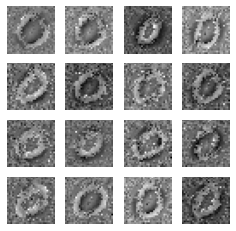

42
gen_loss: tf.Tensor(2.6221087, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12408819, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09995957, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99972939e-01 2.70514447e-05]
 [9.99998927e-01 1.01497562e-06]
 [9.99854088e-01 1.45833779e-04]
 [9.99912620e-01 8.74123434e-05]
 [9.99604642e-01 3.95355397e-04]
 [9.97500837e-01 2.49910168e-03]
 [9.99426365e-01 5.73668571e-04]
 [9.99889135e-01 1.10908913e-04]
 [9.99781191e-01 2.18859073e-04]
 [9.94961381e-01 5.03860600e-03]
 [9.99998808e-01 1.15480543e-06]
 [9.99389887e-01 6.10079500e-04]
 [9.99755919e-01 2.44126422e-04]
 [9.99676824e-01 3.23250628e-04]
 [9.99428213e-01 5.71808720e-04]
 [9.99804199e-01 1.95785367e-04]
 [9.99617100e-01 3.82822909e-04]
 [9.99757588e-01 2.42373746e-04]
 [9.99986291e-01 1.36882718e-05]
 [9.99896288e-01 1.03690145e-04]
 [9.99964118e-01 3.58927427e-05]
 [9.99999046e-01 9.40213226e-07]
 [9.99606550e-01 3.93526483e-04]
 [9.99943256e-01 5

test_discriminator_output: tf.Tensor(
[[9.99967933e-01 3.21040716e-05]
 [9.99999166e-01 8.63983018e-07]
 [9.99828577e-01 1.71403924e-04]
 [9.99883533e-01 1.16489566e-04]
 [9.99468267e-01 5.31802594e-04]
 [9.96860266e-01 3.13977967e-03]
 [9.99219418e-01 7.80533359e-04]
 [9.99852896e-01 1.47076382e-04]
 [9.99720752e-01 2.79222644e-04]
 [9.93428290e-01 6.57173200e-03]
 [9.99998331e-01 1.62579863e-06]
 [9.99228597e-01 7.71422288e-04]
 [9.99699116e-01 3.00889602e-04]
 [9.99538302e-01 4.61717427e-04]
 [9.99220848e-01 7.79122871e-04]
 [9.99772370e-01 2.27589961e-04]
 [9.99527812e-01 4.72191867e-04]
 [9.99694824e-01 3.05242138e-04]
 [9.99978662e-01 2.12978375e-05]
 [9.99866128e-01 1.33909823e-04]
 [9.99953508e-01 4.64410332e-05]
 [9.99999285e-01 7.62366426e-07]
 [9.99458492e-01 5.41474554e-04]
 [9.99922872e-01 7.71366904e-05]
 [9.99695897e-01 3.04129266e-04]
 [9.99875069e-01 1.24958504e-04]
 [9.99906421e-01 9.35458665e-05]
 [9.99961257e-01 3.86868451e-05]
 [9.99027610e-01 9.72344715e-04]
 [9.9

gen_loss: tf.Tensor(2.5867891, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13385719, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.103805244, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99982953e-01 1.70316180e-05]
 [9.99999523e-01 4.39824987e-07]
 [9.99907613e-01 9.23880871e-05]
 [9.99928117e-01 7.18972151e-05]
 [9.99752343e-01 2.47695105e-04]
 [9.97447491e-01 2.55248044e-03]
 [9.99526858e-01 4.73199412e-04]
 [9.99921203e-01 7.88069883e-05]
 [9.99868393e-01 1.31573921e-04]
 [9.94547665e-01 5.45234047e-03]
 [9.99999166e-01 8.59704130e-07]
 [9.99217272e-01 7.82712304e-04]
 [9.99832988e-01 1.66983300e-04]
 [9.99598086e-01 4.01940400e-04]
 [9.99561846e-01 4.38137009e-04]
 [9.99864340e-01 1.35670518e-04]
 [9.99697804e-01 3.02238914e-04]
 [9.99820888e-01 1.79101204e-04]
 [9.99990344e-01 9.68857330e-06]
 [9.99932170e-01 6.77710850e-05]
 [9.99960423e-01 3.96243813e-05]
 [9.99999523e-01 4.40301307e-07]
 [9.99761522e-01 2.38505774e-04]
 [9.99952316e-01 4.7

gen_loss: tf.Tensor(2.6425824, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08929676, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.095282435, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99982953e-01 1.70333715e-05]
 [9.99999404e-01 5.53108521e-07]
 [9.99915361e-01 8.45911854e-05]
 [9.99934793e-01 6.52586386e-05]
 [9.99839544e-01 1.60470518e-04]
 [9.97802675e-01 2.19734828e-03]
 [9.99596059e-01 4.04007529e-04]
 [9.99914527e-01 8.54497557e-05]
 [9.99879599e-01 1.20419652e-04]
 [9.94393110e-01 5.60687156e-03]
 [9.99999285e-01 7.53699510e-07]
 [9.99234915e-01 7.65147968e-04]
 [9.99841571e-01 1.58357070e-04]
 [9.99701917e-01 2.98053055e-04]
 [9.99576747e-01 4.23306104e-04]
 [9.99887943e-01 1.12036389e-04]
 [9.99743640e-01 2.56326864e-04]
 [9.99823153e-01 1.76864152e-04]
 [9.99993205e-01 6.79931645e-06]
 [9.99939203e-01 6.07899092e-05]
 [9.99968886e-01 3.11569274e-05]
 [9.99999523e-01 5.31598857e-07]
 [9.99812305e-01 1.87693411e-04]
 [9.99958515e-01 4.1

gen_loss: tf.Tensor(2.5561411, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.103087835, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10804734, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99959469e-01 4.04907260e-05]
 [9.99998331e-01 1.72006366e-06]
 [9.99856949e-01 1.43032463e-04]
 [9.99915600e-01 8.44364477e-05]
 [9.99797761e-01 2.02280993e-04]
 [9.97924209e-01 2.07576551e-03]
 [9.99431193e-01 5.68840711e-04]
 [9.99803364e-01 1.96676730e-04]
 [9.99800384e-01 1.99672970e-04]
 [9.93400455e-01 6.59958087e-03]
 [9.99998689e-01 1.26727662e-06]
 [9.99335706e-01 6.64210122e-04]
 [9.99736130e-01 2.63852155e-04]
 [9.99653459e-01 3.46558576e-04]
 [9.99295473e-01 7.04464328e-04]
 [9.99872208e-01 1.27790991e-04]
 [9.99708354e-01 2.91640201e-04]
 [9.99731600e-01 2.68334406e-04]
 [9.99987602e-01 1.24476974e-05]
 [9.99903083e-01 9.69518151e-05]
 [9.99971747e-01 2.82184901e-05]
 [9.99998569e-01 1.39449207e-06]
 [9.99726832e-01 2.73189828e-04]
 [9.99950051e-01 4.9

gen_loss: tf.Tensor(2.5421867, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11765642, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11259665, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99951839e-01 4.81459683e-05]
 [9.99998450e-01 1.53599069e-06]
 [9.99811471e-01 1.88534628e-04]
 [9.99906778e-01 9.31569375e-05]
 [9.99729335e-01 2.70681427e-04]
 [9.97453749e-01 2.54626130e-03]
 [9.99326229e-01 6.73824747e-04]
 [9.99840736e-01 1.59184419e-04]
 [9.99767125e-01 2.32848615e-04]
 [9.92900610e-01 7.09935511e-03]
 [9.99998689e-01 1.33332821e-06]
 [9.99334633e-01 6.65283005e-04]
 [9.99701023e-01 2.98998551e-04]
 [9.99565065e-01 4.34937188e-04]
 [9.99169588e-01 8.30439443e-04]
 [9.99832511e-01 1.67515173e-04]
 [9.99665022e-01 3.35008866e-04]
 [9.99706209e-01 2.93739751e-04]
 [9.99986172e-01 1.37808483e-05]
 [9.99872208e-01 1.27773674e-04]
 [9.99952912e-01 4.70816049e-05]
 [9.99998689e-01 1.27756073e-06]
 [9.99668241e-01 3.31738760e-04]
 [9.99944687e-01 5.52

gen_loss: tf.Tensor(2.701553, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.109928355, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.096879825, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99944687e-01 5.52859419e-05]
 [9.99998689e-01 1.28094257e-06]
 [9.99691248e-01 3.08737828e-04]
 [9.99792755e-01 2.07284960e-04]
 [9.99317169e-01 6.82795013e-04]
 [9.92766976e-01 7.23295845e-03]
 [9.98616934e-01 1.38300727e-03]
 [9.99873281e-01 1.26711166e-04]
 [9.99541402e-01 4.58673923e-04]
 [9.80956912e-01 1.90430768e-02]
 [9.99998093e-01 1.86352293e-06]
 [9.98151004e-01 1.84902002e-03]
 [9.99772608e-01 2.27396071e-04]
 [9.98810410e-01 1.18960522e-03]
 [9.98366654e-01 1.63337367e-03]
 [9.99566138e-01 4.33863228e-04]
 [9.99229193e-01 7.70849059e-04]
 [9.99459445e-01 5.40505396e-04]
 [9.99978423e-01 2.16235512e-05]
 [9.99713361e-01 2.86596041e-04]
 [9.99920368e-01 7.96429231e-05]
 [9.99998808e-01 1.18896469e-06]
 [9.99247432e-01 7.52587570e-04]
 [9.99869943e-01 1.3

gen_loss: tf.Tensor(2.620445, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08903651, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10189504, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99964118e-01 3.58408834e-05]
 [9.99998569e-01 1.42342606e-06]
 [9.99804795e-01 1.95215529e-04]
 [9.99905825e-01 9.41929538e-05]
 [9.99697566e-01 3.02430562e-04]
 [9.96811211e-01 3.18879005e-03]
 [9.99207556e-01 7.92490086e-04]
 [9.99927521e-01 7.25266000e-05]
 [9.99687910e-01 3.12078308e-04]
 [9.94363904e-01 5.63605037e-03]
 [9.99999285e-01 7.68953441e-07]
 [9.99023318e-01 9.76708601e-04]
 [9.99772727e-01 2.27227210e-04]
 [9.99650955e-01 3.49085487e-04]
 [9.98922229e-01 1.07776129e-03]
 [9.99783576e-01 2.16453016e-04]
 [9.99639750e-01 3.60242993e-04]
 [9.99805629e-01 1.94433465e-04]
 [9.99985814e-01 1.41639030e-05]
 [9.99877334e-01 1.22602185e-04]
 [9.99959230e-01 4.07617699e-05]
 [9.99998450e-01 1.53672329e-06]
 [9.99679446e-01 3.20550898e-04]
 [9.99941349e-01 5.859

test_discriminator_output: tf.Tensor(
[[9.99950647e-01 4.93963562e-05]
 [9.99998569e-01 1.40832071e-06]
 [9.99728024e-01 2.71964498e-04]
 [9.99872088e-01 1.27860083e-04]
 [9.99616265e-01 3.83755396e-04]
 [9.95900452e-01 4.09957720e-03]
 [9.98924792e-01 1.07522786e-03]
 [9.99875903e-01 1.24139988e-04]
 [9.99575555e-01 4.24479978e-04]
 [9.91477907e-01 8.52211006e-03]
 [9.99998689e-01 1.32978141e-06]
 [9.98879850e-01 1.12011959e-03]
 [9.99658465e-01 3.41494189e-04]
 [9.99572337e-01 4.27661376e-04]
 [9.98605669e-01 1.39433658e-03]
 [9.99737680e-01 2.62321351e-04]
 [9.99509692e-01 4.90321720e-04]
 [9.99714553e-01 2.85399816e-04]
 [9.99976754e-01 2.32964176e-05]
 [9.99822915e-01 1.77115609e-04]
 [9.99946237e-01 5.37412488e-05]
 [9.99998689e-01 1.31877630e-06]
 [9.99495745e-01 5.04266936e-04]
 [9.99921083e-01 7.89391415e-05]
 [9.99732316e-01 2.67719588e-04]
 [9.99847889e-01 1.52047083e-04]
 [9.99958277e-01 4.17745978e-05]
 [9.99964237e-01 3.58085381e-05]
 [9.98769104e-01 1.23082357e-03]
 [9.9

gen_loss: tf.Tensor(2.6330523, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1010595, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10117859, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99955654e-01 4.43937097e-05]
 [9.99999046e-01 1.00719149e-06]
 [9.99800980e-01 1.99024798e-04]
 [9.99891996e-01 1.08022359e-04]
 [9.99709666e-01 2.90277298e-04]
 [9.95588899e-01 4.41106176e-03]
 [9.99065459e-01 9.34504787e-04]
 [9.99854207e-01 1.45746337e-04]
 [9.99665618e-01 3.34422977e-04]
 [9.88192260e-01 1.18076941e-02]
 [9.99998331e-01 1.63114419e-06]
 [9.98889983e-01 1.10999821e-03]
 [9.99636531e-01 3.63475352e-04]
 [9.99580324e-01 4.19662276e-04]
 [9.98977184e-01 1.02286856e-03]
 [9.99768555e-01 2.31413098e-04]
 [9.99503732e-01 4.96297027e-04]
 [9.99705732e-01 2.94247933e-04]
 [9.99977827e-01 2.21133887e-05]
 [9.99843717e-01 1.56249269e-04]
 [9.99952555e-01 4.74930966e-05]
 [9.99999166e-01 8.77239017e-07]
 [9.99519706e-01 4.80357237e-04]
 [9.99933481e-01 6.648

test_discriminator_output: tf.Tensor(
[[9.99963880e-01 3.61052444e-05]
 [9.99999046e-01 9.15002715e-07]
 [9.99896049e-01 1.03924147e-04]
 [9.99936342e-01 6.36040131e-05]
 [9.99825418e-01 1.74655725e-04]
 [9.96971726e-01 3.02825100e-03]
 [9.99403119e-01 5.96888945e-04]
 [9.99881506e-01 1.18462878e-04]
 [9.99807179e-01 1.92797088e-04]
 [9.92474377e-01 7.52562797e-03]
 [9.99998689e-01 1.27793612e-06]
 [9.99276936e-01 7.23122328e-04]
 [9.99720514e-01 2.79413041e-04]
 [9.99727070e-01 2.72892765e-04]
 [9.99403238e-01 5.96732134e-04]
 [9.99845505e-01 1.54510199e-04]
 [9.99664426e-01 3.35583114e-04]
 [9.99811113e-01 1.88926220e-04]
 [9.99985099e-01 1.49516081e-05]
 [9.99907851e-01 9.21533356e-05]
 [9.99974966e-01 2.50725989e-05]
 [9.99999046e-01 8.98892040e-07]
 [9.99721348e-01 2.78592954e-04]
 [9.99961376e-01 3.86791762e-05]
 [9.99868393e-01 1.31545821e-04]
 [9.99901772e-01 9.82579077e-05]
 [9.99981999e-01 1.79837589e-05]
 [9.99958754e-01 4.12764712e-05]
 [9.96435761e-01 3.56424088e-03]
 [9.9

gen_loss: tf.Tensor(2.7975101, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.096076034, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08647373, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99961019e-01 3.89970301e-05]
 [9.99999046e-01 9.26737130e-07]
 [9.99920130e-01 7.98970796e-05]
 [9.99925733e-01 7.42458942e-05]
 [9.99835849e-01 1.64144440e-04]
 [9.97465730e-01 2.53428170e-03]
 [9.99287665e-01 7.12334644e-04]
 [9.99902248e-01 9.76998344e-05]
 [9.99755204e-01 2.44826864e-04]
 [9.93773520e-01 6.22654567e-03]
 [9.99998689e-01 1.28784359e-06]
 [9.99034166e-01 9.65879241e-04]
 [9.99793231e-01 2.06795390e-04]
 [9.99757349e-01 2.42630864e-04]
 [9.99201238e-01 7.98773719e-04]
 [9.99854207e-01 1.45712431e-04]
 [9.99692678e-01 3.07328504e-04]
 [9.99851227e-01 1.48751933e-04]
 [9.99977350e-01 2.26816101e-05]
 [9.99913692e-01 8.63480091e-05]
 [9.99989986e-01 9.99048552e-06]
 [9.99998808e-01 1.15651596e-06]
 [9.99737680e-01 2.62271555e-04]
 [9.99956608e-01 4.3

test_discriminator_output: tf.Tensor(
[[9.9995077e-01 4.9197119e-05]
 [9.9999917e-01 8.1865664e-07]
 [9.9985182e-01 1.4817096e-04]
 [9.9984109e-01 1.5889767e-04]
 [9.9970740e-01 2.9262170e-04]
 [9.9642134e-01 3.5787416e-03]
 [9.9867082e-01 1.3292042e-03]
 [9.9987090e-01 1.2903442e-04]
 [9.9950087e-01 4.9909216e-04]
 [9.8869354e-01 1.1306470e-02]
 [9.9999785e-01 2.1285121e-06]
 [9.9812573e-01 1.8742550e-03]
 [9.9967360e-01 3.2636296e-04]
 [9.9956292e-01 4.3706995e-04]
 [9.9832588e-01 1.6741491e-03]
 [9.9978656e-01 2.1340761e-04]
 [9.9952114e-01 4.7882504e-04]
 [9.9977666e-01 2.2329603e-04]
 [9.9994719e-01 5.2851687e-05]
 [9.9985003e-01 1.4997348e-04]
 [9.9998593e-01 1.4056241e-05]
 [9.9999905e-01 9.5902249e-07]
 [9.9949229e-01 5.0772633e-04]
 [9.9990606e-01 9.3873008e-05]
 [9.9978632e-01 2.1371896e-04]
 [9.9986041e-01 1.3957018e-04]
 [9.9995089e-01 4.9137063e-05]
 [9.9996579e-01 3.4234716e-05]
 [9.9968076e-01 3.1922487e-04]
 [9.9618572e-01 3.8142838e-03]
 [9.9999392e-01 6.1186220e-06]
 

gen_loss: tf.Tensor(2.7164235, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10565399, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09295683, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99955177e-01 4.48709616e-05]
 [9.99999166e-01 7.98414590e-07]
 [9.99766529e-01 2.33489336e-04]
 [9.99796569e-01 2.03413787e-04]
 [9.99757826e-01 2.42169102e-04]
 [9.96573448e-01 3.42652667e-03]
 [9.98623252e-01 1.37673644e-03]
 [9.99873400e-01 1.26594517e-04]
 [9.99362409e-01 6.37652993e-04]
 [9.81841147e-01 1.81589387e-02]
 [9.99997854e-01 2.17204820e-06]
 [9.97616649e-01 2.38335039e-03]
 [9.99701560e-01 2.98382860e-04]
 [9.99534607e-01 4.65405552e-04]
 [9.97887075e-01 2.11296487e-03]
 [9.99800026e-01 1.99988877e-04]
 [9.99503016e-01 4.96917288e-04]
 [9.99731600e-01 2.68402218e-04]
 [9.99946237e-01 5.37710839e-05]
 [9.99820054e-01 1.80005707e-04]
 [9.99980450e-01 1.95713183e-05]
 [9.99999285e-01 7.58563260e-07]
 [9.99410748e-01 5.89264673e-04]
 [9.99879837e-01 1.20

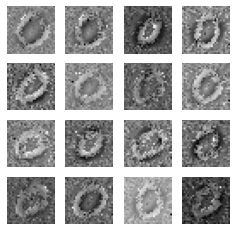

43
gen_loss: tf.Tensor(2.7800949, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11818057, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0877198, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99963164e-01 3.67819193e-05]
 [9.99999166e-01 8.74579314e-07]
 [9.99866366e-01 1.33646929e-04]
 [9.99899507e-01 1.00513105e-04]
 [9.99882817e-01 1.17167787e-04]
 [9.97594535e-01 2.40542041e-03]
 [9.99302864e-01 6.97157870e-04]
 [9.99886751e-01 1.13282767e-04]
 [9.99711096e-01 2.88922485e-04]
 [9.88523781e-01 1.14761945e-02]
 [9.99998450e-01 1.57581132e-06]
 [9.98945057e-01 1.05493865e-03]
 [9.99792397e-01 2.07656863e-04]
 [9.99680400e-01 3.19590006e-04]
 [9.99046028e-01 9.53969720e-04]
 [9.99872565e-01 1.27390333e-04]
 [9.99699473e-01 3.00501735e-04]
 [9.99799430e-01 2.00601338e-04]
 [9.99976873e-01 2.31224694e-05]
 [9.99898911e-01 1.01123958e-04]
 [9.99983311e-01 1.66888767e-05]
 [9.99999166e-01 7.78943388e-07]
 [9.99709904e-01 2.90065684e-04]
 [9.99942899e-01 5.

gen_loss: tf.Tensor(2.6974244, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08946094, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.094022036, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99981165e-01 1.88446447e-05]
 [9.99999523e-01 5.34107187e-07]
 [9.99936700e-01 6.33010495e-05]
 [9.99959946e-01 4.00587633e-05]
 [9.99950171e-01 4.97931542e-05]
 [9.98703718e-01 1.29631616e-03]
 [9.99701202e-01 2.98785977e-04]
 [9.99933720e-01 6.63330429e-05]
 [9.99898791e-01 1.01186459e-04]
 [9.96236265e-01 3.76370386e-03]
 [9.99999046e-01 9.05353943e-07]
 [9.99684572e-01 3.15457350e-04]
 [9.99774754e-01 2.25313866e-04]
 [9.99856234e-01 1.43796904e-04]
 [9.99660015e-01 3.39957100e-04]
 [9.99929547e-01 7.04331760e-05]
 [9.99855161e-01 1.44805628e-04]
 [9.99892116e-01 1.07910972e-04]
 [9.99993324e-01 6.72627129e-06]
 [9.99956846e-01 4.31667067e-05]
 [9.99977589e-01 2.24059095e-05]
 [9.99999523e-01 4.65148872e-07]
 [9.99894381e-01 1.05607971e-04]
 [9.99977469e-01 2.2

gen_loss: tf.Tensor(2.615973, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09320718, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10924779, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99981165e-01 1.87984424e-05]
 [9.99999523e-01 5.18446143e-07]
 [9.99896765e-01 1.03173516e-04]
 [9.99933004e-01 6.69672736e-05]
 [9.99920964e-01 7.89974220e-05]
 [9.98413682e-01 1.58625504e-03]
 [9.99539852e-01 4.60189214e-04]
 [9.99922156e-01 7.78584144e-05]
 [9.99830008e-01 1.70010142e-04]
 [9.95812595e-01 4.18733899e-03]
 [9.99998808e-01 1.13798876e-06]
 [9.99587595e-01 4.12437425e-04]
 [9.99503255e-01 4.96728171e-04]
 [9.99822080e-01 1.77959999e-04]
 [9.99438465e-01 5.61556662e-04]
 [9.99907732e-01 9.22205800e-05]
 [9.99817312e-01 1.82750096e-04]
 [9.99878645e-01 1.21382291e-04]
 [9.99990225e-01 9.79492779e-06]
 [9.99942780e-01 5.72762838e-05]
 [9.99957323e-01 4.26618681e-05]
 [9.99999523e-01 4.24642366e-07]
 [9.99858618e-01 1.41322103e-04]
 [9.99960899e-01 3.909

gen_loss: tf.Tensor(2.7180684, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12800646, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09455165, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99980450e-01 1.95112534e-05]
 [9.99999285e-01 7.59195814e-07]
 [9.99931574e-01 6.84197366e-05]
 [9.99942422e-01 5.75763806e-05]
 [9.99937892e-01 6.21123618e-05]
 [9.98756170e-01 1.24380144e-03]
 [9.99604404e-01 3.95562354e-04]
 [9.99942064e-01 5.79824664e-05]
 [9.99851942e-01 1.48019288e-04]
 [9.97199535e-01 2.80050072e-03]
 [9.99999166e-01 8.12606572e-07]
 [9.99596298e-01 4.03767859e-04]
 [9.99691606e-01 3.08413932e-04]
 [9.99861598e-01 1.38373041e-04]
 [9.99526143e-01 4.73866967e-04]
 [9.99928594e-01 7.13927293e-05]
 [9.99878883e-01 1.21097888e-04]
 [9.99925017e-01 7.50327526e-05]
 [9.99992251e-01 7.74380987e-06]
 [9.99962211e-01 3.77931137e-05]
 [9.99982238e-01 1.77303646e-05]
 [9.99999166e-01 8.44108968e-07]
 [9.99920487e-01 7.95127053e-05]
 [9.99967694e-01 3.22

gen_loss: tf.Tensor(2.721474, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0800032, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09736426, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99981403e-01 1.86165089e-05]
 [9.99999642e-01 4.02617360e-07]
 [9.99933720e-01 6.62225575e-05]
 [9.99931931e-01 6.80456578e-05]
 [9.99937296e-01 6.26436740e-05]
 [9.98691261e-01 1.30878272e-03]
 [9.99520302e-01 4.79695795e-04]
 [9.99962330e-01 3.76835305e-05]
 [9.99848247e-01 1.51747707e-04]
 [9.97725904e-01 2.27413140e-03]
 [9.99999285e-01 6.83217309e-07]
 [9.99414444e-01 5.85516216e-04]
 [9.99709070e-01 2.90895405e-04]
 [9.99857187e-01 1.42776014e-04]
 [9.99493241e-01 5.06701297e-04]
 [9.99929547e-01 7.04061749e-05]
 [9.99884009e-01 1.16010458e-04]
 [9.99942064e-01 5.79090811e-05]
 [9.99991655e-01 8.36009986e-06]
 [9.99965549e-01 3.44236105e-05]
 [9.99979377e-01 2.06164223e-05]
 [9.99999523e-01 5.26217889e-07]
 [9.99935508e-01 6.45347682e-05]
 [9.99961972e-01 3.8010

gen_loss: tf.Tensor(2.6903777, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08513105, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.097595334, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99969840e-01 3.02137105e-05]
 [9.99999642e-01 3.53311975e-07]
 [9.99910831e-01 8.91095551e-05]
 [9.99921560e-01 7.84401345e-05]
 [9.99929905e-01 7.00479577e-05]
 [9.98061717e-01 1.93824188e-03]
 [9.99356329e-01 6.43696636e-04]
 [9.99938369e-01 6.15812023e-05]
 [9.99830127e-01 1.69786887e-04]
 [9.97213900e-01 2.78614531e-03]
 [9.99998808e-01 1.15183138e-06]
 [9.99455512e-01 5.44487732e-04]
 [9.99534011e-01 4.66037338e-04]
 [9.99800980e-01 1.99086891e-04]
 [9.99435842e-01 5.64130314e-04]
 [9.99922276e-01 7.76896777e-05]
 [9.99847054e-01 1.52881417e-04]
 [9.99911785e-01 8.82360036e-05]
 [9.99988198e-01 1.18299431e-05]
 [9.99953151e-01 4.68229846e-05]
 [9.99956369e-01 4.36534501e-05]
 [9.99999642e-01 3.66850259e-07]
 [9.99913812e-01 8.62351080e-05]
 [9.99957442e-01 4.2

gen_loss: tf.Tensor(2.7066197, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.092532605, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09887251, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99975801e-01 2.41688049e-05]
 [9.99999642e-01 3.95072220e-07]
 [9.99957919e-01 4.20943143e-05]
 [9.99973774e-01 2.61850710e-05]
 [9.99979138e-01 2.08834408e-05]
 [9.98986900e-01 1.01305009e-03]
 [9.99729931e-01 2.70001212e-04]
 [9.99951005e-01 4.89986014e-05]
 [9.99931574e-01 6.84109982e-05]
 [9.98838127e-01 1.16189010e-03]
 [9.99999285e-01 6.74076944e-07]
 [9.99803483e-01 1.96576439e-04]
 [9.99574721e-01 4.25268925e-04]
 [9.99933839e-01 6.61661834e-05]
 [9.99774635e-01 2.25430122e-04]
 [9.99968767e-01 3.11920303e-05]
 [9.99927402e-01 7.26132421e-05]
 [9.99948502e-01 5.14898202e-05]
 [9.99995828e-01 4.13733551e-06]
 [9.99978542e-01 2.14688498e-05]
 [9.99972224e-01 2.77493200e-05]
 [9.99999642e-01 4.14078727e-07]
 [9.99962926e-01 3.71092683e-05]
 [9.99986768e-01 1.3

gen_loss: tf.Tensor(2.677158, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.082170114, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09732774, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99974847e-01 2.51563761e-05]
 [9.99999642e-01 3.07126726e-07]
 [9.99975204e-01 2.48121414e-05]
 [9.99979615e-01 2.03855689e-05]
 [9.99981523e-01 1.85093013e-05]
 [9.98925269e-01 1.07469782e-03]
 [9.99757588e-01 2.42445880e-04]
 [9.99945998e-01 5.39948087e-05]
 [9.99948144e-01 5.18459565e-05]
 [9.98872697e-01 1.12727925e-03]
 [9.99999166e-01 8.67323195e-07]
 [9.99858856e-01 1.41104378e-04]
 [9.99504089e-01 4.95887478e-04]
 [9.99949932e-01 5.01216382e-05]
 [9.99825895e-01 1.74077286e-04]
 [9.99971867e-01 2.81748762e-05]
 [9.99923944e-01 7.60819457e-05]
 [9.99951482e-01 4.85438359e-05]
 [9.99996543e-01 3.42949647e-06]
 [9.99980092e-01 1.99323840e-05]
 [9.99980450e-01 1.95903831e-05]
 [9.99999642e-01 4.06905514e-07]
 [9.99961138e-01 3.88274057e-05]
 [9.99989629e-01 1.03

gen_loss: tf.Tensor(2.6856935, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0854042, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09765913, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99966979e-01 3.29663526e-05]
 [9.99999762e-01 2.70599088e-07]
 [9.99961376e-01 3.85974454e-05]
 [9.99962926e-01 3.70958223e-05]
 [9.99967217e-01 3.28200513e-05]
 [9.98265326e-01 1.73465873e-03]
 [9.99516845e-01 4.83184704e-04]
 [9.99943972e-01 5.60408625e-05]
 [9.99903560e-01 9.64881765e-05]
 [9.97976243e-01 2.02371553e-03]
 [9.99998450e-01 1.52092150e-06]
 [9.99714434e-01 2.85562302e-04]
 [9.99461234e-01 5.38826745e-04]
 [9.99887824e-01 1.12218593e-04]
 [9.99632120e-01 3.67907371e-04]
 [9.99957919e-01 4.21114601e-05]
 [9.99853134e-01 1.46830746e-04]
 [9.99942660e-01 5.73426296e-05]
 [9.99991536e-01 8.47419597e-06]
 [9.99968052e-01 3.18977400e-05]
 [9.99978662e-01 2.13095409e-05]
 [9.99999523e-01 4.34780475e-07]
 [9.99924779e-01 7.52584747e-05]
 [9.99980330e-01 1.970

gen_loss: tf.Tensor(2.435225, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.106316954, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12003341, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99948621e-01 5.13256855e-05]
 [9.99999642e-01 3.22537431e-07]
 [9.99962449e-01 3.75386990e-05]
 [9.99948859e-01 5.11239377e-05]
 [9.99960303e-01 3.97107797e-05]
 [9.97854412e-01 2.14553159e-03]
 [9.99264538e-01 7.35515030e-04]
 [9.99949455e-01 5.05140488e-05]
 [9.99850154e-01 1.49872270e-04]
 [9.96997118e-01 3.00287502e-03]
 [9.99997973e-01 2.02978572e-06]
 [9.99530077e-01 4.69887076e-04]
 [9.99699473e-01 3.00594023e-04]
 [9.99873757e-01 1.26201950e-04]
 [9.99403954e-01 5.96098369e-04]
 [9.99945998e-01 5.40315377e-05]
 [9.99770105e-01 2.29915400e-04]
 [9.99932051e-01 6.79857985e-05]
 [9.99988556e-01 1.14952663e-05]
 [9.99954224e-01 4.58154755e-05]
 [9.99987721e-01 1.22963920e-05]
 [9.99999404e-01 5.85307646e-07]
 [9.99888062e-01 1.11923095e-04]
 [9.99972820e-01 2.72

gen_loss: tf.Tensor(2.6498432, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09990567, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.102293245, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99951482e-01 4.85358287e-05]
 [9.99999523e-01 4.98900135e-07]
 [9.99978662e-01 2.13099265e-05]
 [9.99976754e-01 2.32405200e-05]
 [9.99982715e-01 1.72696073e-05]
 [9.98832762e-01 1.16721087e-03]
 [9.99583781e-01 4.16202558e-04]
 [9.99963164e-01 3.68816400e-05]
 [9.99915838e-01 8.41613655e-05]
 [9.98753309e-01 1.24666467e-03]
 [9.99998927e-01 1.04926471e-06]
 [9.99730647e-01 2.69291661e-04]
 [9.99794900e-01 2.05171571e-04]
 [9.99948502e-01 5.14922758e-05]
 [9.99632478e-01 3.67545930e-04]
 [9.99969125e-01 3.08411145e-05]
 [9.99863863e-01 1.36143528e-04]
 [9.99960423e-01 3.96013347e-05]
 [9.99994516e-01 5.42610860e-06]
 [9.99974251e-01 2.57635147e-05]
 [9.99994040e-01 6.01980537e-06]
 [9.99999166e-01 7.85387385e-07]
 [9.99948859e-01 5.11533508e-05]
 [9.99988437e-01 1.1

 [9.99972343e-01 2.76178198e-05]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.5815063, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.104001865, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.116340265, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99966025e-01 3.40232291e-05]
 [9.99999523e-01 4.90050411e-07]
 [9.99980092e-01 1.98983107e-05]
 [9.99989629e-01 1.03712237e-05]
 [9.99989033e-01 1.09415760e-05]
 [9.99143481e-01 8.56528000e-04]
 [9.99788940e-01 2.11086444e-04]
 [9.99965191e-01 3.48406029e-05]
 [9.99953985e-01 4.60036426e-05]
 [9.99463141e-01 5.36913401e-04]
 [9.99999404e-01 6.37217397e-07]
 [9.99861717e-01 1.38298929e-04]
 [9.99529600e-01 4.70450526e-04]
 [9.99971271e-01 2.87092789e-05]
 [9.99765933e-01 2.34061052e-04]
 [9.99978542e-01 2.14969168e-05]
 [9.99902248e-01 9.77800009e-05]
 [9.99982595e-01 1.74375491e-05]
 [9.99996781e-01 3.17083800e-06]
 [9.99988437e-01 1.15878329e-05]
 [9.99992132e-01 7.90473223e-06]
 [9.99999404e-01 6.

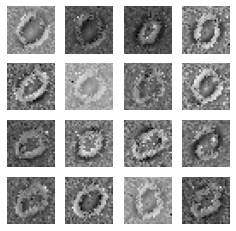

44
gen_loss: tf.Tensor(2.6093676, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0978771, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11114451, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99941707e-01 5.82997163e-05]
 [9.99999166e-01 8.10235576e-07]
 [9.99973774e-01 2.62052054e-05]
 [9.99985933e-01 1.40208149e-05]
 [9.99982476e-01 1.75061123e-05]
 [9.98342991e-01 1.65701658e-03]
 [9.99742687e-01 2.57348001e-04]
 [9.99921679e-01 7.82949282e-05]
 [9.99944091e-01 5.59211221e-05]
 [9.98874009e-01 1.12603325e-03]
 [9.99998569e-01 1.42891554e-06]
 [9.99835491e-01 1.64491168e-04]
 [9.99478519e-01 5.21478709e-04]
 [9.99942183e-01 5.77742721e-05]
 [9.99708831e-01 2.91151227e-04]
 [9.99965668e-01 3.43531719e-05]
 [9.99821246e-01 1.78755057e-04]
 [9.99972105e-01 2.79442957e-05]
 [9.99995589e-01 4.43191902e-06]
 [9.99983311e-01 1.67239286e-05]
 [9.99990940e-01 9.05461911e-06]
 [9.99999046e-01 8.95988933e-07]
 [9.99964833e-01 3.52087445e-05]
 [9.99993443e-01 6.

gen_loss: tf.Tensor(2.707541, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11740752, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10647494, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99930739e-01 6.92246031e-05]
 [9.99998808e-01 1.15688226e-06]
 [9.99979138e-01 2.08774891e-05]
 [9.99982357e-01 1.76279409e-05]
 [9.99973416e-01 2.65869421e-05]
 [9.95930970e-01 4.06902842e-03]
 [9.99752462e-01 2.47572811e-04]
 [9.99906182e-01 9.37513469e-05]
 [9.99943972e-01 5.60735789e-05]
 [9.96172011e-01 3.82804428e-03]
 [9.99997735e-01 2.24833229e-06]
 [9.99713600e-01 2.86340626e-04]
 [9.99748051e-01 2.51933903e-04]
 [9.99854207e-01 1.45815575e-04]
 [9.99727666e-01 2.72331905e-04]
 [9.99944091e-01 5.59594810e-05]
 [9.99677896e-01 3.22098524e-04]
 [9.99960065e-01 3.98747870e-05]
 [9.99996424e-01 3.62974606e-06]
 [9.99979615e-01 2.04233183e-05]
 [9.99994636e-01 5.32658123e-06]
 [9.99998331e-01 1.65180768e-06]
 [9.99957442e-01 4.25610924e-05]
 [9.99991775e-01 8.214

test_discriminator_output: tf.Tensor(
[[9.99939919e-01 6.00244603e-05]
 [9.99999285e-01 7.22120433e-07]
 [9.99972582e-01 2.73628175e-05]
 [9.99974251e-01 2.57190077e-05]
 [9.99962211e-01 3.77305987e-05]
 [9.95007396e-01 4.99256514e-03]
 [9.99657869e-01 3.42086598e-04]
 [9.99922991e-01 7.69532999e-05]
 [9.99917030e-01 8.29599230e-05]
 [9.95955706e-01 4.04433627e-03]
 [9.99997735e-01 2.22676317e-06]
 [9.99580920e-01 4.19111573e-04]
 [9.99647856e-01 3.52109142e-04]
 [9.99823391e-01 1.76604139e-04]
 [9.99592602e-01 4.07383166e-04]
 [9.99931097e-01 6.89001827e-05]
 [9.99589264e-01 4.10768291e-04]
 [9.99962091e-01 3.78965487e-05]
 [9.99995112e-01 4.85932651e-06]
 [9.99976754e-01 2.32762104e-05]
 [9.99992251e-01 7.73963802e-06]
 [9.99998808e-01 1.20918742e-06]
 [9.99945879e-01 5.40899964e-05]
 [9.99987245e-01 1.27673202e-05]
 [9.99875665e-01 1.24283411e-04]
 [9.99920845e-01 7.91174389e-05]
 [9.99990940e-01 9.09347364e-06]
 [9.99988317e-01 1.17289428e-05]
 [9.99188840e-01 8.11116595e-04]
 [9.9

gen_loss: tf.Tensor(2.5891242, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10312321, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.121721685, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99937415e-01 6.25737594e-05]
 [9.99999404e-01 5.76291541e-07]
 [9.99933243e-01 6.67745044e-05]
 [9.99966741e-01 3.32578711e-05]
 [9.99956965e-01 4.29776373e-05]
 [9.96533513e-01 3.46651720e-03]
 [9.99439418e-01 5.60508750e-04]
 [9.99930382e-01 6.96226198e-05]
 [9.99832511e-01 1.67457329e-04]
 [9.97916043e-01 2.08398886e-03]
 [9.99997854e-01 2.14466195e-06]
 [9.99675870e-01 3.24165652e-04]
 [9.98812914e-01 1.18708878e-03]
 [9.99839664e-01 1.60298921e-04]
 [9.99244452e-01 7.55577697e-04]
 [9.99950528e-01 4.94417836e-05]
 [9.99624014e-01 3.75929230e-04]
 [9.99973416e-01 2.66075131e-05]
 [9.99988437e-01 1.15348648e-05]
 [9.99977469e-01 2.25834683e-05]
 [9.99979019e-01 2.10177859e-05]
 [9.99999046e-01 9.15781413e-07]
 [9.99940991e-01 5.90219497e-05]
 [9.99983430e-01 1.6

gen_loss: tf.Tensor(2.583151, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.114340305, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10706704, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99891162e-01 1.08836495e-04]
 [9.99998450e-01 1.52459563e-06]
 [9.99880433e-01 1.19510332e-04]
 [9.99962687e-01 3.72543582e-05]
 [9.99968052e-01 3.19218125e-05]
 [9.96491730e-01 3.50821926e-03]
 [9.99354661e-01 6.45288674e-04]
 [9.99876976e-01 1.23060410e-04]
 [9.99753654e-01 2.46401032e-04]
 [9.96247709e-01 3.75225558e-03]
 [9.99997139e-01 2.80384143e-06]
 [9.99767482e-01 2.32507198e-04]
 [9.98732626e-01 1.26742141e-03]
 [9.99765337e-01 2.34675797e-04]
 [9.99101043e-01 8.98936181e-04]
 [9.99966145e-01 3.38899117e-05]
 [9.99691010e-01 3.08980176e-04]
 [9.99960423e-01 3.95587595e-05]
 [9.99981284e-01 1.87610858e-05]
 [9.99975204e-01 2.47764820e-05]
 [9.99978662e-01 2.13504700e-05]
 [9.99997854e-01 2.20010929e-06]
 [9.99934912e-01 6.50808361e-05]
 [9.99983311e-01 1.67

test_discriminator_output: tf.Tensor(
[[9.99946833e-01 5.31522164e-05]
 [9.99998927e-01 1.07352264e-06]
 [9.99888062e-01 1.11970927e-04]
 [9.99967337e-01 3.26201298e-05]
 [9.99980688e-01 1.93556189e-05]
 [9.97394800e-01 2.60516559e-03]
 [9.99508977e-01 4.91054670e-04]
 [9.99939084e-01 6.09251911e-05]
 [9.99794900e-01 2.05102711e-04]
 [9.96906340e-01 3.09365429e-03]
 [9.99998569e-01 1.41237319e-06]
 [9.99746382e-01 2.53598468e-04]
 [9.99055803e-01 9.44146595e-04]
 [9.99848723e-01 1.51306886e-04]
 [9.99264181e-01 7.35762413e-04]
 [9.99977946e-01 2.20121237e-05]
 [9.99804676e-01 1.95404180e-04]
 [9.99971867e-01 2.81112934e-05]
 [9.99988079e-01 1.19061478e-05]
 [9.99984622e-01 1.54065019e-05]
 [9.99977589e-01 2.23877960e-05]
 [9.99998093e-01 1.94388576e-06]
 [9.99961019e-01 3.89540983e-05]
 [9.99985337e-01 1.46399125e-05]
 [9.99909520e-01 9.04207336e-05]
 [9.99968052e-01 3.19690625e-05]
 [9.99991059e-01 8.93420747e-06]
 [9.99989867e-01 1.01526421e-05]
 [9.93330657e-01 6.66928757e-03]
 [9.9

gen_loss: tf.Tensor(2.6027763, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11376932, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10918905, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99970555e-01 2.94826623e-05]
 [9.99999523e-01 4.33304791e-07]
 [9.99807656e-01 1.92339518e-04]
 [9.99883533e-01 1.16426927e-04]
 [9.99961019e-01 3.90339774e-05]
 [9.94922936e-01 5.07702492e-03]
 [9.98905778e-01 1.09423336e-03]
 [9.99955058e-01 4.49447907e-05]
 [9.99519229e-01 4.80815797e-04]
 [9.90457892e-01 9.54210572e-03]
 [9.99998093e-01 1.86219233e-06]
 [9.98964190e-01 1.03581336e-03]
 [9.98971224e-01 1.02879095e-03]
 [9.99775589e-01 2.24428353e-04]
 [9.98339415e-01 1.66051136e-03]
 [9.99965191e-01 3.48131034e-05]
 [9.99653339e-01 3.46660177e-04]
 [9.99943852e-01 5.62011010e-05]
 [9.99980688e-01 1.93458018e-05]
 [9.99972224e-01 2.77792933e-05]
 [9.99946713e-01 5.32668455e-05]
 [9.99998808e-01 1.16072579e-06]
 [9.99919057e-01 8.09024205e-05]
 [9.99943495e-01 5.65

gen_loss: tf.Tensor(2.5333838, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11040662, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11296731, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99932051e-01 6.79174991e-05]
 [9.99998450e-01 1.56613601e-06]
 [9.99838233e-01 1.61698204e-04]
 [9.99903679e-01 9.63659695e-05]
 [9.99946833e-01 5.32123668e-05]
 [9.93074059e-01 6.92594424e-03]
 [9.98875439e-01 1.12449320e-03]
 [9.99784172e-01 2.15781867e-04]
 [9.99619484e-01 3.80485435e-04]
 [9.88346279e-01 1.16536804e-02]
 [9.99994040e-01 5.95381607e-06]
 [9.99665856e-01 3.34113225e-04]
 [9.98460650e-01 1.53938518e-03]
 [9.99547660e-01 4.52302687e-04]
 [9.98742521e-01 1.25749200e-03]
 [9.99967456e-01 3.25993897e-05]
 [9.99615550e-01 3.84436629e-04]
 [9.99894381e-01 1.05667510e-04]
 [9.99966502e-01 3.35088625e-05]
 [9.99970198e-01 2.98302402e-05]
 [9.99935150e-01 6.48252681e-05]
 [9.99996305e-01 3.75330410e-06]
 [9.99912262e-01 8.76871782e-05]
 [9.99956369e-01 4.36

gen_loss: tf.Tensor(2.494618, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11746673, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12010108, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99943376e-01 5.66469389e-05]
 [9.99998450e-01 1.55922703e-06]
 [9.99896765e-01 1.03258171e-04]
 [9.99927282e-01 7.26932631e-05]
 [9.99955058e-01 4.49422623e-05]
 [9.93998766e-01 6.00124337e-03]
 [9.99113619e-01 8.86370486e-04]
 [9.99782860e-01 2.17119610e-04]
 [9.99719203e-01 2.80822365e-04]
 [9.91770625e-01 8.22935440e-03]
 [9.99993682e-01 6.31999683e-06]
 [9.99780595e-01 2.19387439e-04]
 [9.97640610e-01 2.35936441e-03]
 [9.99680877e-01 3.19083076e-04]
 [9.99095798e-01 9.04265849e-04]
 [9.99976993e-01 2.29581583e-05]
 [9.99688268e-01 3.11747368e-04]
 [9.99910235e-01 8.97250939e-05]
 [9.99970078e-01 2.98641098e-05]
 [9.99979258e-01 2.07186749e-05]
 [9.99920130e-01 7.98685069e-05]
 [9.99996066e-01 3.89302249e-06]
 [9.99935150e-01 6.48307760e-05]
 [9.99968171e-01 3.178

gen_loss: tf.Tensor(2.6282797, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11443795, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.102757975, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99932408e-01 6.75596966e-05]
 [9.99998212e-01 1.72973603e-06]
 [9.99824464e-01 1.75531037e-04]
 [9.99845743e-01 1.54266556e-04]
 [9.99937415e-01 6.25668981e-05]
 [9.92398202e-01 7.60180736e-03]
 [9.98567343e-01 1.43259380e-03]
 [9.99778092e-01 2.21951996e-04]
 [9.99387622e-01 6.12389413e-04]
 [9.85876799e-01 1.41231231e-02]
 [9.99991775e-01 8.21881076e-06]
 [9.99322891e-01 6.77154574e-04]
 [9.96344149e-01 3.65584251e-03]
 [9.99665737e-01 3.34276963e-04]
 [9.98027503e-01 1.97241339e-03]
 [9.99971032e-01 2.89211985e-05]
 [9.99494791e-01 5.05175500e-04]
 [9.99887705e-01 1.12247901e-04]
 [9.99945879e-01 5.41028421e-05]
 [9.99967813e-01 3.21334446e-05]
 [9.99899626e-01 1.00406767e-04]
 [9.99995708e-01 4.31801391e-06]
 [9.99884725e-01 1.15312330e-04]
 [9.99933720e-01 6.6

gen_loss: tf.Tensor(2.392282, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1540204, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13648626, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99918103e-01 8.19264387e-05]
 [9.99998212e-01 1.75405557e-06]
 [9.99781907e-01 2.18114743e-04]
 [9.99755800e-01 2.44228373e-04]
 [9.99916315e-01 8.37129701e-05]
 [9.89772379e-01 1.02275778e-02]
 [9.98183310e-01 1.81667774e-03]
 [9.99838591e-01 1.61435237e-04]
 [9.99230981e-01 7.69000151e-04]
 [9.81062829e-01 1.89371388e-02]
 [9.99991298e-01 8.64777849e-06]
 [9.98880088e-01 1.11987896e-03]
 [9.95464623e-01 4.53536958e-03]
 [9.99428451e-01 5.71465935e-04]
 [9.97448325e-01 2.55173771e-03]
 [9.99962926e-01 3.70432172e-05]
 [9.99316692e-01 6.83289021e-04]
 [9.99870658e-01 1.29326232e-04]
 [9.99942422e-01 5.76228522e-05]
 [9.99958396e-01 4.15604591e-05]
 [9.99841571e-01 1.58449213e-04]
 [9.99995708e-01 4.31470016e-06]
 [9.99858499e-01 1.41509823e-04]
 [9.99895811e-01 1.0419

gen_loss: tf.Tensor(2.5002909, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09894727, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12749708, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99911666e-01 8.83260800e-05]
 [9.99997973e-01 2.02211527e-06]
 [9.99845505e-01 1.54486188e-04]
 [9.99807179e-01 1.92871928e-04]
 [9.99920607e-01 7.93967120e-05]
 [9.90205467e-01 9.79449693e-03]
 [9.98451591e-01 1.54841086e-03]
 [9.99868751e-01 1.31176435e-04]
 [9.99424338e-01 5.75696875e-04]
 [9.86321390e-01 1.36786401e-02]
 [9.99992371e-01 7.59513978e-06]
 [9.99281585e-01 7.18397961e-04]
 [9.96610105e-01 3.38986353e-03]
 [9.99411583e-01 5.88399242e-04]
 [9.98107553e-01 1.89244375e-03]
 [9.99964595e-01 3.54481490e-05]
 [9.99441564e-01 5.58387605e-04]
 [9.99882698e-01 1.17319272e-04]
 [9.99958396e-01 4.15776594e-05]
 [9.99964476e-01 3.55653065e-05]
 [9.99861002e-01 1.38946474e-04]
 [9.99994755e-01 5.24819325e-06]
 [9.99891639e-01 1.08313434e-04]
 [9.99919534e-01 8.04

disc_real_loss: tf.Tensor(0.07933818, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13006079, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99884963e-01 1.15031282e-04]
 [9.99996424e-01 3.60368767e-06]
 [9.99904752e-01 9.52328410e-05]
 [9.99888182e-01 1.11771107e-04]
 [9.99938369e-01 6.16495454e-05]
 [9.93333280e-01 6.66673295e-03]
 [9.98875439e-01 1.12451415e-03]
 [9.99852061e-01 1.47927014e-04]
 [9.99614954e-01 3.84991145e-04]
 [9.93460178e-01 6.53979415e-03]
 [9.99992728e-01 7.24117990e-06]
 [9.99732196e-01 2.67794880e-04]
 [9.97369289e-01 2.63069523e-03]
 [9.99581635e-01 4.18418407e-04]
 [9.98781025e-01 1.21894770e-03]
 [9.99973178e-01 2.68196727e-05]
 [9.99637961e-01 3.61989078e-04]
 [9.99906421e-01 9.35158023e-05]
 [9.99969006e-01 3.09559728e-05]
 [9.99973893e-01 2.60929646e-05]
 [9.99919772e-01 8.02390568e-05]
 [9.99990225e-01 9.73962597e-06]
 [9.99929786e-01 7.02128091e-05]
 [9.99954700e-01 4.53223038e-05]
 [9.99801457e-01 1.98519527e-04]
 [9.9959951

gen_loss: tf.Tensor(2.6189332, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14352316, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.112887084, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99730289e-01 2.69671902e-04]
 [9.99993920e-01 6.07328820e-06]
 [9.99867797e-01 1.32218251e-04]
 [9.99740303e-01 2.59735622e-04]
 [9.99888539e-01 1.11438123e-04]
 [9.90056813e-01 9.94315743e-03]
 [9.97846961e-01 2.15298776e-03]
 [9.99500990e-01 4.99044196e-04]
 [9.99242902e-01 7.57164205e-04]
 [9.88752842e-01 1.12470789e-02]
 [9.99980807e-01 1.92069347e-05]
 [9.99717057e-01 2.82971916e-04]
 [9.96536016e-01 3.46398307e-03]
 [9.99575198e-01 4.24745493e-04]
 [9.97832358e-01 2.16765585e-03]
 [9.99949813e-01 5.01935283e-05]
 [9.99331117e-01 6.68869645e-04]
 [9.99781907e-01 2.18128058e-04]
 [9.99942660e-01 5.73035977e-05]
 [9.99934196e-01 6.57888741e-05]
 [9.99920130e-01 7.98913607e-05]
 [9.99985099e-01 1.48822573e-05]
 [9.99806821e-01 1.93182408e-04]
 [9.99891877e-01 1.0

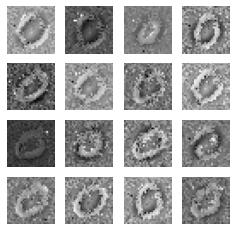

45
gen_loss: tf.Tensor(2.5152102, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.081465155, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13330317, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99691248e-01 3.08807619e-04]
 [9.99996543e-01 3.45638773e-06]
 [9.99711573e-01 2.88377574e-04]
 [9.99017596e-01 9.82336351e-04]
 [9.99741018e-01 2.58949294e-04]
 [9.79672313e-01 2.03277003e-02]
 [9.94768023e-01 5.23201237e-03]
 [9.99151349e-01 8.48665601e-04]
 [9.97965813e-01 2.03426625e-03]
 [9.65119243e-01 3.48807909e-02]
 [9.99962926e-01 3.70154958e-05]
 [9.99138594e-01 8.61419248e-04]
 [9.94044840e-01 5.95517782e-03]
 [9.99436796e-01 5.63199574e-04]
 [9.94523525e-01 5.47648966e-03]
 [9.99881148e-01 1.18789663e-04]
 [9.98362482e-01 1.63754914e-03]
 [9.99481380e-01 5.18619781e-04]
 [9.99879956e-01 1.19992212e-04]
 [9.99799430e-01 2.00579161e-04]
 [9.99812782e-01 1.87258673e-04]
 [9.99992132e-01 7.86678356e-06]
 [9.99273360e-01 7.26603845e-04]
 [9.99560893e-01 

gen_loss: tf.Tensor(2.4054935, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10349756, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.13688162, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9971038e-01 2.8962467e-04]
 [9.9999702e-01 3.0350857e-06]
 [9.9967420e-01 3.2580463e-04]
 [9.9831867e-01 1.6813019e-03]
 [9.9958402e-01 4.1593841e-04]
 [9.7286212e-01 2.7137814e-02]
 [9.9297792e-01 7.0220246e-03]
 [9.9874324e-01 1.2568402e-03]
 [9.9740452e-01 2.5954538e-03]
 [9.4578266e-01 5.4217335e-02]
 [9.9995100e-01 4.8937705e-05]
 [9.9894267e-01 1.0573620e-03]
 [9.9251306e-01 7.4869888e-03]
 [9.9927348e-01 7.2647294e-04]
 [9.9324989e-01 6.7501701e-03]
 [9.9981922e-01 1.8076540e-04]
 [9.9790907e-01 2.0909102e-03]
 [9.9923289e-01 7.6710089e-04]
 [9.9983811e-01 1.6180633e-04]
 [9.9967968e-01 3.2037924e-04]
 [9.9970043e-01 2.9956465e-04]
 [9.9999332e-01 6.7156820e-06]
 [9.9869186e-01 1.3081902e-03]
 [9.9914467e-01 8.5531775e-04]
 [9.9921656e-01 7.8344403e-04]
 [9.9

gen_loss: tf.Tensor(2.4670339, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.103055805, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12477833, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99726474e-01 2.73506186e-04]
 [9.99990702e-01 9.26516896e-06]
 [9.99890447e-01 1.09585890e-04]
 [9.99518275e-01 4.81737196e-04]
 [9.99767959e-01 2.32096339e-04]
 [9.86149967e-01 1.38499513e-02]
 [9.97477114e-01 2.52284668e-03]
 [9.98680532e-01 1.31946744e-03]
 [9.99201238e-01 7.98803871e-04]
 [9.79307175e-01 2.06928104e-02]
 [9.99968171e-01 3.18608363e-05]
 [9.99777853e-01 2.22115195e-04]
 [9.96063530e-01 3.93641088e-03]
 [9.99349415e-01 6.50590810e-04]
 [9.98000205e-01 1.99980708e-03]
 [9.99900579e-01 9.93889116e-05]
 [9.99202549e-01 7.97519984e-04]
 [9.99613345e-01 3.86733678e-04]
 [9.99908924e-01 9.10331801e-05]
 [9.99880552e-01 1.19461583e-04]
 [9.99881387e-01 1.18577249e-04]
 [9.99974370e-01 2.55913674e-05]
 [9.99568522e-01 4.31492255e-04]
 [9.99753535e-01 2.4

gen_loss: tf.Tensor(2.4580927, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.103369355, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11450176, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99800980e-01 1.99009810e-04]
 [9.99994874e-01 5.16917453e-06]
 [9.99699831e-01 3.00200219e-04]
 [9.98044848e-01 1.95515528e-03]
 [9.99285042e-01 7.14938680e-04]
 [9.75560069e-01 2.44399216e-02]
 [9.94232476e-01 5.76747116e-03]
 [9.98974442e-01 1.02562038e-03]
 [9.97942984e-01 2.05699261e-03]
 [9.35567915e-01 6.44320846e-02]
 [9.99958515e-01 4.15141949e-05]
 [9.98947203e-01 1.05279416e-03]
 [9.86353278e-01 1.36467023e-02]
 [9.97916043e-01 2.08393042e-03]
 [9.94271517e-01 5.72851906e-03]
 [9.99795616e-01 2.04393073e-04]
 [9.98545051e-01 1.45491876e-03]
 [9.99388576e-01 6.11407042e-04]
 [9.99770582e-01 2.29459023e-04]
 [9.99764740e-01 2.35250642e-04]
 [9.99475300e-01 5.24706382e-04]
 [9.99983907e-01 1.61338867e-05]
 [9.98809695e-01 1.19034539e-03]
 [9.98846650e-01 1.1

gen_loss: tf.Tensor(2.3788447, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15902308, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12620299, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99750912e-01 2.49090226e-04]
 [9.99985695e-01 1.42650288e-05]
 [9.99691486e-01 3.08565679e-04]
 [9.98049140e-01 1.95082382e-03]
 [9.99311566e-01 6.88423635e-04]
 [9.77825463e-01 2.21745502e-02]
 [9.94348705e-01 5.65125747e-03]
 [9.98951435e-01 1.04858610e-03]
 [9.97544706e-01 2.45525176e-03]
 [9.32438254e-01 6.75617531e-02]
 [9.99960542e-01 3.94573362e-05]
 [9.98691380e-01 1.30861450e-03]
 [9.88166332e-01 1.18336724e-02]
 [9.97453749e-01 2.54628458e-03]
 [9.93067980e-01 6.93202717e-03]
 [9.99793947e-01 2.06046490e-04]
 [9.98692214e-01 1.30778330e-03]
 [9.99463022e-01 5.36992738e-04]
 [9.99747932e-01 2.52055237e-04]
 [9.99796689e-01 2.03292017e-04]
 [9.99662280e-01 3.37753794e-04]
 [9.99946237e-01 5.37697015e-05]
 [9.98912692e-01 1.08737510e-03]
 [9.98808384e-01 1.19

gen_loss: tf.Tensor(2.5206218, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12020718, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11437219, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99536753e-01 4.63276345e-04]
 [9.99980927e-01 1.90566680e-05]
 [9.99602735e-01 3.97269730e-04]
 [9.97425497e-01 2.57445057e-03]
 [9.98877943e-01 1.12205208e-03]
 [9.65419829e-01 3.45801413e-02]
 [9.92508233e-01 7.49176601e-03]
 [9.97613668e-01 2.38635205e-03]
 [9.96753871e-01 3.24613345e-03]
 [8.98776591e-01 1.01223461e-01]
 [9.99885917e-01 1.14035684e-04]
 [9.98813272e-01 1.18671451e-03]
 [9.83540595e-01 1.64593644e-02]
 [9.95831192e-01 4.16886667e-03]
 [9.91233051e-01 8.76701344e-03]
 [9.99679923e-01 3.20054678e-04]
 [9.97710466e-01 2.28953338e-03]
 [9.99087930e-01 9.12105665e-04]
 [9.99642730e-01 3.57267534e-04]
 [9.99664307e-01 3.35757388e-04]
 [9.99452293e-01 5.47671574e-04]
 [9.99943256e-01 5.67640709e-05]
 [9.98040140e-01 1.95992319e-03]
 [9.98405516e-01 1.59

gen_loss: tf.Tensor(2.709358, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13947481, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09202389, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99345243e-01 6.54689677e-04]
 [9.99983668e-01 1.63442528e-05]
 [9.99756992e-01 2.42962822e-04]
 [9.97723877e-01 2.27615773e-03]
 [9.98293698e-01 1.70630473e-03]
 [9.61094081e-01 3.89058627e-02]
 [9.92403924e-01 7.59599544e-03]
 [9.96470571e-01 3.52946902e-03]
 [9.97246146e-01 2.75393086e-03]
 [9.00922477e-01 9.90775451e-02]
 [9.99722302e-01 2.77720188e-04]
 [9.99525189e-01 4.74782079e-04]
 [9.83031631e-01 1.69684235e-02]
 [9.95604157e-01 4.39591194e-03]
 [9.92920339e-01 7.07961526e-03]
 [9.99634504e-01 3.65441199e-04]
 [9.97255504e-01 2.74447631e-03]
 [9.98797417e-01 1.20252452e-03]
 [9.99656081e-01 3.43955850e-04]
 [9.99539256e-01 4.60769486e-04]
 [9.99444306e-01 5.55666047e-04]
 [9.99956369e-01 4.35941256e-05]
 [9.97630477e-01 2.36954493e-03]
 [9.98717427e-01 1.282

test_discriminator_output: tf.Tensor(
[[9.99440134e-01 5.59837616e-04]
 [9.99981046e-01 1.89548045e-05]
 [9.99855518e-01 1.44477774e-04]
 [9.98595059e-01 1.40488381e-03]
 [9.98586059e-01 1.41396932e-03]
 [9.70462501e-01 2.95375325e-02]
 [9.94697571e-01 5.30244038e-03]
 [9.96963918e-01 3.03608831e-03]
 [9.98098314e-01 1.90164486e-03]
 [9.31301832e-01 6.86982051e-02]
 [9.99764025e-01 2.35937754e-04]
 [9.99756157e-01 2.43870527e-04]
 [9.87419546e-01 1.25804283e-02]
 [9.96571779e-01 3.42820911e-03]
 [9.95110333e-01 4.88960976e-03]
 [9.99720991e-01 2.79010797e-04]
 [9.98046517e-01 1.95350335e-03]
 [9.99086738e-01 9.13218246e-04]
 [9.99755919e-01 2.44095005e-04]
 [9.99665618e-01 3.34341341e-04]
 [9.99668598e-01 3.31354095e-04]
 [9.99945521e-01 5.44763243e-05]
 [9.98455286e-01 1.54464901e-03]
 [9.99218822e-01 7.81150535e-04]
 [9.98556435e-01 1.44353311e-03]
 [9.92449164e-01 7.55080255e-03]
 [9.98652160e-01 1.34787429e-03]
 [9.99589860e-01 4.10182489e-04]
 [6.20070338e-01 3.79929602e-01]
 [9.8

gen_loss: tf.Tensor(2.5239315, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09867803, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11850164, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99816358e-01 1.83709068e-04]
 [9.99984980e-01 1.50761616e-05]
 [9.99878645e-01 1.21284975e-04]
 [9.98930514e-01 1.06947159e-03]
 [9.98811960e-01 1.18810195e-03]
 [9.84573185e-01 1.54267820e-02]
 [9.95816290e-01 4.18370171e-03]
 [9.98913407e-01 1.08655798e-03]
 [9.98083711e-01 1.91625918e-03]
 [9.58171129e-01 4.18288261e-02]
 [9.99921083e-01 7.88617908e-05]
 [9.99737799e-01 2.62186048e-04]
 [9.89515424e-01 1.04846181e-02]
 [9.98068869e-01 1.93111354e-03]
 [9.94828165e-01 5.17186569e-03]
 [9.99828815e-01 1.71182794e-04]
 [9.98957396e-01 1.04259455e-03]
 [9.99586880e-01 4.13181988e-04]
 [9.99813974e-01 1.86092118e-04]
 [9.99793231e-01 2.06760684e-04]
 [9.99774039e-01 2.25920041e-04]
 [9.99947906e-01 5.20680260e-05]
 [9.99180973e-01 8.19037203e-04]
 [9.99371111e-01 6.28

gen_loss: tf.Tensor(2.6153316, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1325241, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10637957, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99861360e-01 1.38660995e-04]
 [9.99986768e-01 1.32736777e-05]
 [9.99720871e-01 2.79127358e-04]
 [9.97797728e-01 2.20230944e-03]
 [9.97387826e-01 2.61214306e-03]
 [9.86002088e-01 1.39979394e-02]
 [9.91341054e-01 8.65891669e-03]
 [9.99173939e-01 8.26008036e-04]
 [9.95181382e-01 4.81853634e-03]
 [9.42936361e-01 5.70636503e-02]
 [9.99924302e-01 7.57375965e-05]
 [9.99491572e-01 5.08354569e-04]
 [9.79756773e-01 2.02432740e-02]
 [9.96298134e-01 3.70183028e-03]
 [9.85638201e-01 1.43617671e-02]
 [9.99804318e-01 1.95721732e-04]
 [9.98842537e-01 1.15753605e-03]
 [9.99606192e-01 3.93868366e-04]
 [9.99501944e-01 4.98011068e-04]
 [9.99672055e-01 3.27992457e-04]
 [9.99579370e-01 4.20680881e-04]
 [9.99962091e-01 3.78566365e-05]
 [9.98747945e-01 1.25203026e-03]
 [9.98587251e-01 1.412

gen_loss: tf.Tensor(2.6631508, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11212046, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10557383, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99767601e-01 2.32376216e-04]
 [9.99988794e-01 1.11818863e-05]
 [9.99626517e-01 3.73495888e-04]
 [9.95718181e-01 4.28179512e-03]
 [9.94714797e-01 5.28522581e-03]
 [9.83512342e-01 1.64876245e-02]
 [9.84308183e-01 1.56918317e-02]
 [9.98783052e-01 1.21696631e-03]
 [9.91729081e-01 8.27093329e-03]
 [8.98571312e-01 1.01428658e-01]
 [9.99803007e-01 1.97026224e-04]
 [9.99231696e-01 7.68362894e-04]
 [9.73558247e-01 2.64417604e-02]
 [9.93257284e-01 6.74271863e-03]
 [9.74604607e-01 2.53954232e-02]
 [9.99730885e-01 2.69124313e-04]
 [9.98225987e-01 1.77399174e-03]
 [9.99290228e-01 7.09710293e-04]
 [9.99019027e-01 9.81008285e-04]
 [9.99350846e-01 6.49122871e-04]
 [9.99399781e-01 6.00248575e-04]
 [9.99971151e-01 2.87957027e-05]
 [9.97711778e-01 2.28825724e-03]
 [9.97127235e-01 2.87

test_discriminator_output: tf.Tensor(
[[9.9969530e-01 3.0467080e-04]
 [9.9998701e-01 1.2947093e-05]
 [9.9972814e-01 2.7190099e-04]
 [9.9622452e-01 3.7754728e-03]
 [9.9540389e-01 4.5961230e-03]
 [9.8590368e-01 1.4096347e-02]
 [9.8656297e-01 1.3436981e-02]
 [9.9847311e-01 1.5269325e-03]
 [9.9310559e-01 6.8944325e-03]
 [9.0320569e-01 9.6794277e-02]
 [9.9973148e-01 2.6846465e-04]
 [9.9939740e-01 6.0264382e-04]
 [9.7781777e-01 2.2182209e-02]
 [9.9458611e-01 5.4138615e-03]
 [9.7896922e-01 2.1030847e-02]
 [9.9975568e-01 2.4437072e-04]
 [9.9834692e-01 1.6531259e-03]
 [9.9917859e-01 8.2141050e-04]
 [9.9915993e-01 8.4005040e-04]
 [9.9938786e-01 6.1209005e-04]
 [9.9952757e-01 4.7248523e-04]
 [9.9996758e-01 3.2422111e-05]
 [9.9803072e-01 1.9692932e-03]
 [9.9764204e-01 2.3580135e-03]
 [9.9851924e-01 1.4808085e-03]
 [9.9707967e-01 2.9202932e-03]
 [9.9300003e-01 7.0000063e-03]
 [9.9976271e-01 2.3723820e-04]
 [4.1965881e-01 5.8034122e-01]
 [9.7466403e-01 2.5335949e-02]
 [9.9990690e-01 9.3144692e-05]
 

gen_loss: tf.Tensor(2.506674, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1081004, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11543618, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99801934e-01 1.98109963e-04]
 [9.99986649e-01 1.33965241e-05]
 [9.99925613e-01 7.43237470e-05]
 [9.98836815e-01 1.16315531e-03]
 [9.98544931e-01 1.45513925e-03]
 [9.93874371e-01 6.12556143e-03]
 [9.95917976e-01 4.08199569e-03]
 [9.98926818e-01 1.07318151e-03]
 [9.98067677e-01 1.93233904e-03]
 [9.70075786e-01 2.99242530e-02]
 [9.99835491e-01 1.64492900e-04]
 [9.99831915e-01 1.68039245e-04]
 [9.88859415e-01 1.11406520e-02]
 [9.98211622e-01 1.78840314e-03]
 [9.94499564e-01 5.50042186e-03]
 [9.99893069e-01 1.06870633e-04]
 [9.99387980e-01 6.12034986e-04]
 [9.99601901e-01 3.98086326e-04]
 [9.99737561e-01 2.62463960e-04]
 [9.99831080e-01 1.68854851e-04]
 [9.99785364e-01 2.14706073e-04]
 [9.99959350e-01 4.06090548e-05]
 [9.99525428e-01 4.74561064e-04]
 [9.99343574e-01 6.5641

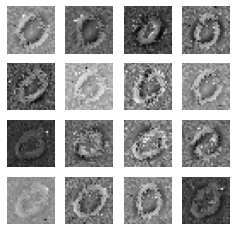

46
gen_loss: tf.Tensor(2.4764376, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10894327, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12081227, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99862671e-01 1.37316529e-04]
 [9.99987841e-01 1.21494631e-05]
 [9.99928117e-01 7.18761003e-05]
 [9.98679340e-01 1.32066698e-03]
 [9.98682320e-01 1.31771748e-03]
 [9.92496014e-01 7.50394398e-03]
 [9.96336460e-01 3.66354152e-03]
 [9.99000609e-01 9.99431242e-04]
 [9.98220861e-01 1.77916035e-03]
 [9.63572383e-01 3.64275314e-02]
 [9.99864101e-01 1.35896582e-04]
 [9.99745905e-01 2.54086859e-04]
 [9.89684343e-01 1.03156427e-02]
 [9.97965932e-01 2.03413074e-03]
 [9.94827330e-01 5.17267548e-03]
 [9.99891281e-01 1.08760345e-04]
 [9.99422431e-01 5.77573781e-04]
 [9.99555886e-01 4.44122474e-04]
 [9.99779642e-01 2.20376998e-04]
 [9.99845028e-01 1.54986512e-04]
 [9.99741137e-01 2.58882414e-04]
 [9.99963045e-01 3.69066511e-05]
 [9.99568880e-01 4.31078632e-04]
 [9.99238491e-01 7

gen_loss: tf.Tensor(2.5468087, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08672136, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10976942, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99932289e-01 6.76702766e-05]
 [9.99991298e-01 8.68152620e-06]
 [9.99825537e-01 1.74471614e-04]
 [9.96012330e-01 3.98765411e-03]
 [9.97958779e-01 2.04124511e-03]
 [9.86404061e-01 1.35959368e-02]
 [9.93763745e-01 6.23629615e-03]
 [9.99199092e-01 8.00863549e-04]
 [9.96016800e-01 3.98314511e-03]
 [9.21140790e-01 7.88592771e-02]
 [9.99904871e-01 9.50706089e-05]
 [9.98696744e-01 1.30333437e-03]
 [9.86541510e-01 1.34584643e-02]
 [9.96811450e-01 3.18849622e-03]
 [9.88166869e-01 1.18330866e-02]
 [9.99853373e-01 1.46597813e-04]
 [9.99263585e-01 7.36399728e-04]
 [9.99298215e-01 7.01820885e-04]
 [9.99648333e-01 3.51706898e-04]
 [9.99743164e-01 2.56834232e-04]
 [9.99269187e-01 7.30787055e-04]
 [9.99977112e-01 2.28931822e-05]
 [9.99273121e-01 7.26944651e-04]
 [9.97421145e-01 2.57

gen_loss: tf.Tensor(2.5439172, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09951441, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11931781, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99911785e-01 8.81910819e-05]
 [9.99987006e-01 1.30416847e-05]
 [9.99842763e-01 1.57196395e-04]
 [9.96577322e-01 3.42264189e-03]
 [9.98168230e-01 1.83178741e-03]
 [9.93966937e-01 6.03309926e-03]
 [9.93790925e-01 6.20908430e-03]
 [9.99166965e-01 8.33049300e-04]
 [9.94998097e-01 5.00188302e-03]
 [9.70955968e-01 2.90439986e-02]
 [9.99910474e-01 8.95333942e-05]
 [9.99446332e-01 5.53705380e-04]
 [9.84890282e-01 1.51096741e-02]
 [9.98835981e-01 1.16405543e-03]
 [9.85669911e-01 1.43300779e-02]
 [9.99925971e-01 7.40453834e-05]
 [9.99582469e-01 4.17592382e-04]
 [9.99481022e-01 5.19023044e-04]
 [9.99498010e-01 5.02020761e-04]
 [9.99791920e-01 2.08117504e-04]
 [9.99563277e-01 4.36709088e-04]
 [9.99965906e-01 3.40847037e-05]
 [9.99441326e-01 5.58691623e-04]
 [9.97871161e-01 2.12

gen_loss: tf.Tensor(2.6154728, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09581818, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.109822616, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99769151e-01 2.30884834e-04]
 [9.99983072e-01 1.69418236e-05]
 [9.99923348e-01 7.66192607e-05]
 [9.97755945e-01 2.24410952e-03]
 [9.97829020e-01 2.17095041e-03]
 [9.94581044e-01 5.41890878e-03]
 [9.94487703e-01 5.51227899e-03]
 [9.98284996e-01 1.71502109e-03]
 [9.96592820e-01 3.40713956e-03]
 [9.75636244e-01 2.43637450e-02]
 [9.99766767e-01 2.33210769e-04]
 [9.99861002e-01 1.38999487e-04]
 [9.91251886e-01 8.74810852e-03]
 [9.98852968e-01 1.14697043e-03]
 [9.91102576e-01 8.89736600e-03]
 [9.99935031e-01 6.49386784e-05]
 [9.99543965e-01 4.55954549e-04]
 [9.99268353e-01 7.31637876e-04]
 [9.99464571e-01 5.35492378e-04]
 [9.99780715e-01 2.19350652e-04]
 [9.99778688e-01 2.21280250e-04]
 [9.99955416e-01 4.45670266e-05]
 [9.99413490e-01 5.86523616e-04]
 [9.98693407e-01 1.3

gen_loss: tf.Tensor(2.5074625, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13932315, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.12015386, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99903679e-01 9.62574122e-05]
 [9.99994636e-01 5.33871071e-06]
 [9.99925494e-01 7.44712379e-05]
 [9.96551037e-01 3.44897737e-03]
 [9.97313917e-01 2.68608658e-03]
 [9.92005050e-01 7.99491163e-03]
 [9.93413627e-01 6.58638589e-03]
 [9.98937786e-01 1.06225221e-03]
 [9.96327937e-01 3.67211504e-03]
 [9.55484569e-01 4.45154235e-02]
 [9.99837637e-01 1.62376804e-04]
 [9.99648213e-01 3.51811032e-04]
 [9.93327022e-01 6.67298539e-03]
 [9.98260796e-01 1.73927250e-03]
 [9.89497185e-01 1.05028348e-02]
 [9.99904990e-01 9.50237518e-05]
 [9.99254405e-01 7.45582685e-04]
 [9.99390244e-01 6.09795039e-04]
 [9.99474943e-01 5.25066105e-04]
 [9.99791563e-01 2.08426500e-04]
 [9.99688029e-01 3.12014367e-04]
 [9.99983072e-01 1.69533650e-05]
 [9.99296069e-01 7.03911355e-04]
 [9.97995257e-01 2.00

gen_loss: tf.Tensor(2.729044, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.141933, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09447031, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99942064e-01 5.79416701e-05]
 [9.99993086e-01 6.85652685e-06]
 [9.99890089e-01 1.09880755e-04]
 [9.95802820e-01 4.19721659e-03]
 [9.97480571e-01 2.51944386e-03]
 [9.91538823e-01 8.46110191e-03]
 [9.92663503e-01 7.33648939e-03]
 [9.98886049e-01 1.11393037e-03]
 [9.95365262e-01 4.63475287e-03]
 [9.40982938e-01 5.90170138e-02]
 [9.99898076e-01 1.01960366e-04]
 [9.99428451e-01 5.71545563e-04]
 [9.93631542e-01 6.36851182e-03]
 [9.97828305e-01 2.17170059e-03]
 [9.86675918e-01 1.33241266e-02]
 [9.99881864e-01 1.18174277e-04]
 [9.99150872e-01 8.49135162e-04]
 [9.99492407e-01 5.07527438e-04]
 [9.99410748e-01 5.89227653e-04]
 [9.99794066e-01 2.05931196e-04]
 [9.99691248e-01 3.08716903e-04]
 [9.99980927e-01 1.91176659e-05]
 [9.99297380e-01 7.02548190e-04]
 [9.97637153e-01 2.36286

gen_loss: tf.Tensor(2.7528205, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08514225, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08978306, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99868155e-01 1.31877779e-04]
 [9.99986529e-01 1.34656011e-05]
 [9.99740183e-01 2.59821303e-04]
 [9.90259051e-01 9.74097382e-03]
 [9.93309140e-01 6.69083511e-03]
 [9.88590896e-01 1.14090629e-02]
 [9.82369244e-01 1.76308230e-02]
 [9.97379959e-01 2.62000249e-03]
 [9.88180399e-01 1.18196076e-02]
 [8.91431749e-01 1.08568244e-01]
 [9.99746859e-01 2.53174949e-04]
 [9.99415398e-01 5.84615918e-04]
 [9.91177857e-01 8.82209279e-03]
 [9.96157348e-01 3.84265510e-03]
 [9.72984016e-01 2.70159990e-02]
 [9.99768674e-01 2.31316255e-04]
 [9.98425245e-01 1.57483132e-03]
 [9.98759508e-01 1.24052481e-03]
 [9.98377085e-01 1.62284030e-03]
 [9.99252379e-01 7.47553247e-04]
 [9.99623299e-01 3.76660668e-04]
 [9.99973178e-01 2.68316944e-05]
 [9.97824907e-01 2.17517023e-03]
 [9.94117618e-01 5.88

gen_loss: tf.Tensor(2.6969922, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09513526, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08758025, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99912739e-01 8.72362216e-05]
 [9.99996662e-01 3.33977141e-06]
 [9.99748647e-01 2.51398596e-04]
 [9.89465475e-01 1.05345128e-02]
 [9.90691364e-01 9.30860080e-03]
 [9.92570579e-01 7.42937066e-03]
 [9.80964720e-01 1.90352406e-02]
 [9.98857737e-01 1.14225037e-03]
 [9.88946140e-01 1.10538695e-02]
 [9.19774890e-01 8.02250877e-02]
 [9.99756992e-01 2.42968395e-04]
 [9.99576628e-01 4.23365826e-04]
 [9.86894965e-01 1.31050423e-02]
 [9.96955991e-01 3.04405158e-03]
 [9.74735975e-01 2.52640527e-02]
 [9.99765694e-01 2.34354942e-04]
 [9.98470247e-01 1.52974040e-03]
 [9.98960137e-01 1.03984191e-03]
 [9.98283029e-01 1.71703391e-03]
 [9.99093056e-01 9.06936359e-04]
 [9.99376476e-01 6.23610336e-04]
 [9.99991417e-01 8.64232243e-06]
 [9.97428596e-01 2.57139979e-03]
 [9.93658960e-01 6.34

gen_loss: tf.Tensor(2.5817142, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18361042, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11619161, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99922037e-01 7.80074915e-05]
 [9.99990582e-01 9.36998549e-06]
 [9.99884367e-01 1.15609364e-04]
 [9.97504771e-01 2.49528768e-03]
 [9.95710492e-01 4.28952556e-03]
 [9.97149885e-01 2.85012485e-03]
 [9.93585527e-01 6.41453732e-03]
 [9.98731434e-01 1.26853830e-03]
 [9.97170627e-01 2.82942830e-03]
 [9.73087847e-01 2.69121472e-02]
 [9.99867916e-01 1.32095884e-04]
 [9.99928355e-01 7.16062059e-05]
 [9.87705648e-01 1.22942757e-02]
 [9.97282743e-01 2.71720416e-03]
 [9.92769122e-01 7.23095657e-03]
 [9.99891281e-01 1.08706736e-04]
 [9.99445140e-01 5.54902363e-04]
 [9.99565542e-01 4.34466463e-04]
 [9.99136508e-01 8.63523921e-04]
 [9.99714077e-01 2.85854563e-04]
 [9.99710858e-01 2.89151474e-04]
 [9.99977112e-01 2.28475110e-05]
 [9.99369323e-01 6.30666153e-04]
 [9.98496890e-01 1.50

gen_loss: tf.Tensor(2.7279031, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08149278, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1054751, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99947309e-01 5.26993426e-05]
 [9.99982834e-01 1.71741212e-05]
 [9.99884129e-01 1.15806761e-04]
 [9.98076677e-01 1.92331185e-03]
 [9.96957302e-01 3.04270885e-03]
 [9.96897340e-01 3.10269394e-03]
 [9.95976150e-01 4.02385183e-03]
 [9.98367846e-01 1.63215643e-03]
 [9.98198211e-01 1.80187286e-03]
 [9.55401003e-01 4.45989966e-02]
 [9.99928117e-01 7.18943338e-05]
 [9.99911308e-01 8.87177594e-05]
 [9.90011156e-01 9.98882577e-03]
 [9.97034669e-01 2.96536391e-03]
 [9.95279074e-01 4.72096307e-03]
 [9.99880195e-01 1.19810204e-04]
 [9.99540210e-01 4.59776580e-04]
 [9.99591529e-01 4.08435590e-04]
 [9.99489427e-01 5.10513550e-04]
 [9.99788582e-01 2.11375227e-04]
 [9.99764502e-01 2.35550498e-04]
 [9.99962687e-01 3.72640243e-05]
 [9.99577582e-01 4.22420067e-04]
 [9.98853087e-01 1.146

test_discriminator_output: tf.Tensor(
[[9.9995911e-01 4.0828370e-05]
 [9.9998832e-01 1.1683740e-05]
 [9.9983609e-01 1.6382919e-04]
 [9.9698752e-01 3.0124406e-03]
 [9.9618584e-01 3.8141587e-03]
 [9.9593842e-01 4.0616263e-03]
 [9.9485070e-01 5.1492946e-03]
 [9.9856478e-01 1.4352498e-03]
 [9.9744010e-01 2.5599136e-03]
 [9.2706686e-01 7.2933123e-02]
 [9.9993813e-01 6.1883737e-05]
 [9.9981290e-01 1.8716014e-04]
 [9.9109393e-01 8.9061083e-03]
 [9.9709868e-01 2.9013266e-03]
 [9.9336880e-01 6.6311634e-03]
 [9.9983358e-01 1.6635857e-04]
 [9.9940217e-01 5.9777731e-04]
 [9.9950778e-01 4.9222627e-04]
 [9.9941146e-01 5.8849715e-04]
 [9.9970227e-01 2.9764752e-04]
 [9.9970943e-01 2.9055559e-04]
 [9.9997365e-01 2.6402222e-05]
 [9.9939585e-01 6.0418487e-04]
 [9.9822420e-01 1.7758361e-03]
 [9.9974805e-01 2.5193678e-04]
 [9.9708468e-01 2.9153617e-03]
 [9.9786782e-01 2.1321864e-03]
 [9.9974102e-01 2.5901452e-04]
 [7.3632413e-01 2.6367593e-01]
 [9.9534839e-01 4.6516517e-03]
 [9.9983513e-01 1.6488894e-04]
 

gen_loss: tf.Tensor(2.5956836, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14844052, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.117359, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99941945e-01 5.80316955e-05]
 [9.99994874e-01 5.11400185e-06]
 [9.99738276e-01 2.61717796e-04]
 [9.96591568e-01 3.40845645e-03]
 [9.94694889e-01 5.30518033e-03]
 [9.96041298e-01 3.95870162e-03]
 [9.93710995e-01 6.28905604e-03]
 [9.97841120e-01 2.15891306e-03]
 [9.96746659e-01 3.25328298e-03]
 [9.33666527e-01 6.63335174e-02]
 [9.99902487e-01 9.75176881e-05]
 [9.99841928e-01 1.58045266e-04]
 [9.86557662e-01 1.34423170e-02]
 [9.98042226e-01 1.95772760e-03]
 [9.92287636e-01 7.71241589e-03]
 [9.99803722e-01 1.96302790e-04]
 [9.99214768e-01 7.85191020e-04]
 [9.99396324e-01 6.03666820e-04]
 [9.98933733e-01 1.06621324e-03]
 [9.99564826e-01 4.35194961e-04]
 [9.99548852e-01 4.51168919e-04]
 [9.99989033e-01 1.09823050e-05]
 [9.99024153e-01 9.75902134e-04]
 [9.98062074e-01 1.9379

gen_loss: tf.Tensor(2.7126715, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.075073585, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09600651, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99885201e-01 1.14823284e-04]
 [9.99992013e-01 7.96362929e-06]
 [9.99783337e-01 2.16705172e-04]
 [9.98241425e-01 1.75862887e-03]
 [9.95256722e-01 4.74330410e-03]
 [9.97013807e-01 2.98619457e-03]
 [9.95248497e-01 4.75154119e-03]
 [9.96247828e-01 3.75221856e-03]
 [9.97713327e-01 2.28662696e-03]
 [9.60627437e-01 3.93725671e-02]
 [9.99857187e-01 1.42750418e-04]
 [9.99947667e-01 5.23476301e-05]
 [9.86570656e-01 1.34293158e-02]
 [9.98415232e-01 1.58472045e-03]
 [9.95028675e-01 4.97134170e-03]
 [9.99848127e-01 1.51849454e-04]
 [9.99341190e-01 6.58838078e-04]
 [9.99389648e-01 6.10283983e-04]
 [9.98856783e-01 1.14322314e-03]
 [9.99611795e-01 3.88271321e-04]
 [9.99676704e-01 3.23344633e-04]
 [9.99985456e-01 1.45610065e-05]
 [9.99164701e-01 8.35299550e-04]
 [9.99014378e-01 9.8

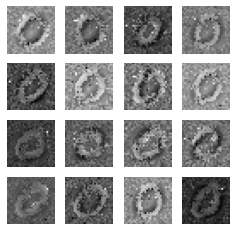

47
gen_loss: tf.Tensor(2.6407812, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10490377, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10762514, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99874830e-01 1.25099177e-04]
 [9.99987602e-01 1.23885548e-05]
 [9.99882340e-01 1.17613636e-04]
 [9.99340594e-01 6.59330806e-04]
 [9.97395515e-01 2.60452647e-03]
 [9.98217642e-01 1.78238470e-03]
 [9.97580886e-01 2.41908920e-03]
 [9.96599138e-01 3.40085523e-03]
 [9.98871863e-01 1.12816121e-03]
 [9.81262624e-01 1.87374074e-02]
 [9.99900341e-01 9.96159579e-05]
 [9.99981046e-01 1.89857783e-05]
 [9.92034495e-01 7.96555076e-03]
 [9.99032974e-01 9.67001601e-04]
 [9.97721851e-01 2.27809348e-03]
 [9.99913096e-01 8.69265714e-05]
 [9.99621868e-01 3.78146593e-04]
 [9.99630690e-01 3.69347108e-04]
 [9.99315023e-01 6.84959115e-04]
 [9.99786913e-01 2.13118066e-04]
 [9.99859810e-01 1.40180113e-04]
 [9.99977231e-01 2.27296332e-05]
 [9.99588311e-01 4.11664747e-04]
 [9.99639273e-01 3

gen_loss: tf.Tensor(2.6174853, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09306867, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.11042124, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99931335e-01 6.87099164e-05]
 [9.99993563e-01 6.39111659e-06]
 [9.99866247e-01 1.33707334e-04]
 [9.98835742e-01 1.16433052e-03]
 [9.96786356e-01 3.21362517e-03]
 [9.97913659e-01 2.08628969e-03]
 [9.96740282e-01 3.25969700e-03]
 [9.98374939e-01 1.62499258e-03]
 [9.98267055e-01 1.73293962e-03]
 [9.70626116e-01 2.93738469e-02]
 [9.99931931e-01 6.80646772e-05]
 [9.99936104e-01 6.39135033e-05]
 [9.91882026e-01 8.11802503e-03]
 [9.99097347e-01 9.02722299e-04]
 [9.96708632e-01 3.29139759e-03]
 [9.99893427e-01 1.06569518e-04]
 [9.99528527e-01 4.71540145e-04]
 [9.99636889e-01 3.63131112e-04]
 [9.99245286e-01 7.54730019e-04]
 [9.99713123e-01 2.86824536e-04]
 [9.99858975e-01 1.41060271e-04]
 [9.99985576e-01 1.44670657e-05]
 [9.99427557e-01 5.72431425e-04]
 [9.99366939e-01 6.33

gen_loss: tf.Tensor(2.7316384, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08467293, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09071134, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99937057e-01 6.29376227e-05]
 [9.99995947e-01 4.00952331e-06]
 [9.99722540e-01 2.77483865e-04]
 [9.96668041e-01 3.33192316e-03]
 [9.93026376e-01 6.97369874e-03]
 [9.96194363e-01 3.80561827e-03]
 [9.92903054e-01 7.09688477e-03]
 [9.98340368e-01 1.65963825e-03]
 [9.96024251e-01 3.97575414e-03]
 [9.28937674e-01 7.10623190e-02]
 [9.99905825e-01 9.42260085e-05]
 [9.99766886e-01 2.33087834e-04]
 [9.84228253e-01 1.57717373e-02]
 [9.98222649e-01 1.77740480e-03]
 [9.92556930e-01 7.44302338e-03]
 [9.99798357e-01 2.01717252e-04]
 [9.99089956e-01 9.10036964e-04]
 [9.99355614e-01 6.44417596e-04]
 [9.98422742e-01 1.57730212e-03]
 [9.99364316e-01 6.35639648e-04]
 [9.99686360e-01 3.13699304e-04]
 [9.99991059e-01 8.94192999e-06]
 [9.98551548e-01 1.44841662e-03]
 [9.98160064e-01 1.83

gen_loss: tf.Tensor(2.6839724, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13408646, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09792992, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99937773e-01 6.21873914e-05]
 [9.99994874e-01 5.10286463e-06]
 [9.99652147e-01 3.47907364e-04]
 [9.96114135e-01 3.88584589e-03]
 [9.91128087e-01 8.87185335e-03]
 [9.95823264e-01 4.17675078e-03]
 [9.91911352e-01 8.08865111e-03]
 [9.97883737e-01 2.11621774e-03]
 [9.95431542e-01 4.56846179e-03]
 [9.16182578e-01 8.38174373e-02]
 [9.99895096e-01 1.04886778e-04]
 [9.99749601e-01 2.50358775e-04]
 [9.65656519e-01 3.43434401e-02]
 [9.97645676e-01 2.35425611e-03]
 [9.91931379e-01 8.06865282e-03]
 [9.99777257e-01 2.22766321e-04]
 [9.99008119e-01 9.91908368e-04]
 [9.99213099e-01 7.86858320e-04]
 [9.97942746e-01 2.05726782e-03]
 [9.99223232e-01 7.76778441e-04]
 [9.99493361e-01 5.06587618e-04]
 [9.99990940e-01 9.05140769e-06]
 [9.98134613e-01 1.86533795e-03]
 [9.97891724e-01 2.10

gen_loss: tf.Tensor(2.6703482, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09712885, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09626967, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99946594e-01 5.34583887e-05]
 [9.99992609e-01 7.35897856e-06]
 [9.99861121e-01 1.38800795e-04]
 [9.98813629e-01 1.18636712e-03]
 [9.96190071e-01 3.80990515e-03]
 [9.97906089e-01 2.09393795e-03]
 [9.96794641e-01 3.20536923e-03]
 [9.98053789e-01 1.94628292e-03]
 [9.98328745e-01 1.67131424e-03]
 [9.68510687e-01 3.14893760e-02]
 [9.99934196e-01 6.58489444e-05]
 [9.99934435e-01 6.55389013e-05]
 [9.75374639e-01 2.46253386e-02]
 [9.99041378e-01 9.58544260e-04]
 [9.97130990e-01 2.86901300e-03]
 [9.99892354e-01 1.07624255e-04]
 [9.99524951e-01 4.75048495e-04]
 [9.99624014e-01 3.75941047e-04]
 [9.99150634e-01 8.49407515e-04]
 [9.99684572e-01 3.15482641e-04]
 [9.99787986e-01 2.12032479e-04]
 [9.99987006e-01 1.29784439e-05]
 [9.99321580e-01 6.78473676e-04]
 [9.99364078e-01 6.35

gen_loss: tf.Tensor(2.8219278, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12755056, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.090700895, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99960661e-01 3.93561677e-05]
 [9.99994636e-01 5.41168083e-06]
 [9.99892712e-01 1.07233027e-04]
 [9.99423742e-01 5.76293096e-04]
 [9.97483075e-01 2.51697772e-03]
 [9.98604357e-01 1.39570900e-03]
 [9.98136640e-01 1.86333794e-03]
 [9.98683751e-01 1.31624553e-03]
 [9.98953104e-01 1.04684639e-03]
 [9.84178722e-01 1.58212483e-02]
 [9.99953985e-01 4.59634321e-05]
 [9.99968290e-01 3.16500918e-05]
 [9.76138353e-01 2.38615852e-02]
 [9.99642253e-01 3.57735611e-04]
 [9.98414278e-01 1.58569182e-03]
 [9.99929905e-01 7.00342644e-05]
 [9.99693990e-01 3.06035567e-04]
 [9.99794781e-01 2.05271746e-04]
 [9.99508977e-01 4.91047394e-04]
 [9.99799430e-01 2.00633673e-04]
 [9.99838352e-01 1.61632081e-04]
 [9.99990225e-01 9.77201307e-06]
 [9.99617577e-01 3.82430240e-04]
 [9.99696016e-01 3.0

gen_loss: tf.Tensor(2.8458087, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.094645396, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.089726895, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99955535e-01 4.45048063e-05]
 [9.99995828e-01 4.20629385e-06]
 [9.99754012e-01 2.45978008e-04]
 [9.98840153e-01 1.15982897e-03]
 [9.95090365e-01 4.90960898e-03]
 [9.97585535e-01 2.41445494e-03]
 [9.96490777e-01 3.50925815e-03]
 [9.98577476e-01 1.42254739e-03]
 [9.97841597e-01 2.15833751e-03]
 [9.68663573e-01 3.13364565e-02]
 [9.99935627e-01 6.44166503e-05]
 [9.99929667e-01 7.03762489e-05]
 [9.65489268e-01 3.45107019e-02]
 [9.99382973e-01 6.17022451e-04]
 [9.96980131e-01 3.01984209e-03]
 [9.99883890e-01 1.16125571e-04]
 [9.99498010e-01 5.01987815e-04]
 [9.99657631e-01 3.42348911e-04]
 [9.99071956e-01 9.27984191e-04]
 [9.99574602e-01 4.25373728e-04]
 [9.99662638e-01 3.37325648e-04]
 [9.99993086e-01 6.89541184e-06]
 [9.99208510e-01 7.91488565e-04]
 [9.99377191e-01 6.

 [9.9806947e-01 1.9305329e-03]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.6671681, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09693876, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09929019, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9990869e-01 9.1301641e-05]
 [9.9999130e-01 8.7015278e-06]
 [9.9943262e-01 5.6731916e-04]
 [9.9800771e-01 1.9922820e-03]
 [9.9065512e-01 9.3449056e-03]
 [9.9550289e-01 4.4971029e-03]
 [9.9280304e-01 7.1968976e-03]
 [9.9768078e-01 2.3191916e-03]
 [9.9547136e-01 4.5286058e-03]
 [9.3362367e-01 6.6376269e-02]
 [9.9988580e-01 1.1422756e-04]
 [9.9986804e-01 1.3199315e-04]
 [9.7199553e-01 2.8004443e-02]
 [9.9834132e-01 1.6586658e-03]
 [9.9451017e-01 5.4898132e-03]
 [9.9980551e-01 1.9449854e-04]
 [9.9913710e-01 8.6286705e-04]
 [9.9929869e-01 7.0132606e-04]
 [9.9793637e-01 2.0636872e-03]
 [9.9897873e-01 1.0213534e-03]
 [9.9957341e-01 4.2653483e-04]
 [9.9998868e-01 1.1323830e-05]
 [9.9846613e-01 1.5339444e-03]
 [9

test_discriminator_output: tf.Tensor(
[[9.99910951e-01 8.90571464e-05]
 [9.99984622e-01 1.53289275e-05]
 [9.99613225e-01 3.86861648e-04]
 [9.99025822e-01 9.74220224e-04]
 [9.94529665e-01 5.47039788e-03]
 [9.97600019e-01 2.39999173e-03]
 [9.95313883e-01 4.68609063e-03]
 [9.98141408e-01 1.85853464e-03]
 [9.96942580e-01 3.05740535e-03]
 [9.72418606e-01 2.75814347e-02]
 [9.99926567e-01 7.34259811e-05]
 [9.99939680e-01 6.03142798e-05]
 [9.84363735e-01 1.56362113e-02]
 [9.99097466e-01 9.02499072e-04]
 [9.96576488e-01 3.42352712e-03]
 [9.99879718e-01 1.20288816e-04]
 [9.99501944e-01 4.98037611e-04]
 [9.99610245e-01 3.89819965e-04]
 [9.98545647e-01 1.45433005e-03]
 [9.99420285e-01 5.79715881e-04]
 [9.99795020e-01 2.05010816e-04]
 [9.99979019e-01 2.09752943e-05]
 [9.99239326e-01 7.60711613e-04]
 [9.99489665e-01 5.10272977e-04]
 [9.99648094e-01 3.51912313e-04]
 [9.97660041e-01 2.33993540e-03]
 [9.97083485e-01 2.91651534e-03]
 [9.99558747e-01 4.41226177e-04]
 [8.91739547e-01 1.08260520e-01]
 [9.9

gen_loss: tf.Tensor(2.8630395, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.089443326, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.085963815, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99953985e-01 4.59984658e-05]
 [9.99986410e-01 1.36350636e-05]
 [9.99823511e-01 1.76567264e-04]
 [9.99645233e-01 3.54768825e-04]
 [9.97952044e-01 2.04803562e-03]
 [9.99022603e-01 9.77401622e-04]
 [9.97982979e-01 2.01696460e-03]
 [9.99032497e-01 9.67540313e-04]
 [9.98650491e-01 1.34947721e-03]
 [9.92227077e-01 7.77295325e-03]
 [9.99969244e-01 3.07393129e-05]
 [9.99976397e-01 2.35750886e-05]
 [9.93659198e-01 6.34082919e-03]
 [9.99772727e-01 2.27263416e-04]
 [9.98614788e-01 1.38525164e-03]
 [9.99941945e-01 5.80764281e-05]
 [9.99772131e-01 2.27864861e-04]
 [9.99856710e-01 1.43239231e-04]
 [9.99533296e-01 4.66687459e-04]
 [9.99800146e-01 1.99914532e-04]
 [9.99906301e-01 9.37429504e-05]
 [9.99977231e-01 2.27350538e-05]
 [9.99774992e-01 2.24963514e-04]
 [9.99817550e-01 1.

gen_loss: tf.Tensor(2.6764636, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07527956, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.102681026, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99955177e-01 4.48507672e-05]
 [9.99990225e-01 9.82072379e-06]
 [9.99805391e-01 1.94646971e-04]
 [9.99559104e-01 4.40857460e-04]
 [9.97510672e-01 2.48933095e-03]
 [9.98719215e-01 1.28079613e-03]
 [9.97776210e-01 2.22374522e-03]
 [9.98785555e-01 1.21446792e-03]
 [9.98609662e-01 1.39028707e-03]
 [9.87899244e-01 1.21007906e-02]
 [9.99956250e-01 4.37131021e-05]
 [9.99971747e-01 2.82450092e-05]
 [9.92527366e-01 7.47265527e-03]
 [9.99723136e-01 2.76835402e-04]
 [9.98572946e-01 1.42705417e-03]
 [9.99927878e-01 7.21490724e-05]
 [9.99693036e-01 3.07018083e-04]
 [9.99809802e-01 1.90263978e-04]
 [9.99549448e-01 4.50535415e-04]
 [9.99758899e-01 2.41159447e-04]
 [9.99849916e-01 1.50083491e-04]
 [9.99984860e-01 1.51781387e-05]
 [9.99711096e-01 2.88830488e-04]
 [9.99771297e-01 2.2

gen_loss: tf.Tensor(2.768179, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08158468, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.089669265, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99949574e-01 5.04570016e-05]
 [9.99990821e-01 9.23755488e-06]
 [9.99761760e-01 2.38218054e-04]
 [9.99428213e-01 5.71726938e-04]
 [9.96907771e-01 3.09220748e-03]
 [9.98044491e-01 1.95546960e-03]
 [9.97542739e-01 2.45731999e-03]
 [9.98137951e-01 1.86198589e-03]
 [9.98576999e-01 1.42299302e-03]
 [9.75561917e-01 2.44380608e-02]
 [9.99931216e-01 6.87782158e-05]
 [9.99963164e-01 3.67928260e-05]
 [9.90165055e-01 9.83492099e-03]
 [9.99548614e-01 4.51304339e-04]
 [9.98524010e-01 1.47600484e-03]
 [9.99909163e-01 9.08061993e-05]
 [9.99570310e-01 4.29741747e-04]
 [9.99710143e-01 2.89774616e-04]
 [9.99521136e-01 4.78842179e-04]
 [9.99692917e-01 3.07124341e-04]
 [9.99725163e-01 2.74849561e-04]
 [9.99988198e-01 1.18057123e-05]
 [9.99600112e-01 3.99855839e-04]
 [9.99699235e-01 3.00

gen_loss: tf.Tensor(2.7048357, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0932056, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09828965, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99939322e-01 6.06371177e-05]
 [9.99984860e-01 1.51443055e-05]
 [9.99740064e-01 2.59872555e-04]
 [9.99474108e-01 5.25940442e-04]
 [9.96977568e-01 3.02241882e-03]
 [9.98233199e-01 1.76679506e-03]
 [9.97742057e-01 2.25794059e-03]
 [9.97585297e-01 2.41473899e-03]
 [9.98664141e-01 1.33582565e-03]
 [9.71144795e-01 2.88552493e-02]
 [9.99920964e-01 7.90813938e-05]
 [9.99965906e-01 3.41016748e-05]
 [9.88153756e-01 1.18462248e-02]
 [9.99448001e-01 5.51933073e-04]
 [9.98600900e-01 1.39908376e-03]
 [9.99921799e-01 7.82385105e-05]
 [9.99631166e-01 3.68810171e-04]
 [9.99710381e-01 2.89637654e-04]
 [9.99418855e-01 5.81221888e-04]
 [9.99727666e-01 2.72363599e-04]
 [9.99721467e-01 2.78472638e-04]
 [9.99984026e-01 1.60140298e-05]
 [9.99596417e-01 4.03560611e-04]
 [9.99718130e-01 2.818

gen_loss: tf.Tensor(2.7895875, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11073018, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08530268, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99962211e-01 3.77859797e-05]
 [9.99989152e-01 1.08130107e-05]
 [9.99768078e-01 2.31885308e-04]
 [9.99386549e-01 6.13449374e-04]
 [9.97124493e-01 2.87555763e-03]
 [9.98894155e-01 1.10584684e-03]
 [9.97730434e-01 2.26958958e-03]
 [9.98779237e-01 1.22070918e-03]
 [9.98362005e-01 1.63804891e-03]
 [9.77281272e-01 2.27187108e-02]
 [9.99949217e-01 5.07783334e-05]
 [9.99946356e-01 5.36553234e-05]
 [9.90719497e-01 9.28058010e-03]
 [9.99734342e-01 2.65697279e-04]
 [9.98307586e-01 1.69245573e-03]
 [9.99932766e-01 6.72152601e-05]
 [9.99726236e-01 2.73742538e-04]
 [9.99810874e-01 1.89130966e-04]
 [9.99430120e-01 5.69844618e-04]
 [9.99769032e-01 2.30972233e-04]
 [9.99839067e-01 1.60849508e-04]
 [9.99983788e-01 1.61530679e-05]
 [9.99619842e-01 3.80081910e-04]
 [9.99675989e-01 3.24

gen_loss: tf.Tensor(2.7059827, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06639047, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.092809714, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99972820e-01 2.72322177e-05]
 [9.99992728e-01 7.22065079e-06]
 [9.99754608e-01 2.45376519e-04]
 [9.99129236e-01 8.70800053e-04]
 [9.96603966e-01 3.39601818e-03]
 [9.98830259e-01 1.16972416e-03]
 [9.97255385e-01 2.74457689e-03]
 [9.99099135e-01 9.00862913e-04]
 [9.97926235e-01 2.07369309e-03]
 [9.69968200e-01 3.00318114e-02]
 [9.99955416e-01 4.46009108e-05]
 [9.99905109e-01 9.49062960e-05]
 [9.90958214e-01 9.04173590e-03]
 [9.99748766e-01 2.51279242e-04]
 [9.97880340e-01 2.11969903e-03]
 [9.99923348e-01 7.66153898e-05]
 [9.99706924e-01 2.93034565e-04]
 [9.99803364e-01 1.96604728e-04]
 [9.99409199e-01 5.90761076e-04]
 [9.99735415e-01 2.64598610e-04]
 [9.99830127e-01 1.69873223e-04]
 [9.99987602e-01 1.23607979e-05]
 [9.99524236e-01 4.75760200e-04]
 [9.99534249e-01 4.6

test_discriminator_output: tf.Tensor(
[[9.99971390e-01 2.86156883e-05]
 [9.99993801e-01 6.24175254e-06]
 [9.99621868e-01 3.78166442e-04]
 [9.98508036e-01 1.49193837e-03]
 [9.94970381e-01 5.02964249e-03]
 [9.98342991e-01 1.65700866e-03]
 [9.95800078e-01 4.19989787e-03]
 [9.99009490e-01 9.90463421e-04]
 [9.96777713e-01 3.22228530e-03]
 [9.42417085e-01 5.75828999e-02]
 [9.99945998e-01 5.40464316e-05]
 [9.99814689e-01 1.85278186e-04]
 [9.89537835e-01 1.04621928e-02]
 [9.99569118e-01 4.30828455e-04]
 [9.96735394e-01 3.26456665e-03]
 [9.99892116e-01 1.07818902e-04]
 [9.99590695e-01 4.09366068e-04]
 [9.99697208e-01 3.02795524e-04]
 [9.99148726e-01 8.51255259e-04]
 [9.99581754e-01 4.18212381e-04]
 [9.99733269e-01 2.66757532e-04]
 [9.99990106e-01 9.86388204e-06]
 [9.99197304e-01 8.02648952e-04]
 [9.99192894e-01 8.07062373e-04]
 [9.99772251e-01 2.27739103e-04]
 [9.99007642e-01 9.92368674e-04]
 [9.97014761e-01 2.98527768e-03]
 [9.99689460e-01 3.10565782e-04]
 [7.10532904e-01 2.89467096e-01]
 [9.9

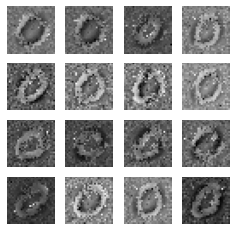

48
gen_loss: tf.Tensor(2.8435411, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.080031395, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.082568854, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9996340e-01 3.6556125e-05]
 [9.9999356e-01 6.4500396e-06]
 [9.9946970e-01 5.3026760e-04]
 [9.9805164e-01 1.9483522e-03]
 [9.9340409e-01 6.5958989e-03]
 [9.9775702e-01 2.2429738e-03]
 [9.9476385e-01 5.2361637e-03]
 [9.9857104e-01 1.4289893e-03]
 [9.9619544e-01 3.8045340e-03]
 [9.1007358e-01 8.9926392e-02]
 [9.9992383e-01 7.6190991e-05]
 [9.9978548e-01 2.1458841e-04]
 [9.8700362e-01 1.2996320e-02]
 [9.9924135e-01 7.5864693e-04]
 [9.9622452e-01 3.7754942e-03]
 [9.9986446e-01 1.3552931e-04]
 [9.9947029e-01 5.2978011e-04]
 [9.9954659e-01 4.5343072e-04]
 [9.9882871e-01 1.1712846e-03]
 [9.9941564e-01 5.8440096e-04]
 [9.9957925e-01 4.2079960e-04]
 [9.9999154e-01 8.4259655e-06]
 [9.9883407e-01 1.1659219e-03]
 [9.9895489e-01 1.0450318e-03]
 [9.9973172e-01 2.6830909e-04]


gen_loss: tf.Tensor(2.704986, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0844108, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10418095, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99981642e-01 1.83894135e-05]
 [9.99995470e-01 4.49152185e-06]
 [9.99691725e-01 3.08321614e-04]
 [9.99225378e-01 7.74673943e-04]
 [9.97211516e-01 2.78851110e-03]
 [9.98744249e-01 1.25574099e-03]
 [9.97742414e-01 2.25760229e-03]
 [9.99110878e-01 8.89100949e-04]
 [9.98506069e-01 1.49391009e-03]
 [9.57672775e-01 4.23272215e-02]
 [9.99966264e-01 3.36892554e-05]
 [9.99920845e-01 7.91412094e-05]
 [9.91962731e-01 8.03732313e-03]
 [9.99556839e-01 4.43178753e-04]
 [9.98518646e-01 1.48134283e-03]
 [9.99931574e-01 6.83937760e-05]
 [9.99740064e-01 2.59908003e-04]
 [9.99792397e-01 2.07638848e-04]
 [9.99523401e-01 4.76607645e-04]
 [9.99766886e-01 2.33086277e-04]
 [9.99667406e-01 3.32574447e-04]
 [9.99994516e-01 5.48399476e-06]
 [9.99581039e-01 4.18946001e-04]
 [9.99608815e-01 3.9125

gen_loss: tf.Tensor(2.8353488, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10145268, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08929831, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99993324e-01 6.70348663e-06]
 [9.99997854e-01 2.17038973e-06]
 [9.99864578e-01 1.35419774e-04]
 [9.99708116e-01 2.91855191e-04]
 [9.99005139e-01 9.94893373e-04]
 [9.99401450e-01 5.98536746e-04]
 [9.99134719e-01 8.65352515e-04]
 [9.99637008e-01 3.62947467e-04]
 [9.99424696e-01 5.75335929e-04]
 [9.85659301e-01 1.43406754e-02]
 [9.99987721e-01 1.22676247e-05]
 [9.99970317e-01 2.96584567e-05]
 [9.96473491e-01 3.52645130e-03]
 [9.99859810e-01 1.40184246e-04]
 [9.99418020e-01 5.81955770e-04]
 [9.99965549e-01 3.44853179e-05]
 [9.99863267e-01 1.36718139e-04]
 [9.99927759e-01 7.21798206e-05]
 [9.99855638e-01 1.44311591e-04]
 [9.99921322e-01 7.87150639e-05]
 [9.99805629e-01 1.94352469e-04]
 [9.99996901e-01 3.14329850e-06]
 [9.99860525e-01 1.39442331e-04]
 [9.99861836e-01 1.38

test_discriminator_output: tf.Tensor(
[[9.99993563e-01 6.43345220e-06]
 [9.99997735e-01 2.29969714e-06]
 [9.99866366e-01 1.33599126e-04]
 [9.99765217e-01 2.34756124e-04]
 [9.99200165e-01 7.99883564e-04]
 [9.99496102e-01 5.03839576e-04]
 [9.99278367e-01 7.21655961e-04]
 [9.99646425e-01 3.53536132e-04]
 [9.99482214e-01 5.17850684e-04]
 [9.88232195e-01 1.17678121e-02]
 [9.99989033e-01 1.09449256e-05]
 [9.99977350e-01 2.26830161e-05]
 [9.96794999e-01 3.20506468e-03]
 [9.99893308e-01 1.06680345e-04]
 [9.99490380e-01 5.09560399e-04]
 [9.99969363e-01 3.06725233e-05]
 [9.99871969e-01 1.28001964e-04]
 [9.99938369e-01 6.16302641e-05]
 [9.99876142e-01 1.23893537e-04]
 [9.99931574e-01 6.84459665e-05]
 [9.99815285e-01 1.84732242e-04]
 [9.99996901e-01 3.12509565e-06]
 [9.99877930e-01 1.22019504e-04]
 [9.99891877e-01 1.08074390e-04]
 [9.99965906e-01 3.40926672e-05]
 [9.99413013e-01 5.86957205e-04]
 [9.99678373e-01 3.21608823e-04]
 [9.99816358e-01 1.83720811e-04]
 [8.61738741e-01 1.38261214e-01]
 [9.9

gen_loss: tf.Tensor(2.717929, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09081768, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0954747, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99985933e-01 1.40980992e-05]
 [9.99995470e-01 4.47920229e-06]
 [9.99793708e-01 2.06285331e-04]
 [9.99756873e-01 2.43088652e-04]
 [9.98925626e-01 1.07439794e-03]
 [9.99505639e-01 4.94374370e-04]
 [9.99073744e-01 9.26183071e-04]
 [9.99338686e-01 6.61288621e-04]
 [9.99293447e-01 7.06585008e-04]
 [9.88654256e-01 1.13457320e-02]
 [9.99980330e-01 1.96218680e-05]
 [9.99984145e-01 1.58068415e-05]
 [9.95911002e-01 4.08902159e-03]
 [9.99863148e-01 1.36877163e-04]
 [9.99338448e-01 6.61499100e-04]
 [9.99963999e-01 3.60151498e-05]
 [9.99825537e-01 1.74465968e-04]
 [9.99919772e-01 8.02049399e-05]
 [9.99771416e-01 2.28543271e-04]
 [9.99907494e-01 9.25339191e-05]
 [9.99784529e-01 2.15526103e-04]
 [9.99995112e-01 4.89962031e-06]
 [9.99834538e-01 1.65397083e-04]
 [9.99892354e-01 1.0763

 [9.99005973e-01 9.94109898e-04]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.8189092, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06989522, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08346469, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99982834e-01 1.71915890e-05]
 [9.99996901e-01 3.11785584e-06]
 [9.99777257e-01 2.22747418e-04]
 [9.99680877e-01 3.19086132e-04]
 [9.98174667e-01 1.82528771e-03]
 [9.99405861e-01 5.94198995e-04]
 [9.98696268e-01 1.30370667e-03]
 [9.99316573e-01 6.83408522e-04]
 [9.99025702e-01 9.74260096e-04]
 [9.85358596e-01 1.46414600e-02]
 [9.99968767e-01 3.11780532e-05]
 [9.99977708e-01 2.23125589e-05]
 [9.95687068e-01 4.31287289e-03]
 [9.99854565e-01 1.45367987e-04]
 [9.99105990e-01 8.93995282e-04]
 [9.99948621e-01 5.14165149e-05]
 [9.99720633e-01 2.79402680e-04]
 [9.99899268e-01 1.00669829e-04]
 [9.99681473e-01 3.18581267e-04]
 [9.99873281e-01 1.26713581e-04]
 [9.99783576e-01 2.16427419e-04]
 [9.99995947e-01 4.01

gen_loss: tf.Tensor(2.6852148, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11182922, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09527209, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99982953e-01 1.70061048e-05]
 [9.99997377e-01 2.58212867e-06]
 [9.99828339e-01 1.71679872e-04]
 [9.99662161e-01 3.37892765e-04]
 [9.97891009e-01 2.10905960e-03]
 [9.99331474e-01 6.68536697e-04]
 [9.98682559e-01 1.31743390e-03]
 [9.99368012e-01 6.32057723e-04]
 [9.99100804e-01 8.99237813e-04]
 [9.83094871e-01 1.69050824e-02]
 [9.99964356e-01 3.56846213e-05]
 [9.99975801e-01 2.42534279e-05]
 [9.96631444e-01 3.36856977e-03]
 [9.99858499e-01 1.41484590e-04]
 [9.99173820e-01 8.26163101e-04]
 [9.99941587e-01 5.84210975e-05]
 [9.99678612e-01 3.21416650e-04]
 [9.99887347e-01 1.12677728e-04]
 [9.99723852e-01 2.76129984e-04]
 [9.99864340e-01 1.35611786e-04]
 [9.99814332e-01 1.85708530e-04]
 [9.99996185e-01 3.79733615e-06]
 [9.99701679e-01 2.98289873e-04]
 [9.99845147e-01 1.54

gen_loss: tf.Tensor(2.863325, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.099932574, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.084570505, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99994516e-01 5.46394313e-06]
 [9.99997973e-01 2.04138701e-06]
 [9.99913692e-01 8.63149107e-05]
 [9.99877691e-01 1.22297555e-04]
 [9.99290228e-01 7.09713669e-04]
 [9.99684930e-01 3.15066020e-04]
 [9.99558866e-01 4.41175333e-04]
 [9.99785125e-01 2.14850646e-04]
 [9.99713480e-01 2.86537019e-04]
 [9.93778527e-01 6.22142758e-03]
 [9.99990344e-01 9.66142761e-06]
 [9.99987721e-01 1.22553474e-05]
 [9.97611642e-01 2.38841120e-03]
 [9.99929428e-01 7.05936109e-05]
 [9.99725521e-01 2.74420890e-04]
 [9.99975681e-01 2.43058021e-05]
 [9.99888897e-01 1.11071262e-04]
 [9.99961257e-01 3.87115724e-05]
 [9.99927163e-01 7.27957158e-05]
 [9.99956131e-01 4.38661918e-05]
 [9.99843478e-01 1.56519760e-04]
 [9.99996901e-01 3.11103054e-06]
 [9.99906301e-01 9.36701181e-05]
 [9.99945283e-01 5.4

gen_loss: tf.Tensor(2.7618687, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0952211, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09513843, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99995828e-01 4.11766177e-06]
 [9.99996781e-01 3.25100473e-06]
 [9.99884367e-01 1.15568801e-04]
 [9.99893308e-01 1.06735599e-04]
 [9.99551237e-01 4.48757055e-04]
 [9.99733150e-01 2.66782154e-04]
 [9.99648333e-01 3.51626601e-04]
 [9.99782979e-01 2.17075125e-04]
 [9.99763191e-01 2.36773820e-04]
 [9.94558513e-01 5.44147054e-03]
 [9.99994159e-01 5.83844803e-06]
 [9.99985695e-01 1.42977024e-05]
 [9.97462273e-01 2.53769290e-03]
 [9.99925375e-01 7.45855214e-05]
 [9.99760449e-01 2.39545217e-04]
 [9.99981642e-01 1.84153869e-05]
 [9.99921203e-01 7.88468315e-05]
 [9.99969363e-01 3.05823523e-05]
 [9.99937534e-01 6.24275563e-05]
 [9.99967694e-01 3.22471496e-05]
 [9.99857426e-01 1.42504665e-04]
 [9.99996185e-01 3.81668769e-06]
 [9.99936581e-01 6.34142707e-05]
 [9.99953508e-01 4.650

gen_loss: tf.Tensor(2.7809114, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.110332556, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08995506, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99992013e-01 8.00064026e-06]
 [9.99996662e-01 3.28261990e-06]
 [9.99830008e-01 1.69931533e-04]
 [9.99743879e-01 2.56129482e-04]
 [9.99152541e-01 8.47497955e-04]
 [9.99512076e-01 4.87956422e-04]
 [9.99236107e-01 7.63886084e-04]
 [9.99519825e-01 4.80167218e-04]
 [9.99560773e-01 4.39264724e-04]
 [9.87694740e-01 1.23052774e-02]
 [9.99986887e-01 1.31105180e-05]
 [9.99973655e-01 2.63915990e-05]
 [9.97770190e-01 2.22983421e-03]
 [9.99871731e-01 1.28264888e-04]
 [9.99518991e-01 4.81073454e-04]
 [9.99965549e-01 3.44316868e-05]
 [9.99842763e-01 1.57165079e-04]
 [9.99923468e-01 7.65738296e-05]
 [9.99863505e-01 1.36470539e-04]
 [9.99929667e-01 7.03746337e-05]
 [9.99890566e-01 1.09387096e-04]
 [9.99995947e-01 4.00702720e-06]
 [9.99858975e-01 1.41044933e-04]
 [9.99887109e-01 1.1

gen_loss: tf.Tensor(2.7292461, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11511721, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0932444, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99991298e-01 8.71663542e-06]
 [9.99998569e-01 1.40342559e-06]
 [9.99919176e-01 8.08076584e-05]
 [9.99839306e-01 1.60695592e-04]
 [9.99384284e-01 6.15687459e-04]
 [9.99590695e-01 4.09365864e-04]
 [9.99471009e-01 5.28963632e-04]
 [9.99422550e-01 5.77533094e-04]
 [9.99769628e-01 2.30384117e-04]
 [9.91328835e-01 8.67113937e-03]
 [9.99983191e-01 1.67787202e-05]
 [9.99989152e-01 1.07916449e-05]
 [9.98287022e-01 1.71299523e-03]
 [9.99936223e-01 6.37310877e-05]
 [9.99749362e-01 2.50663812e-04]
 [9.99971986e-01 2.80574095e-05]
 [9.99855161e-01 1.44765843e-04]
 [9.99926567e-01 7.33743145e-05]
 [9.99917150e-01 8.29006167e-05]
 [9.99946713e-01 5.33341954e-05]
 [9.99940276e-01 5.97656108e-05]
 [9.99998093e-01 1.95968869e-06]
 [9.99887824e-01 1.12113223e-04]
 [9.99929070e-01 7.095

 [9.99332011e-01 6.67987333e-04]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.8286233, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09412095, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08569679, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99991059e-01 8.94068489e-06]
 [9.99999046e-01 9.05023342e-07]
 [9.99915004e-01 8.50485012e-05]
 [9.99863029e-01 1.36916307e-04]
 [9.99439418e-01 5.60546177e-04]
 [9.99587238e-01 4.12804424e-04]
 [9.99514103e-01 4.85917175e-04]
 [9.99282658e-01 7.17380026e-04]
 [9.99815643e-01 1.84397170e-04]
 [9.90132809e-01 9.86722764e-03]
 [9.99980092e-01 1.98707203e-05]
 [9.99992013e-01 7.94601328e-06]
 [9.97628272e-01 2.37178802e-03]
 [9.99944568e-01 5.54068101e-05]
 [9.99809206e-01 1.90800623e-04]
 [9.99972820e-01 2.71227127e-05]
 [9.99840260e-01 1.59671938e-04]
 [9.99919295e-01 8.06393000e-05]
 [9.99929667e-01 7.03222322e-05]
 [9.99947667e-01 5.22727496e-05]
 [9.99925256e-01 7.47057566e-05]
 [9.99998927e-01 1.02

gen_loss: tf.Tensor(2.6915736, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14832626, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09560243, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99993801e-01 6.19974981e-06]
 [9.99999166e-01 8.12015514e-07]
 [9.99882460e-01 1.17471616e-04]
 [9.99874115e-01 1.25827035e-04]
 [9.99555051e-01 4.44981240e-04]
 [9.99665499e-01 3.34497250e-04]
 [9.99541283e-01 4.58798109e-04]
 [9.99471843e-01 5.28163160e-04]
 [9.99810755e-01 1.89219892e-04]
 [9.91399407e-01 8.60061776e-03]
 [9.99987602e-01 1.23933760e-05]
 [9.99990821e-01 9.22275831e-06]
 [9.97046888e-01 2.95311119e-03]
 [9.99950528e-01 4.94334854e-05]
 [9.99805748e-01 1.94292996e-04]
 [9.99976635e-01 2.34194431e-05]
 [9.99857187e-01 1.42844510e-04]
 [9.99943376e-01 5.65767514e-05]
 [9.99934554e-01 6.53980605e-05]
 [9.99959826e-01 4.01315265e-05]
 [9.99905467e-01 9.45221764e-05]
 [9.99999166e-01 8.13574331e-07]
 [9.99902248e-01 9.77706732e-05]
 [9.99941945e-01 5.80

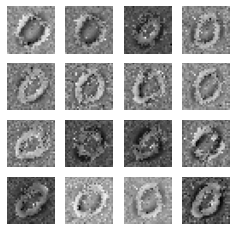

49
gen_loss: tf.Tensor(2.7144127, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09843435, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09860356, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99992847e-01 7.20599928e-06]
 [9.99998689e-01 1.26358134e-06]
 [9.99733031e-01 2.66988791e-04]
 [9.99795020e-01 2.04978947e-04]
 [9.99347508e-01 6.52429648e-04]
 [9.99432743e-01 5.67188312e-04]
 [9.99226213e-01 7.73820619e-04]
 [9.99364078e-01 6.35965727e-04]
 [9.99673367e-01 3.26686102e-04]
 [9.74950969e-01 2.50490103e-02]
 [9.99984980e-01 1.50024835e-05]
 [9.99978185e-01 2.18428104e-05]
 [9.95844185e-01 4.15583327e-03]
 [9.99876142e-01 1.23901453e-04]
 [9.99670386e-01 3.29566508e-04]
 [9.99962687e-01 3.72997529e-05]
 [9.99739707e-01 2.60273519e-04]
 [9.99908209e-01 9.17571597e-05]
 [9.99917746e-01 8.22595321e-05]
 [9.99938011e-01 6.20431019e-05]
 [9.99804437e-01 1.95634042e-04]
 [9.99999046e-01 9.41062751e-07]
 [9.99835014e-01 1.64938945e-04]
 [9.99905586e-01 9

 [9.99136746e-01 8.63225257e-04]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.7213154, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10361712, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.110191986, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99994636e-01 5.38595759e-06]
 [9.99998927e-01 1.02398542e-06]
 [9.99920130e-01 7.98088149e-05]
 [9.99948502e-01 5.15547763e-05]
 [9.99630213e-01 3.69819230e-04]
 [9.99744117e-01 2.55931256e-04]
 [9.99679089e-01 3.20921186e-04]
 [9.99591529e-01 4.08515858e-04]
 [9.99898911e-01 1.01121645e-04]
 [9.92195010e-01 7.80493580e-03]
 [9.99988794e-01 1.12240032e-05]
 [9.99995947e-01 4.07997277e-06]
 [9.96875882e-01 3.12416116e-03]
 [9.99958396e-01 4.16032854e-05]
 [9.99893188e-01 1.06774576e-04]
 [9.99980807e-01 1.92391999e-05]
 [9.99892116e-01 1.07926615e-04]
 [9.99958277e-01 4.17237497e-05]
 [9.99973655e-01 2.63543225e-05]
 [9.99977469e-01 2.25785370e-05]
 [9.99916553e-01 8.34675448e-05]
 [9.99999046e-01 9.7

gen_loss: tf.Tensor(2.8214574, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09774424, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08144254, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99996662e-01 3.35878599e-06]
 [9.99999285e-01 6.76773880e-07]
 [9.99965429e-01 3.45234876e-05]
 [9.99982357e-01 1.77014063e-05]
 [9.99807537e-01 1.92523192e-04]
 [9.99880672e-01 1.19301061e-04]
 [9.99845386e-01 1.54635331e-04]
 [9.99778330e-01 2.21708557e-04]
 [9.99955893e-01 4.41188313e-05]
 [9.97765660e-01 2.23437953e-03]
 [9.99993801e-01 6.21649315e-06]
 [9.99998808e-01 1.25165400e-06]
 [9.97606754e-01 2.39320239e-03]
 [9.99987006e-01 1.29546643e-05]
 [9.99953151e-01 4.68988655e-05]
 [9.99990106e-01 9.89345426e-06]
 [9.99953747e-01 4.62665630e-05]
 [9.99981523e-01 1.84448090e-05]
 [9.99988556e-01 1.14433333e-05]
 [9.99990702e-01 9.33762385e-06]
 [9.99956965e-01 4.30566506e-05]
 [9.99999166e-01 8.21584990e-07]
 [9.99976397e-01 2.35791813e-05]
 [9.99991775e-01 8.20

gen_loss: tf.Tensor(2.7266722, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11729421, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10246974, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99995828e-01 4.17087085e-06]
 [9.99999285e-01 6.91785260e-07]
 [9.99963522e-01 3.64466177e-05]
 [9.99983668e-01 1.63643726e-05]
 [9.99780595e-01 2.19376569e-04]
 [9.99832630e-01 1.67360617e-04]
 [9.99830246e-01 1.69695762e-04]
 [9.99760926e-01 2.39031186e-04]
 [9.99953151e-01 4.68342369e-05]
 [9.96853888e-01 3.14610475e-03]
 [9.99991655e-01 8.39791210e-06]
 [9.99998569e-01 1.38800419e-06]
 [9.97410953e-01 2.58904020e-03]
 [9.99983668e-01 1.63271925e-05]
 [9.99950051e-01 4.99469534e-05]
 [9.99988914e-01 1.10354486e-05]
 [9.99946833e-01 5.31180121e-05]
 [9.99973297e-01 2.66442275e-05]
 [9.99988437e-01 1.16103765e-05]
 [9.99989033e-01 1.09722241e-05]
 [9.99949932e-01 5.00856586e-05]
 [9.99999285e-01 7.52147116e-07]
 [9.99973178e-01 2.68529420e-05]
 [9.99992371e-01 7.57

test_discriminator_output: tf.Tensor(
[[9.99994397e-01 5.54578628e-06]
 [9.99999166e-01 8.69348753e-07]
 [9.99940872e-01 5.91510397e-05]
 [9.99975801e-01 2.41427988e-05]
 [9.99695420e-01 3.04603716e-04]
 [9.99758422e-01 2.41582413e-04]
 [9.99748170e-01 2.51816498e-04]
 [9.99680638e-01 3.19323502e-04]
 [9.99926090e-01 7.38585659e-05]
 [9.94470358e-01 5.52967656e-03]
 [9.99988198e-01 1.18002081e-05]
 [9.99997616e-01 2.40521922e-06]
 [9.96484876e-01 3.51516274e-03]
 [9.99971986e-01 2.79632204e-05]
 [9.99920607e-01 7.94045045e-05]
 [9.99986053e-01 1.39905496e-05]
 [9.99923944e-01 7.60084804e-05]
 [9.99960184e-01 3.98417615e-05]
 [9.99980450e-01 1.95214161e-05]
 [9.99984264e-01 1.57244813e-05]
 [9.99931216e-01 6.87669381e-05]
 [9.99999166e-01 8.29383339e-07]
 [9.99960184e-01 3.98350348e-05]
 [9.99988794e-01 1.12077978e-05]
 [9.99991894e-01 8.10457368e-06]
 [9.99531150e-01 4.68882878e-04]
 [9.99921918e-01 7.80391783e-05]
 [9.99798715e-01 2.01359246e-04]
 [9.02947903e-01 9.70520675e-02]
 [9.9

gen_loss: tf.Tensor(2.794099, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06983024, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08866133, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99997258e-01 2.73667661e-06]
 [9.99999285e-01 6.90002992e-07]
 [9.99931693e-01 6.82968603e-05]
 [9.99979734e-01 2.02086103e-05]
 [9.99827862e-01 1.72139335e-04]
 [9.99835253e-01 1.64743731e-04]
 [9.99778688e-01 2.21330483e-04]
 [9.99858379e-01 1.41606870e-04]
 [9.99913692e-01 8.63401074e-05]
 [9.96623993e-01 3.37596564e-03]
 [9.99995232e-01 4.70957912e-06]
 [9.99995708e-01 4.26108272e-06]
 [9.97600973e-01 2.39903294e-03]
 [9.99986053e-01 1.39589374e-05]
 [9.99908090e-01 9.19020895e-05]
 [9.99989867e-01 1.01419964e-05]
 [9.99945402e-01 5.45443108e-05]
 [9.99980927e-01 1.90243099e-05]
 [9.99980927e-01 1.91156068e-05]
 [9.99990106e-01 9.87852127e-06]
 [9.99959469e-01 4.05643150e-05]
 [9.99999166e-01 8.62996444e-07]
 [9.99973893e-01 2.60799043e-05]
 [9.99990582e-01 9.393

test_discriminator_output: tf.Tensor(
[[9.99998093e-01 1.90982132e-06]
 [9.99999404e-01 5.50846039e-07]
 [9.99937057e-01 6.29496208e-05]
 [9.99982238e-01 1.77548154e-05]
 [9.99871373e-01 1.28635045e-04]
 [9.99869108e-01 1.30914777e-04]
 [9.99799430e-01 2.00557159e-04]
 [9.99907017e-01 9.30032111e-05]
 [9.99911666e-01 8.83774701e-05]
 [9.97409284e-01 2.59075779e-03]
 [9.99996901e-01 3.09815709e-06]
 [9.99994516e-01 5.51913172e-06]
 [9.98421907e-01 1.57814263e-03]
 [9.99991179e-01 8.80029529e-06]
 [9.99905705e-01 9.42646511e-05]
 [9.99991298e-01 8.72903001e-06]
 [9.99953866e-01 4.61773488e-05]
 [9.99986768e-01 1.32156883e-05]
 [9.99982953e-01 1.70482745e-05]
 [9.99992132e-01 7.87301360e-06]
 [9.99974251e-01 2.57944175e-05]
 [9.99999166e-01 8.58974715e-07]
 [9.99978423e-01 2.15642631e-05]
 [9.99991655e-01 8.36695926e-06]
 [9.99994993e-01 5.02486955e-06]
 [9.99776065e-01 2.23938434e-04]
 [9.99950528e-01 4.94534288e-05]
 [9.99939322e-01 6.06619869e-05]
 [9.94192421e-01 5.80752920e-03]
 [9.9

gen_loss: tf.Tensor(2.911047, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.106731065, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08759253, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99996662e-01 3.30061971e-06]
 [9.99999404e-01 5.77640208e-07]
 [9.99943376e-01 5.66057897e-05]
 [9.99985695e-01 1.43107163e-05]
 [9.99871373e-01 1.28576168e-04]
 [9.99865413e-01 1.34587259e-04]
 [9.99826133e-01 1.73889828e-04]
 [9.99846697e-01 1.53247165e-04]
 [9.99935031e-01 6.49591238e-05]
 [9.96827543e-01 3.17244744e-03]
 [9.99994040e-01 6.01524880e-06]
 [9.99996662e-01 3.33798516e-06]
 [9.98329461e-01 1.67060003e-03]
 [9.99988437e-01 1.16124911e-05]
 [9.99929786e-01 7.02623147e-05]
 [9.99990940e-01 9.04960325e-06]
 [9.99943733e-01 5.62476343e-05]
 [9.99982357e-01 1.76116755e-05]
 [9.99981046e-01 1.89068196e-05]
 [9.99991536e-01 8.45641898e-06]
 [9.99973416e-01 2.65843300e-05]
 [9.99999166e-01 8.21179981e-07]
 [9.99973416e-01 2.65918370e-05]
 [9.99993324e-01 6.68

gen_loss: tf.Tensor(2.8338995, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08567962, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0848112, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99996066e-01 3.94662447e-06]
 [9.99999285e-01 7.13519626e-07]
 [9.99960661e-01 3.93066948e-05]
 [9.99993801e-01 6.16994566e-06]
 [9.99911547e-01 8.84985784e-05]
 [9.99916196e-01 8.38077030e-05]
 [9.99908090e-01 9.18588921e-05]
 [9.99810636e-01 1.89358674e-04]
 [9.99972820e-01 2.71576537e-05]
 [9.98090446e-01 1.90957147e-03]
 [9.99992967e-01 6.97683845e-06]
 [9.99999046e-01 9.09382095e-07]
 [9.97742534e-01 2.25742511e-03]
 [9.99987245e-01 1.27694502e-05]
 [9.99970555e-01 2.94492766e-05]
 [9.99994278e-01 5.76897583e-06]
 [9.99961853e-01 3.81686441e-05]
 [9.99987006e-01 1.30058634e-05]
 [9.99984741e-01 1.52267794e-05]
 [9.99994993e-01 4.97448082e-06]
 [9.99974847e-01 2.51003967e-05]
 [9.99999166e-01 8.14997748e-07]
 [9.99982476e-01 1.75073656e-05]
 [9.99997020e-01 2.932

gen_loss: tf.Tensor(2.8235335, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08039251, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.089561924, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99998450e-01 1.50442122e-06]
 [9.99999642e-01 3.05500464e-07]
 [9.99956846e-01 4.31828084e-05]
 [9.99994159e-01 5.82280654e-06]
 [9.99931455e-01 6.84966362e-05]
 [9.99932289e-01 6.76523414e-05]
 [9.99925613e-01 7.43492710e-05]
 [9.99930143e-01 6.98515141e-05]
 [9.99974608e-01 2.54043061e-05]
 [9.98289764e-01 1.71019323e-03]
 [9.99996901e-01 3.04459127e-06]
 [9.99998450e-01 1.55929843e-06]
 [9.97535825e-01 2.46422575e-03]
 [9.99990702e-01 9.30616170e-06]
 [9.99971271e-01 2.86715731e-05]
 [9.99995470e-01 4.53355824e-06]
 [9.99967456e-01 3.25170477e-05]
 [9.99992013e-01 8.00624275e-06]
 [9.99989152e-01 1.08007671e-05]
 [9.99996543e-01 3.41570922e-06]
 [9.99972582e-01 2.73639671e-05]
 [9.99999642e-01 3.66912531e-07]
 [9.99986410e-01 1.36104327e-05]
 [9.99997020e-01 2.9

gen_loss: tf.Tensor(2.7354915, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.061056077, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.091641575, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99998569e-01 1.42627971e-06]
 [9.99999642e-01 3.02596789e-07]
 [9.99942780e-01 5.72580429e-05]
 [9.99993563e-01 6.41929500e-06]
 [9.99924183e-01 7.57985035e-05]
 [9.99915957e-01 8.40133434e-05]
 [9.99918222e-01 8.17478794e-05]
 [9.99945164e-01 5.48704847e-05]
 [9.99967575e-01 3.23925015e-05]
 [9.96879935e-01 3.12007219e-03]
 [9.99997377e-01 2.62513868e-06]
 [9.99997735e-01 2.28443969e-06]
 [9.97589707e-01 2.41035037e-03]
 [9.99989748e-01 1.02680751e-05]
 [9.99964356e-01 3.56805722e-05]
 [9.99994993e-01 4.98868121e-06]
 [9.99960780e-01 3.92439979e-05]
 [9.99989867e-01 1.00874768e-05]
 [9.99990225e-01 9.78566550e-06]
 [9.99995828e-01 4.11661722e-06]
 [9.99972224e-01 2.77181643e-05]
 [9.99999642e-01 3.25881615e-07]
 [9.99982476e-01 1.74680899e-05]
 [9.99996781e-01 3.

disc_fake_loss: tf.Tensor(0.07753304, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99998569e-01 1.48118943e-06]
 [9.99999642e-01 3.93367259e-07]
 [9.99951243e-01 4.87465550e-05]
 [9.99996066e-01 3.95142615e-06]
 [9.99939322e-01 6.06156682e-05]
 [9.99935985e-01 6.40503495e-05]
 [9.99939442e-01 6.05110181e-05]
 [9.99947071e-01 5.28786550e-05]
 [9.99975681e-01 2.42911574e-05]
 [9.98032749e-01 1.96729996e-03]
 [9.99997854e-01 2.14499141e-06]
 [9.99998808e-01 1.14600778e-06]
 [9.97821093e-01 2.17889086e-03]
 [9.99992847e-01 7.15519400e-06]
 [9.99974132e-01 2.58170076e-05]
 [9.99996185e-01 3.79984681e-06]
 [9.99970675e-01 2.92759469e-05]
 [9.99991655e-01 8.37657171e-06]
 [9.99992251e-01 7.72150179e-06]
 [9.99996901e-01 3.10149767e-06]
 [9.99979973e-01 2.00236827e-05]
 [9.99999642e-01 3.81270439e-07]
 [9.99987125e-01 1.28148558e-05]
 [9.99998093e-01 1.90376579e-06]
 [9.99995112e-01 4.85162627e-06]
 [9.99939919e-01 6.01037937e-05]
 [9.99965191e-01 3.47875794e-05]
 [9.9996

gen_loss: tf.Tensor(2.777334, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08678616, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09278299, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99998808e-01 1.23632174e-06]
 [9.99999762e-01 2.42794442e-07]
 [9.99951959e-01 4.80723793e-05]
 [9.99996901e-01 3.15446982e-06]
 [9.99938130e-01 6.18930062e-05]
 [9.99935031e-01 6.49592475e-05]
 [9.99946713e-01 5.32461199e-05]
 [9.99953389e-01 4.66378697e-05]
 [9.99979734e-01 2.02342217e-05]
 [9.98471797e-01 1.52823585e-03]
 [9.99998093e-01 1.88670901e-06]
 [9.99999285e-01 6.59345460e-07]
 [9.97013688e-01 2.98628514e-03]
 [9.99995112e-01 4.94538654e-06]
 [9.99978185e-01 2.17661818e-05]
 [9.99996185e-01 3.86769989e-06]
 [9.99970078e-01 2.99400490e-05]
 [9.99990106e-01 9.87324620e-06]
 [9.99994397e-01 5.56601572e-06]
 [9.99997020e-01 2.93642256e-06]
 [9.99973774e-01 2.62331123e-05]
 [9.99999762e-01 1.98072726e-07]
 [9.99987125e-01 1.29267873e-05]
 [9.99998450e-01 1.521

 [9.99909282e-01 9.06919740e-05]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.6986418, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06560299, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09175064, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999404e-01 6.27981763e-07]
 [9.99999881e-01 8.36883913e-08]
 [9.99963999e-01 3.59788937e-05]
 [9.99996066e-01 3.96264522e-06]
 [9.99925971e-01 7.40043615e-05]
 [9.99893665e-01 1.06293461e-04]
 [9.99941468e-01 5.85687521e-05]
 [9.99972701e-01 2.73203186e-05]
 [9.99980688e-01 1.93320793e-05]
 [9.97073412e-01 2.92658852e-03]
 [9.99998331e-01 1.62453546e-06]
 [9.99998808e-01 1.20588459e-06]
 [9.97490048e-01 2.50999723e-03]
 [9.99994755e-01 5.21832862e-06]
 [9.99977946e-01 2.20583988e-05]
 [9.99994636e-01 5.38863969e-06]
 [9.99960184e-01 3.98045777e-05]
 [9.99986649e-01 1.32935775e-05]
 [9.99996662e-01 3.30269791e-06]
 [9.99996662e-01 3.32261311e-06]
 [9.99971390e-01 2.85790320e-05]
 [9.99999881e-01 8.25

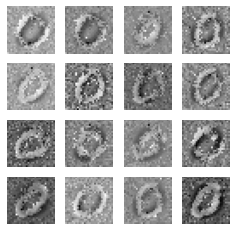

50
gen_loss: tf.Tensor(2.830252, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06940849, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08688932, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999523e-01 5.29425847e-07]
 [9.99999881e-01 8.39968735e-08]
 [9.99970555e-01 2.93979265e-05]
 [9.99996543e-01 3.41083296e-06]
 [9.99930739e-01 6.92123213e-05]
 [9.99894738e-01 1.05252169e-04]
 [9.99945521e-01 5.44681134e-05]
 [9.99977827e-01 2.21918945e-05]
 [9.99982834e-01 1.72218479e-05]
 [9.97223139e-01 2.77683791e-03]
 [9.99998569e-01 1.37801715e-06]
 [9.99998808e-01 1.16484875e-06]
 [9.97922242e-01 2.07780325e-03]
 [9.99994993e-01 5.01884506e-06]
 [9.99980092e-01 1.99413207e-05]
 [9.99994755e-01 5.23007657e-06]
 [9.99963522e-01 3.64406405e-05]
 [9.99987721e-01 1.23167902e-05]
 [9.99997258e-01 2.73438877e-06]
 [9.99997020e-01 2.93260541e-06]
 [9.99978065e-01 2.19591002e-05]
 [9.99999881e-01 8.65182130e-08]
 [9.99984503e-01 1.54952031e-05]
 [9.99998212e-01 1.

gen_loss: tf.Tensor(2.8339064, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06520921, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.081728645, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999404e-01 5.55503163e-07]
 [9.99999881e-01 1.09284393e-07]
 [9.99976397e-01 2.35659172e-05]
 [9.99998093e-01 1.95911321e-06]
 [9.99943376e-01 5.65695227e-05]
 [9.99912500e-01 8.74449324e-05]
 [9.99956846e-01 4.31202934e-05]
 [9.99979973e-01 1.99756178e-05]
 [9.99987841e-01 1.21263693e-05]
 [9.98184860e-01 1.81507180e-03]
 [9.99998808e-01 1.14716795e-06]
 [9.99999285e-01 6.60545084e-07]
 [9.98049021e-01 1.95098366e-03]
 [9.99993682e-01 6.34901198e-06]
 [9.99985456e-01 1.45919921e-05]
 [9.99995947e-01 4.01196758e-06]
 [9.99973416e-01 2.65924446e-05]
 [9.99990225e-01 9.80527420e-06]
 [9.99997497e-01 2.50122730e-06]
 [9.99998093e-01 1.92700054e-06]
 [9.99983072e-01 1.69558552e-05]
 [9.99999881e-01 9.81322614e-08]
 [9.99990106e-01 9.92117566e-06]
 [9.99998927e-01 1.1

test_discriminator_output: tf.Tensor(
[[9.99999404e-01 6.02005343e-07]
 [9.99999881e-01 1.04158637e-07]
 [9.99975562e-01 2.44893326e-05]
 [9.99998331e-01 1.72374041e-06]
 [9.99942780e-01 5.72181962e-05]
 [9.99919415e-01 8.06251701e-05]
 [9.99956369e-01 4.36194932e-05]
 [9.99980450e-01 1.95940065e-05]
 [9.99988317e-01 1.16508709e-05]
 [9.98461723e-01 1.53828552e-03]
 [9.99998808e-01 1.17571471e-06]
 [9.99999404e-01 5.40110307e-07]
 [9.97821569e-01 2.17840867e-03]
 [9.99993086e-01 6.86195608e-06]
 [9.99985695e-01 1.42530480e-05]
 [9.99996305e-01 3.71911983e-06]
 [9.99974966e-01 2.50640878e-05]
 [9.99990344e-01 9.63905495e-06]
 [9.99997258e-01 2.76467176e-06]
 [9.99998212e-01 1.78376058e-06]
 [9.99981642e-01 1.83420179e-05]
 [9.99999881e-01 8.59663345e-08]
 [9.99990702e-01 9.27583187e-06]
 [9.99998927e-01 1.04547314e-06]
 [9.99996662e-01 3.36855078e-06]
 [9.99958873e-01 4.11110850e-05]
 [9.99980807e-01 1.91853160e-05]
 [9.99987245e-01 1.27031326e-05]
 [9.84013498e-01 1.59864537e-02]
 [9.9

gen_loss: tf.Tensor(2.7877817, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13354084, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09089037, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999523e-01 4.22692466e-07]
 [1.00000000e+00 5.09839140e-08]
 [9.99983311e-01 1.66523259e-05]
 [9.99998808e-01 1.16207821e-06]
 [9.99965310e-01 3.46989509e-05]
 [9.99931216e-01 6.87435968e-05]
 [9.99968767e-01 3.12067605e-05]
 [9.99988794e-01 1.11681602e-05]
 [9.99991298e-01 8.75587648e-06]
 [9.98439252e-01 1.56073610e-03]
 [9.99999285e-01 7.44266799e-07]
 [9.99999404e-01 6.07346919e-07]
 [9.98670936e-01 1.32907380e-03]
 [9.99996066e-01 3.89494244e-06]
 [9.99989510e-01 1.05315312e-05]
 [9.99997258e-01 2.70102987e-06]
 [9.99980569e-01 1.94378572e-05]
 [9.99991775e-01 8.17961154e-06]
 [9.99998689e-01 1.33095250e-06]
 [9.99998689e-01 1.30128819e-06]
 [9.99982834e-01 1.71142783e-05]
 [1.00000000e+00 4.88046794e-08]
 [9.99993443e-01 6.53183542e-06]
 [9.99999285e-01 7.58

gen_loss: tf.Tensor(2.9864833, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06968162, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08206062, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999404e-01 6.11375299e-07]
 [9.99999881e-01 6.49886402e-08]
 [9.99989152e-01 1.08089689e-05]
 [9.99999523e-01 4.97387987e-07]
 [9.99979258e-01 2.07747071e-05]
 [9.99959826e-01 4.01550315e-05]
 [9.99982834e-01 1.71418524e-05]
 [9.99981880e-01 1.81075120e-05]
 [9.99995470e-01 4.53234770e-06]
 [9.99117076e-01 8.82887631e-04]
 [9.99999285e-01 7.38781296e-07]
 [9.99999762e-01 2.21515933e-07]
 [9.98824656e-01 1.17537018e-03]
 [9.99998212e-01 1.77825234e-06]
 [9.99994397e-01 5.59285991e-06]
 [9.99998450e-01 1.56058377e-06]
 [9.99988317e-01 1.17194950e-05]
 [9.99994159e-01 5.89674437e-06]
 [9.99999046e-01 9.24097435e-07]
 [9.99999166e-01 8.31234672e-07]
 [9.99990702e-01 9.30869101e-06]
 [9.99999881e-01 6.32652402e-08]
 [9.99996185e-01 3.86123202e-06]
 [9.99999642e-01 3.33

gen_loss: tf.Tensor(2.9564252, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05832994, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.082681686, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999404e-01 5.58211070e-07]
 [1.00000000e+00 5.61493074e-08]
 [9.99981403e-01 1.86446869e-05]
 [9.99999404e-01 5.84022985e-07]
 [9.99973893e-01 2.60859997e-05]
 [9.99954343e-01 4.57111310e-05]
 [9.99983072e-01 1.69274990e-05]
 [9.99973178e-01 2.68171661e-05]
 [9.99995708e-01 4.27751957e-06]
 [9.98912096e-01 1.08788267e-03]
 [9.99999285e-01 7.04073898e-07]
 [9.99999762e-01 2.50821870e-07]
 [9.97540832e-01 2.45914143e-03]
 [9.99997020e-01 2.94265715e-06]
 [9.99994040e-01 5.95125584e-06]
 [9.99998450e-01 1.56788144e-06]
 [9.99987841e-01 1.21012308e-05]
 [9.99994278e-01 5.73332545e-06]
 [9.99998569e-01 1.46037041e-06]
 [9.99999166e-01 8.29427620e-07]
 [9.99979019e-01 2.09386581e-05]
 [1.00000000e+00 4.42327774e-08]
 [9.99995828e-01 4.22971743e-06]
 [9.99999523e-01 4.1

 [9.99968648e-01 3.13683013e-05]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.0188155, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08552735, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07358572, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.9999976e-01 2.2018273e-07]
 [1.0000000e+00 2.9169575e-08]
 [9.9998534e-01 1.4637762e-05]
 [9.9999964e-01 4.1569859e-07]
 [9.9998498e-01 1.5044306e-05]
 [9.9996769e-01 3.2333435e-05]
 [9.9998927e-01 1.0761492e-05]
 [9.9999106e-01 8.9694831e-06]
 [9.9999678e-01 3.1804325e-06]
 [9.9924785e-01 7.5211650e-04]
 [9.9999976e-01 2.4243926e-07]
 [9.9999964e-01 3.4658171e-07]
 [9.9903202e-01 9.6797314e-04]
 [9.9999857e-01 1.4547629e-06]
 [9.9999559e-01 4.3774794e-06]
 [9.9999893e-01 1.0393583e-06]
 [9.9999237e-01 7.6674150e-06]
 [9.9999726e-01 2.7635383e-06]
 [9.9999928e-01 6.7395740e-07]
 [9.9999952e-01 4.7271820e-07]
 [9.9998403e-01 1.5981854e-05]
 [1.0000000e+00 3.0531112e-08]
 [9.9999774e-01 2.2850934e-06]
 

gen_loss: tf.Tensor(3.0313234, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07605624, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07305933, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999881e-01 1.49246759e-07]
 [1.00000000e+00 2.69271698e-08]
 [9.99988914e-01 1.10342489e-05]
 [9.99999762e-01 2.41037810e-07]
 [9.99991179e-01 8.87998067e-06]
 [9.99981165e-01 1.88132926e-05]
 [9.99992967e-01 6.99253224e-06]
 [9.99995470e-01 4.51715414e-06]
 [9.99997735e-01 2.29478974e-06]
 [9.99639153e-01 3.60878767e-04]
 [9.99999881e-01 1.29935216e-07]
 [9.99999762e-01 2.45192041e-07]
 [9.99499679e-01 5.00336348e-04]
 [9.99999285e-01 7.56116265e-07]
 [9.99996901e-01 3.05487265e-06]
 [9.99999404e-01 6.14082580e-07]
 [9.99995470e-01 4.54180645e-06]
 [9.99998569e-01 1.47527555e-06]
 [9.99999642e-01 4.07374159e-07]
 [9.99999762e-01 2.80160748e-07]
 [9.99990344e-01 9.63970797e-06]
 [1.00000000e+00 3.20273479e-08]
 [9.99998689e-01 1.27560668e-06]
 [9.99999881e-01 1.66

gen_loss: tf.Tensor(2.8454392, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07056842, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09185987, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999762e-01 2.50573464e-07]
 [1.00000000e+00 2.54623025e-08]
 [9.99980211e-01 1.97470417e-05]
 [9.99999642e-01 3.92109911e-07]
 [9.99981165e-01 1.88385002e-05]
 [9.99977708e-01 2.22487270e-05]
 [9.99989033e-01 1.09114708e-05]
 [9.99993205e-01 6.84044790e-06]
 [9.99996424e-01 3.52695270e-06]
 [9.99511242e-01 4.88813967e-04]
 [9.99999642e-01 3.22265947e-07]
 [9.99999762e-01 2.19005358e-07]
 [9.99150515e-01 8.49486794e-04]
 [9.99998212e-01 1.73552587e-06]
 [9.99995232e-01 4.76664400e-06]
 [9.99999166e-01 8.65939626e-07]
 [9.99992847e-01 7.10863105e-06]
 [9.99997377e-01 2.61907712e-06]
 [9.99999046e-01 9.11448467e-07]
 [9.99999523e-01 5.34468938e-07]
 [9.99979377e-01 2.06103869e-05]
 [1.00000000e+00 2.01924593e-08]
 [9.99996781e-01 3.20911158e-06]
 [9.99999762e-01 2.69

gen_loss: tf.Tensor(3.0524635, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.070669375, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0703691, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999881e-01 1.71551619e-07]
 [1.00000000e+00 1.83297022e-08]
 [9.99981999e-01 1.79602775e-05]
 [9.99999762e-01 2.31010645e-07]
 [9.99985218e-01 1.48246345e-05]
 [9.99985218e-01 1.48047702e-05]
 [9.99992371e-01 7.57139742e-06]
 [9.99994516e-01 5.52670008e-06]
 [9.99997854e-01 2.14165334e-06]
 [9.99751627e-01 2.48415949e-04]
 [9.99999762e-01 2.86082297e-07]
 [9.99999881e-01 9.07580215e-08]
 [9.98930991e-01 1.06895878e-03]
 [9.99998331e-01 1.71042893e-06]
 [9.99997258e-01 2.73618616e-06]
 [9.99999404e-01 5.91359424e-07]
 [9.99995470e-01 4.55085092e-06]
 [9.99998093e-01 1.92308653e-06]
 [9.99999285e-01 7.35076185e-07]
 [9.99999642e-01 3.59284655e-07]
 [9.99971747e-01 2.81922094e-05]
 [1.00000000e+00 1.17862031e-08]
 [9.99997497e-01 2.48776746e-06]
 [9.99999881e-01 1.61

gen_loss: tf.Tensor(3.0203, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.100544766, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.072975084, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 3.0189863e-08]
 [1.0000000e+00 6.0014376e-09]
 [9.9999082e-01 9.2300261e-06]
 [9.9999988e-01 1.3627772e-07]
 [9.9999428e-01 5.7560455e-06]
 [9.9998462e-01 1.5327538e-05]
 [9.9999642e-01 3.5975170e-06]
 [9.9999869e-01 1.2957886e-06]
 [9.9999893e-01 1.0157105e-06]
 [9.9971646e-01 2.8346389e-04]
 [9.9999988e-01 6.4888688e-08]
 [9.9999988e-01 1.3153858e-07]
 [9.9962425e-01 3.7573272e-04]
 [9.9999893e-01 1.1212331e-06]
 [9.9999881e-01 1.2015878e-06]
 [9.9999964e-01 3.8792663e-07]
 [9.9999774e-01 2.2284987e-06]
 [9.9999881e-01 1.2199527e-06]
 [9.9999988e-01 1.5398054e-07]
 [9.9999988e-01 1.6309873e-07]
 [9.9997377e-01 2.6170792e-05]
 [1.0000000e+00 5.8116694e-09]
 [9.9999893e-01 1.0459279e-06]
 [9.9999988e-01 9.8590590e-08]
 [9.9999940e-01 5.7987114e-07]
 [9.99

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.85249078e-08]
 [1.00000000e+00 5.43184608e-09]
 [9.99994874e-01 5.10862992e-06]
 [9.99999881e-01 6.80073029e-08]
 [9.99997139e-01 2.87579337e-06]
 [9.99988794e-01 1.12252565e-05]
 [9.99998093e-01 1.96409860e-06]
 [9.99999166e-01 8.68138329e-07]
 [9.99999523e-01 5.30632406e-07]
 [9.99844909e-01 1.55096801e-04]
 [1.00000000e+00 3.29202017e-08]
 [9.99999881e-01 7.27036351e-08]
 [9.99800861e-01 1.99134694e-04]
 [9.99999404e-01 6.27007523e-07]
 [9.99999404e-01 6.03065473e-07]
 [9.99999762e-01 2.32412972e-07]
 [9.99998808e-01 1.17821560e-06]
 [9.99999285e-01 7.55807719e-07]
 [9.99999881e-01 7.26296179e-08]
 [9.99999881e-01 8.31534592e-08]
 [9.99985814e-01 1.42096733e-05]
 [1.00000000e+00 6.47513065e-09]
 [9.99999523e-01 4.93660821e-07]
 [1.00000000e+00 4.84504667e-08]
 [9.99999642e-01 3.80713061e-07]
 [9.99997497e-01 2.44606804e-06]
 [9.99999523e-01 5.20246488e-07]
 [9.99999285e-01 6.63161359e-07]
 [9.76585746e-01 2.34142859e-02]
 [9.9

gen_loss: tf.Tensor(2.911953, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.100515775, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08593617, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.84393504e-08]
 [1.00000000e+00 4.15070422e-09]
 [9.99991536e-01 8.40751181e-06]
 [9.99999881e-01 8.35148981e-08]
 [9.99996305e-01 3.74667366e-06]
 [9.99988317e-01 1.17211603e-05]
 [9.99997497e-01 2.55417945e-06]
 [9.99998569e-01 1.46625109e-06]
 [9.99999285e-01 6.79963307e-07]
 [9.99881387e-01 1.18639007e-04]
 [1.00000000e+00 4.72500936e-08]
 [1.00000000e+00 4.69434163e-08]
 [9.99579370e-01 4.20648401e-04]
 [9.99999285e-01 7.58747092e-07]
 [9.99999166e-01 8.19158060e-07]
 [9.99999762e-01 2.56236689e-07]
 [9.99998689e-01 1.32756520e-06]
 [9.99999046e-01 9.83820541e-07]
 [9.99999881e-01 1.59577226e-07]
 [9.99999881e-01 1.02381399e-07]
 [9.99976277e-01 2.36798423e-05]
 [1.00000000e+00 4.16723589e-09]
 [9.99999285e-01 6.80059316e-07]
 [9.99999881e-01 5.97

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.81252584e-08]
 [1.00000000e+00 4.01829947e-09]
 [9.99986529e-01 1.34705970e-05]
 [9.99999881e-01 1.41210222e-07]
 [9.99993920e-01 6.02781847e-06]
 [9.99983191e-01 1.68417064e-05]
 [9.99995828e-01 4.20596098e-06]
 [9.99997854e-01 2.09605992e-06]
 [9.99998808e-01 1.16774845e-06]
 [9.99821246e-01 1.78778399e-04]
 [9.99999881e-01 7.63666179e-08]
 [9.99999881e-01 6.52462404e-08]
 [9.99469817e-01 5.30167774e-04]
 [9.99998808e-01 1.13684871e-06]
 [9.99998569e-01 1.48511026e-06]
 [9.99999642e-01 3.81007254e-07]
 [9.99997854e-01 2.11534621e-06]
 [9.99998331e-01 1.62275012e-06]
 [9.99999762e-01 2.89542896e-07]
 [9.99999762e-01 1.81505911e-07]
 [9.99966025e-01 3.40199185e-05]
 [1.00000000e+00 3.75410680e-09]
 [9.99998689e-01 1.26166913e-06]
 [9.99999881e-01 1.01950945e-07]
 [9.99999285e-01 7.33525724e-07]
 [9.99991298e-01 8.69758696e-06]
 [9.99998569e-01 1.39818610e-06]
 [9.99998808e-01 1.23877896e-06]
 [9.91335630e-01 8.66437051e-03]
 [9.9

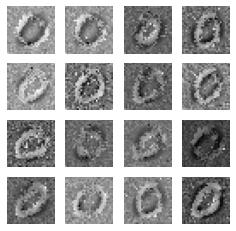

51
gen_loss: tf.Tensor(2.923182, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06989931, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0793148, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999881e-01 7.09719217e-08]
 [1.00000000e+00 4.39168346e-09]
 [9.99983668e-01 1.62868691e-05]
 [9.99999881e-01 1.77040306e-07]
 [9.99992609e-01 7.38930294e-06]
 [9.99980688e-01 1.92758907e-05]
 [9.99994636e-01 5.32066633e-06]
 [9.99997497e-01 2.51055008e-06]
 [9.99998450e-01 1.50804829e-06]
 [9.99790609e-01 2.09424528e-04]
 [9.99999881e-01 9.86615092e-08]
 [9.99999881e-01 7.29394785e-08]
 [9.99519825e-01 4.80240036e-04]
 [9.99998689e-01 1.35236837e-06]
 [9.99998093e-01 1.96324663e-06]
 [9.99999523e-01 4.58431174e-07]
 [9.99997258e-01 2.73558339e-06]
 [9.99997973e-01 2.01848547e-06]
 [9.99999642e-01 3.81553406e-07]
 [9.99999762e-01 2.37159242e-07]
 [9.99964833e-01 3.51988419e-05]
 [1.00000000e+00 4.04666523e-09]
 [9.99998331e-01 1.68226109e-06]
 [9.99999881e-01 1.2

test_discriminator_output: tf.Tensor(
[[9.9999988e-01 7.2051492e-08]
 [1.0000000e+00 5.0801687e-09]
 [9.9998784e-01 1.2176257e-05]
 [9.9999988e-01 1.2748598e-07]
 [9.9999452e-01 5.4380234e-06]
 [9.9998474e-01 1.5311471e-05]
 [9.9999583e-01 4.1516514e-06]
 [9.9999785e-01 2.1084038e-06]
 [9.9999881e-01 1.1838133e-06]
 [9.9983728e-01 1.6267668e-04]
 [9.9999988e-01 7.9067604e-08]
 [1.0000000e+00 5.6573288e-08]
 [9.9971992e-01 2.8001572e-04]
 [9.9999893e-01 1.0360440e-06]
 [9.9999845e-01 1.5331076e-06]
 [9.9999964e-01 3.6614668e-07]
 [9.9999762e-01 2.3434557e-06]
 [9.9999845e-01 1.5234561e-06]
 [9.9999976e-01 2.6793464e-07]
 [9.9999988e-01 1.7852962e-07]
 [9.9997723e-01 2.2799975e-05]
 [1.0000000e+00 4.9644839e-09]
 [9.9999881e-01 1.2068925e-06]
 [9.9999988e-01 8.9275666e-08]
 [9.9999917e-01 8.5918776e-07]
 [9.9999404e-01 6.0058996e-06]
 [9.9999869e-01 1.3588804e-06]
 [9.9999893e-01 1.0621212e-06]
 [9.9707484e-01 2.9252032e-03]
 [9.9999905e-01 9.4470812e-07]
 [9.9999058e-01 9.4590687e-06]
 

gen_loss: tf.Tensor(2.9384272, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.062746525, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07499412, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.90122360e-08]
 [1.00000000e+00 6.70129641e-09]
 [9.99995112e-01 4.84706152e-06]
 [1.00000000e+00 4.89481486e-08]
 [9.99997616e-01 2.32521006e-06]
 [9.99992847e-01 7.12040310e-06]
 [9.99998212e-01 1.75610421e-06]
 [9.99998689e-01 1.36933431e-06]
 [9.99999523e-01 4.63565272e-07]
 [9.99931931e-01 6.81057209e-05]
 [1.00000000e+00 3.97529902e-08]
 [1.00000000e+00 2.42695748e-08]
 [9.99888539e-01 1.11443114e-04]
 [9.99999404e-01 5.59427747e-07]
 [9.99999404e-01 5.93244920e-07]
 [9.99999881e-01 1.71785899e-07]
 [9.99998808e-01 1.21549544e-06]
 [9.99999404e-01 5.63066351e-07]
 [9.99999881e-01 1.01879408e-07]
 [9.99999881e-01 6.30047765e-08]
 [9.99991655e-01 8.33761533e-06]
 [1.00000000e+00 7.29742355e-09]
 [9.99999642e-01 3.92731152e-07]
 [1.00000000e+00 3.2

gen_loss: tf.Tensor(2.8995836, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.087892726, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08197895, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.77354413e-08]
 [1.00000000e+00 6.75899736e-09]
 [9.99996185e-01 3.80559118e-06]
 [1.00000000e+00 4.51933744e-08]
 [9.99997377e-01 2.58150340e-06]
 [9.99992728e-01 7.31855471e-06]
 [9.99998569e-01 1.42206386e-06]
 [9.99997616e-01 2.37424524e-06]
 [9.99999642e-01 3.08867641e-07]
 [9.99943137e-01 5.68929390e-05]
 [9.99999881e-01 6.35072865e-08]
 [1.00000000e+00 1.55805360e-08]
 [9.99827862e-01 1.72098298e-04]
 [9.99999046e-01 9.63357365e-07]
 [9.99999642e-01 4.16238521e-07]
 [9.99999881e-01 1.70038447e-07]
 [9.99998689e-01 1.28027330e-06]
 [9.99999404e-01 5.54994813e-07]
 [9.99999881e-01 1.05148295e-07]
 [1.00000000e+00 5.72886520e-08]
 [9.99988914e-01 1.10486753e-05]
 [1.00000000e+00 5.56116753e-09]
 [9.99999642e-01 3.89511030e-07]
 [1.00000000e+00 2.9

gen_loss: tf.Tensor(3.0011852, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.071526214, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07625217, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[9.99999881e-01 6.98829368e-08]
 [1.00000000e+00 4.61637972e-09]
 [9.99994397e-01 5.63322692e-06]
 [9.99999881e-01 1.53098753e-07]
 [9.99992847e-01 7.21046081e-06]
 [9.99980092e-01 1.99565402e-05]
 [9.99997020e-01 3.03612501e-06]
 [9.99995589e-01 4.35780657e-06]
 [9.99999404e-01 6.39521147e-07]
 [9.99784887e-01 2.15102773e-04]
 [9.99999881e-01 1.37250709e-07]
 [1.00000000e+00 5.52747892e-08]
 [9.99759018e-01 2.40968904e-04]
 [9.99997735e-01 2.30811452e-06]
 [9.99999166e-01 8.54560881e-07]
 [9.99999523e-01 4.52148413e-07]
 [9.99997020e-01 3.02333092e-06]
 [9.99998450e-01 1.60466175e-06]
 [9.99999881e-01 1.75361620e-07]
 [9.99999881e-01 1.71027096e-07]
 [9.99975085e-01 2.49052118e-05]
 [1.00000000e+00 3.81912857e-09]
 [9.99998569e-01 1.42946340e-06]
 [9.99999881e-01 1.0

gen_loss: tf.Tensor(3.0099525, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21921593, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07136307, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.46388847e-08]
 [1.00000000e+00 1.78281379e-09]
 [9.99997973e-01 2.01210082e-06]
 [1.00000000e+00 5.59377646e-08]
 [9.99996781e-01 3.17716126e-06]
 [9.99990821e-01 9.17159559e-06]
 [9.99998689e-01 1.26039083e-06]
 [9.99998331e-01 1.67451083e-06]
 [9.99999762e-01 2.50736747e-07]
 [9.99953151e-01 4.68785656e-05]
 [1.00000000e+00 4.60185028e-08]
 [1.00000000e+00 1.90742764e-08]
 [9.99876022e-01 1.23908641e-04]
 [9.99999523e-01 4.67206405e-07]
 [9.99999642e-01 3.02066837e-07]
 [9.99999762e-01 2.10789011e-07]
 [9.99999046e-01 9.42046029e-07]
 [9.99999404e-01 5.97733049e-07]
 [1.00000000e+00 5.19494350e-08]
 [9.99999881e-01 6.76255922e-08]
 [9.99987006e-01 1.30141761e-05]
 [1.00000000e+00 2.17634355e-09]
 [9.99999523e-01 4.94343965e-07]
 [1.00000000e+00 3.64

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.70911968e-08]
 [1.00000000e+00 1.41588485e-09]
 [9.99998331e-01 1.61602588e-06]
 [1.00000000e+00 5.22307033e-08]
 [9.99996662e-01 3.31492856e-06]
 [9.99989748e-01 1.02528593e-05]
 [9.99998808e-01 1.14306181e-06]
 [9.99997735e-01 2.23676011e-06]
 [9.99999762e-01 2.09755470e-07]
 [9.99955297e-01 4.46917693e-05]
 [1.00000000e+00 5.72480197e-08]
 [1.00000000e+00 1.17986634e-08]
 [9.99837637e-01 1.62336393e-04]
 [9.99999642e-01 3.57246307e-07]
 [9.99999762e-01 2.39974952e-07]
 [9.99999762e-01 2.17252975e-07]
 [9.99999166e-01 8.66559219e-07]
 [9.99999285e-01 7.32365436e-07]
 [1.00000000e+00 4.32727845e-08]
 [9.99999881e-01 7.56696394e-08]
 [9.99986529e-01 1.34250558e-05]
 [1.00000000e+00 1.87416194e-09]
 [9.99999523e-01 5.32695026e-07]
 [1.00000000e+00 3.36975390e-08]
 [9.99999523e-01 4.41292144e-07]
 [9.99995232e-01 4.79894197e-06]
 [9.99998927e-01 1.02367301e-06]
 [9.99999046e-01 9.28344434e-07]
 [9.96388078e-01 3.61188361e-03]
 [9.9

gen_loss: tf.Tensor(2.9021745, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08495368, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.083726905, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.92934486e-08]
 [1.00000000e+00 1.03254583e-09]
 [9.99997735e-01 2.20964694e-06]
 [1.00000000e+00 5.92937255e-08]
 [9.99997497e-01 2.46651803e-06]
 [9.99987960e-01 1.19954993e-05]
 [9.99998927e-01 1.05064055e-06]
 [9.99998093e-01 1.90277115e-06]
 [9.99999762e-01 2.28440399e-07]
 [9.99942780e-01 5.72233257e-05]
 [1.00000000e+00 4.02959159e-08]
 [1.00000000e+00 1.34920359e-08]
 [9.99799669e-01 2.00406736e-04]
 [9.99999762e-01 2.75045522e-07]
 [9.99999762e-01 2.28418600e-07]
 [9.99999762e-01 2.14606843e-07]
 [9.99999285e-01 7.31846001e-07]
 [9.99999285e-01 6.84210363e-07]
 [1.00000000e+00 3.00106819e-08]
 [9.99999881e-01 7.88717927e-08]
 [9.99981403e-01 1.85854988e-05]
 [1.00000000e+00 1.52261959e-09]
 [9.99999523e-01 5.05872549e-07]
 [1.00000000e+00 3.7

 [9.99998212e-01 1.73921080e-06]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(2.7980843, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0955891, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09058474, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.37922207e-08]
 [1.00000000e+00 9.72695702e-10]
 [9.99995828e-01 4.15767408e-06]
 [1.00000000e+00 4.65768544e-08]
 [9.99998808e-01 1.18885134e-06]
 [9.99992847e-01 7.11329676e-06]
 [9.99999166e-01 8.38475898e-07]
 [9.99998808e-01 1.23817654e-06]
 [9.99999762e-01 2.27327675e-07]
 [9.99961615e-01 3.83301594e-05]
 [1.00000000e+00 2.06624815e-08]
 [1.00000000e+00 1.27000526e-08]
 [9.99815643e-01 1.84429009e-04]
 [9.99999762e-01 1.79092325e-07]
 [9.99999762e-01 2.10215859e-07]
 [9.99999881e-01 1.31639723e-07]
 [9.99999523e-01 4.90593322e-07]
 [9.99999642e-01 2.98527738e-07]
 [1.00000000e+00 2.70826206e-08]
 [1.00000000e+00 5.30784234e-08]
 [9.99982119e-01 1.78878709e-05]
 [1.00000000e+00 1.528

gen_loss: tf.Tensor(2.8744993, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08356196, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08784824, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.51767097e-08]
 [1.00000000e+00 7.79237008e-10]
 [9.99995589e-01 4.41200973e-06]
 [1.00000000e+00 3.78003975e-08]
 [9.99999046e-01 9.06735579e-07]
 [9.99994874e-01 5.09604706e-06]
 [9.99999285e-01 7.06202911e-07]
 [9.99998569e-01 1.45993033e-06]
 [9.99999881e-01 1.73837549e-07]
 [9.99973059e-01 2.69800275e-05]
 [1.00000000e+00 2.38470061e-08]
 [1.00000000e+00 8.26438118e-09]
 [9.99799192e-01 2.00844399e-04]
 [9.99999881e-01 1.54317476e-07]
 [9.99999881e-01 1.65423714e-07]
 [9.99999881e-01 1.06350420e-07]
 [9.99999523e-01 4.49307151e-07]
 [9.99999762e-01 2.16211035e-07]
 [1.00000000e+00 2.65113211e-08]
 [1.00000000e+00 4.31661178e-08]
 [9.99981284e-01 1.86701654e-05]
 [1.00000000e+00 1.25688560e-09]
 [9.99999762e-01 2.50294761e-07]
 [1.00000000e+00 2.36

gen_loss: tf.Tensor(2.9314008, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07133883, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.077503875, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 2.6830993e-08]
 [1.0000000e+00 1.0070794e-09]
 [9.9999738e-01 2.5770880e-06]
 [1.0000000e+00 1.2950785e-08]
 [9.9999952e-01 4.3737927e-07]
 [9.9999678e-01 3.2488692e-06]
 [9.9999964e-01 3.1517345e-07]
 [9.9999666e-01 3.3433503e-06]
 [1.0000000e+00 5.8454461e-08]
 [9.9998403e-01 1.5977130e-05]
 [1.0000000e+00 4.3270973e-08]
 [1.0000000e+00 1.9094868e-09]
 [9.9978572e-01 2.1432339e-04]
 [9.9999988e-01 1.6514676e-07]
 [1.0000000e+00 5.4634778e-08]
 [9.9999988e-01 6.0358332e-08]
 [9.9999976e-01 2.8500557e-07]
 [9.9999988e-01 1.2879318e-07]
 [1.0000000e+00 1.7244206e-08]
 [1.0000000e+00 2.2218572e-08]
 [9.9998677e-01 1.3221285e-05]
 [1.0000000e+00 1.3953327e-09]
 [9.9999988e-01 1.2734817e-07]
 [1.0000000e+00 7.9224876e-09]
 [9.9999988e-01 1.5727726e-07]
 [9.

gen_loss: tf.Tensor(2.92411, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05933184, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08021795, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 3.4820701e-08]
 [1.0000000e+00 7.4619005e-10]
 [9.9999535e-01 4.6487753e-06]
 [1.0000000e+00 3.6229906e-08]
 [9.9999893e-01 1.0731133e-06]
 [9.9999213e-01 7.9089396e-06]
 [9.9999928e-01 7.0615107e-07]
 [9.9999499e-01 5.0544704e-06]
 [9.9999988e-01 1.5402885e-07]
 [9.9994159e-01 5.8371086e-05]
 [9.9999988e-01 9.9633709e-08]
 [1.0000000e+00 9.7323802e-09]
 [9.9967766e-01 3.2232123e-04]
 [9.9999952e-01 4.7452943e-07]
 [9.9999988e-01 1.4532124e-07]
 [9.9999988e-01 1.3628370e-07]
 [9.9999940e-01 6.5060084e-07]
 [9.9999976e-01 2.4804208e-07]
 [1.0000000e+00 4.9861328e-08]
 [1.0000000e+00 5.7679635e-08]
 [9.9998128e-01 1.8685394e-05]
 [1.0000000e+00 1.0137534e-09]
 [9.9999952e-01 4.1793132e-07]
 [1.0000000e+00 2.3602515e-08]
 [9.9999964e-01 4.1446273e-07]
 [9.999

gen_loss: tf.Tensor(2.8160908, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09021229, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.086849764, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.10560644e-08]
 [1.00000000e+00 1.46648027e-09]
 [9.99994397e-01 5.54646840e-06]
 [1.00000000e+00 3.65811914e-08]
 [9.99998808e-01 1.16951276e-06]
 [9.99992728e-01 7.29756266e-06]
 [9.99999166e-01 8.32704927e-07]
 [9.99996066e-01 3.95437019e-06]
 [9.99999762e-01 2.62088122e-07]
 [9.99946117e-01 5.39179382e-05]
 [9.99999881e-01 7.77310944e-08]
 [1.00000000e+00 2.16484359e-08]
 [9.99667287e-01 3.32670548e-04]
 [9.99999523e-01 5.17889703e-07]
 [9.99999762e-01 2.38318719e-07]
 [9.99999881e-01 1.26386070e-07]
 [9.99999523e-01 5.30616205e-07]
 [9.99999762e-01 2.03831974e-07]
 [9.99999881e-01 9.69362759e-08]
 [9.99999881e-01 6.68390072e-08]
 [9.99990344e-01 9.63717048e-06]
 [1.00000000e+00 1.89991045e-09]
 [9.99999523e-01 5.05962248e-07]
 [1.00000000e+00 2.4

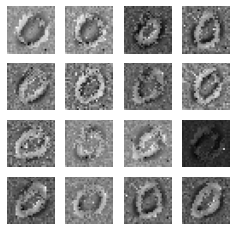

52
gen_loss: tf.Tensor(2.791325, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08312459, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.090854675, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.36322926e-08]
 [1.00000000e+00 3.31590200e-09]
 [9.99995947e-01 4.06051004e-06]
 [1.00000000e+00 1.91570777e-08]
 [9.99999404e-01 6.26889175e-07]
 [9.99991775e-01 8.18596436e-06]
 [9.99999404e-01 5.57034753e-07]
 [9.99997616e-01 2.33900141e-06]
 [9.99999762e-01 2.10065551e-07]
 [9.99953270e-01 4.67446444e-05]
 [1.00000000e+00 3.54824294e-08]
 [1.00000000e+00 2.61749324e-08]
 [9.99848723e-01 1.51196393e-04]
 [9.99999404e-01 5.70754253e-07]
 [9.99999762e-01 1.85291540e-07]
 [9.99999881e-01 9.51752952e-08]
 [9.99999642e-01 3.54977345e-07]
 [9.99999881e-01 1.76157116e-07]
 [9.99999881e-01 6.58336461e-08]
 [1.00000000e+00 5.35269749e-08]
 [9.99994636e-01 5.34508354e-06]
 [1.00000000e+00 3.77417386e-09]
 [9.99999642e-01 3.13314217e-07]
 [1.00000000e+00 1

gen_loss: tf.Tensor(2.8276868, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07615095, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09305598, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.01112051e-08]
 [1.00000000e+00 2.14033569e-09]
 [9.99995351e-01 4.67927066e-06]
 [1.00000000e+00 2.12568239e-08]
 [9.99999285e-01 6.73841100e-07]
 [9.99990582e-01 9.47602530e-06]
 [9.99999285e-01 6.84775671e-07]
 [9.99998093e-01 1.88615320e-06]
 [9.99999762e-01 2.62182112e-07]
 [9.99960423e-01 3.96199212e-05]
 [1.00000000e+00 3.75446696e-08]
 [1.00000000e+00 3.11246140e-08]
 [9.99813378e-01 1.86664343e-04]
 [9.99999404e-01 6.49024287e-07]
 [9.99999762e-01 2.49586833e-07]
 [9.99999881e-01 1.04324457e-07]
 [9.99999642e-01 4.03336031e-07]
 [9.99999762e-01 2.07259362e-07]
 [9.99999881e-01 8.72704859e-08]
 [9.99999881e-01 7.54746168e-08]
 [9.99992371e-01 7.63118078e-06]
 [1.00000000e+00 1.86067695e-09]
 [9.99999642e-01 4.11058977e-07]
 [1.00000000e+00 1.59

gen_loss: tf.Tensor(3.0302467, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08124089, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07334082, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.27782913e-08]
 [1.00000000e+00 2.47690135e-09]
 [9.99997616e-01 2.44290231e-06]
 [1.00000000e+00 1.02047402e-08]
 [9.99999523e-01 4.80777373e-07]
 [9.99993801e-01 6.16932221e-06]
 [9.99999523e-01 4.32700233e-07]
 [9.99997020e-01 2.94810638e-06]
 [9.99999881e-01 1.29645073e-07]
 [9.99984622e-01 1.53310466e-05]
 [1.00000000e+00 4.91509766e-08]
 [1.00000000e+00 8.66071659e-09]
 [9.99772727e-01 2.27283555e-04]
 [9.99999523e-01 4.57453780e-07]
 [9.99999881e-01 1.36220024e-07]
 [9.99999881e-01 7.43383666e-08]
 [9.99999762e-01 2.91574565e-07]
 [9.99999881e-01 1.46611526e-07]
 [9.99999881e-01 7.25781035e-08]
 [1.00000000e+00 5.04536004e-08]
 [9.99995708e-01 4.35085121e-06]
 [1.00000000e+00 1.97673633e-09]
 [9.99999762e-01 2.63673030e-07]
 [1.00000000e+00 7.71

gen_loss: tf.Tensor(3.004376, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06705016, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07548848, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.66427814e-08]
 [1.00000000e+00 3.22546434e-09]
 [9.99998450e-01 1.52922337e-06]
 [1.00000000e+00 6.99842806e-09]
 [9.99999642e-01 3.49040249e-07]
 [9.99992728e-01 7.28981377e-06]
 [9.99999762e-01 2.96039701e-07]
 [9.99996901e-01 3.11516624e-06]
 [9.99999881e-01 7.87632572e-08]
 [9.99983430e-01 1.65554666e-05]
 [1.00000000e+00 3.52984202e-08]
 [1.00000000e+00 7.29302663e-09]
 [9.99861240e-01 1.38769057e-04]
 [9.99999404e-01 5.54448889e-07]
 [9.99999881e-01 8.26216251e-08]
 [9.99999881e-01 7.25473797e-08]
 [9.99999762e-01 2.68192309e-07]
 [9.99999881e-01 1.07592143e-07]
 [1.00000000e+00 3.98939690e-08]
 [1.00000000e+00 3.31796635e-08]
 [9.99997020e-01 2.96798316e-06]
 [1.00000000e+00 3.16357296e-09]
 [9.99999881e-01 1.66744044e-07]
 [1.00000000e+00 5.366

gen_loss: tf.Tensor(2.9220605, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.062439904, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08145708, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.85346099e-09]
 [1.00000000e+00 1.71683867e-09]
 [9.99997497e-01 2.48363563e-06]
 [1.00000000e+00 1.41302587e-08]
 [9.99999523e-01 4.65133809e-07]
 [9.99985933e-01 1.40776237e-05]
 [9.99999523e-01 4.53488866e-07]
 [9.99997973e-01 2.02456977e-06]
 [9.99999881e-01 1.32673463e-07]
 [9.99960065e-01 3.99729433e-05]
 [1.00000000e+00 2.47364511e-08]
 [1.00000000e+00 2.69311258e-08]
 [9.99857068e-01 1.42967023e-04]
 [9.99999166e-01 8.44207193e-07]
 [9.99999881e-01 1.30797787e-07]
 [9.99999881e-01 1.38029364e-07]
 [9.99999523e-01 4.43942156e-07]
 [9.99999881e-01 1.27314408e-07]
 [1.00000000e+00 3.68361910e-08]
 [1.00000000e+00 4.59895482e-08]
 [9.99993205e-01 6.74158036e-06]
 [1.00000000e+00 1.90170879e-09]
 [9.99999762e-01 2.35736380e-07]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(2.8801546, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08667086, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0885836, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.53791535e-09]
 [1.00000000e+00 1.16483512e-09]
 [9.99998093e-01 1.94785707e-06]
 [1.00000000e+00 9.81464510e-09]
 [9.99999523e-01 4.23032020e-07]
 [9.99990463e-01 9.59044883e-06]
 [9.99999642e-01 3.92633410e-07]
 [9.99997497e-01 2.54951169e-06]
 [9.99999881e-01 9.90540769e-08]
 [9.99983430e-01 1.65840047e-05]
 [1.00000000e+00 3.59005483e-08]
 [1.00000000e+00 1.15033645e-08]
 [9.99832869e-01 1.67090984e-04]
 [9.99999523e-01 4.69075246e-07]
 [9.99999881e-01 9.52146948e-08]
 [9.99999881e-01 1.29395559e-07]
 [9.99999642e-01 3.60038911e-07]
 [9.99999881e-01 1.05150306e-07]
 [1.00000000e+00 3.09902646e-08]
 [1.00000000e+00 4.00386497e-08]
 [9.99993205e-01 6.84719635e-06]
 [1.00000000e+00 1.20252164e-09]
 [9.99999762e-01 1.99780871e-07]
 [1.00000000e+00 8.009

gen_loss: tf.Tensor(3.0215943, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07606843, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07438423, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.96926742e-08]
 [1.00000000e+00 3.26699778e-09]
 [9.99998450e-01 1.57017689e-06]
 [1.00000000e+00 8.67129479e-09]
 [9.99999523e-01 4.50380497e-07]
 [9.99990344e-01 9.63230104e-06]
 [9.99999642e-01 4.13509696e-07]
 [9.99995589e-01 4.36252185e-06]
 [9.99999881e-01 1.02073912e-07]
 [9.99984145e-01 1.58966086e-05]
 [1.00000000e+00 5.17494705e-08]
 [1.00000000e+00 8.78047413e-09]
 [9.99899268e-01 1.00771744e-04]
 [9.99999523e-01 4.95176778e-07]
 [9.99999881e-01 9.20394996e-08]
 [9.99999881e-01 1.42217630e-07]
 [9.99999642e-01 3.06308579e-07]
 [9.99999881e-01 1.44812546e-07]
 [1.00000000e+00 2.39424871e-08]
 [1.00000000e+00 4.83809330e-08]
 [9.99995232e-01 4.80926883e-06]
 [1.00000000e+00 3.13414406e-09]
 [9.99999762e-01 2.17049191e-07]
 [1.00000000e+00 7.00

gen_loss: tf.Tensor(2.8619318, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09307962, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08995573, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.27250273e-08]
 [1.00000000e+00 1.15960352e-09]
 [9.99996662e-01 3.34975243e-06]
 [1.00000000e+00 3.84475527e-08]
 [9.99998927e-01 1.10645021e-06]
 [9.99981284e-01 1.87194255e-05]
 [9.99998808e-01 1.15501803e-06]
 [9.99996662e-01 3.34515539e-06]
 [9.99999642e-01 3.28735553e-07]
 [9.99953151e-01 4.68525577e-05]
 [9.99999881e-01 6.48794085e-08]
 [1.00000000e+00 4.94020149e-08]
 [9.99847651e-01 1.52293607e-04]
 [9.99999166e-01 8.22152401e-07]
 [9.99999642e-01 3.18272470e-07]
 [9.99999642e-01 3.07603642e-07]
 [9.99999404e-01 5.68320900e-07]
 [9.99999642e-01 3.17293569e-07]
 [1.00000000e+00 3.78677996e-08]
 [9.99999881e-01 1.29898780e-07]
 [9.99982953e-01 1.70561289e-05]
 [1.00000000e+00 1.06268416e-09]
 [9.99999285e-01 6.67552968e-07]
 [1.00000000e+00 3.42

gen_loss: tf.Tensor(2.9901485, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12129879, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07669161, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.37204070e-08]
 [1.00000000e+00 1.81216397e-09]
 [9.99998212e-01 1.80360496e-06]
 [1.00000000e+00 2.35405171e-08]
 [9.99999046e-01 9.29157522e-07]
 [9.99984503e-01 1.55204943e-05]
 [9.99999166e-01 8.22542233e-07]
 [9.99995112e-01 4.87910438e-06]
 [9.99999881e-01 1.67082774e-07]
 [9.99970198e-01 2.98187206e-05]
 [9.99999881e-01 6.80834873e-08]
 [1.00000000e+00 1.85307041e-08]
 [9.99861836e-01 1.38120333e-04]
 [9.99998927e-01 1.03581579e-06]
 [9.99999762e-01 1.87107744e-07]
 [9.99999762e-01 2.46672471e-07]
 [9.99999642e-01 3.79755733e-07]
 [9.99999642e-01 3.23090973e-07]
 [1.00000000e+00 2.39420768e-08]
 [9.99999881e-01 8.58015383e-08]
 [9.99980211e-01 1.97484351e-05]
 [1.00000000e+00 1.47829771e-09]
 [9.99999523e-01 4.30793449e-07]
 [1.00000000e+00 2.27

gen_loss: tf.Tensor(3.0298998, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07935773, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0727067, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.12877413e-08]
 [1.00000000e+00 3.56129970e-09]
 [9.99998927e-01 1.07233780e-06]
 [1.00000000e+00 1.71386230e-08]
 [9.99999166e-01 8.69270821e-07]
 [9.99982595e-01 1.73628760e-05]
 [9.99999285e-01 6.77680021e-07]
 [9.99991298e-01 8.72355486e-06]
 [9.99999881e-01 1.11454710e-07]
 [9.99969363e-01 3.06554430e-05]
 [9.99999881e-01 8.84941116e-08]
 [1.00000000e+00 9.67426672e-09]
 [9.99907255e-01 9.27336441e-05]
 [9.99998808e-01 1.24049200e-06]
 [9.99999881e-01 1.27990802e-07]
 [9.99999762e-01 2.46003850e-07]
 [9.99999642e-01 3.47652303e-07]
 [9.99999523e-01 4.47281934e-07]
 [1.00000000e+00 1.67238614e-08]
 [9.99999881e-01 7.79109897e-08]
 [9.99984026e-01 1.59736555e-05]
 [1.00000000e+00 2.97641178e-09]
 [9.99999642e-01 3.84748461e-07]
 [1.00000000e+00 1.700

gen_loss: tf.Tensor(3.111606, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09457499, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07068767, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.53467363e-08]
 [1.00000000e+00 3.49032692e-09]
 [9.99998927e-01 1.07430515e-06]
 [1.00000000e+00 2.78541972e-08]
 [9.99998808e-01 1.20460186e-06]
 [9.99974608e-01 2.54334700e-05]
 [9.99999046e-01 1.00254556e-06]
 [9.99988675e-01 1.13309497e-05]
 [9.99999881e-01 1.58437203e-07]
 [9.99946475e-01 5.35041836e-05]
 [9.99999881e-01 1.14478389e-07]
 [1.00000000e+00 1.54638577e-08]
 [9.99926209e-01 7.38097733e-05]
 [9.99998450e-01 1.52799305e-06]
 [9.99999762e-01 1.86150913e-07]
 [9.99999642e-01 3.66765249e-07]
 [9.99999523e-01 5.21855497e-07]
 [9.99999285e-01 7.45709031e-07]
 [1.00000000e+00 1.77210833e-08]
 [9.99999881e-01 1.19455137e-07]
 [9.99982238e-01 1.78011160e-05]
 [1.00000000e+00 3.34997563e-09]
 [9.99999404e-01 6.32921569e-07]
 [1.00000000e+00 2.894

gen_loss: tf.Tensor(2.9102936, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.079150006, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08997366, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.40347742e-08]
 [1.00000000e+00 2.67720868e-09]
 [9.99998331e-01 1.70929400e-06]
 [9.99999881e-01 6.60075301e-08]
 [9.99998212e-01 1.78831010e-06]
 [9.99965906e-01 3.41046325e-05]
 [9.99998093e-01 1.85593387e-06]
 [9.99988198e-01 1.18209327e-05]
 [9.99999642e-01 3.47076536e-07]
 [9.99900103e-01 9.98872492e-05]
 [9.99999881e-01 1.30712493e-07]
 [1.00000000e+00 4.39538965e-08]
 [9.99912024e-01 8.80039152e-05]
 [9.99998212e-01 1.76711501e-06]
 [9.99999523e-01 4.27302410e-07]
 [9.99999404e-01 5.64399613e-07]
 [9.99999046e-01 9.08216350e-07]
 [9.99998927e-01 1.07750441e-06]
 [1.00000000e+00 2.98717353e-08]
 [9.99999762e-01 1.99974934e-07]
 [9.99977231e-01 2.28176159e-05]
 [1.00000000e+00 2.89873658e-09]
 [9.99998808e-01 1.22850588e-06]
 [9.99999881e-01 7.1

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.83810265e-08]
 [1.00000000e+00 2.00211780e-09]
 [9.99996781e-01 3.21036055e-06]
 [9.99999881e-01 1.49068100e-07]
 [9.99997616e-01 2.34020831e-06]
 [9.99956131e-01 4.39096366e-05]
 [9.99996781e-01 3.24154371e-06]
 [9.99989510e-01 1.04854116e-05]
 [9.99999285e-01 7.70130612e-07]
 [9.99817789e-01 1.82253789e-04]
 [9.99999881e-01 1.15845722e-07]
 [9.99999881e-01 1.39420337e-07]
 [9.99876499e-01 1.23511360e-04]
 [9.99997973e-01 2.07144490e-06]
 [9.99999046e-01 9.88396664e-07]
 [9.99999166e-01 8.10806796e-07]
 [9.99998569e-01 1.44806631e-06]
 [9.99998689e-01 1.33211438e-06]
 [1.00000000e+00 4.97725807e-08]
 [9.99999642e-01 3.03079673e-07]
 [9.99964952e-01 3.50333721e-05]
 [1.00000000e+00 2.27278507e-09]
 [9.99997973e-01 2.07156154e-06]
 [9.99999881e-01 1.65883435e-07]
 [9.99997258e-01 2.73913361e-06]
 [9.99998569e-01 1.47570051e-06]
 [9.99995708e-01 4.30944010e-06]
 [9.99999046e-01 9.10805454e-07]
 [9.99594033e-01 4.05933883e-04]
 [9.9

gen_loss: tf.Tensor(2.983438, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.088113494, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09096404, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.56700342e-08]
 [1.00000000e+00 2.77084622e-09]
 [9.99996543e-01 3.45055514e-06]
 [9.99999881e-01 9.88455326e-08]
 [9.99998450e-01 1.52292159e-06]
 [9.99974370e-01 2.56788171e-05]
 [9.99997497e-01 2.46246827e-06]
 [9.99987125e-01 1.28838219e-05]
 [9.99999404e-01 5.53814743e-07]
 [9.99845982e-01 1.54048132e-04]
 [9.99999881e-01 1.14336878e-07]
 [9.99999881e-01 7.64081420e-08]
 [9.99713838e-01 2.86189461e-04]
 [9.99997735e-01 2.29849775e-06]
 [9.99999285e-01 7.23525943e-07]
 [9.99999523e-01 5.26988288e-07]
 [9.99998689e-01 1.27079841e-06]
 [9.99999046e-01 9.19221009e-07]
 [1.00000000e+00 4.83741971e-08]
 [9.99999762e-01 2.06370629e-07]
 [9.99953270e-01 4.66995953e-05]
 [1.00000000e+00 2.31263964e-09]
 [9.99998569e-01 1.40832458e-06]
 [9.99999881e-01 1.11

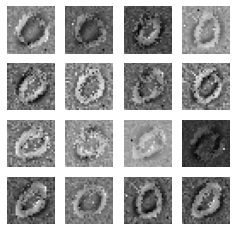

53
gen_loss: tf.Tensor(3.1036992, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04747793, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06746264, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.80095263e-08]
 [1.00000000e+00 4.29108793e-09]
 [9.99997497e-01 2.55526106e-06]
 [1.00000000e+00 5.55430120e-08]
 [9.99998927e-01 1.12403177e-06]
 [9.99982953e-01 1.70904859e-05]
 [9.99998212e-01 1.79660935e-06]
 [9.99985218e-01 1.48110539e-05]
 [9.99999642e-01 3.49070206e-07]
 [9.99899030e-01 1.00986254e-04]
 [9.99999881e-01 1.23601595e-07]
 [1.00000000e+00 3.43316344e-08]
 [9.99702632e-01 2.97329883e-04]
 [9.99997735e-01 2.23549546e-06]
 [9.99999523e-01 4.68671914e-07]
 [9.99999642e-01 3.69123654e-07]
 [9.99999046e-01 9.70661290e-07]
 [9.99999285e-01 7.22025391e-07]
 [1.00000000e+00 4.04382021e-08]
 [9.99999881e-01 1.51816238e-07]
 [9.99963522e-01 3.64541229e-05]
 [1.00000000e+00 3.22566129e-09]
 [9.99999046e-01 9.27064207e-07]
 [9.99999881e-01 6

gen_loss: tf.Tensor(2.9814157, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12965608, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.084576055, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.35847311e-09]
 [1.00000000e+00 2.11311649e-10]
 [9.99999762e-01 2.06217962e-07]
 [1.00000000e+00 5.42083356e-09]
 [9.99999881e-01 1.27808562e-07]
 [9.99997497e-01 2.45093884e-06]
 [9.99999762e-01 1.93617453e-07]
 [9.99998450e-01 1.60448724e-06]
 [1.00000000e+00 2.61397091e-08]
 [9.99990344e-01 9.71099598e-06]
 [1.00000000e+00 1.73980936e-08]
 [1.00000000e+00 3.79562870e-09]
 [9.99869704e-01 1.30232846e-04]
 [9.99999881e-01 1.11159402e-07]
 [1.00000000e+00 4.58465266e-08]
 [1.00000000e+00 4.38818581e-08]
 [9.99999881e-01 1.34032447e-07]
 [9.99999881e-01 8.03570188e-08]
 [1.00000000e+00 1.84944660e-09]
 [1.00000000e+00 1.33409035e-08]
 [9.99989629e-01 1.04051242e-05]
 [1.00000000e+00 4.18743956e-10]
 [9.99999881e-01 7.28844043e-08]
 [1.00000000e+00 6.8

gen_loss: tf.Tensor(2.9110546, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12642938, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0885228, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.33681799e-10]
 [1.00000000e+00 1.48985158e-10]
 [9.99999404e-01 5.48221465e-07]
 [1.00000000e+00 8.71240946e-09]
 [9.99999881e-01 1.22809539e-07]
 [9.99996305e-01 3.70028056e-06]
 [9.99999762e-01 2.31564513e-07]
 [9.99998569e-01 1.41905093e-06]
 [1.00000000e+00 3.77443463e-08]
 [9.99969006e-01 3.09997267e-05]
 [1.00000000e+00 1.64347451e-08]
 [1.00000000e+00 6.55305676e-09]
 [9.99579370e-01 4.20586235e-04]
 [9.99999404e-01 5.69546046e-07]
 [9.99999881e-01 7.21605531e-08]
 [1.00000000e+00 3.89901942e-08]
 [9.99999762e-01 2.00395320e-07]
 [9.99999881e-01 1.30815124e-07]
 [1.00000000e+00 3.52440432e-09]
 [1.00000000e+00 1.77134467e-08]
 [9.99947429e-01 5.25452851e-05]
 [1.00000000e+00 1.58271757e-10]
 [9.99999881e-01 1.15957469e-07]
 [1.00000000e+00 1.233

gen_loss: tf.Tensor(3.0384364, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06588777, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.094090804, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.14455939e-10]
 [1.00000000e+00 6.71646960e-10]
 [9.99999404e-01 6.53456880e-07]
 [1.00000000e+00 2.62836797e-09]
 [1.00000000e+00 3.43295383e-08]
 [9.99999046e-01 9.05993090e-07]
 [9.99999881e-01 1.01115695e-07]
 [9.99999285e-01 7.41112785e-07]
 [1.00000000e+00 2.53318504e-08]
 [9.99993086e-01 6.87140573e-06]
 [1.00000000e+00 4.03977873e-09]
 [1.00000000e+00 2.31064679e-09]
 [9.99660611e-01 3.39345424e-04]
 [9.99999642e-01 3.07785569e-07]
 [1.00000000e+00 4.82297366e-08]
 [1.00000000e+00 1.02269535e-08]
 [9.99999881e-01 6.18622096e-08]
 [1.00000000e+00 3.83921517e-08]
 [1.00000000e+00 4.58547245e-09]
 [1.00000000e+00 5.73053427e-09]
 [9.99975562e-01 2.44867624e-05]
 [1.00000000e+00 4.61522431e-10]
 [1.00000000e+00 3.95803390e-08]
 [1.00000000e+00 3.4

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.73107681e-10]
 [1.00000000e+00 5.18665111e-10]
 [9.99999404e-01 6.47036757e-07]
 [1.00000000e+00 2.98000735e-09]
 [1.00000000e+00 3.11152348e-08]
 [9.99999285e-01 6.83283758e-07]
 [9.99999881e-01 1.04454273e-07]
 [9.99999404e-01 5.80382903e-07]
 [1.00000000e+00 3.10213721e-08]
 [9.99994040e-01 5.99208352e-06]
 [1.00000000e+00 3.63439501e-09]
 [1.00000000e+00 2.64030642e-09]
 [9.99749362e-01 2.50652811e-04]
 [9.99999762e-01 1.83569966e-07]
 [9.99999881e-01 6.07004083e-08]
 [1.00000000e+00 9.13186771e-09]
 [9.99999881e-01 6.09948430e-08]
 [1.00000000e+00 3.32072041e-08]
 [1.00000000e+00 5.69543612e-09]
 [1.00000000e+00 5.95810823e-09]
 [9.99982119e-01 1.79098224e-05]
 [1.00000000e+00 4.11833845e-10]
 [1.00000000e+00 4.45796999e-08]
 [1.00000000e+00 3.77870446e-09]
 [1.00000000e+00 3.50028238e-08]
 [9.99999762e-01 2.39679906e-07]
 [1.00000000e+00 5.94558998e-08]
 [9.99999881e-01 1.17541603e-07]
 [9.93270218e-01 6.72982633e-03]
 [9.9

gen_loss: tf.Tensor(2.933218, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09131871, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08457357, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.54560653e-09]
 [1.00000000e+00 2.52619120e-10]
 [9.99999166e-01 8.02093837e-07]
 [1.00000000e+00 2.18198082e-08]
 [9.99999881e-01 1.20206408e-07]
 [9.99995589e-01 4.36441132e-06]
 [9.99999762e-01 2.87359796e-07]
 [9.99998569e-01 1.40539851e-06]
 [9.99999881e-01 9.14398441e-08]
 [9.99897122e-01 1.02826409e-04]
 [1.00000000e+00 1.78259025e-08]
 [1.00000000e+00 1.88479561e-08]
 [9.99848127e-01 1.51814995e-04]
 [9.99999285e-01 6.59554303e-07]
 [9.99999762e-01 1.88909326e-07]
 [1.00000000e+00 4.15554631e-08]
 [9.99999642e-01 3.02415629e-07]
 [9.99999762e-01 2.25745822e-07]
 [1.00000000e+00 1.18878685e-08]
 [1.00000000e+00 3.45284477e-08]
 [9.99971271e-01 2.86972336e-05]
 [1.00000000e+00 3.08181730e-10]
 [9.99999642e-01 3.09287373e-07]
 [1.00000000e+00 2.837

gen_loss: tf.Tensor(3.0245872, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.094045416, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07720927, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.02734918e-09]
 [1.00000000e+00 5.52746293e-10]
 [9.99999523e-01 5.30519060e-07]
 [1.00000000e+00 1.28314124e-08]
 [9.99999881e-01 8.17273005e-08]
 [9.99997377e-01 2.60913498e-06]
 [9.99999881e-01 1.41217228e-07]
 [9.99997854e-01 2.17167144e-06]
 [1.00000000e+00 4.20869490e-08]
 [9.99933481e-01 6.65473199e-05]
 [1.00000000e+00 1.68015539e-08]
 [1.00000000e+00 7.58418395e-09]
 [9.99819458e-01 1.80626201e-04]
 [9.99999285e-01 6.67350548e-07]
 [9.99999881e-01 1.00742810e-07]
 [1.00000000e+00 2.46907277e-08]
 [9.99999881e-01 1.54693808e-07]
 [9.99999881e-01 1.48031091e-07]
 [1.00000000e+00 1.17915544e-08]
 [1.00000000e+00 1.73919226e-08]
 [9.99974370e-01 2.56732346e-05]
 [1.00000000e+00 6.04234718e-10]
 [9.99999881e-01 1.49941670e-07]
 [1.00000000e+00 1.6

gen_loss: tf.Tensor(3.040481, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06620847, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.080876775, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.72883274e-09]
 [1.00000000e+00 7.76358977e-10]
 [9.99999404e-01 6.24832921e-07]
 [1.00000000e+00 1.24693855e-08]
 [9.99999881e-01 6.71267202e-08]
 [9.99998212e-01 1.83909719e-06]
 [9.99999881e-01 1.08536149e-07]
 [9.99998093e-01 1.87125374e-06]
 [1.00000000e+00 3.86014172e-08]
 [9.99948621e-01 5.13254890e-05]
 [1.00000000e+00 1.03019753e-08]
 [1.00000000e+00 7.46207540e-09]
 [9.99775112e-01 2.24951102e-04]
 [9.99999523e-01 4.82782866e-07]
 [9.99999881e-01 9.73886500e-08]
 [1.00000000e+00 2.00236308e-08]
 [9.99999881e-01 1.04018071e-07]
 [9.99999881e-01 1.06745084e-07]
 [1.00000000e+00 1.17480479e-08]
 [1.00000000e+00 1.16923413e-08]
 [9.99947667e-01 5.23875788e-05]
 [1.00000000e+00 7.02824132e-10]
 [9.99999881e-01 1.02935729e-07]
 [1.00000000e+00 1.53

gen_loss: tf.Tensor(3.0307238, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.064545654, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07358958, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.19887122e-09]
 [1.00000000e+00 6.11611484e-10]
 [9.99999285e-01 7.08208688e-07]
 [1.00000000e+00 1.60679718e-08]
 [9.99999881e-01 6.58262351e-08]
 [9.99997854e-01 2.16922672e-06]
 [9.99999881e-01 1.08425041e-07]
 [9.99999046e-01 9.83637619e-07]
 [1.00000000e+00 4.49949482e-08]
 [9.99915123e-01 8.48751224e-05]
 [1.00000000e+00 5.99464212e-09]
 [1.00000000e+00 1.38294416e-08]
 [9.99855995e-01 1.43960977e-04]
 [9.99999642e-01 3.91230998e-07]
 [9.99999881e-01 1.05797284e-07]
 [1.00000000e+00 2.32953923e-08]
 [9.99999881e-01 1.01222213e-07]
 [9.99999881e-01 1.33745274e-07]
 [1.00000000e+00 6.54186749e-09]
 [1.00000000e+00 1.23184263e-08]
 [9.99836564e-01 1.63462057e-04]
 [1.00000000e+00 5.37647149e-10]
 [9.99999881e-01 1.03902273e-07]
 [1.00000000e+00 1.9

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.44834758e-10]
 [1.00000000e+00 7.04824421e-10]
 [9.99999404e-01 5.53958955e-07]
 [1.00000000e+00 1.12985905e-08]
 [1.00000000e+00 4.70353712e-08]
 [9.99998331e-01 1.63207778e-06]
 [9.99999881e-01 7.94597739e-08]
 [9.99999404e-01 5.73285433e-07]
 [1.00000000e+00 3.28574714e-08]
 [9.99940395e-01 5.95646998e-05]
 [1.00000000e+00 3.18001003e-09]
 [1.00000000e+00 1.12968674e-08]
 [9.99899268e-01 1.00668192e-04]
 [9.99999642e-01 3.09521681e-07]
 [9.99999881e-01 7.64970949e-08]
 [1.00000000e+00 1.77054069e-08]
 [9.99999881e-01 6.92683813e-08]
 [9.99999881e-01 9.20948082e-08]
 [1.00000000e+00 4.25960334e-09]
 [1.00000000e+00 7.55163398e-09]
 [9.99816835e-01 1.83183613e-04]
 [1.00000000e+00 6.69995115e-10]
 [9.99999881e-01 6.29904733e-08]
 [1.00000000e+00 1.39233993e-08]
 [9.99999881e-01 7.43597823e-08]
 [9.99999881e-01 9.60447863e-08]
 [9.99999881e-01 9.47774765e-08]
 [9.99999881e-01 9.81315083e-08]
 [9.55887854e-01 4.41121198e-02]
 [9.9

gen_loss: tf.Tensor(3.0599122, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09014968, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07235828, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.74087436e-10]
 [1.00000000e+00 8.22983404e-10]
 [9.99999523e-01 4.58516865e-07]
 [1.00000000e+00 7.92493537e-09]
 [1.00000000e+00 3.04789793e-08]
 [9.99999046e-01 9.54508664e-07]
 [1.00000000e+00 5.79973509e-08]
 [9.99999642e-01 3.73083878e-07]
 [1.00000000e+00 2.13420570e-08]
 [9.99975801e-01 2.41961352e-05]
 [1.00000000e+00 1.52793767e-09]
 [1.00000000e+00 8.38754843e-09]
 [9.99839187e-01 1.60729294e-04]
 [9.99999642e-01 3.03813863e-07]
 [1.00000000e+00 5.52544428e-08]
 [1.00000000e+00 1.07252394e-08]
 [1.00000000e+00 4.60238567e-08]
 [1.00000000e+00 4.06580760e-08]
 [1.00000000e+00 4.90092233e-09]
 [1.00000000e+00 3.06041481e-09]
 [9.99781430e-01 2.18529400e-04]
 [1.00000000e+00 8.84381790e-10]
 [1.00000000e+00 2.83676762e-08]
 [1.00000000e+00 9.99

gen_loss: tf.Tensor(2.945285, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09441078, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08242652, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.32423394e-10]
 [1.00000000e+00 3.84552890e-10]
 [9.99999642e-01 4.14219727e-07]
 [1.00000000e+00 1.52794435e-08]
 [1.00000000e+00 4.73263100e-08]
 [9.99998689e-01 1.31199477e-06]
 [9.99999881e-01 8.78831869e-08]
 [9.99999642e-01 3.64150281e-07]
 [1.00000000e+00 2.52455123e-08]
 [9.99969363e-01 3.06462061e-05]
 [1.00000000e+00 1.95844874e-09]
 [1.00000000e+00 1.50983794e-08]
 [9.99710977e-01 2.89012300e-04]
 [9.99999523e-01 4.41241212e-07]
 [9.99999881e-01 7.22907387e-08]
 [1.00000000e+00 1.44484176e-08]
 [9.99999881e-01 6.58369075e-08]
 [1.00000000e+00 5.39807559e-08]
 [1.00000000e+00 6.81350310e-09]
 [1.00000000e+00 3.90474808e-09]
 [9.99645710e-01 3.54331278e-04]
 [1.00000000e+00 5.50630153e-10]
 [1.00000000e+00 3.98200726e-08]
 [1.00000000e+00 2.104

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.70192099e-10]
 [1.00000000e+00 2.40144515e-10]
 [9.99999642e-01 3.97888783e-07]
 [1.00000000e+00 2.49982648e-08]
 [9.99999881e-01 7.32438110e-08]
 [9.99997973e-01 2.07129096e-06]
 [9.99999881e-01 1.28589804e-07]
 [9.99999523e-01 5.02293005e-07]
 [1.00000000e+00 3.14691633e-08]
 [9.99943614e-01 5.63629656e-05]
 [1.00000000e+00 3.47557916e-09]
 [1.00000000e+00 2.43754386e-08]
 [9.99639511e-01 3.60473321e-04]
 [9.99999404e-01 6.32220576e-07]
 [9.99999881e-01 9.03555772e-08]
 [1.00000000e+00 2.12158326e-08]
 [9.99999881e-01 1.02869777e-07]
 [9.99999881e-01 9.07012634e-08]
 [1.00000000e+00 7.83848098e-09]
 [1.00000000e+00 6.24313889e-09]
 [9.99537230e-01 4.62770055e-04]
 [1.00000000e+00 3.86758126e-10]
 [9.99999881e-01 6.62797817e-08]
 [1.00000000e+00 3.64647867e-08]
 [9.99999881e-01 1.04408862e-07]
 [9.99999642e-01 4.16576853e-07]
 [9.99999762e-01 1.80750519e-07]
 [9.99999881e-01 1.52397206e-07]
 [9.34474230e-01 6.55257329e-02]
 [9.9

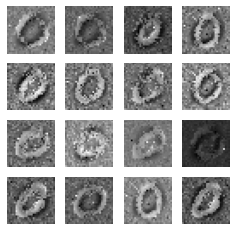

54
gen_loss: tf.Tensor(2.9977307, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06637882, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.075876445, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.66502598e-10]
 [1.00000000e+00 2.11773640e-10]
 [9.99999762e-01 1.84343108e-07]
 [1.00000000e+00 1.02654134e-08]
 [1.00000000e+00 3.81780509e-08]
 [9.99999166e-01 8.12563201e-07]
 [9.99999881e-01 7.08135843e-08]
 [9.99999523e-01 4.30924530e-07]
 [1.00000000e+00 1.51043711e-08]
 [9.99982357e-01 1.76996182e-05]
 [1.00000000e+00 2.85481394e-09]
 [1.00000000e+00 9.73382797e-09]
 [9.99566257e-01 4.33693465e-04]
 [9.99999762e-01 2.55961680e-07]
 [1.00000000e+00 4.43150263e-08]
 [1.00000000e+00 9.41420009e-09]
 [1.00000000e+00 4.65850292e-08]
 [1.00000000e+00 4.75262212e-08]
 [1.00000000e+00 4.24059365e-09]
 [1.00000000e+00 2.99304070e-09]
 [9.99762714e-01 2.37309243e-04]
 [1.00000000e+00 3.48796936e-10]
 [1.00000000e+00 3.10180575e-08]
 [1.00000000e+00 

gen_loss: tf.Tensor(2.9033203, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07354379, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.088604674, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.87565027e-10]
 [1.00000000e+00 3.54407281e-10]
 [9.99999881e-01 1.29639147e-07]
 [1.00000000e+00 6.40944098e-09]
 [1.00000000e+00 2.48119605e-08]
 [9.99999404e-01 5.39584107e-07]
 [1.00000000e+00 4.80372186e-08]
 [9.99999523e-01 4.84781992e-07]
 [1.00000000e+00 1.00940110e-08]
 [9.99985576e-01 1.43990965e-05]
 [1.00000000e+00 2.60806798e-09]
 [1.00000000e+00 6.74250300e-09]
 [9.99482393e-01 5.17621695e-04]
 [9.99999762e-01 2.39266541e-07]
 [1.00000000e+00 3.04740944e-08]
 [1.00000000e+00 7.31623828e-09]
 [1.00000000e+00 3.50764040e-08]
 [1.00000000e+00 3.90110237e-08]
 [1.00000000e+00 2.75911738e-09]
 [1.00000000e+00 2.05187689e-09]
 [9.99816835e-01 1.83155484e-04]
 [1.00000000e+00 5.33422417e-10]
 [1.00000000e+00 2.07308926e-08]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.0512056, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07534605, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07414724, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.68471262e-10]
 [1.00000000e+00 3.25193872e-10]
 [9.99999642e-01 3.62514783e-07]
 [1.00000000e+00 3.67726614e-08]
 [9.99999881e-01 8.77652653e-08]
 [9.99998331e-01 1.70656892e-06]
 [9.99999762e-01 1.94836261e-07]
 [9.99999523e-01 5.18707225e-07]
 [1.00000000e+00 5.60861579e-08]
 [9.99912381e-01 8.76294216e-05]
 [1.00000000e+00 5.47602541e-09]
 [9.99999881e-01 6.37581579e-08]
 [9.99414682e-01 5.85386821e-04]
 [9.99999046e-01 9.40585437e-07]
 [9.99999881e-01 1.70396717e-07]
 [1.00000000e+00 3.12293906e-08]
 [9.99999881e-01 1.64367421e-07]
 [9.99999881e-01 1.36700635e-07]
 [1.00000000e+00 8.42977688e-09]
 [1.00000000e+00 9.56688506e-09]
 [9.99525547e-01 4.74492990e-04]
 [1.00000000e+00 5.32474009e-10]
 [9.99999881e-01 1.05284762e-07]
 [9.99999881e-01 7.24

gen_loss: tf.Tensor(2.9926069, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051969483, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07878482, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.82328408e-10]
 [1.00000000e+00 3.20176025e-10]
 [9.99999285e-01 7.01571082e-07]
 [9.99999881e-01 8.47983657e-08]
 [9.99999881e-01 1.66056438e-07]
 [9.99997497e-01 2.51438360e-06]
 [9.99999642e-01 3.93277247e-07]
 [9.99999404e-01 5.48445257e-07]
 [9.99999881e-01 1.34244033e-07]
 [9.99849677e-01 1.50303182e-04]
 [1.00000000e+00 7.91083021e-09]
 [9.99999881e-01 1.53152072e-07]
 [9.99139547e-01 8.60459404e-04]
 [9.99998331e-01 1.71713816e-06]
 [9.99999642e-01 4.12410515e-07]
 [1.00000000e+00 5.86317803e-08]
 [9.99999642e-01 3.28061248e-07]
 [9.99999762e-01 2.18867129e-07]
 [1.00000000e+00 1.93564418e-08]
 [1.00000000e+00 1.88856326e-08]
 [9.99166727e-01 8.33290687e-04]
 [1.00000000e+00 4.93641961e-10]
 [9.99999762e-01 2.24285316e-07]
 [9.99999881e-01 1.6

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.57125918e-10]
 [1.00000000e+00 4.14058093e-10]
 [9.99999166e-01 7.97365999e-07]
 [9.99999881e-01 9.07587179e-08]
 [9.99999762e-01 2.01917345e-07]
 [9.99997616e-01 2.41752923e-06]
 [9.99999523e-01 4.44545037e-07]
 [9.99999404e-01 6.38295774e-07]
 [9.99999881e-01 1.61768682e-07]
 [9.99859452e-01 1.40578602e-04]
 [1.00000000e+00 9.75739844e-09]
 [9.99999881e-01 1.40822650e-07]
 [9.99008477e-01 9.91581473e-04]
 [9.99997973e-01 2.05624428e-06]
 [9.99999523e-01 4.92036008e-07]
 [9.99999881e-01 7.08973786e-08]
 [9.99999642e-01 3.96352675e-07]
 [9.99999762e-01 2.44977940e-07]
 [1.00000000e+00 2.50642955e-08]
 [1.00000000e+00 2.18029594e-08]
 [9.99013901e-01 9.86074912e-04]
 [1.00000000e+00 5.75958059e-10]
 [9.99999762e-01 2.63290588e-07]
 [9.99999762e-01 1.78924680e-07]
 [9.99999762e-01 2.72240186e-07]
 [9.99999523e-01 4.62565453e-07]
 [9.99999523e-01 4.66685833e-07]
 [9.99999881e-01 1.13654259e-07]
 [9.92299497e-01 7.70058669e-03]
 [9.9

gen_loss: tf.Tensor(3.0717, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.057021957, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08061658, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.88620946e-10]
 [1.00000000e+00 1.03423103e-09]
 [9.99999762e-01 2.75619527e-07]
 [1.00000000e+00 1.78088424e-08]
 [9.99999881e-01 8.09909793e-08]
 [9.99998927e-01 1.08769359e-06]
 [9.99999881e-01 1.35039102e-07]
 [9.99999404e-01 5.41219890e-07]
 [1.00000000e+00 4.76639350e-08]
 [9.99955893e-01 4.40847616e-05]
 [1.00000000e+00 5.17341459e-09]
 [1.00000000e+00 2.97256104e-08]
 [9.99608338e-01 3.91731359e-04]
 [9.99999166e-01 8.72579847e-07]
 [9.99999881e-01 1.29585743e-07]
 [1.00000000e+00 3.73333684e-08]
 [9.99999881e-01 1.54583503e-07]
 [9.99999881e-01 1.27910013e-07]
 [1.00000000e+00 6.04245365e-09]
 [1.00000000e+00 7.84771093e-09]
 [9.99479353e-01 5.20662870e-04]
 [1.00000000e+00 1.42093037e-09]
 [9.99999881e-01 6.93504774e-08]
 [1.00000000e+00 3.4831

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.46883730e-10]
 [1.00000000e+00 1.19884835e-09]
 [9.99999762e-01 2.35579961e-07]
 [1.00000000e+00 1.52833479e-08]
 [9.99999881e-01 7.64148425e-08]
 [9.99998808e-01 1.15909086e-06]
 [9.99999881e-01 1.16663934e-07]
 [9.99999404e-01 5.86379258e-07]
 [1.00000000e+00 4.24426929e-08]
 [9.99945641e-01 5.44032810e-05]
 [1.00000000e+00 5.07970377e-09]
 [1.00000000e+00 2.97327549e-08]
 [9.99642611e-01 3.57361510e-04]
 [9.99999166e-01 8.03701084e-07]
 [9.99999881e-01 1.09064914e-07]
 [1.00000000e+00 4.03192892e-08]
 [9.99999881e-01 1.47175101e-07]
 [9.99999881e-01 1.47576927e-07]
 [1.00000000e+00 4.06455714e-09]
 [1.00000000e+00 7.97187205e-09]
 [9.99416590e-01 5.83406945e-04]
 [1.00000000e+00 1.64005098e-09]
 [9.99999881e-01 6.33836095e-08]
 [1.00000000e+00 2.93899447e-08]
 [9.99999881e-01 1.09534810e-07]
 [9.99999762e-01 1.90525014e-07]
 [9.99999881e-01 7.05646883e-08]
 [9.99999881e-01 1.29379529e-07]
 [9.94105816e-01 5.89421438e-03]
 [9.9

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.28232799e-10]
 [1.00000000e+00 6.91818380e-10]
 [9.99999762e-01 2.05222307e-07]
 [1.00000000e+00 1.57042628e-08]
 [9.99999881e-01 6.96192544e-08]
 [9.99998808e-01 1.14054205e-06]
 [9.99999881e-01 9.98385872e-08]
 [9.99999404e-01 5.47167360e-07]
 [1.00000000e+00 3.57129402e-08]
 [9.99930024e-01 6.99929442e-05]
 [1.00000000e+00 4.73475925e-09]
 [1.00000000e+00 3.44265843e-08]
 [9.99557912e-01 4.42090968e-04]
 [9.99999285e-01 6.76732554e-07]
 [9.99999881e-01 9.23246830e-08]
 [1.00000000e+00 4.00822060e-08]
 [9.99999881e-01 1.43659435e-07]
 [9.99999881e-01 1.54491531e-07]
 [1.00000000e+00 2.75109846e-09]
 [1.00000000e+00 7.62680408e-09]
 [9.99205410e-01 7.94593710e-04]
 [1.00000000e+00 9.62218305e-10]
 [9.99999881e-01 6.22195770e-08]
 [1.00000000e+00 2.97181266e-08]
 [9.99999881e-01 9.00960657e-08]
 [9.99999762e-01 1.92635596e-07]
 [9.99999881e-01 6.14780404e-08]
 [9.99999881e-01 1.40925280e-07]
 [9.75450277e-01 2.45497022e-02]
 [9.9

gen_loss: tf.Tensor(3.1041286, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.056015544, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07028137, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.71266470e-10]
 [1.00000000e+00 3.93102051e-10]
 [9.99999762e-01 1.87939875e-07]
 [1.00000000e+00 1.65790688e-08]
 [9.99999881e-01 6.43617426e-08]
 [9.99999046e-01 9.92244281e-07]
 [9.99999881e-01 9.08122217e-08]
 [9.99999523e-01 4.70178350e-07]
 [1.00000000e+00 3.28013030e-08]
 [9.99926090e-01 7.39308671e-05]
 [1.00000000e+00 4.22501989e-09]
 [1.00000000e+00 3.78178484e-08]
 [9.99428928e-01 5.71047538e-04]
 [9.99999523e-01 5.28727014e-07]
 [9.99999881e-01 8.61779483e-08]
 [1.00000000e+00 3.59655914e-08]
 [9.99999881e-01 1.28646477e-07]
 [9.99999881e-01 1.50288415e-07]
 [1.00000000e+00 2.25420371e-09]
 [1.00000000e+00 7.30168415e-09]
 [9.99066889e-01 9.33160482e-04]
 [1.00000000e+00 5.70189007e-10]
 [9.99999881e-01 6.11803372e-08]
 [1.00000000e+00 3.0

gen_loss: tf.Tensor(3.1165528, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.048183747, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07529579, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.29323807e-10]
 [1.00000000e+00 6.29608699e-10]
 [9.99999881e-01 1.03657221e-07]
 [1.00000000e+00 1.04761098e-08]
 [1.00000000e+00 5.11815053e-08]
 [9.99999285e-01 6.74545106e-07]
 [9.99999881e-01 6.20985290e-08]
 [9.99999404e-01 5.84480972e-07]
 [1.00000000e+00 1.96500132e-08]
 [9.99955177e-01 4.47853745e-05]
 [1.00000000e+00 3.64236175e-09]
 [1.00000000e+00 2.07859667e-08]
 [9.99398112e-01 6.01844513e-04]
 [9.99999404e-01 5.43654323e-07]
 [1.00000000e+00 5.55281829e-08]
 [1.00000000e+00 2.61653987e-08]
 [9.99999881e-01 8.47320791e-08]
 [9.99999881e-01 1.04743556e-07]
 [1.00000000e+00 2.03949657e-09]
 [1.00000000e+00 4.45759341e-09]
 [9.99506354e-01 4.93617670e-04]
 [1.00000000e+00 9.55859947e-10]
 [1.00000000e+00 3.76187863e-08]
 [1.00000000e+00 1.9

gen_loss: tf.Tensor(3.0400681, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.058891557, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07533962, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 5.3893873e-10]
 [1.0000000e+00 8.1451779e-10]
 [9.9999988e-01 7.1593945e-08]
 [1.0000000e+00 8.4431653e-09]
 [1.0000000e+00 4.5019927e-08]
 [9.9999940e-01 5.4626020e-07]
 [1.0000000e+00 5.2464241e-08]
 [9.9999952e-01 5.1765562e-07]
 [1.0000000e+00 1.6420518e-08]
 [9.9996889e-01 3.1065629e-05]
 [1.0000000e+00 2.8780880e-09]
 [1.0000000e+00 1.8261899e-08]
 [9.9959594e-01 4.0407031e-04]
 [9.9999952e-01 4.6326298e-07]
 [1.0000000e+00 4.7516160e-08]
 [1.0000000e+00 2.2209122e-08]
 [9.9999988e-01 6.7358478e-08]
 [9.9999988e-01 8.2007432e-08]
 [1.0000000e+00 1.9005846e-09]
 [1.0000000e+00 3.5412637e-09]
 [9.9971217e-01 2.8779887e-04]
 [1.0000000e+00 1.4560647e-09]
 [1.0000000e+00 2.8972844e-08]
 [1.0000000e+00 1.5122675e-08]
 [1.0000000e+00 5.3458816e-08]
 [9.

gen_loss: tf.Tensor(3.1104279, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.054275237, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07566353, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.30247524e-10]
 [1.00000000e+00 3.35862393e-10]
 [9.99999881e-01 8.23384525e-08]
 [1.00000000e+00 2.08733724e-08]
 [9.99999881e-01 5.96498992e-08]
 [9.99999166e-01 8.26463520e-07]
 [9.99999881e-01 8.25214599e-08]
 [9.99999642e-01 3.08950121e-07]
 [1.00000000e+00 3.01376808e-08]
 [9.99931812e-01 6.82017780e-05]
 [1.00000000e+00 2.33386954e-09]
 [9.99999881e-01 8.50554400e-08]
 [9.99692678e-01 3.07293027e-04]
 [9.99999404e-01 5.41234328e-07]
 [9.99999881e-01 9.36616757e-08]
 [1.00000000e+00 3.24090763e-08]
 [9.99999881e-01 1.03635081e-07]
 [9.99999881e-01 1.08242176e-07]
 [1.00000000e+00 2.36256992e-09]
 [1.00000000e+00 5.76474912e-09]
 [9.99646664e-01 3.53363634e-04]
 [1.00000000e+00 7.89343257e-10]
 [1.00000000e+00 5.01267010e-08]
 [1.00000000e+00 3.8

 [9.99999881e-01 1.04953941e-07]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.014976, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06448285, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08330264, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.62027242e-10]
 [1.00000000e+00 2.41552972e-10]
 [9.99999881e-01 1.51895748e-07]
 [1.00000000e+00 4.33712799e-08]
 [1.00000000e+00 5.95922529e-08]
 [9.99998808e-01 1.24760447e-06]
 [9.99999881e-01 1.25896690e-07]
 [9.99999762e-01 2.97320838e-07]
 [1.00000000e+00 5.70386440e-08]
 [9.99810636e-01 1.89345505e-04]
 [1.00000000e+00 2.44352427e-09]
 [9.99999762e-01 2.52836344e-07]
 [9.99775589e-01 2.24386415e-04]
 [9.99999166e-01 7.89881483e-07]
 [9.99999881e-01 1.69485887e-07]
 [1.00000000e+00 4.61260612e-08]
 [9.99999762e-01 1.83328538e-07]
 [9.99999762e-01 1.99237476e-07]
 [1.00000000e+00 3.11359383e-09]
 [1.00000000e+00 1.04890265e-08]
 [9.99417901e-01 5.82091918e-04]
 [1.00000000e+00 5.015

gen_loss: tf.Tensor(3.2108338, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08922526, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06711613, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.16475465e-10]
 [1.00000000e+00 3.45805440e-10]
 [9.99999881e-01 1.08454202e-07]
 [1.00000000e+00 1.94213818e-08]
 [1.00000000e+00 3.09966488e-08]
 [9.99999285e-01 7.39632867e-07]
 [9.99999881e-01 6.88184016e-08]
 [9.99999642e-01 3.14439404e-07]
 [1.00000000e+00 2.94707778e-08]
 [9.99897122e-01 1.02822101e-04]
 [1.00000000e+00 2.01919104e-09]
 [9.99999881e-01 8.92109782e-08]
 [9.99818981e-01 1.81089912e-04]
 [9.99999404e-01 5.67596203e-07]
 [9.99999881e-01 8.20111907e-08]
 [1.00000000e+00 2.81670562e-08]
 [9.99999881e-01 1.20753796e-07]
 [9.99999881e-01 1.35878409e-07]
 [1.00000000e+00 2.02496864e-09]
 [1.00000000e+00 6.07057116e-09]
 [9.99515653e-01 4.84384858e-04]
 [1.00000000e+00 5.96913852e-10]
 [1.00000000e+00 4.95202244e-08]
 [1.00000000e+00 3.57

gen_loss: tf.Tensor(3.1648073, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.061425835, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07167758, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.82159868e-10]
 [1.00000000e+00 5.15095300e-10]
 [9.99999881e-01 6.06847834e-08]
 [1.00000000e+00 6.60909061e-09]
 [1.00000000e+00 1.40755994e-08]
 [9.99999642e-01 3.46652797e-07]
 [1.00000000e+00 3.16884687e-08]
 [9.99999642e-01 3.52765539e-07]
 [1.00000000e+00 1.18222268e-08]
 [9.99963164e-01 3.68216133e-05]
 [1.00000000e+00 1.60946501e-09]
 [1.00000000e+00 1.93297307e-08]
 [9.99835491e-01 1.64512821e-04]
 [9.99999642e-01 3.27966177e-07]
 [1.00000000e+00 3.19947411e-08]
 [1.00000000e+00 1.39008982e-08]
 [9.99999881e-01 6.46018137e-08]
 [9.99999881e-01 7.40669108e-08]
 [1.00000000e+00 1.16785381e-09]
 [1.00000000e+00 2.77136447e-09]
 [9.99669671e-01 3.30397073e-04]
 [1.00000000e+00 7.36015526e-10]
 [1.00000000e+00 2.14787796e-08]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.1041064, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.069226526, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07444589, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.45622142e-10]
 [1.00000000e+00 1.34370903e-10]
 [9.99999881e-01 6.10735427e-08]
 [1.00000000e+00 8.86048657e-09]
 [1.00000000e+00 1.61470215e-08]
 [9.99999762e-01 2.24612819e-07]
 [1.00000000e+00 4.01238935e-08]
 [9.99999762e-01 2.07329151e-07]
 [1.00000000e+00 1.60220672e-08]
 [9.99976039e-01 2.39791971e-05]
 [1.00000000e+00 1.53212842e-09]
 [1.00000000e+00 1.90989589e-08]
 [9.99662638e-01 3.37316305e-04]
 [9.99999881e-01 1.63149750e-07]
 [1.00000000e+00 4.63789007e-08]
 [1.00000000e+00 1.14945253e-08]
 [9.99999881e-01 6.71119977e-08]
 [1.00000000e+00 5.29221360e-08]
 [1.00000000e+00 1.58003388e-09]
 [1.00000000e+00 2.83749668e-09]
 [9.99549210e-01 4.50708059e-04]
 [1.00000000e+00 2.10289591e-10]
 [1.00000000e+00 2.59950745e-08]
 [1.00000000e+00 1.5

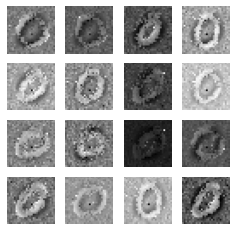

55
gen_loss: tf.Tensor(3.1516628, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.053902805, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06474123, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.69801986e-10]
 [1.00000000e+00 6.80365278e-11]
 [9.99999881e-01 6.34725268e-08]
 [1.00000000e+00 1.36922251e-08]
 [1.00000000e+00 2.18415437e-08]
 [9.99999762e-01 2.49999431e-07]
 [1.00000000e+00 5.30842925e-08]
 [9.99999881e-01 1.32992696e-07]
 [1.00000000e+00 2.35487807e-08]
 [9.99970675e-01 2.93637477e-05]
 [1.00000000e+00 1.42067569e-09]
 [1.00000000e+00 3.43282309e-08]
 [9.99619365e-01 3.80617508e-04]
 [9.99999881e-01 1.41975590e-07]
 [9.99999881e-01 6.82635815e-08]
 [1.00000000e+00 1.39660088e-08]
 [9.99999881e-01 8.27399020e-08]
 [1.00000000e+00 5.50032411e-08]
 [1.00000000e+00 1.82488313e-09]
 [1.00000000e+00 3.53374729e-09]
 [9.99506712e-01 4.93276690e-04]
 [1.00000000e+00 1.30113087e-10]
 [1.00000000e+00 3.48370435e-08]
 [1.00000000e+00 

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.27933061e-10]
 [1.00000000e+00 6.33539055e-11]
 [9.99999881e-01 6.72711664e-08]
 [1.00000000e+00 1.83521962e-08]
 [1.00000000e+00 2.71428142e-08]
 [9.99999642e-01 3.54303296e-07]
 [9.99999881e-01 6.02776780e-08]
 [9.99999881e-01 1.08296689e-07]
 [1.00000000e+00 2.91456619e-08]
 [9.99954462e-01 4.55936279e-05]
 [1.00000000e+00 1.26855204e-09]
 [1.00000000e+00 5.87044013e-08]
 [9.99589503e-01 4.10484266e-04]
 [9.99999762e-01 1.83388863e-07]
 [9.99999881e-01 8.28286417e-08]
 [1.00000000e+00 1.85212343e-08]
 [9.99999881e-01 9.97879468e-08]
 [9.99999881e-01 6.84364423e-08]
 [1.00000000e+00 1.84442317e-09]
 [1.00000000e+00 4.26526148e-09]
 [9.99419332e-01 5.80705237e-04]
 [1.00000000e+00 1.30016345e-10]
 [1.00000000e+00 4.24787352e-08]
 [1.00000000e+00 3.29814789e-08]
 [1.00000000e+00 4.61970302e-08]
 [9.99999881e-01 8.76754100e-08]
 [1.00000000e+00 5.84940523e-08]
 [1.00000000e+00 3.67304622e-08]
 [9.91906166e-01 8.09385721e-03]
 [9.9

gen_loss: tf.Tensor(3.1355848, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05934126, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06884791, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.26083241e-10]
 [1.00000000e+00 9.87911142e-11]
 [9.99999881e-01 6.85259209e-08]
 [1.00000000e+00 1.21593171e-08]
 [1.00000000e+00 1.68931678e-08]
 [9.99999642e-01 3.89354312e-07]
 [1.00000000e+00 3.55956296e-08]
 [9.99999881e-01 7.50103482e-08]
 [1.00000000e+00 2.06997175e-08]
 [9.99962687e-01 3.72841459e-05]
 [1.00000000e+00 5.65038905e-10]
 [1.00000000e+00 5.37368834e-08]
 [9.99504924e-01 4.95058135e-04]
 [9.99999762e-01 2.25685980e-07]
 [1.00000000e+00 5.72670231e-08]
 [1.00000000e+00 1.65852363e-08]
 [9.99999881e-01 7.44977697e-08]
 [1.00000000e+00 5.07704243e-08]
 [1.00000000e+00 1.44633538e-09]
 [1.00000000e+00 2.42173104e-09]
 [9.99193966e-01 8.06079886e-04]
 [1.00000000e+00 1.78912843e-10]
 [1.00000000e+00 2.42099318e-08]
 [1.00000000e+00 2.00

gen_loss: tf.Tensor(3.1463408, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.092613816, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.065726146, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.83473712e-11]
 [1.00000000e+00 4.44526083e-11]
 [1.00000000e+00 3.55265151e-08]
 [1.00000000e+00 3.36920580e-09]
 [1.00000000e+00 4.99290609e-09]
 [9.99999881e-01 1.44853701e-07]
 [1.00000000e+00 1.19979138e-08]
 [1.00000000e+00 3.50225910e-08]
 [1.00000000e+00 7.19514848e-09]
 [9.99993443e-01 6.52386643e-06]
 [1.00000000e+00 2.17528426e-10]
 [1.00000000e+00 1.31017464e-08]
 [9.99349654e-01 6.50388713e-04]
 [1.00000000e+00 5.88957327e-08]
 [1.00000000e+00 2.12714664e-08]
 [1.00000000e+00 6.03281514e-09]
 [1.00000000e+00 3.20596776e-08]
 [1.00000000e+00 1.36333824e-08]
 [1.00000000e+00 6.98460956e-10]
 [1.00000000e+00 6.31787234e-10]
 [9.99301553e-01 6.98422664e-04]
 [1.00000000e+00 8.42163700e-11]
 [1.00000000e+00 6.96735558e-09]
 [1.00000000e+00 5.

gen_loss: tf.Tensor(3.1136546, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08878099, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.072104186, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.26435874e-11]
 [1.00000000e+00 3.68636857e-11]
 [1.00000000e+00 2.08536726e-08]
 [1.00000000e+00 2.73122036e-09]
 [1.00000000e+00 4.82122386e-09]
 [9.99999881e-01 1.27675776e-07]
 [1.00000000e+00 8.82276208e-09]
 [1.00000000e+00 2.65869744e-08]
 [1.00000000e+00 5.41360112e-09]
 [9.99992371e-01 7.66221001e-06]
 [1.00000000e+00 2.91408508e-10]
 [1.00000000e+00 1.13826033e-08]
 [9.99661565e-01 3.38386773e-04]
 [1.00000000e+00 4.25526920e-08]
 [1.00000000e+00 1.60752673e-08]
 [1.00000000e+00 5.46945955e-09]
 [1.00000000e+00 3.39382602e-08]
 [1.00000000e+00 1.58184399e-08]
 [1.00000000e+00 3.22310123e-10]
 [1.00000000e+00 6.60259847e-10]
 [9.99425054e-01 5.74945356e-04]
 [1.00000000e+00 7.75000411e-11]
 [1.00000000e+00 7.12775350e-09]
 [1.00000000e+00 4.0

gen_loss: tf.Tensor(3.154981, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06511538, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07050918, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.31243878e-11]
 [1.00000000e+00 3.28870126e-11]
 [1.00000000e+00 1.68018097e-08]
 [1.00000000e+00 1.27112665e-09]
 [1.00000000e+00 2.15074225e-09]
 [1.00000000e+00 4.45345734e-08]
 [1.00000000e+00 3.70445163e-09]
 [1.00000000e+00 1.11171659e-08]
 [1.00000000e+00 2.30827690e-09]
 [9.99996901e-01 3.14539761e-06]
 [1.00000000e+00 1.16206059e-10]
 [1.00000000e+00 6.00225025e-09]
 [9.99606192e-01 3.93839844e-04]
 [1.00000000e+00 3.40284210e-08]
 [1.00000000e+00 7.60634933e-09]
 [1.00000000e+00 1.91645588e-09]
 [1.00000000e+00 1.46697898e-08]
 [1.00000000e+00 6.38224940e-09]
 [1.00000000e+00 1.69913875e-10]
 [1.00000000e+00 2.29108149e-10]
 [9.99194801e-01 8.05160846e-04]
 [1.00000000e+00 5.32677930e-11]
 [1.00000000e+00 2.64656341e-09]
 [1.00000000e+00 1.713

gen_loss: tf.Tensor(3.0851145, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07389465, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07376669, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.30467250e-12]
 [1.00000000e+00 1.33774224e-11]
 [1.00000000e+00 1.11289822e-08]
 [1.00000000e+00 7.83965781e-10]
 [1.00000000e+00 1.07757170e-09]
 [1.00000000e+00 1.76526349e-08]
 [1.00000000e+00 1.90528859e-09]
 [1.00000000e+00 2.66538835e-09]
 [1.00000000e+00 1.26838273e-09]
 [9.99999046e-01 9.97175221e-07]
 [1.00000000e+00 2.90285556e-11]
 [1.00000000e+00 5.91927884e-09]
 [9.99719679e-01 2.80272419e-04]
 [1.00000000e+00 1.92522780e-08]
 [1.00000000e+00 4.63154048e-09]
 [1.00000000e+00 8.00123745e-10]
 [1.00000000e+00 6.87011248e-09]
 [1.00000000e+00 2.06051687e-09]
 [1.00000000e+00 8.70170533e-11]
 [1.00000000e+00 7.79578554e-11]
 [9.99220729e-01 7.79222755e-04]
 [1.00000000e+00 2.30529588e-11]
 [1.00000000e+00 1.05497344e-09]
 [1.00000000e+00 1.01

gen_loss: tf.Tensor(3.0033774, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05758658, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.080558, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.99970333e-12]
 [1.00000000e+00 7.70942685e-12]
 [1.00000000e+00 7.49350981e-09]
 [1.00000000e+00 1.07580966e-09]
 [1.00000000e+00 1.46312762e-09]
 [1.00000000e+00 2.04349249e-08]
 [1.00000000e+00 2.36168241e-09]
 [1.00000000e+00 3.28204974e-09]
 [1.00000000e+00 1.27735089e-09]
 [9.99998927e-01 1.12630335e-06]
 [1.00000000e+00 4.74976933e-11]
 [1.00000000e+00 5.21702415e-09]
 [9.99759734e-01 2.40295994e-04]
 [1.00000000e+00 2.34148203e-08]
 [1.00000000e+00 4.83199480e-09]
 [1.00000000e+00 8.38858427e-10]
 [1.00000000e+00 8.33473024e-09]
 [1.00000000e+00 3.35813244e-09]
 [1.00000000e+00 8.72387440e-11]
 [1.00000000e+00 9.81540266e-11]
 [9.99254167e-01 7.45800091e-04]
 [1.00000000e+00 1.42994176e-11]
 [1.00000000e+00 1.45312107e-09]
 [1.00000000e+00 1.4288

gen_loss: tf.Tensor(3.0579815, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.056281343, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08578791, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.90251946e-11]
 [1.00000000e+00 1.73092946e-11]
 [1.00000000e+00 5.69198289e-09]
 [1.00000000e+00 9.68275349e-10]
 [1.00000000e+00 1.33719258e-09]
 [1.00000000e+00 2.06228723e-08]
 [1.00000000e+00 2.22297936e-09]
 [1.00000000e+00 7.59240493e-09]
 [1.00000000e+00 1.12551801e-09]
 [9.99998808e-01 1.16117758e-06]
 [1.00000000e+00 9.16983781e-11]
 [1.00000000e+00 2.42895681e-09]
 [9.99791801e-01 2.08209996e-04]
 [1.00000000e+00 1.85154416e-08]
 [1.00000000e+00 3.65449782e-09]
 [1.00000000e+00 7.45623785e-10]
 [1.00000000e+00 7.73359154e-09]
 [1.00000000e+00 6.84194479e-09]
 [1.00000000e+00 9.37003253e-11]
 [1.00000000e+00 1.24294103e-10]
 [9.99488115e-01 5.11918683e-04]
 [1.00000000e+00 2.79431252e-11]
 [1.00000000e+00 1.92448524e-09]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.0693235, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06446185, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.072595045, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.46386006e-12]
 [1.00000000e+00 6.62385815e-12]
 [1.00000000e+00 3.57744168e-09]
 [1.00000000e+00 2.71317108e-10]
 [1.00000000e+00 2.88602447e-10]
 [1.00000000e+00 4.71984585e-09]
 [1.00000000e+00 6.83991919e-10]
 [1.00000000e+00 1.68360315e-09]
 [1.00000000e+00 4.69648598e-10]
 [9.99999881e-01 1.43671627e-07]
 [1.00000000e+00 8.73362580e-12]
 [1.00000000e+00 1.01035980e-09]
 [9.99812782e-01 1.87192971e-04]
 [1.00000000e+00 3.41701911e-09]
 [1.00000000e+00 1.28040978e-09]
 [1.00000000e+00 1.66820779e-10]
 [1.00000000e+00 1.44220880e-09]
 [1.00000000e+00 1.22910304e-09]
 [1.00000000e+00 3.31516516e-11]
 [1.00000000e+00 2.41970628e-11]
 [9.99596179e-01 4.03811136e-04]
 [1.00000000e+00 9.76401165e-12]
 [1.00000000e+00 4.47964943e-10]
 [1.00000000e+00 3.4

gen_loss: tf.Tensor(3.047865, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06637362, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.084662914, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.25341316e-12]
 [1.00000000e+00 6.08043477e-12]
 [1.00000000e+00 6.80500900e-09]
 [1.00000000e+00 5.22654309e-10]
 [1.00000000e+00 6.01666661e-10]
 [1.00000000e+00 8.56455173e-09]
 [1.00000000e+00 1.26771516e-09]
 [1.00000000e+00 2.22028440e-09]
 [1.00000000e+00 9.43564116e-10]
 [9.99999642e-01 4.14768806e-07]
 [1.00000000e+00 1.22452257e-11]
 [1.00000000e+00 1.89607308e-09]
 [9.99764621e-01 2.35366853e-04]
 [1.00000000e+00 8.55735127e-09]
 [1.00000000e+00 2.28111485e-09]
 [1.00000000e+00 2.64787497e-10]
 [1.00000000e+00 1.68254055e-09]
 [1.00000000e+00 2.72245138e-09]
 [1.00000000e+00 5.79344628e-11]
 [1.00000000e+00 5.12605618e-11]
 [9.99278843e-01 7.21171324e-04]
 [1.00000000e+00 7.32644848e-12]
 [1.00000000e+00 9.89673121e-10]
 [1.00000000e+00 6.71

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.25962692e-12]
 [1.00000000e+00 7.08846653e-12]
 [1.00000000e+00 5.87333826e-09]
 [1.00000000e+00 5.86013071e-10]
 [1.00000000e+00 9.06382303e-10]
 [1.00000000e+00 1.09474190e-08]
 [1.00000000e+00 1.52925850e-09]
 [1.00000000e+00 2.92458813e-09]
 [1.00000000e+00 1.04941833e-09]
 [9.99999404e-01 6.26376391e-07]
 [1.00000000e+00 1.98992160e-11]
 [1.00000000e+00 1.70000836e-09]
 [9.99826133e-01 1.73855660e-04]
 [1.00000000e+00 1.16488454e-08]
 [1.00000000e+00 2.38433095e-09]
 [1.00000000e+00 3.39352491e-10]
 [1.00000000e+00 1.82438897e-09]
 [1.00000000e+00 4.11640055e-09]
 [1.00000000e+00 5.94417501e-11]
 [1.00000000e+00 7.06360942e-11]
 [9.99482632e-01 5.17363194e-04]
 [1.00000000e+00 9.29962791e-12]
 [1.00000000e+00 1.31733802e-09]
 [1.00000000e+00 7.57611307e-10]
 [1.00000000e+00 6.29671149e-10]
 [1.00000000e+00 3.65406572e-09]
 [1.00000000e+00 4.99474184e-10]
 [1.00000000e+00 2.88035062e-09]
 [9.95757520e-01 4.24244534e-03]
 [1.0

disc_real_loss: tf.Tensor(0.070449814, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0840339, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.92792350e-12]
 [1.00000000e+00 6.64893357e-12]
 [1.00000000e+00 3.22414806e-09]
 [1.00000000e+00 3.55501351e-10]
 [1.00000000e+00 7.28990757e-10]
 [1.00000000e+00 7.53467155e-09]
 [1.00000000e+00 1.11462262e-09]
 [1.00000000e+00 2.15390328e-09]
 [1.00000000e+00 7.42471862e-10]
 [9.99999642e-01 3.41438295e-07]
 [1.00000000e+00 1.41018048e-11]
 [1.00000000e+00 9.61708158e-10]
 [9.99905825e-01 9.41730104e-05]
 [1.00000000e+00 6.98810432e-09]
 [1.00000000e+00 1.58559788e-09]
 [1.00000000e+00 2.46000720e-10]
 [1.00000000e+00 1.11063092e-09]
 [1.00000000e+00 2.57910937e-09]
 [1.00000000e+00 3.71193770e-11]
 [1.00000000e+00 4.56300171e-11]
 [9.99783337e-01 2.16651446e-04]
 [1.00000000e+00 1.15033686e-11]
 [1.00000000e+00 8.17978685e-10]
 [1.00000000e+00 4.70490535e-10]
 [1.00000000e+00 4.95208319e-10]
 [1.0000000

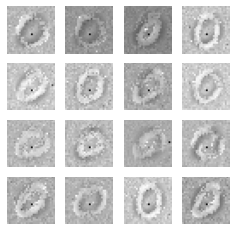

56
gen_loss: tf.Tensor(3.2034981, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06243631, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07095134, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.20872625e-12]
 [1.00000000e+00 2.74095417e-12]
 [1.00000000e+00 2.07211959e-09]
 [1.00000000e+00 1.64949290e-10]
 [1.00000000e+00 3.28413963e-10]
 [1.00000000e+00 3.15655124e-09]
 [1.00000000e+00 5.65580194e-10]
 [1.00000000e+00 1.05781051e-09]
 [1.00000000e+00 3.83815701e-10]
 [9.99999881e-01 6.41476348e-08]
 [1.00000000e+00 5.78172015e-12]
 [1.00000000e+00 4.56558097e-10]
 [9.99931812e-01 6.81976744e-05]
 [1.00000000e+00 2.47491316e-09]
 [1.00000000e+00 8.54431526e-10]
 [1.00000000e+00 1.07497636e-10]
 [1.00000000e+00 6.28043506e-10]
 [1.00000000e+00 5.93534111e-10]
 [1.00000000e+00 2.22992874e-11]
 [1.00000000e+00 1.29392599e-11]
 [9.99914169e-01 8.58296626e-05]
 [1.00000000e+00 6.52728739e-12]
 [1.00000000e+00 2.40693854e-10]
 [1.00000000e+00 2

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.30100443e-12]
 [1.00000000e+00 1.69816179e-12]
 [1.00000000e+00 3.50132878e-09]
 [1.00000000e+00 3.60867641e-10]
 [1.00000000e+00 5.05707975e-10]
 [1.00000000e+00 6.89826418e-09]
 [1.00000000e+00 8.55052695e-10]
 [1.00000000e+00 1.77661197e-09]
 [1.00000000e+00 5.69391312e-10]
 [9.99999881e-01 1.63626240e-07]
 [1.00000000e+00 1.00893764e-11]
 [1.00000000e+00 9.96872251e-10]
 [9.99901175e-01 9.88534593e-05]
 [1.00000000e+00 4.38933867e-09]
 [1.00000000e+00 1.32750544e-09]
 [1.00000000e+00 1.90278904e-10]
 [1.00000000e+00 1.32170452e-09]
 [1.00000000e+00 1.18491528e-09]
 [1.00000000e+00 2.77350851e-11]
 [1.00000000e+00 2.15701346e-11]
 [9.99835968e-01 1.64022102e-04]
 [1.00000000e+00 3.89320043e-12]
 [1.00000000e+00 4.08996947e-10]
 [1.00000000e+00 4.40730619e-10]
 [1.00000000e+00 3.23384042e-10]
 [1.00000000e+00 1.02786579e-08]
 [1.00000000e+00 3.26548844e-10]
 [1.00000000e+00 1.93031946e-09]
 [9.99723256e-01 2.76756502e-04]
 [1.0

gen_loss: tf.Tensor(3.117279, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10123449, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07144648, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.67470202e-12]
 [1.00000000e+00 1.09079835e-12]
 [1.00000000e+00 5.81728088e-09]
 [1.00000000e+00 1.29822875e-09]
 [1.00000000e+00 1.39813272e-09]
 [1.00000000e+00 2.57124206e-08]
 [1.00000000e+00 1.81647930e-09]
 [1.00000000e+00 3.48628837e-09]
 [1.00000000e+00 1.16005927e-09]
 [9.99998808e-01 1.14719421e-06]
 [1.00000000e+00 3.38594569e-11]
 [1.00000000e+00 3.59685903e-09]
 [9.99888897e-01 1.11056957e-04]
 [1.00000000e+00 1.14005942e-08]
 [1.00000000e+00 2.56931898e-09]
 [1.00000000e+00 5.28210364e-10]
 [1.00000000e+00 3.60079899e-09]
 [1.00000000e+00 4.95755792e-09]
 [1.00000000e+00 2.73722538e-11]
 [1.00000000e+00 7.30256827e-11]
 [9.99662280e-01 3.37684556e-04]
 [1.00000000e+00 2.64451091e-12]
 [1.00000000e+00 1.14845700e-09]
 [1.00000000e+00 1.531

gen_loss: tf.Tensor(3.1089776, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.24372229, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08685865, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.18124651e-12]
 [1.00000000e+00 5.73346383e-13]
 [1.00000000e+00 4.37915149e-10]
 [1.00000000e+00 9.15908807e-11]
 [1.00000000e+00 1.97099406e-10]
 [1.00000000e+00 3.84265642e-09]
 [1.00000000e+00 2.25822194e-10]
 [1.00000000e+00 4.37778175e-10]
 [1.00000000e+00 1.27087146e-10]
 [1.00000000e+00 5.49626549e-08]
 [1.00000000e+00 3.55703119e-12]
 [1.00000000e+00 3.93627242e-10]
 [9.99970317e-01 2.96912276e-05]
 [1.00000000e+00 9.47379952e-10]
 [1.00000000e+00 2.19090315e-10]
 [1.00000000e+00 7.34621045e-11]
 [1.00000000e+00 3.51310037e-10]
 [1.00000000e+00 5.03771969e-10]
 [1.00000000e+00 1.59105758e-12]
 [1.00000000e+00 5.65634648e-12]
 [9.99953628e-01 4.63576289e-05]
 [1.00000000e+00 2.23040401e-12]
 [1.00000000e+00 7.31712399e-11]
 [1.00000000e+00 1.14

gen_loss: tf.Tensor(3.0486412, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1167503, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10989515, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.02362997e-12]
 [1.00000000e+00 6.34082413e-13]
 [1.00000000e+00 2.97346536e-10]
 [1.00000000e+00 3.35912201e-11]
 [1.00000000e+00 1.14701602e-10]
 [1.00000000e+00 1.44674372e-09]
 [1.00000000e+00 1.23544147e-10]
 [1.00000000e+00 3.03450681e-10]
 [1.00000000e+00 6.23238891e-11]
 [1.00000000e+00 7.43366346e-09]
 [1.00000000e+00 2.96973839e-12]
 [1.00000000e+00 8.97251787e-11]
 [9.99908447e-01 9.15843411e-05]
 [1.00000000e+00 7.09941994e-10]
 [1.00000000e+00 9.58055232e-11]
 [1.00000000e+00 2.47719189e-11]
 [1.00000000e+00 1.25410710e-10]
 [1.00000000e+00 2.02177206e-10]
 [1.00000000e+00 1.97178927e-12]
 [1.00000000e+00 2.01245184e-12]
 [9.99956012e-01 4.39794530e-05]
 [1.00000000e+00 1.68269847e-12]
 [1.00000000e+00 2.32252134e-11]
 [1.00000000e+00 4.067

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.99772794e-12]
 [1.00000000e+00 6.02151358e-13]
 [1.00000000e+00 8.87045881e-10]
 [1.00000000e+00 8.98827610e-11]
 [1.00000000e+00 2.27292699e-10]
 [1.00000000e+00 2.96041724e-09]
 [1.00000000e+00 2.52176224e-10]
 [1.00000000e+00 5.83975646e-10]
 [1.00000000e+00 1.35135542e-10]
 [1.00000000e+00 2.15193747e-08]
 [1.00000000e+00 9.73548499e-12]
 [1.00000000e+00 1.91924962e-10]
 [9.99751151e-01 2.48837197e-04]
 [1.00000000e+00 2.45977372e-09]
 [1.00000000e+00 2.07820608e-10]
 [1.00000000e+00 4.05389958e-11]
 [1.00000000e+00 2.42673742e-10]
 [1.00000000e+00 5.09653875e-10]
 [1.00000000e+00 7.41317858e-12]
 [1.00000000e+00 5.41995702e-12]
 [9.99872923e-01 1.27009960e-04]
 [1.00000000e+00 1.04307687e-12]
 [1.00000000e+00 5.79974853e-11]
 [1.00000000e+00 1.00271277e-10]
 [1.00000000e+00 1.60428754e-10]
 [1.00000000e+00 4.68316941e-09]
 [1.00000000e+00 1.03425227e-10]
 [1.00000000e+00 2.15164908e-09]
 [9.97282863e-01 2.71711918e-03]
 [1.0

 [1.00000000e+00 1.24158100e-10]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.0915449, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13001776, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09695819, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.78295388e-12]
 [1.00000000e+00 5.19193900e-13]
 [1.00000000e+00 7.85634835e-10]
 [1.00000000e+00 1.09078489e-10]
 [1.00000000e+00 1.13147540e-10]
 [1.00000000e+00 2.27771935e-09]
 [1.00000000e+00 1.87377142e-10]
 [1.00000000e+00 2.77712520e-10]
 [1.00000000e+00 1.64501579e-10]
 [1.00000000e+00 2.38431408e-08]
 [1.00000000e+00 7.46904101e-12]
 [1.00000000e+00 4.55171262e-10]
 [9.99915004e-01 8.50186625e-05]
 [1.00000000e+00 7.20882687e-10]
 [1.00000000e+00 2.39648495e-10]
 [1.00000000e+00 3.01750222e-11]
 [1.00000000e+00 1.90392896e-10]
 [1.00000000e+00 3.01183412e-10]
 [1.00000000e+00 5.53875999e-12]
 [1.00000000e+00 5.13350907e-12]
 [9.99970913e-01 2.90596799e-05]
 [1.00000000e+00 1.36

gen_loss: tf.Tensor(2.9405708, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.075393006, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.089575075, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.27968965e-13]
 [1.00000000e+00 4.47567981e-13]
 [1.00000000e+00 3.36045636e-10]
 [1.00000000e+00 4.54128679e-11]
 [1.00000000e+00 3.52956067e-11]
 [1.00000000e+00 1.08235465e-09]
 [1.00000000e+00 7.26212077e-11]
 [1.00000000e+00 1.21794061e-10]
 [1.00000000e+00 7.62369820e-11]
 [1.00000000e+00 8.82762663e-09]
 [1.00000000e+00 2.80335434e-12]
 [1.00000000e+00 3.13022330e-10]
 [9.99972105e-01 2.79366232e-05]
 [1.00000000e+00 1.77710929e-10]
 [1.00000000e+00 1.12028727e-10]
 [1.00000000e+00 1.40979320e-11]
 [1.00000000e+00 9.02228500e-11]
 [1.00000000e+00 9.49246098e-11]
 [1.00000000e+00 1.95392357e-12]
 [1.00000000e+00 1.86524364e-12]
 [9.99993205e-01 6.78082279e-06]
 [1.00000000e+00 1.68791229e-12]
 [1.00000000e+00 1.50635511e-11]
 [1.00000000e+00 3.

gen_loss: tf.Tensor(2.9301896, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.074613005, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09685604, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.38871954e-12]
 [1.00000000e+00 7.75094236e-13]
 [1.00000000e+00 8.09754541e-10]
 [1.00000000e+00 6.29787333e-11]
 [1.00000000e+00 3.66052154e-11]
 [1.00000000e+00 2.11676410e-09]
 [1.00000000e+00 8.07436132e-11]
 [1.00000000e+00 2.51317661e-10]
 [1.00000000e+00 9.34279945e-11]
 [1.00000000e+00 1.74862542e-08]
 [1.00000000e+00 5.27840228e-12]
 [1.00000000e+00 5.47231593e-10]
 [9.99966860e-01 3.31434458e-05]
 [1.00000000e+00 6.55096644e-10]
 [1.00000000e+00 1.64899275e-10]
 [1.00000000e+00 2.17027698e-11]
 [1.00000000e+00 1.86322957e-10]
 [1.00000000e+00 1.05960511e-10]
 [1.00000000e+00 5.34312872e-12]
 [1.00000000e+00 2.66405257e-12]
 [9.99990344e-01 9.67677170e-06]
 [1.00000000e+00 1.92419605e-12]
 [1.00000000e+00 2.15959854e-11]
 [1.00000000e+00 4.5

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.73590872e-12]
 [1.00000000e+00 1.51869305e-12]
 [1.00000000e+00 1.76281989e-09]
 [1.00000000e+00 9.25165222e-11]
 [1.00000000e+00 5.84289561e-11]
 [1.00000000e+00 4.19659685e-09]
 [1.00000000e+00 1.15308776e-10]
 [1.00000000e+00 6.32438324e-10]
 [1.00000000e+00 1.22197530e-10]
 [1.00000000e+00 3.52881884e-08]
 [1.00000000e+00 1.24955324e-11]
 [1.00000000e+00 6.46352805e-10]
 [9.99939442e-01 6.05199639e-05]
 [1.00000000e+00 2.57535859e-09]
 [1.00000000e+00 2.38629533e-10]
 [1.00000000e+00 3.58229280e-11]
 [1.00000000e+00 3.58022473e-10]
 [1.00000000e+00 1.88767890e-10]
 [1.00000000e+00 1.41021812e-11]
 [1.00000000e+00 4.72157643e-12]
 [9.99978900e-01 2.11586212e-05]
 [1.00000000e+00 2.34019575e-12]
 [1.00000000e+00 3.71602540e-11]
 [1.00000000e+00 6.63678626e-11]
 [1.00000000e+00 3.46596529e-10]
 [1.00000000e+00 4.50068560e-09]
 [1.00000000e+00 5.66647805e-11]
 [1.00000000e+00 1.84732774e-09]
 [9.99353111e-01 6.46945264e-04]
 [1.0

gen_loss: tf.Tensor(3.032997, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07839748, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.091792196, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.27852849e-12]
 [1.00000000e+00 1.86029794e-12]
 [1.00000000e+00 1.12300480e-09]
 [1.00000000e+00 3.16355171e-11]
 [1.00000000e+00 2.80966153e-11]
 [1.00000000e+00 2.56348409e-09]
 [1.00000000e+00 5.13670495e-11]
 [1.00000000e+00 4.35941699e-10]
 [1.00000000e+00 5.63937196e-11]
 [1.00000000e+00 1.99201313e-08]
 [1.00000000e+00 8.44869400e-12]
 [1.00000000e+00 2.53486926e-10]
 [9.99954224e-01 4.57949463e-05]
 [1.00000000e+00 2.13795692e-09]
 [1.00000000e+00 1.20581461e-10]
 [1.00000000e+00 1.85743417e-11]
 [1.00000000e+00 1.90515687e-10]
 [1.00000000e+00 1.08143584e-10]
 [1.00000000e+00 7.83107173e-12]
 [1.00000000e+00 2.80919927e-12]
 [9.99985695e-01 1.42867157e-05]
 [1.00000000e+00 1.98455727e-12]
 [1.00000000e+00 1.78143871e-11]
 [1.00000000e+00 2.10

gen_loss: tf.Tensor(3.1217835, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0997018, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0712036, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.03266245e-12]
 [1.00000000e+00 7.31594418e-13]
 [1.00000000e+00 3.62871344e-10]
 [1.00000000e+00 1.48719353e-11]
 [1.00000000e+00 1.48919748e-11]
 [1.00000000e+00 1.03882369e-09]
 [1.00000000e+00 2.94007770e-11]
 [1.00000000e+00 1.05256304e-10]
 [1.00000000e+00 3.40315519e-11]
 [1.00000000e+00 6.98578528e-09]
 [1.00000000e+00 2.94142792e-12]
 [1.00000000e+00 1.27762564e-10]
 [9.99980927e-01 1.90185783e-05]
 [1.00000000e+00 4.41736314e-10]
 [1.00000000e+00 6.70626332e-11]
 [1.00000000e+00 8.57607995e-12]
 [1.00000000e+00 7.23209756e-11]
 [1.00000000e+00 4.44426058e-11]
 [1.00000000e+00 1.91341409e-12]
 [1.00000000e+00 1.59833626e-12]
 [9.99995947e-01 4.04557477e-06]
 [1.00000000e+00 1.08860143e-12]
 [1.00000000e+00 8.76245864e-12]
 [1.00000000e+00 9.9360

gen_loss: tf.Tensor(3.0850778, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.082724914, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09789987, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.01399366e-13]
 [1.00000000e+00 4.36685871e-13]
 [1.00000000e+00 3.83077764e-10]
 [1.00000000e+00 1.60342104e-11]
 [1.00000000e+00 1.38398962e-11]
 [1.00000000e+00 7.50446261e-10]
 [1.00000000e+00 3.25207361e-11]
 [1.00000000e+00 7.13677936e-11]
 [1.00000000e+00 3.53121699e-11]
 [1.00000000e+00 5.61816327e-09]
 [1.00000000e+00 1.96374232e-12]
 [1.00000000e+00 1.18714746e-10]
 [9.99970078e-01 2.98675841e-05]
 [1.00000000e+00 4.39962122e-10]
 [1.00000000e+00 7.63488855e-11]
 [1.00000000e+00 6.42877591e-12]
 [1.00000000e+00 6.33438788e-11]
 [1.00000000e+00 3.42320616e-11]
 [1.00000000e+00 1.81991661e-12]
 [1.00000000e+00 1.48678997e-12]
 [9.99996066e-01 3.93371283e-06]
 [1.00000000e+00 5.69870648e-13]
 [1.00000000e+00 8.74472716e-12]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.122714, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.053288072, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07487121, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.08850179e-12]
 [1.00000000e+00 6.34774568e-13]
 [1.00000000e+00 4.09146772e-10]
 [1.00000000e+00 1.43660119e-11]
 [1.00000000e+00 1.16217522e-11]
 [1.00000000e+00 8.28778712e-10]
 [1.00000000e+00 3.04946311e-11]
 [1.00000000e+00 1.25529892e-10]
 [1.00000000e+00 2.57637800e-11]
 [1.00000000e+00 5.27121635e-09]
 [1.00000000e+00 2.19842308e-12]
 [1.00000000e+00 6.82608761e-11]
 [9.99940991e-01 5.89768788e-05]
 [1.00000000e+00 1.27276423e-09]
 [1.00000000e+00 6.90971377e-11]
 [1.00000000e+00 5.49852958e-12]
 [1.00000000e+00 7.26066637e-11]
 [1.00000000e+00 4.42808255e-11]
 [1.00000000e+00 2.15057919e-12]
 [1.00000000e+00 1.30583099e-12]
 [9.99994040e-01 6.01000238e-06]
 [1.00000000e+00 5.40949230e-13]
 [1.00000000e+00 8.14616430e-12]
 [1.00000000e+00 1.12

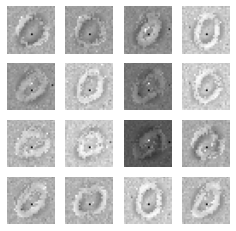

57
gen_loss: tf.Tensor(2.9733434, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.061070934, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08215341, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.49274037e-13]
 [1.00000000e+00 2.22522738e-13]
 [1.00000000e+00 3.84070553e-10]
 [1.00000000e+00 2.34881871e-11]
 [1.00000000e+00 1.28394968e-11]
 [1.00000000e+00 9.99594962e-10]
 [1.00000000e+00 4.14548604e-11]
 [1.00000000e+00 5.05862088e-11]
 [1.00000000e+00 3.67682551e-11]
 [1.00000000e+00 5.53606450e-09]
 [1.00000000e+00 1.05858996e-12]
 [1.00000000e+00 1.68717693e-10]
 [9.99964476e-01 3.55145348e-05]
 [1.00000000e+00 1.04101738e-09]
 [1.00000000e+00 1.15481333e-10]
 [1.00000000e+00 6.90844517e-12]
 [1.00000000e+00 7.77612350e-11]
 [1.00000000e+00 5.20579690e-11]
 [1.00000000e+00 1.79068338e-12]
 [1.00000000e+00 1.62330511e-12]
 [9.99994278e-01 5.70146631e-06]
 [1.00000000e+00 2.68937379e-13]
 [1.00000000e+00 1.02768002e-11]
 [1.00000000e+00 

gen_loss: tf.Tensor(2.9286907, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09552668, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.090779535, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.41022545e-12]
 [1.00000000e+00 1.67093756e-13]
 [1.00000000e+00 4.37592851e-10]
 [1.00000000e+00 4.06039993e-11]
 [1.00000000e+00 1.86996807e-11]
 [1.00000000e+00 1.28694211e-09]
 [1.00000000e+00 7.01563529e-11]
 [1.00000000e+00 6.76514261e-11]
 [1.00000000e+00 6.24285831e-11]
 [1.00000000e+00 7.46099360e-09]
 [1.00000000e+00 2.01704018e-12]
 [1.00000000e+00 2.05684830e-10]
 [9.99970675e-01 2.93698504e-05]
 [1.00000000e+00 9.22066923e-10]
 [1.00000000e+00 2.10188533e-10]
 [1.00000000e+00 1.00443117e-11]
 [1.00000000e+00 1.03450873e-10]
 [1.00000000e+00 1.22891725e-10]
 [1.00000000e+00 2.70580910e-12]
 [1.00000000e+00 3.66116209e-12]
 [9.99993801e-01 6.20597848e-06]
 [1.00000000e+00 2.19311142e-13]
 [1.00000000e+00 2.10929399e-11]
 [1.00000000e+00 3.3

gen_loss: tf.Tensor(3.0516925, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.093448944, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.076621905, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.57987294e-12]
 [1.00000000e+00 4.77402406e-13]
 [1.00000000e+00 3.82653464e-10]
 [1.00000000e+00 1.73032526e-11]
 [1.00000000e+00 9.24676048e-12]
 [1.00000000e+00 7.83269283e-10]
 [1.00000000e+00 4.13816308e-11]
 [1.00000000e+00 1.59741442e-10]
 [1.00000000e+00 4.19289603e-11]
 [1.00000000e+00 3.62619668e-09]
 [1.00000000e+00 2.61223118e-12]
 [1.00000000e+00 6.07824624e-11]
 [9.99968171e-01 3.18680686e-05]
 [1.00000000e+00 7.19734106e-10]
 [1.00000000e+00 1.36996303e-10]
 [1.00000000e+00 5.79109026e-12]
 [1.00000000e+00 5.55062871e-11]
 [1.00000000e+00 1.28180688e-10]
 [1.00000000e+00 2.82380044e-12]
 [1.00000000e+00 2.60208673e-12]
 [9.99995589e-01 4.35681750e-06]
 [1.00000000e+00 3.81598995e-13]
 [1.00000000e+00 1.16199350e-11]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.041388, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06227991, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.080408186, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.11879277e-12]
 [1.00000000e+00 5.03398538e-13]
 [1.00000000e+00 2.39331027e-10]
 [1.00000000e+00 6.79788994e-12]
 [1.00000000e+00 3.00891430e-12]
 [1.00000000e+00 3.73014453e-10]
 [1.00000000e+00 1.52048790e-11]
 [1.00000000e+00 1.01186746e-10]
 [1.00000000e+00 2.56129198e-11]
 [1.00000000e+00 1.49258295e-09]
 [1.00000000e+00 8.84402360e-13]
 [1.00000000e+00 5.23903629e-11]
 [9.99979138e-01 2.08345846e-05]
 [1.00000000e+00 3.23734595e-10]
 [1.00000000e+00 7.44665510e-11]
 [1.00000000e+00 2.67364299e-12]
 [1.00000000e+00 2.15446411e-11]
 [1.00000000e+00 4.60135194e-11]
 [1.00000000e+00 1.33026110e-12]
 [1.00000000e+00 8.78849836e-13]
 [9.99998212e-01 1.77623542e-06]
 [1.00000000e+00 4.09560732e-13]
 [1.00000000e+00 3.13382848e-12]
 [1.00000000e+00 3.86

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.36864001e-12]
 [1.00000000e+00 2.56591027e-13]
 [1.00000000e+00 1.91685709e-10]
 [1.00000000e+00 6.42062705e-12]
 [1.00000000e+00 2.65210792e-12]
 [1.00000000e+00 3.91473881e-10]
 [1.00000000e+00 1.30366161e-11]
 [1.00000000e+00 6.82015347e-11]
 [1.00000000e+00 2.38419215e-11]
 [1.00000000e+00 1.50213331e-09]
 [1.00000000e+00 6.76939516e-13]
 [1.00000000e+00 7.67427927e-11]
 [9.99982953e-01 1.70273452e-05]
 [1.00000000e+00 2.68581019e-10]
 [1.00000000e+00 6.63240782e-11]
 [1.00000000e+00 2.73556958e-12]
 [1.00000000e+00 1.95559870e-11]
 [1.00000000e+00 3.76383230e-11]
 [1.00000000e+00 8.84857942e-13]
 [1.00000000e+00 7.53298899e-13]
 [9.99998569e-01 1.43795978e-06]
 [1.00000000e+00 2.62361964e-13]
 [1.00000000e+00 2.40799221e-12]
 [1.00000000e+00 3.55361335e-12]
 [1.00000000e+00 1.45855099e-11]
 [1.00000000e+00 1.12114507e-09]
 [1.00000000e+00 2.80522632e-12]
 [1.00000000e+00 1.85269036e-10]
 [9.99562085e-01 4.37866664e-04]
 [1.0

gen_loss: tf.Tensor(3.0712075, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10241329, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07798462, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.35825867e-12]
 [1.00000000e+00 2.31391458e-13]
 [1.00000000e+00 1.85348556e-10]
 [1.00000000e+00 7.21853306e-12]
 [1.00000000e+00 2.94208451e-12]
 [1.00000000e+00 4.70608996e-10]
 [1.00000000e+00 1.36198986e-11]
 [1.00000000e+00 5.34797449e-11]
 [1.00000000e+00 2.73078001e-11]
 [1.00000000e+00 1.30223143e-09]
 [1.00000000e+00 5.82417469e-13]
 [1.00000000e+00 1.20074256e-10]
 [9.99988437e-01 1.15773828e-05]
 [1.00000000e+00 2.33848024e-10]
 [1.00000000e+00 7.75449913e-11]
 [1.00000000e+00 3.64164775e-12]
 [1.00000000e+00 1.99115550e-11]
 [1.00000000e+00 3.46118689e-11]
 [1.00000000e+00 8.07715657e-13]
 [1.00000000e+00 8.11074949e-13]
 [9.99999166e-01 8.33871468e-07]
 [1.00000000e+00 3.25042077e-13]
 [1.00000000e+00 2.21293730e-12]
 [1.00000000e+00 3.62

gen_loss: tf.Tensor(3.106679, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06301634, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.074609295, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.94492534e-12]
 [1.00000000e+00 5.29540116e-13]
 [1.00000000e+00 3.58371610e-10]
 [1.00000000e+00 1.01910702e-11]
 [1.00000000e+00 4.78842617e-12]
 [1.00000000e+00 7.13807624e-10]
 [1.00000000e+00 2.17848031e-11]
 [1.00000000e+00 1.04791974e-10]
 [1.00000000e+00 4.42229239e-11]
 [1.00000000e+00 1.42997325e-09]
 [1.00000000e+00 1.20996030e-12]
 [1.00000000e+00 1.33616701e-10]
 [9.99986053e-01 1.39050480e-05]
 [1.00000000e+00 4.65057909e-10]
 [1.00000000e+00 1.27469993e-10]
 [1.00000000e+00 6.36504998e-12]
 [1.00000000e+00 3.21021543e-11]
 [1.00000000e+00 4.96553978e-11]
 [1.00000000e+00 1.66644433e-12]
 [1.00000000e+00 1.34000417e-12]
 [9.99999046e-01 9.26040059e-07]
 [1.00000000e+00 6.73734723e-13]
 [1.00000000e+00 3.31106843e-12]
 [1.00000000e+00 4.89

 [1.00000000e+00 1.05838654e-11]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.0534134, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08080803, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.081207335, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.64887244e-12]
 [1.00000000e+00 5.07450256e-13]
 [1.00000000e+00 7.46598616e-10]
 [1.00000000e+00 2.18693154e-11]
 [1.00000000e+00 8.16154522e-12]
 [1.00000000e+00 1.71420789e-09]
 [1.00000000e+00 3.48704954e-11]
 [1.00000000e+00 1.37251308e-10]
 [1.00000000e+00 7.08668541e-11]
 [1.00000000e+00 4.19393231e-09]
 [1.00000000e+00 2.04226501e-12]
 [1.00000000e+00 3.56967622e-10]
 [9.99983191e-01 1.67817925e-05]
 [1.00000000e+00 1.02514963e-09]
 [1.00000000e+00 2.01880498e-10]
 [1.00000000e+00 1.46166169e-11]
 [1.00000000e+00 7.06179074e-11]
 [1.00000000e+00 7.91966909e-11]
 [1.00000000e+00 1.99962638e-12]
 [1.00000000e+00 2.39868672e-12]
 [9.99998093e-01 1.92732409e-06]
 [1.00000000e+00 6.6

gen_loss: tf.Tensor(3.018369, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07461876, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07793279, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.34635922e-12]
 [1.00000000e+00 6.11804227e-13]
 [1.00000000e+00 7.72023556e-10]
 [1.00000000e+00 2.28854297e-11]
 [1.00000000e+00 7.51579961e-12]
 [1.00000000e+00 2.00311079e-09]
 [1.00000000e+00 3.21879919e-11]
 [1.00000000e+00 1.44595683e-10]
 [1.00000000e+00 6.99439118e-11]
 [1.00000000e+00 5.50786972e-09]
 [1.00000000e+00 2.03099581e-12]
 [1.00000000e+00 4.21592150e-10]
 [9.99986649e-01 1.33667518e-05]
 [1.00000000e+00 8.22282020e-10]
 [1.00000000e+00 1.92958594e-10]
 [1.00000000e+00 1.70963486e-11]
 [1.00000000e+00 7.96326199e-11]
 [1.00000000e+00 7.69358049e-11]
 [1.00000000e+00 1.51392397e-12]
 [1.00000000e+00 2.45443683e-12]
 [9.99998212e-01 1.73053456e-06]
 [1.00000000e+00 8.91920435e-13]
 [1.00000000e+00 6.21768652e-12]
 [1.00000000e+00 1.088

gen_loss: tf.Tensor(3.190415, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.091679506, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07072304, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.02836574e-12]
 [1.00000000e+00 1.41522666e-12]
 [1.00000000e+00 1.54978363e-09]
 [1.00000000e+00 4.10396300e-11]
 [1.00000000e+00 1.31191551e-11]
 [1.00000000e+00 3.42123196e-09]
 [1.00000000e+00 5.54043200e-11]
 [1.00000000e+00 4.60588512e-10]
 [1.00000000e+00 1.15917838e-10]
 [1.00000000e+00 1.15269305e-08]
 [1.00000000e+00 7.83126602e-12]
 [1.00000000e+00 4.62096722e-10]
 [9.99981046e-01 1.89045659e-05]
 [1.00000000e+00 9.96425498e-10]
 [1.00000000e+00 3.43775342e-10]
 [1.00000000e+00 2.97844180e-11]
 [1.00000000e+00 1.55118460e-10]
 [1.00000000e+00 1.55206056e-10]
 [1.00000000e+00 3.15207626e-12]
 [1.00000000e+00 5.44060977e-12]
 [9.99998093e-01 1.88136733e-06]
 [1.00000000e+00 1.97312089e-12]
 [1.00000000e+00 1.45485004e-11]
 [1.00000000e+00 1.91

gen_loss: tf.Tensor(3.1635711, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06142983, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07002525, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.29283474e-12]
 [1.00000000e+00 1.33284399e-12]
 [1.00000000e+00 3.19517324e-09]
 [1.00000000e+00 5.74363786e-11]
 [1.00000000e+00 1.60310307e-11]
 [1.00000000e+00 3.07401660e-09]
 [1.00000000e+00 7.93898280e-11]
 [1.00000000e+00 6.66549815e-10]
 [1.00000000e+00 1.55362737e-10]
 [1.00000000e+00 1.00979776e-08]
 [1.00000000e+00 1.35942048e-11]
 [1.00000000e+00 4.18395874e-10]
 [9.99956965e-01 4.29896063e-05]
 [1.00000000e+00 1.00147657e-09]
 [1.00000000e+00 5.47087597e-10]
 [1.00000000e+00 2.48303877e-11]
 [1.00000000e+00 1.51528609e-10]
 [1.00000000e+00 1.83388457e-10]
 [1.00000000e+00 6.30828115e-12]
 [1.00000000e+00 6.59502704e-12]
 [9.99996305e-01 3.73983380e-06]
 [1.00000000e+00 1.53524437e-12]
 [1.00000000e+00 1.80763304e-11]
 [1.00000000e+00 2.60

gen_loss: tf.Tensor(2.9795384, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08107972, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0773125, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.14699438e-12]
 [1.00000000e+00 9.07458624e-13]
 [1.00000000e+00 3.24633187e-09]
 [1.00000000e+00 4.46623571e-11]
 [1.00000000e+00 1.19794652e-11]
 [1.00000000e+00 1.87343296e-09]
 [1.00000000e+00 6.60210359e-11]
 [1.00000000e+00 3.99496658e-10]
 [1.00000000e+00 1.31878036e-10]
 [1.00000000e+00 5.19390042e-09]
 [1.00000000e+00 7.91329328e-12]
 [1.00000000e+00 3.46879581e-10]
 [9.99951124e-01 4.88444566e-05]
 [1.00000000e+00 5.51486801e-10]
 [1.00000000e+00 5.47808077e-10]
 [1.00000000e+00 1.51202592e-11]
 [1.00000000e+00 7.80783910e-11]
 [1.00000000e+00 1.20848095e-10]
 [1.00000000e+00 5.97429224e-12]
 [1.00000000e+00 3.99210612e-12]
 [9.99995947e-01 4.09665199e-06]
 [1.00000000e+00 1.19551949e-12]
 [1.00000000e+00 1.08226275e-11]
 [1.00000000e+00 1.859

 [1.00000000e+00 2.15435725e-11]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.1128728, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08664088, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06839957, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.59615268e-12]
 [1.00000000e+00 7.36312053e-13]
 [1.00000000e+00 2.59923838e-09]
 [1.00000000e+00 3.67674155e-11]
 [1.00000000e+00 1.06798650e-11]
 [1.00000000e+00 1.98513561e-09]
 [1.00000000e+00 5.70783906e-11]
 [1.00000000e+00 2.84658047e-10]
 [1.00000000e+00 1.10251079e-10]
 [1.00000000e+00 4.84188467e-09]
 [1.00000000e+00 5.09528964e-12]
 [1.00000000e+00 4.06325307e-10]
 [9.99976277e-01 2.36868200e-05]
 [1.00000000e+00 4.74975337e-10]
 [1.00000000e+00 4.74336181e-10]
 [1.00000000e+00 1.58147957e-11]
 [1.00000000e+00 5.98638639e-11]
 [1.00000000e+00 1.13644996e-10]
 [1.00000000e+00 3.91469019e-12]
 [1.00000000e+00 2.99454363e-12]
 [9.99996543e-01 3.45784497e-06]
 [1.00000000e+00 1.32

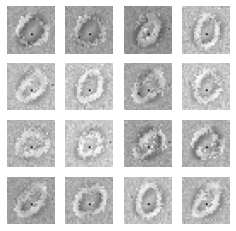

58
gen_loss: tf.Tensor(3.1573656, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.054136246, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06698998, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.64877139e-12]
 [1.00000000e+00 9.35960944e-13]
 [1.00000000e+00 2.59416177e-09]
 [1.00000000e+00 3.64160091e-11]
 [1.00000000e+00 1.13414538e-11]
 [1.00000000e+00 2.38071385e-09]
 [1.00000000e+00 6.02498954e-11]
 [1.00000000e+00 3.25871885e-10]
 [1.00000000e+00 1.11850237e-10]
 [1.00000000e+00 5.42397771e-09]
 [1.00000000e+00 5.04973971e-12]
 [1.00000000e+00 4.89962959e-10]
 [9.99983549e-01 1.64700214e-05]
 [1.00000000e+00 5.49550516e-10]
 [1.00000000e+00 4.74886575e-10]
 [1.00000000e+00 1.89976732e-11]
 [1.00000000e+00 6.29466687e-11]
 [1.00000000e+00 1.26134714e-10]
 [1.00000000e+00 3.82615120e-12]
 [1.00000000e+00 2.89190655e-12]
 [9.99997020e-01 2.93380253e-06]
 [1.00000000e+00 1.95525822e-12]
 [1.00000000e+00 6.62655000e-12]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.207527, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07072082, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.065120846, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.07916409e-12]
 [1.00000000e+00 9.75708121e-13]
 [1.00000000e+00 3.73280118e-09]
 [1.00000000e+00 5.42210027e-11]
 [1.00000000e+00 1.60391648e-11]
 [1.00000000e+00 3.62543595e-09]
 [1.00000000e+00 8.81338474e-11]
 [1.00000000e+00 4.33638764e-10]
 [1.00000000e+00 1.61165747e-10]
 [1.00000000e+00 8.42834602e-09]
 [1.00000000e+00 6.70504537e-12]
 [1.00000000e+00 7.76590015e-10]
 [9.99984384e-01 1.56438618e-05]
 [1.00000000e+00 8.57819871e-10]
 [1.00000000e+00 6.84322043e-10]
 [1.00000000e+00 2.99442519e-11]
 [1.00000000e+00 9.89802892e-11]
 [1.00000000e+00 1.80434431e-10]
 [1.00000000e+00 5.61855120e-12]
 [1.00000000e+00 3.96422868e-12]
 [9.99996066e-01 3.88746093e-06]
 [1.00000000e+00 2.07178068e-12]
 [1.00000000e+00 9.46382122e-12]
 [1.00000000e+00 2.02

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.46577020e-12]
 [1.00000000e+00 1.11152559e-12]
 [1.00000000e+00 6.72924427e-09]
 [1.00000000e+00 1.34023556e-10]
 [1.00000000e+00 3.73293271e-11]
 [1.00000000e+00 7.52012763e-09]
 [1.00000000e+00 2.08362785e-10]
 [1.00000000e+00 8.29664393e-10]
 [1.00000000e+00 3.69576897e-10]
 [1.00000000e+00 1.93340455e-08]
 [1.00000000e+00 1.50711665e-11]
 [1.00000000e+00 1.86529991e-09]
 [9.99982476e-01 1.74810739e-05]
 [1.00000000e+00 1.68347791e-09]
 [1.00000000e+00 1.56016711e-09]
 [1.00000000e+00 6.97672337e-11]
 [1.00000000e+00 2.40269110e-10]
 [1.00000000e+00 3.55349500e-10]
 [1.00000000e+00 1.34979874e-11]
 [1.00000000e+00 8.48109777e-12]
 [9.99994993e-01 5.00465421e-06]
 [1.00000000e+00 2.53074601e-12]
 [1.00000000e+00 2.27768672e-11]
 [1.00000000e+00 5.05138015e-11]
 [1.00000000e+00 9.49079565e-11]
 [1.00000000e+00 1.70580368e-08]
 [1.00000000e+00 1.62052566e-10]
 [1.00000000e+00 9.14272102e-10]
 [9.99746382e-01 2.53607141e-04]
 [1.0

gen_loss: tf.Tensor(2.9241347, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.053594165, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08985936, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.92533530e-12]
 [1.00000000e+00 3.15614895e-12]
 [1.00000000e+00 1.02233058e-08]
 [1.00000000e+00 1.46278642e-10]
 [1.00000000e+00 3.81811943e-11]
 [1.00000000e+00 7.80501797e-09]
 [1.00000000e+00 2.82775414e-10]
 [1.00000000e+00 1.17710552e-09]
 [1.00000000e+00 6.07542128e-10]
 [1.00000000e+00 1.76431101e-08]
 [1.00000000e+00 1.43094581e-11]
 [1.00000000e+00 2.91010971e-09]
 [9.99989271e-01 1.07444075e-05]
 [1.00000000e+00 1.57784441e-09]
 [1.00000000e+00 2.38250353e-09]
 [1.00000000e+00 8.86521134e-11]
 [1.00000000e+00 3.01266151e-10]
 [1.00000000e+00 3.30415750e-10]
 [1.00000000e+00 2.38037541e-11]
 [1.00000000e+00 8.57320118e-12]
 [9.99997258e-01 2.74480567e-06]
 [1.00000000e+00 7.54571926e-12]
 [1.00000000e+00 2.27016166e-11]
 [1.00000000e+00 5.4

 [1.00000000e+00 6.90739480e-11]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.2037303, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1051727, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07030493, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.74042722e-12]
 [1.00000000e+00 2.54122764e-12]
 [1.00000000e+00 1.00338529e-08]
 [1.00000000e+00 1.37744607e-10]
 [1.00000000e+00 3.93235305e-11]
 [1.00000000e+00 8.53459614e-09]
 [1.00000000e+00 2.77248391e-10]
 [1.00000000e+00 8.36209824e-10]
 [1.00000000e+00 6.02019101e-10]
 [1.00000000e+00 2.90553004e-08]
 [1.00000000e+00 1.31524782e-11]
 [1.00000000e+00 4.20971258e-09]
 [9.99992371e-01 7.58805936e-06]
 [1.00000000e+00 1.82633519e-09]
 [1.00000000e+00 2.07194573e-09]
 [1.00000000e+00 1.05047124e-10]
 [1.00000000e+00 2.86465240e-10]
 [1.00000000e+00 3.65292102e-10]
 [1.00000000e+00 1.61351436e-11]
 [1.00000000e+00 1.06898500e-11]
 [9.99997377e-01 2.63561924e-06]
 [1.00000000e+00 7.088

gen_loss: tf.Tensor(3.0466325, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.058738325, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07090489, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.89781956e-12]
 [1.00000000e+00 1.01449654e-12]
 [1.00000000e+00 1.29494024e-08]
 [1.00000000e+00 2.98717634e-10]
 [1.00000000e+00 8.04009082e-11]
 [1.00000000e+00 1.55836570e-08]
 [1.00000000e+00 5.03007691e-10]
 [1.00000000e+00 7.81541165e-10]
 [1.00000000e+00 9.34964994e-10]
 [9.99999881e-01 8.30068743e-08]
 [1.00000000e+00 2.11157238e-11]
 [1.00000000e+00 9.56980450e-09]
 [9.99989629e-01 1.03669709e-05]
 [1.00000000e+00 3.23896576e-09]
 [1.00000000e+00 3.15924353e-09]
 [1.00000000e+00 1.90794228e-10]
 [1.00000000e+00 4.90540830e-10]
 [1.00000000e+00 6.96630198e-10]
 [1.00000000e+00 1.78201637e-11]
 [1.00000000e+00 2.39493477e-11]
 [9.99994755e-01 5.21447828e-06]
 [1.00000000e+00 3.38680950e-12]
 [1.00000000e+00 5.53002227e-11]
 [1.00000000e+00 1.2

gen_loss: tf.Tensor(3.067488, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06336217, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08101039, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.88670734e-12]
 [1.00000000e+00 1.26012666e-12]
 [1.00000000e+00 1.16899770e-08]
 [1.00000000e+00 3.25226124e-10]
 [1.00000000e+00 1.30995839e-10]
 [1.00000000e+00 1.53345070e-08]
 [1.00000000e+00 7.28684946e-10]
 [1.00000000e+00 7.80949638e-10]
 [1.00000000e+00 1.18812660e-09]
 [9.99999881e-01 7.11188122e-08]
 [1.00000000e+00 2.40130641e-11]
 [1.00000000e+00 7.47428253e-09]
 [9.99985337e-01 1.46722832e-05]
 [1.00000000e+00 3.79148268e-09]
 [1.00000000e+00 3.86733268e-09]
 [1.00000000e+00 2.40311299e-10]
 [1.00000000e+00 5.31046984e-10]
 [1.00000000e+00 7.72549413e-10]
 [1.00000000e+00 2.29308274e-11]
 [1.00000000e+00 3.49514653e-11]
 [9.99994755e-01 5.27440534e-06]
 [1.00000000e+00 5.26284051e-12]
 [1.00000000e+00 7.90168347e-11]
 [1.00000000e+00 1.404

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.54680522e-11]
 [1.00000000e+00 2.92802197e-12]
 [1.00000000e+00 1.11998926e-08]
 [1.00000000e+00 3.03991748e-10]
 [1.00000000e+00 1.69825418e-10]
 [1.00000000e+00 1.48572710e-08]
 [1.00000000e+00 8.92047658e-10]
 [1.00000000e+00 1.22259380e-09]
 [1.00000000e+00 1.40848844e-09]
 [1.00000000e+00 4.97377499e-08]
 [1.00000000e+00 3.22191336e-11]
 [1.00000000e+00 4.65728345e-09]
 [9.99981761e-01 1.82826789e-05]
 [1.00000000e+00 4.06525524e-09]
 [1.00000000e+00 4.58267468e-09]
 [1.00000000e+00 2.63606331e-10]
 [1.00000000e+00 5.54231605e-10]
 [1.00000000e+00 8.35348957e-10]
 [1.00000000e+00 3.53746615e-11]
 [1.00000000e+00 4.06317341e-11]
 [9.99996066e-01 3.94153903e-06]
 [1.00000000e+00 1.24023829e-11]
 [1.00000000e+00 8.89088247e-11]
 [1.00000000e+00 1.29648112e-10]
 [1.00000000e+00 3.32925937e-10]
 [1.00000000e+00 2.98535667e-08]
 [1.00000000e+00 5.16099385e-10]
 [1.00000000e+00 1.29055555e-09]
 [9.99823034e-01 1.77050111e-04]
 [1.0

gen_loss: tf.Tensor(3.0378852, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10235304, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0812701, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.46368818e-11]
 [1.00000000e+00 5.12162665e-12]
 [1.00000000e+00 2.60443063e-08]
 [1.00000000e+00 1.27160438e-09]
 [1.00000000e+00 8.67281247e-10]
 [9.99999881e-01 6.36211297e-08]
 [1.00000000e+00 3.92877375e-09]
 [1.00000000e+00 6.91797597e-09]
 [1.00000000e+00 5.08169018e-09]
 [9.99999762e-01 2.31145961e-07]
 [1.00000000e+00 2.12465073e-10]
 [1.00000000e+00 9.71670744e-09]
 [9.99961019e-01 3.90202404e-05]
 [1.00000000e+00 1.29748177e-08]
 [1.00000000e+00 1.85801809e-08]
 [1.00000000e+00 1.23196409e-09]
 [1.00000000e+00 2.52623567e-09]
 [1.00000000e+00 5.28220712e-09]
 [1.00000000e+00 1.23245705e-10]
 [1.00000000e+00 2.58361804e-10]
 [9.99992371e-01 7.65342429e-06]
 [1.00000000e+00 1.87764145e-11]
 [1.00000000e+00 5.98087690e-10]
 [1.00000000e+00 5.072

gen_loss: tf.Tensor(3.14824, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.068814725, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06656214, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.56511556e-11]
 [1.00000000e+00 3.61275680e-12]
 [1.00000000e+00 3.75741820e-08]
 [1.00000000e+00 1.99318650e-09]
 [1.00000000e+00 1.01017872e-09]
 [9.99999881e-01 1.31550493e-07]
 [1.00000000e+00 5.26671418e-09]
 [1.00000000e+00 8.89757512e-09]
 [1.00000000e+00 7.26613214e-09]
 [9.99999523e-01 5.32289278e-07]
 [1.00000000e+00 2.24672517e-10]
 [1.00000000e+00 2.94583575e-08]
 [9.99966860e-01 3.31318151e-05]
 [1.00000000e+00 1.46508308e-08]
 [1.00000000e+00 2.71076335e-08]
 [1.00000000e+00 2.42828979e-09]
 [1.00000000e+00 5.64310021e-09]
 [1.00000000e+00 7.46985052e-09]
 [1.00000000e+00 1.00631670e-10]
 [1.00000000e+00 4.04792144e-10]
 [9.99989390e-01 1.05776107e-05]
 [1.00000000e+00 1.44564716e-11]
 [1.00000000e+00 9.58302437e-10]
 [1.00000000e+00 7.699

gen_loss: tf.Tensor(3.1059504, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08428367, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06978953, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.43008191e-11]
 [1.00000000e+00 5.33017120e-12]
 [9.99999881e-01 7.89438843e-08]
 [1.00000000e+00 1.83869786e-09]
 [1.00000000e+00 9.50921009e-10]
 [9.99999881e-01 1.09085299e-07]
 [1.00000000e+00 6.13914253e-09]
 [1.00000000e+00 1.01384092e-08]
 [1.00000000e+00 9.10895714e-09]
 [9.99999642e-01 4.15671252e-07]
 [1.00000000e+00 1.52487412e-10]
 [1.00000000e+00 3.15247952e-08]
 [9.99958515e-01 4.14858550e-05]
 [1.00000000e+00 1.78987438e-08]
 [1.00000000e+00 3.63364130e-08]
 [1.00000000e+00 2.41460962e-09]
 [1.00000000e+00 7.26966709e-09]
 [1.00000000e+00 3.68178377e-09]
 [1.00000000e+00 2.09367496e-10]
 [1.00000000e+00 3.35056205e-10]
 [9.99984264e-01 1.57383729e-05]
 [1.00000000e+00 1.86836380e-11]
 [1.00000000e+00 8.68602301e-10]
 [1.00000000e+00 7.07

gen_loss: tf.Tensor(3.154603, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.059851743, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06363625, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.37240346e-11]
 [1.00000000e+00 1.68370734e-11]
 [9.99999881e-01 8.32486720e-08]
 [1.00000000e+00 1.45036316e-09]
 [1.00000000e+00 1.12201570e-09]
 [9.99999881e-01 1.01941410e-07]
 [1.00000000e+00 6.83311585e-09]
 [1.00000000e+00 2.04664428e-08]
 [1.00000000e+00 9.07863829e-09]
 [9.99999523e-01 4.58697059e-07]
 [1.00000000e+00 2.36977604e-10]
 [1.00000000e+00 1.68906222e-08]
 [9.99961138e-01 3.88952976e-05]
 [1.00000000e+00 2.87703035e-08]
 [1.00000000e+00 3.52811895e-08]
 [1.00000000e+00 2.70488432e-09]
 [1.00000000e+00 9.70294689e-09]
 [1.00000000e+00 2.91126434e-09]
 [1.00000000e+00 3.24331617e-10]
 [1.00000000e+00 3.57664148e-10]
 [9.99987006e-01 1.29912851e-05]
 [1.00000000e+00 4.98853181e-11]
 [1.00000000e+00 8.92045993e-10]
 [1.00000000e+00 5.71

gen_loss: tf.Tensor(3.1252282, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0952314, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.067883424, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.57412833e-10]
 [1.00000000e+00 2.56176105e-11]
 [9.99999881e-01 9.11573892e-08]
 [1.00000000e+00 2.09041184e-09]
 [1.00000000e+00 1.84422622e-09]
 [9.99999881e-01 1.45826448e-07]
 [1.00000000e+00 1.08822586e-08]
 [1.00000000e+00 2.49613876e-08]
 [1.00000000e+00 1.35291955e-08]
 [9.99999166e-01 8.60593332e-07]
 [1.00000000e+00 3.28660876e-10]
 [1.00000000e+00 2.56845318e-08]
 [9.99972582e-01 2.73804635e-05]
 [1.00000000e+00 5.19644985e-08]
 [1.00000000e+00 5.05480919e-08]
 [1.00000000e+00 4.39193482e-09]
 [1.00000000e+00 1.65033178e-08]
 [1.00000000e+00 3.17566418e-09]
 [1.00000000e+00 4.47318599e-10]
 [1.00000000e+00 5.56254376e-10]
 [9.99989152e-01 1.08691911e-05]
 [1.00000000e+00 7.65009237e-11]
 [1.00000000e+00 1.31931688e-09]
 [1.00000000e+00 8.67

gen_loss: tf.Tensor(3.0927668, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.068189315, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0756471, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.43548437e-10]
 [1.00000000e+00 2.10919754e-11]
 [9.99999881e-01 1.61005900e-07]
 [1.00000000e+00 5.68560266e-09]
 [1.00000000e+00 3.10290482e-09]
 [9.99999762e-01 2.20350557e-07]
 [1.00000000e+00 2.08795825e-08]
 [1.00000000e+00 2.01052615e-08]
 [1.00000000e+00 2.98435481e-08]
 [9.99998331e-01 1.70772000e-06]
 [1.00000000e+00 3.16178583e-10]
 [9.99999881e-01 1.06476058e-07]
 [9.99971986e-01 2.79737033e-05]
 [9.99999881e-01 6.07327166e-08]
 [9.99999881e-01 1.15554755e-07]
 [1.00000000e+00 7.62584396e-09]
 [1.00000000e+00 3.13133732e-08]
 [1.00000000e+00 3.65219832e-09]
 [1.00000000e+00 8.17496737e-10]
 [1.00000000e+00 9.81619341e-10]
 [9.99985814e-01 1.42446388e-05]
 [1.00000000e+00 7.22619603e-11]
 [1.00000000e+00 2.59096744e-09]
 [1.00000000e+00 2.35

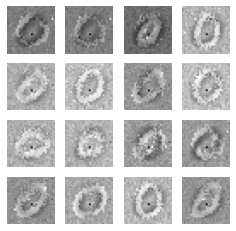

59
gen_loss: tf.Tensor(3.1502023, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10121744, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.065500535, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.45966489e-10]
 [1.00000000e+00 2.66362713e-11]
 [9.99999881e-01 1.47552299e-07]
 [1.00000000e+00 5.06723019e-09]
 [1.00000000e+00 2.38228548e-09]
 [9.99999762e-01 1.88446535e-07]
 [1.00000000e+00 1.72189640e-08]
 [1.00000000e+00 2.28446435e-08]
 [1.00000000e+00 2.67322005e-08]
 [9.99998569e-01 1.41934322e-06]
 [1.00000000e+00 2.76743295e-10]
 [9.99999881e-01 9.91039713e-08]
 [9.99971271e-01 2.87750918e-05]
 [1.00000000e+00 4.24705533e-08]
 [9.99999881e-01 1.01448158e-07]
 [1.00000000e+00 7.12740000e-09]
 [1.00000000e+00 2.94607734e-08]
 [1.00000000e+00 3.22381610e-09]
 [1.00000000e+00 7.45936757e-10]
 [1.00000000e+00 8.73343509e-10]
 [9.99987006e-01 1.29962418e-05]
 [1.00000000e+00 8.40700010e-11]
 [1.00000000e+00 2.29485697e-09]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.0211031, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07483795, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0738835, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.93054062e-10]
 [1.00000000e+00 7.84533827e-11]
 [9.99999762e-01 2.08620534e-07]
 [1.00000000e+00 1.38926275e-08]
 [1.00000000e+00 5.60038149e-09]
 [9.99999523e-01 5.32517788e-07]
 [1.00000000e+00 3.55307179e-08]
 [9.99999881e-01 9.68601341e-08]
 [1.00000000e+00 5.54928192e-08]
 [9.99994278e-01 5.77773017e-06]
 [1.00000000e+00 9.82361081e-10]
 [9.99999762e-01 2.31241657e-07]
 [9.99958992e-01 4.09775312e-05]
 [9.99999881e-01 8.72032686e-08]
 [9.99999762e-01 2.03864246e-07]
 [1.00000000e+00 2.21433076e-08]
 [9.99999881e-01 8.61853451e-08]
 [1.00000000e+00 1.39532013e-08]
 [1.00000000e+00 1.32141220e-09]
 [1.00000000e+00 3.09367998e-09]
 [9.99980807e-01 1.91412346e-05]
 [1.00000000e+00 2.05718581e-10]
 [1.00000000e+00 8.01416267e-09]
 [1.00000000e+00 5.806

gen_loss: tf.Tensor(3.0860133, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.071804106, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07782948, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.33680450e-10]
 [1.00000000e+00 7.41585543e-11]
 [9.99999523e-01 4.17291716e-07]
 [9.99999881e-01 6.80625831e-08]
 [1.00000000e+00 2.29960335e-08]
 [9.99998331e-01 1.63776724e-06]
 [9.99999881e-01 1.37802090e-07]
 [9.99999762e-01 2.11440124e-07]
 [9.99999762e-01 1.84586398e-07]
 [9.99979973e-01 2.00059294e-05]
 [1.00000000e+00 3.08144843e-09]
 [9.99999046e-01 9.64625201e-07]
 [9.99934196e-01 6.57786513e-05]
 [9.99999762e-01 2.40232310e-07]
 [9.99999285e-01 7.54413634e-07]
 [9.99999881e-01 7.57245076e-08]
 [9.99999642e-01 3.02206587e-07]
 [1.00000000e+00 5.06539664e-08]
 [1.00000000e+00 4.75209383e-09]
 [1.00000000e+00 1.29628459e-08]
 [9.99950767e-01 4.91923784e-05]
 [1.00000000e+00 2.35063496e-10]
 [1.00000000e+00 3.73528835e-08]
 [1.00000000e+00 2.8

gen_loss: tf.Tensor(3.2347765, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08479389, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06203131, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.93693753e-10]
 [1.00000000e+00 3.92523444e-11]
 [9.99999642e-01 3.95520459e-07]
 [9.99999881e-01 8.01020761e-08]
 [1.00000000e+00 2.50505785e-08]
 [9.99998927e-01 1.12314456e-06]
 [9.99999881e-01 1.72345793e-07]
 [9.99999881e-01 1.01678097e-07]
 [9.99999762e-01 2.37118542e-07]
 [9.99988675e-01 1.12842654e-05]
 [1.00000000e+00 1.82973470e-09]
 [9.99998808e-01 1.13796921e-06]
 [9.99930739e-01 6.92152316e-05]
 [9.99999881e-01 1.46516200e-07]
 [9.99999046e-01 9.72196403e-07]
 [9.99999881e-01 6.86606754e-08]
 [9.99999762e-01 2.75677877e-07]
 [1.00000000e+00 3.54165728e-08]
 [1.00000000e+00 5.59848079e-09]
 [1.00000000e+00 1.28452484e-08]
 [9.99926448e-01 7.35007270e-05]
 [1.00000000e+00 1.75545412e-10]
 [1.00000000e+00 3.65548978e-08]
 [1.00000000e+00 3.25

gen_loss: tf.Tensor(3.2702856, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06425466, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06491893, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.33048083e-10]
 [1.00000000e+00 1.17577212e-10]
 [9.99999642e-01 3.97879660e-07]
 [1.00000000e+00 5.82573385e-08]
 [1.00000000e+00 2.27988064e-08]
 [9.99999046e-01 9.99421104e-07]
 [9.99999881e-01 1.59004983e-07]
 [9.99999881e-01 1.56722223e-07]
 [9.99999762e-01 2.31788988e-07]
 [9.99989033e-01 1.09334187e-05]
 [1.00000000e+00 2.21138774e-09]
 [9.99999404e-01 6.09383335e-07]
 [9.99938369e-01 6.16129837e-05]
 [9.99999881e-01 1.46812724e-07]
 [9.99999166e-01 8.91206469e-07]
 [9.99999881e-01 6.09737896e-08]
 [9.99999762e-01 2.51976047e-07]
 [1.00000000e+00 3.96734556e-08]
 [1.00000000e+00 6.37515640e-09]
 [1.00000000e+00 1.47316443e-08]
 [9.99922633e-01 7.74007785e-05]
 [1.00000000e+00 4.46576082e-10]
 [1.00000000e+00 3.33730554e-08]
 [1.00000000e+00 2.29

gen_loss: tf.Tensor(3.1962545, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.080841795, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.062017903, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.30479472e-09]
 [1.00000000e+00 1.62595312e-10]
 [9.99999285e-01 7.61539468e-07]
 [9.99999881e-01 1.17284735e-07]
 [1.00000000e+00 3.90935568e-08]
 [9.99998212e-01 1.80476468e-06]
 [9.99999762e-01 2.55266428e-07]
 [9.99999762e-01 2.81503617e-07]
 [9.99999523e-01 4.48029908e-07]
 [9.99973536e-01 2.65167291e-05]
 [1.00000000e+00 3.20940452e-09]
 [9.99999046e-01 1.00655006e-06]
 [9.99888301e-01 1.11694404e-04]
 [9.99999762e-01 1.93794435e-07]
 [9.99998212e-01 1.77902928e-06]
 [9.99999881e-01 9.58749382e-08]
 [9.99999523e-01 4.48384270e-07]
 [9.99999881e-01 6.88446562e-08]
 [1.00000000e+00 1.44705359e-08]
 [1.00000000e+00 3.12124797e-08]
 [9.99840975e-01 1.59045914e-04]
 [1.00000000e+00 5.45476719e-10]
 [9.99999881e-01 6.54548913e-08]
 [1.00000000e+00 4.

gen_loss: tf.Tensor(3.2594, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.088251226, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06050624, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.04756448e-09]
 [1.00000000e+00 2.06996975e-10]
 [9.99999166e-01 8.78949834e-07]
 [9.99999881e-01 1.58895688e-07]
 [1.00000000e+00 4.05505034e-08]
 [9.99997973e-01 2.04072126e-06]
 [9.99999762e-01 2.67091707e-07]
 [9.99999762e-01 2.87420647e-07]
 [9.99999404e-01 5.81104018e-07]
 [9.99967337e-01 3.26046102e-05]
 [1.00000000e+00 2.36870190e-09]
 [9.99998689e-01 1.32091861e-06]
 [9.99880672e-01 1.19281947e-04]
 [9.99999881e-01 1.39671329e-07]
 [9.99997735e-01 2.28658223e-06]
 [9.99999881e-01 1.03093114e-07]
 [9.99999523e-01 5.05228400e-07]
 [9.99999881e-01 6.56222738e-08]
 [1.00000000e+00 1.75782144e-08]
 [1.00000000e+00 3.57889718e-08]
 [9.99806464e-01 1.93562417e-04]
 [1.00000000e+00 7.37737205e-10]
 [9.99999881e-01 6.90909090e-08]
 [9.99999881e-01 6.2647

gen_loss: tf.Tensor(3.32692, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07962215, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.056439355, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.34787315e-09]
 [1.00000000e+00 4.49356385e-10]
 [9.99999404e-01 6.01277179e-07]
 [9.99999881e-01 1.21254615e-07]
 [1.00000000e+00 3.74130664e-08]
 [9.99997854e-01 2.14016904e-06]
 [9.99999762e-01 2.24201912e-07]
 [9.99999762e-01 2.76758698e-07]
 [9.99999523e-01 4.96811026e-07]
 [9.99976516e-01 2.35071129e-05]
 [1.00000000e+00 2.16687090e-09]
 [9.99999046e-01 9.50138372e-07]
 [9.99941230e-01 5.87346403e-05]
 [9.99999881e-01 1.40972205e-07]
 [9.99998093e-01 1.87420426e-06]
 [9.99999881e-01 1.04734568e-07]
 [9.99999523e-01 4.98817826e-07]
 [1.00000000e+00 5.46551000e-08]
 [1.00000000e+00 1.46726435e-08]
 [1.00000000e+00 2.93234255e-08]
 [9.99868155e-01 1.31814537e-04]
 [1.00000000e+00 1.85538951e-09]
 [1.00000000e+00 4.53398030e-08]
 [1.00000000e+00 4.421

gen_loss: tf.Tensor(3.1883166, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08218732, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.059551567, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.68039724e-09]
 [1.00000000e+00 3.85566412e-10]
 [9.99998689e-01 1.32253206e-06]
 [9.99999642e-01 4.10974309e-07]
 [9.99999881e-01 1.41624270e-07]
 [9.99994993e-01 4.95120912e-06]
 [9.99999285e-01 6.67056554e-07]
 [9.99999523e-01 4.72647883e-07]
 [9.99998569e-01 1.44223100e-06]
 [9.99945045e-01 5.49292745e-05]
 [1.00000000e+00 8.27215629e-09]
 [9.99997854e-01 2.14730608e-06]
 [9.99897480e-01 1.02471487e-04]
 [9.99999523e-01 4.19912908e-07]
 [9.99994278e-01 5.77679930e-06]
 [9.99999762e-01 2.86633963e-07]
 [9.99998569e-01 1.46140417e-06]
 [9.99999881e-01 1.48025720e-07]
 [1.00000000e+00 5.61046676e-08]
 [9.99999881e-01 9.69569811e-08]
 [9.99582827e-01 4.17195231e-04]
 [1.00000000e+00 1.41763046e-09]
 [9.99999881e-01 1.58110709e-07]
 [9.99999881e-01 1.4

gen_loss: tf.Tensor(3.2273364, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06221228, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061834127, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.56422750e-09]
 [1.00000000e+00 4.90211649e-10]
 [9.99997616e-01 2.39367023e-06]
 [9.99999285e-01 7.53265510e-07]
 [9.99999762e-01 2.53509256e-07]
 [9.99994874e-01 5.07786399e-06]
 [9.99998927e-01 1.12639145e-06]
 [9.99999523e-01 4.68496751e-07]
 [9.99996781e-01 3.22318965e-06]
 [9.99941111e-01 5.89098818e-05]
 [1.00000000e+00 1.02151390e-08]
 [9.99994993e-01 5.04661966e-06]
 [9.99858141e-01 1.41833079e-04]
 [9.99999642e-01 4.14094131e-07]
 [9.99987125e-01 1.28977381e-05]
 [9.99999642e-01 4.09688425e-07]
 [9.99998093e-01 1.95115899e-06]
 [9.99999881e-01 1.67358664e-07]
 [9.99999881e-01 1.07373403e-07]
 [9.99999881e-01 1.47987336e-07]
 [9.99276340e-01 7.23638281e-04]
 [1.00000000e+00 1.52051838e-09]
 [9.99999762e-01 2.30986416e-07]
 [9.99999762e-01 2.4

gen_loss: tf.Tensor(3.0234272, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07681342, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.091821715, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.98902325e-10]
 [1.00000000e+00 8.56898788e-11]
 [9.99999642e-01 3.92450346e-07]
 [9.99999881e-01 9.68254028e-08]
 [1.00000000e+00 2.03594510e-08]
 [9.99999046e-01 9.33507863e-07]
 [9.99999881e-01 1.49097374e-07]
 [1.00000000e+00 4.76075144e-08]
 [9.99999404e-01 5.68695555e-07]
 [9.99993324e-01 6.66259439e-06]
 [1.00000000e+00 1.03299491e-09]
 [9.99997616e-01 2.41404814e-06]
 [9.99940991e-01 5.89744595e-05]
 [1.00000000e+00 2.06329052e-08]
 [9.99997854e-01 2.19765161e-06]
 [1.00000000e+00 5.83246020e-08]
 [9.99999642e-01 3.91161251e-07]
 [1.00000000e+00 1.28643727e-08]
 [1.00000000e+00 8.61705196e-09]
 [1.00000000e+00 1.15583036e-08]
 [9.99808967e-01 1.91080995e-04]
 [1.00000000e+00 5.07322351e-10]
 [1.00000000e+00 1.50079948e-08]
 [1.00000000e+00 3.1

gen_loss: tf.Tensor(3.0077205, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08582843, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07992024, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.55024724e-10]
 [1.00000000e+00 2.35355985e-10]
 [9.99999523e-01 4.88239550e-07]
 [1.00000000e+00 4.68729127e-08]
 [1.00000000e+00 1.00984590e-08]
 [9.99999166e-01 8.45297961e-07]
 [9.99999881e-01 7.76125759e-08]
 [9.99999881e-01 8.38668797e-08]
 [9.99999642e-01 2.98359510e-07]
 [9.99996066e-01 3.91675530e-06]
 [1.00000000e+00 1.33666478e-09]
 [9.99999046e-01 9.16491729e-07]
 [9.99892950e-01 1.06984124e-04]
 [1.00000000e+00 2.46286422e-08]
 [9.99998689e-01 1.25491090e-06]
 [1.00000000e+00 3.48620368e-08]
 [9.99999762e-01 2.54433019e-07]
 [1.00000000e+00 9.77468417e-09]
 [1.00000000e+00 1.21487460e-08]
 [1.00000000e+00 7.45430828e-09]
 [9.99768674e-01 2.31369864e-04]
 [1.00000000e+00 8.17297230e-10]
 [1.00000000e+00 7.18371229e-09]
 [1.00000000e+00 1.44

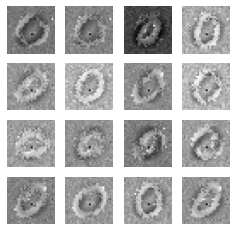

60
gen_loss: tf.Tensor(3.0340757, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07836587, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0990085, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.75504322e-10]
 [1.00000000e+00 1.76121923e-10]
 [9.99999285e-01 6.80466030e-07]
 [9.99999881e-01 1.12690884e-07]
 [1.00000000e+00 1.98645473e-08]
 [9.99998212e-01 1.84353291e-06]
 [9.99999881e-01 1.41258454e-07]
 [9.99999881e-01 1.56849765e-07]
 [9.99999523e-01 4.51052784e-07]
 [9.99989748e-01 1.01964015e-05]
 [1.00000000e+00 3.32724248e-09]
 [9.99998569e-01 1.38413122e-06]
 [9.99838591e-01 1.61373988e-04]
 [1.00000000e+00 4.25526920e-08]
 [9.99997973e-01 2.06310756e-06]
 [9.99999881e-01 6.82922305e-08]
 [9.99999523e-01 4.50456099e-07]
 [1.00000000e+00 2.72849334e-08]
 [1.00000000e+00 1.89240339e-08]
 [1.00000000e+00 1.78051742e-08]
 [9.99557674e-01 4.42321965e-04]
 [1.00000000e+00 6.23631591e-10]
 [1.00000000e+00 1.68784489e-08]
 [1.00000000e+00 3.

gen_loss: tf.Tensor(3.2406774, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07451549, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06167204, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.68970973e-10]
 [1.00000000e+00 6.47934900e-11]
 [9.99999285e-01 6.73578256e-07]
 [9.99999642e-01 3.66320279e-07]
 [1.00000000e+00 3.86174719e-08]
 [9.99996662e-01 3.38744803e-06]
 [9.99999762e-01 2.90223539e-07]
 [9.99999762e-01 1.81846531e-07]
 [9.99999285e-01 7.74270063e-07]
 [9.99977827e-01 2.21733862e-05]
 [1.00000000e+00 6.25841157e-09]
 [9.99997497e-01 2.45331944e-06]
 [9.99878645e-01 1.21382291e-04]
 [1.00000000e+00 2.70443188e-08]
 [9.99996066e-01 3.95900406e-06]
 [9.99999881e-01 1.50296003e-07]
 [9.99999166e-01 7.78403489e-07]
 [9.99999881e-01 7.07315095e-08]
 [1.00000000e+00 2.14056541e-08]
 [1.00000000e+00 4.90014855e-08]
 [9.99561965e-01 4.37988987e-04]
 [1.00000000e+00 4.27535118e-10]
 [1.00000000e+00 4.48025190e-08]
 [9.99999881e-01 1.08

disc_real_loss: tf.Tensor(0.110224694, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07096058, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.79310655e-10]
 [1.00000000e+00 1.30008407e-10]
 [9.99999404e-01 5.62679304e-07]
 [9.99999762e-01 2.36897478e-07]
 [1.00000000e+00 2.90122166e-08]
 [9.99997854e-01 2.20089191e-06]
 [9.99999762e-01 2.09103959e-07]
 [9.99999762e-01 1.83864145e-07]
 [9.99999404e-01 5.80158257e-07]
 [9.99987125e-01 1.28643733e-05]
 [1.00000000e+00 5.08785813e-09]
 [9.99998808e-01 1.14224883e-06]
 [9.99910593e-01 8.94408950e-05]
 [1.00000000e+00 1.96107379e-08]
 [9.99997258e-01 2.73727710e-06]
 [9.99999881e-01 1.08606976e-07]
 [9.99999523e-01 4.85031705e-07]
 [1.00000000e+00 5.29403081e-08]
 [1.00000000e+00 1.91975680e-08]
 [1.00000000e+00 3.72568287e-08]
 [9.99698400e-01 3.01638414e-04]
 [1.00000000e+00 8.75971018e-10]
 [1.00000000e+00 3.04793275e-08]
 [9.99999881e-01 6.61712818e-08]
 [1.00000000e+00 1.60992624e-08]
 [9.999850

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.06906875e-10]
 [1.00000000e+00 3.23212623e-10]
 [9.99999285e-01 6.82663710e-07]
 [9.99999762e-01 2.28176063e-07]
 [1.00000000e+00 3.20478790e-08]
 [9.99997735e-01 2.25273016e-06]
 [9.99999762e-01 2.02990449e-07]
 [9.99999762e-01 2.47605783e-07]
 [9.99999404e-01 5.74970727e-07]
 [9.99986887e-01 1.31434681e-05]
 [1.00000000e+00 5.11385423e-09]
 [9.99999166e-01 8.20611604e-07]
 [9.99917030e-01 8.29786004e-05]
 [1.00000000e+00 3.09926271e-08]
 [9.99997377e-01 2.61011064e-06]
 [9.99999881e-01 1.21112464e-07]
 [9.99999642e-01 4.16919846e-07]
 [1.00000000e+00 5.72040300e-08]
 [1.00000000e+00 2.55305306e-08]
 [1.00000000e+00 4.13418526e-08]
 [9.99675989e-01 3.23987042e-04]
 [1.00000000e+00 1.81809112e-09]
 [1.00000000e+00 3.12426174e-08]
 [9.99999881e-01 6.22250340e-08]
 [1.00000000e+00 1.71243748e-08]
 [9.99987483e-01 1.25021124e-05]
 [9.99999762e-01 2.19886431e-07]
 [9.99999881e-01 8.29108302e-08]
 [9.99904394e-01 9.55510332e-05]
 [9.9

gen_loss: tf.Tensor(3.1443255, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.070526935, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06563334, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.63619540e-09]
 [1.00000000e+00 8.01868461e-10]
 [9.99997854e-01 2.17177899e-06]
 [9.99999404e-01 6.24745951e-07]
 [9.99999881e-01 9.55930020e-08]
 [9.99993086e-01 6.86898829e-06]
 [9.99999642e-01 3.91684949e-07]
 [9.99999046e-01 9.15742135e-07]
 [9.99999046e-01 9.98596079e-07]
 [9.99944687e-01 5.52738202e-05]
 [1.00000000e+00 1.11132437e-08]
 [9.99998927e-01 1.09570919e-06]
 [9.99764621e-01 2.35337662e-04]
 [9.99999762e-01 2.73566201e-07]
 [9.99995351e-01 4.70000896e-06]
 [9.99999642e-01 3.69026509e-07]
 [9.99999046e-01 9.46808768e-07]
 [9.99999881e-01 1.48040129e-07]
 [9.99999881e-01 1.13939031e-07]
 [9.99999881e-01 1.14526657e-07]
 [9.98412728e-01 1.58725074e-03]
 [1.00000000e+00 2.32441599e-09]
 [9.99999881e-01 1.01657150e-07]
 [9.99999881e-01 1.7

gen_loss: tf.Tensor(3.1531363, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.076864466, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.072765656, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.40033984e-09]
 [1.00000000e+00 1.08205744e-09]
 [9.99998689e-01 1.27980456e-06]
 [9.99999285e-01 7.04678484e-07]
 [9.99999881e-01 9.47615746e-08]
 [9.99987364e-01 1.25780762e-05]
 [9.99999642e-01 3.51031161e-07]
 [9.99998927e-01 1.07008213e-06]
 [9.99999166e-01 8.64404967e-07]
 [9.99912739e-01 8.72679229e-05]
 [1.00000000e+00 8.25359070e-09]
 [9.99998450e-01 1.49355265e-06]
 [9.99921322e-01 7.86266828e-05]
 [9.99999642e-01 3.16066519e-07]
 [9.99996305e-01 3.67874691e-06]
 [9.99999404e-01 6.18985666e-07]
 [9.99998689e-01 1.36083077e-06]
 [9.99999881e-01 1.54935051e-07]
 [9.99999881e-01 6.82195846e-08]
 [9.99999881e-01 1.13441153e-07]
 [9.98845935e-01 1.15400460e-03]
 [1.00000000e+00 3.58927932e-09]
 [9.99999881e-01 1.11692849e-07]
 [9.99999762e-01 1.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.29943767e-09]
 [1.00000000e+00 8.17178769e-10]
 [9.99998808e-01 1.22157792e-06]
 [9.99999285e-01 6.89342585e-07]
 [9.99999881e-01 7.83140024e-08]
 [9.99990582e-01 9.41198959e-06]
 [9.99999642e-01 3.45424496e-07]
 [9.99999166e-01 8.18742592e-07]
 [9.99999046e-01 9.05339277e-07]
 [9.99940395e-01 5.96296086e-05]
 [1.00000000e+00 6.42708153e-09]
 [9.99998689e-01 1.32344303e-06]
 [9.99946237e-01 5.37865744e-05]
 [9.99999881e-01 1.66124536e-07]
 [9.99996305e-01 3.67642497e-06]
 [9.99999404e-01 5.59113062e-07]
 [9.99998689e-01 1.33687672e-06]
 [9.99999881e-01 1.07753770e-07]
 [9.99999881e-01 6.55736088e-08]
 [9.99999881e-01 9.64065379e-08]
 [9.98961568e-01 1.03846437e-03]
 [1.00000000e+00 3.17263704e-09]
 [9.99999881e-01 1.10083761e-07]
 [9.99999762e-01 1.86403881e-07]
 [1.00000000e+00 4.54254980e-08]
 [9.99973774e-01 2.61867681e-05]
 [9.99999642e-01 3.79333699e-07]
 [9.99999881e-01 1.01379484e-07]
 [9.99907613e-01 9.23492407e-05]
 [9.9

gen_loss: tf.Tensor(3.2508903, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.089039415, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07305688, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.54556895e-09]
 [1.00000000e+00 1.79017734e-09]
 [9.99996901e-01 3.13168016e-06]
 [9.99998689e-01 1.30175238e-06]
 [9.99999881e-01 1.32490371e-07]
 [9.99989033e-01 1.09205594e-05]
 [9.99999285e-01 6.92055835e-07]
 [9.99997854e-01 2.16763033e-06]
 [9.99997735e-01 2.21561231e-06]
 [9.99919534e-01 8.04239753e-05]
 [1.00000000e+00 1.22494725e-08]
 [9.99998450e-01 1.54181851e-06]
 [9.99910951e-01 8.89831208e-05]
 [9.99999881e-01 1.63274578e-07]
 [9.99990106e-01 9.94299990e-06]
 [9.99999166e-01 8.61177057e-07]
 [9.99997616e-01 2.37702284e-06]
 [9.99999762e-01 1.89043774e-07]
 [9.99999762e-01 2.95244604e-07]
 [9.99999762e-01 1.86417395e-07]
 [9.98421073e-01 1.57891808e-03]
 [1.00000000e+00 5.13126563e-09]
 [9.99999762e-01 2.84303013e-07]
 [9.99999642e-01 3.3

 [9.99999881e-01 1.35166147e-07]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.022635, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07320185, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08451791, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.57320992e-10]
 [1.00000000e+00 1.22791044e-09]
 [9.99997973e-01 2.04541107e-06]
 [9.99999404e-01 6.47214506e-07]
 [9.99999881e-01 7.31494367e-08]
 [9.99992967e-01 7.02927218e-06]
 [9.99999762e-01 2.65889867e-07]
 [9.99999523e-01 5.25670146e-07]
 [9.99998808e-01 1.20403217e-06]
 [9.99956727e-01 4.32731649e-05]
 [1.00000000e+00 3.06174597e-09]
 [9.99998212e-01 1.72862781e-06]
 [9.99906421e-01 9.35582648e-05]
 [9.99999881e-01 9.11686939e-08]
 [9.99994874e-01 5.13585383e-06]
 [9.99999523e-01 4.72111793e-07]
 [9.99999046e-01 1.01319733e-06]
 [9.99999881e-01 9.56625001e-08]
 [9.99999881e-01 1.17175063e-07]
 [9.99999881e-01 8.39534664e-08]
 [9.98005092e-01 1.99493859e-03]
 [1.00000000e+00 3.440

gen_loss: tf.Tensor(3.0765862, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.069143966, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07239216, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.52824991e-10]
 [1.00000000e+00 1.30581301e-09]
 [9.99998808e-01 1.19662593e-06]
 [9.99999762e-01 2.63125429e-07]
 [1.00000000e+00 3.13198250e-08]
 [9.99997258e-01 2.72991497e-06]
 [9.99999881e-01 1.13149099e-07]
 [9.99999762e-01 1.81476125e-07]
 [9.99999404e-01 6.36021980e-07]
 [9.99988794e-01 1.11821955e-05]
 [1.00000000e+00 7.80574327e-10]
 [9.99998927e-01 1.08840220e-06]
 [9.99947190e-01 5.27573648e-05]
 [1.00000000e+00 3.18844791e-08]
 [9.99997497e-01 2.48461174e-06]
 [9.99999762e-01 1.93860060e-07]
 [9.99999642e-01 3.86054722e-07]
 [1.00000000e+00 3.22872822e-08]
 [1.00000000e+00 5.21714654e-08]
 [1.00000000e+00 2.92137834e-08]
 [9.98885572e-01 1.11442129e-03]
 [1.00000000e+00 4.65469885e-09]
 [1.00000000e+00 3.09027897e-08]
 [9.99999881e-01 7.0

gen_loss: tf.Tensor(3.010971, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08573762, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.078069255, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.32968486e-10]
 [1.00000000e+00 5.11199916e-10]
 [9.99998331e-01 1.72480111e-06]
 [9.99999166e-01 8.46284479e-07]
 [9.99999881e-01 6.70636311e-08]
 [9.99996185e-01 3.83011320e-06]
 [9.99999762e-01 2.06214040e-07]
 [9.99999881e-01 1.66475999e-07]
 [9.99998808e-01 1.23627922e-06]
 [9.99983549e-01 1.65033853e-05]
 [1.00000000e+00 1.20342114e-09]
 [9.99996662e-01 3.35142681e-06]
 [9.99941111e-01 5.89339870e-05]
 [1.00000000e+00 2.83977215e-08]
 [9.99994755e-01 5.19114747e-06]
 [9.99999642e-01 3.13945918e-07]
 [9.99999285e-01 6.90250431e-07]
 [1.00000000e+00 5.84953916e-08]
 [9.99999881e-01 9.92161233e-08]
 [1.00000000e+00 5.67336471e-08]
 [9.98443782e-01 1.55628414e-03]
 [1.00000000e+00 3.34116979e-09]
 [9.99999881e-01 6.44870823e-08]
 [9.99999762e-01 2.46

gen_loss: tf.Tensor(3.1048129, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.058272235, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06970211, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.34705069e-09]
 [1.00000000e+00 4.85302354e-10]
 [9.99996066e-01 3.93323307e-06]
 [9.99995828e-01 4.22921767e-06]
 [9.99999762e-01 2.36009683e-07]
 [9.99988317e-01 1.17163108e-05]
 [9.99999404e-01 5.50000323e-07]
 [9.99999046e-01 8.96722383e-07]
 [9.99997020e-01 2.99818453e-06]
 [9.99918818e-01 8.11355130e-05]
 [1.00000000e+00 9.79155246e-09]
 [9.99992251e-01 7.76430079e-06]
 [9.99891758e-01 1.08240958e-04]
 [9.99999881e-01 8.00466395e-08]
 [9.99986410e-01 1.36356884e-05]
 [9.99999046e-01 9.10746394e-07]
 [9.99997616e-01 2.43592558e-06]
 [9.99999642e-01 3.66828232e-07]
 [9.99999642e-01 3.57299115e-07]
 [9.99999762e-01 2.63451341e-07]
 [9.97484207e-01 2.51581660e-03]
 [1.00000000e+00 3.58319840e-09]
 [9.99999642e-01 3.41697245e-07]
 [9.99998689e-01 1.3

gen_loss: tf.Tensor(3.1618006, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.056134373, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07116686, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.60137420e-10]
 [1.00000000e+00 4.59076444e-10]
 [9.99998212e-01 1.74756383e-06]
 [9.99999642e-01 3.12079010e-07]
 [1.00000000e+00 1.45597099e-08]
 [9.99999285e-01 7.60926810e-07]
 [9.99999881e-01 6.32462971e-08]
 [9.99999881e-01 1.33638807e-07]
 [9.99999523e-01 4.56170341e-07]
 [9.99996185e-01 3.79420862e-06]
 [1.00000000e+00 7.28971328e-10]
 [9.99999404e-01 6.43413671e-07]
 [9.99963045e-01 3.70123598e-05]
 [1.00000000e+00 8.11608913e-09]
 [9.99998212e-01 1.83579050e-06]
 [1.00000000e+00 5.10291542e-08]
 [9.99999762e-01 2.44528849e-07]
 [1.00000000e+00 2.13976534e-08]
 [9.99999881e-01 6.18067801e-08]
 [1.00000000e+00 1.51991024e-08]
 [9.98801112e-01 1.19890925e-03]
 [1.00000000e+00 3.16014770e-09]
 [1.00000000e+00 1.69409873e-08]
 [9.99999881e-01 9.4

gen_loss: tf.Tensor(3.086416, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.062198434, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.070506565, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.00643899e-10]
 [1.00000000e+00 4.62922423e-10]
 [9.99998212e-01 1.78873313e-06]
 [9.99999762e-01 1.92853051e-07]
 [1.00000000e+00 9.04762665e-09]
 [9.99999523e-01 4.93384562e-07]
 [1.00000000e+00 4.21234105e-08]
 [9.99999881e-01 8.83782292e-08]
 [9.99999642e-01 3.21974426e-07]
 [9.99997377e-01 2.61818309e-06]
 [1.00000000e+00 4.57728244e-10]
 [9.99999642e-01 3.86428610e-07]
 [9.99972105e-01 2.78987627e-05]
 [1.00000000e+00 6.53595578e-09]
 [9.99998689e-01 1.25758481e-06]
 [1.00000000e+00 3.03221874e-08]
 [9.99999881e-01 1.55457528e-07]
 [1.00000000e+00 1.38719747e-08]
 [1.00000000e+00 4.75269459e-08]
 [1.00000000e+00 9.38703515e-09]
 [9.98607695e-01 1.39227451e-03]
 [1.00000000e+00 2.86762769e-09]
 [1.00000000e+00 1.02272262e-08]
 [9.99999881e-01 5.9

gen_loss: tf.Tensor(3.0650048, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.063002184, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08368443, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.28352567e-10]
 [1.00000000e+00 3.41673051e-10]
 [9.99997497e-01 2.56189810e-06]
 [9.99999642e-01 3.31592332e-07]
 [1.00000000e+00 1.38334784e-08]
 [9.99999166e-01 8.37295659e-07]
 [9.99999881e-01 6.06263555e-08]
 [9.99999881e-01 9.23752310e-08]
 [9.99999523e-01 4.67340101e-07]
 [9.99992847e-01 7.09763026e-06]
 [1.00000000e+00 6.83768819e-10]
 [9.99999285e-01 6.60942078e-07]
 [9.99968886e-01 3.10821051e-05]
 [1.00000000e+00 1.05474065e-08]
 [9.99998212e-01 1.80235327e-06]
 [1.00000000e+00 4.41210481e-08]
 [9.99999762e-01 2.16208150e-07]
 [1.00000000e+00 2.66368190e-08]
 [9.99999881e-01 6.47142926e-08]
 [1.00000000e+00 1.66736651e-08]
 [9.97399569e-01 2.60044076e-03]
 [1.00000000e+00 1.97825645e-09]
 [1.00000000e+00 1.86450055e-08]
 [9.99999881e-01 1.0

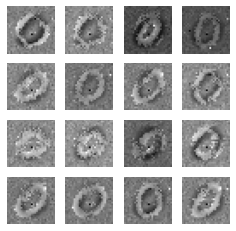

61
gen_loss: tf.Tensor(3.010458, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.047300477, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08087286, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.86872026e-10]
 [1.00000000e+00 1.71742398e-10]
 [9.99996185e-01 3.77124002e-06]
 [9.99999166e-01 8.62814602e-07]
 [1.00000000e+00 3.08725063e-08]
 [9.99997973e-01 2.00145996e-06]
 [9.99999881e-01 1.18165730e-07]
 [9.99999881e-01 8.31141307e-08]
 [9.99999046e-01 9.03438320e-07]
 [9.99971986e-01 2.79857104e-05]
 [1.00000000e+00 1.09210951e-09]
 [9.99998093e-01 1.91413369e-06]
 [9.99957681e-01 4.23109159e-05]
 [1.00000000e+00 2.05573265e-08]
 [9.99996424e-01 3.58625425e-06]
 [9.99999881e-01 9.06110031e-08]
 [9.99999642e-01 3.83819071e-07]
 [9.99999881e-01 6.28609698e-08]
 [9.99999881e-01 1.09585585e-07]
 [1.00000000e+00 4.03135978e-08]
 [9.94091809e-01 5.90815535e-03]
 [1.00000000e+00 1.01876207e-09]
 [1.00000000e+00 4.82192526e-08]
 [9.99999762e-01 2

gen_loss: tf.Tensor(3.193647, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06190269, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07090624, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.23124077e-11]
 [1.00000000e+00 5.39055675e-11]
 [9.99998093e-01 1.88370120e-06]
 [9.99999404e-01 6.44290537e-07]
 [1.00000000e+00 3.18745670e-08]
 [9.99998450e-01 1.53361941e-06]
 [9.99999881e-01 7.73985178e-08]
 [1.00000000e+00 2.94183238e-08]
 [9.99999404e-01 5.83465180e-07]
 [9.99977112e-01 2.29028992e-05]
 [1.00000000e+00 6.24156393e-10]
 [9.99998689e-01 1.28216107e-06]
 [9.99931812e-01 6.81708188e-05]
 [1.00000000e+00 8.97677221e-09]
 [9.99997973e-01 2.08238612e-06]
 [9.99999881e-01 7.56337073e-08]
 [9.99999762e-01 2.20904980e-07]
 [1.00000000e+00 3.59223300e-08]
 [9.99999881e-01 7.22513107e-08]
 [1.00000000e+00 2.79765526e-08]
 [9.89737451e-01 1.02625415e-02]
 [1.00000000e+00 4.04778239e-10]
 [1.00000000e+00 3.60110981e-08]
 [9.99999762e-01 2.187

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.80474860e-11]
 [1.00000000e+00 1.42364523e-10]
 [9.99999285e-01 7.22355992e-07]
 [9.99999881e-01 1.43291771e-07]
 [1.00000000e+00 1.24416850e-08]
 [9.99999523e-01 4.93368077e-07]
 [1.00000000e+00 2.45929659e-08]
 [1.00000000e+00 2.81213204e-08]
 [9.99999762e-01 1.90839970e-07]
 [9.99996305e-01 3.75319678e-06]
 [1.00000000e+00 2.74563483e-10]
 [9.99999762e-01 1.87749620e-07]
 [9.99957204e-01 4.27531741e-05]
 [1.00000000e+00 2.65970046e-09]
 [9.99999404e-01 5.97486235e-07]
 [1.00000000e+00 2.82171175e-08]
 [9.99999881e-01 6.60773196e-08]
 [1.00000000e+00 1.04344711e-08]
 [1.00000000e+00 4.14236254e-08]
 [1.00000000e+00 7.76212783e-09]
 [9.96509612e-01 3.49038653e-03]
 [1.00000000e+00 1.16409771e-09]
 [1.00000000e+00 8.51169091e-09]
 [1.00000000e+00 4.70453294e-08]
 [1.00000000e+00 4.30485203e-09]
 [9.99996185e-01 3.76106118e-06]
 [1.00000000e+00 5.82022501e-08]
 [1.00000000e+00 1.15925030e-08]
 [9.96862292e-01 3.13773262e-03]
 [9.9

gen_loss: tf.Tensor(2.9991395, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.055227987, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.098330766, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.27987204e-10]
 [1.00000000e+00 2.64562844e-10]
 [9.99999523e-01 4.23744297e-07]
 [9.99999881e-01 6.74533567e-08]
 [1.00000000e+00 1.12092104e-08]
 [9.99999523e-01 5.17483898e-07]
 [1.00000000e+00 1.34598555e-08]
 [9.99999881e-01 6.97797091e-08]
 [9.99999881e-01 8.63432987e-08]
 [9.99997973e-01 2.06414848e-06]
 [1.00000000e+00 3.76031095e-10]
 [1.00000000e+00 5.70759724e-08]
 [9.99966979e-01 3.30766998e-05]
 [1.00000000e+00 2.75214296e-09]
 [9.99999762e-01 2.67754046e-07]
 [1.00000000e+00 2.90053546e-08]
 [1.00000000e+00 5.54348496e-08]
 [1.00000000e+00 9.74094228e-09]
 [1.00000000e+00 4.04030445e-08]
 [1.00000000e+00 5.37713030e-09]
 [9.97460961e-01 2.53899442e-03]
 [1.00000000e+00 1.81960014e-09]
 [1.00000000e+00 5.07260678e-09]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(3.1991673, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06738126, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07068718, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.85960966e-11]
 [1.00000000e+00 6.26685023e-11]
 [9.99999285e-01 7.37887035e-07]
 [9.99999881e-01 1.53172081e-07]
 [1.00000000e+00 1.98687147e-08]
 [9.99998450e-01 1.49469111e-06]
 [1.00000000e+00 2.32240982e-08]
 [9.99999881e-01 7.73512951e-08]
 [9.99999881e-01 1.56860239e-07]
 [9.99993920e-01 6.04719935e-06]
 [1.00000000e+00 6.50877019e-10]
 [9.99999762e-01 2.38044549e-07]
 [9.99978900e-01 2.10850576e-05]
 [1.00000000e+00 3.36589778e-09]
 [9.99999523e-01 4.97208248e-07]
 [9.99999881e-01 7.49584288e-08]
 [9.99999881e-01 1.39178965e-07]
 [1.00000000e+00 2.15574154e-08]
 [1.00000000e+00 4.37903047e-08]
 [1.00000000e+00 1.36187239e-08]
 [9.94843364e-01 5.15663065e-03]
 [1.00000000e+00 3.86662258e-10]
 [1.00000000e+00 1.20038655e-08]
 [1.00000000e+00 5.48

gen_loss: tf.Tensor(3.2199388, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06463533, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.074062034, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.07028109e-10]
 [1.00000000e+00 1.51785765e-10]
 [9.99999285e-01 6.60867670e-07]
 [1.00000000e+00 3.59579744e-08]
 [1.00000000e+00 5.23927168e-09]
 [9.99999642e-01 2.99437886e-07]
 [1.00000000e+00 8.66223626e-09]
 [1.00000000e+00 4.82699534e-08]
 [9.99999881e-01 7.86788732e-08]
 [9.99999404e-01 5.94062442e-07]
 [1.00000000e+00 2.48120302e-10]
 [9.99999881e-01 7.64813350e-08]
 [9.99993920e-01 6.05004925e-06]
 [1.00000000e+00 8.10602918e-10]
 [9.99999762e-01 2.53313033e-07]
 [1.00000000e+00 1.88506881e-08]
 [1.00000000e+00 4.02126119e-08]
 [1.00000000e+00 4.34343406e-09]
 [1.00000000e+00 3.35435075e-08]
 [1.00000000e+00 3.68226138e-09]
 [9.98523057e-01 1.47695176e-03]
 [1.00000000e+00 7.49567908e-10]
 [1.00000000e+00 2.55020960e-09]
 [1.00000000e+00 1.2

gen_loss: tf.Tensor(3.3070014, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0529049, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06384422, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.42137324e-11]
 [1.00000000e+00 1.39877221e-10]
 [9.99999166e-01 8.22693607e-07]
 [1.00000000e+00 1.82061477e-08]
 [1.00000000e+00 3.21746452e-09]
 [9.99999881e-01 1.35787730e-07]
 [1.00000000e+00 5.07003373e-09]
 [1.00000000e+00 2.72471787e-08]
 [1.00000000e+00 5.07874702e-08]
 [9.99999762e-01 2.22461409e-07]
 [1.00000000e+00 1.34795480e-10]
 [1.00000000e+00 4.57271447e-08]
 [9.99993205e-01 6.84787574e-06]
 [1.00000000e+00 6.75992207e-10]
 [9.99999762e-01 1.85765188e-07]
 [1.00000000e+00 8.95088714e-09]
 [1.00000000e+00 1.79203319e-08]
 [1.00000000e+00 1.92466865e-09]
 [1.00000000e+00 3.04511438e-08]
 [1.00000000e+00 1.87219684e-09]
 [9.98124301e-01 1.87573640e-03]
 [1.00000000e+00 4.49111331e-10]
 [1.00000000e+00 1.38209966e-09]
 [1.00000000e+00 6.683

gen_loss: tf.Tensor(3.3024607, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07334297, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06426357, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.47701225e-11]
 [1.00000000e+00 4.40580766e-11]
 [9.99999285e-01 7.19328455e-07]
 [1.00000000e+00 2.89803594e-08]
 [1.00000000e+00 6.74471545e-09]
 [9.99999642e-01 3.28682574e-07]
 [1.00000000e+00 6.83547530e-09]
 [1.00000000e+00 1.91962144e-08]
 [1.00000000e+00 5.34218181e-08]
 [9.99999285e-01 7.18473530e-07]
 [1.00000000e+00 1.98468034e-10]
 [9.99999881e-01 7.63537997e-08]
 [9.99993324e-01 6.72274382e-06]
 [1.00000000e+00 1.43785817e-09]
 [9.99999762e-01 2.05490608e-07]
 [1.00000000e+00 1.77500397e-08]
 [1.00000000e+00 2.16652474e-08]
 [1.00000000e+00 4.31367120e-09]
 [1.00000000e+00 2.10065707e-08]
 [1.00000000e+00 3.26982796e-09]
 [9.96585131e-01 3.41481459e-03]
 [1.00000000e+00 1.53128038e-10]
 [1.00000000e+00 3.02561975e-09]
 [1.00000000e+00 1.23

gen_loss: tf.Tensor(3.1843996, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08265561, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.070215, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.96523457e-11]
 [1.00000000e+00 1.19854534e-11]
 [9.99999642e-01 3.01219671e-07]
 [1.00000000e+00 1.84533206e-08]
 [1.00000000e+00 6.56153665e-09]
 [9.99999523e-01 4.23289890e-07]
 [1.00000000e+00 5.08580156e-09]
 [1.00000000e+00 9.98345495e-09]
 [1.00000000e+00 2.93566664e-08]
 [9.99999404e-01 5.64230618e-07]
 [1.00000000e+00 1.08547178e-10]
 [1.00000000e+00 4.41727508e-08]
 [9.99996066e-01 3.95071766e-06]
 [1.00000000e+00 7.49925400e-10]
 [9.99999881e-01 1.13724951e-07]
 [1.00000000e+00 1.73243819e-08]
 [1.00000000e+00 1.16915162e-08]
 [1.00000000e+00 4.68174921e-09]
 [1.00000000e+00 8.10669842e-09]
 [1.00000000e+00 2.30034813e-09]
 [9.97245550e-01 2.75443238e-03]
 [1.00000000e+00 6.00340055e-11]
 [1.00000000e+00 2.24247931e-09]
 [1.00000000e+00 8.4792

gen_loss: tf.Tensor(3.2101154, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06869808, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.069000885, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.01445752e-11]
 [1.00000000e+00 2.50931012e-11]
 [9.99999762e-01 2.40790143e-07]
 [1.00000000e+00 9.86031523e-09]
 [1.00000000e+00 5.60367264e-09]
 [9.99999642e-01 3.89265580e-07]
 [1.00000000e+00 3.85271104e-09]
 [1.00000000e+00 1.52031614e-08]
 [1.00000000e+00 1.82974258e-08]
 [9.99999642e-01 3.22308040e-07]
 [1.00000000e+00 7.67190825e-11]
 [1.00000000e+00 1.27745148e-08]
 [9.99997258e-01 2.72700072e-06]
 [1.00000000e+00 5.73673220e-10]
 [9.99999881e-01 7.32843333e-08]
 [1.00000000e+00 1.33444669e-08]
 [1.00000000e+00 5.44539347e-09]
 [1.00000000e+00 5.03633846e-09]
 [1.00000000e+00 7.53806351e-09]
 [1.00000000e+00 1.54467228e-09]
 [9.98373747e-01 1.62625953e-03]
 [1.00000000e+00 1.16270132e-10]
 [1.00000000e+00 1.33097877e-09]
 [1.00000000e+00 4.3

gen_loss: tf.Tensor(3.103101, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06528708, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07361159, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.67786487e-11]
 [1.00000000e+00 1.86886999e-11]
 [9.99999404e-01 5.47891091e-07]
 [1.00000000e+00 3.39475825e-08]
 [1.00000000e+00 1.72067516e-08]
 [9.99998808e-01 1.23782002e-06]
 [1.00000000e+00 1.06572529e-08]
 [1.00000000e+00 3.08072146e-08]
 [1.00000000e+00 3.85778662e-08]
 [9.99998212e-01 1.76555682e-06]
 [1.00000000e+00 1.95468614e-10]
 [1.00000000e+00 2.93167144e-08]
 [9.99995351e-01 4.64602317e-06]
 [1.00000000e+00 2.45998955e-09]
 [9.99999881e-01 1.62986780e-07]
 [1.00000000e+00 3.37903465e-08]
 [1.00000000e+00 1.23432855e-08]
 [1.00000000e+00 1.89699296e-08]
 [1.00000000e+00 1.96983851e-08]
 [1.00000000e+00 4.67583261e-09]
 [9.95994925e-01 4.00507450e-03]
 [1.00000000e+00 7.78998879e-11]
 [1.00000000e+00 4.16291401e-09]
 [1.00000000e+00 1.544

gen_loss: tf.Tensor(3.2211595, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051913235, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.064884245, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.40667466e-12]
 [1.00000000e+00 5.90214509e-12]
 [9.99999404e-01 5.65339121e-07]
 [1.00000000e+00 3.55921017e-08]
 [1.00000000e+00 1.00626778e-08]
 [9.99999046e-01 9.22848699e-07]
 [1.00000000e+00 9.01740815e-09]
 [1.00000000e+00 7.89473198e-09]
 [1.00000000e+00 2.99125027e-08]
 [9.99998569e-01 1.45667877e-06]
 [1.00000000e+00 5.97329269e-11]
 [1.00000000e+00 4.04404403e-08]
 [9.99997258e-01 2.70199871e-06]
 [1.00000000e+00 1.54030921e-09]
 [9.99999881e-01 1.12389515e-07]
 [1.00000000e+00 2.20994263e-08]
 [1.00000000e+00 8.51467874e-09]
 [1.00000000e+00 7.89169086e-09]
 [1.00000000e+00 1.03532702e-08]
 [1.00000000e+00 2.43885401e-09]
 [9.95826006e-01 4.17400664e-03]
 [1.00000000e+00 3.65800897e-11]
 [1.00000000e+00 2.27463692e-09]
 [1.00000000e+00 1.

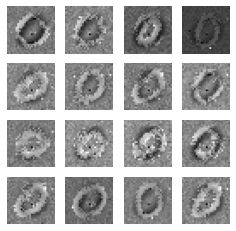

62
gen_loss: tf.Tensor(3.33545, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06667693, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06569886, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.27427363e-12]
 [1.00000000e+00 7.80191016e-12]
 [9.99999404e-01 5.96623067e-07]
 [1.00000000e+00 2.32113440e-08]
 [1.00000000e+00 5.32851185e-09]
 [9.99999404e-01 5.38634026e-07]
 [1.00000000e+00 6.19941254e-09]
 [1.00000000e+00 7.29081506e-09]
 [1.00000000e+00 1.89937879e-08]
 [9.99999285e-01 7.03005696e-07]
 [1.00000000e+00 4.49708569e-11]
 [1.00000000e+00 1.84556779e-08]
 [9.99997973e-01 2.01396870e-06]
 [1.00000000e+00 8.24826707e-10]
 [9.99999881e-01 6.54737491e-08]
 [1.00000000e+00 1.21669732e-08]
 [1.00000000e+00 5.44807399e-09]
 [1.00000000e+00 3.93138233e-09]
 [1.00000000e+00 8.15359158e-09]
 [1.00000000e+00 1.29178690e-09]
 [9.97171581e-01 2.82839499e-03]
 [1.00000000e+00 4.68935862e-11]
 [1.00000000e+00 1.17914589e-09]
 [1.00000000e+00 9.5

 [1.00000000e+00 2.89112223e-09]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.26908, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044107616, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07685559, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.60437236e-11]
 [1.00000000e+00 1.21244213e-11]
 [9.99999046e-01 9.71483701e-07]
 [1.00000000e+00 3.33917107e-08]
 [1.00000000e+00 7.22512850e-09]
 [9.99999285e-01 7.21111519e-07]
 [1.00000000e+00 8.61287752e-09]
 [1.00000000e+00 1.46572035e-08]
 [1.00000000e+00 2.43547120e-08]
 [9.99998927e-01 1.11884799e-06]
 [1.00000000e+00 9.94196322e-11]
 [1.00000000e+00 1.83162463e-08]
 [9.99997139e-01 2.90320622e-06]
 [1.00000000e+00 1.24877064e-09]
 [9.99999881e-01 8.28635578e-08]
 [1.00000000e+00 1.59661191e-08]
 [1.00000000e+00 7.73258879e-09]
 [1.00000000e+00 6.11067286e-09]
 [1.00000000e+00 1.42040273e-08]
 [1.00000000e+00 2.02598072e-09]
 [9.96487975e-01 3.51200718e-03]
 [1.00000000e+00 5.747

gen_loss: tf.Tensor(3.379688, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10660027, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05985667, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.07814946e-11]
 [1.00000000e+00 9.85650190e-12]
 [9.99998927e-01 1.10685346e-06]
 [1.00000000e+00 4.16130490e-08]
 [1.00000000e+00 8.94428265e-09]
 [9.99999166e-01 8.34425975e-07]
 [1.00000000e+00 1.00597992e-08]
 [1.00000000e+00 2.35196485e-08]
 [1.00000000e+00 2.43701397e-08]
 [9.99998569e-01 1.42472447e-06]
 [1.00000000e+00 1.98362077e-10]
 [1.00000000e+00 1.39656890e-08]
 [9.99995589e-01 4.42944292e-06]
 [1.00000000e+00 1.30768729e-09]
 [9.99999881e-01 8.41071710e-08]
 [1.00000000e+00 1.97110133e-08]
 [1.00000000e+00 1.06761533e-08]
 [1.00000000e+00 8.01202305e-09]
 [1.00000000e+00 1.76742319e-08]
 [1.00000000e+00 2.63354671e-09]
 [9.95442152e-01 4.55786614e-03]
 [1.00000000e+00 4.10313346e-11]
 [1.00000000e+00 2.49085841e-09]
 [1.00000000e+00 1.665

gen_loss: tf.Tensor(3.321046, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.084800854, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.062232327, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.74992581e-11]
 [1.00000000e+00 9.20893656e-12]
 [9.99999404e-01 6.49989317e-07]
 [1.00000000e+00 2.24349428e-08]
 [1.00000000e+00 7.36914929e-09]
 [9.99999404e-01 5.95225572e-07]
 [1.00000000e+00 7.34040562e-09]
 [1.00000000e+00 2.56365169e-08]
 [1.00000000e+00 1.20341719e-08]
 [9.99998927e-01 1.01529986e-06]
 [1.00000000e+00 3.64577951e-10]
 [1.00000000e+00 4.16667945e-09]
 [9.99995112e-01 4.89357308e-06]
 [1.00000000e+00 9.03627395e-10]
 [1.00000000e+00 4.28659064e-08]
 [1.00000000e+00 1.65121019e-08]
 [1.00000000e+00 9.41066336e-09]
 [1.00000000e+00 6.68842493e-09]
 [1.00000000e+00 1.03452162e-08]
 [1.00000000e+00 2.03892858e-09]
 [9.96000946e-01 3.99903767e-03]
 [1.00000000e+00 3.56103133e-11]
 [1.00000000e+00 1.96859795e-09]
 [1.00000000e+00 8.7

gen_loss: tf.Tensor(3.4041042, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06565262, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05575817, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.40475085e-12]
 [1.00000000e+00 1.50616256e-11]
 [9.99999881e-01 1.40450453e-07]
 [1.00000000e+00 1.57186986e-09]
 [1.00000000e+00 8.95392205e-10]
 [9.99999881e-01 8.21032202e-08]
 [1.00000000e+00 1.13454468e-09]
 [1.00000000e+00 3.82855880e-09]
 [1.00000000e+00 1.70536363e-09]
 [9.99999881e-01 6.35855812e-08]
 [1.00000000e+00 3.88910570e-11]
 [1.00000000e+00 4.66928884e-10]
 [9.99998927e-01 1.05758295e-06]
 [1.00000000e+00 1.67449749e-10]
 [1.00000000e+00 5.78366999e-09]
 [1.00000000e+00 2.62005928e-09]
 [1.00000000e+00 1.23188426e-09]
 [1.00000000e+00 5.48320278e-10]
 [1.00000000e+00 1.19688115e-09]
 [1.00000000e+00 1.61277686e-10]
 [9.99094248e-01 9.05806839e-04]
 [1.00000000e+00 6.41139086e-11]
 [1.00000000e+00 1.20094865e-10]
 [1.00000000e+00 5.69

gen_loss: tf.Tensor(3.3090944, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.056791395, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06600143, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.51970991e-12]
 [1.00000000e+00 6.49327640e-12]
 [9.99999762e-01 1.84957869e-07]
 [1.00000000e+00 1.51641733e-09]
 [1.00000000e+00 8.07199363e-10]
 [9.99999881e-01 6.36206394e-08]
 [1.00000000e+00 1.23733335e-09]
 [1.00000000e+00 1.72266423e-09]
 [1.00000000e+00 2.02963957e-09]
 [1.00000000e+00 5.14722629e-08]
 [1.00000000e+00 2.38884433e-11]
 [1.00000000e+00 7.19316884e-10]
 [9.99998689e-01 1.32464504e-06]
 [1.00000000e+00 2.04625969e-10]
 [1.00000000e+00 7.35749239e-09]
 [1.00000000e+00 2.56444266e-09]
 [1.00000000e+00 1.31651157e-09]
 [1.00000000e+00 3.07883274e-10]
 [1.00000000e+00 1.42001733e-09]
 [1.00000000e+00 1.22014246e-10]
 [9.98619676e-01 1.38028420e-03]
 [1.00000000e+00 2.46085999e-11]
 [1.00000000e+00 9.88648191e-11]
 [1.00000000e+00 5.4

gen_loss: tf.Tensor(3.2169433, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07198757, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07107535, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.45100077e-12]
 [1.00000000e+00 2.80362712e-12]
 [9.99999762e-01 2.44954578e-07]
 [1.00000000e+00 2.25165975e-09]
 [1.00000000e+00 1.12550946e-09]
 [9.99999881e-01 8.70437376e-08]
 [1.00000000e+00 1.94565564e-09]
 [1.00000000e+00 1.70827408e-09]
 [1.00000000e+00 3.13139537e-09]
 [9.99999881e-01 1.04493331e-07]
 [1.00000000e+00 3.40389522e-11]
 [1.00000000e+00 1.25484478e-09]
 [9.99998450e-01 1.51743859e-06]
 [1.00000000e+00 2.53890964e-10]
 [1.00000000e+00 1.21666943e-08]
 [1.00000000e+00 3.71051168e-09]
 [1.00000000e+00 1.93438088e-09]
 [1.00000000e+00 3.91830957e-10]
 [1.00000000e+00 2.05046846e-09]
 [1.00000000e+00 1.95387345e-10]
 [9.98425007e-01 1.57504121e-03]
 [1.00000000e+00 1.07245896e-11]
 [1.00000000e+00 1.59294189e-10]
 [1.00000000e+00 7.76

gen_loss: tf.Tensor(3.2651122, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.084773466, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061959587, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.38381341e-12]
 [1.00000000e+00 2.98648389e-12]
 [9.99999881e-01 1.02485146e-07]
 [1.00000000e+00 5.93393723e-10]
 [1.00000000e+00 4.09310696e-10]
 [1.00000000e+00 3.96583246e-08]
 [1.00000000e+00 8.18612400e-10]
 [1.00000000e+00 1.04998299e-09]
 [1.00000000e+00 1.20315258e-09]
 [1.00000000e+00 4.46018973e-08]
 [1.00000000e+00 1.91669527e-11]
 [1.00000000e+00 3.09430981e-10]
 [9.99999404e-01 6.04795105e-07]
 [1.00000000e+00 7.45256634e-11]
 [1.00000000e+00 4.08248946e-09]
 [1.00000000e+00 1.57052726e-09]
 [1.00000000e+00 7.84618037e-10]
 [1.00000000e+00 1.74560782e-10]
 [1.00000000e+00 5.77394577e-10]
 [1.00000000e+00 8.71135386e-11]
 [9.99381185e-01 6.18815131e-04]
 [1.00000000e+00 1.27230180e-11]
 [1.00000000e+00 5.61807198e-11]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.2482588, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.047570877, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.063684836, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 1.7162730e-12]
 [1.0000000e+00 1.5949772e-12]
 [9.9999988e-01 6.3466352e-08]
 [1.0000000e+00 3.0837047e-10]
 [1.0000000e+00 2.3711957e-10]
 [1.0000000e+00 3.2515452e-08]
 [1.0000000e+00 4.6093829e-10]
 [1.0000000e+00 6.2758365e-10]
 [1.0000000e+00 5.5304261e-10]
 [1.0000000e+00 3.5440898e-08]
 [1.0000000e+00 9.7852646e-12]
 [1.0000000e+00 1.5441443e-10]
 [9.9999952e-01 4.7184352e-07]
 [1.0000000e+00 5.4209109e-11]
 [1.0000000e+00 1.7286942e-09]
 [1.0000000e+00 9.7312247e-10]
 [1.0000000e+00 4.7184034e-10]
 [1.0000000e+00 1.2973692e-10]
 [1.0000000e+00 2.0701237e-10]
 [1.0000000e+00 5.2044764e-11]
 [9.9918360e-01 8.1640587e-04]
 [1.0000000e+00 6.3246903e-12]
 [1.0000000e+00 3.4925344e-11]
 [1.0000000e+00 9.5687180e-11]
 [1.0000000e+00 6.4381542e-11]
 [9

gen_loss: tf.Tensor(3.328126, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.062834114, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.059581734, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.41422377e-12]
 [1.00000000e+00 7.97097414e-13]
 [9.99999762e-01 1.83412837e-07]
 [1.00000000e+00 1.15716869e-09]
 [1.00000000e+00 8.72288020e-10]
 [9.99999881e-01 8.95099248e-08]
 [1.00000000e+00 1.36114719e-09]
 [1.00000000e+00 1.03446973e-09]
 [1.00000000e+00 1.46650259e-09]
 [9.99999881e-01 1.58039697e-07]
 [1.00000000e+00 2.16074415e-11]
 [1.00000000e+00 4.53743626e-10]
 [9.99998689e-01 1.29950979e-06]
 [1.00000000e+00 2.38056741e-10]
 [1.00000000e+00 4.76747308e-09]
 [1.00000000e+00 2.41366105e-09]
 [1.00000000e+00 1.22607557e-09]
 [1.00000000e+00 4.62823557e-10]
 [1.00000000e+00 6.67428890e-10]
 [1.00000000e+00 1.88927457e-10]
 [9.95996118e-01 4.00388381e-03]
 [1.00000000e+00 2.32419075e-12]
 [1.00000000e+00 1.69484357e-10]
 [1.00000000e+00 3.9

disc_real_loss: tf.Tensor(0.04693625, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07428153, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.05492220e-12]
 [1.00000000e+00 7.94882281e-13]
 [9.99999762e-01 1.98356460e-07]
 [1.00000000e+00 1.22742805e-09]
 [1.00000000e+00 9.77009473e-10]
 [9.99999881e-01 8.30959053e-08]
 [1.00000000e+00 1.49873336e-09]
 [1.00000000e+00 1.04942233e-09]
 [1.00000000e+00 1.57145019e-09]
 [9.99999881e-01 1.42674210e-07]
 [1.00000000e+00 2.29331883e-11]
 [1.00000000e+00 3.65794783e-10]
 [9.99998689e-01 1.28397812e-06]
 [1.00000000e+00 2.27917837e-10]
 [1.00000000e+00 4.86630869e-09]
 [1.00000000e+00 2.33190733e-09]
 [1.00000000e+00 1.13752618e-09]
 [1.00000000e+00 5.00009867e-10]
 [1.00000000e+00 7.64453834e-10]
 [1.00000000e+00 2.09393045e-10]
 [9.95787084e-01 4.21294710e-03]
 [1.00000000e+00 2.24968178e-12]
 [1.00000000e+00 1.96036867e-10]
 [1.00000000e+00 4.22398672e-10]
 [1.00000000e+00 1.21064034e-10]
 [9.9999988

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.24017180e-12]
 [1.00000000e+00 7.12746702e-13]
 [9.99999881e-01 1.53861194e-07]
 [1.00000000e+00 8.76087980e-10]
 [1.00000000e+00 7.31573191e-10]
 [1.00000000e+00 5.11609137e-08]
 [1.00000000e+00 1.22937738e-09]
 [1.00000000e+00 7.39711237e-10]
 [1.00000000e+00 1.29010513e-09]
 [9.99999881e-01 7.35038341e-08]
 [1.00000000e+00 1.76512624e-11]
 [1.00000000e+00 2.15664417e-10]
 [9.99999166e-01 8.33447757e-07]
 [1.00000000e+00 1.16231330e-10]
 [1.00000000e+00 3.65114672e-09]
 [1.00000000e+00 1.61115121e-09]
 [1.00000000e+00 7.19026061e-10]
 [1.00000000e+00 3.37306849e-10]
 [1.00000000e+00 5.92120686e-10]
 [1.00000000e+00 1.55129992e-10]
 [9.97533917e-01 2.46607256e-03]
 [1.00000000e+00 2.36561899e-12]
 [1.00000000e+00 1.37153428e-10]
 [1.00000000e+00 2.96502684e-10]
 [1.00000000e+00 9.61649024e-11]
 [9.99999881e-01 9.17590413e-08]
 [1.00000000e+00 1.01328945e-09]
 [1.00000000e+00 4.42858111e-11]
 [9.99903560e-01 9.64294013e-05]
 [1.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.64730598e-12]
 [1.00000000e+00 4.03174944e-13]
 [9.99999881e-01 1.48938639e-07]
 [1.00000000e+00 1.05705411e-09]
 [1.00000000e+00 1.03658315e-09]
 [1.00000000e+00 5.72183261e-08]
 [1.00000000e+00 1.54290558e-09]
 [1.00000000e+00 7.24842408e-10]
 [1.00000000e+00 1.41503709e-09]
 [9.99999881e-01 8.17544290e-08]
 [1.00000000e+00 2.59130079e-11]
 [1.00000000e+00 1.91260605e-10]
 [9.99999166e-01 8.06656658e-07]
 [1.00000000e+00 1.05525873e-10]
 [1.00000000e+00 3.67710284e-09]
 [1.00000000e+00 2.10684736e-09]
 [1.00000000e+00 8.42655778e-10]
 [1.00000000e+00 4.36505831e-10]
 [1.00000000e+00 5.34712052e-10]
 [1.00000000e+00 2.08808762e-10]
 [9.97078419e-01 2.92154471e-03]
 [1.00000000e+00 1.50221122e-12]
 [1.00000000e+00 1.84738669e-10]
 [1.00000000e+00 3.71529724e-10]
 [1.00000000e+00 1.25305266e-10]
 [9.99999881e-01 9.06020148e-08]
 [1.00000000e+00 1.77115789e-09]
 [1.00000000e+00 4.13802881e-11]
 [9.99894023e-01 1.05933846e-04]
 [1.0

 [1.00000000e+00 4.41572057e-10]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.401183, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.046714894, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06081161, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.96547638e-12]
 [1.00000000e+00 2.63199971e-13]
 [9.99999881e-01 1.48706306e-07]
 [1.00000000e+00 7.71031683e-10]
 [1.00000000e+00 1.50322821e-09]
 [9.99999881e-01 5.98017493e-08]
 [1.00000000e+00 1.48245693e-09]
 [1.00000000e+00 8.96629493e-10]
 [1.00000000e+00 9.23235433e-10]
 [9.99999881e-01 6.22192218e-08]
 [1.00000000e+00 3.95264134e-11]
 [1.00000000e+00 6.61723176e-11]
 [9.99999046e-01 9.63242542e-07]
 [1.00000000e+00 1.50103277e-10]
 [1.00000000e+00 2.16826823e-09]
 [1.00000000e+00 2.40581999e-09]
 [1.00000000e+00 7.21303517e-10]
 [1.00000000e+00 5.84401305e-10]
 [1.00000000e+00 4.64032757e-10]
 [1.00000000e+00 2.27026675e-10]
 [9.94962335e-01 5.03764255e-03]
 [1.00000000e+00 8.18

gen_loss: tf.Tensor(3.2702014, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07939434, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06418997, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.23663308e-12]
 [1.00000000e+00 1.25059875e-13]
 [9.99999881e-01 9.02780570e-08]
 [1.00000000e+00 2.62353334e-10]
 [1.00000000e+00 6.75738243e-10]
 [1.00000000e+00 2.62785811e-08]
 [1.00000000e+00 6.16233287e-10]
 [1.00000000e+00 3.98570399e-10]
 [1.00000000e+00 3.23377880e-10]
 [1.00000000e+00 1.60656732e-08]
 [1.00000000e+00 1.47013634e-11]
 [1.00000000e+00 1.94655941e-11]
 [9.99999046e-01 9.08385289e-07]
 [1.00000000e+00 6.73491263e-11]
 [1.00000000e+00 7.06171344e-10]
 [1.00000000e+00 1.12440657e-09]
 [1.00000000e+00 2.95744707e-10]
 [1.00000000e+00 1.99127798e-10]
 [1.00000000e+00 1.68726380e-10]
 [1.00000000e+00 7.33917996e-11]
 [9.95299459e-01 4.70050192e-03]
 [1.00000000e+00 3.59958997e-13]
 [1.00000000e+00 4.86938614e-11]
 [1.00000000e+00 1.00

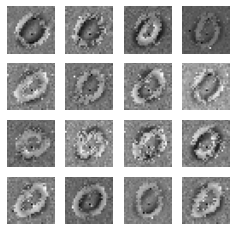

63
gen_loss: tf.Tensor(3.2324562, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.052964035, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06393773, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.62545746e-13]
 [1.00000000e+00 8.09041216e-14]
 [1.00000000e+00 5.64714107e-08]
 [1.00000000e+00 9.38391101e-11]
 [1.00000000e+00 3.03866543e-10]
 [1.00000000e+00 1.28590489e-08]
 [1.00000000e+00 2.68484734e-10]
 [1.00000000e+00 1.87922247e-10]
 [1.00000000e+00 1.21728100e-10]
 [1.00000000e+00 5.51991164e-09]
 [1.00000000e+00 5.53550695e-12]
 [1.00000000e+00 8.05961634e-12]
 [9.99999285e-01 7.06914477e-07]
 [1.00000000e+00 3.37486879e-11]
 [1.00000000e+00 2.55914456e-10]
 [1.00000000e+00 5.62871472e-10]
 [1.00000000e+00 1.26311420e-10]
 [1.00000000e+00 6.97913255e-11]
 [1.00000000e+00 5.77062877e-11]
 [1.00000000e+00 2.41277484e-11]
 [9.96696591e-01 3.30343004e-03]
 [1.00000000e+00 2.45393007e-13]
 [1.00000000e+00 1.42699108e-11]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.3036594, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051418908, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06305818, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.88438458e-13]
 [1.00000000e+00 5.56073979e-14]
 [1.00000000e+00 3.57862397e-08]
 [1.00000000e+00 3.23205074e-11]
 [1.00000000e+00 1.21530910e-10]
 [1.00000000e+00 5.23263033e-09]
 [1.00000000e+00 1.13511547e-10]
 [1.00000000e+00 8.28972724e-11]
 [1.00000000e+00 4.96744382e-11]
 [1.00000000e+00 1.80621496e-09]
 [1.00000000e+00 1.97941208e-12]
 [1.00000000e+00 3.63490943e-12]
 [9.99999404e-01 5.45850867e-07]
 [1.00000000e+00 1.37911731e-11]
 [1.00000000e+00 1.02397077e-10]
 [1.00000000e+00 2.38221165e-10]
 [1.00000000e+00 4.92608038e-11]
 [1.00000000e+00 2.10022121e-11]
 [1.00000000e+00 2.25599938e-11]
 [1.00000000e+00 7.52555396e-12]
 [9.98058140e-01 1.94184645e-03]
 [1.00000000e+00 1.82323733e-13]
 [1.00000000e+00 4.02235016e-12]
 [1.00000000e+00 1.2

gen_loss: tf.Tensor(3.413272, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06921141, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.055453524, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.30354088e-13]
 [1.00000000e+00 3.06706293e-14]
 [1.00000000e+00 2.91825408e-08]
 [1.00000000e+00 1.25278442e-11]
 [1.00000000e+00 5.33852684e-11]
 [1.00000000e+00 1.44281964e-09]
 [1.00000000e+00 5.44006264e-11]
 [1.00000000e+00 4.37151322e-11]
 [1.00000000e+00 2.55508548e-11]
 [1.00000000e+00 5.22376253e-10]
 [1.00000000e+00 1.14395602e-12]
 [1.00000000e+00 1.60365568e-12]
 [9.99999404e-01 5.86037118e-07]
 [1.00000000e+00 4.97731457e-12]
 [1.00000000e+00 5.47400458e-11]
 [1.00000000e+00 7.38081679e-11]
 [1.00000000e+00 1.94968451e-11]
 [1.00000000e+00 6.03614381e-12]
 [1.00000000e+00 1.71528867e-11]
 [1.00000000e+00 2.65361583e-12]
 [9.98964667e-01 1.03531510e-03]
 [1.00000000e+00 1.03678473e-13]
 [1.00000000e+00 1.44464041e-12]
 [1.00000000e+00 4.86

gen_loss: tf.Tensor(3.389945, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.050614886, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.055304777, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.92722154e-13]
 [1.00000000e+00 1.13202142e-14]
 [1.00000000e+00 3.57592214e-08]
 [1.00000000e+00 1.43529745e-11]
 [1.00000000e+00 6.44011927e-11]
 [1.00000000e+00 1.26568567e-09]
 [1.00000000e+00 6.08208484e-11]
 [1.00000000e+00 5.61710747e-11]
 [1.00000000e+00 2.54501732e-11]
 [1.00000000e+00 6.38242847e-10]
 [1.00000000e+00 2.85850380e-12]
 [1.00000000e+00 1.34013709e-12]
 [9.99999046e-01 9.01216481e-07]
 [1.00000000e+00 4.47881619e-12]
 [1.00000000e+00 5.71990337e-11]
 [1.00000000e+00 6.10662354e-11]
 [1.00000000e+00 2.22836419e-11]
 [1.00000000e+00 7.43613417e-12]
 [1.00000000e+00 2.68730507e-11]
 [1.00000000e+00 3.34631780e-12]
 [9.98629689e-01 1.37038424e-03]
 [1.00000000e+00 3.84318906e-14]
 [1.00000000e+00 2.07776006e-12]
 [1.00000000e+00 5.4

gen_loss: tf.Tensor(3.5528495, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.048464313, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05653974, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.24921154e-14]
 [1.00000000e+00 1.24386577e-14]
 [1.00000000e+00 1.05634319e-08]
 [1.00000000e+00 2.24859194e-12]
 [1.00000000e+00 1.17904124e-11]
 [1.00000000e+00 3.88712007e-10]
 [1.00000000e+00 1.34459275e-11]
 [1.00000000e+00 1.84441074e-11]
 [1.00000000e+00 5.09161723e-12]
 [1.00000000e+00 1.30401287e-10]
 [1.00000000e+00 6.54487423e-13]
 [1.00000000e+00 2.71006904e-13]
 [9.99999762e-01 2.31883845e-07]
 [1.00000000e+00 1.14668236e-12]
 [1.00000000e+00 1.01790451e-11]
 [1.00000000e+00 1.44530256e-11]
 [1.00000000e+00 4.36525382e-12]
 [1.00000000e+00 1.71616161e-12]
 [1.00000000e+00 5.52400009e-12]
 [1.00000000e+00 5.48589332e-13]
 [9.99675632e-01 3.24366265e-04]
 [1.00000000e+00 5.28159940e-14]
 [1.00000000e+00 2.84001934e-13]
 [1.00000000e+00 8.1

gen_loss: tf.Tensor(3.3589473, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.057866193, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.064329, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.42025094e-14]
 [1.00000000e+00 1.59164792e-14]
 [1.00000000e+00 7.21349291e-09]
 [1.00000000e+00 1.15251927e-12]
 [1.00000000e+00 4.09244687e-12]
 [1.00000000e+00 3.04817366e-10]
 [1.00000000e+00 6.52413800e-12]
 [1.00000000e+00 1.16503387e-11]
 [1.00000000e+00 2.36651258e-12]
 [1.00000000e+00 9.59547511e-11]
 [1.00000000e+00 2.35965137e-13]
 [1.00000000e+00 1.78824891e-13]
 [9.99999881e-01 8.43105070e-08]
 [1.00000000e+00 8.86523602e-13]
 [1.00000000e+00 4.55619873e-12]
 [1.00000000e+00 7.00768740e-12]
 [1.00000000e+00 1.91556493e-12]
 [1.00000000e+00 1.16338113e-12]
 [1.00000000e+00 2.42549015e-12]
 [1.00000000e+00 2.27590380e-13]
 [9.99794781e-01 2.05277218e-04]
 [1.00000000e+00 6.15484904e-14]
 [1.00000000e+00 1.08231119e-13]
 [1.00000000e+00 4.074

gen_loss: tf.Tensor(3.3301105, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0530074, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06274533, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.57883143e-14]
 [1.00000000e+00 9.31459601e-15]
 [1.00000000e+00 1.85858884e-08]
 [1.00000000e+00 4.97575765e-12]
 [1.00000000e+00 7.71819587e-12]
 [1.00000000e+00 8.53709881e-10]
 [1.00000000e+00 1.62007664e-11]
 [1.00000000e+00 2.00037122e-11]
 [1.00000000e+00 6.32138569e-12]
 [1.00000000e+00 5.94578775e-10]
 [1.00000000e+00 4.67752681e-13]
 [1.00000000e+00 8.49428763e-13]
 [9.99999881e-01 1.09238961e-07]
 [1.00000000e+00 2.47326270e-12]
 [1.00000000e+00 1.24786223e-11]
 [1.00000000e+00 1.26199624e-11]
 [1.00000000e+00 4.64106618e-12]
 [1.00000000e+00 4.09614833e-12]
 [1.00000000e+00 5.01773970e-12]
 [1.00000000e+00 6.68067218e-13]
 [9.99369323e-01 6.30655966e-04]
 [1.00000000e+00 2.76219613e-14]
 [1.00000000e+00 3.98433727e-13]
 [1.00000000e+00 1.770

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.05587361e-14]
 [1.00000000e+00 9.37777281e-15]
 [1.00000000e+00 2.00826094e-08]
 [1.00000000e+00 4.44702261e-12]
 [1.00000000e+00 5.65291650e-12]
 [1.00000000e+00 5.16061971e-10]
 [1.00000000e+00 1.41982094e-11]
 [1.00000000e+00 1.88650467e-11]
 [1.00000000e+00 6.25918978e-12]
 [1.00000000e+00 4.58121263e-10]
 [1.00000000e+00 4.27368942e-13]
 [1.00000000e+00 6.67271305e-13]
 [9.99999881e-01 1.01545922e-07]
 [1.00000000e+00 1.33996839e-12]
 [1.00000000e+00 1.22559740e-11]
 [1.00000000e+00 7.24908068e-12]
 [1.00000000e+00 3.08632590e-12]
 [1.00000000e+00 3.33870561e-12]
 [1.00000000e+00 5.20953853e-12]
 [1.00000000e+00 5.61130894e-13]
 [9.99418378e-01 5.81657456e-04]
 [1.00000000e+00 2.67457870e-14]
 [1.00000000e+00 3.55736870e-13]
 [1.00000000e+00 1.50421537e-12]
 [1.00000000e+00 1.09293716e-12]
 [1.00000000e+00 7.34183381e-09]
 [1.00000000e+00 6.01538697e-12]
 [1.00000000e+00 1.64892503e-12]
 [9.99966264e-01 3.37436613e-05]
 [1.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.09218522e-14]
 [1.00000000e+00 1.15000164e-14]
 [1.00000000e+00 1.90134699e-08]
 [1.00000000e+00 3.28128106e-12]
 [1.00000000e+00 3.81404890e-12]
 [1.00000000e+00 2.85979351e-10]
 [1.00000000e+00 1.10550458e-11]
 [1.00000000e+00 1.94381768e-11]
 [1.00000000e+00 5.44670472e-12]
 [1.00000000e+00 2.77822210e-10]
 [1.00000000e+00 3.90080248e-13]
 [1.00000000e+00 4.11253117e-13]
 [9.99999881e-01 8.76812649e-08]
 [1.00000000e+00 5.76447364e-13]
 [1.00000000e+00 1.05665997e-11]
 [1.00000000e+00 3.88830244e-12]
 [1.00000000e+00 1.89328761e-12]
 [1.00000000e+00 2.44633740e-12]
 [1.00000000e+00 4.89247184e-12]
 [1.00000000e+00 4.18991800e-13]
 [9.99571025e-01 4.28910658e-04]
 [1.00000000e+00 3.26017967e-14]
 [1.00000000e+00 2.71023953e-13]
 [1.00000000e+00 1.04731718e-12]
 [1.00000000e+00 7.64035807e-13]
 [1.00000000e+00 5.47419798e-09]
 [1.00000000e+00 4.91393471e-12]
 [1.00000000e+00 1.54088276e-12]
 [9.99981284e-01 1.87666683e-05]
 [1.0

gen_loss: tf.Tensor(3.2316532, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.067444906, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0740269, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.42057486e-14]
 [1.00000000e+00 5.13312935e-15]
 [1.00000000e+00 1.39985454e-08]
 [1.00000000e+00 1.81362390e-12]
 [1.00000000e+00 2.04036094e-12]
 [1.00000000e+00 1.57425142e-10]
 [1.00000000e+00 5.53720698e-12]
 [1.00000000e+00 9.05234221e-12]
 [1.00000000e+00 2.47958251e-12]
 [1.00000000e+00 1.86421767e-10]
 [1.00000000e+00 1.86292469e-13]
 [1.00000000e+00 2.62281895e-13]
 [9.99999881e-01 7.59759473e-08]
 [1.00000000e+00 2.84604398e-13]
 [1.00000000e+00 5.24255249e-12]
 [1.00000000e+00 1.51947823e-12]
 [1.00000000e+00 8.79138179e-13]
 [1.00000000e+00 1.15995787e-12]
 [1.00000000e+00 2.01137739e-12]
 [1.00000000e+00 1.85330240e-13]
 [9.99455512e-01 5.44525392e-04]
 [1.00000000e+00 1.49782937e-14]
 [1.00000000e+00 1.28899075e-13]
 [1.00000000e+00 5.75

gen_loss: tf.Tensor(3.351801, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.049816202, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.060042024, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.26087347e-15]
 [1.00000000e+00 3.01979909e-15]
 [1.00000000e+00 9.53325952e-09]
 [1.00000000e+00 1.02238118e-12]
 [1.00000000e+00 1.11287054e-12]
 [1.00000000e+00 1.24437377e-10]
 [1.00000000e+00 2.66059961e-12]
 [1.00000000e+00 3.49383847e-12]
 [1.00000000e+00 9.09111328e-13]
 [1.00000000e+00 1.40718270e-10]
 [1.00000000e+00 6.70079362e-14]
 [1.00000000e+00 2.23978171e-13]
 [1.00000000e+00 3.98785218e-08]
 [1.00000000e+00 2.95656837e-13]
 [1.00000000e+00 2.09664599e-12]
 [1.00000000e+00 7.48955097e-13]
 [1.00000000e+00 4.82022083e-13]
 [1.00000000e+00 4.95743420e-13]
 [1.00000000e+00 6.56499052e-13]
 [1.00000000e+00 6.55300263e-14]
 [9.99436796e-01 5.63162495e-04]
 [1.00000000e+00 1.02003113e-14]
 [1.00000000e+00 4.56872496e-14]
 [1.00000000e+00 3.3

gen_loss: tf.Tensor(3.4592168, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.060336147, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05120986, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.47478687e-15]
 [1.00000000e+00 1.97244814e-15]
 [1.00000000e+00 1.62173013e-08]
 [1.00000000e+00 1.30700962e-12]
 [1.00000000e+00 1.31234541e-12]
 [1.00000000e+00 8.39808917e-11]
 [1.00000000e+00 3.26897493e-12]
 [1.00000000e+00 2.61636481e-12]
 [1.00000000e+00 1.08715727e-12]
 [1.00000000e+00 6.28546451e-11]
 [1.00000000e+00 5.12032230e-14]
 [1.00000000e+00 1.86281085e-13]
 [1.00000000e+00 5.32673639e-08]
 [1.00000000e+00 3.10824147e-13]
 [1.00000000e+00 2.63782594e-12]
 [1.00000000e+00 5.27806748e-13]
 [1.00000000e+00 4.06599125e-13]
 [1.00000000e+00 2.93702562e-13]
 [1.00000000e+00 1.14860866e-12]
 [1.00000000e+00 5.05754225e-14]
 [9.99093533e-01 9.06502712e-04]
 [1.00000000e+00 6.38813656e-15]
 [1.00000000e+00 3.51738427e-14]
 [1.00000000e+00 4.2

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.12413037e-15]
 [1.00000000e+00 1.85162228e-15]
 [1.00000000e+00 1.88505425e-08]
 [1.00000000e+00 1.91965779e-12]
 [1.00000000e+00 2.04314148e-12]
 [1.00000000e+00 1.17424584e-10]
 [1.00000000e+00 4.31887599e-12]
 [1.00000000e+00 3.71815035e-12]
 [1.00000000e+00 1.39501670e-12]
 [1.00000000e+00 8.13467835e-11]
 [1.00000000e+00 7.69772294e-14]
 [1.00000000e+00 1.97577875e-13]
 [9.99999881e-01 5.97708478e-08]
 [1.00000000e+00 3.30175828e-13]
 [1.00000000e+00 3.23362756e-12]
 [1.00000000e+00 6.93466009e-13]
 [1.00000000e+00 4.88256896e-13]
 [1.00000000e+00 4.48810937e-13]
 [1.00000000e+00 1.23019650e-12]
 [1.00000000e+00 7.14757097e-14]
 [9.98845339e-01 1.15459785e-03]
 [1.00000000e+00 6.28176066e-15]
 [1.00000000e+00 4.88129976e-14]
 [1.00000000e+00 6.33596420e-13]
 [1.00000000e+00 1.89200516e-13]
 [1.00000000e+00 2.56389487e-09]
 [1.00000000e+00 1.31554576e-12]
 [1.00000000e+00 5.00658055e-13]
 [9.99942422e-01 5.75493723e-05]
 [1.0

gen_loss: tf.Tensor(3.349409, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.054825492, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05835869, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.97441657e-15]
 [1.00000000e+00 1.77490968e-15]
 [1.00000000e+00 2.14934506e-08]
 [1.00000000e+00 2.67834886e-12]
 [1.00000000e+00 3.35582213e-12]
 [1.00000000e+00 1.73266776e-10]
 [1.00000000e+00 5.55155748e-12]
 [1.00000000e+00 6.07228720e-12]
 [1.00000000e+00 1.59858628e-12]
 [1.00000000e+00 1.25734534e-10]
 [1.00000000e+00 1.65417213e-13]
 [1.00000000e+00 1.59549362e-13]
 [1.00000000e+00 5.70518104e-08]
 [1.00000000e+00 3.39393390e-13]
 [1.00000000e+00 3.15437368e-12]
 [1.00000000e+00 8.84490072e-13]
 [1.00000000e+00 5.26398207e-13]
 [1.00000000e+00 9.54808932e-13]
 [1.00000000e+00 8.71707925e-13]
 [1.00000000e+00 1.17743543e-13]
 [9.98274446e-01 1.72551500e-03]
 [1.00000000e+00 6.28674714e-15]
 [1.00000000e+00 7.49373369e-14]
 [1.00000000e+00 9.20

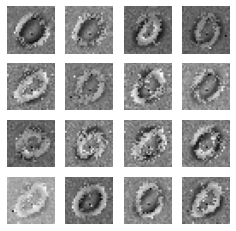

64
gen_loss: tf.Tensor(3.2981005, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.041289065, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05692964, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.99511519e-15]
 [1.00000000e+00 1.49280049e-15]
 [1.00000000e+00 2.08689528e-08]
 [1.00000000e+00 2.57833338e-12]
 [1.00000000e+00 3.77811497e-12]
 [1.00000000e+00 1.82960119e-10]
 [1.00000000e+00 5.33851435e-12]
 [1.00000000e+00 5.87276885e-12]
 [1.00000000e+00 1.42211850e-12]
 [1.00000000e+00 1.37288750e-10]
 [1.00000000e+00 1.84475726e-13]
 [1.00000000e+00 1.36517710e-13]
 [1.00000000e+00 5.88080660e-08]
 [1.00000000e+00 3.37974792e-13]
 [1.00000000e+00 2.58037493e-12]
 [1.00000000e+00 8.88256753e-13]
 [1.00000000e+00 4.84597714e-13]
 [1.00000000e+00 1.14213348e-12]
 [1.00000000e+00 6.13257600e-13]
 [1.00000000e+00 1.22738571e-13]
 [9.97737765e-01 2.26218347e-03]
 [1.00000000e+00 5.29609256e-15]
 [1.00000000e+00 7.81985425e-14]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.4665818, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.037523188, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.052991882, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.72425066e-15]
 [1.00000000e+00 9.67102197e-16]
 [1.00000000e+00 1.09350653e-08]
 [1.00000000e+00 7.88597161e-13]
 [1.00000000e+00 1.58197045e-12]
 [1.00000000e+00 6.17311688e-11]
 [1.00000000e+00 1.91791570e-12]
 [1.00000000e+00 1.98872537e-12]
 [1.00000000e+00 4.20452816e-13]
 [1.00000000e+00 2.84851240e-11]
 [1.00000000e+00 5.58134336e-14]
 [1.00000000e+00 3.72274504e-14]
 [1.00000000e+00 4.10640446e-08]
 [1.00000000e+00 1.58668068e-13]
 [1.00000000e+00 7.23231100e-13]
 [1.00000000e+00 3.12138282e-13]
 [1.00000000e+00 1.50970734e-13]
 [1.00000000e+00 3.30228737e-13]
 [1.00000000e+00 2.35859834e-13]
 [1.00000000e+00 2.95100045e-14]
 [9.98394668e-01 1.60530698e-03]
 [1.00000000e+00 3.72898251e-15]
 [1.00000000e+00 2.08035934e-14]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(3.4780958, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.054097116, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049115244, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.32815984e-15]
 [1.00000000e+00 1.03763632e-15]
 [1.00000000e+00 7.28143457e-09]
 [1.00000000e+00 3.68160797e-13]
 [1.00000000e+00 8.69376674e-13]
 [1.00000000e+00 3.08019964e-11]
 [1.00000000e+00 9.88569903e-13]
 [1.00000000e+00 9.07782313e-13]
 [1.00000000e+00 1.83677319e-13]
 [1.00000000e+00 1.31500947e-11]
 [1.00000000e+00 2.40264046e-14]
 [1.00000000e+00 2.19337809e-14]
 [1.00000000e+00 2.43241196e-08]
 [1.00000000e+00 1.58962809e-13]
 [1.00000000e+00 3.07916263e-13]
 [1.00000000e+00 1.51396067e-13]
 [1.00000000e+00 7.59852860e-14]
 [1.00000000e+00 1.47491503e-13]
 [1.00000000e+00 1.38068986e-13]
 [1.00000000e+00 1.06444225e-14]
 [9.98872697e-01 1.12730649e-03]
 [1.00000000e+00 3.66636941e-15]
 [1.00000000e+00 8.57730973e-15]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.4609327, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.046523962, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.054782838, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.56174622e-15]
 [1.00000000e+00 9.15194006e-16]
 [1.00000000e+00 1.16647421e-08]
 [1.00000000e+00 6.44647855e-13]
 [1.00000000e+00 1.27750978e-12]
 [1.00000000e+00 3.65926525e-11]
 [1.00000000e+00 1.57210139e-12]
 [1.00000000e+00 1.05428394e-12]
 [1.00000000e+00 3.04564696e-13]
 [1.00000000e+00 2.15436557e-11]
 [1.00000000e+00 3.91715096e-14]
 [1.00000000e+00 4.60031793e-14]
 [1.00000000e+00 2.44505944e-08]
 [1.00000000e+00 3.03721214e-13]
 [1.00000000e+00 5.26624154e-13]
 [1.00000000e+00 1.77163080e-13]
 [1.00000000e+00 1.24015192e-13]
 [1.00000000e+00 2.05056214e-13]
 [1.00000000e+00 2.57279549e-13]
 [1.00000000e+00 1.52746756e-14]
 [9.98577833e-01 1.42212189e-03]
 [1.00000000e+00 2.53590272e-15]
 [1.00000000e+00 1.44960727e-14]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(3.5183017, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043370932, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.047982004, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.20850627e-15]
 [1.00000000e+00 4.61295731e-16]
 [1.00000000e+00 2.00386090e-08]
 [1.00000000e+00 1.49709693e-12]
 [1.00000000e+00 1.91981153e-12]
 [1.00000000e+00 3.89562410e-11]
 [1.00000000e+00 3.07881194e-12]
 [1.00000000e+00 1.41309306e-12]
 [1.00000000e+00 7.45833191e-13]
 [1.00000000e+00 3.66878333e-11]
 [1.00000000e+00 7.64624366e-14]
 [1.00000000e+00 1.38062657e-13]
 [1.00000000e+00 2.23912959e-08]
 [1.00000000e+00 2.71500460e-13]
 [1.00000000e+00 1.29138096e-12]
 [1.00000000e+00 1.98165499e-13]
 [1.00000000e+00 2.28316037e-13]
 [1.00000000e+00 2.73798508e-13]
 [1.00000000e+00 5.42868647e-13]
 [1.00000000e+00 2.63318352e-14]
 [9.98731196e-01 1.26880244e-03]
 [1.00000000e+00 1.41628567e-15]
 [1.00000000e+00 2.93388869e-14]
 [1.00000000e+00 5.

gen_loss: tf.Tensor(3.4184253, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05148054, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05418838, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.33503351e-15]
 [1.00000000e+00 4.40631754e-16]
 [1.00000000e+00 2.21084058e-08]
 [1.00000000e+00 1.25759830e-12]
 [1.00000000e+00 1.23897507e-12]
 [1.00000000e+00 2.32487918e-11]
 [1.00000000e+00 2.48829039e-12]
 [1.00000000e+00 1.50078214e-12]
 [1.00000000e+00 7.53928495e-13]
 [1.00000000e+00 1.85803300e-11]
 [1.00000000e+00 5.87259462e-14]
 [1.00000000e+00 1.28853118e-13]
 [1.00000000e+00 1.70385910e-08]
 [1.00000000e+00 1.29486780e-13]
 [1.00000000e+00 1.25043476e-12]
 [1.00000000e+00 1.21123204e-13]
 [1.00000000e+00 1.68202691e-13]
 [1.00000000e+00 1.81313867e-13]
 [1.00000000e+00 5.77955598e-13]
 [1.00000000e+00 1.92398113e-14]
 [9.99117434e-01 8.82540713e-04]
 [1.00000000e+00 1.39192077e-15]
 [1.00000000e+00 2.06452812e-14]
 [1.00000000e+00 4.48

disc_fake_loss: tf.Tensor(0.04683903, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.70798212e-15]
 [1.00000000e+00 3.99716462e-16]
 [1.00000000e+00 1.94141592e-08]
 [1.00000000e+00 8.90205553e-13]
 [1.00000000e+00 8.85128017e-13]
 [1.00000000e+00 2.05918685e-11]
 [1.00000000e+00 1.72124934e-12]
 [1.00000000e+00 1.38027458e-12]
 [1.00000000e+00 5.08028407e-13]
 [1.00000000e+00 1.34437739e-11]
 [1.00000000e+00 4.02934860e-14]
 [1.00000000e+00 1.01144909e-13]
 [1.00000000e+00 1.61062044e-08]
 [1.00000000e+00 1.11117319e-13]
 [1.00000000e+00 8.39481371e-13]
 [1.00000000e+00 9.50864685e-14]
 [1.00000000e+00 1.29146151e-13]
 [1.00000000e+00 1.40426340e-13]
 [1.00000000e+00 4.12480976e-13]
 [1.00000000e+00 1.31116558e-14]
 [9.99082804e-01 9.17148718e-04]
 [1.00000000e+00 1.22072832e-15]
 [1.00000000e+00 1.35503054e-14]
 [1.00000000e+00 3.23711869e-13]
 [1.00000000e+00 7.44856108e-14]
 [1.00000000e+00 9.85690640e-10]
 [1.00000000e+00 3.11279783e-13]
 [1.0000

gen_loss: tf.Tensor(3.3356204, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04338734, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05253418, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.01049548e-15]
 [1.00000000e+00 3.20955845e-16]
 [1.00000000e+00 1.30663835e-08]
 [1.00000000e+00 4.30706062e-13]
 [1.00000000e+00 5.92994566e-13]
 [1.00000000e+00 2.09099994e-11]
 [1.00000000e+00 8.17492395e-13]
 [1.00000000e+00 1.25514920e-12]
 [1.00000000e+00 2.05381095e-13]
 [1.00000000e+00 8.41244956e-12]
 [1.00000000e+00 2.58762721e-14]
 [1.00000000e+00 4.79798425e-14]
 [1.00000000e+00 1.76396782e-08]
 [1.00000000e+00 1.03615806e-13]
 [1.00000000e+00 3.36175911e-13]
 [1.00000000e+00 8.19782610e-14]
 [1.00000000e+00 9.18983721e-14]
 [1.00000000e+00 1.07338895e-13]
 [1.00000000e+00 1.83484738e-13]
 [1.00000000e+00 7.39971879e-15]
 [9.98733222e-01 1.26682571e-03]
 [1.00000000e+00 9.82271922e-16]
 [1.00000000e+00 7.00794403e-15]
 [1.00000000e+00 1.67

gen_loss: tf.Tensor(3.4936073, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051681932, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06268875, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.11452114e-16]
 [1.00000000e+00 3.23670447e-17]
 [1.00000000e+00 9.99221861e-09]
 [1.00000000e+00 1.19984331e-13]
 [1.00000000e+00 1.09768728e-13]
 [1.00000000e+00 4.72825425e-12]
 [1.00000000e+00 2.26009722e-13]
 [1.00000000e+00 1.62284601e-13]
 [1.00000000e+00 7.99792497e-14]
 [1.00000000e+00 1.40002257e-12]
 [1.00000000e+00 5.35962511e-15]
 [1.00000000e+00 2.36075757e-14]
 [1.00000000e+00 1.99460235e-08]
 [1.00000000e+00 1.06285982e-14]
 [1.00000000e+00 1.15827703e-13]
 [1.00000000e+00 1.55692889e-14]
 [1.00000000e+00 3.71730980e-14]
 [1.00000000e+00 2.09703572e-14]
 [1.00000000e+00 4.38308650e-14]
 [1.00000000e+00 2.14929634e-15]
 [9.98273015e-01 1.72697927e-03]
 [1.00000000e+00 1.12578024e-16]
 [1.00000000e+00 2.36059443e-15]
 [1.00000000e+00 5.0

gen_loss: tf.Tensor(3.3467524, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.045318693, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.053886253, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.88334560e-16]
 [1.00000000e+00 1.00480223e-16]
 [1.00000000e+00 1.87587244e-08]
 [1.00000000e+00 6.71399649e-14]
 [1.00000000e+00 8.84881090e-14]
 [1.00000000e+00 4.22027777e-12]
 [1.00000000e+00 1.47813118e-13]
 [1.00000000e+00 5.09139118e-13]
 [1.00000000e+00 4.95864200e-14]
 [1.00000000e+00 2.21453324e-12]
 [1.00000000e+00 1.50340217e-14]
 [1.00000000e+00 8.41397722e-15]
 [1.00000000e+00 4.11596304e-08]
 [1.00000000e+00 1.70911055e-14]
 [1.00000000e+00 7.25549178e-14]
 [1.00000000e+00 1.02415228e-14]
 [1.00000000e+00 3.84983623e-14]
 [1.00000000e+00 2.91251229e-14]
 [1.00000000e+00 7.61493733e-14]
 [1.00000000e+00 2.75388305e-15]
 [9.97444510e-01 2.55555497e-03]
 [1.00000000e+00 2.43323264e-16]
 [1.00000000e+00 3.08575606e-15]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(3.4800768, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05596358, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06696715, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.90585082e-16]
 [1.00000000e+00 3.87450803e-17]
 [1.00000000e+00 2.36302640e-08]
 [1.00000000e+00 3.17506268e-14]
 [1.00000000e+00 3.63907479e-14]
 [1.00000000e+00 1.34491528e-12]
 [1.00000000e+00 8.54191934e-14]
 [1.00000000e+00 1.26030154e-13]
 [1.00000000e+00 3.94263615e-14]
 [1.00000000e+00 5.20326024e-13]
 [1.00000000e+00 2.85176850e-15]
 [1.00000000e+00 5.27816257e-15]
 [1.00000000e+00 3.37578143e-08]
 [1.00000000e+00 5.59297761e-15]
 [1.00000000e+00 5.43989868e-14]
 [1.00000000e+00 3.92787770e-15]
 [1.00000000e+00 1.53714440e-14]
 [1.00000000e+00 5.83671303e-15]
 [1.00000000e+00 7.70664050e-14]
 [1.00000000e+00 9.95398603e-16]
 [9.98187244e-01 1.81271310e-03]
 [1.00000000e+00 1.25181385e-16]
 [1.00000000e+00 1.27655785e-15]
 [1.00000000e+00 1.40

gen_loss: tf.Tensor(3.4845967, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0704799, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06112478, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.34485183e-17]
 [1.00000000e+00 1.05758424e-17]
 [1.00000000e+00 1.90145588e-08]
 [1.00000000e+00 3.26031011e-14]
 [1.00000000e+00 3.06068139e-14]
 [1.00000000e+00 1.65272874e-12]
 [1.00000000e+00 7.58386138e-14]
 [1.00000000e+00 3.82960807e-14]
 [1.00000000e+00 3.86510316e-14]
 [1.00000000e+00 8.49655578e-13]
 [1.00000000e+00 9.08023343e-16]
 [1.00000000e+00 9.38754418e-15]
 [1.00000000e+00 1.32788083e-08]
 [1.00000000e+00 5.00453239e-15]
 [1.00000000e+00 4.48058881e-14]
 [1.00000000e+00 4.43084459e-15]
 [1.00000000e+00 1.34070332e-14]
 [1.00000000e+00 5.04597686e-15]
 [1.00000000e+00 3.40420814e-14]
 [1.00000000e+00 8.15684417e-16]
 [9.98006523e-01 1.99352927e-03]
 [1.00000000e+00 4.45820472e-17]
 [1.00000000e+00 1.05530437e-15]
 [1.00000000e+00 1.447

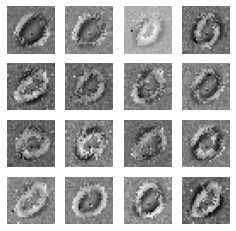

65
gen_loss: tf.Tensor(3.4265537, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07013109, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0645778, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.17937109e-16]
 [1.00000000e+00 2.73789586e-17]
 [1.00000000e+00 1.00189359e-08]
 [1.00000000e+00 1.63017301e-14]
 [1.00000000e+00 2.89257110e-14]
 [1.00000000e+00 2.27755510e-12]
 [1.00000000e+00 3.93974946e-14]
 [1.00000000e+00 6.35375067e-14]
 [1.00000000e+00 1.69589430e-14]
 [1.00000000e+00 1.43972757e-12]
 [1.00000000e+00 1.08548564e-15]
 [1.00000000e+00 2.48530796e-15]
 [1.00000000e+00 4.53937776e-09]
 [1.00000000e+00 1.08464178e-14]
 [1.00000000e+00 1.65962604e-14]
 [1.00000000e+00 5.20788170e-15]
 [1.00000000e+00 8.25548634e-15]
 [1.00000000e+00 1.29735166e-14]
 [1.00000000e+00 1.41247182e-14]
 [1.00000000e+00 8.45544710e-16]
 [9.98040140e-01 1.95991201e-03]
 [1.00000000e+00 8.07701634e-17]
 [1.00000000e+00 7.77565869e-16]
 [1.00000000e+00 6.

 [1.00000000e+00 5.64715612e-14]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.3573704, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05689032, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.058731206, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.38091432e-16]
 [1.00000000e+00 4.93060526e-17]
 [1.00000000e+00 9.82091830e-09]
 [1.00000000e+00 1.27958625e-14]
 [1.00000000e+00 3.46643423e-14]
 [1.00000000e+00 1.96712373e-12]
 [1.00000000e+00 3.57929561e-14]
 [1.00000000e+00 1.17159293e-13]
 [1.00000000e+00 1.54968506e-14]
 [1.00000000e+00 1.18870051e-12]
 [1.00000000e+00 1.54212703e-15]
 [1.00000000e+00 1.08662903e-15]
 [1.00000000e+00 5.12314857e-09]
 [1.00000000e+00 1.14503328e-14]
 [1.00000000e+00 1.47877909e-14]
 [1.00000000e+00 5.56790078e-15]
 [1.00000000e+00 6.50474463e-15]
 [1.00000000e+00 1.72520825e-14]
 [1.00000000e+00 1.89999265e-14]
 [1.00000000e+00 9.55536174e-16]
 [9.98063743e-01 1.93626247e-03]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.3197923, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04362649, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06711438, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.09620263e-16]
 [1.00000000e+00 8.42238211e-17]
 [1.00000000e+00 1.07559686e-08]
 [1.00000000e+00 1.26865046e-14]
 [1.00000000e+00 4.21840636e-14]
 [1.00000000e+00 1.66089440e-12]
 [1.00000000e+00 3.90517019e-14]
 [1.00000000e+00 1.64640382e-13]
 [1.00000000e+00 1.91602342e-14]
 [1.00000000e+00 9.84103641e-13]
 [1.00000000e+00 1.73571302e-15]
 [1.00000000e+00 8.38734248e-16]
 [1.00000000e+00 5.20934806e-09]
 [1.00000000e+00 1.06427572e-14]
 [1.00000000e+00 1.79684352e-14]
 [1.00000000e+00 6.14559080e-15]
 [1.00000000e+00 5.51799952e-15]
 [1.00000000e+00 1.89824319e-14]
 [1.00000000e+00 2.72690348e-14]
 [1.00000000e+00 1.08961768e-15]
 [9.98468816e-01 1.53112481e-03]
 [1.00000000e+00 1.97335780e-16]
 [1.00000000e+00 8.63386718e-16]
 [1.00000000e+00 4.74

gen_loss: tf.Tensor(3.1868272, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04177693, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08346188, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.12274790e-16]
 [1.00000000e+00 3.63474080e-17]
 [1.00000000e+00 1.57058206e-08]
 [1.00000000e+00 4.00565540e-14]
 [1.00000000e+00 1.11504569e-13]
 [1.00000000e+00 4.26953655e-12]
 [1.00000000e+00 7.80172368e-14]
 [1.00000000e+00 1.19865150e-13]
 [1.00000000e+00 3.73428705e-14]
 [1.00000000e+00 6.11298295e-12]
 [1.00000000e+00 1.53683000e-15]
 [1.00000000e+00 6.20452735e-15]
 [1.00000000e+00 5.57061597e-09]
 [1.00000000e+00 2.20564076e-14]
 [1.00000000e+00 3.41418923e-14]
 [1.00000000e+00 1.77403394e-14]
 [1.00000000e+00 1.07099981e-14]
 [1.00000000e+00 3.67775980e-14]
 [1.00000000e+00 2.60173658e-14]
 [1.00000000e+00 2.38955025e-15]
 [9.97213900e-01 2.78609898e-03]
 [1.00000000e+00 1.31317649e-16]
 [1.00000000e+00 2.23564796e-15]
 [1.00000000e+00 1.66

gen_loss: tf.Tensor(3.278986, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.038310897, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.062451154, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.98798644e-16]
 [1.00000000e+00 5.33176403e-17]
 [1.00000000e+00 3.04256567e-08]
 [1.00000000e+00 7.92884638e-14]
 [1.00000000e+00 2.94967962e-13]
 [1.00000000e+00 9.15227269e-12]
 [1.00000000e+00 1.37477730e-13]
 [1.00000000e+00 2.54951388e-13]
 [1.00000000e+00 5.18522637e-14]
 [1.00000000e+00 2.07535308e-11]
 [1.00000000e+00 2.15188890e-15]
 [1.00000000e+00 1.70318132e-14]
 [1.00000000e+00 1.41658250e-08]
 [1.00000000e+00 8.82814329e-14]
 [1.00000000e+00 5.23006253e-14]
 [1.00000000e+00 3.90406803e-14]
 [1.00000000e+00 1.88663121e-14]
 [1.00000000e+00 5.86673993e-14]
 [1.00000000e+00 6.16299004e-14]
 [1.00000000e+00 3.93150512e-15]
 [9.95369136e-01 4.63082595e-03]
 [1.00000000e+00 2.12557651e-16]
 [1.00000000e+00 3.99979037e-15]
 [1.00000000e+00 3.6

gen_loss: tf.Tensor(3.3718045, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.057390712, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.056176912, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.87541471e-16]
 [1.00000000e+00 7.36414547e-17]
 [1.00000000e+00 2.58798565e-08]
 [1.00000000e+00 2.43552432e-14]
 [1.00000000e+00 1.77547349e-13]
 [1.00000000e+00 3.48827174e-12]
 [1.00000000e+00 7.74163042e-14]
 [1.00000000e+00 2.23142414e-13]
 [1.00000000e+00 2.42884868e-14]
 [1.00000000e+00 3.87462892e-12]
 [1.00000000e+00 1.35232135e-15]
 [1.00000000e+00 4.63274591e-15]
 [1.00000000e+00 1.61449574e-08]
 [1.00000000e+00 3.08791248e-14]
 [1.00000000e+00 2.07838422e-14]
 [1.00000000e+00 2.17965735e-14]
 [1.00000000e+00 9.17235546e-15]
 [1.00000000e+00 1.71178582e-14]
 [1.00000000e+00 5.40337462e-14]
 [1.00000000e+00 1.56787673e-15]
 [9.98045921e-01 1.95404072e-03]
 [1.00000000e+00 2.99130638e-16]
 [1.00000000e+00 1.33609230e-15]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.4397435, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.095093854, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051367834, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.90843453e-16]
 [1.00000000e+00 3.00103145e-17]
 [1.00000000e+00 2.87479232e-08]
 [1.00000000e+00 1.62259156e-14]
 [1.00000000e+00 1.16778467e-13]
 [1.00000000e+00 1.65477896e-12]
 [1.00000000e+00 6.18890518e-14]
 [1.00000000e+00 1.24755390e-13]
 [1.00000000e+00 1.96527653e-14]
 [1.00000000e+00 1.72982613e-12]
 [1.00000000e+00 9.05242745e-16]
 [1.00000000e+00 3.31894190e-15]
 [1.00000000e+00 1.93709191e-08]
 [1.00000000e+00 1.09615525e-14]
 [1.00000000e+00 1.49603349e-14]
 [1.00000000e+00 1.30072878e-14]
 [1.00000000e+00 6.86534942e-15]
 [1.00000000e+00 7.50638988e-15]
 [1.00000000e+00 4.39301305e-14]
 [1.00000000e+00 1.00865467e-15]
 [9.98274326e-01 1.72572455e-03]
 [1.00000000e+00 1.19104029e-16]
 [1.00000000e+00 8.82049289e-16]
 [1.00000000e+00 7.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.35169513e-16]
 [1.00000000e+00 1.84431713e-17]
 [1.00000000e+00 4.27190727e-08]
 [1.00000000e+00 1.72143793e-14]
 [1.00000000e+00 1.09155957e-13]
 [1.00000000e+00 1.26276116e-12]
 [1.00000000e+00 7.23755094e-14]
 [1.00000000e+00 9.86275406e-14]
 [1.00000000e+00 2.45740894e-14]
 [1.00000000e+00 1.55643760e-12]
 [1.00000000e+00 8.59623827e-16]
 [1.00000000e+00 4.43541052e-15]
 [1.00000000e+00 2.59792134e-08]
 [1.00000000e+00 7.70729763e-15]
 [1.00000000e+00 1.73621392e-14]
 [1.00000000e+00 1.09690394e-14]
 [1.00000000e+00 7.51057169e-15]
 [1.00000000e+00 5.74576287e-15]
 [1.00000000e+00 5.05370417e-14]
 [1.00000000e+00 1.03345293e-15]
 [9.97942626e-01 2.05730577e-03]
 [1.00000000e+00 6.36497283e-17]
 [1.00000000e+00 9.31423581e-16]
 [1.00000000e+00 8.18671235e-15]
 [1.00000000e+00 3.73933833e-15]
 [1.00000000e+00 7.36753991e-11]
 [1.00000000e+00 1.50527292e-14]
 [1.00000000e+00 7.75773759e-15]
 [9.99999166e-01 8.16940883e-07]
 [1.0

gen_loss: tf.Tensor(3.2746444, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04552622, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.059139192, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.41356078e-16]
 [1.00000000e+00 2.56629162e-17]
 [9.99999881e-01 8.77794903e-08]
 [1.00000000e+00 4.64458590e-14]
 [1.00000000e+00 2.44173497e-13]
 [1.00000000e+00 3.25851672e-12]
 [1.00000000e+00 1.83490335e-13]
 [1.00000000e+00 1.66181874e-13]
 [1.00000000e+00 4.91282362e-14]
 [1.00000000e+00 7.46810079e-12]
 [1.00000000e+00 1.61730089e-15]
 [1.00000000e+00 1.45737795e-14]
 [1.00000000e+00 3.09261985e-08]
 [1.00000000e+00 2.58424365e-14]
 [1.00000000e+00 3.25766229e-14]
 [1.00000000e+00 2.19487209e-14]
 [1.00000000e+00 1.67062121e-14]
 [1.00000000e+00 1.68012780e-14]
 [1.00000000e+00 6.22376703e-14]
 [1.00000000e+00 2.49672046e-15]
 [9.96592820e-01 3.40720289e-03]
 [1.00000000e+00 8.78124218e-17]
 [1.00000000e+00 2.06312958e-15]
 [1.00000000e+00 2.4

gen_loss: tf.Tensor(3.2891884, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.062409423, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0681624, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.26797669e-16]
 [1.00000000e+00 1.32962856e-17]
 [1.00000000e+00 5.25261186e-08]
 [1.00000000e+00 2.50534643e-14]
 [1.00000000e+00 1.65801956e-13]
 [1.00000000e+00 1.59818686e-12]
 [1.00000000e+00 1.11100365e-13]
 [1.00000000e+00 9.98476272e-14]
 [1.00000000e+00 2.44636735e-14]
 [1.00000000e+00 3.26071765e-12]
 [1.00000000e+00 7.00844854e-16]
 [1.00000000e+00 6.24565673e-15]
 [1.00000000e+00 3.90609074e-08]
 [1.00000000e+00 1.10648168e-14]
 [1.00000000e+00 1.57297559e-14]
 [1.00000000e+00 1.20331711e-14]
 [1.00000000e+00 7.84720799e-15]
 [1.00000000e+00 6.62143570e-15]
 [1.00000000e+00 2.74929751e-14]
 [1.00000000e+00 1.11709236e-15]
 [9.97280359e-01 2.71956227e-03]
 [1.00000000e+00 5.93697304e-17]
 [1.00000000e+00 9.07514382e-16]
 [1.00000000e+00 1.39

gen_loss: tf.Tensor(3.4025946, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.061419692, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.055272583, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.36150198e-17]
 [1.00000000e+00 5.67117220e-18]
 [1.00000000e+00 2.96670990e-08]
 [1.00000000e+00 8.87503927e-15]
 [1.00000000e+00 8.01076463e-14]
 [1.00000000e+00 5.43920649e-13]
 [1.00000000e+00 4.46047381e-14]
 [1.00000000e+00 7.38790404e-14]
 [1.00000000e+00 8.34448748e-15]
 [1.00000000e+00 7.83833014e-13]
 [1.00000000e+00 4.02770043e-16]
 [1.00000000e+00 1.09734283e-15]
 [9.99999881e-01 6.77509533e-08]
 [1.00000000e+00 2.78536726e-15]
 [1.00000000e+00 5.13971291e-15]
 [1.00000000e+00 4.27314739e-15]
 [1.00000000e+00 2.42897709e-15]
 [1.00000000e+00 2.55865021e-15]
 [1.00000000e+00 1.16300724e-14]
 [1.00000000e+00 4.79302169e-16]
 [9.97191131e-01 2.80884933e-03]
 [1.00000000e+00 2.94150455e-17]
 [1.00000000e+00 3.27747170e-16]
 [1.00000000e+00 4.

disc_real_loss: tf.Tensor(0.06582294, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06640116, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.10892296e-16]
 [1.00000000e+00 6.54638099e-18]
 [1.00000000e+00 3.81800902e-08]
 [1.00000000e+00 1.56661895e-14]
 [1.00000000e+00 1.29403324e-13]
 [1.00000000e+00 1.02621828e-12]
 [1.00000000e+00 6.31257199e-14]
 [1.00000000e+00 1.53626596e-13]
 [1.00000000e+00 1.11387170e-14]
 [1.00000000e+00 2.16752072e-12]
 [1.00000000e+00 8.71699923e-16]
 [1.00000000e+00 1.53141079e-15]
 [9.99999881e-01 9.32799793e-08]
 [1.00000000e+00 4.92728213e-15]
 [1.00000000e+00 6.77742401e-15]
 [1.00000000e+00 6.93259028e-15]
 [1.00000000e+00 3.64385146e-15]
 [1.00000000e+00 6.57785670e-15]
 [1.00000000e+00 1.33348083e-14]
 [1.00000000e+00 1.06335807e-15]
 [9.95795131e-01 4.20490885e-03]
 [1.00000000e+00 3.25883155e-17]
 [1.00000000e+00 6.48088995e-16]
 [1.00000000e+00 8.78346231e-15]
 [1.00000000e+00 2.37907245e-15]
 [1.0000000

gen_loss: tf.Tensor(3.2640343, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07024116, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06367819, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.04581644e-16]
 [1.00000000e+00 7.45006671e-18]
 [1.00000000e+00 4.86294311e-08]
 [1.00000000e+00 3.87988287e-14]
 [1.00000000e+00 2.50912572e-13]
 [1.00000000e+00 2.21297937e-12]
 [1.00000000e+00 1.07241486e-13]
 [1.00000000e+00 3.00477200e-13]
 [1.00000000e+00 1.90841876e-14]
 [1.00000000e+00 7.06238019e-12]
 [1.00000000e+00 1.91724701e-15]
 [1.00000000e+00 3.41129750e-15]
 [9.99999881e-01 1.20721779e-07]
 [1.00000000e+00 9.90826531e-15]
 [1.00000000e+00 1.16993105e-14]
 [1.00000000e+00 1.26021909e-14]
 [1.00000000e+00 6.30639492e-15]
 [1.00000000e+00 1.86655145e-14]
 [1.00000000e+00 1.82047032e-14]
 [1.00000000e+00 2.74385820e-15]
 [9.94617403e-01 5.38263237e-03]
 [1.00000000e+00 4.06344006e-17]
 [1.00000000e+00 1.59391642e-15]
 [1.00000000e+00 2.11

gen_loss: tf.Tensor(3.3532, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03746157, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.067891166, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.61082046e-16]
 [1.00000000e+00 4.98543203e-18]
 [9.99999881e-01 6.20154381e-08]
 [1.00000000e+00 2.07011654e-13]
 [1.00000000e+00 8.51721092e-13]
 [1.00000000e+00 4.84346634e-12]
 [1.00000000e+00 3.25318684e-13]
 [1.00000000e+00 5.21065938e-13]
 [1.00000000e+00 6.69892811e-14]
 [1.00000000e+00 1.91528460e-11]
 [1.00000000e+00 4.47386582e-15]
 [1.00000000e+00 1.57124239e-14]
 [9.99999762e-01 1.78933888e-07]
 [1.00000000e+00 2.05056885e-14]
 [1.00000000e+00 4.56640781e-14]
 [1.00000000e+00 3.41678861e-14]
 [1.00000000e+00 1.53424755e-14]
 [1.00000000e+00 5.35715474e-14]
 [1.00000000e+00 5.89235353e-14]
 [1.00000000e+00 1.11185102e-14]
 [9.94759977e-01 5.23997238e-03]
 [1.00000000e+00 3.85550306e-17]
 [1.00000000e+00 6.89569141e-15]
 [1.00000000e+00 1.0430

gen_loss: tf.Tensor(3.2911863, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04990845, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061414644, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.70722541e-16]
 [1.00000000e+00 1.49337980e-17]
 [1.00000000e+00 3.13394821e-08]
 [1.00000000e+00 1.05223827e-13]
 [1.00000000e+00 5.10835569e-13]
 [1.00000000e+00 2.72790514e-12]
 [1.00000000e+00 1.77183355e-13]
 [1.00000000e+00 7.35893659e-13]
 [1.00000000e+00 4.36606521e-14]
 [1.00000000e+00 5.84583553e-12]
 [1.00000000e+00 4.03134532e-15]
 [1.00000000e+00 6.19409826e-15]
 [9.99999881e-01 1.00045611e-07]
 [1.00000000e+00 1.03635904e-14]
 [1.00000000e+00 2.95801083e-14]
 [1.00000000e+00 2.50333066e-14]
 [1.00000000e+00 9.75837351e-15]
 [1.00000000e+00 3.43499338e-14]
 [1.00000000e+00 4.96375198e-14]
 [1.00000000e+00 6.70559774e-15]
 [9.98433411e-01 1.56652322e-03]
 [1.00000000e+00 1.30362844e-16]
 [1.00000000e+00 3.81365742e-15]
 [1.00000000e+00 4.6

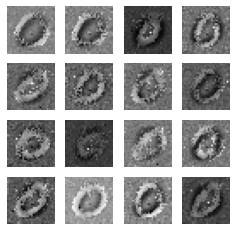

66
gen_loss: tf.Tensor(3.3968282, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06854573, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06638669, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.29180744e-16]
 [1.00000000e+00 3.57354664e-17]
 [1.00000000e+00 3.04558512e-08]
 [1.00000000e+00 1.08229472e-13]
 [1.00000000e+00 5.61532374e-13]
 [1.00000000e+00 3.57181797e-12]
 [1.00000000e+00 1.86946338e-13]
 [1.00000000e+00 1.16645181e-12]
 [1.00000000e+00 4.67396575e-14]
 [1.00000000e+00 7.65430601e-12]
 [1.00000000e+00 5.82256928e-15]
 [1.00000000e+00 6.09299852e-15]
 [9.99999881e-01 8.43270769e-08]
 [1.00000000e+00 1.63772109e-14]
 [1.00000000e+00 3.09973808e-14]
 [1.00000000e+00 3.29130678e-14]
 [1.00000000e+00 1.26228314e-14]
 [1.00000000e+00 4.98673572e-14]
 [1.00000000e+00 5.31520120e-14]
 [1.00000000e+00 8.85670863e-15]
 [9.98482287e-01 1.51770585e-03]
 [1.00000000e+00 2.44172202e-16]
 [1.00000000e+00 4.57500113e-15]
 [1.00000000e+00 4

gen_loss: tf.Tensor(3.331369, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07421957, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061222434, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.22047434e-16]
 [1.00000000e+00 3.99211856e-17]
 [1.00000000e+00 3.36583525e-08]
 [1.00000000e+00 1.14004346e-13]
 [1.00000000e+00 5.02932114e-13]
 [1.00000000e+00 5.37425139e-12]
 [1.00000000e+00 1.68078577e-13]
 [1.00000000e+00 8.61877627e-13]
 [1.00000000e+00 3.84305726e-14]
 [1.00000000e+00 1.68492165e-11]
 [1.00000000e+00 6.24451323e-15]
 [1.00000000e+00 8.92824988e-15]
 [9.99999881e-01 6.89704365e-08]
 [1.00000000e+00 2.76226982e-14]
 [1.00000000e+00 2.16028333e-14]
 [1.00000000e+00 3.88281462e-14]
 [1.00000000e+00 2.05845320e-14]
 [1.00000000e+00 5.74162435e-14]
 [1.00000000e+00 2.72800107e-14]
 [1.00000000e+00 1.13632629e-14]
 [9.96878147e-01 3.12190177e-03]
 [1.00000000e+00 1.78315431e-16]
 [1.00000000e+00 5.91017917e-15]
 [1.00000000e+00 5.30

gen_loss: tf.Tensor(3.5343423, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0427204, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.050970994, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.35307252e-16]
 [1.00000000e+00 2.31092823e-17]
 [1.00000000e+00 2.89492004e-08]
 [1.00000000e+00 4.86633337e-14]
 [1.00000000e+00 2.54158999e-13]
 [1.00000000e+00 1.95031946e-12]
 [1.00000000e+00 8.90013296e-14]
 [1.00000000e+00 3.07364702e-13]
 [1.00000000e+00 2.01661502e-14]
 [1.00000000e+00 4.41254195e-12]
 [1.00000000e+00 2.90605167e-15]
 [1.00000000e+00 4.47378069e-15]
 [9.99999881e-01 1.03172582e-07]
 [1.00000000e+00 9.48552811e-15]
 [1.00000000e+00 1.17228979e-14]
 [1.00000000e+00 1.35721622e-14]
 [1.00000000e+00 1.07697309e-14]
 [1.00000000e+00 1.14235454e-14]
 [1.00000000e+00 1.74117838e-14]
 [1.00000000e+00 3.90770180e-15]
 [9.97003257e-01 2.99669709e-03]
 [1.00000000e+00 1.10134724e-16]
 [1.00000000e+00 2.09272746e-15]
 [1.00000000e+00 2.57

gen_loss: tf.Tensor(3.5553129, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03773109, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04866668, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.00304332e-16]
 [1.00000000e+00 6.08096467e-17]
 [1.00000000e+00 2.65183004e-08]
 [1.00000000e+00 1.88878437e-14]
 [1.00000000e+00 1.91652141e-13]
 [1.00000000e+00 8.96245101e-13]
 [1.00000000e+00 5.63363307e-14]
 [1.00000000e+00 3.86700004e-13]
 [1.00000000e+00 1.04229420e-14]
 [1.00000000e+00 1.52842214e-12]
 [1.00000000e+00 3.70547184e-15]
 [1.00000000e+00 1.29488129e-15]
 [9.99999881e-01 1.70620140e-07]
 [1.00000000e+00 7.43670448e-15]
 [1.00000000e+00 7.00225239e-15]
 [1.00000000e+00 5.77615568e-15]
 [1.00000000e+00 5.60106974e-15]
 [1.00000000e+00 4.58170794e-15]
 [1.00000000e+00 2.32039255e-14]
 [1.00000000e+00 1.83234148e-15]
 [9.98254597e-01 1.74538803e-03]
 [1.00000000e+00 3.21057489e-16]
 [1.00000000e+00 8.61721822e-16]
 [1.00000000e+00 1.11

gen_loss: tf.Tensor(3.4395661, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06918405, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06549215, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.71094061e-16]
 [1.00000000e+00 3.03064385e-17]
 [1.00000000e+00 3.57344021e-08]
 [1.00000000e+00 3.77402712e-14]
 [1.00000000e+00 4.68181104e-13]
 [1.00000000e+00 1.56443782e-12]
 [1.00000000e+00 1.16426400e-13]
 [1.00000000e+00 2.97309215e-13]
 [1.00000000e+00 1.79690857e-14]
 [1.00000000e+00 2.87919276e-12]
 [1.00000000e+00 4.87785395e-15]
 [1.00000000e+00 3.02025987e-15]
 [9.99999762e-01 2.25750128e-07]
 [1.00000000e+00 2.15649997e-14]
 [1.00000000e+00 1.42135229e-14]
 [1.00000000e+00 9.05930621e-15]
 [1.00000000e+00 9.79985610e-15]
 [1.00000000e+00 5.94944846e-15]
 [1.00000000e+00 4.05797832e-14]
 [1.00000000e+00 3.15630692e-15]
 [9.97634768e-01 2.36522942e-03]
 [1.00000000e+00 2.35111200e-16]
 [1.00000000e+00 1.56838516e-15]
 [1.00000000e+00 2.56

gen_loss: tf.Tensor(3.5157032, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.064585015, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048948392, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.01558071e-16]
 [1.00000000e+00 1.00766911e-17]
 [1.00000000e+00 3.49114089e-08]
 [1.00000000e+00 8.97031337e-14]
 [1.00000000e+00 9.63087140e-13]
 [1.00000000e+00 3.09026069e-12]
 [1.00000000e+00 2.47896647e-13]
 [1.00000000e+00 1.24975700e-13]
 [1.00000000e+00 4.44827348e-14]
 [1.00000000e+00 5.42906171e-12]
 [1.00000000e+00 4.45361962e-15]
 [1.00000000e+00 1.29348724e-14]
 [9.99999881e-01 1.36885362e-07]
 [1.00000000e+00 4.00501369e-14]
 [1.00000000e+00 3.53737967e-14]
 [1.00000000e+00 1.64923786e-14]
 [1.00000000e+00 1.93812082e-14]
 [1.00000000e+00 9.94294792e-15]
 [1.00000000e+00 4.91063150e-14]
 [1.00000000e+00 6.84510915e-15]
 [9.97717023e-01 2.28296174e-03]
 [1.00000000e+00 1.13850320e-16]
 [1.00000000e+00 3.16452907e-15]
 [1.00000000e+00 6.

gen_loss: tf.Tensor(3.4819016, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.056063, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.058668777, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.68374366e-16]
 [1.00000000e+00 2.65624222e-17]
 [1.00000000e+00 2.81264168e-08]
 [1.00000000e+00 5.47569836e-14]
 [1.00000000e+00 1.02548254e-12]
 [1.00000000e+00 3.30081578e-12]
 [1.00000000e+00 2.50824996e-13]
 [1.00000000e+00 2.27086524e-13]
 [1.00000000e+00 4.17900544e-14]
 [1.00000000e+00 4.29862613e-12]
 [1.00000000e+00 8.82403095e-15]
 [1.00000000e+00 4.98469826e-15]
 [9.99999881e-01 9.65900426e-08]
 [1.00000000e+00 4.40108087e-14]
 [1.00000000e+00 2.51344491e-14]
 [1.00000000e+00 1.47893138e-14]
 [1.00000000e+00 1.76790311e-14]
 [1.00000000e+00 2.04333824e-14]
 [1.00000000e+00 4.29129795e-14]
 [1.00000000e+00 1.00919012e-14]
 [9.98456836e-01 1.54315482e-03]
 [1.00000000e+00 2.69954562e-16]
 [1.00000000e+00 3.59969606e-15]
 [1.00000000e+00 3.670

gen_loss: tf.Tensor(3.387413, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.068989456, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06149991, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.16806428e-16]
 [1.00000000e+00 2.28660300e-17]
 [1.00000000e+00 2.20700667e-08]
 [1.00000000e+00 1.67427378e-14]
 [1.00000000e+00 4.63757776e-13]
 [1.00000000e+00 1.25236085e-12]
 [1.00000000e+00 1.22968218e-13]
 [1.00000000e+00 1.71928633e-13]
 [1.00000000e+00 2.21639029e-14]
 [1.00000000e+00 1.45298574e-12]
 [1.00000000e+00 5.73492339e-15]
 [1.00000000e+00 1.56460252e-15]
 [9.99999881e-01 9.54876782e-08]
 [1.00000000e+00 1.25842245e-14]
 [1.00000000e+00 1.05223769e-14]
 [1.00000000e+00 5.84250462e-15]
 [1.00000000e+00 7.49508792e-15]
 [1.00000000e+00 9.31562600e-15]
 [1.00000000e+00 2.03627669e-14]
 [1.00000000e+00 4.88573136e-15]
 [9.98775423e-01 1.22455810e-03]
 [1.00000000e+00 1.90054897e-16]
 [1.00000000e+00 1.59714224e-15]
 [1.00000000e+00 1.07

gen_loss: tf.Tensor(3.2560415, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.059924055, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06858155, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.86982578e-16]
 [1.00000000e+00 1.43829106e-17]
 [1.00000000e+00 4.47091324e-08]
 [1.00000000e+00 5.42117146e-14]
 [1.00000000e+00 1.10228677e-12]
 [1.00000000e+00 3.53157217e-12]
 [1.00000000e+00 2.72351586e-13]
 [1.00000000e+00 2.79668243e-13]
 [1.00000000e+00 4.48453022e-14]
 [1.00000000e+00 9.94495458e-12]
 [1.00000000e+00 1.17143598e-14]
 [1.00000000e+00 8.96326284e-15]
 [9.99999881e-01 1.66511086e-07]
 [1.00000000e+00 3.80653760e-14]
 [1.00000000e+00 2.18656117e-14]
 [1.00000000e+00 1.33855702e-14]
 [1.00000000e+00 2.09023913e-14]
 [1.00000000e+00 2.10120770e-14]
 [1.00000000e+00 2.72515131e-14]
 [1.00000000e+00 1.06958306e-14]
 [9.97213662e-01 2.78640515e-03]
 [1.00000000e+00 1.12993639e-16]
 [1.00000000e+00 4.99939937e-15]
 [1.00000000e+00 3.6

gen_loss: tf.Tensor(3.4229116, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05445485, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.053089313, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.78132640e-16]
 [1.00000000e+00 1.44673790e-17]
 [9.99999881e-01 8.41230516e-08]
 [1.00000000e+00 9.32409260e-14]
 [1.00000000e+00 1.83522642e-12]
 [1.00000000e+00 5.85849338e-12]
 [1.00000000e+00 3.92300721e-13]
 [1.00000000e+00 4.07704984e-13]
 [1.00000000e+00 6.00585391e-14]
 [1.00000000e+00 2.04082515e-11]
 [1.00000000e+00 1.53947696e-14]
 [1.00000000e+00 2.57225458e-14]
 [9.99999642e-01 3.03952390e-07]
 [1.00000000e+00 1.12414269e-13]
 [1.00000000e+00 3.14279208e-14]
 [1.00000000e+00 1.91979492e-14]
 [1.00000000e+00 3.60542860e-14]
 [1.00000000e+00 2.29576625e-14]
 [1.00000000e+00 4.58006774e-14]
 [1.00000000e+00 1.10514032e-14]
 [9.96204078e-01 3.79595743e-03]
 [1.00000000e+00 1.26950122e-16]
 [1.00000000e+00 7.26299243e-15]
 [1.00000000e+00 6.5

gen_loss: tf.Tensor(3.3011978, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09834191, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06315909, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.37080636e-15]
 [1.00000000e+00 2.74548888e-17]
 [9.99999881e-01 1.36995709e-07]
 [1.00000000e+00 9.48193347e-14]
 [1.00000000e+00 2.32070027e-12]
 [1.00000000e+00 4.89334875e-12]
 [1.00000000e+00 4.75786131e-13]
 [1.00000000e+00 5.49116959e-13]
 [1.00000000e+00 7.51894613e-14]
 [1.00000000e+00 1.27239885e-11]
 [1.00000000e+00 2.11657711e-14]
 [1.00000000e+00 1.90704708e-14]
 [9.99999523e-01 5.09368704e-07]
 [1.00000000e+00 1.50608069e-13]
 [1.00000000e+00 3.85718611e-14]
 [1.00000000e+00 1.95440621e-14]
 [1.00000000e+00 3.83261877e-14]
 [1.00000000e+00 1.94173968e-14]
 [1.00000000e+00 8.53245832e-14]
 [1.00000000e+00 1.02391011e-14]
 [9.95786250e-01 4.21369867e-03]
 [1.00000000e+00 2.18680918e-16]
 [1.00000000e+00 7.12591031e-15]
 [1.00000000e+00 6.38

gen_loss: tf.Tensor(3.3505654, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.050382853, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06768516, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.01852271e-15]
 [1.00000000e+00 5.04964978e-17]
 [9.99999881e-01 9.77836123e-08]
 [1.00000000e+00 4.70308302e-14]
 [1.00000000e+00 1.64951646e-12]
 [1.00000000e+00 3.04055219e-12]
 [1.00000000e+00 3.40159406e-13]
 [1.00000000e+00 4.18843969e-13]
 [1.00000000e+00 5.24233705e-14]
 [1.00000000e+00 5.88955013e-12]
 [1.00000000e+00 2.30808177e-14]
 [1.00000000e+00 6.36971572e-15]
 [9.99999642e-01 3.39481716e-07]
 [1.00000000e+00 9.35517804e-14]
 [1.00000000e+00 2.39592248e-14]
 [1.00000000e+00 1.26880775e-14]
 [1.00000000e+00 2.60093782e-14]
 [1.00000000e+00 1.70474800e-14]
 [1.00000000e+00 4.42562721e-14]
 [1.00000000e+00 8.00506359e-15]
 [9.96508181e-01 3.49185616e-03]
 [1.00000000e+00 3.74170505e-16]
 [1.00000000e+00 4.15636399e-15]
 [1.00000000e+00 3.1

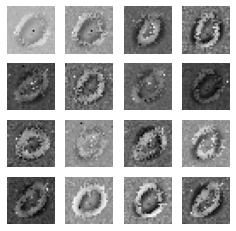

67
gen_loss: tf.Tensor(3.4328294, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06256873, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051242013, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.94633285e-15]
 [1.00000000e+00 6.58259413e-17]
 [9.99999881e-01 6.25965555e-08]
 [1.00000000e+00 2.10742068e-14]
 [1.00000000e+00 9.92315930e-13]
 [1.00000000e+00 1.81290454e-12]
 [1.00000000e+00 2.04299631e-13]
 [1.00000000e+00 3.28511198e-13]
 [1.00000000e+00 3.07637860e-14]
 [1.00000000e+00 2.54969006e-12]
 [1.00000000e+00 1.77899128e-14]
 [1.00000000e+00 2.40035818e-15]
 [9.99999762e-01 2.45434421e-07]
 [1.00000000e+00 4.82654789e-14]
 [1.00000000e+00 1.32465407e-14]
 [1.00000000e+00 7.39717854e-15]
 [1.00000000e+00 1.62042045e-14]
 [1.00000000e+00 1.13339107e-14]
 [1.00000000e+00 2.39197734e-14]
 [1.00000000e+00 4.69942222e-15]
 [9.97603714e-01 2.39634351e-03]
 [1.00000000e+00 4.83227267e-16]
 [1.00000000e+00 2.00766417e-15]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.3516417, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.052793786, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06171888, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.15506156e-15]
 [1.00000000e+00 5.78859074e-17]
 [1.00000000e+00 5.03036972e-08]
 [1.00000000e+00 2.39446982e-14]
 [1.00000000e+00 1.04110720e-12]
 [1.00000000e+00 2.17576348e-12]
 [1.00000000e+00 2.03795246e-13]
 [1.00000000e+00 2.76065954e-13]
 [1.00000000e+00 3.28390743e-14]
 [1.00000000e+00 2.81716729e-12]
 [1.00000000e+00 1.26107510e-14]
 [1.00000000e+00 3.00653455e-15]
 [9.99999762e-01 2.53412821e-07]
 [1.00000000e+00 5.86839605e-14]
 [1.00000000e+00 1.47589359e-14]
 [1.00000000e+00 6.65846713e-15]
 [1.00000000e+00 1.83128726e-14]
 [1.00000000e+00 1.54860069e-14]
 [1.00000000e+00 1.80118744e-14]
 [1.00000000e+00 4.56840910e-15]
 [9.96930540e-01 3.06943408e-03]
 [1.00000000e+00 3.58299437e-16]
 [1.00000000e+00 1.83434154e-15]
 [1.00000000e+00 1.6

gen_loss: tf.Tensor(3.4112396, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043816134, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.057826724, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.02088699e-15]
 [1.00000000e+00 5.82382929e-17]
 [1.00000000e+00 5.55862556e-08]
 [1.00000000e+00 2.45509925e-14]
 [1.00000000e+00 1.04035682e-12]
 [1.00000000e+00 1.87080191e-12]
 [1.00000000e+00 2.15792472e-13]
 [1.00000000e+00 3.12556513e-13]
 [1.00000000e+00 4.21203870e-14]
 [1.00000000e+00 2.02721086e-12]
 [1.00000000e+00 9.59653516e-15]
 [1.00000000e+00 3.45135094e-15]
 [9.99999642e-01 3.25382871e-07]
 [1.00000000e+00 4.59537193e-14]
 [1.00000000e+00 2.01571124e-14]
 [1.00000000e+00 4.88761389e-15]
 [1.00000000e+00 1.69456852e-14]
 [1.00000000e+00 1.31945448e-14]
 [1.00000000e+00 2.63193821e-14]
 [1.00000000e+00 3.74846469e-15]
 [9.97450173e-01 2.54980731e-03]
 [1.00000000e+00 3.83734010e-16]
 [1.00000000e+00 1.47690666e-15]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.4171987, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04775799, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.059481144, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.46948856e-15]
 [1.00000000e+00 4.89581966e-17]
 [1.00000000e+00 5.57598696e-08]
 [1.00000000e+00 3.62783398e-14]
 [1.00000000e+00 1.25011752e-12]
 [1.00000000e+00 2.45242455e-12]
 [1.00000000e+00 2.52541152e-13]
 [1.00000000e+00 4.59433164e-13]
 [1.00000000e+00 4.57127046e-14]
 [1.00000000e+00 3.03109079e-12]
 [1.00000000e+00 1.48435731e-14]
 [1.00000000e+00 5.31163096e-15]
 [9.99999642e-01 3.01266482e-07]
 [1.00000000e+00 5.17465472e-14]
 [1.00000000e+00 2.27979121e-14]
 [1.00000000e+00 4.34955569e-15]
 [1.00000000e+00 1.99549815e-14]
 [1.00000000e+00 1.73955851e-14]
 [1.00000000e+00 3.01431074e-14]
 [1.00000000e+00 4.14763701e-15]
 [9.97828782e-01 2.17121304e-03]
 [1.00000000e+00 5.08826720e-16]
 [1.00000000e+00 1.68759425e-15]
 [1.00000000e+00 2.5

gen_loss: tf.Tensor(3.4276228, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.048980206, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.059424773, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 1.8639606e-15]
 [1.0000000e+00 1.2873788e-17]
 [9.9999988e-01 7.9199822e-08]
 [1.0000000e+00 6.1702827e-14]
 [1.0000000e+00 1.4953161e-12]
 [1.0000000e+00 3.2673855e-12]
 [1.0000000e+00 3.1694433e-13]
 [1.0000000e+00 6.3565662e-13]
 [1.0000000e+00 4.6286674e-14]
 [1.0000000e+00 4.3628230e-12]
 [1.0000000e+00 3.0746069e-14]
 [1.0000000e+00 6.3473036e-15]
 [9.9999964e-01 3.4527267e-07]
 [1.0000000e+00 5.6440119e-14]
 [1.0000000e+00 2.3622350e-14]
 [1.0000000e+00 4.5095399e-15]
 [1.0000000e+00 2.7965370e-14]
 [1.0000000e+00 2.4024480e-14]
 [1.0000000e+00 3.7458575e-14]
 [1.0000000e+00 5.5574607e-15]
 [9.9592042e-01 4.0794997e-03]
 [1.0000000e+00 1.7305487e-16]
 [1.0000000e+00 2.6494949e-15]
 [1.0000000e+00 4.4658880e-14]
 [1.0000000e+00 1.0155666e-13]
 [1

gen_loss: tf.Tensor(3.510943, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.072206765, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05539741, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.34086470e-16]
 [1.00000000e+00 1.16175883e-18]
 [1.00000000e+00 5.73917873e-08]
 [1.00000000e+00 1.66669369e-14]
 [1.00000000e+00 3.50522400e-13]
 [1.00000000e+00 1.02982022e-12]
 [1.00000000e+00 8.51014273e-14]
 [1.00000000e+00 1.37024832e-13]
 [1.00000000e+00 1.07825973e-14]
 [1.00000000e+00 6.82623662e-13]
 [1.00000000e+00 7.73268321e-15]
 [1.00000000e+00 2.20069366e-15]
 [9.99999642e-01 3.29563619e-07]
 [1.00000000e+00 1.08556064e-14]
 [1.00000000e+00 5.11085535e-15]
 [1.00000000e+00 1.33935306e-15]
 [1.00000000e+00 9.43263005e-15]
 [1.00000000e+00 5.44124479e-15]
 [1.00000000e+00 6.30793483e-15]
 [1.00000000e+00 1.32273459e-15]
 [9.88697171e-01 1.13028577e-02]
 [1.00000000e+00 1.83625096e-17]
 [1.00000000e+00 5.79126643e-16]
 [1.00000000e+00 1.42

gen_loss: tf.Tensor(3.3611255, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10043852, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06400843, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 3.2902741e-16]
 [1.0000000e+00 4.9200624e-18]
 [1.0000000e+00 4.2214779e-08]
 [1.0000000e+00 3.4847952e-15]
 [1.0000000e+00 8.0821451e-14]
 [1.0000000e+00 2.6573879e-13]
 [1.0000000e+00 2.3216497e-14]
 [1.0000000e+00 1.1684108e-13]
 [1.0000000e+00 3.2452882e-15]
 [1.0000000e+00 2.0405350e-13]
 [1.0000000e+00 3.1446733e-15]
 [1.0000000e+00 5.8054002e-16]
 [9.9999976e-01 2.1619640e-07]
 [1.0000000e+00 4.1641084e-15]
 [1.0000000e+00 1.6584417e-15]
 [1.0000000e+00 3.1754228e-16]
 [1.0000000e+00 2.4926380e-15]
 [1.0000000e+00 1.7328550e-15]
 [1.0000000e+00 2.2418993e-15]
 [1.0000000e+00 3.2266590e-16]
 [9.9342692e-01 6.5730703e-03]
 [1.0000000e+00 5.9969509e-17]
 [1.0000000e+00 1.0106762e-16]
 [1.0000000e+00 2.6449406e-15]
 [1.0000000e+00 7.2982087e-15]
 [1.0

gen_loss: tf.Tensor(3.3826025, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06376899, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07389334, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.04117254e-16]
 [1.00000000e+00 4.11871425e-18]
 [1.00000000e+00 4.10922496e-08]
 [1.00000000e+00 9.09330696e-15]
 [1.00000000e+00 1.46878386e-13]
 [1.00000000e+00 2.91489218e-13]
 [1.00000000e+00 3.69659341e-14]
 [1.00000000e+00 9.80176769e-14]
 [1.00000000e+00 5.55349783e-15]
 [1.00000000e+00 5.68004194e-13]
 [1.00000000e+00 3.89659720e-15]
 [1.00000000e+00 2.03972373e-15]
 [9.99999881e-01 1.76700425e-07]
 [1.00000000e+00 3.93000587e-15]
 [1.00000000e+00 3.49440626e-15]
 [1.00000000e+00 4.17124498e-16]
 [1.00000000e+00 4.05769736e-15]
 [1.00000000e+00 2.69230693e-15]
 [1.00000000e+00 3.04104649e-15]
 [1.00000000e+00 5.59987034e-16]
 [9.95000005e-01 5.00001153e-03]
 [1.00000000e+00 5.49126331e-17]
 [1.00000000e+00 1.88896976e-16]
 [1.00000000e+00 6.32

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.06882662e-16]
 [1.00000000e+00 1.47401703e-18]
 [1.00000000e+00 2.69354921e-08]
 [1.00000000e+00 1.33747493e-14]
 [1.00000000e+00 2.10155339e-13]
 [1.00000000e+00 2.96967474e-13]
 [1.00000000e+00 4.07651106e-14]
 [1.00000000e+00 6.84626170e-14]
 [1.00000000e+00 5.12162834e-15]
 [1.00000000e+00 7.91268526e-13]
 [1.00000000e+00 4.74523188e-15]
 [1.00000000e+00 2.61403643e-15]
 [9.99999881e-01 1.54265095e-07]
 [1.00000000e+00 3.05845068e-15]
 [1.00000000e+00 3.53918656e-15]
 [1.00000000e+00 5.30419761e-16]
 [1.00000000e+00 5.99418959e-15]
 [1.00000000e+00 3.13267618e-15]
 [1.00000000e+00 2.48552607e-15]
 [1.00000000e+00 6.96508522e-16]
 [9.95161951e-01 4.83809924e-03]
 [1.00000000e+00 2.37705602e-17]
 [1.00000000e+00 2.75780296e-16]
 [1.00000000e+00 9.74520469e-15]
 [1.00000000e+00 1.45501151e-14]
 [1.00000000e+00 1.78417017e-10]
 [1.00000000e+00 3.08212250e-14]
 [1.00000000e+00 4.40943075e-15]
 [9.99999762e-01 2.06352723e-07]
 [1.0

gen_loss: tf.Tensor(3.5492563, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.068538725, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06385707, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 2.8273086e-16]
 [1.0000000e+00 4.4884230e-18]
 [1.0000000e+00 8.2275937e-09]
 [1.0000000e+00 2.7169238e-15]
 [1.0000000e+00 7.7223696e-14]
 [1.0000000e+00 1.2475683e-13]
 [1.0000000e+00 1.2043550e-14]
 [1.0000000e+00 9.0725916e-14]
 [1.0000000e+00 1.1302344e-15]
 [1.0000000e+00 1.7716240e-13]
 [1.0000000e+00 4.1879723e-15]
 [1.0000000e+00 2.8051349e-16]
 [1.0000000e+00 5.8129363e-08]
 [1.0000000e+00 1.6553005e-15]
 [1.0000000e+00 7.6506419e-16]
 [1.0000000e+00 2.3621065e-16]
 [1.0000000e+00 2.6095929e-15]
 [1.0000000e+00 1.5121266e-15]
 [1.0000000e+00 1.1895153e-15]
 [1.0000000e+00 2.3247669e-16]
 [9.9861920e-01 1.3808393e-03]
 [1.0000000e+00 5.9340746e-17]
 [1.0000000e+00 8.1897022e-17]
 [1.0000000e+00 1.9645335e-15]
 [1.0000000e+00 7.6643751e-15]
 [1.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.98736080e-16]
 [1.00000000e+00 9.13292348e-18]
 [1.00000000e+00 7.31415906e-09]
 [1.00000000e+00 1.77986610e-15]
 [1.00000000e+00 5.67289305e-14]
 [1.00000000e+00 1.25972705e-13]
 [1.00000000e+00 8.31988626e-15]
 [1.00000000e+00 1.13867656e-13]
 [1.00000000e+00 7.32640618e-16]
 [1.00000000e+00 1.48626744e-13]
 [1.00000000e+00 3.55929258e-15]
 [1.00000000e+00 1.43640575e-16]
 [1.00000000e+00 4.80741562e-08]
 [1.00000000e+00 2.79391234e-15]
 [1.00000000e+00 4.76747412e-16]
 [1.00000000e+00 1.90825670e-16]
 [1.00000000e+00 2.07443070e-15]
 [1.00000000e+00 1.63421921e-15]
 [1.00000000e+00 1.03000922e-15]
 [1.00000000e+00 1.87082672e-16]
 [9.98472631e-01 1.52732641e-03]
 [1.00000000e+00 8.36219579e-17]
 [1.00000000e+00 6.35092995e-17]
 [1.00000000e+00 1.36446759e-15]
 [1.00000000e+00 5.94096627e-15]
 [1.00000000e+00 1.31722425e-10]
 [1.00000000e+00 4.21081593e-15]
 [1.00000000e+00 6.74423176e-15]
 [1.00000000e+00 1.14830208e-08]
 [1.0

gen_loss: tf.Tensor(3.3232832, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03245449, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.068006635, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.66634886e-16]
 [1.00000000e+00 4.06998463e-18]
 [1.00000000e+00 1.04845856e-08]
 [1.00000000e+00 3.17032870e-15]
 [1.00000000e+00 7.84980127e-14]
 [1.00000000e+00 2.81648348e-13]
 [1.00000000e+00 1.04601844e-14]
 [1.00000000e+00 8.76127987e-14]
 [1.00000000e+00 8.05428330e-16]
 [1.00000000e+00 3.62055004e-13]
 [1.00000000e+00 3.11794056e-15]
 [1.00000000e+00 2.54736133e-16]
 [9.99999881e-01 6.95075357e-08]
 [1.00000000e+00 9.47692056e-15]
 [1.00000000e+00 4.64906633e-16]
 [1.00000000e+00 2.85407434e-16]
 [1.00000000e+00 3.38245307e-15]
 [1.00000000e+00 3.37343301e-15]
 [1.00000000e+00 8.80381958e-16]
 [1.00000000e+00 3.48347752e-16]
 [9.93963540e-01 6.03648880e-03]
 [1.00000000e+00 2.80094208e-17]
 [1.00000000e+00 1.58640589e-16]
 [1.00000000e+00 3.2

gen_loss: tf.Tensor(3.3400817, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04776296, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06114407, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.05981007e-16]
 [1.00000000e+00 8.78780139e-19]
 [1.00000000e+00 9.68405089e-09]
 [1.00000000e+00 1.58351062e-15]
 [1.00000000e+00 4.28353743e-14]
 [1.00000000e+00 1.44379124e-13]
 [1.00000000e+00 6.42124158e-15]
 [1.00000000e+00 5.58705236e-14]
 [1.00000000e+00 3.86640418e-16]
 [1.00000000e+00 1.05332667e-13]
 [1.00000000e+00 2.30738953e-15]
 [1.00000000e+00 7.42983486e-17]
 [9.99999881e-01 9.30168511e-08]
 [1.00000000e+00 3.04176583e-15]
 [1.00000000e+00 2.02745793e-16]
 [1.00000000e+00 1.66338927e-16]
 [1.00000000e+00 2.27626616e-15]
 [1.00000000e+00 1.67733816e-15]
 [1.00000000e+00 6.12651096e-16]
 [1.00000000e+00 2.36501869e-16]
 [9.94113386e-01 5.88661898e-03]
 [1.00000000e+00 6.63037291e-18]
 [1.00000000e+00 1.37109858e-16]
 [1.00000000e+00 2.32

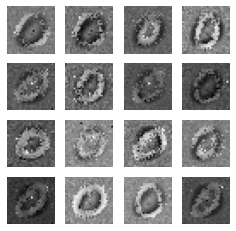

68
gen_loss: tf.Tensor(3.5248005, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.052121595, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05162456, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.63668894e-16]
 [1.00000000e+00 1.03347501e-18]
 [1.00000000e+00 1.05255209e-08]
 [1.00000000e+00 1.12187534e-15]
 [1.00000000e+00 3.81492526e-14]
 [1.00000000e+00 1.09179064e-13]
 [1.00000000e+00 5.50632953e-15]
 [1.00000000e+00 7.89477194e-14]
 [1.00000000e+00 3.01308889e-16]
 [1.00000000e+00 6.06540507e-14]
 [1.00000000e+00 2.99952366e-15]
 [1.00000000e+00 3.31152759e-17]
 [9.99999881e-01 1.09389077e-07]
 [1.00000000e+00 2.52957411e-15]
 [1.00000000e+00 1.60467136e-16]
 [1.00000000e+00 1.41306324e-16]
 [1.00000000e+00 1.95744952e-15]
 [1.00000000e+00 1.55764097e-15]
 [1.00000000e+00 8.16746172e-16]
 [1.00000000e+00 2.30069977e-16]
 [9.95264530e-01 4.73550847e-03]
 [1.00000000e+00 7.01569018e-18]
 [1.00000000e+00 1.37025155e-16]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.523253, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07080533, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.057403043, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.74425466e-16]
 [1.00000000e+00 1.86282749e-18]
 [1.00000000e+00 1.32513822e-08]
 [1.00000000e+00 9.95421473e-16]
 [1.00000000e+00 3.37963029e-14]
 [1.00000000e+00 1.07342168e-13]
 [1.00000000e+00 5.11417064e-15]
 [1.00000000e+00 1.16295902e-13]
 [1.00000000e+00 2.69768215e-16]
 [1.00000000e+00 6.46726393e-14]
 [1.00000000e+00 3.78237735e-15]
 [1.00000000e+00 2.43289733e-17]
 [9.99999881e-01 1.17137631e-07]
 [1.00000000e+00 3.81751481e-15]
 [1.00000000e+00 1.49749946e-16]
 [1.00000000e+00 1.21167613e-16]
 [1.00000000e+00 1.86459353e-15]
 [1.00000000e+00 1.76498458e-15]
 [1.00000000e+00 1.19057299e-15]
 [1.00000000e+00 2.36722098e-16]
 [9.95739579e-01 4.26042732e-03]
 [1.00000000e+00 1.07510782e-17]
 [1.00000000e+00 1.48328042e-16]
 [1.00000000e+00 1.77

gen_loss: tf.Tensor(3.490254, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.049147315, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.060613327, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.40681183e-16]
 [1.00000000e+00 1.26559295e-18]
 [1.00000000e+00 2.28094628e-08]
 [1.00000000e+00 3.49091543e-15]
 [1.00000000e+00 6.99865038e-14]
 [1.00000000e+00 2.91482550e-13]
 [1.00000000e+00 1.08627317e-14]
 [1.00000000e+00 7.90387246e-14]
 [1.00000000e+00 5.98776431e-16]
 [1.00000000e+00 2.60316264e-13]
 [1.00000000e+00 4.07696778e-15]
 [1.00000000e+00 1.62581780e-16]
 [9.99999881e-01 1.48726443e-07]
 [1.00000000e+00 1.72997620e-14]
 [1.00000000e+00 4.28718685e-16]
 [1.00000000e+00 2.16252792e-16]
 [1.00000000e+00 4.05359772e-15]
 [1.00000000e+00 3.86804372e-15]
 [1.00000000e+00 3.13847751e-15]
 [1.00000000e+00 5.78106869e-16]
 [9.93170857e-01 6.82913372e-03]
 [1.00000000e+00 7.22834839e-18]
 [1.00000000e+00 4.17041754e-16]
 [1.00000000e+00 6.1

gen_loss: tf.Tensor(3.5521202, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.052312315, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.073008165, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.39300625e-16]
 [1.00000000e+00 2.00815878e-18]
 [1.00000000e+00 1.02895052e-08]
 [1.00000000e+00 1.51444726e-15]
 [1.00000000e+00 4.00269214e-14]
 [1.00000000e+00 1.19549160e-13]
 [1.00000000e+00 6.70068833e-15]
 [1.00000000e+00 3.46244301e-14]
 [1.00000000e+00 5.04984526e-16]
 [1.00000000e+00 6.30476235e-14]
 [1.00000000e+00 1.99099202e-15]
 [1.00000000e+00 8.21849467e-17]
 [9.99999881e-01 7.16895983e-08]
 [1.00000000e+00 5.70135336e-15]
 [1.00000000e+00 3.86310181e-16]
 [1.00000000e+00 1.29130438e-16]
 [1.00000000e+00 1.90921883e-15]
 [1.00000000e+00 1.57241682e-15]
 [1.00000000e+00 3.82262962e-15]
 [1.00000000e+00 3.73848076e-16]
 [9.98627067e-01 1.37293595e-03]
 [1.00000000e+00 1.38333351e-17]
 [1.00000000e+00 1.83511753e-16]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(3.3916726, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05409611, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07621977, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.13892771e-18]
 [1.00000000e+00 5.30870074e-20]
 [1.00000000e+00 1.53883128e-10]
 [1.00000000e+00 2.88159748e-17]
 [1.00000000e+00 3.02144540e-16]
 [1.00000000e+00 2.29811325e-15]
 [1.00000000e+00 4.85371915e-17]
 [1.00000000e+00 1.34106068e-15]
 [1.00000000e+00 2.78995696e-18]
 [1.00000000e+00 1.37960385e-15]
 [1.00000000e+00 6.11908049e-17]
 [1.00000000e+00 1.05733762e-18]
 [1.00000000e+00 8.89058605e-09]
 [1.00000000e+00 2.64506916e-17]
 [1.00000000e+00 1.98908338e-18]
 [1.00000000e+00 1.00434140e-18]
 [1.00000000e+00 2.84699387e-17]
 [1.00000000e+00 4.16896779e-17]
 [1.00000000e+00 7.37620279e-18]
 [1.00000000e+00 2.67168750e-18]
 [9.99570787e-01 4.29261272e-04]
 [1.00000000e+00 1.60395367e-18]
 [1.00000000e+00 8.75280648e-19]
 [1.00000000e+00 2.88

gen_loss: tf.Tensor(3.3538709, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0839887, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07076019, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.06189714e-18]
 [1.00000000e+00 7.32306227e-21]
 [1.00000000e+00 1.83456320e-10]
 [1.00000000e+00 5.64775099e-17]
 [1.00000000e+00 2.80081529e-16]
 [1.00000000e+00 1.06444163e-15]
 [1.00000000e+00 4.63450868e-17]
 [1.00000000e+00 1.78051111e-15]
 [1.00000000e+00 2.52104488e-18]
 [1.00000000e+00 1.67432717e-15]
 [1.00000000e+00 8.38132550e-17]
 [1.00000000e+00 5.78278037e-19]
 [1.00000000e+00 4.49089512e-08]
 [1.00000000e+00 1.83204591e-17]
 [1.00000000e+00 2.24110070e-18]
 [1.00000000e+00 4.25673890e-19]
 [1.00000000e+00 2.36280817e-17]
 [1.00000000e+00 3.41358513e-17]
 [1.00000000e+00 1.03516823e-17]
 [1.00000000e+00 2.07965676e-18]
 [9.97179031e-01 2.82098656e-03]
 [1.00000000e+00 1.81854314e-19]
 [1.00000000e+00 1.12333392e-18]
 [1.00000000e+00 4.048

gen_loss: tf.Tensor(3.1623552, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.067429736, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08409208, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.30139796e-19]
 [1.00000000e+00 3.96750113e-21]
 [1.00000000e+00 8.70645361e-11]
 [1.00000000e+00 1.99268422e-17]
 [1.00000000e+00 6.80973395e-17]
 [1.00000000e+00 1.67768282e-16]
 [1.00000000e+00 1.94408984e-17]
 [1.00000000e+00 3.74836246e-16]
 [1.00000000e+00 7.83441990e-19]
 [1.00000000e+00 2.63482860e-16]
 [1.00000000e+00 2.73510860e-17]
 [1.00000000e+00 1.61512133e-19]
 [1.00000000e+00 1.23940547e-08]
 [1.00000000e+00 3.88236228e-18]
 [1.00000000e+00 6.47848218e-19]
 [1.00000000e+00 8.39958873e-20]
 [1.00000000e+00 6.00383736e-18]
 [1.00000000e+00 4.96796611e-18]
 [1.00000000e+00 4.12766393e-18]
 [1.00000000e+00 3.61205475e-19]
 [9.99019146e-01 9.80900833e-04]
 [1.00000000e+00 1.94881762e-19]
 [1.00000000e+00 2.43990260e-19]
 [1.00000000e+00 1.4

gen_loss: tf.Tensor(3.2090867, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07040511, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09681572, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.91577053e-19]
 [1.00000000e+00 5.17751894e-21]
 [1.00000000e+00 1.17218041e-10]
 [1.00000000e+00 2.13549893e-17]
 [1.00000000e+00 9.24707192e-17]
 [1.00000000e+00 1.65972559e-16]
 [1.00000000e+00 3.21095301e-17]
 [1.00000000e+00 3.10690891e-16]
 [1.00000000e+00 6.23096130e-19]
 [1.00000000e+00 2.99386363e-16]
 [1.00000000e+00 3.73319151e-17]
 [1.00000000e+00 1.23747809e-19]
 [1.00000000e+00 7.28142080e-09]
 [1.00000000e+00 7.28940507e-18]
 [1.00000000e+00 4.82270751e-19]
 [1.00000000e+00 8.19872343e-20]
 [1.00000000e+00 5.49996029e-18]
 [1.00000000e+00 5.48805633e-18]
 [1.00000000e+00 4.43153080e-18]
 [1.00000000e+00 3.57064040e-19]
 [9.98950303e-01 1.04973861e-03]
 [1.00000000e+00 3.02176341e-19]
 [1.00000000e+00 3.24401883e-19]
 [1.00000000e+00 2.34

gen_loss: tf.Tensor(3.2352853, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.042856608, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07275887, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.32123977e-18]
 [1.00000000e+00 3.41244557e-21]
 [1.00000000e+00 6.92777002e-10]
 [1.00000000e+00 1.39599871e-16]
 [1.00000000e+00 8.09460207e-16]
 [1.00000000e+00 4.29633851e-16]
 [1.00000000e+00 2.92303870e-16]
 [1.00000000e+00 7.20506554e-16]
 [1.00000000e+00 3.62031973e-18]
 [1.00000000e+00 1.78743899e-15]
 [1.00000000e+00 1.21006862e-16]
 [1.00000000e+00 4.48676051e-19]
 [1.00000000e+00 3.62006176e-08]
 [1.00000000e+00 4.55255592e-17]
 [1.00000000e+00 2.86366826e-18]
 [1.00000000e+00 3.06360557e-19]
 [1.00000000e+00 2.20397625e-17]
 [1.00000000e+00 2.38077668e-17]
 [1.00000000e+00 3.91476989e-17]
 [1.00000000e+00 2.08840171e-18]
 [9.94339168e-01 5.66082075e-03]
 [1.00000000e+00 9.17709197e-20]
 [1.00000000e+00 3.95175281e-18]
 [1.00000000e+00 2.2

gen_loss: tf.Tensor(3.2544177, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.060443997, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07375392, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.46128569e-18]
 [1.00000000e+00 6.90406621e-21]
 [1.00000000e+00 3.82234772e-10]
 [1.00000000e+00 5.43872841e-17]
 [1.00000000e+00 5.85892848e-16]
 [1.00000000e+00 1.79113071e-16]
 [1.00000000e+00 2.42182390e-16]
 [1.00000000e+00 4.86775806e-16]
 [1.00000000e+00 2.23323235e-18]
 [1.00000000e+00 6.17835467e-16]
 [1.00000000e+00 6.40496669e-17]
 [1.00000000e+00 1.92369007e-19]
 [1.00000000e+00 1.57868509e-08]
 [1.00000000e+00 1.71268457e-17]
 [1.00000000e+00 1.47676348e-18]
 [1.00000000e+00 1.73149026e-19]
 [1.00000000e+00 9.09478466e-18]
 [1.00000000e+00 1.12163028e-17]
 [1.00000000e+00 3.13028404e-17]
 [1.00000000e+00 1.11131446e-18]
 [9.98885572e-01 1.11438078e-03]
 [1.00000000e+00 1.84735720e-19]
 [1.00000000e+00 2.03920701e-18]
 [1.00000000e+00 1.0

 [1.00000000e+00 9.35051698e-15]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.370739, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06629351, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061824355, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.39137187e-18]
 [1.00000000e+00 6.37643080e-21]
 [1.00000000e+00 2.48036092e-10]
 [1.00000000e+00 5.22040732e-17]
 [1.00000000e+00 5.34720623e-16]
 [1.00000000e+00 2.03090257e-16]
 [1.00000000e+00 2.36588505e-16]
 [1.00000000e+00 3.17556808e-16]
 [1.00000000e+00 2.17160264e-18]
 [1.00000000e+00 9.11007228e-16]
 [1.00000000e+00 4.69026561e-17]
 [1.00000000e+00 4.08312299e-19]
 [1.00000000e+00 7.15782145e-09]
 [1.00000000e+00 1.71884343e-17]
 [1.00000000e+00 1.28968345e-18]
 [1.00000000e+00 1.67048310e-19]
 [1.00000000e+00 8.58577576e-18]
 [1.00000000e+00 1.08661969e-17]
 [1.00000000e+00 2.66683178e-17]
 [1.00000000e+00 1.06441973e-18]
 [9.99556124e-01 4.43916797e-04]
 [1.00000000e+00 1.70

gen_loss: tf.Tensor(3.4384995, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051974334, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.059252843, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.42893331e-18]
 [1.00000000e+00 4.64607559e-21]
 [1.00000000e+00 2.91197372e-10]
 [1.00000000e+00 7.04100373e-17]
 [1.00000000e+00 6.80581550e-16]
 [1.00000000e+00 2.71363892e-16]
 [1.00000000e+00 3.05794749e-16]
 [1.00000000e+00 3.55269811e-16]
 [1.00000000e+00 2.84868719e-18]
 [1.00000000e+00 1.40380136e-15]
 [1.00000000e+00 5.24561979e-17]
 [1.00000000e+00 6.58206018e-19]
 [1.00000000e+00 8.93335361e-09]
 [1.00000000e+00 3.00841287e-17]
 [1.00000000e+00 1.70600004e-18]
 [1.00000000e+00 1.99319159e-19]
 [1.00000000e+00 1.16335161e-17]
 [1.00000000e+00 1.38254223e-17]
 [1.00000000e+00 4.24283369e-17]
 [1.00000000e+00 1.29824756e-18]
 [9.99435008e-01 5.64960006e-04]
 [1.00000000e+00 1.02164851e-19]
 [1.00000000e+00 2.88682208e-18]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.4324906, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09710026, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049842406, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.41429965e-18]
 [1.00000000e+00 4.83375350e-21]
 [1.00000000e+00 3.67140346e-10]
 [1.00000000e+00 2.12572944e-17]
 [1.00000000e+00 3.34503475e-16]
 [1.00000000e+00 1.02412782e-16]
 [1.00000000e+00 1.91684390e-16]
 [1.00000000e+00 5.46283047e-16]
 [1.00000000e+00 2.06884034e-18]
 [1.00000000e+00 2.33039622e-16]
 [1.00000000e+00 6.66702544e-17]
 [1.00000000e+00 1.51995394e-19]
 [1.00000000e+00 1.28081101e-08]
 [1.00000000e+00 2.23382143e-17]
 [1.00000000e+00 1.22822797e-18]
 [1.00000000e+00 9.51968757e-20]
 [1.00000000e+00 7.60918731e-18]
 [1.00000000e+00 5.64260097e-18]
 [1.00000000e+00 1.32281466e-16]
 [1.00000000e+00 6.06289164e-19]
 [9.99682665e-01 3.17298138e-04]
 [1.00000000e+00 6.44225192e-20]
 [1.00000000e+00 1.48357304e-18]
 [1.00000000e+00 3.7

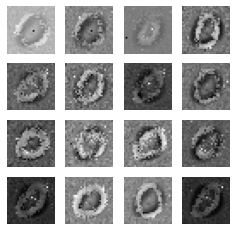

69
gen_loss: tf.Tensor(3.3388762, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07411662, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07275911, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.31948877e-18]
 [1.00000000e+00 3.90995593e-21]
 [1.00000000e+00 3.10128201e-10]
 [1.00000000e+00 1.08268893e-17]
 [1.00000000e+00 1.53578019e-16]
 [1.00000000e+00 7.01984312e-17]
 [1.00000000e+00 1.12328361e-16]
 [1.00000000e+00 3.70339269e-16]
 [1.00000000e+00 1.55511527e-18]
 [1.00000000e+00 9.82687391e-17]
 [1.00000000e+00 5.20829343e-17]
 [1.00000000e+00 1.02328665e-19]
 [1.00000000e+00 8.01275668e-09]
 [1.00000000e+00 1.29171763e-17]
 [1.00000000e+00 8.46585908e-19]
 [1.00000000e+00 6.34912819e-20]
 [1.00000000e+00 5.28958303e-18]
 [1.00000000e+00 3.39577721e-18]
 [1.00000000e+00 1.09614157e-16]
 [1.00000000e+00 3.86157844e-19]
 [9.99809444e-01 1.90634062e-04]
 [1.00000000e+00 5.80335119e-20]
 [1.00000000e+00 8.28484094e-19]
 [1.00000000e+00 1

gen_loss: tf.Tensor(3.3172996, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07307168, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.058435794, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.57602398e-18]
 [1.00000000e+00 2.73309017e-21]
 [1.00000000e+00 4.31245956e-10]
 [1.00000000e+00 2.56578257e-17]
 [1.00000000e+00 1.63975110e-16]
 [1.00000000e+00 2.29001737e-16]
 [1.00000000e+00 1.47050280e-16]
 [1.00000000e+00 3.33555434e-16]
 [1.00000000e+00 3.06855470e-18]
 [1.00000000e+00 2.93907224e-16]
 [1.00000000e+00 8.19257678e-17]
 [1.00000000e+00 5.47686468e-19]
 [1.00000000e+00 5.52945822e-09]
 [1.00000000e+00 2.29648102e-17]
 [1.00000000e+00 1.65580951e-18]
 [1.00000000e+00 1.40542742e-19]
 [1.00000000e+00 1.25786858e-17]
 [1.00000000e+00 8.51814796e-18]
 [1.00000000e+00 1.00955872e-16]
 [1.00000000e+00 9.18722003e-19]
 [9.99743640e-01 2.56297790e-04]
 [1.00000000e+00 5.63468002e-20]
 [1.00000000e+00 1.57814729e-18]
 [1.00000000e+00 3.7

gen_loss: tf.Tensor(3.2955155, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04350249, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07529947, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.72433814e-18]
 [1.00000000e+00 7.57422145e-21]
 [1.00000000e+00 5.52197288e-10]
 [1.00000000e+00 2.96200903e-17]
 [1.00000000e+00 1.83259919e-16]
 [1.00000000e+00 4.02148268e-16]
 [1.00000000e+00 1.66389696e-16]
 [1.00000000e+00 4.22961694e-16]
 [1.00000000e+00 6.19997512e-18]
 [1.00000000e+00 2.34792133e-16]
 [1.00000000e+00 6.31664497e-17]
 [1.00000000e+00 1.31731428e-18]
 [1.00000000e+00 1.08982103e-08]
 [1.00000000e+00 3.52843916e-17]
 [1.00000000e+00 3.52946056e-18]
 [1.00000000e+00 2.65557082e-19]
 [1.00000000e+00 1.92914467e-17]
 [1.00000000e+00 9.81222322e-18]
 [1.00000000e+00 1.69345537e-16]
 [1.00000000e+00 1.08776794e-18]
 [9.99696493e-01 3.03588429e-04]
 [1.00000000e+00 1.18846506e-19]
 [1.00000000e+00 1.75242948e-18]
 [1.00000000e+00 3.70

gen_loss: tf.Tensor(3.40576, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04938265, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061464, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.66257298e-18]
 [1.00000000e+00 2.79522714e-20]
 [1.00000000e+00 4.27009456e-10]
 [1.00000000e+00 2.45161395e-17]
 [1.00000000e+00 2.45812349e-16]
 [1.00000000e+00 7.14681402e-16]
 [1.00000000e+00 1.67387925e-16]
 [1.00000000e+00 5.13218692e-16]
 [1.00000000e+00 9.04399577e-18]
 [1.00000000e+00 1.70173141e-16]
 [1.00000000e+00 5.04722316e-17]
 [1.00000000e+00 1.66656958e-18]
 [1.00000000e+00 1.38752032e-08]
 [1.00000000e+00 4.82302545e-17]
 [1.00000000e+00 5.12117113e-18]
 [1.00000000e+00 5.18495626e-19]
 [1.00000000e+00 2.30462494e-17]
 [1.00000000e+00 1.24116689e-17]
 [1.00000000e+00 1.84462772e-16]
 [1.00000000e+00 1.27898821e-18]
 [9.99723017e-01 2.76999344e-04]
 [1.00000000e+00 3.48351218e-19]
 [1.00000000e+00 1.71726314e-18]
 [1.00000000e+00 2.696816

gen_loss: tf.Tensor(3.4427962, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043782987, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051534355, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.02285838e-17]
 [1.00000000e+00 5.99735348e-20]
 [1.00000000e+00 2.88670171e-10]
 [1.00000000e+00 5.26596975e-17]
 [1.00000000e+00 7.91031893e-16]
 [1.00000000e+00 3.33176662e-15]
 [1.00000000e+00 3.07706794e-16]
 [1.00000000e+00 8.24358669e-16]
 [1.00000000e+00 1.39878591e-17]
 [1.00000000e+00 6.07419767e-16]
 [1.00000000e+00 9.87569014e-17]
 [1.00000000e+00 3.60533866e-18]
 [1.00000000e+00 1.26463906e-08]
 [1.00000000e+00 1.42184989e-16]
 [1.00000000e+00 8.90405335e-18]
 [1.00000000e+00 1.84877514e-18]
 [1.00000000e+00 4.96758982e-17]
 [1.00000000e+00 5.54726708e-17]
 [1.00000000e+00 1.29990904e-16]
 [1.00000000e+00 3.53914064e-18]
 [9.99634624e-01 3.65371874e-04]
 [1.00000000e+00 9.06450778e-19]
 [1.00000000e+00 4.20248076e-18]
 [1.00000000e+00 5.

gen_loss: tf.Tensor(3.4089856, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06811948, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05747722, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 9.5856179e-18]
 [1.0000000e+00 3.0736125e-20]
 [1.0000000e+00 4.1609116e-10]
 [1.0000000e+00 1.3849658e-16]
 [1.0000000e+00 3.1258720e-15]
 [1.0000000e+00 1.0022346e-14]
 [1.0000000e+00 7.3174679e-16]
 [1.0000000e+00 6.4126710e-16]
 [1.0000000e+00 2.9190036e-17]
 [1.0000000e+00 2.1734954e-15]
 [1.0000000e+00 1.4841973e-16]
 [1.0000000e+00 9.6241993e-18]
 [1.0000000e+00 1.9735165e-08]
 [1.0000000e+00 4.4466403e-16]
 [1.0000000e+00 2.0014680e-17]
 [1.0000000e+00 5.1964231e-18]
 [1.0000000e+00 1.2981945e-16]
 [1.0000000e+00 1.2861033e-16]
 [1.0000000e+00 1.6472431e-16]
 [1.0000000e+00 9.8451417e-18]
 [9.9897826e-01 1.0217319e-03]
 [1.0000000e+00 4.3333332e-19]
 [1.0000000e+00 1.3600335e-17]
 [1.0000000e+00 1.6520635e-16]
 [1.0000000e+00 1.2340299e-15]
 [1.0

gen_loss: tf.Tensor(3.2232316, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05310967, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07202572, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.90840039e-18]
 [1.00000000e+00 9.45915766e-21]
 [1.00000000e+00 3.31538186e-10]
 [1.00000000e+00 1.45202904e-17]
 [1.00000000e+00 4.42786870e-16]
 [1.00000000e+00 8.78067705e-16]
 [1.00000000e+00 1.56129282e-16]
 [1.00000000e+00 7.13085208e-17]
 [1.00000000e+00 8.02569011e-18]
 [1.00000000e+00 1.15181817e-16]
 [1.00000000e+00 1.41420571e-17]
 [1.00000000e+00 1.37231631e-18]
 [1.00000000e+00 3.73863855e-08]
 [1.00000000e+00 7.33890587e-17]
 [1.00000000e+00 4.33274062e-18]
 [1.00000000e+00 5.84418716e-19]
 [1.00000000e+00 2.13235681e-17]
 [1.00000000e+00 5.71046452e-18]
 [1.00000000e+00 4.48830583e-17]
 [1.00000000e+00 1.04128670e-18]
 [9.99171019e-01 8.29008815e-04]
 [1.00000000e+00 8.71781286e-20]
 [1.00000000e+00 9.50354630e-19]
 [1.00000000e+00 1.78

gen_loss: tf.Tensor(3.3356073, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04223612, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06443703, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.60892186e-18]
 [1.00000000e+00 1.85004308e-20]
 [1.00000000e+00 3.22285532e-10]
 [1.00000000e+00 3.34096326e-18]
 [1.00000000e+00 1.07365350e-16]
 [1.00000000e+00 3.14182996e-16]
 [1.00000000e+00 4.87258581e-17]
 [1.00000000e+00 5.39899826e-17]
 [1.00000000e+00 2.12912071e-18]
 [1.00000000e+00 3.90844295e-17]
 [1.00000000e+00 9.96119349e-18]
 [1.00000000e+00 2.38717656e-19]
 [1.00000000e+00 3.27275593e-08]
 [1.00000000e+00 4.89395222e-17]
 [1.00000000e+00 9.86540059e-19]
 [1.00000000e+00 1.35702120e-19]
 [1.00000000e+00 7.30070353e-18]
 [1.00000000e+00 2.39462935e-18]
 [1.00000000e+00 1.35142270e-17]
 [1.00000000e+00 3.96251360e-19]
 [9.99497056e-01 5.02969429e-04]
 [1.00000000e+00 1.34895929e-19]
 [1.00000000e+00 1.86714491e-19]
 [1.00000000e+00 4.38

gen_loss: tf.Tensor(3.2005117, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04984472, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07569623, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.49072354e-18]
 [1.00000000e+00 3.48744435e-21]
 [1.00000000e+00 5.26090838e-10]
 [1.00000000e+00 1.17713211e-17]
 [1.00000000e+00 2.75946552e-16]
 [1.00000000e+00 8.32238934e-16]
 [1.00000000e+00 9.00802003e-17]
 [1.00000000e+00 5.89945147e-17]
 [1.00000000e+00 2.48347496e-18]
 [1.00000000e+00 1.35067093e-16]
 [1.00000000e+00 2.79578610e-17]
 [1.00000000e+00 5.40841290e-19]
 [9.99999881e-01 6.82897507e-08]
 [1.00000000e+00 9.87173490e-17]
 [1.00000000e+00 1.30294099e-18]
 [1.00000000e+00 2.35278626e-19]
 [1.00000000e+00 1.67309951e-17]
 [1.00000000e+00 7.88855432e-18]
 [1.00000000e+00 1.14734889e-17]
 [1.00000000e+00 1.14673134e-18]
 [9.98342991e-01 1.65697851e-03]
 [1.00000000e+00 3.26691719e-20]
 [1.00000000e+00 5.46655336e-19]
 [1.00000000e+00 1.93

gen_loss: tf.Tensor(3.2903745, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.089592084, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06688017, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.05509936e-18]
 [1.00000000e+00 2.53727858e-21]
 [1.00000000e+00 4.34757619e-10]
 [1.00000000e+00 1.54741736e-17]
 [1.00000000e+00 4.53333939e-16]
 [1.00000000e+00 9.40388260e-16]
 [1.00000000e+00 9.85371361e-17]
 [1.00000000e+00 9.16370800e-17]
 [1.00000000e+00 2.24757318e-18]
 [1.00000000e+00 1.35555910e-16]
 [1.00000000e+00 5.76241676e-17]
 [1.00000000e+00 4.73137694e-19]
 [9.99999881e-01 1.41115450e-07]
 [1.00000000e+00 8.25110146e-17]
 [1.00000000e+00 1.30788587e-18]
 [1.00000000e+00 2.59669805e-19]
 [1.00000000e+00 1.65187985e-17]
 [1.00000000e+00 1.45975441e-17]
 [1.00000000e+00 9.83804615e-18]
 [1.00000000e+00 1.64876907e-18]
 [9.97903228e-01 2.09680549e-03]
 [1.00000000e+00 2.77251199e-20]
 [1.00000000e+00 8.37348730e-19]
 [1.00000000e+00 2.6

gen_loss: tf.Tensor(3.2609878, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.060390323, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07276186, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.57715884e-18]
 [1.00000000e+00 2.28467253e-20]
 [1.00000000e+00 4.28769048e-10]
 [1.00000000e+00 7.27870714e-18]
 [1.00000000e+00 2.48510758e-16]
 [1.00000000e+00 4.23412103e-16]
 [1.00000000e+00 6.68765798e-17]
 [1.00000000e+00 1.17820642e-16]
 [1.00000000e+00 2.29810089e-18]
 [1.00000000e+00 6.87094929e-17]
 [1.00000000e+00 3.13857007e-17]
 [1.00000000e+00 2.39695848e-19]
 [9.99999881e-01 1.46155585e-07]
 [1.00000000e+00 7.32148545e-17]
 [1.00000000e+00 1.37050096e-18]
 [1.00000000e+00 1.57180795e-19]
 [1.00000000e+00 6.12540603e-18]
 [1.00000000e+00 1.03034213e-17]
 [1.00000000e+00 9.33008694e-18]
 [1.00000000e+00 9.77735756e-19]
 [9.98839796e-01 1.16021303e-03]
 [1.00000000e+00 1.71529161e-19]
 [1.00000000e+00 4.39097454e-19]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.3224378, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.11518787, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.063640654, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.51415029e-18]
 [1.00000000e+00 5.77475021e-21]
 [1.00000000e+00 6.18071927e-10]
 [1.00000000e+00 1.19022663e-17]
 [1.00000000e+00 2.01900679e-16]
 [1.00000000e+00 4.13701612e-16]
 [1.00000000e+00 6.46540381e-17]
 [1.00000000e+00 3.76298821e-17]
 [1.00000000e+00 2.51462886e-18]
 [1.00000000e+00 1.39885585e-16]
 [1.00000000e+00 1.32714553e-17]
 [1.00000000e+00 8.10685804e-19]
 [9.99999881e-01 1.68802742e-07]
 [1.00000000e+00 1.12149399e-16]
 [1.00000000e+00 1.63674972e-18]
 [1.00000000e+00 1.83199529e-19]
 [1.00000000e+00 4.94048758e-18]
 [1.00000000e+00 1.03479707e-17]
 [1.00000000e+00 3.64010879e-18]
 [1.00000000e+00 9.85934356e-19]
 [9.94916558e-01 5.08345570e-03]
 [1.00000000e+00 4.23139977e-20]
 [1.00000000e+00 5.19426049e-19]
 [1.00000000e+00 1.9

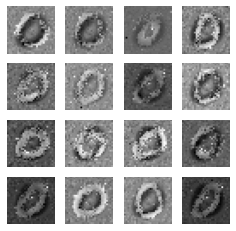

70
gen_loss: tf.Tensor(3.4653668, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051430497, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.054004155, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.93200892e-19]
 [1.00000000e+00 1.38858603e-21]
 [1.00000000e+00 5.04141062e-10]
 [1.00000000e+00 8.42035370e-18]
 [1.00000000e+00 1.20868928e-16]
 [1.00000000e+00 2.82183494e-16]
 [1.00000000e+00 3.48085907e-17]
 [1.00000000e+00 1.62601557e-17]
 [1.00000000e+00 1.26231908e-18]
 [1.00000000e+00 1.03621570e-16]
 [1.00000000e+00 7.17176841e-18]
 [1.00000000e+00 7.95117955e-19]
 [9.99999881e-01 1.52997458e-07]
 [1.00000000e+00 8.91109233e-17]
 [1.00000000e+00 8.37700179e-19]
 [1.00000000e+00 1.30877861e-19]
 [1.00000000e+00 3.02790352e-18]
 [1.00000000e+00 6.17424897e-18]
 [1.00000000e+00 1.37312271e-18]
 [1.00000000e+00 5.49343673e-19]
 [9.90227580e-01 9.77236032e-03]
 [1.00000000e+00 1.19724207e-20]
 [1.00000000e+00 3.13261001e-19]
 [1.00000000e+00

gen_loss: tf.Tensor(3.3746104, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09576607, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05421044, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.84549868e-18]
 [1.00000000e+00 4.00276980e-21]
 [1.00000000e+00 3.75944331e-10]
 [1.00000000e+00 2.86388684e-18]
 [1.00000000e+00 8.37892800e-17]
 [1.00000000e+00 1.43727171e-16]
 [1.00000000e+00 1.47402344e-17]
 [1.00000000e+00 5.53887252e-17]
 [1.00000000e+00 4.31968424e-19]
 [1.00000000e+00 4.79647627e-17]
 [1.00000000e+00 1.80367030e-17]
 [1.00000000e+00 1.24809276e-19]
 [9.99999762e-01 1.84765881e-07]
 [1.00000000e+00 1.30413573e-16]
 [1.00000000e+00 2.83696274e-19]
 [1.00000000e+00 8.72523229e-20]
 [1.00000000e+00 1.73924298e-18]
 [1.00000000e+00 5.43445337e-18]
 [1.00000000e+00 1.53401617e-18]
 [1.00000000e+00 2.98400779e-19]
 [9.92122114e-01 7.87791051e-03]
 [1.00000000e+00 2.75000234e-20]
 [1.00000000e+00 1.70106035e-19]
 [1.00000000e+00 5.17

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.10841904e-18]
 [1.00000000e+00 1.33670569e-20]
 [1.00000000e+00 4.44758702e-10]
 [1.00000000e+00 2.81129181e-18]
 [1.00000000e+00 1.23467440e-16]
 [1.00000000e+00 1.74051917e-16]
 [1.00000000e+00 1.71696258e-17]
 [1.00000000e+00 1.98615872e-16]
 [1.00000000e+00 4.60273743e-19]
 [1.00000000e+00 6.93472558e-17]
 [1.00000000e+00 5.20180072e-17]
 [1.00000000e+00 8.06385809e-20]
 [9.99999762e-01 2.32650251e-07]
 [1.00000000e+00 2.71809379e-16]
 [1.00000000e+00 2.99752728e-19]
 [1.00000000e+00 1.21132303e-19]
 [1.00000000e+00 2.24323896e-18]
 [1.00000000e+00 9.78486174e-18]
 [1.00000000e+00 3.20281603e-18]
 [1.00000000e+00 4.37348846e-19]
 [9.93867457e-01 6.13249512e-03]
 [1.00000000e+00 7.56134974e-20]
 [1.00000000e+00 2.58322198e-19]
 [1.00000000e+00 4.95800810e-18]
 [1.00000000e+00 4.70390119e-17]
 [1.00000000e+00 1.02516769e-12]
 [1.00000000e+00 4.90389427e-17]
 [1.00000000e+00 5.72030069e-17]
 [1.00000000e+00 9.92706095e-09]
 [1.0

gen_loss: tf.Tensor(3.30269, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.042439185, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07420416, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.25925129e-17]
 [1.00000000e+00 1.08525515e-20]
 [1.00000000e+00 6.44216180e-10]
 [1.00000000e+00 8.28557207e-18]
 [1.00000000e+00 4.69556738e-16]
 [1.00000000e+00 4.62031856e-16]
 [1.00000000e+00 3.70165376e-17]
 [1.00000000e+00 5.90114249e-16]
 [1.00000000e+00 9.39390144e-19]
 [1.00000000e+00 2.77781067e-16]
 [1.00000000e+00 1.79538559e-16]
 [1.00000000e+00 1.91283074e-19]
 [9.99999642e-01 3.86412040e-07]
 [1.00000000e+00 6.81459658e-16]
 [1.00000000e+00 5.86242959e-19]
 [1.00000000e+00 4.35805017e-19]
 [1.00000000e+00 6.02903742e-18]
 [1.00000000e+00 3.28060956e-17]
 [1.00000000e+00 8.39668227e-18]
 [1.00000000e+00 1.49396594e-18]
 [9.93349731e-01 6.65028859e-03]
 [1.00000000e+00 7.24916144e-20]
 [1.00000000e+00 1.16721833e-18]
 [1.00000000e+00 1.674

gen_loss: tf.Tensor(3.2753272, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04511053, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07649796, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.97234180e-18]
 [1.00000000e+00 4.08455203e-21]
 [1.00000000e+00 7.55311425e-10]
 [1.00000000e+00 7.66231712e-18]
 [1.00000000e+00 2.08529122e-16]
 [1.00000000e+00 4.14833115e-16]
 [1.00000000e+00 2.60382262e-17]
 [1.00000000e+00 1.33859131e-16]
 [1.00000000e+00 1.37853382e-18]
 [1.00000000e+00 1.81782455e-16]
 [1.00000000e+00 3.15942363e-17]
 [1.00000000e+00 8.86984323e-19]
 [9.99999762e-01 1.93883906e-07]
 [1.00000000e+00 3.37614786e-16]
 [1.00000000e+00 6.49699396e-19]
 [1.00000000e+00 4.23264494e-19]
 [1.00000000e+00 4.09785524e-18]
 [1.00000000e+00 1.14934645e-17]
 [1.00000000e+00 5.89870601e-18]
 [1.00000000e+00 9.42512958e-19]
 [9.96221304e-01 3.77865369e-03]
 [1.00000000e+00 3.71371266e-20]
 [1.00000000e+00 5.62645616e-19]
 [1.00000000e+00 1.50

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.08167700e-18]
 [1.00000000e+00 1.47965406e-21]
 [1.00000000e+00 9.99568317e-10]
 [1.00000000e+00 7.24242452e-18]
 [1.00000000e+00 1.46308888e-16]
 [1.00000000e+00 4.80037765e-16]
 [1.00000000e+00 2.09974604e-17]
 [1.00000000e+00 4.67214043e-17]
 [1.00000000e+00 1.26419368e-18]
 [1.00000000e+00 1.53037056e-16]
 [1.00000000e+00 1.11676745e-17]
 [1.00000000e+00 1.74404001e-18]
 [9.99999881e-01 1.47369050e-07]
 [1.00000000e+00 3.62998987e-16]
 [1.00000000e+00 5.72610196e-19]
 [1.00000000e+00 4.10401680e-19]
 [1.00000000e+00 3.24100262e-18]
 [1.00000000e+00 7.45507032e-18]
 [1.00000000e+00 4.06821487e-18]
 [1.00000000e+00 7.81734379e-19]
 [9.94372845e-01 5.62719628e-03]
 [1.00000000e+00 1.42064328e-20]
 [1.00000000e+00 4.11276191e-19]
 [1.00000000e+00 1.43402347e-17]
 [1.00000000e+00 4.63143322e-17]
 [1.00000000e+00 9.04050110e-13]
 [1.00000000e+00 6.65416907e-17]
 [1.00000000e+00 9.47874949e-18]
 [1.00000000e+00 3.87257865e-10]
 [1.0

gen_loss: tf.Tensor(3.3400447, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07039683, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.068646446, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.05006226e-18]
 [1.00000000e+00 1.17060991e-21]
 [1.00000000e+00 1.15059695e-09]
 [1.00000000e+00 1.00929590e-18]
 [1.00000000e+00 6.38622939e-17]
 [1.00000000e+00 2.13272388e-16]
 [1.00000000e+00 7.43087943e-18]
 [1.00000000e+00 3.50700889e-17]
 [1.00000000e+00 3.00252836e-19]
 [1.00000000e+00 2.87112968e-17]
 [1.00000000e+00 7.40885822e-18]
 [1.00000000e+00 1.81778704e-19]
 [9.99999762e-01 2.28447576e-07]
 [1.00000000e+00 1.60306226e-16]
 [1.00000000e+00 1.39956375e-19]
 [1.00000000e+00 1.81785645e-19]
 [1.00000000e+00 9.89540244e-19]
 [1.00000000e+00 2.81721793e-18]
 [1.00000000e+00 2.49863160e-18]
 [1.00000000e+00 3.81418797e-19]
 [9.92978871e-01 7.02117756e-03]
 [1.00000000e+00 7.57086992e-21]
 [1.00000000e+00 1.67587012e-19]
 [1.00000000e+00 2.5

gen_loss: tf.Tensor(3.2536778, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.054234274, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.082570404, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.37649492e-18]
 [1.00000000e+00 1.27246036e-21]
 [1.00000000e+00 8.58587590e-10]
 [1.00000000e+00 1.41529440e-19]
 [1.00000000e+00 2.57832180e-17]
 [1.00000000e+00 5.76602326e-17]
 [1.00000000e+00 2.74058006e-18]
 [1.00000000e+00 2.99428463e-17]
 [1.00000000e+00 8.96019746e-20]
 [1.00000000e+00 2.79204373e-18]
 [1.00000000e+00 6.20238800e-18]
 [1.00000000e+00 1.89811067e-20]
 [9.99999762e-01 2.89248703e-07]
 [1.00000000e+00 3.12093591e-17]
 [1.00000000e+00 4.36961777e-20]
 [1.00000000e+00 6.09416851e-20]
 [1.00000000e+00 2.65683744e-19]
 [1.00000000e+00 8.25206908e-19]
 [1.00000000e+00 1.62168470e-18]
 [1.00000000e+00 1.34699513e-19]
 [9.95780587e-01 4.21939278e-03]
 [1.00000000e+00 8.23077667e-21]
 [1.00000000e+00 5.15474013e-20]
 [1.00000000e+00 4.

gen_loss: tf.Tensor(3.5756826, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.065848395, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.057149295, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.82020739e-19]
 [1.00000000e+00 7.17479116e-22]
 [1.00000000e+00 1.19704102e-09]
 [1.00000000e+00 3.53124980e-19]
 [1.00000000e+00 3.33646907e-17]
 [1.00000000e+00 1.03820987e-16]
 [1.00000000e+00 3.93727756e-18]
 [1.00000000e+00 1.42852537e-17]
 [1.00000000e+00 1.77165905e-19]
 [1.00000000e+00 8.56281406e-18]
 [1.00000000e+00 5.15807000e-18]
 [1.00000000e+00 1.47606438e-19]
 [9.99999762e-01 1.92180352e-07]
 [1.00000000e+00 4.57546783e-17]
 [1.00000000e+00 9.71366982e-20]
 [1.00000000e+00 8.79789300e-20]
 [1.00000000e+00 4.36307374e-19]
 [1.00000000e+00 9.98961417e-19]
 [1.00000000e+00 1.40421695e-18]
 [1.00000000e+00 1.98546637e-19]
 [9.94519651e-01 5.48041333e-03]
 [1.00000000e+00 6.49671531e-21]
 [1.00000000e+00 1.00327250e-19]
 [1.00000000e+00 8.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.08249447e-19]
 [1.00000000e+00 8.59165502e-22]
 [1.00000000e+00 1.80653537e-09]
 [1.00000000e+00 9.47961286e-19]
 [1.00000000e+00 5.34253425e-17]
 [1.00000000e+00 2.13247982e-16]
 [1.00000000e+00 7.01745704e-18]
 [1.00000000e+00 1.38910806e-17]
 [1.00000000e+00 4.05351200e-19]
 [1.00000000e+00 2.98978774e-17]
 [1.00000000e+00 6.30855084e-18]
 [1.00000000e+00 7.76550904e-19]
 [9.99999881e-01 1.67368569e-07]
 [1.00000000e+00 9.74125543e-17]
 [1.00000000e+00 2.34771177e-19]
 [1.00000000e+00 1.59012962e-19]
 [1.00000000e+00 8.87901770e-19]
 [1.00000000e+00 1.75856365e-18]
 [1.00000000e+00 1.83756746e-18]
 [1.00000000e+00 3.68184941e-19]
 [9.93002594e-01 6.99744793e-03]
 [1.00000000e+00 8.74538803e-21]
 [1.00000000e+00 2.18683910e-19]
 [1.00000000e+00 2.08119635e-18]
 [1.00000000e+00 3.52193057e-17]
 [1.00000000e+00 2.48219332e-13]
 [1.00000000e+00 2.81839096e-17]
 [1.00000000e+00 7.70899161e-18]
 [1.00000000e+00 6.45606502e-09]
 [1.0

gen_loss: tf.Tensor(3.4084697, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0522212, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06361516, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.30015070e-18]
 [1.00000000e+00 6.41338857e-21]
 [1.00000000e+00 2.07629358e-09]
 [1.00000000e+00 7.44710757e-19]
 [1.00000000e+00 2.55583804e-17]
 [1.00000000e+00 1.63423705e-16]
 [1.00000000e+00 4.70650135e-18]
 [1.00000000e+00 2.14972065e-17]
 [1.00000000e+00 5.24603476e-19]
 [1.00000000e+00 2.19211994e-17]
 [1.00000000e+00 4.45866149e-18]
 [1.00000000e+00 1.72755244e-18]
 [9.99999881e-01 1.23293958e-07]
 [1.00000000e+00 9.78147096e-17]
 [1.00000000e+00 3.08836412e-19]
 [1.00000000e+00 1.16190894e-19]
 [1.00000000e+00 8.36840996e-19]
 [1.00000000e+00 9.85415507e-19]
 [1.00000000e+00 2.61535898e-18]
 [1.00000000e+00 2.02280427e-19]
 [9.96872365e-01 3.12761264e-03]
 [1.00000000e+00 6.36387074e-20]
 [1.00000000e+00 1.23284175e-19]
 [1.00000000e+00 1.131

gen_loss: tf.Tensor(3.476294, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04365422, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.060908824, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.48284982e-18]
 [1.00000000e+00 1.35385095e-20]
 [1.00000000e+00 1.72717152e-09]
 [1.00000000e+00 3.74751333e-19]
 [1.00000000e+00 1.21202689e-17]
 [1.00000000e+00 1.00576097e-16]
 [1.00000000e+00 2.58804630e-18]
 [1.00000000e+00 4.76303633e-17]
 [1.00000000e+00 3.76152034e-19]
 [1.00000000e+00 8.78207482e-18]
 [1.00000000e+00 5.57745843e-18]
 [1.00000000e+00 7.30437704e-19]
 [9.99999881e-01 1.34127063e-07]
 [1.00000000e+00 5.17709515e-17]
 [1.00000000e+00 2.16455485e-19]
 [1.00000000e+00 6.84723309e-20]
 [1.00000000e+00 6.37048082e-19]
 [1.00000000e+00 8.69699040e-19]
 [1.00000000e+00 2.57705204e-18]
 [1.00000000e+00 1.34166175e-19]
 [9.96972442e-01 3.02749360e-03]
 [1.00000000e+00 1.05844687e-19]
 [1.00000000e+00 8.44153971e-20]
 [1.00000000e+00 5.04

disc_real_loss: tf.Tensor(0.06855192, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.054809585, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.56753087e-18]
 [1.00000000e+00 9.83754351e-21]
 [1.00000000e+00 2.37426079e-09]
 [1.00000000e+00 1.00632405e-18]
 [1.00000000e+00 3.04429332e-17]
 [1.00000000e+00 2.73692598e-16]
 [1.00000000e+00 5.53240810e-18]
 [1.00000000e+00 1.05011942e-16]
 [1.00000000e+00 6.37242470e-19]
 [1.00000000e+00 2.52795097e-17]
 [1.00000000e+00 1.54966200e-17]
 [1.00000000e+00 1.28225155e-18]
 [9.99999762e-01 1.99629852e-07]
 [1.00000000e+00 1.12493890e-16]
 [1.00000000e+00 3.78376969e-19]
 [1.00000000e+00 1.53799979e-19]
 [1.00000000e+00 1.42430203e-18]
 [1.00000000e+00 3.25622047e-18]
 [1.00000000e+00 3.56348498e-18]
 [1.00000000e+00 4.07189273e-19]
 [9.92326021e-01 7.67404120e-03]
 [1.00000000e+00 7.41114085e-20]
 [1.00000000e+00 2.95856190e-19]
 [1.00000000e+00 1.47416882e-18]
 [1.00000000e+00 4.93004112e-17]
 [1.000000

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.60605312e-18]
 [1.00000000e+00 5.94825013e-21]
 [1.00000000e+00 3.32537708e-09]
 [1.00000000e+00 3.28783655e-18]
 [1.00000000e+00 9.12227353e-17]
 [1.00000000e+00 7.84008243e-16]
 [1.00000000e+00 1.40777372e-17]
 [1.00000000e+00 1.84850899e-16]
 [1.00000000e+00 1.29205694e-18]
 [1.00000000e+00 8.89027848e-17]
 [1.00000000e+00 3.87108053e-17]
 [1.00000000e+00 2.83927016e-18]
 [9.99999762e-01 2.79423489e-07]
 [1.00000000e+00 2.45208283e-16]
 [1.00000000e+00 7.81570391e-19]
 [1.00000000e+00 3.77753921e-19]
 [1.00000000e+00 3.34854210e-18]
 [1.00000000e+00 1.27881329e-17]
 [1.00000000e+00 4.91353556e-18]
 [1.00000000e+00 1.42887334e-18]
 [9.81929719e-01 1.80703122e-02]
 [1.00000000e+00 4.54867782e-20]
 [1.00000000e+00 1.24440431e-18]
 [1.00000000e+00 5.51470892e-18]
 [1.00000000e+00 1.21931279e-16]
 [1.00000000e+00 2.14172083e-12]
 [1.00000000e+00 4.97196925e-17]
 [1.00000000e+00 4.62603041e-17]
 [1.00000000e+00 6.74485356e-10]
 [1.0

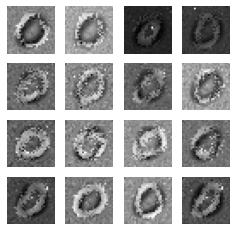

71
gen_loss: tf.Tensor(3.4426637, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05736259, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05761201, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.72365203e-18]
 [1.00000000e+00 5.97298881e-21]
 [1.00000000e+00 4.01884392e-09]
 [1.00000000e+00 8.23044379e-18]
 [1.00000000e+00 2.43404949e-16]
 [1.00000000e+00 1.52576638e-15]
 [1.00000000e+00 2.96588719e-17]
 [1.00000000e+00 2.21343923e-16]
 [1.00000000e+00 2.79010585e-18]
 [1.00000000e+00 1.78766304e-16]
 [1.00000000e+00 4.05229496e-17]
 [1.00000000e+00 6.86725138e-18]
 [9.99999642e-01 3.07365525e-07]
 [1.00000000e+00 3.03482164e-16]
 [1.00000000e+00 1.51552558e-18]
 [1.00000000e+00 7.88984462e-19]
 [1.00000000e+00 4.59500319e-18]
 [1.00000000e+00 3.03826053e-17]
 [1.00000000e+00 5.53147959e-18]
 [1.00000000e+00 3.64914574e-18]
 [9.77818966e-01 2.21810434e-02]
 [1.00000000e+00 5.52687576e-20]
 [1.00000000e+00 3.49742799e-18]
 [1.00000000e+00 1

gen_loss: tf.Tensor(3.44694, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.061623193, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.058055818, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.03835933e-18]
 [1.00000000e+00 9.74142173e-21]
 [1.00000000e+00 5.83405946e-09]
 [1.00000000e+00 9.37557608e-18]
 [1.00000000e+00 2.98137280e-16]
 [1.00000000e+00 1.65224078e-15]
 [1.00000000e+00 3.50880222e-17]
 [1.00000000e+00 1.42416229e-16]
 [1.00000000e+00 4.03763401e-18]
 [1.00000000e+00 1.88124654e-16]
 [1.00000000e+00 1.55916117e-17]
 [1.00000000e+00 1.25068203e-17]
 [9.99999762e-01 2.89844593e-07]
 [1.00000000e+00 4.21927122e-16]
 [1.00000000e+00 1.95260636e-18]
 [1.00000000e+00 1.05520608e-18]
 [1.00000000e+00 4.47002075e-18]
 [1.00000000e+00 2.44051004e-17]
 [1.00000000e+00 6.03607920e-18]
 [1.00000000e+00 3.94127491e-18]
 [9.79595482e-01 2.04045568e-02]
 [1.00000000e+00 8.19728491e-20]
 [1.00000000e+00 3.88802392e-18]
 [1.00000000e+00 2.66

gen_loss: tf.Tensor(3.297741, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044647954, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06859466, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.55124383e-18]
 [1.00000000e+00 4.84734382e-21]
 [1.00000000e+00 7.89412979e-09]
 [1.00000000e+00 1.02792775e-17]
 [1.00000000e+00 6.61290057e-16]
 [1.00000000e+00 2.69021264e-15]
 [1.00000000e+00 4.42398294e-17]
 [1.00000000e+00 1.63000956e-16]
 [1.00000000e+00 2.90442924e-18]
 [1.00000000e+00 4.13285189e-16]
 [1.00000000e+00 2.68670232e-17]
 [1.00000000e+00 8.17892698e-18]
 [9.99999642e-01 3.62753070e-07]
 [1.00000000e+00 1.40041037e-15]
 [1.00000000e+00 1.64148926e-18]
 [1.00000000e+00 1.83753954e-18]
 [1.00000000e+00 7.32561573e-18]
 [1.00000000e+00 4.76223694e-17]
 [1.00000000e+00 5.59710976e-18]
 [1.00000000e+00 6.37748642e-18]
 [9.52478111e-01 4.75219116e-02]
 [1.00000000e+00 3.12034790e-20]
 [1.00000000e+00 8.40857382e-18]
 [1.00000000e+00 4.46

gen_loss: tf.Tensor(3.3086991, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.058393374, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06458169, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.74650034e-18]
 [1.00000000e+00 1.70169470e-21]
 [1.00000000e+00 4.45303883e-09]
 [1.00000000e+00 3.64675229e-18]
 [1.00000000e+00 3.67925754e-16]
 [1.00000000e+00 1.52694248e-15]
 [1.00000000e+00 1.76692959e-17]
 [1.00000000e+00 8.78090668e-17]
 [1.00000000e+00 7.15867228e-19]
 [1.00000000e+00 2.09917052e-16]
 [1.00000000e+00 2.60555160e-17]
 [1.00000000e+00 2.39918277e-18]
 [9.99999762e-01 2.25026611e-07]
 [1.00000000e+00 6.46797270e-16]
 [1.00000000e+00 4.52146746e-19]
 [1.00000000e+00 1.05533895e-18]
 [1.00000000e+00 3.87413638e-18]
 [1.00000000e+00 2.72464294e-17]
 [1.00000000e+00 1.68964648e-18]
 [1.00000000e+00 2.76303347e-18]
 [9.61207747e-01 3.87922898e-02]
 [1.00000000e+00 1.50510182e-20]
 [1.00000000e+00 3.83338574e-18]
 [1.00000000e+00 2.1

gen_loss: tf.Tensor(3.4445093, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07155001, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05069481, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.45041736e-18]
 [1.00000000e+00 1.41855235e-21]
 [1.00000000e+00 3.25239946e-09]
 [1.00000000e+00 1.40635593e-18]
 [1.00000000e+00 1.13528091e-16]
 [1.00000000e+00 4.55285344e-16]
 [1.00000000e+00 7.64829971e-18]
 [1.00000000e+00 3.88593504e-17]
 [1.00000000e+00 3.79981079e-19]
 [1.00000000e+00 1.01272166e-16]
 [1.00000000e+00 8.24584258e-18]
 [1.00000000e+00 1.50762590e-18]
 [9.99999881e-01 1.53053790e-07]
 [1.00000000e+00 2.20697240e-16]
 [1.00000000e+00 2.40561493e-19]
 [1.00000000e+00 3.37886116e-19]
 [1.00000000e+00 1.47098376e-18]
 [1.00000000e+00 7.62173729e-18]
 [1.00000000e+00 9.98389939e-19]
 [1.00000000e+00 7.46966944e-19]
 [9.76432621e-01 2.35673916e-02]
 [1.00000000e+00 1.24521023e-20]
 [1.00000000e+00 1.12147142e-18]
 [1.00000000e+00 7.64

 [1.00000000e+00 3.59535575e-17]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.5161293, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05317401, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049536005, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.48983332e-19]
 [1.00000000e+00 1.33489099e-21]
 [1.00000000e+00 4.59907534e-09]
 [1.00000000e+00 1.41798092e-18]
 [1.00000000e+00 5.82689648e-17]
 [1.00000000e+00 2.57878546e-16]
 [1.00000000e+00 6.83807796e-18]
 [1.00000000e+00 1.99121763e-17]
 [1.00000000e+00 4.85882686e-19]
 [1.00000000e+00 1.15115920e-16]
 [1.00000000e+00 2.84836108e-18]
 [1.00000000e+00 3.39651568e-18]
 [9.99999881e-01 1.48543307e-07]
 [1.00000000e+00 1.93131056e-16]
 [1.00000000e+00 3.15490408e-19]
 [1.00000000e+00 1.77684354e-19]
 [1.00000000e+00 1.02749212e-18]
 [1.00000000e+00 3.55171875e-18]
 [1.00000000e+00 1.10570732e-18]
 [1.00000000e+00 3.49810700e-19]
 [9.74695086e-01 2.53049303e-02]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.4356337, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.049771175, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05171235, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.07444096e-19]
 [1.00000000e+00 1.21905864e-21]
 [1.00000000e+00 5.36476552e-09]
 [1.00000000e+00 1.77609905e-18]
 [1.00000000e+00 5.55347093e-17]
 [1.00000000e+00 2.96873004e-16]
 [1.00000000e+00 7.62522716e-18]
 [1.00000000e+00 1.75364077e-17]
 [1.00000000e+00 5.58757092e-19]
 [1.00000000e+00 1.56597519e-16]
 [1.00000000e+00 2.18952806e-18]
 [1.00000000e+00 6.22984709e-18]
 [9.99999881e-01 1.39135295e-07]
 [1.00000000e+00 2.63504988e-16]
 [1.00000000e+00 3.80745730e-19]
 [1.00000000e+00 1.79692451e-19]
 [1.00000000e+00 1.04727404e-18]
 [1.00000000e+00 3.65202846e-18]
 [1.00000000e+00 1.17769747e-18]
 [1.00000000e+00 3.15152401e-19]
 [9.69236732e-01 3.07632759e-02]
 [1.00000000e+00 9.33787068e-21]
 [1.00000000e+00 5.89496881e-19]
 [1.00000000e+00 7.4

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.98131118e-19]
 [1.00000000e+00 9.25597738e-22]
 [1.00000000e+00 5.08054665e-09]
 [1.00000000e+00 1.61036649e-18]
 [1.00000000e+00 4.69554700e-17]
 [1.00000000e+00 2.77387170e-16]
 [1.00000000e+00 6.78315565e-18]
 [1.00000000e+00 1.40842355e-17]
 [1.00000000e+00 4.67769964e-19]
 [1.00000000e+00 1.36772395e-16]
 [1.00000000e+00 1.70240491e-18]
 [1.00000000e+00 6.92158680e-18]
 [9.99999881e-01 1.22605798e-07]
 [1.00000000e+00 2.44931568e-16]
 [1.00000000e+00 3.28630534e-19]
 [1.00000000e+00 1.54528040e-19]
 [1.00000000e+00 8.29268210e-19]
 [1.00000000e+00 3.29891746e-18]
 [1.00000000e+00 9.72884135e-19]
 [1.00000000e+00 2.34699522e-19]
 [9.65720892e-01 3.42791528e-02]
 [1.00000000e+00 7.66098979e-21]
 [1.00000000e+00 4.34586477e-19]
 [1.00000000e+00 6.61153139e-18]
 [1.00000000e+00 1.30465755e-17]
 [1.00000000e+00 2.82707560e-13]
 [1.00000000e+00 7.57738304e-18]
 [1.00000000e+00 7.04113425e-18]
 [1.00000000e+00 5.03247610e-10]
 [1.0

gen_loss: tf.Tensor(3.5027876, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0346274, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0524548, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.85013491e-19]
 [1.00000000e+00 1.30244707e-21]
 [1.00000000e+00 3.11660631e-09]
 [1.00000000e+00 5.02658220e-19]
 [1.00000000e+00 2.67125058e-17]
 [1.00000000e+00 1.31143941e-16]
 [1.00000000e+00 3.36506089e-18]
 [1.00000000e+00 1.11071745e-17]
 [1.00000000e+00 2.07903704e-19]
 [1.00000000e+00 3.75713607e-17]
 [1.00000000e+00 1.28635705e-18]
 [1.00000000e+00 2.04291319e-18]
 [9.99999881e-01 6.24071248e-08]
 [1.00000000e+00 1.19929238e-16]
 [1.00000000e+00 1.49336693e-19]
 [1.00000000e+00 7.84437476e-20]
 [1.00000000e+00 3.40838996e-19]
 [1.00000000e+00 2.13605993e-18]
 [1.00000000e+00 5.88867552e-19]
 [1.00000000e+00 1.00756809e-19]
 [9.79019225e-01 2.09807176e-02]
 [1.00000000e+00 1.26620010e-20]
 [1.00000000e+00 1.57348778e-19]
 [1.00000000e+00 1.9046

gen_loss: tf.Tensor(3.4461937, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.041921265, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0516332, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.97910048e-19]
 [1.00000000e+00 4.11924030e-22]
 [1.00000000e+00 6.56603127e-09]
 [1.00000000e+00 2.67215630e-18]
 [1.00000000e+00 1.03597860e-16]
 [1.00000000e+00 4.87999186e-16]
 [1.00000000e+00 1.36628921e-17]
 [1.00000000e+00 9.17976258e-18]
 [1.00000000e+00 1.04057191e-18]
 [1.00000000e+00 2.67477996e-16]
 [1.00000000e+00 2.80111149e-18]
 [1.00000000e+00 2.79076743e-17]
 [9.99999881e-01 6.69060967e-08]
 [1.00000000e+00 2.88475546e-16]
 [1.00000000e+00 6.87655354e-19]
 [1.00000000e+00 2.44542817e-19]
 [1.00000000e+00 1.13740819e-18]
 [1.00000000e+00 9.52957974e-18]
 [1.00000000e+00 8.60672535e-19]
 [1.00000000e+00 5.34827894e-19]
 [9.53067124e-01 4.69328389e-02]
 [1.00000000e+00 4.82693572e-21]
 [1.00000000e+00 9.67960756e-19]
 [1.00000000e+00 9.55

gen_loss: tf.Tensor(3.5300996, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044374324, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049882457, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.10317534e-19]
 [1.00000000e+00 7.16962027e-22]
 [1.00000000e+00 9.46482803e-09]
 [1.00000000e+00 3.94497489e-18]
 [1.00000000e+00 1.40798925e-16]
 [1.00000000e+00 5.77379585e-16]
 [1.00000000e+00 1.89853336e-17]
 [1.00000000e+00 1.21784792e-17]
 [1.00000000e+00 2.18237356e-18]
 [1.00000000e+00 4.92342824e-16]
 [1.00000000e+00 2.66075383e-18]
 [1.00000000e+00 1.14351738e-16]
 [9.99999881e-01 9.71737819e-08]
 [1.00000000e+00 3.40476963e-16]
 [1.00000000e+00 1.34400337e-18]
 [1.00000000e+00 3.64643031e-19]
 [1.00000000e+00 1.78490832e-18]
 [1.00000000e+00 1.13452271e-17]
 [1.00000000e+00 1.31208857e-18]
 [1.00000000e+00 8.35545942e-19]
 [9.61299300e-01 3.87007482e-02]
 [1.00000000e+00 8.88958241e-21]
 [1.00000000e+00 1.43213667e-18]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.4035332, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0740943, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05728419, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.14095421e-18]
 [1.00000000e+00 1.94052189e-21]
 [1.00000000e+00 5.30057553e-09]
 [1.00000000e+00 1.44078898e-18]
 [1.00000000e+00 8.95751106e-17]
 [1.00000000e+00 3.83205937e-16]
 [1.00000000e+00 7.26505949e-18]
 [1.00000000e+00 3.47229179e-17]
 [1.00000000e+00 7.20085073e-19]
 [1.00000000e+00 4.01023831e-16]
 [1.00000000e+00 3.53347487e-18]
 [1.00000000e+00 3.67492126e-17]
 [9.99999881e-01 1.07966493e-07]
 [1.00000000e+00 2.19884631e-16]
 [1.00000000e+00 4.33457323e-19]
 [1.00000000e+00 3.25121685e-19]
 [1.00000000e+00 1.42163685e-18]
 [1.00000000e+00 9.97579571e-18]
 [1.00000000e+00 8.57284352e-19]
 [1.00000000e+00 5.21041481e-19]
 [9.82396483e-01 1.76034831e-02]
 [1.00000000e+00 2.79640038e-20]
 [1.00000000e+00 7.78401617e-19]
 [1.00000000e+00 4.838

gen_loss: tf.Tensor(3.386303, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08739034, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.055989392, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.39256034e-19]
 [1.00000000e+00 4.06187989e-22]
 [1.00000000e+00 2.82737256e-09]
 [1.00000000e+00 5.39335253e-19]
 [1.00000000e+00 5.26864221e-17]
 [1.00000000e+00 2.57935614e-16]
 [1.00000000e+00 2.46900364e-18]
 [1.00000000e+00 2.82676798e-17]
 [1.00000000e+00 1.47816620e-19]
 [1.00000000e+00 3.30218177e-16]
 [1.00000000e+00 3.09176063e-18]
 [1.00000000e+00 1.05937294e-17]
 [9.99999881e-01 1.66987206e-07]
 [1.00000000e+00 9.60187152e-17]
 [1.00000000e+00 8.54619551e-20]
 [1.00000000e+00 2.12972073e-19]
 [1.00000000e+00 9.35756340e-19]
 [1.00000000e+00 7.20324428e-18]
 [1.00000000e+00 2.04848396e-19]
 [1.00000000e+00 2.74418771e-19]
 [9.64533329e-01 3.54666524e-02]
 [1.00000000e+00 5.32201948e-21]
 [1.00000000e+00 4.44773620e-19]
 [1.00000000e+00 2.35

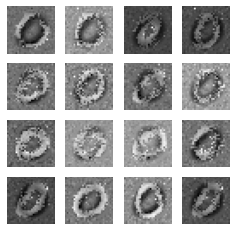

72
gen_loss: tf.Tensor(3.3763409, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07741529, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.053081494, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.53342939e-19]
 [1.00000000e+00 3.85193586e-22]
 [1.00000000e+00 3.37583783e-09]
 [1.00000000e+00 6.07641346e-19]
 [1.00000000e+00 6.67672265e-17]
 [1.00000000e+00 3.01764408e-16]
 [1.00000000e+00 2.72495338e-18]
 [1.00000000e+00 3.29875559e-17]
 [1.00000000e+00 1.62704384e-19]
 [1.00000000e+00 4.56532336e-16]
 [1.00000000e+00 4.39054152e-18]
 [1.00000000e+00 9.07724595e-18]
 [9.99999762e-01 2.01801839e-07]
 [1.00000000e+00 1.20554877e-16]
 [1.00000000e+00 8.94694513e-20]
 [1.00000000e+00 2.50046101e-19]
 [1.00000000e+00 1.24827903e-18]
 [1.00000000e+00 9.77501250e-18]
 [1.00000000e+00 2.61978104e-19]
 [1.00000000e+00 3.61324020e-19]
 [9.49720740e-01 5.02791889e-02]
 [1.00000000e+00 4.03964598e-21]
 [1.00000000e+00 6.20255075e-19]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.3452353, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.042525046, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06127559, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.47559219e-18]
 [1.00000000e+00 1.04642588e-21]
 [1.00000000e+00 5.95229288e-09]
 [1.00000000e+00 5.97360990e-19]
 [1.00000000e+00 5.18096735e-17]
 [1.00000000e+00 1.64675937e-16]
 [1.00000000e+00 3.40361041e-18]
 [1.00000000e+00 2.26081696e-17]
 [1.00000000e+00 4.25091348e-19]
 [1.00000000e+00 3.38856007e-16]
 [1.00000000e+00 2.87122683e-18]
 [1.00000000e+00 1.03698629e-17]
 [9.99999881e-01 1.43886353e-07]
 [1.00000000e+00 8.77708907e-17]
 [1.00000000e+00 1.92203235e-19]
 [1.00000000e+00 2.15597634e-19]
 [1.00000000e+00 1.49119882e-18]
 [1.00000000e+00 5.37653129e-18]
 [1.00000000e+00 8.00330692e-19]
 [1.00000000e+00 3.54615275e-19]
 [9.72700834e-01 2.72991247e-02]
 [1.00000000e+00 7.70060318e-21]
 [1.00000000e+00 6.19701640e-19]
 [1.00000000e+00 1.9

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.02049949e-18]
 [1.00000000e+00 2.15764428e-21]
 [1.00000000e+00 8.41339265e-09]
 [1.00000000e+00 7.73992744e-19]
 [1.00000000e+00 5.43406212e-17]
 [1.00000000e+00 1.53547552e-16]
 [1.00000000e+00 4.90823374e-18]
 [1.00000000e+00 2.02027681e-17]
 [1.00000000e+00 9.51486420e-19]
 [1.00000000e+00 3.40526303e-16]
 [1.00000000e+00 2.37117713e-18]
 [1.00000000e+00 1.62808865e-17]
 [9.99999881e-01 1.21950904e-07]
 [1.00000000e+00 9.53282047e-17]
 [1.00000000e+00 3.85122188e-19]
 [1.00000000e+00 2.42207893e-19]
 [1.00000000e+00 1.90786913e-18]
 [1.00000000e+00 4.59670388e-18]
 [1.00000000e+00 1.76439610e-18]
 [1.00000000e+00 4.05682253e-19]
 [9.81831551e-01 1.81684494e-02]
 [1.00000000e+00 1.48831603e-20]
 [1.00000000e+00 7.15348585e-19]
 [1.00000000e+00 2.17176807e-18]
 [1.00000000e+00 2.68715346e-17]
 [1.00000000e+00 2.15768186e-13]
 [1.00000000e+00 7.94545277e-18]
 [1.00000000e+00 1.45607826e-17]
 [1.00000000e+00 1.04967857e-09]
 [1.0

gen_loss: tf.Tensor(3.437991, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.029810721, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051201127, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.65206946e-18]
 [1.00000000e+00 3.75446334e-21]
 [1.00000000e+00 1.28255158e-08]
 [1.00000000e+00 1.24912699e-18]
 [1.00000000e+00 6.88354229e-17]
 [1.00000000e+00 1.95862102e-16]
 [1.00000000e+00 7.99232744e-18]
 [1.00000000e+00 2.04243897e-17]
 [1.00000000e+00 2.18204890e-18]
 [1.00000000e+00 4.63560697e-16]
 [1.00000000e+00 2.27479569e-18]
 [1.00000000e+00 3.10917208e-17]
 [9.99999881e-01 1.11232573e-07]
 [1.00000000e+00 1.44622538e-16]
 [1.00000000e+00 8.27205118e-19]
 [1.00000000e+00 3.26002193e-19]
 [1.00000000e+00 2.81421031e-18]
 [1.00000000e+00 5.18755030e-18]
 [1.00000000e+00 3.74133005e-18]
 [1.00000000e+00 5.42960165e-19]
 [9.83561933e-01 1.64380036e-02]
 [1.00000000e+00 2.49189000e-20]
 [1.00000000e+00 1.00643158e-18]
 [1.00000000e+00 3.0

gen_loss: tf.Tensor(3.4427452, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04836943, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05297903, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.22447783e-18]
 [1.00000000e+00 5.80640400e-21]
 [1.00000000e+00 1.66127805e-08]
 [1.00000000e+00 2.27667091e-18]
 [1.00000000e+00 9.75795455e-17]
 [1.00000000e+00 3.47583199e-16]
 [1.00000000e+00 1.29735214e-17]
 [1.00000000e+00 2.33846308e-17]
 [1.00000000e+00 4.21527725e-18]
 [1.00000000e+00 8.58840481e-16]
 [1.00000000e+00 2.62395297e-18]
 [1.00000000e+00 6.43052524e-17]
 [9.99999881e-01 1.02689036e-07]
 [1.00000000e+00 2.86124712e-16]
 [1.00000000e+00 1.58208932e-18]
 [1.00000000e+00 5.25108005e-19]
 [1.00000000e+00 4.66608241e-18]
 [1.00000000e+00 7.89270842e-18]
 [1.00000000e+00 5.95786514e-18]
 [1.00000000e+00 7.98900135e-19]
 [9.82030094e-01 1.79698691e-02]
 [1.00000000e+00 3.87845021e-20]
 [1.00000000e+00 1.54037853e-18]
 [1.00000000e+00 5.22

gen_loss: tf.Tensor(3.3669505, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.056554917, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05688384, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.20362254e-18]
 [1.00000000e+00 5.09553839e-21]
 [1.00000000e+00 1.89289437e-08]
 [1.00000000e+00 4.39530029e-18]
 [1.00000000e+00 1.72634208e-16]
 [1.00000000e+00 7.27685476e-16]
 [1.00000000e+00 2.16489578e-17]
 [1.00000000e+00 2.74716508e-17]
 [1.00000000e+00 6.64952214e-18]
 [1.00000000e+00 1.89777520e-15]
 [1.00000000e+00 3.73678015e-18]
 [1.00000000e+00 1.24203909e-16]
 [9.99999881e-01 1.18229082e-07]
 [1.00000000e+00 5.20233925e-16]
 [1.00000000e+00 2.56763190e-18]
 [1.00000000e+00 9.46201873e-19]
 [1.00000000e+00 8.69805726e-18]
 [1.00000000e+00 1.37920257e-17]
 [1.00000000e+00 6.88676912e-18]
 [1.00000000e+00 1.30086507e-18]
 [9.74409759e-01 2.55902726e-02]
 [1.00000000e+00 3.45203989e-20]
 [1.00000000e+00 2.77612360e-18]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.3660235, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05955097, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06383081, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.14700864e-18]
 [1.00000000e+00 4.09194415e-21]
 [1.00000000e+00 1.58787756e-08]
 [1.00000000e+00 4.65431370e-18]
 [1.00000000e+00 2.54194482e-16]
 [1.00000000e+00 1.00508262e-15]
 [1.00000000e+00 2.63461624e-17]
 [1.00000000e+00 3.66714907e-17]
 [1.00000000e+00 6.20338186e-18]
 [1.00000000e+00 2.12138978e-15]
 [1.00000000e+00 5.29059219e-18]
 [1.00000000e+00 8.29484211e-17]
 [9.99999881e-01 1.57637800e-07]
 [1.00000000e+00 5.47630888e-16]
 [1.00000000e+00 2.51617382e-18]
 [1.00000000e+00 1.31891333e-18]
 [1.00000000e+00 1.06604572e-17]
 [1.00000000e+00 1.91729630e-17]
 [1.00000000e+00 5.45100112e-18]
 [1.00000000e+00 1.54231299e-18]
 [9.65672612e-01 3.43273021e-02]
 [1.00000000e+00 2.76375809e-20]
 [1.00000000e+00 3.51918904e-18]
 [1.00000000e+00 1.16

gen_loss: tf.Tensor(3.4848733, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0722388, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.055490844, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.46505214e-18]
 [1.00000000e+00 8.79577415e-21]
 [1.00000000e+00 6.92407465e-09]
 [1.00000000e+00 8.10738382e-19]
 [1.00000000e+00 1.80360922e-16]
 [1.00000000e+00 5.32538402e-16]
 [1.00000000e+00 1.24262604e-17]
 [1.00000000e+00 6.06454017e-17]
 [1.00000000e+00 1.70829237e-18]
 [1.00000000e+00 5.73415471e-16]
 [1.00000000e+00 5.79486258e-18]
 [1.00000000e+00 5.48192568e-18]
 [9.99999762e-01 2.14076593e-07]
 [1.00000000e+00 1.50686857e-16]
 [1.00000000e+00 6.37580476e-19]
 [1.00000000e+00 1.03321093e-18]
 [1.00000000e+00 4.94305102e-18]
 [1.00000000e+00 1.15349278e-17]
 [1.00000000e+00 1.44169619e-18]
 [1.00000000e+00 6.98929464e-19]
 [9.74549115e-01 2.54508574e-02]
 [1.00000000e+00 5.57362439e-20]
 [1.00000000e+00 1.50336457e-18]
 [1.00000000e+00 2.55

gen_loss: tf.Tensor(3.4202068, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.057186604, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061509646, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.15118782e-18]
 [1.00000000e+00 7.85110643e-21]
 [1.00000000e+00 7.83446019e-09]
 [1.00000000e+00 5.72452928e-19]
 [1.00000000e+00 2.63901320e-16]
 [1.00000000e+00 8.08864478e-16]
 [1.00000000e+00 1.38311191e-17]
 [1.00000000e+00 4.82449717e-17]
 [1.00000000e+00 1.45284834e-18]
 [1.00000000e+00 8.28516966e-16]
 [1.00000000e+00 5.11285548e-18]
 [1.00000000e+00 4.51259574e-18]
 [9.99999762e-01 2.66319006e-07]
 [1.00000000e+00 1.42305439e-16]
 [1.00000000e+00 4.74578385e-19]
 [1.00000000e+00 1.83875260e-18]
 [1.00000000e+00 5.37415274e-18]
 [1.00000000e+00 1.02550726e-17]
 [1.00000000e+00 6.83606615e-19]
 [1.00000000e+00 7.83289582e-19]
 [9.65427816e-01 3.45721953e-02]
 [1.00000000e+00 5.79693472e-20]
 [1.00000000e+00 1.50185135e-18]
 [1.00000000e+00 2.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.51530596e-18]
 [1.00000000e+00 3.95483815e-21]
 [1.00000000e+00 1.44192622e-08]
 [1.00000000e+00 1.53436151e-18]
 [1.00000000e+00 6.82586212e-16]
 [1.00000000e+00 2.16793911e-15]
 [1.00000000e+00 3.19299757e-17]
 [1.00000000e+00 4.64257733e-17]
 [1.00000000e+00 3.11585495e-18]
 [1.00000000e+00 2.55712809e-15]
 [1.00000000e+00 6.76811295e-18]
 [1.00000000e+00 1.53823599e-17]
 [9.99999523e-01 4.49753003e-07]
 [1.00000000e+00 2.94786418e-16]
 [1.00000000e+00 1.03054607e-18]
 [1.00000000e+00 4.70987790e-18]
 [1.00000000e+00 1.29564095e-17]
 [1.00000000e+00 1.88898323e-17]
 [1.00000000e+00 9.23402087e-19]
 [1.00000000e+00 1.72055480e-18]
 [9.18868601e-01 8.11313540e-02]
 [1.00000000e+00 3.16389346e-20]
 [1.00000000e+00 3.61142299e-18]
 [1.00000000e+00 6.60412068e-18]
 [1.00000000e+00 1.58519609e-16]
 [1.00000000e+00 3.10705590e-13]
 [1.00000000e+00 5.20037235e-17]
 [1.00000000e+00 5.02403762e-17]
 [1.00000000e+00 3.17613491e-10]
 [1.0

gen_loss: tf.Tensor(3.5677814, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.045390088, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.062342726, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.38549208e-19]
 [1.00000000e+00 2.70926712e-21]
 [1.00000000e+00 1.62828542e-08]
 [1.00000000e+00 2.19972513e-18]
 [1.00000000e+00 8.24695206e-16]
 [1.00000000e+00 2.54369203e-15]
 [1.00000000e+00 3.82373403e-17]
 [1.00000000e+00 1.90794999e-17]
 [1.00000000e+00 3.97816137e-18]
 [1.00000000e+00 3.11442199e-15]
 [1.00000000e+00 3.27336999e-18]
 [1.00000000e+00 3.62341637e-17]
 [9.99999642e-01 3.79654352e-07]
 [1.00000000e+00 3.22407527e-16]
 [1.00000000e+00 1.27688232e-18]
 [1.00000000e+00 5.58009755e-18]
 [1.00000000e+00 1.52628869e-17]
 [1.00000000e+00 1.30214168e-17]
 [1.00000000e+00 7.31302004e-19]
 [1.00000000e+00 1.55646843e-18]
 [8.94658864e-01 1.05341069e-01]
 [1.00000000e+00 2.88669781e-20]
 [1.00000000e+00 3.25738824e-18]
 [1.00000000e+00 9.

 [1.00000000e+00 3.95017256e-17]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.546715, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03783746, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051526673, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.18802549e-19]
 [1.00000000e+00 1.33045862e-20]
 [1.00000000e+00 1.07768532e-08]
 [1.00000000e+00 1.56149965e-18]
 [1.00000000e+00 5.14080813e-16]
 [1.00000000e+00 1.41469283e-15]
 [1.00000000e+00 2.58797864e-17]
 [1.00000000e+00 1.76956697e-17]
 [1.00000000e+00 2.94871587e-18]
 [1.00000000e+00 1.82811754e-15]
 [1.00000000e+00 2.11247122e-18]
 [1.00000000e+00 2.56335645e-17]
 [9.99999762e-01 1.78985445e-07]
 [1.00000000e+00 3.20925219e-16]
 [1.00000000e+00 9.61777167e-19]
 [1.00000000e+00 3.30638835e-18]
 [1.00000000e+00 1.06278514e-17]
 [1.00000000e+00 7.72824837e-18]
 [1.00000000e+00 8.68853455e-19]
 [1.00000000e+00 7.93554376e-19]
 [9.48857903e-01 5.11421002e-02]
 [1.00000000e+00 1.62

 [1.00000000e+00 4.27532799e-17]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.555716, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.038746614, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049231887, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.30376631e-18]
 [1.00000000e+00 2.18992691e-20]
 [1.00000000e+00 1.24593296e-08]
 [1.00000000e+00 1.98536127e-18]
 [1.00000000e+00 5.91540917e-16]
 [1.00000000e+00 1.56930684e-15]
 [1.00000000e+00 3.13590126e-17]
 [1.00000000e+00 2.35867475e-17]
 [1.00000000e+00 3.59673971e-18]
 [1.00000000e+00 2.22445294e-15]
 [1.00000000e+00 2.50197940e-18]
 [1.00000000e+00 3.02599973e-17]
 [9.99999881e-01 1.75121286e-07]
 [1.00000000e+00 5.07857132e-16]
 [1.00000000e+00 1.21038134e-18]
 [1.00000000e+00 3.71062924e-18]
 [1.00000000e+00 1.40069736e-17]
 [1.00000000e+00 9.28768732e-18]
 [1.00000000e+00 1.37154176e-18]
 [1.00000000e+00 8.82933310e-19]
 [9.42775190e-01 5.72248101e-02]
 [1.00000000e+00 2.4

gen_loss: tf.Tensor(3.5767503, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.058179982, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05104585, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.23232975e-18]
 [1.00000000e+00 1.47410548e-20]
 [1.00000000e+00 1.31078455e-08]
 [1.00000000e+00 1.94612189e-18]
 [1.00000000e+00 5.55529576e-16]
 [1.00000000e+00 1.27909757e-15]
 [1.00000000e+00 3.03824895e-17]
 [1.00000000e+00 2.32570597e-17]
 [1.00000000e+00 3.24888772e-18]
 [1.00000000e+00 2.05316657e-15]
 [1.00000000e+00 2.43584921e-18]
 [1.00000000e+00 2.53811619e-17]
 [9.99999762e-01 2.23187314e-07]
 [1.00000000e+00 5.43765241e-16]
 [1.00000000e+00 1.13093136e-18]
 [1.00000000e+00 2.80086581e-18]
 [1.00000000e+00 1.39842311e-17]
 [1.00000000e+00 8.93344887e-18]
 [1.00000000e+00 1.59542874e-18]
 [1.00000000e+00 7.84931742e-19]
 [9.14259434e-01 8.57405588e-02]
 [1.00000000e+00 1.34384383e-19]
 [1.00000000e+00 2.19095680e-18]
 [1.00000000e+00 6.9

gen_loss: tf.Tensor(3.5016794, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07349159, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06273553, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.47879818e-19]
 [1.00000000e+00 6.14978998e-22]
 [1.00000000e+00 1.47565045e-08]
 [1.00000000e+00 6.05544909e-19]
 [1.00000000e+00 8.48397200e-17]
 [1.00000000e+00 1.91304535e-16]
 [1.00000000e+00 8.61776780e-18]
 [1.00000000e+00 4.23802719e-18]
 [1.00000000e+00 1.11969318e-18]
 [1.00000000e+00 4.09214190e-16]
 [1.00000000e+00 5.89166422e-19]
 [1.00000000e+00 1.02260484e-17]
 [9.99999404e-01 5.68575729e-07]
 [1.00000000e+00 5.55766706e-17]
 [1.00000000e+00 3.82663393e-19]
 [1.00000000e+00 3.49802687e-19]
 [1.00000000e+00 5.41952690e-18]
 [1.00000000e+00 1.39560848e-18]
 [1.00000000e+00 5.18984387e-19]
 [1.00000000e+00 1.91807713e-19]
 [8.45923841e-01 1.54076114e-01]
 [1.00000000e+00 4.97036593e-21]
 [1.00000000e+00 7.12907679e-19]
 [1.00000000e+00 2.45

gen_loss: tf.Tensor(3.5560694, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.059433505, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051646866, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.63771932e-19]
 [1.00000000e+00 1.24136323e-21]
 [1.00000000e+00 1.32395082e-08]
 [1.00000000e+00 8.97463306e-20]
 [1.00000000e+00 1.38281652e-17]
 [1.00000000e+00 4.71077903e-17]
 [1.00000000e+00 1.73905728e-18]
 [1.00000000e+00 4.10544379e-18]
 [1.00000000e+00 2.66679850e-19]
 [1.00000000e+00 1.50546660e-16]
 [1.00000000e+00 3.70232756e-19]
 [1.00000000e+00 1.61056305e-18]
 [9.99999404e-01 5.90186403e-07]
 [1.00000000e+00 1.47625170e-17]
 [1.00000000e+00 7.87567708e-20]
 [1.00000000e+00 6.76913884e-20]
 [1.00000000e+00 1.55147712e-18]
 [1.00000000e+00 5.03310555e-19]
 [1.00000000e+00 1.77805045e-19]
 [1.00000000e+00 6.12689578e-20]
 [9.20476794e-01 7.95232132e-02]
 [1.00000000e+00 9.54189672e-21]
 [1.00000000e+00 1.65433124e-19]
 [1.00000000e+00 3.

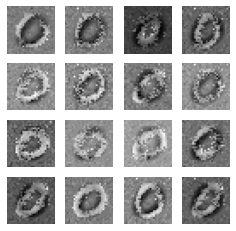

73
gen_loss: tf.Tensor(3.6210098, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.053873546, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.060841285, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.94846694e-19]
 [1.00000000e+00 9.06566929e-22]
 [1.00000000e+00 1.26602675e-08]
 [1.00000000e+00 5.26527860e-20]
 [1.00000000e+00 9.76025725e-18]
 [1.00000000e+00 3.38136611e-17]
 [1.00000000e+00 1.13612461e-18]
 [1.00000000e+00 2.69722670e-18]
 [1.00000000e+00 1.81598508e-19]
 [1.00000000e+00 1.09537249e-16]
 [1.00000000e+00 2.93400446e-19]
 [1.00000000e+00 1.03171032e-18]
 [9.99999404e-01 6.21775769e-07]
 [1.00000000e+00 9.80713358e-18]
 [1.00000000e+00 5.40787388e-20]
 [1.00000000e+00 5.05135677e-20]
 [1.00000000e+00 1.20988741e-18]
 [1.00000000e+00 3.27687884e-19]
 [1.00000000e+00 1.33782363e-19]
 [1.00000000e+00 4.43193226e-20]
 [9.31914330e-01 6.80857375e-02]
 [1.00000000e+00 7.55056522e-21]
 [1.00000000e+00 1.16497132e-19]
 [1.00000000e+00

gen_loss: tf.Tensor(3.4710953, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.21379179, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05336436, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.06039482e-19]
 [1.00000000e+00 3.65795875e-23]
 [1.00000000e+00 1.70078440e-08]
 [1.00000000e+00 7.35478530e-20]
 [1.00000000e+00 2.70889028e-17]
 [1.00000000e+00 1.34672481e-16]
 [1.00000000e+00 1.64698381e-18]
 [1.00000000e+00 1.52211903e-18]
 [1.00000000e+00 1.19438250e-19]
 [1.00000000e+00 5.19036644e-16]
 [1.00000000e+00 8.03742088e-19]
 [1.00000000e+00 1.04125888e-18]
 [9.99997854e-01 2.16966123e-06]
 [1.00000000e+00 3.42835758e-17]
 [1.00000000e+00 5.29018320e-20]
 [1.00000000e+00 1.63229696e-19]
 [1.00000000e+00 4.36608964e-18]
 [1.00000000e+00 5.33173843e-19]
 [1.00000000e+00 9.51148361e-20]
 [1.00000000e+00 8.54133905e-20]
 [7.16958702e-01 2.83041358e-01]
 [1.00000000e+00 3.67117084e-22]
 [1.00000000e+00 3.32112602e-19]
 [1.00000000e+00 4.27

gen_loss: tf.Tensor(3.597496, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.15499601, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07033332, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.64504898e-19]
 [1.00000000e+00 1.30658173e-22]
 [1.00000000e+00 9.25573840e-09]
 [1.00000000e+00 9.87593390e-21]
 [1.00000000e+00 1.13354068e-17]
 [1.00000000e+00 8.04334810e-17]
 [1.00000000e+00 8.00862104e-19]
 [1.00000000e+00 1.85360525e-18]
 [1.00000000e+00 4.37917914e-20]
 [1.00000000e+00 2.21900212e-16]
 [1.00000000e+00 1.00822605e-18]
 [1.00000000e+00 1.18054416e-19]
 [9.99998331e-01 1.69611508e-06]
 [1.00000000e+00 2.35323736e-17]
 [1.00000000e+00 2.12207225e-20]
 [1.00000000e+00 1.79793936e-19]
 [1.00000000e+00 3.28841372e-18]
 [1.00000000e+00 1.82983712e-19]
 [1.00000000e+00 5.70658269e-20]
 [1.00000000e+00 3.23024854e-20]
 [8.83927107e-01 1.16072938e-01]
 [1.00000000e+00 1.38574442e-21]
 [1.00000000e+00 8.94203180e-20]
 [1.00000000e+00 4.567

gen_loss: tf.Tensor(3.3186255, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.064841926, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.099707626, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.41818087e-19]
 [1.00000000e+00 2.83298010e-21]
 [1.00000000e+00 1.43454431e-08]
 [1.00000000e+00 5.92879038e-21]
 [1.00000000e+00 7.58197968e-18]
 [1.00000000e+00 5.94903400e-17]
 [1.00000000e+00 1.18759096e-18]
 [1.00000000e+00 3.68617985e-18]
 [1.00000000e+00 1.35125640e-19]
 [1.00000000e+00 1.74895853e-16]
 [1.00000000e+00 8.40696589e-19]
 [1.00000000e+00 1.00749125e-19]
 [9.99999166e-01 8.62819547e-07]
 [1.00000000e+00 2.52463596e-17]
 [1.00000000e+00 4.95393816e-20]
 [1.00000000e+00 2.90787538e-19]
 [1.00000000e+00 4.09329334e-18]
 [1.00000000e+00 1.03037650e-19]
 [1.00000000e+00 2.09087981e-19]
 [1.00000000e+00 2.57702966e-20]
 [9.61236358e-01 3.87636200e-02]
 [1.00000000e+00 1.90868243e-20]
 [1.00000000e+00 5.36826679e-20]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.4203022, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036108993, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.064710796, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.70121610e-19]
 [1.00000000e+00 2.18847989e-22]
 [9.99999881e-01 6.63799824e-08]
 [1.00000000e+00 4.49781138e-20]
 [1.00000000e+00 1.53464900e-17]
 [1.00000000e+00 2.20945738e-16]
 [1.00000000e+00 4.36943848e-18]
 [1.00000000e+00 1.04084984e-18]
 [1.00000000e+00 7.74763728e-19]
 [1.00000000e+00 1.18378889e-15]
 [1.00000000e+00 3.50756736e-19]
 [1.00000000e+00 2.68956205e-18]
 [9.99999046e-01 9.92069204e-07]
 [1.00000000e+00 5.71633022e-17]
 [1.00000000e+00 2.91403839e-19]
 [1.00000000e+00 9.42290033e-19]
 [1.00000000e+00 1.49957935e-17]
 [1.00000000e+00 1.75867012e-19]
 [1.00000000e+00 3.68828772e-19]
 [1.00000000e+00 7.45199194e-20]
 [7.32662320e-01 2.67337650e-01]
 [1.00000000e+00 1.01889971e-21]
 [1.00000000e+00 2.12426818e-19]
 [1.00000000e+00 9.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.34243995e-19]
 [1.00000000e+00 1.51016704e-22]
 [1.00000000e+00 5.51248611e-08]
 [1.00000000e+00 4.13596639e-20]
 [1.00000000e+00 1.24689487e-17]
 [1.00000000e+00 2.50941849e-16]
 [1.00000000e+00 3.50419888e-18]
 [1.00000000e+00 7.20175701e-19]
 [1.00000000e+00 5.94517092e-19]
 [1.00000000e+00 9.87795529e-16]
 [1.00000000e+00 2.29573407e-19]
 [1.00000000e+00 3.14247404e-18]
 [9.99999285e-01 6.95397489e-07]
 [1.00000000e+00 4.26124376e-17]
 [1.00000000e+00 2.40679909e-19]
 [1.00000000e+00 9.91195018e-19]
 [1.00000000e+00 1.28052671e-17]
 [1.00000000e+00 1.60569767e-19]
 [1.00000000e+00 2.39760782e-19]
 [1.00000000e+00 6.02537551e-20]
 [6.94111466e-01 3.05888474e-01]
 [1.00000000e+00 7.92343202e-22]
 [1.00000000e+00 1.62901874e-19]
 [1.00000000e+00 7.58107542e-20]
 [1.00000000e+00 1.00921552e-17]
 [1.00000000e+00 1.65947409e-14]
 [1.00000000e+00 6.04135455e-18]
 [1.00000000e+00 4.95698653e-18]
 [1.00000000e+00 5.20469723e-10]
 [1.0

gen_loss: tf.Tensor(3.423213, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04676374, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07308541, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.36485099e-19]
 [1.00000000e+00 1.71179918e-21]
 [1.00000000e+00 1.28989175e-08]
 [1.00000000e+00 2.40327351e-21]
 [1.00000000e+00 2.49869839e-18]
 [1.00000000e+00 3.86205367e-17]
 [1.00000000e+00 5.75676451e-19]
 [1.00000000e+00 1.29823267e-18]
 [1.00000000e+00 7.49890149e-20]
 [1.00000000e+00 3.77688021e-17]
 [1.00000000e+00 1.51223311e-19]
 [1.00000000e+00 5.58707771e-20]
 [9.99999762e-01 2.85567126e-07]
 [1.00000000e+00 4.93378246e-18]
 [1.00000000e+00 3.29370815e-20]
 [1.00000000e+00 2.36265246e-19]
 [1.00000000e+00 1.46515948e-18]
 [1.00000000e+00 4.59130153e-20]
 [1.00000000e+00 9.26298046e-20]
 [1.00000000e+00 9.95468246e-21]
 [9.37884867e-01 6.21151924e-02]
 [1.00000000e+00 8.87233844e-21]
 [1.00000000e+00 1.60157983e-20]
 [1.00000000e+00 3.365

gen_loss: tf.Tensor(3.4419675, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07210914, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07002705, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.04894929e-18]
 [1.00000000e+00 4.53006068e-21]
 [1.00000000e+00 8.77836381e-09]
 [1.00000000e+00 1.45726989e-21]
 [1.00000000e+00 2.69377177e-18]
 [1.00000000e+00 2.67549303e-17]
 [1.00000000e+00 5.34676933e-19]
 [1.00000000e+00 2.36788701e-18]
 [1.00000000e+00 5.67984795e-20]
 [1.00000000e+00 1.74928450e-17]
 [1.00000000e+00 2.04541525e-19]
 [1.00000000e+00 1.74066169e-20]
 [9.99999523e-01 5.07822904e-07]
 [1.00000000e+00 2.99420315e-18]
 [1.00000000e+00 2.79674192e-20]
 [1.00000000e+00 1.80453561e-19]
 [1.00000000e+00 7.28979074e-19]
 [1.00000000e+00 4.32900256e-20]
 [1.00000000e+00 1.10857027e-19]
 [1.00000000e+00 8.47809883e-21]
 [9.64482546e-01 3.55174839e-02]
 [1.00000000e+00 1.98389819e-20]
 [1.00000000e+00 1.19849415e-20]
 [1.00000000e+00 1.94

gen_loss: tf.Tensor(3.3464952, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.062617145, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07628161, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.27692543e-19]
 [1.00000000e+00 4.89095377e-22]
 [1.00000000e+00 1.72167312e-08]
 [1.00000000e+00 7.54031835e-21]
 [1.00000000e+00 3.91446929e-18]
 [1.00000000e+00 4.41794551e-17]
 [1.00000000e+00 1.28925549e-18]
 [1.00000000e+00 4.05570842e-19]
 [1.00000000e+00 2.14863615e-19]
 [1.00000000e+00 8.83533913e-17]
 [1.00000000e+00 5.96138275e-20]
 [1.00000000e+00 5.12574202e-19]
 [9.99998927e-01 1.10314932e-06]
 [1.00000000e+00 4.06880465e-18]
 [1.00000000e+00 1.26622973e-19]
 [1.00000000e+00 2.51132034e-19]
 [1.00000000e+00 1.33452646e-18]
 [1.00000000e+00 3.85985318e-20]
 [1.00000000e+00 1.05382985e-19]
 [1.00000000e+00 1.64837127e-20]
 [9.06563103e-01 9.34369117e-02]
 [1.00000000e+00 2.02791688e-21]
 [1.00000000e+00 2.62449109e-20]
 [1.00000000e+00 1.0

 [1.00000000e+00 1.32732214e-18]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.358668, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08015631, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06446734, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.02574322e-20]
 [1.00000000e+00 7.92950966e-22]
 [1.00000000e+00 2.19808367e-08]
 [1.00000000e+00 2.70224978e-20]
 [1.00000000e+00 4.53850841e-18]
 [1.00000000e+00 8.79206832e-17]
 [1.00000000e+00 2.68539967e-18]
 [1.00000000e+00 2.14590038e-19]
 [1.00000000e+00 7.20840858e-19]
 [1.00000000e+00 4.89042784e-16]
 [1.00000000e+00 3.43565784e-20]
 [1.00000000e+00 8.33760173e-18]
 [9.99999285e-01 6.62642321e-07]
 [1.00000000e+00 9.69912778e-18]
 [1.00000000e+00 4.39709258e-19]
 [1.00000000e+00 4.36244147e-19]
 [1.00000000e+00 2.76223276e-18]
 [1.00000000e+00 6.54163121e-20]
 [1.00000000e+00 1.01233000e-19]
 [1.00000000e+00 3.63275301e-20]
 [9.33421135e-01 6.65789098e-02]
 [1.00000000e+00 3.623

gen_loss: tf.Tensor(3.542796, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.059907004, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.070322454, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.13950514e-19]
 [1.00000000e+00 2.70570374e-21]
 [1.00000000e+00 1.94109369e-08]
 [1.00000000e+00 2.29097380e-20]
 [1.00000000e+00 4.53418226e-18]
 [1.00000000e+00 7.98517018e-17]
 [1.00000000e+00 2.89734692e-18]
 [1.00000000e+00 4.30090698e-19]
 [1.00000000e+00 7.45026171e-19]
 [1.00000000e+00 4.15599733e-16]
 [1.00000000e+00 5.74307493e-20]
 [1.00000000e+00 4.36520704e-18]
 [9.99999523e-01 5.15947420e-07]
 [1.00000000e+00 1.18938241e-17]
 [1.00000000e+00 4.40797517e-19]
 [1.00000000e+00 4.95479119e-19]
 [1.00000000e+00 2.90824296e-18]
 [1.00000000e+00 9.00604783e-20]
 [1.00000000e+00 1.27107416e-19]
 [1.00000000e+00 4.28330374e-20]
 [9.63788927e-01 3.62110846e-02]
 [1.00000000e+00 1.15708722e-20]
 [1.00000000e+00 6.01586746e-20]
 [1.00000000e+00 3.0

gen_loss: tf.Tensor(3.396132, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04371438, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06479257, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.59677191e-19]
 [1.00000000e+00 1.21190942e-20]
 [1.00000000e+00 1.60307483e-08]
 [1.00000000e+00 3.38781643e-20]
 [1.00000000e+00 1.17836312e-17]
 [1.00000000e+00 1.22570181e-16]
 [1.00000000e+00 6.76599620e-18]
 [1.00000000e+00 2.08336501e-18]
 [1.00000000e+00 1.18599285e-18]
 [1.00000000e+00 4.97574735e-16]
 [1.00000000e+00 3.04855502e-19]
 [1.00000000e+00 1.75704825e-18]
 [9.99999523e-01 4.66165403e-07]
 [1.00000000e+00 2.26142064e-17]
 [1.00000000e+00 6.65593930e-19]
 [1.00000000e+00 1.18755022e-18]
 [1.00000000e+00 5.90827691e-18]
 [1.00000000e+00 3.51059252e-19]
 [1.00000000e+00 2.69254786e-19]
 [1.00000000e+00 1.21278417e-19]
 [9.78661835e-01 2.13380866e-02]
 [1.00000000e+00 4.93528362e-20]
 [1.00000000e+00 2.09037743e-19]
 [1.00000000e+00 5.321

gen_loss: tf.Tensor(3.4904568, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05313049, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.062525764, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.92888845e-19]
 [1.00000000e+00 4.69956930e-21]
 [1.00000000e+00 2.28684893e-08]
 [1.00000000e+00 1.16801948e-19]
 [1.00000000e+00 3.04074174e-17]
 [1.00000000e+00 2.13243112e-16]
 [1.00000000e+00 1.91389841e-17]
 [1.00000000e+00 1.75650542e-18]
 [1.00000000e+00 2.95744635e-18]
 [1.00000000e+00 1.37977760e-15]
 [1.00000000e+00 5.72287026e-19]
 [1.00000000e+00 5.36925541e-18]
 [9.99999523e-01 5.33415403e-07]
 [1.00000000e+00 4.06672760e-17]
 [1.00000000e+00 1.64651263e-18]
 [1.00000000e+00 2.29556020e-18]
 [1.00000000e+00 1.32108428e-17]
 [1.00000000e+00 8.89003264e-19]
 [1.00000000e+00 3.56859804e-19]
 [1.00000000e+00 3.73828975e-19]
 [9.66380835e-01 3.36191356e-02]
 [1.00000000e+00 2.14614482e-20]
 [1.00000000e+00 8.70937433e-19]
 [1.00000000e+00 2.1

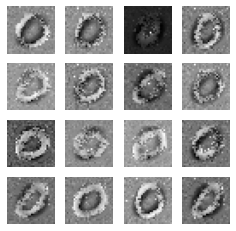

74
gen_loss: tf.Tensor(3.4674058, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06834491, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05993198, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.97509673e-19]
 [1.00000000e+00 3.19847680e-21]
 [1.00000000e+00 3.17739861e-08]
 [1.00000000e+00 2.29477971e-19]
 [1.00000000e+00 4.14371066e-17]
 [1.00000000e+00 2.59978446e-16]
 [1.00000000e+00 3.13276856e-17]
 [1.00000000e+00 1.21533656e-18]
 [1.00000000e+00 5.29495309e-18]
 [1.00000000e+00 2.54458502e-15]
 [1.00000000e+00 5.29274927e-19]
 [1.00000000e+00 1.43811007e-17]
 [9.99999404e-01 5.59193040e-07]
 [1.00000000e+00 5.62785697e-17]
 [1.00000000e+00 2.96843255e-18]
 [1.00000000e+00 2.79218207e-18]
 [1.00000000e+00 1.79639856e-17]
 [1.00000000e+00 1.15683235e-18]
 [1.00000000e+00 3.93079251e-19]
 [1.00000000e+00 5.70996056e-19]
 [9.55446243e-01 4.45537716e-02]
 [1.00000000e+00 1.46850408e-20]
 [1.00000000e+00 1.51561812e-18]
 [1.00000000e+00 4

gen_loss: tf.Tensor(3.5469415, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04515055, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049541235, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.30878950e-19]
 [1.00000000e+00 2.00022854e-20]
 [1.00000000e+00 3.01360714e-08]
 [1.00000000e+00 9.69708356e-20]
 [1.00000000e+00 1.19472095e-17]
 [1.00000000e+00 7.27829471e-17]
 [1.00000000e+00 1.58839738e-17]
 [1.00000000e+00 9.67071226e-19]
 [1.00000000e+00 4.81493439e-18]
 [1.00000000e+00 5.06810147e-16]
 [1.00000000e+00 2.67192056e-19]
 [1.00000000e+00 9.25476056e-18]
 [9.99999642e-01 4.07212980e-07]
 [1.00000000e+00 2.05847370e-17]
 [1.00000000e+00 2.74320533e-18]
 [1.00000000e+00 9.18466197e-19]
 [1.00000000e+00 6.38822405e-18]
 [1.00000000e+00 3.13415193e-19]
 [1.00000000e+00 5.23306302e-19]
 [1.00000000e+00 2.11519556e-19]
 [9.91584778e-01 8.41519702e-03]
 [1.00000000e+00 8.54381542e-20]
 [1.00000000e+00 4.08489911e-19]
 [1.00000000e+00 1.2

gen_loss: tf.Tensor(3.5657558, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10564865, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.050755043, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.07538979e-19]
 [1.00000000e+00 4.76175486e-21]
 [1.00000000e+00 2.25473791e-08]
 [1.00000000e+00 3.77114485e-20]
 [1.00000000e+00 2.81532700e-18]
 [1.00000000e+00 2.19098307e-17]
 [1.00000000e+00 4.81379577e-18]
 [1.00000000e+00 3.06192329e-19]
 [1.00000000e+00 1.67390306e-18]
 [1.00000000e+00 7.30466324e-17]
 [1.00000000e+00 7.84266870e-20]
 [1.00000000e+00 4.75931063e-18]
 [9.99999404e-01 5.76601622e-07]
 [1.00000000e+00 4.09987232e-18]
 [1.00000000e+00 1.00846459e-18]
 [1.00000000e+00 1.97060155e-19]
 [1.00000000e+00 1.88937854e-18]
 [1.00000000e+00 4.87789732e-20]
 [1.00000000e+00 2.06477102e-19]
 [1.00000000e+00 4.19584490e-20]
 [9.92273986e-01 7.72596942e-03]
 [1.00000000e+00 2.81152486e-20]
 [1.00000000e+00 6.96533639e-20]
 [1.00000000e+00 4.0

gen_loss: tf.Tensor(3.4430156, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08653125, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.068825066, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 5.9727869e-20]
 [1.0000000e+00 7.8743177e-22]
 [1.0000000e+00 1.8670022e-08]
 [1.0000000e+00 2.2007216e-20]
 [1.0000000e+00 1.1812249e-18]
 [1.0000000e+00 1.6223477e-17]
 [1.0000000e+00 1.7746362e-18]
 [1.0000000e+00 2.4525375e-19]
 [1.0000000e+00 4.7656305e-19]
 [1.0000000e+00 3.6383195e-17]
 [1.0000000e+00 8.5887804e-20]
 [1.0000000e+00 1.9452163e-18]
 [9.9999917e-01 8.1670873e-07]
 [1.0000000e+00 1.6461673e-18]
 [1.0000000e+00 2.7134070e-19]
 [1.0000000e+00 6.5825844e-20]
 [1.0000000e+00 8.3949159e-19]
 [1.0000000e+00 2.6508631e-20]
 [1.0000000e+00 5.0636656e-20]
 [1.0000000e+00 1.6377848e-20]
 [9.8435932e-01 1.5640669e-02]
 [1.0000000e+00 6.1471426e-21]
 [1.0000000e+00 2.5018052e-20]
 [1.0000000e+00 2.3169006e-20]
 [1.0000000e+00 3.6012702e-18]
 [1.

gen_loss: tf.Tensor(3.4904137, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.049745012, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06339124, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.06766997e-19]
 [1.00000000e+00 2.16808138e-21]
 [1.00000000e+00 3.32503625e-08]
 [1.00000000e+00 7.53488772e-20]
 [1.00000000e+00 3.17171508e-18]
 [1.00000000e+00 5.26235497e-17]
 [1.00000000e+00 3.64870030e-18]
 [1.00000000e+00 2.30010060e-18]
 [1.00000000e+00 9.72149598e-19]
 [1.00000000e+00 1.34301044e-16]
 [1.00000000e+00 7.26425206e-19]
 [1.00000000e+00 2.66607756e-18]
 [9.99998689e-01 1.34468542e-06]
 [1.00000000e+00 4.25865749e-18]
 [1.00000000e+00 5.40938277e-19]
 [1.00000000e+00 1.30931291e-19]
 [1.00000000e+00 2.31266423e-18]
 [1.00000000e+00 1.47638543e-19]
 [1.00000000e+00 1.30855398e-19]
 [1.00000000e+00 5.03896263e-20]
 [9.79122102e-01 2.08778549e-02]
 [1.00000000e+00 1.68766720e-20]
 [1.00000000e+00 7.99722998e-20]
 [1.00000000e+00 6.7

gen_loss: tf.Tensor(3.427934, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044397846, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.065666355, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.89669303e-19]
 [1.00000000e+00 1.92725772e-21]
 [1.00000000e+00 3.36477619e-08]
 [1.00000000e+00 1.63497043e-19]
 [1.00000000e+00 4.88846413e-18]
 [1.00000000e+00 6.53942059e-17]
 [1.00000000e+00 4.67830897e-18]
 [1.00000000e+00 2.49105607e-18]
 [1.00000000e+00 1.62117133e-18]
 [1.00000000e+00 1.31239020e-16]
 [1.00000000e+00 7.22506386e-19]
 [1.00000000e+00 4.12741205e-18]
 [9.99998808e-01 1.19974084e-06]
 [1.00000000e+00 3.09680085e-18]
 [1.00000000e+00 1.03576806e-18]
 [1.00000000e+00 1.74222370e-19]
 [1.00000000e+00 2.95318492e-18]
 [1.00000000e+00 1.89094238e-19]
 [1.00000000e+00 1.78975518e-19]
 [1.00000000e+00 6.01779518e-20]
 [9.83559191e-01 1.64408274e-02]
 [1.00000000e+00 1.89252898e-20]
 [1.00000000e+00 9.35488152e-20]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.4493437, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03656197, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06020937, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.05803183e-19]
 [1.00000000e+00 2.09646846e-21]
 [1.00000000e+00 3.52612091e-08]
 [1.00000000e+00 4.69351844e-19]
 [1.00000000e+00 8.21175281e-18]
 [1.00000000e+00 1.29944794e-16]
 [1.00000000e+00 6.58269132e-18]
 [1.00000000e+00 1.17568204e-18]
 [1.00000000e+00 3.28534178e-18]
 [1.00000000e+00 2.43249016e-16]
 [1.00000000e+00 2.95058220e-19]
 [1.00000000e+00 2.00726377e-17]
 [9.99999642e-01 4.15859205e-07]
 [1.00000000e+00 5.43642331e-18]
 [1.00000000e+00 2.48556007e-18]
 [1.00000000e+00 3.54252919e-19]
 [1.00000000e+00 4.82607775e-18]
 [1.00000000e+00 2.36370737e-19]
 [1.00000000e+00 1.81711457e-19]
 [1.00000000e+00 7.67875382e-20]
 [9.87057149e-01 1.29427733e-02]
 [1.00000000e+00 2.48102953e-20]
 [1.00000000e+00 1.09125440e-19]
 [1.00000000e+00 2.69

gen_loss: tf.Tensor(3.42888, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.1293075, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061170515, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.26180674e-19]
 [1.00000000e+00 1.97990526e-21]
 [1.00000000e+00 5.07067455e-08]
 [1.00000000e+00 1.09913847e-18]
 [1.00000000e+00 1.73520820e-17]
 [1.00000000e+00 3.02455878e-16]
 [1.00000000e+00 1.08027960e-17]
 [1.00000000e+00 1.23111751e-18]
 [1.00000000e+00 5.33976063e-18]
 [1.00000000e+00 6.94796880e-16]
 [1.00000000e+00 3.88584223e-19]
 [1.00000000e+00 4.95326537e-17]
 [9.99999762e-01 2.94272269e-07]
 [1.00000000e+00 1.54510506e-17]
 [1.00000000e+00 4.37385811e-18]
 [1.00000000e+00 7.18712936e-19]
 [1.00000000e+00 1.02041480e-17]
 [1.00000000e+00 4.92368351e-19]
 [1.00000000e+00 2.28457798e-19]
 [1.00000000e+00 1.48776059e-19]
 [9.80969191e-01 1.90308522e-02]
 [1.00000000e+00 2.01234383e-20]
 [1.00000000e+00 2.13369714e-19]
 [1.00000000e+00 6.2160

gen_loss: tf.Tensor(3.4997041, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.056335606, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06201525, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.42918754e-19]
 [1.00000000e+00 2.46902831e-21]
 [9.99999881e-01 8.83019027e-08]
 [1.00000000e+00 2.75841036e-18]
 [1.00000000e+00 5.09873766e-17]
 [1.00000000e+00 6.23475118e-16]
 [1.00000000e+00 2.31720454e-17]
 [1.00000000e+00 2.23084821e-18]
 [1.00000000e+00 1.15299126e-17]
 [1.00000000e+00 1.58796284e-15]
 [1.00000000e+00 8.99777602e-19]
 [1.00000000e+00 6.58382431e-17]
 [9.99999762e-01 2.17491575e-07]
 [1.00000000e+00 4.98766020e-17]
 [1.00000000e+00 1.06437151e-17]
 [1.00000000e+00 1.86889879e-18]
 [1.00000000e+00 3.28576951e-17]
 [1.00000000e+00 1.16611901e-18]
 [1.00000000e+00 5.94619145e-19]
 [1.00000000e+00 4.03416786e-19]
 [9.74566996e-01 2.54329368e-02]
 [1.00000000e+00 1.62221524e-20]
 [1.00000000e+00 6.26781685e-19]
 [1.00000000e+00 1.4

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.17458238e-19]
 [1.00000000e+00 1.82887210e-21]
 [9.99999881e-01 7.13150996e-08]
 [1.00000000e+00 1.46133036e-18]
 [1.00000000e+00 3.20661958e-17]
 [1.00000000e+00 2.70377099e-16]
 [1.00000000e+00 1.50353741e-17]
 [1.00000000e+00 1.58402171e-18]
 [1.00000000e+00 8.33349974e-18]
 [1.00000000e+00 6.13333910e-16]
 [1.00000000e+00 6.13183198e-19]
 [1.00000000e+00 2.53965624e-17]
 [9.99999881e-01 1.61277299e-07]
 [1.00000000e+00 2.35268083e-17]
 [1.00000000e+00 7.70860945e-18]
 [1.00000000e+00 1.09703981e-18]
 [1.00000000e+00 2.16390481e-17]
 [1.00000000e+00 6.12178225e-19]
 [1.00000000e+00 5.23747655e-19]
 [1.00000000e+00 2.55042039e-19]
 [9.84451413e-01 1.55486250e-02]
 [1.00000000e+00 1.08576034e-20]
 [1.00000000e+00 4.00827452e-19]
 [1.00000000e+00 7.29268329e-19]
 [1.00000000e+00 2.48038031e-17]
 [1.00000000e+00 5.64894438e-14]
 [1.00000000e+00 1.12391313e-17]
 [1.00000000e+00 2.38284827e-17]
 [1.00000000e+00 1.03337616e-11]
 [1.0

gen_loss: tf.Tensor(3.3621368, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07414478, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0770928, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.22032718e-19]
 [1.00000000e+00 1.36502573e-21]
 [1.00000000e+00 5.59760807e-08]
 [1.00000000e+00 1.02334577e-18]
 [1.00000000e+00 1.76537333e-17]
 [1.00000000e+00 1.05780671e-16]
 [1.00000000e+00 9.06842076e-18]
 [1.00000000e+00 1.23925015e-18]
 [1.00000000e+00 6.00491393e-18]
 [1.00000000e+00 3.27649655e-16]
 [1.00000000e+00 3.73857487e-19]
 [1.00000000e+00 2.01243133e-17]
 [9.99999881e-01 1.16588971e-07]
 [1.00000000e+00 9.55272839e-18]
 [1.00000000e+00 6.25153494e-18]
 [1.00000000e+00 5.58198952e-19]
 [1.00000000e+00 1.50198397e-17]
 [1.00000000e+00 3.28416217e-19]
 [1.00000000e+00 3.80870660e-19]
 [1.00000000e+00 1.53310275e-19]
 [9.92731273e-01 7.26872776e-03]
 [1.00000000e+00 9.39718939e-21]
 [1.00000000e+00 2.38084707e-19]
 [1.00000000e+00 4.567

gen_loss: tf.Tensor(3.429516, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06816154, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06830972, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.96759585e-19]
 [1.00000000e+00 1.46052005e-21]
 [9.99999881e-01 7.82448737e-08]
 [1.00000000e+00 1.20742541e-18]
 [1.00000000e+00 1.93750796e-17]
 [1.00000000e+00 1.15415359e-16]
 [1.00000000e+00 9.55783127e-18]
 [1.00000000e+00 1.42252111e-18]
 [1.00000000e+00 6.88330240e-18]
 [1.00000000e+00 4.58322646e-16]
 [1.00000000e+00 3.41571800e-19]
 [1.00000000e+00 3.52927395e-17]
 [9.99999881e-01 1.37197716e-07]
 [1.00000000e+00 1.17414533e-17]
 [1.00000000e+00 7.89915381e-18]
 [1.00000000e+00 5.53196215e-19]
 [1.00000000e+00 1.48797765e-17]
 [1.00000000e+00 3.26037012e-19]
 [1.00000000e+00 4.38530009e-19]
 [1.00000000e+00 1.53569570e-19]
 [9.92137372e-01 7.86262937e-03]
 [1.00000000e+00 1.05948855e-20]
 [1.00000000e+00 2.31473725e-19]
 [1.00000000e+00 5.185

gen_loss: tf.Tensor(3.5304918, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.040603407, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05386232, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.12866989e-19]
 [1.00000000e+00 1.35741328e-21]
 [9.99999881e-01 1.38606609e-07]
 [1.00000000e+00 2.56041351e-18]
 [1.00000000e+00 3.52006346e-17]
 [1.00000000e+00 2.33700175e-16]
 [1.00000000e+00 1.58898517e-17]
 [1.00000000e+00 2.24512245e-18]
 [1.00000000e+00 1.11036159e-17]
 [1.00000000e+00 1.20134884e-15]
 [1.00000000e+00 4.64390104e-19]
 [1.00000000e+00 1.09446193e-16]
 [9.99999762e-01 2.03355114e-07]
 [1.00000000e+00 2.66625193e-17]
 [1.00000000e+00 1.45900830e-17]
 [1.00000000e+00 9.08094696e-19]
 [1.00000000e+00 2.36693993e-17]
 [1.00000000e+00 5.39104883e-19]
 [1.00000000e+00 7.26325479e-19]
 [1.00000000e+00 2.48238453e-19]
 [9.86509502e-01 1.34904357e-02]
 [1.00000000e+00 1.00609655e-20]
 [1.00000000e+00 3.91339199e-19]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.6010156, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05127126, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05801768, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.90418842e-19]
 [1.00000000e+00 1.34369886e-21]
 [9.99999762e-01 2.30183559e-07]
 [1.00000000e+00 6.24850663e-18]
 [1.00000000e+00 5.95600481e-17]
 [1.00000000e+00 5.63484168e-16]
 [1.00000000e+00 2.51362321e-17]
 [1.00000000e+00 5.00469624e-18]
 [1.00000000e+00 1.52972777e-17]
 [1.00000000e+00 2.72667317e-15]
 [1.00000000e+00 8.12295497e-19]
 [1.00000000e+00 3.73305102e-16]
 [9.99999762e-01 2.45161658e-07]
 [1.00000000e+00 4.76116525e-17]
 [1.00000000e+00 2.63841796e-17]
 [1.00000000e+00 1.78873899e-18]
 [1.00000000e+00 4.43198972e-17]
 [1.00000000e+00 8.87492005e-19]
 [1.00000000e+00 1.25572490e-18]
 [1.00000000e+00 3.85128055e-19]
 [9.81722414e-01 1.82776302e-02]
 [1.00000000e+00 1.54201136e-20]
 [1.00000000e+00 6.21349125e-19]
 [1.00000000e+00 2.53

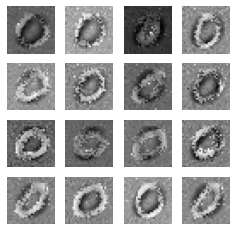

75
gen_loss: tf.Tensor(3.425271, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03473236, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.057585374, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.34921779e-19]
 [1.00000000e+00 1.22879316e-21]
 [9.99999762e-01 2.36415403e-07]
 [1.00000000e+00 8.24257191e-18]
 [1.00000000e+00 6.60137841e-17]
 [1.00000000e+00 8.03918070e-16]
 [1.00000000e+00 2.83824296e-17]
 [1.00000000e+00 6.63702840e-18]
 [1.00000000e+00 1.51042435e-17]
 [1.00000000e+00 2.96574314e-15]
 [1.00000000e+00 1.02949307e-18]
 [1.00000000e+00 4.82093090e-16]
 [9.99999762e-01 1.96140533e-07]
 [1.00000000e+00 4.72907196e-17]
 [1.00000000e+00 2.97229784e-17]
 [1.00000000e+00 2.39258394e-18]
 [1.00000000e+00 5.71471689e-17]
 [1.00000000e+00 1.06403809e-18]
 [1.00000000e+00 1.40094783e-18]
 [1.00000000e+00 4.44402215e-19]
 [9.81694400e-01 1.83056649e-02]
 [1.00000000e+00 1.98104716e-20]
 [1.00000000e+00 6.65137068e-19]
 [1.00000000e+00 3

gen_loss: tf.Tensor(3.4220889, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06308303, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.056291584, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.95815888e-19]
 [1.00000000e+00 5.05002488e-21]
 [9.99999762e-01 2.68281610e-07]
 [1.00000000e+00 4.91256072e-18]
 [1.00000000e+00 4.43050211e-17]
 [1.00000000e+00 6.65158350e-16]
 [1.00000000e+00 2.38438501e-17]
 [1.00000000e+00 1.23446185e-17]
 [1.00000000e+00 1.26975243e-17]
 [1.00000000e+00 1.43093744e-15]
 [1.00000000e+00 1.20093007e-18]
 [1.00000000e+00 2.04630031e-16]
 [9.99999881e-01 1.31360565e-07]
 [1.00000000e+00 3.77526687e-17]
 [1.00000000e+00 2.68940951e-17]
 [1.00000000e+00 2.07262407e-18]
 [1.00000000e+00 4.92932643e-17]
 [1.00000000e+00 9.68459339e-19]
 [1.00000000e+00 2.28016472e-18]
 [1.00000000e+00 3.51603382e-19]
 [9.88468230e-01 1.15317572e-02]
 [1.00000000e+00 8.47858835e-20]
 [1.00000000e+00 4.52937427e-19]
 [1.00000000e+00 1.6

gen_loss: tf.Tensor(3.5468605, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12784229, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048886016, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.65609669e-19]
 [1.00000000e+00 5.36797728e-21]
 [9.99999762e-01 2.70728918e-07]
 [1.00000000e+00 1.33410905e-18]
 [1.00000000e+00 1.20829680e-17]
 [1.00000000e+00 1.77627706e-16]
 [1.00000000e+00 9.89899447e-18]
 [1.00000000e+00 4.68180794e-18]
 [1.00000000e+00 7.12731324e-18]
 [1.00000000e+00 3.42251868e-16]
 [1.00000000e+00 4.24206885e-19]
 [1.00000000e+00 5.84582038e-17]
 [9.99999881e-01 1.41846485e-07]
 [1.00000000e+00 9.59626456e-18]
 [1.00000000e+00 1.29852062e-17]
 [1.00000000e+00 5.97878495e-19]
 [1.00000000e+00 1.86044236e-17]
 [1.00000000e+00 2.94426331e-19]
 [1.00000000e+00 1.34675426e-18]
 [1.00000000e+00 1.26829393e-19]
 [9.89494026e-01 1.05059920e-02]
 [1.00000000e+00 6.67335132e-20]
 [1.00000000e+00 1.52434368e-19]
 [1.00000000e+00 3.8

gen_loss: tf.Tensor(3.481915, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.041562814, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.056250107, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.48284248e-19]
 [1.00000000e+00 3.16541280e-21]
 [9.99999642e-01 3.52028849e-07]
 [1.00000000e+00 5.68826361e-19]
 [1.00000000e+00 5.29107650e-18]
 [1.00000000e+00 5.98367434e-17]
 [1.00000000e+00 5.15553221e-18]
 [1.00000000e+00 1.26427081e-18]
 [1.00000000e+00 4.76996140e-18]
 [1.00000000e+00 1.37783078e-16]
 [1.00000000e+00 1.67764184e-19]
 [1.00000000e+00 2.66175008e-17]
 [9.99999762e-01 2.66230643e-07]
 [1.00000000e+00 4.40722079e-18]
 [1.00000000e+00 7.31118308e-18]
 [1.00000000e+00 2.11015054e-19]
 [1.00000000e+00 9.44208389e-18]
 [1.00000000e+00 1.11541661e-19]
 [1.00000000e+00 8.53027267e-19]
 [1.00000000e+00 6.58961867e-20]
 [9.81862128e-01 1.81378424e-02]
 [1.00000000e+00 2.60701900e-20]
 [1.00000000e+00 7.54328554e-20]
 [1.00000000e+00 1.5

gen_loss: tf.Tensor(3.5195844, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.064300366, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05904217, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.17690130e-19]
 [1.00000000e+00 3.09477671e-21]
 [9.99999404e-01 5.53055770e-07]
 [1.00000000e+00 5.71266234e-19]
 [1.00000000e+00 5.37435788e-18]
 [1.00000000e+00 3.35131696e-17]
 [1.00000000e+00 6.16448245e-18]
 [1.00000000e+00 1.04436174e-18]
 [1.00000000e+00 5.62613718e-18]
 [1.00000000e+00 8.41390451e-17]
 [1.00000000e+00 2.03565414e-19]
 [1.00000000e+00 1.37077881e-17]
 [9.99999523e-01 4.55487850e-07]
 [1.00000000e+00 5.22032485e-18]
 [1.00000000e+00 8.56608142e-18]
 [1.00000000e+00 1.43360624e-19]
 [1.00000000e+00 9.56238986e-18]
 [1.00000000e+00 9.08523938e-20]
 [1.00000000e+00 1.59283812e-18]
 [1.00000000e+00 6.29448192e-20]
 [9.75180149e-01 2.48198584e-02]
 [1.00000000e+00 2.04932704e-20]
 [1.00000000e+00 8.07413969e-20]
 [1.00000000e+00 1.4

gen_loss: tf.Tensor(3.5173914, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.13286075, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.054810647, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.46511406e-19]
 [1.00000000e+00 9.99032333e-22]
 [9.99999523e-01 4.80609572e-07]
 [1.00000000e+00 4.59721032e-19]
 [1.00000000e+00 3.54257179e-18]
 [1.00000000e+00 1.77521264e-17]
 [1.00000000e+00 4.27286349e-18]
 [1.00000000e+00 6.76921962e-19]
 [1.00000000e+00 2.95613795e-18]
 [1.00000000e+00 3.89977542e-17]
 [1.00000000e+00 1.33273505e-19]
 [1.00000000e+00 4.28182145e-18]
 [9.99999523e-01 4.54195231e-07]
 [1.00000000e+00 3.54138271e-18]
 [1.00000000e+00 4.61073575e-18]
 [1.00000000e+00 8.42082724e-20]
 [1.00000000e+00 5.88378367e-18]
 [1.00000000e+00 5.14085674e-20]
 [1.00000000e+00 9.33392671e-19]
 [1.00000000e+00 3.72324463e-20]
 [9.71204638e-01 2.87953392e-02]
 [1.00000000e+00 8.35216866e-21]
 [1.00000000e+00 4.34423819e-20]
 [1.00000000e+00 1.2

gen_loss: tf.Tensor(3.3381724, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.054551177, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.060366582, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.08566150e-19]
 [1.00000000e+00 3.89300257e-22]
 [9.99999642e-01 3.32599484e-07]
 [1.00000000e+00 8.97652058e-19]
 [1.00000000e+00 5.74801190e-18]
 [1.00000000e+00 4.60328658e-17]
 [1.00000000e+00 4.18884469e-18]
 [1.00000000e+00 1.16197163e-18]
 [1.00000000e+00 1.74394013e-18]
 [1.00000000e+00 1.06127458e-16]
 [1.00000000e+00 1.97624008e-19]
 [1.00000000e+00 5.31423756e-18]
 [9.99999642e-01 3.77857702e-07]
 [1.00000000e+00 6.26201284e-18]
 [1.00000000e+00 3.05621854e-18]
 [1.00000000e+00 1.77977408e-19]
 [1.00000000e+00 8.29828749e-18]
 [1.00000000e+00 1.31709759e-19]
 [1.00000000e+00 3.08822272e-19]
 [1.00000000e+00 5.59140619e-20]
 [9.46350396e-01 5.36495969e-02]
 [1.00000000e+00 4.79130960e-21]
 [1.00000000e+00 5.22065835e-20]
 [1.00000000e+00 2.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.23718665e-20]
 [1.00000000e+00 3.47935016e-22]
 [9.99999642e-01 3.47395769e-07]
 [1.00000000e+00 1.10724794e-18]
 [1.00000000e+00 7.38777670e-18]
 [1.00000000e+00 5.23908043e-17]
 [1.00000000e+00 4.79554072e-18]
 [1.00000000e+00 1.51447382e-18]
 [1.00000000e+00 1.85137228e-18]
 [1.00000000e+00 1.19245867e-16]
 [1.00000000e+00 1.94965049e-19]
 [1.00000000e+00 5.46019937e-18]
 [9.99999523e-01 4.91369633e-07]
 [1.00000000e+00 7.61697025e-18]
 [1.00000000e+00 3.37152386e-18]
 [1.00000000e+00 2.16183175e-19]
 [1.00000000e+00 8.28765821e-18]
 [1.00000000e+00 1.65105289e-19]
 [1.00000000e+00 3.16237455e-19]
 [1.00000000e+00 6.40676523e-20]
 [9.32558060e-01 6.74419180e-02]
 [1.00000000e+00 4.11068738e-21]
 [1.00000000e+00 5.94265099e-20]
 [1.00000000e+00 3.46214352e-19]
 [1.00000000e+00 1.89747540e-18]
 [1.00000000e+00 3.80459214e-14]
 [1.00000000e+00 3.96643278e-18]
 [1.00000000e+00 4.94000004e-17]
 [1.00000000e+00 3.17875920e-10]
 [1.0

gen_loss: tf.Tensor(3.2690637, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0434428, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06748909, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.65249319e-19]
 [1.00000000e+00 1.19369816e-21]
 [9.99999404e-01 5.90100854e-07]
 [1.00000000e+00 3.11467849e-18]
 [1.00000000e+00 2.23452883e-17]
 [1.00000000e+00 1.15678059e-16]
 [1.00000000e+00 1.40200182e-17]
 [1.00000000e+00 7.26638960e-18]
 [1.00000000e+00 5.50357011e-18]
 [1.00000000e+00 2.84277360e-16]
 [1.00000000e+00 5.31206601e-19]
 [1.00000000e+00 8.60400517e-18]
 [9.99999166e-01 7.75973888e-07]
 [1.00000000e+00 1.80688638e-17]
 [1.00000000e+00 9.72216890e-18]
 [1.00000000e+00 6.34160291e-19]
 [1.00000000e+00 1.64043217e-17]
 [1.00000000e+00 6.06272931e-19]
 [1.00000000e+00 9.02080266e-19]
 [1.00000000e+00 2.10816324e-19]
 [9.13740039e-01 8.62599760e-02]
 [1.00000000e+00 1.27706605e-20]
 [1.00000000e+00 1.87531823e-19]
 [1.00000000e+00 1.018

gen_loss: tf.Tensor(3.3769894, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.059455097, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.058074385, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.90576865e-19]
 [1.00000000e+00 2.23559010e-21]
 [9.99999642e-01 4.17105952e-07]
 [1.00000000e+00 2.02497474e-18]
 [1.00000000e+00 1.72844981e-17]
 [1.00000000e+00 8.10630978e-17]
 [1.00000000e+00 1.13881975e-17]
 [1.00000000e+00 4.25162935e-18]
 [1.00000000e+00 5.37800822e-18]
 [1.00000000e+00 1.84474035e-16]
 [1.00000000e+00 3.19320125e-19]
 [1.00000000e+00 7.23668058e-18]
 [9.99999762e-01 2.97180236e-07]
 [1.00000000e+00 9.99255356e-18]
 [1.00000000e+00 8.19547969e-18]
 [1.00000000e+00 6.28783721e-19]
 [1.00000000e+00 8.77373767e-18]
 [1.00000000e+00 5.02240390e-19]
 [1.00000000e+00 5.34175455e-19]
 [1.00000000e+00 1.91135009e-19]
 [9.61678505e-01 3.83214876e-02]
 [1.00000000e+00 3.07618130e-20]
 [1.00000000e+00 1.37940639e-19]
 [1.00000000e+00 6.

gen_loss: tf.Tensor(3.4930649, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044040527, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.056863684, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.95319454e-19]
 [1.00000000e+00 4.15245273e-21]
 [9.99999523e-01 5.19601429e-07]
 [1.00000000e+00 1.72055480e-18]
 [1.00000000e+00 2.02734093e-17]
 [1.00000000e+00 7.30998698e-17]
 [1.00000000e+00 1.33191812e-17]
 [1.00000000e+00 3.24141063e-18]
 [1.00000000e+00 6.39858945e-18]
 [1.00000000e+00 1.10711812e-16]
 [1.00000000e+00 2.26223816e-19]
 [1.00000000e+00 5.49283165e-18]
 [9.99999762e-01 2.30382739e-07]
 [1.00000000e+00 1.91277443e-17]
 [1.00000000e+00 9.19079965e-18]
 [1.00000000e+00 6.90420515e-19]
 [1.00000000e+00 6.78646851e-18]
 [1.00000000e+00 4.00910015e-19]
 [1.00000000e+00 9.24092680e-19]
 [1.00000000e+00 1.63129478e-19]
 [9.66039538e-01 3.39605138e-02]
 [1.00000000e+00 4.46578915e-20]
 [1.00000000e+00 1.24595682e-19]
 [1.00000000e+00 6.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.19391091e-19]
 [1.00000000e+00 5.70568749e-21]
 [9.99999166e-01 7.85519944e-07]
 [1.00000000e+00 3.33218088e-18]
 [1.00000000e+00 4.14552880e-17]
 [1.00000000e+00 1.46488154e-16]
 [1.00000000e+00 2.56924978e-17]
 [1.00000000e+00 5.29463007e-18]
 [1.00000000e+00 1.19286293e-17]
 [1.00000000e+00 2.28037601e-16]
 [1.00000000e+00 3.84549649e-19]
 [1.00000000e+00 9.46678846e-18]
 [9.99999762e-01 2.85489790e-07]
 [1.00000000e+00 5.43980738e-17]
 [1.00000000e+00 1.61910795e-17]
 [1.00000000e+00 1.29472626e-18]
 [1.00000000e+00 1.24142257e-17]
 [1.00000000e+00 7.32591993e-19]
 [1.00000000e+00 1.93825375e-18]
 [1.00000000e+00 2.95429882e-19]
 [9.53569710e-01 4.64303493e-02]
 [1.00000000e+00 4.95562031e-20]
 [1.00000000e+00 2.48811069e-19]
 [1.00000000e+00 1.26311389e-18]
 [1.00000000e+00 1.10874470e-17]
 [1.00000000e+00 2.83933558e-14]
 [1.00000000e+00 1.96178307e-17]
 [1.00000000e+00 4.40424839e-17]
 [1.00000000e+00 2.74215698e-12]
 [1.0

gen_loss: tf.Tensor(3.4050229, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0591034, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061519615, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.91300400e-19]
 [1.00000000e+00 1.01265002e-20]
 [9.99999285e-01 6.89353158e-07]
 [1.00000000e+00 2.04956372e-18]
 [1.00000000e+00 2.89528236e-17]
 [1.00000000e+00 1.22667470e-16]
 [1.00000000e+00 2.09038748e-17]
 [1.00000000e+00 5.48721923e-18]
 [1.00000000e+00 1.05078805e-17]
 [1.00000000e+00 1.70675035e-16]
 [1.00000000e+00 2.93161029e-19]
 [1.00000000e+00 6.60137526e-18]
 [9.99999881e-01 1.76625790e-07]
 [1.00000000e+00 4.55088899e-17]
 [1.00000000e+00 1.23384982e-17]
 [1.00000000e+00 9.45451310e-19]
 [1.00000000e+00 8.45621281e-18]
 [1.00000000e+00 4.87025798e-19]
 [1.00000000e+00 1.78038612e-18]
 [1.00000000e+00 2.10306276e-19]
 [9.78563249e-01 2.14367509e-02]
 [1.00000000e+00 8.04008440e-20]
 [1.00000000e+00 1.71250634e-19]
 [1.00000000e+00 7.77

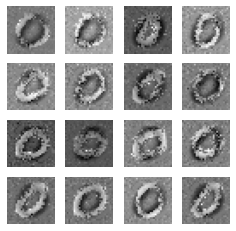

76
gen_loss: tf.Tensor(3.4564235, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.052110687, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.056212176, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.64244672e-19]
 [1.00000000e+00 5.30827285e-21]
 [9.99999523e-01 4.46535694e-07]
 [1.00000000e+00 8.59173374e-19]
 [1.00000000e+00 1.11721479e-17]
 [1.00000000e+00 5.63533336e-17]
 [1.00000000e+00 9.43164404e-18]
 [1.00000000e+00 2.39364294e-18]
 [1.00000000e+00 5.33725552e-18]
 [1.00000000e+00 7.87097425e-17]
 [1.00000000e+00 1.18017490e-19]
 [1.00000000e+00 3.83417570e-18]
 [9.99999881e-01 1.28519929e-07]
 [1.00000000e+00 1.43631178e-17]
 [1.00000000e+00 5.64460316e-18]
 [1.00000000e+00 4.05731780e-19]
 [1.00000000e+00 3.62235046e-18]
 [1.00000000e+00 1.80071235e-19]
 [1.00000000e+00 6.78286758e-19]
 [1.00000000e+00 8.72410073e-20]
 [9.86155093e-01 1.38449119e-02]
 [1.00000000e+00 4.92272340e-20]
 [1.00000000e+00 6.49017929e-20]
 [1.00000000e+00

gen_loss: tf.Tensor(3.3503084, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07486214, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06481841, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.34796561e-20]
 [1.00000000e+00 1.51440796e-21]
 [9.99999642e-01 3.52411121e-07]
 [1.00000000e+00 3.76950703e-19]
 [1.00000000e+00 4.46342647e-18]
 [1.00000000e+00 2.60267069e-17]
 [1.00000000e+00 4.29597368e-18]
 [1.00000000e+00 1.53590751e-18]
 [1.00000000e+00 2.57744516e-18]
 [1.00000000e+00 4.34497429e-17]
 [1.00000000e+00 7.61731110e-20]
 [1.00000000e+00 1.80927189e-18]
 [9.99999762e-01 2.08075122e-07]
 [1.00000000e+00 3.15377456e-18]
 [1.00000000e+00 2.35743207e-18]
 [1.00000000e+00 1.52573412e-19]
 [1.00000000e+00 1.70799913e-18]
 [1.00000000e+00 7.30702079e-20]
 [1.00000000e+00 2.71656582e-19]
 [1.00000000e+00 3.81465196e-20]
 [9.84578311e-01 1.54217584e-02]
 [1.00000000e+00 1.40505674e-20]
 [1.00000000e+00 2.96618825e-20]
 [1.00000000e+00 1.45

gen_loss: tf.Tensor(3.464041, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09318934, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051191896, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 1.7293317e-19]
 [1.0000000e+00 2.1604859e-21]
 [9.9999928e-01 6.6989156e-07]
 [1.0000000e+00 1.0667286e-18]
 [1.0000000e+00 1.6594272e-17]
 [1.0000000e+00 9.5002210e-17]
 [1.0000000e+00 1.1198560e-17]
 [1.0000000e+00 7.3014000e-18]
 [1.0000000e+00 4.7139042e-18]
 [1.0000000e+00 1.9368070e-16]
 [1.0000000e+00 4.5247457e-19]
 [1.0000000e+00 3.1076406e-18]
 [9.9999940e-01 6.3059719e-07]
 [1.0000000e+00 9.7012371e-18]
 [1.0000000e+00 4.9949880e-18]
 [1.0000000e+00 4.1206925e-19]
 [1.0000000e+00 4.6716746e-18]
 [1.0000000e+00 3.3642121e-19]
 [1.0000000e+00 7.7607708e-19]
 [1.0000000e+00 1.2185252e-19]
 [9.5456898e-01 4.5431014e-02]
 [1.0000000e+00 1.5471257e-20]
 [1.0000000e+00 1.1696826e-19]
 [1.0000000e+00 4.3673032e-19]
 [1.0000000e+00 5.3821334e-18]
 [1.0

gen_loss: tf.Tensor(3.3857503, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06953117, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.062880106, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.07866443e-19]
 [1.00000000e+00 4.73718744e-21]
 [9.99999523e-01 5.03422882e-07]
 [1.00000000e+00 1.37545567e-18]
 [1.00000000e+00 2.32353347e-17]
 [1.00000000e+00 1.30949970e-16]
 [1.00000000e+00 1.23794204e-17]
 [1.00000000e+00 7.03979091e-18]
 [1.00000000e+00 5.28857428e-18]
 [1.00000000e+00 1.66234901e-16]
 [1.00000000e+00 4.28074135e-19]
 [1.00000000e+00 5.44563851e-18]
 [9.99999523e-01 4.52990037e-07]
 [1.00000000e+00 8.63695508e-18]
 [1.00000000e+00 7.03809933e-18]
 [1.00000000e+00 6.64665265e-19]
 [1.00000000e+00 4.17001558e-18]
 [1.00000000e+00 4.47988509e-19]
 [1.00000000e+00 9.69161512e-19]
 [1.00000000e+00 1.29528380e-19]
 [9.70459819e-01 2.95401514e-02]
 [1.00000000e+00 4.67320275e-20]
 [1.00000000e+00 1.29430579e-19]
 [1.00000000e+00 5.0

gen_loss: tf.Tensor(3.435065, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036752485, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.058793742, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.42877272e-19]
 [1.00000000e+00 1.56815980e-20]
 [9.99999523e-01 4.65972931e-07]
 [1.00000000e+00 2.49266245e-18]
 [1.00000000e+00 3.20248798e-17]
 [1.00000000e+00 2.07092700e-16]
 [1.00000000e+00 1.94933267e-17]
 [1.00000000e+00 7.17015458e-18]
 [1.00000000e+00 1.18387355e-17]
 [1.00000000e+00 1.75754598e-16]
 [1.00000000e+00 3.76206576e-19]
 [1.00000000e+00 1.95103617e-17]
 [9.99999762e-01 2.80434477e-07]
 [1.00000000e+00 7.89346116e-18]
 [1.00000000e+00 1.74384794e-17]
 [1.00000000e+00 1.33703344e-18]
 [1.00000000e+00 4.40322137e-18]
 [1.00000000e+00 6.92229611e-19]
 [1.00000000e+00 1.53253634e-18]
 [1.00000000e+00 1.88218396e-19]
 [9.87148941e-01 1.28510501e-02]
 [1.00000000e+00 1.93793477e-19]
 [1.00000000e+00 1.72581929e-19]
 [1.00000000e+00 7.8

gen_loss: tf.Tensor(3.4814978, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0689727, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.055359982, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.87129180e-19]
 [1.00000000e+00 2.68682125e-20]
 [9.99998808e-01 1.18432934e-06]
 [1.00000000e+00 5.89940333e-18]
 [1.00000000e+00 7.52765989e-17]
 [1.00000000e+00 5.18439062e-16]
 [1.00000000e+00 4.40552556e-17]
 [1.00000000e+00 1.38109789e-17]
 [1.00000000e+00 3.18608664e-17]
 [1.00000000e+00 4.10845602e-16]
 [1.00000000e+00 6.07530090e-19]
 [1.00000000e+00 5.44555827e-17]
 [9.99999404e-01 6.15227407e-07]
 [1.00000000e+00 2.11024114e-17]
 [1.00000000e+00 4.77260317e-17]
 [1.00000000e+00 3.40997825e-18]
 [1.00000000e+00 8.20849538e-18]
 [1.00000000e+00 1.70657928e-18]
 [1.00000000e+00 3.87298412e-18]
 [1.00000000e+00 4.12382183e-19]
 [9.70710099e-01 2.92898994e-02]
 [1.00000000e+00 1.88495036e-19]
 [1.00000000e+00 4.06521893e-19]
 [1.00000000e+00 1.86

gen_loss: tf.Tensor(3.5127296, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06720117, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06070991, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.92276569e-19]
 [1.00000000e+00 8.63931423e-21]
 [9.99999166e-01 8.01744363e-07]
 [1.00000000e+00 3.40459723e-18]
 [1.00000000e+00 3.61057058e-17]
 [1.00000000e+00 2.72589178e-16]
 [1.00000000e+00 2.46826096e-17]
 [1.00000000e+00 3.60195715e-18]
 [1.00000000e+00 2.06668793e-17]
 [1.00000000e+00 1.77795816e-16]
 [1.00000000e+00 1.96351804e-19]
 [1.00000000e+00 4.36734125e-17]
 [9.99999404e-01 5.68811060e-07]
 [1.00000000e+00 6.11961411e-18]
 [1.00000000e+00 2.76152808e-17]
 [1.00000000e+00 2.27609768e-18]
 [1.00000000e+00 4.41506246e-18]
 [1.00000000e+00 5.94707602e-19]
 [1.00000000e+00 1.20432493e-18]
 [1.00000000e+00 1.81453777e-19]
 [9.72061396e-01 2.79385839e-02]
 [1.00000000e+00 6.35763458e-20]
 [1.00000000e+00 1.82245286e-19]
 [1.00000000e+00 1.08

gen_loss: tf.Tensor(3.4111948, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05721471, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06758589, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.16488240e-19]
 [1.00000000e+00 1.18490182e-20]
 [9.99999642e-01 3.74551234e-07]
 [1.00000000e+00 1.18766799e-18]
 [1.00000000e+00 1.09303026e-17]
 [1.00000000e+00 1.08091906e-16]
 [1.00000000e+00 7.93769712e-18]
 [1.00000000e+00 2.19591865e-18]
 [1.00000000e+00 6.87920703e-18]
 [1.00000000e+00 6.87684940e-17]
 [1.00000000e+00 8.51440334e-20]
 [1.00000000e+00 1.47490638e-17]
 [9.99999642e-01 3.98659068e-07]
 [1.00000000e+00 2.03380014e-18]
 [1.00000000e+00 8.49047546e-18]
 [1.00000000e+00 1.01234975e-18]
 [1.00000000e+00 1.89821386e-18]
 [1.00000000e+00 1.73586837e-19]
 [1.00000000e+00 3.65938964e-19]
 [1.00000000e+00 4.69887249e-20]
 [9.87960339e-01 1.20396484e-02]
 [1.00000000e+00 1.07177359e-19]
 [1.00000000e+00 4.57488491e-20]
 [1.00000000e+00 3.51

 [1.00000000e+00 1.04657166e-17]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.7170858, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05129639, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048201684, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.35685473e-19]
 [1.00000000e+00 1.18982079e-20]
 [9.99999285e-01 7.66004518e-07]
 [1.00000000e+00 7.22402058e-18]
 [1.00000000e+00 7.98102898e-17]
 [1.00000000e+00 6.96322545e-16]
 [1.00000000e+00 3.55718501e-17]
 [1.00000000e+00 1.80681061e-17]
 [1.00000000e+00 2.04250911e-17]
 [1.00000000e+00 4.21645563e-16]
 [1.00000000e+00 1.07883356e-18]
 [1.00000000e+00 2.32688619e-17]
 [9.99998331e-01 1.66157486e-06]
 [1.00000000e+00 1.02105736e-17]
 [1.00000000e+00 2.50008210e-17]
 [1.00000000e+00 4.61293481e-18]
 [1.00000000e+00 9.05483515e-18]
 [1.00000000e+00 1.38392921e-18]
 [1.00000000e+00 1.70111957e-18]
 [1.00000000e+00 2.79366164e-19]
 [9.69267726e-01 3.07322256e-02]
 [1.00000000e+00 9.0

gen_loss: tf.Tensor(3.461914, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05212283, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06232789, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.91279646e-19]
 [1.00000000e+00 5.47917854e-21]
 [9.99998927e-01 1.08806182e-06]
 [1.00000000e+00 1.66803320e-17]
 [1.00000000e+00 1.80968099e-16]
 [1.00000000e+00 1.42945344e-15]
 [1.00000000e+00 7.16720502e-17]
 [1.00000000e+00 2.83184058e-17]
 [1.00000000e+00 3.68275202e-17]
 [1.00000000e+00 8.28886802e-16]
 [1.00000000e+00 2.49819319e-18]
 [1.00000000e+00 3.60364940e-17]
 [9.99996543e-01 3.48941489e-06]
 [1.00000000e+00 1.38454781e-17]
 [1.00000000e+00 4.50456621e-17]
 [1.00000000e+00 7.74914875e-18]
 [1.00000000e+00 1.65043112e-17]
 [1.00000000e+00 2.88143114e-18]
 [1.00000000e+00 3.22199401e-18]
 [1.00000000e+00 6.17909966e-19]
 [9.53286111e-01 4.67138477e-02]
 [1.00000000e+00 4.10406178e-20]
 [1.00000000e+00 9.23599370e-19]
 [1.00000000e+00 6.345

gen_loss: tf.Tensor(3.5361876, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.053533833, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.060591284, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.57771748e-19]
 [1.00000000e+00 3.97917213e-21]
 [9.99998927e-01 1.11256713e-06]
 [1.00000000e+00 2.30006668e-17]
 [1.00000000e+00 2.08711367e-16]
 [1.00000000e+00 1.77534982e-15]
 [1.00000000e+00 9.76048572e-17]
 [1.00000000e+00 2.45850684e-17]
 [1.00000000e+00 5.25850230e-17]
 [1.00000000e+00 9.36461204e-16]
 [1.00000000e+00 2.69603349e-18]
 [1.00000000e+00 4.66293523e-17]
 [9.99996543e-01 3.42504472e-06]
 [1.00000000e+00 1.24087341e-17]
 [1.00000000e+00 6.04257886e-17]
 [1.00000000e+00 8.83728995e-18]
 [1.00000000e+00 1.98208572e-17]
 [1.00000000e+00 3.32553945e-18]
 [1.00000000e+00 3.79200769e-18]
 [1.00000000e+00 7.76506494e-19]
 [9.60552752e-01 3.94472927e-02]
 [1.00000000e+00 3.17168770e-20]
 [1.00000000e+00 1.22318764e-18]
 [1.00000000e+00 9.

gen_loss: tf.Tensor(3.439073, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.055109452, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.055909194, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.52947767e-19]
 [1.00000000e+00 1.06776561e-20]
 [9.99999285e-01 7.39087113e-07]
 [1.00000000e+00 1.15784399e-17]
 [1.00000000e+00 8.21147488e-17]
 [1.00000000e+00 1.21428187e-15]
 [1.00000000e+00 6.32880122e-17]
 [1.00000000e+00 9.77546001e-18]
 [1.00000000e+00 4.75519367e-17]
 [1.00000000e+00 5.38639051e-16]
 [1.00000000e+00 8.19907162e-19]
 [1.00000000e+00 4.51902334e-17]
 [9.99999046e-01 9.87761496e-07]
 [1.00000000e+00 7.60013630e-18]
 [1.00000000e+00 4.93988688e-17]
 [1.00000000e+00 5.90068628e-18]
 [1.00000000e+00 1.26950535e-17]
 [1.00000000e+00 1.58932394e-18]
 [1.00000000e+00 2.25623231e-18]
 [1.00000000e+00 3.56851636e-19]
 [9.87803042e-01 1.21969944e-02]
 [1.00000000e+00 9.29185941e-20]
 [1.00000000e+00 5.26897817e-19]
 [1.00000000e+00 3.9

gen_loss: tf.Tensor(3.6716385, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06276619, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05110086, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.99978196e-19]
 [1.00000000e+00 3.11188448e-20]
 [9.99999166e-01 8.42606539e-07]
 [1.00000000e+00 6.25427787e-18]
 [1.00000000e+00 5.40526300e-17]
 [1.00000000e+00 1.10567530e-15]
 [1.00000000e+00 5.12740939e-17]
 [1.00000000e+00 7.98053763e-18]
 [1.00000000e+00 4.23447421e-17]
 [1.00000000e+00 4.75350920e-16]
 [1.00000000e+00 4.56423683e-19]
 [1.00000000e+00 3.52009026e-17]
 [9.99999046e-01 9.10445976e-07]
 [1.00000000e+00 1.21369250e-17]
 [1.00000000e+00 3.97202204e-17]
 [1.00000000e+00 5.42142942e-18]
 [1.00000000e+00 1.14247473e-17]
 [1.00000000e+00 1.18686635e-18]
 [1.00000000e+00 1.73162992e-18]
 [1.00000000e+00 2.13445427e-19]
 [9.81935143e-01 1.80648621e-02]
 [1.00000000e+00 1.95317893e-19]
 [1.00000000e+00 3.50326137e-19]
 [1.00000000e+00 1.92

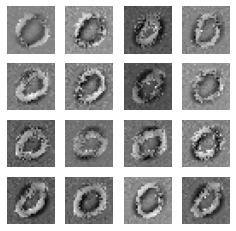

77
gen_loss: tf.Tensor(3.5894344, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.059422184, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04776234, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.91396414e-19]
 [1.00000000e+00 3.98216541e-20]
 [9.99998927e-01 1.07251367e-06]
 [1.00000000e+00 5.33385663e-18]
 [1.00000000e+00 5.87564455e-17]
 [1.00000000e+00 1.12160577e-15]
 [1.00000000e+00 5.43250768e-17]
 [1.00000000e+00 1.15024121e-17]
 [1.00000000e+00 4.12788669e-17]
 [1.00000000e+00 4.92555112e-16]
 [1.00000000e+00 5.69655920e-19]
 [1.00000000e+00 2.47470966e-17]
 [9.99998450e-01 1.50261758e-06]
 [1.00000000e+00 1.72244034e-17]
 [1.00000000e+00 3.74823196e-17]
 [1.00000000e+00 5.80727691e-18]
 [1.00000000e+00 1.23823958e-17]
 [1.00000000e+00 1.26578124e-18]
 [1.00000000e+00 1.93522461e-18]
 [1.00000000e+00 2.06356618e-19]
 [9.69049513e-01 3.09504475e-02]
 [1.00000000e+00 1.95789347e-19]
 [1.00000000e+00 3.77465830e-19]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.6506758, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.14329006, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04835131, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.29098372e-19]
 [1.00000000e+00 1.25521596e-20]
 [9.99999285e-01 7.38217125e-07]
 [1.00000000e+00 2.30612764e-18]
 [1.00000000e+00 3.42697156e-17]
 [1.00000000e+00 5.35788467e-16]
 [1.00000000e+00 3.68815086e-17]
 [1.00000000e+00 4.95534168e-18]
 [1.00000000e+00 2.21331148e-17]
 [1.00000000e+00 1.48686072e-16]
 [1.00000000e+00 2.96402931e-19]
 [1.00000000e+00 1.35055177e-17]
 [9.99998093e-01 1.94337417e-06]
 [1.00000000e+00 6.54648066e-18]
 [1.00000000e+00 2.16068791e-17]
 [1.00000000e+00 4.06726858e-18]
 [1.00000000e+00 8.33833295e-18]
 [1.00000000e+00 3.87042694e-19]
 [1.00000000e+00 1.08456096e-18]
 [1.00000000e+00 7.99189273e-20]
 [9.75039840e-01 2.49602068e-02]
 [1.00000000e+00 9.69212758e-20]
 [1.00000000e+00 1.70069045e-19]
 [1.00000000e+00 7.07

gen_loss: tf.Tensor(3.5417495, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06592621, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05257012, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.09264326e-19]
 [1.00000000e+00 8.69864102e-21]
 [9.99999046e-01 8.98484075e-07]
 [1.00000000e+00 3.30251860e-18]
 [1.00000000e+00 3.72953338e-17]
 [1.00000000e+00 9.02511911e-16]
 [1.00000000e+00 4.67699102e-17]
 [1.00000000e+00 6.13597698e-18]
 [1.00000000e+00 2.62965614e-17]
 [1.00000000e+00 3.65868364e-16]
 [1.00000000e+00 3.71962649e-19]
 [1.00000000e+00 3.38287555e-17]
 [9.99997973e-01 2.01103808e-06]
 [1.00000000e+00 6.39119777e-18]
 [1.00000000e+00 3.00632507e-17]
 [1.00000000e+00 7.31852183e-18]
 [1.00000000e+00 1.40437831e-17]
 [1.00000000e+00 3.92035479e-19]
 [1.00000000e+00 1.05083164e-18]
 [1.00000000e+00 8.80131675e-20]
 [9.85034525e-01 1.49654699e-02]
 [1.00000000e+00 1.10209784e-19]
 [1.00000000e+00 2.01651744e-19]
 [1.00000000e+00 1.01

gen_loss: tf.Tensor(3.413536, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.039391205, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06985617, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.12126836e-19]
 [1.00000000e+00 1.75159227e-20]
 [9.99996305e-01 3.66941254e-06]
 [1.00000000e+00 1.45587262e-17]
 [1.00000000e+00 1.03906174e-16]
 [1.00000000e+00 2.96116493e-15]
 [1.00000000e+00 1.79633096e-16]
 [1.00000000e+00 2.55586732e-17]
 [1.00000000e+00 1.13590043e-16]
 [1.00000000e+00 1.58897473e-15]
 [1.00000000e+00 1.32686646e-18]
 [1.00000000e+00 1.22289495e-16]
 [9.99995470e-01 4.56810858e-06]
 [1.00000000e+00 2.30283211e-17]
 [1.00000000e+00 1.46167751e-16]
 [1.00000000e+00 2.03820479e-17]
 [1.00000000e+00 4.86643722e-17]
 [1.00000000e+00 1.32614795e-18]
 [1.00000000e+00 8.75598306e-18]
 [1.00000000e+00 2.72389180e-19]
 [9.82429147e-01 1.75708141e-02]
 [1.00000000e+00 1.96043447e-19]
 [1.00000000e+00 8.18248044e-19]
 [1.00000000e+00 4.83

gen_loss: tf.Tensor(3.4022832, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043913394, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08063449, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.75621501e-19]
 [1.00000000e+00 1.13998284e-20]
 [9.99995708e-01 4.29875990e-06]
 [1.00000000e+00 2.03351402e-17]
 [1.00000000e+00 1.07034928e-16]
 [1.00000000e+00 3.03326077e-15]
 [1.00000000e+00 2.29859437e-16]
 [1.00000000e+00 1.49373880e-17]
 [1.00000000e+00 1.60510599e-16]
 [1.00000000e+00 1.39392400e-15]
 [1.00000000e+00 9.15175156e-19]
 [1.00000000e+00 2.06632642e-16]
 [9.99995232e-01 4.71762587e-06]
 [1.00000000e+00 1.77950439e-17]
 [1.00000000e+00 2.19284879e-16]
 [1.00000000e+00 2.28085326e-17]
 [1.00000000e+00 5.61021619e-17]
 [1.00000000e+00 1.01818634e-18]
 [1.00000000e+00 1.23352978e-17]
 [1.00000000e+00 2.50412645e-19]
 [9.84508276e-01 1.54917017e-02]
 [1.00000000e+00 1.53627576e-19]
 [1.00000000e+00 8.23022014e-19]
 [1.00000000e+00 6.9

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.72838724e-20]
 [1.00000000e+00 2.61658251e-21]
 [9.99997616e-01 2.32898947e-06]
 [1.00000000e+00 5.06297566e-18]
 [1.00000000e+00 2.22706568e-17]
 [1.00000000e+00 7.71988793e-16]
 [1.00000000e+00 5.91967239e-17]
 [1.00000000e+00 2.26155750e-18]
 [1.00000000e+00 4.47739531e-17]
 [1.00000000e+00 3.57854109e-16]
 [1.00000000e+00 1.96190090e-19]
 [1.00000000e+00 7.17817674e-17]
 [9.99996066e-01 3.95360848e-06]
 [1.00000000e+00 2.57399644e-18]
 [1.00000000e+00 5.34469485e-17]
 [1.00000000e+00 4.84271235e-18]
 [1.00000000e+00 1.53268924e-17]
 [1.00000000e+00 2.13373785e-19]
 [1.00000000e+00 2.11090847e-18]
 [1.00000000e+00 5.79737739e-20]
 [9.85177279e-01 1.48227122e-02]
 [1.00000000e+00 4.02611002e-20]
 [1.00000000e+00 1.74359333e-19]
 [1.00000000e+00 1.74290264e-18]
 [1.00000000e+00 8.95419291e-18]
 [1.00000000e+00 1.16194801e-13]
 [1.00000000e+00 3.84842074e-17]
 [1.00000000e+00 3.73719539e-17]
 [1.00000000e+00 1.25290694e-10]
 [1.0

gen_loss: tf.Tensor(3.2666893, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.18653722, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06825366, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.31545499e-20]
 [1.00000000e+00 5.92593827e-22]
 [9.99998689e-01 1.30323303e-06]
 [1.00000000e+00 1.82824622e-19]
 [1.00000000e+00 1.31136293e-18]
 [1.00000000e+00 6.10339119e-17]
 [1.00000000e+00 4.30054840e-18]
 [1.00000000e+00 2.78506413e-19]
 [1.00000000e+00 2.68847472e-18]
 [1.00000000e+00 4.43368080e-17]
 [1.00000000e+00 3.69080493e-20]
 [1.00000000e+00 2.68619873e-18]
 [9.99994159e-01 5.88853391e-06]
 [1.00000000e+00 4.83597186e-19]
 [1.00000000e+00 2.28317648e-18]
 [1.00000000e+00 1.72000266e-19]
 [1.00000000e+00 1.65533585e-18]
 [1.00000000e+00 2.05225287e-20]
 [1.00000000e+00 1.87067400e-19]
 [1.00000000e+00 4.32782795e-21]
 [9.62738454e-01 3.72615568e-02]
 [1.00000000e+00 3.66581285e-21]
 [1.00000000e+00 1.21335271e-20]
 [1.00000000e+00 6.12

gen_loss: tf.Tensor(3.2937298, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.045269087, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.090276815, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.33129630e-20]
 [1.00000000e+00 1.30528212e-21]
 [9.99998808e-01 1.18246385e-06]
 [1.00000000e+00 3.31850289e-20]
 [1.00000000e+00 4.35087438e-19]
 [1.00000000e+00 2.16252673e-17]
 [1.00000000e+00 2.00999822e-18]
 [1.00000000e+00 2.48236566e-19]
 [1.00000000e+00 7.58235212e-19]
 [1.00000000e+00 2.06896764e-17]
 [1.00000000e+00 3.20418168e-20]
 [1.00000000e+00 2.44723866e-19]
 [9.99991298e-01 8.73297631e-06]
 [1.00000000e+00 1.01144657e-18]
 [1.00000000e+00 4.24443200e-19]
 [1.00000000e+00 3.98912891e-20]
 [1.00000000e+00 9.51196079e-19]
 [1.00000000e+00 8.06203991e-21]
 [1.00000000e+00 1.38886287e-19]
 [1.00000000e+00 1.27425760e-21]
 [9.28137720e-01 7.18623027e-02]
 [1.00000000e+00 3.79327540e-21]
 [1.00000000e+00 4.19981407e-21]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.2796404, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.037668522, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.08303937, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.45069540e-21]
 [1.00000000e+00 2.30051707e-22]
 [9.99999404e-01 5.85821965e-07]
 [1.00000000e+00 3.18915802e-20]
 [1.00000000e+00 2.84042785e-19]
 [1.00000000e+00 9.43585439e-18]
 [1.00000000e+00 2.32893632e-18]
 [1.00000000e+00 4.33784628e-20]
 [1.00000000e+00 6.60913225e-19]
 [1.00000000e+00 8.56088755e-18]
 [1.00000000e+00 1.16966416e-20]
 [1.00000000e+00 2.28681008e-19]
 [9.99991655e-01 8.33149534e-06]
 [1.00000000e+00 2.99196397e-19]
 [1.00000000e+00 2.97586859e-19]
 [1.00000000e+00 1.80383955e-20]
 [1.00000000e+00 6.06904690e-19]
 [1.00000000e+00 3.05713494e-21]
 [1.00000000e+00 7.08447754e-20]
 [1.00000000e+00 6.71222786e-22]
 [9.31788862e-01 6.82111382e-02]
 [1.00000000e+00 1.45446534e-21]
 [1.00000000e+00 2.63282259e-21]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.3805604, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10951373, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.089274816, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.06257924e-21]
 [1.00000000e+00 1.45111721e-22]
 [9.99999166e-01 8.41248777e-07]
 [1.00000000e+00 6.10482557e-20]
 [1.00000000e+00 3.20600471e-19]
 [1.00000000e+00 1.01504946e-17]
 [1.00000000e+00 3.35566474e-18]
 [1.00000000e+00 9.33559529e-20]
 [1.00000000e+00 8.81714873e-19]
 [1.00000000e+00 9.71423541e-18]
 [1.00000000e+00 2.13260571e-20]
 [1.00000000e+00 2.29047682e-19]
 [9.99974728e-01 2.52258033e-05]
 [1.00000000e+00 1.95291811e-19]
 [1.00000000e+00 4.12441947e-19]
 [1.00000000e+00 1.29261277e-20]
 [1.00000000e+00 6.76813498e-19]
 [1.00000000e+00 4.35379205e-21]
 [1.00000000e+00 1.15946940e-19]
 [1.00000000e+00 7.10796644e-22]
 [8.66748810e-01 1.33251220e-01]
 [1.00000000e+00 1.31493758e-21]
 [1.00000000e+00 3.38554099e-21]
 [1.00000000e+00 1.9

gen_loss: tf.Tensor(3.564527, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.2236948, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061033383, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.47779260e-21]
 [1.00000000e+00 1.15348983e-22]
 [9.99999642e-01 3.08227044e-07]
 [1.00000000e+00 1.59230200e-20]
 [1.00000000e+00 3.59622846e-20]
 [1.00000000e+00 2.73697562e-18]
 [1.00000000e+00 8.50496146e-19]
 [1.00000000e+00 2.88466152e-20]
 [1.00000000e+00 2.67738926e-19]
 [1.00000000e+00 7.25826896e-19]
 [1.00000000e+00 4.80305815e-21]
 [1.00000000e+00 6.43414749e-20]
 [9.99992371e-01 7.68394420e-06]
 [1.00000000e+00 1.61521296e-20]
 [1.00000000e+00 1.41497593e-19]
 [1.00000000e+00 3.23754998e-21]
 [1.00000000e+00 1.90048080e-19]
 [1.00000000e+00 8.78259318e-22]
 [1.00000000e+00 2.09322497e-20]
 [1.00000000e+00 1.04270757e-22]
 [9.53439295e-01 4.65607159e-02]
 [1.00000000e+00 2.56434876e-21]
 [1.00000000e+00 3.23147770e-22]
 [1.00000000e+00 3.720

gen_loss: tf.Tensor(3.5435586, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.068938226, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.09491038, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.02609511e-22]
 [1.00000000e+00 6.72180741e-23]
 [9.99999881e-01 1.75110273e-07]
 [1.00000000e+00 6.83415572e-21]
 [1.00000000e+00 7.96534863e-21]
 [1.00000000e+00 1.62012660e-18]
 [1.00000000e+00 3.09390623e-19]
 [1.00000000e+00 1.01323736e-20]
 [1.00000000e+00 1.05150075e-19]
 [1.00000000e+00 8.81589968e-20]
 [1.00000000e+00 1.72960053e-21]
 [1.00000000e+00 3.49606400e-20]
 [9.99996781e-01 3.25260794e-06]
 [1.00000000e+00 3.16437459e-21]
 [1.00000000e+00 7.93538789e-20]
 [1.00000000e+00 1.85653923e-21]
 [1.00000000e+00 1.54464373e-19]
 [1.00000000e+00 2.65091091e-22]
 [1.00000000e+00 4.66673410e-21]
 [1.00000000e+00 2.56328992e-23]
 [9.72430468e-01 2.75695883e-02]
 [1.00000000e+00 2.81062280e-21]
 [1.00000000e+00 5.48896360e-23]
 [1.00000000e+00 1.3

gen_loss: tf.Tensor(3.6828275, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.12484224, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07771243, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.36807704e-22]
 [1.00000000e+00 2.13481740e-22]
 [9.99999881e-01 1.33061192e-07]
 [1.00000000e+00 5.18874969e-21]
 [1.00000000e+00 4.19523469e-21]
 [1.00000000e+00 2.24790757e-18]
 [1.00000000e+00 1.07165093e-19]
 [1.00000000e+00 8.25309924e-21]
 [1.00000000e+00 5.72725704e-20]
 [1.00000000e+00 2.24983666e-19]
 [1.00000000e+00 1.09035027e-21]
 [1.00000000e+00 6.50544788e-20]
 [9.99998093e-01 1.94082918e-06]
 [1.00000000e+00 3.26372673e-21]
 [1.00000000e+00 5.96377124e-20]
 [1.00000000e+00 1.63473174e-21]
 [1.00000000e+00 2.00589929e-19]
 [1.00000000e+00 3.09521176e-22]
 [1.00000000e+00 1.86700056e-21]
 [1.00000000e+00 1.66549126e-23]
 [9.86099362e-01 1.39006870e-02]
 [1.00000000e+00 4.39792706e-21]
 [1.00000000e+00 3.43232528e-23]
 [1.00000000e+00 7.37

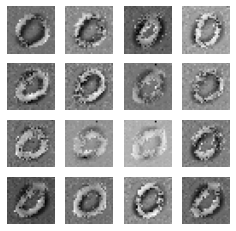

78
gen_loss: tf.Tensor(3.5916471, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.098586395, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.1002034, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.84177438e-22]
 [1.00000000e+00 1.06134015e-22]
 [9.99999881e-01 7.74330715e-08]
 [1.00000000e+00 2.22176633e-21]
 [1.00000000e+00 1.64064166e-21]
 [1.00000000e+00 5.64550458e-19]
 [1.00000000e+00 4.80436129e-20]
 [1.00000000e+00 1.41524979e-21]
 [1.00000000e+00 4.29875618e-20]
 [1.00000000e+00 5.68949818e-20]
 [1.00000000e+00 2.16970197e-22]
 [1.00000000e+00 5.42117565e-20]
 [9.99997735e-01 2.23971847e-06]
 [1.00000000e+00 8.79117397e-22]
 [1.00000000e+00 4.58955056e-20]
 [1.00000000e+00 5.00027803e-22]
 [1.00000000e+00 8.61443984e-20]
 [1.00000000e+00 7.54934838e-23]
 [1.00000000e+00 1.39638922e-21]
 [1.00000000e+00 5.57344311e-24]
 [9.92440224e-01 7.55976280e-03]
 [1.00000000e+00 1.29450201e-21]
 [1.00000000e+00 1.50125184e-23]
 [1.00000000e+00 2

gen_loss: tf.Tensor(3.6155, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.054383643, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.077068076, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.68738136e-23]
 [1.00000000e+00 4.30267047e-23]
 [1.00000000e+00 9.86259074e-09]
 [1.00000000e+00 8.11621688e-23]
 [1.00000000e+00 9.74375242e-23]
 [1.00000000e+00 1.85083375e-20]
 [1.00000000e+00 3.51662065e-21]
 [1.00000000e+00 4.02533600e-23]
 [1.00000000e+00 6.17807992e-21]
 [1.00000000e+00 7.42148778e-22]
 [1.00000000e+00 5.88845854e-24]
 [1.00000000e+00 3.39182341e-21]
 [9.99998689e-01 1.30546971e-06]
 [1.00000000e+00 3.25939372e-23]
 [1.00000000e+00 5.59767782e-21]
 [1.00000000e+00 3.42871324e-23]
 [1.00000000e+00 6.37161635e-21]
 [1.00000000e+00 1.88398227e-24]
 [1.00000000e+00 3.01301093e-22]
 [1.00000000e+00 2.41870152e-25]
 [9.98759985e-01 1.24003808e-03]
 [1.00000000e+00 2.42597750e-22]
 [1.00000000e+00 8.19304379e-25]
 [1.00000000e+00 7.117

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.28265431e-23]
 [1.00000000e+00 2.45687731e-23]
 [1.00000000e+00 7.51740270e-09]
 [1.00000000e+00 4.37660062e-23]
 [1.00000000e+00 9.69973209e-23]
 [1.00000000e+00 1.70153314e-20]
 [1.00000000e+00 2.45357360e-21]
 [1.00000000e+00 2.06983754e-23]
 [1.00000000e+00 3.95698123e-21]
 [1.00000000e+00 6.59255375e-22]
 [1.00000000e+00 5.50111876e-24]
 [1.00000000e+00 1.82652950e-21]
 [9.99998689e-01 1.26710859e-06]
 [1.00000000e+00 3.66936283e-23]
 [1.00000000e+00 3.28348233e-21]
 [1.00000000e+00 3.22360878e-23]
 [1.00000000e+00 4.94611839e-21]
 [1.00000000e+00 1.49377912e-24]
 [1.00000000e+00 2.03454094e-22]
 [1.00000000e+00 2.36759862e-25]
 [9.98227894e-01 1.77214190e-03]
 [1.00000000e+00 1.00136299e-22]
 [1.00000000e+00 8.68595711e-25]
 [1.00000000e+00 4.12282020e-24]
 [1.00000000e+00 4.10045834e-22]
 [1.00000000e+00 2.79678740e-18]
 [1.00000000e+00 1.34624372e-21]
 [1.00000000e+00 5.44178861e-21]
 [1.00000000e+00 2.84521384e-09]
 [1.0

gen_loss: tf.Tensor(3.6009736, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10209482, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05921757, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.64059939e-23]
 [1.00000000e+00 1.05056046e-23]
 [1.00000000e+00 1.85525941e-08]
 [1.00000000e+00 2.15306344e-22]
 [1.00000000e+00 1.85385716e-21]
 [1.00000000e+00 4.10813616e-19]
 [1.00000000e+00 8.34688084e-21]
 [1.00000000e+00 1.11521923e-22]
 [1.00000000e+00 5.82204046e-21]
 [1.00000000e+00 1.97287213e-20]
 [1.00000000e+00 8.20093171e-23]
 [1.00000000e+00 3.51526598e-21]
 [9.99997497e-01 2.44579041e-06]
 [1.00000000e+00 1.56822478e-21]
 [1.00000000e+00 6.16141676e-21]
 [1.00000000e+00 2.63785772e-22]
 [1.00000000e+00 2.15485703e-20]
 [1.00000000e+00 2.85081047e-23]
 [1.00000000e+00 4.79293408e-22]
 [1.00000000e+00 3.85949212e-24]
 [9.81150508e-01 1.88494734e-02]
 [1.00000000e+00 2.21782627e-23]
 [1.00000000e+00 1.55618543e-23]
 [1.00000000e+00 2.98

gen_loss: tf.Tensor(3.3951216, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051208366, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.10545665, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.78675559e-23]
 [1.00000000e+00 6.29226026e-24]
 [1.00000000e+00 3.31984005e-08]
 [1.00000000e+00 6.21220213e-22]
 [1.00000000e+00 1.04524150e-20]
 [1.00000000e+00 3.06394606e-18]
 [1.00000000e+00 1.68736460e-20]
 [1.00000000e+00 3.66409154e-22]
 [1.00000000e+00 7.85829741e-21]
 [1.00000000e+00 8.31180677e-20]
 [1.00000000e+00 1.73296131e-22]
 [1.00000000e+00 3.60000110e-21]
 [9.99996424e-01 3.63542745e-06]
 [1.00000000e+00 9.05762044e-21]
 [1.00000000e+00 1.01068958e-20]
 [1.00000000e+00 8.90964195e-22]
 [1.00000000e+00 3.75330553e-20]
 [1.00000000e+00 1.54337519e-22]
 [1.00000000e+00 8.89826316e-22]
 [1.00000000e+00 2.20287672e-23]
 [9.25173283e-01 7.48267323e-02]
 [1.00000000e+00 1.19111323e-23]
 [1.00000000e+00 6.07832537e-23]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.6166034, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06615956, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.07325582, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.82375664e-23]
 [1.00000000e+00 2.53041197e-24]
 [1.00000000e+00 2.31111521e-08]
 [1.00000000e+00 6.39311154e-22]
 [1.00000000e+00 7.44184670e-21]
 [1.00000000e+00 2.66066242e-18]
 [1.00000000e+00 1.39996344e-20]
 [1.00000000e+00 2.32743956e-22]
 [1.00000000e+00 8.19775003e-21]
 [1.00000000e+00 5.30975378e-20]
 [1.00000000e+00 4.51456450e-23]
 [1.00000000e+00 3.07641455e-21]
 [9.99997616e-01 2.34312938e-06]
 [1.00000000e+00 3.09318334e-21]
 [1.00000000e+00 8.55127847e-21]
 [1.00000000e+00 6.83535176e-22]
 [1.00000000e+00 1.88990284e-20]
 [1.00000000e+00 1.13338221e-22]
 [1.00000000e+00 4.85713347e-22]
 [1.00000000e+00 2.55479704e-23]
 [9.56623554e-01 4.33764532e-02]
 [1.00000000e+00 6.45579389e-24]
 [1.00000000e+00 4.30654567e-23]
 [1.00000000e+00 1.16

gen_loss: tf.Tensor(3.507849, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.047529206, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06994662, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.34178330e-23]
 [1.00000000e+00 6.69419397e-24]
 [1.00000000e+00 4.58503742e-08]
 [1.00000000e+00 1.11764309e-21]
 [1.00000000e+00 1.04381501e-20]
 [1.00000000e+00 2.64830869e-18]
 [1.00000000e+00 1.79886451e-20]
 [1.00000000e+00 5.85198577e-22]
 [1.00000000e+00 1.72831537e-20]
 [1.00000000e+00 1.00436386e-19]
 [1.00000000e+00 3.65454140e-23]
 [1.00000000e+00 6.29555936e-21]
 [9.99997616e-01 2.32993602e-06]
 [1.00000000e+00 5.35905681e-21]
 [1.00000000e+00 1.69146335e-20]
 [1.00000000e+00 7.36969054e-22]
 [1.00000000e+00 1.74121955e-20]
 [1.00000000e+00 1.73576650e-22]
 [1.00000000e+00 1.25568945e-21]
 [1.00000000e+00 4.94015433e-23]
 [9.74052787e-01 2.59472206e-02]
 [1.00000000e+00 1.21348043e-23]
 [1.00000000e+00 6.88924787e-23]
 [1.00000000e+00 1.69

gen_loss: tf.Tensor(3.6825347, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.061360043, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.053550508, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.01651859e-23]
 [1.00000000e+00 1.10992619e-23]
 [9.99999881e-01 8.07560454e-08]
 [1.00000000e+00 3.71675756e-21]
 [1.00000000e+00 3.11310748e-20]
 [1.00000000e+00 4.63772500e-18]
 [1.00000000e+00 3.72975544e-20]
 [1.00000000e+00 2.04873978e-21]
 [1.00000000e+00 4.25170576e-20]
 [1.00000000e+00 5.04479258e-19]
 [1.00000000e+00 9.85890970e-23]
 [1.00000000e+00 2.51173102e-20]
 [9.99997258e-01 2.70841497e-06]
 [1.00000000e+00 1.90492910e-20]
 [1.00000000e+00 4.40079893e-20]
 [1.00000000e+00 1.17250479e-21]
 [1.00000000e+00 2.96437847e-20]
 [1.00000000e+00 5.70858020e-22]
 [1.00000000e+00 3.67421309e-21]
 [1.00000000e+00 1.68553587e-22]
 [9.77219462e-01 2.27805562e-02]
 [1.00000000e+00 1.46678304e-23]
 [1.00000000e+00 2.33783284e-22]
 [1.00000000e+00 5.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.03359459e-23]
 [1.00000000e+00 2.88087269e-24]
 [1.00000000e+00 3.34290533e-08]
 [1.00000000e+00 2.58331777e-21]
 [1.00000000e+00 2.62682480e-20]
 [1.00000000e+00 2.60538132e-18]
 [1.00000000e+00 2.32470904e-20]
 [1.00000000e+00 1.29765635e-21]
 [1.00000000e+00 1.88160163e-20]
 [1.00000000e+00 2.74995135e-19]
 [1.00000000e+00 9.75371920e-23]
 [1.00000000e+00 1.50732535e-20]
 [9.99997616e-01 2.38764665e-06]
 [1.00000000e+00 1.04659003e-20]
 [1.00000000e+00 2.41149402e-20]
 [1.00000000e+00 5.99844582e-22]
 [1.00000000e+00 1.85924045e-20]
 [1.00000000e+00 3.87634612e-22]
 [1.00000000e+00 1.56236121e-21]
 [1.00000000e+00 1.01294265e-22]
 [9.79436159e-01 2.05638297e-02]
 [1.00000000e+00 4.25814100e-24]
 [1.00000000e+00 1.35304413e-22]
 [1.00000000e+00 3.84641484e-22]
 [1.00000000e+00 2.26089000e-21]
 [1.00000000e+00 1.86510368e-17]
 [1.00000000e+00 1.54483750e-20]
 [1.00000000e+00 5.62973826e-20]
 [1.00000000e+00 6.27442126e-11]
 [1.0

gen_loss: tf.Tensor(3.59517, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.047589317, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049762726, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.26085674e-23]
 [1.00000000e+00 1.34535346e-24]
 [1.00000000e+00 1.61904126e-08]
 [1.00000000e+00 2.38118964e-21]
 [1.00000000e+00 2.96653916e-20]
 [1.00000000e+00 2.02923555e-18]
 [1.00000000e+00 1.95637682e-20]
 [1.00000000e+00 1.24247183e-21]
 [1.00000000e+00 1.17268878e-20]
 [1.00000000e+00 1.99456071e-19]
 [1.00000000e+00 1.35381860e-22]
 [1.00000000e+00 1.19020207e-20]
 [9.99997735e-01 2.29041029e-06]
 [1.00000000e+00 8.67044821e-21]
 [1.00000000e+00 1.87003807e-20]
 [1.00000000e+00 4.53472640e-22]
 [1.00000000e+00 1.62184398e-20]
 [1.00000000e+00 3.54113223e-22]
 [1.00000000e+00 1.04058231e-21]
 [1.00000000e+00 8.33249288e-23]
 [9.82877970e-01 1.71220396e-02]
 [1.00000000e+00 2.33229882e-24]
 [1.00000000e+00 1.05098184e-22]
 [1.00000000e+00 3.75

gen_loss: tf.Tensor(3.632644, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036432926, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.052720286, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.70439063e-23]
 [1.00000000e+00 1.35912628e-24]
 [1.00000000e+00 2.58162935e-09]
 [1.00000000e+00 6.55731477e-22]
 [1.00000000e+00 1.28124792e-20]
 [1.00000000e+00 8.42449436e-19]
 [1.00000000e+00 5.91160458e-21]
 [1.00000000e+00 9.69241411e-22]
 [1.00000000e+00 2.25370851e-21]
 [1.00000000e+00 5.44158375e-20]
 [1.00000000e+00 1.00606486e-22]
 [1.00000000e+00 3.19974605e-21]
 [9.99998927e-01 1.04646563e-06]
 [1.00000000e+00 4.20056734e-21]
 [1.00000000e+00 5.10690284e-21]
 [1.00000000e+00 1.85276744e-22]
 [1.00000000e+00 5.60376656e-21]
 [1.00000000e+00 1.26107001e-22]
 [1.00000000e+00 2.31531660e-22]
 [1.00000000e+00 2.00179797e-23]
 [9.94861662e-01 5.13835344e-03]
 [1.00000000e+00 3.06956388e-24]
 [1.00000000e+00 1.78041552e-23]
 [1.00000000e+00 1.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.52079808e-23]
 [1.00000000e+00 2.51691476e-24]
 [1.00000000e+00 1.45362000e-09]
 [1.00000000e+00 3.11026726e-22]
 [1.00000000e+00 6.87707137e-21]
 [1.00000000e+00 4.86633973e-19]
 [1.00000000e+00 3.12431267e-21]
 [1.00000000e+00 1.09002180e-21]
 [1.00000000e+00 1.15812879e-21]
 [1.00000000e+00 2.94164619e-20]
 [1.00000000e+00 7.94346265e-23]
 [1.00000000e+00 1.39856956e-21]
 [9.99999166e-01 8.80190441e-07]
 [1.00000000e+00 3.14053983e-21]
 [1.00000000e+00 2.70539416e-21]
 [1.00000000e+00 1.12831343e-22]
 [1.00000000e+00 2.96508949e-21]
 [1.00000000e+00 7.16537885e-23]
 [1.00000000e+00 1.47337306e-22]
 [1.00000000e+00 8.71294109e-24]
 [9.97140050e-01 2.86001619e-03]
 [1.00000000e+00 5.23267018e-24]
 [1.00000000e+00 7.08068059e-24]
 [1.00000000e+00 4.44138598e-23]
 [1.00000000e+00 6.83730763e-22]
 [1.00000000e+00 7.64914956e-17]
 [1.00000000e+00 3.49778290e-21]
 [1.00000000e+00 6.62796367e-20]
 [1.00000000e+00 5.89676658e-12]
 [1.0

gen_loss: tf.Tensor(3.6405363, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.078375794, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06189665, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.29328854e-23]
 [1.00000000e+00 3.10616151e-24]
 [1.00000000e+00 2.58684407e-09]
 [1.00000000e+00 2.67666008e-22]
 [1.00000000e+00 4.74492812e-21]
 [1.00000000e+00 3.75272043e-19]
 [1.00000000e+00 3.20952580e-21]
 [1.00000000e+00 2.07333265e-21]
 [1.00000000e+00 1.64865962e-21]
 [1.00000000e+00 2.99077555e-20]
 [1.00000000e+00 1.01241727e-22]
 [1.00000000e+00 1.01239849e-21]
 [9.99998569e-01 1.47589469e-06]
 [1.00000000e+00 2.80600545e-21]
 [1.00000000e+00 3.21480696e-21]
 [1.00000000e+00 9.44966255e-23]
 [1.00000000e+00 1.76992801e-21]
 [1.00000000e+00 6.31402375e-23]
 [1.00000000e+00 2.36120735e-22]
 [1.00000000e+00 7.65014350e-24]
 [9.97405708e-01 2.59427028e-03]
 [1.00000000e+00 4.07712030e-24]
 [1.00000000e+00 6.04424042e-24]
 [1.00000000e+00 3.5

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.13455206e-23]
 [1.00000000e+00 1.39156937e-24]
 [1.00000000e+00 5.85888227e-09]
 [1.00000000e+00 4.07749782e-22]
 [1.00000000e+00 5.07966283e-21]
 [1.00000000e+00 4.31523737e-19]
 [1.00000000e+00 5.03724963e-21]
 [1.00000000e+00 2.18737089e-21]
 [1.00000000e+00 3.40997291e-21]
 [1.00000000e+00 4.37233552e-20]
 [1.00000000e+00 1.17805900e-22]
 [1.00000000e+00 1.67719230e-21]
 [9.99997616e-01 2.39380256e-06]
 [1.00000000e+00 2.29081531e-21]
 [1.00000000e+00 5.70240179e-21]
 [1.00000000e+00 1.16759441e-22]
 [1.00000000e+00 1.80808232e-21]
 [1.00000000e+00 7.11254663e-23]
 [1.00000000e+00 3.65099014e-22]
 [1.00000000e+00 1.11905402e-23]
 [9.96067643e-01 3.93232238e-03]
 [1.00000000e+00 1.57161208e-24]
 [1.00000000e+00 8.95956346e-24]
 [1.00000000e+00 5.55563623e-23]
 [1.00000000e+00 9.07224271e-22]
 [1.00000000e+00 8.28301608e-17]
 [1.00000000e+00 6.53195288e-21]
 [1.00000000e+00 8.86425744e-20]
 [1.00000000e+00 1.77727780e-11]
 [1.0

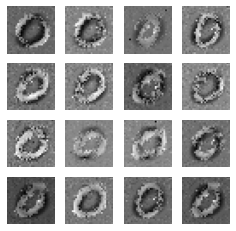

79
gen_loss: tf.Tensor(3.6203046, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.045347817, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05608333, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.59796461e-23]
 [1.00000000e+00 3.64675310e-25]
 [1.00000000e+00 1.36386884e-08]
 [1.00000000e+00 7.33331812e-22]
 [1.00000000e+00 4.59389213e-21]
 [1.00000000e+00 5.39853947e-19]
 [1.00000000e+00 9.78574294e-21]
 [1.00000000e+00 9.22601329e-22]
 [1.00000000e+00 8.66006887e-21]
 [1.00000000e+00 7.29793925e-20]
 [1.00000000e+00 7.16518700e-23]
 [1.00000000e+00 5.20866059e-21]
 [9.99997377e-01 2.67008681e-06]
 [1.00000000e+00 1.11706763e-21]
 [1.00000000e+00 1.24073425e-20]
 [1.00000000e+00 2.01074574e-22]
 [1.00000000e+00 1.78566847e-21]
 [1.00000000e+00 5.63370380e-23]
 [1.00000000e+00 3.45502699e-22]
 [1.00000000e+00 1.56530056e-23]
 [9.94794548e-01 5.20548224e-03]
 [1.00000000e+00 4.79647497e-25]
 [1.00000000e+00 9.72800076e-24]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.5135298, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044101473, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05611566, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.16886846e-23]
 [1.00000000e+00 5.23939867e-25]
 [1.00000000e+00 1.07405924e-08]
 [1.00000000e+00 4.47405454e-22]
 [1.00000000e+00 2.53078251e-21]
 [1.00000000e+00 3.73236197e-19]
 [1.00000000e+00 7.07553413e-21]
 [1.00000000e+00 5.77278717e-22]
 [1.00000000e+00 6.31258522e-21]
 [1.00000000e+00 4.88202999e-20]
 [1.00000000e+00 4.03933387e-23]
 [1.00000000e+00 3.68794639e-21]
 [9.99998093e-01 1.89508182e-06]
 [1.00000000e+00 6.51443103e-22]
 [1.00000000e+00 8.25999699e-21]
 [1.00000000e+00 1.80692314e-22]
 [1.00000000e+00 1.16008315e-21]
 [1.00000000e+00 2.90447731e-23]
 [1.00000000e+00 1.99662828e-22]
 [1.00000000e+00 8.75194947e-24]
 [9.96903956e-01 3.09596956e-03]
 [1.00000000e+00 7.80617506e-25]
 [1.00000000e+00 4.51254746e-24]
 [1.00000000e+00 5.6

 [1.00000000e+00 1.26292405e-21]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.6093407, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04136693, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04697954, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.85319078e-24]
 [1.00000000e+00 1.63973190e-24]
 [1.00000000e+00 5.51710100e-09]
 [1.00000000e+00 3.62447179e-22]
 [1.00000000e+00 2.75291887e-21]
 [1.00000000e+00 3.85660243e-19]
 [1.00000000e+00 5.98475755e-21]
 [1.00000000e+00 4.74215718e-22]
 [1.00000000e+00 3.38598003e-21]
 [1.00000000e+00 5.38851720e-20]
 [1.00000000e+00 3.79147756e-23]
 [1.00000000e+00 2.67241720e-21]
 [9.99998212e-01 1.73101989e-06]
 [1.00000000e+00 1.17006515e-21]
 [1.00000000e+00 4.26450339e-21]
 [1.00000000e+00 3.29156946e-22]
 [1.00000000e+00 1.34615122e-21]
 [1.00000000e+00 1.88323596e-23]
 [1.00000000e+00 1.01880976e-22]
 [1.00000000e+00 5.19260276e-24]
 [9.97900367e-01 2.09961296e-03]
 [1.00000000e+00 2.55

gen_loss: tf.Tensor(3.5739431, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.063432425, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051199637, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.60601336e-24]
 [1.00000000e+00 1.55278680e-24]
 [1.00000000e+00 5.16043563e-09]
 [1.00000000e+00 5.09489438e-22]
 [1.00000000e+00 4.73046982e-21]
 [1.00000000e+00 4.65702892e-19]
 [1.00000000e+00 7.93045195e-21]
 [1.00000000e+00 5.55693211e-22]
 [1.00000000e+00 3.28970093e-21]
 [1.00000000e+00 7.46325776e-20]
 [1.00000000e+00 7.03408210e-23]
 [1.00000000e+00 2.74123454e-21]
 [9.99997377e-01 2.57807369e-06]
 [1.00000000e+00 1.92220639e-21]
 [1.00000000e+00 4.39152287e-21]
 [1.00000000e+00 5.26481123e-22]
 [1.00000000e+00 1.94764138e-21]
 [1.00000000e+00 2.36179165e-23]
 [1.00000000e+00 1.10179773e-22]
 [1.00000000e+00 6.71675460e-24]
 [9.97346640e-01 2.65330542e-03]
 [1.00000000e+00 2.37707476e-24]
 [1.00000000e+00 3.15832789e-24]
 [1.00000000e+00 7.

gen_loss: tf.Tensor(3.6780534, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.032972835, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048514888, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.54578415e-23]
 [1.00000000e+00 1.89469224e-24]
 [1.00000000e+00 6.28995656e-09]
 [1.00000000e+00 1.18014217e-21]
 [1.00000000e+00 1.33195159e-20]
 [1.00000000e+00 6.11473364e-19]
 [1.00000000e+00 1.80589134e-20]
 [1.00000000e+00 8.79664172e-22]
 [1.00000000e+00 5.38861721e-21]
 [1.00000000e+00 1.56079017e-19]
 [1.00000000e+00 2.51249522e-22]
 [1.00000000e+00 4.82874074e-21]
 [9.99995112e-01 4.92579647e-06]
 [1.00000000e+00 4.53261897e-21]
 [1.00000000e+00 7.88971573e-21]
 [1.00000000e+00 1.20784273e-21]
 [1.00000000e+00 4.09092996e-21]
 [1.00000000e+00 4.42937320e-23]
 [1.00000000e+00 2.27940361e-22]
 [1.00000000e+00 1.62496890e-23]
 [9.96863008e-01 3.13705578e-03]
 [1.00000000e+00 2.78836298e-24]
 [1.00000000e+00 8.22382839e-24]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.4810724, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.027364593, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.057909675, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.93059649e-23]
 [1.00000000e+00 1.28180253e-24]
 [1.00000000e+00 6.01016659e-09]
 [1.00000000e+00 9.03211759e-22]
 [1.00000000e+00 7.02004356e-21]
 [1.00000000e+00 2.44608112e-19]
 [1.00000000e+00 1.62150374e-20]
 [1.00000000e+00 8.07641045e-22]
 [1.00000000e+00 5.32518764e-21]
 [1.00000000e+00 1.25333618e-19]
 [1.00000000e+00 3.05126122e-22]
 [1.00000000e+00 5.36089697e-21]
 [9.99994993e-01 5.04772652e-06]
 [1.00000000e+00 1.53578208e-21]
 [1.00000000e+00 7.86075552e-21]
 [1.00000000e+00 7.02971345e-22]
 [1.00000000e+00 3.16118946e-21]
 [1.00000000e+00 3.28099998e-23]
 [1.00000000e+00 1.78572196e-22]
 [1.00000000e+00 1.67265412e-23]
 [9.98446882e-01 1.55319984e-03]
 [1.00000000e+00 2.22030542e-24]
 [1.00000000e+00 7.35477031e-24]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.5912411, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04319937, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04453986, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.41611245e-23]
 [1.00000000e+00 8.14492919e-25]
 [1.00000000e+00 7.63384733e-09]
 [1.00000000e+00 7.15606751e-22]
 [1.00000000e+00 3.92762561e-21]
 [1.00000000e+00 1.11186943e-19]
 [1.00000000e+00 1.59134848e-20]
 [1.00000000e+00 5.58690175e-22]
 [1.00000000e+00 6.70378672e-21]
 [1.00000000e+00 1.00455928e-19]
 [1.00000000e+00 1.97381859e-22]
 [1.00000000e+00 8.72020345e-21]
 [9.99993443e-01 6.51479559e-06]
 [1.00000000e+00 7.57713597e-22]
 [1.00000000e+00 1.03093038e-20]
 [1.00000000e+00 3.84816144e-22]
 [1.00000000e+00 2.30930207e-21]
 [1.00000000e+00 2.54862562e-23]
 [1.00000000e+00 1.93910770e-22]
 [1.00000000e+00 1.65537586e-23]
 [9.98526096e-01 1.47391635e-03]
 [1.00000000e+00 1.26944759e-24]
 [1.00000000e+00 7.02276479e-24]
 [1.00000000e+00 1.14

gen_loss: tf.Tensor(3.8090541, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.034336776, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.038415827, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.29570120e-23]
 [1.00000000e+00 7.37648598e-25]
 [1.00000000e+00 1.17057075e-08]
 [1.00000000e+00 6.85666186e-22]
 [1.00000000e+00 3.90125519e-21]
 [1.00000000e+00 9.40110218e-20]
 [1.00000000e+00 1.76458950e-20]
 [1.00000000e+00 6.38872320e-22]
 [1.00000000e+00 8.92577156e-21]
 [1.00000000e+00 9.43588060e-20]
 [1.00000000e+00 1.70996443e-22]
 [1.00000000e+00 1.37256632e-20]
 [9.99987960e-01 1.20460327e-05]
 [1.00000000e+00 9.12910835e-22]
 [1.00000000e+00 1.54510860e-20]
 [1.00000000e+00 3.49780799e-22]
 [1.00000000e+00 2.43091641e-21]
 [1.00000000e+00 2.71978509e-23]
 [1.00000000e+00 3.53031512e-22]
 [1.00000000e+00 1.93745784e-23]
 [9.97715473e-01 2.28451961e-03]
 [1.00000000e+00 8.14461857e-25]
 [1.00000000e+00 8.23456400e-24]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.6508172, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043482233, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.046792362, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.39534332e-24]
 [1.00000000e+00 3.80748942e-25]
 [1.00000000e+00 6.26801633e-09]
 [1.00000000e+00 3.05897641e-22]
 [1.00000000e+00 2.93799973e-21]
 [1.00000000e+00 6.79609911e-20]
 [1.00000000e+00 9.73688839e-21]
 [1.00000000e+00 4.40801893e-22]
 [1.00000000e+00 3.97151384e-21]
 [1.00000000e+00 5.36488892e-20]
 [1.00000000e+00 1.11992147e-22]
 [1.00000000e+00 8.55062577e-21]
 [9.99989033e-01 1.09751127e-05]
 [1.00000000e+00 6.17946731e-22]
 [1.00000000e+00 7.75596854e-21]
 [1.00000000e+00 2.89218420e-22]
 [1.00000000e+00 1.68375017e-21]
 [1.00000000e+00 1.84898899e-23]
 [1.00000000e+00 1.87130630e-22]
 [1.00000000e+00 1.29659616e-23]
 [9.97549713e-01 2.45031086e-03]
 [1.00000000e+00 4.30894069e-25]
 [1.00000000e+00 4.93275118e-24]
 [1.00000000e+00 5.

gen_loss: tf.Tensor(3.645791, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.056890868, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.045722865, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.77721953e-23]
 [1.00000000e+00 4.00676407e-25]
 [1.00000000e+00 3.30116690e-09]
 [1.00000000e+00 2.70177287e-22]
 [1.00000000e+00 6.81616535e-21]
 [1.00000000e+00 1.24207502e-19]
 [1.00000000e+00 1.12999875e-20]
 [1.00000000e+00 8.17441853e-22]
 [1.00000000e+00 2.80697965e-21]
 [1.00000000e+00 7.32560844e-20]
 [1.00000000e+00 2.30004324e-22]
 [1.00000000e+00 6.68664938e-21]
 [9.99991655e-01 8.37901644e-06]
 [1.00000000e+00 7.51106098e-22]
 [1.00000000e+00 6.06233037e-21]
 [1.00000000e+00 7.46629659e-22]
 [1.00000000e+00 2.32129619e-21]
 [1.00000000e+00 3.55538316e-23]
 [1.00000000e+00 1.29989017e-22]
 [1.00000000e+00 2.44290580e-23]
 [9.97808278e-01 2.19175592e-03]
 [1.00000000e+00 5.33107121e-25]
 [1.00000000e+00 7.42275434e-24]
 [1.00000000e+00 5.1

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.67791488e-23]
 [1.00000000e+00 4.09971678e-25]
 [1.00000000e+00 2.83528934e-09]
 [1.00000000e+00 2.79857456e-22]
 [1.00000000e+00 1.12145739e-20]
 [1.00000000e+00 1.89649754e-19]
 [1.00000000e+00 1.30819389e-20]
 [1.00000000e+00 1.19528386e-21]
 [1.00000000e+00 2.66698903e-21]
 [1.00000000e+00 1.05936381e-19]
 [1.00000000e+00 3.52326535e-22]
 [1.00000000e+00 6.65324187e-21]
 [9.99992013e-01 7.94161951e-06]
 [1.00000000e+00 8.93977164e-22]
 [1.00000000e+00 5.80042673e-21]
 [1.00000000e+00 1.26645068e-21]
 [1.00000000e+00 2.84471896e-21]
 [1.00000000e+00 5.32969384e-23]
 [1.00000000e+00 1.20598670e-22]
 [1.00000000e+00 3.65516902e-23]
 [9.97924685e-01 2.07526772e-03]
 [1.00000000e+00 5.47676446e-25]
 [1.00000000e+00 1.03675374e-23]
 [1.00000000e+00 5.51126690e-23]
 [1.00000000e+00 2.94850892e-21]
 [1.00000000e+00 8.60607709e-17]
 [1.00000000e+00 3.48301878e-20]
 [1.00000000e+00 2.18674733e-19]
 [1.00000000e+00 1.59563820e-11]
 [1.0

gen_loss: tf.Tensor(3.5508285, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043222837, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051414087, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.68240397e-23]
 [1.00000000e+00 1.24720438e-24]
 [1.00000000e+00 3.57157148e-09]
 [1.00000000e+00 2.13941551e-22]
 [1.00000000e+00 1.55600380e-20]
 [1.00000000e+00 2.67781836e-19]
 [1.00000000e+00 1.40400661e-20]
 [1.00000000e+00 3.23162744e-21]
 [1.00000000e+00 2.82232288e-21]
 [1.00000000e+00 1.04855269e-19]
 [1.00000000e+00 4.54489197e-22]
 [1.00000000e+00 3.51125851e-21]
 [9.99991894e-01 8.10034635e-06]
 [1.00000000e+00 1.09018810e-21]
 [1.00000000e+00 5.68556818e-21]
 [1.00000000e+00 2.13327982e-21]
 [1.00000000e+00 2.57859197e-21]
 [1.00000000e+00 6.72211538e-23]
 [1.00000000e+00 1.94784108e-22]
 [1.00000000e+00 4.72992353e-23]
 [9.98522103e-01 1.47786411e-03]
 [1.00000000e+00 1.03210084e-24]
 [1.00000000e+00 1.08831716e-23]
 [1.00000000e+00 4.

gen_loss: tf.Tensor(3.6756115, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04555566, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04524571, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.75358194e-23]
 [1.00000000e+00 1.77765170e-25]
 [1.00000000e+00 5.58251845e-09]
 [1.00000000e+00 2.48305317e-22]
 [1.00000000e+00 1.24273321e-20]
 [1.00000000e+00 3.07473994e-19]
 [1.00000000e+00 1.85692273e-20]
 [1.00000000e+00 5.16920836e-22]
 [1.00000000e+00 2.11156552e-21]
 [1.00000000e+00 1.37883292e-19]
 [1.00000000e+00 7.65987158e-23]
 [1.00000000e+00 7.74130709e-21]
 [9.99994755e-01 5.28296323e-06]
 [1.00000000e+00 1.14596433e-21]
 [1.00000000e+00 3.19784248e-21]
 [1.00000000e+00 2.25066717e-21]
 [1.00000000e+00 8.63377539e-22]
 [1.00000000e+00 3.42097925e-23]
 [1.00000000e+00 6.51877796e-23]
 [1.00000000e+00 3.67245769e-23]
 [9.97808874e-01 2.19110516e-03]
 [1.00000000e+00 1.76767754e-25]
 [1.00000000e+00 8.76063325e-24]
 [1.00000000e+00 7.13

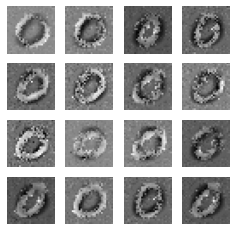

80
gen_loss: tf.Tensor(3.615566, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04892993, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0495432, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.03607366e-23]
 [1.00000000e+00 1.12868197e-25]
 [1.00000000e+00 1.17771926e-08]
 [1.00000000e+00 2.80749210e-22]
 [1.00000000e+00 8.21816459e-21]
 [1.00000000e+00 2.99848784e-19]
 [1.00000000e+00 2.37683483e-20]
 [1.00000000e+00 2.29879773e-22]
 [1.00000000e+00 1.97300650e-21]
 [1.00000000e+00 1.66305037e-19]
 [1.00000000e+00 2.57652448e-23]
 [1.00000000e+00 1.21863148e-20]
 [9.99996543e-01 3.47917376e-06]
 [1.00000000e+00 1.50768692e-21]
 [1.00000000e+00 2.55807624e-21]
 [1.00000000e+00 2.11338669e-21]
 [1.00000000e+00 3.86761664e-22]
 [1.00000000e+00 1.89298818e-23]
 [1.00000000e+00 6.03617874e-23]
 [1.00000000e+00 2.84150601e-23]
 [9.97798741e-01 2.20117136e-03]
 [1.00000000e+00 1.15257755e-25]
 [1.00000000e+00 7.62939330e-24]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.6403852, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03607349, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051922493, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.51851054e-23]
 [1.00000000e+00 3.85165084e-25]
 [1.00000000e+00 1.29952262e-08]
 [1.00000000e+00 8.52853049e-23]
 [1.00000000e+00 3.06364919e-21]
 [1.00000000e+00 1.29181972e-19]
 [1.00000000e+00 1.13387632e-20]
 [1.00000000e+00 4.80206618e-22]
 [1.00000000e+00 6.65890036e-22]
 [1.00000000e+00 6.00257182e-20]
 [1.00000000e+00 2.84283950e-23]
 [1.00000000e+00 1.00930585e-21]
 [9.99997735e-01 2.23033362e-06]
 [1.00000000e+00 9.30618074e-22]
 [1.00000000e+00 7.03105439e-22]
 [1.00000000e+00 1.13756701e-21]
 [1.00000000e+00 1.19516466e-22]
 [1.00000000e+00 8.94720043e-24]
 [1.00000000e+00 5.42863783e-23]
 [1.00000000e+00 1.26869305e-23]
 [9.98791635e-01 1.20844156e-03]
 [1.00000000e+00 2.94965052e-25]
 [1.00000000e+00 3.19299833e-24]
 [1.00000000e+00 3.1

gen_loss: tf.Tensor(3.7447135, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.041457165, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05574658, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.78076104e-23]
 [1.00000000e+00 2.21810332e-25]
 [1.00000000e+00 1.32795943e-08]
 [1.00000000e+00 7.39782524e-23]
 [1.00000000e+00 2.35963286e-21]
 [1.00000000e+00 9.64653701e-20]
 [1.00000000e+00 9.51942875e-21]
 [1.00000000e+00 8.25460669e-22]
 [1.00000000e+00 4.00773323e-22]
 [1.00000000e+00 5.40816274e-20]
 [1.00000000e+00 5.66901637e-23]
 [1.00000000e+00 3.65635616e-22]
 [9.99997616e-01 2.42499004e-06]
 [1.00000000e+00 5.36652103e-22]
 [1.00000000e+00 4.39549257e-22]
 [1.00000000e+00 9.51219940e-22]
 [1.00000000e+00 9.46301007e-23]
 [1.00000000e+00 7.62308084e-24]
 [1.00000000e+00 5.02281496e-23]
 [1.00000000e+00 1.24144248e-23]
 [9.98819411e-01 1.18059455e-03]
 [1.00000000e+00 1.62131402e-25]
 [1.00000000e+00 3.23710059e-24]
 [1.00000000e+00 2.9

gen_loss: tf.Tensor(3.5942483, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.049098156, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0538918, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.48711877e-23]
 [1.00000000e+00 3.49960268e-26]
 [1.00000000e+00 1.06330100e-08]
 [1.00000000e+00 1.30028688e-22]
 [1.00000000e+00 3.22068668e-21]
 [1.00000000e+00 1.41802357e-19]
 [1.00000000e+00 1.09617700e-20]
 [1.00000000e+00 7.09025556e-22]
 [1.00000000e+00 3.51152483e-22]
 [1.00000000e+00 1.25750750e-19]
 [1.00000000e+00 1.00863566e-22]
 [1.00000000e+00 7.14575603e-22]
 [9.99997497e-01 2.51210918e-06]
 [1.00000000e+00 3.83737235e-22]
 [1.00000000e+00 4.22067494e-22]
 [1.00000000e+00 1.23127066e-21]
 [1.00000000e+00 1.40818891e-22]
 [1.00000000e+00 9.28978537e-24]
 [1.00000000e+00 2.82738477e-23]
 [1.00000000e+00 1.78774530e-23]
 [9.98326004e-01 1.67393696e-03]
 [1.00000000e+00 3.33066781e-26]
 [1.00000000e+00 4.72263729e-24]
 [1.00000000e+00 5.92

gen_loss: tf.Tensor(3.7697942, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06841092, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.043409415, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.93173103e-23]
 [1.00000000e+00 9.89695277e-26]
 [1.00000000e+00 3.91360633e-09]
 [1.00000000e+00 8.33891610e-23]
 [1.00000000e+00 1.97626070e-21]
 [1.00000000e+00 1.44987442e-19]
 [1.00000000e+00 5.58649998e-21]
 [1.00000000e+00 6.15270006e-22]
 [1.00000000e+00 2.26811041e-22]
 [1.00000000e+00 1.07794856e-19]
 [1.00000000e+00 6.73762123e-23]
 [1.00000000e+00 9.62509764e-22]
 [9.99998569e-01 1.40710563e-06]
 [1.00000000e+00 3.47953595e-22]
 [1.00000000e+00 2.56703896e-22]
 [1.00000000e+00 1.03656495e-21]
 [1.00000000e+00 1.20155999e-22]
 [1.00000000e+00 6.56792258e-24]
 [1.00000000e+00 1.48573842e-23]
 [1.00000000e+00 9.22867942e-24]
 [9.99170423e-01 8.29571800e-04]
 [1.00000000e+00 9.98428337e-26]
 [1.00000000e+00 1.89127667e-24]
 [1.00000000e+00 3.0

gen_loss: tf.Tensor(3.6198294, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044058125, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051171422, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.34538610e-24]
 [1.00000000e+00 6.11720833e-26]
 [1.00000000e+00 1.84855786e-09]
 [1.00000000e+00 3.26536729e-23]
 [1.00000000e+00 5.53843565e-22]
 [1.00000000e+00 3.98067713e-20]
 [1.00000000e+00 2.14579981e-21]
 [1.00000000e+00 1.82259610e-22]
 [1.00000000e+00 1.73981026e-22]
 [1.00000000e+00 2.02675018e-20]
 [1.00000000e+00 1.80857028e-23]
 [1.00000000e+00 7.70268527e-22]
 [9.99998450e-01 1.56325609e-06]
 [1.00000000e+00 9.73476193e-23]
 [1.00000000e+00 1.85862874e-22]
 [1.00000000e+00 3.16590631e-22]
 [1.00000000e+00 7.16920640e-23]
 [1.00000000e+00 1.43660810e-24]
 [1.00000000e+00 1.19163135e-23]
 [1.00000000e+00 2.28562685e-24]
 [9.99475300e-01 5.24733099e-04]
 [1.00000000e+00 5.27008512e-26]
 [1.00000000e+00 4.78414014e-25]
 [1.00000000e+00 9.

gen_loss: tf.Tensor(3.5818923, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04507563, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05219519, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.55463185e-24]
 [1.00000000e+00 3.12584254e-26]
 [1.00000000e+00 2.23286767e-09]
 [1.00000000e+00 3.11956970e-23]
 [1.00000000e+00 5.02199354e-22]
 [1.00000000e+00 3.17529499e-20]
 [1.00000000e+00 2.29010769e-21]
 [1.00000000e+00 1.52087384e-22]
 [1.00000000e+00 2.67898930e-22]
 [1.00000000e+00 1.67253545e-20]
 [1.00000000e+00 2.11435233e-23]
 [1.00000000e+00 1.18286444e-21]
 [9.99997497e-01 2.54409042e-06]
 [1.00000000e+00 6.77473367e-23]
 [1.00000000e+00 2.83340005e-22]
 [1.00000000e+00 2.25755356e-22]
 [1.00000000e+00 1.00617233e-22]
 [1.00000000e+00 1.17023748e-24]
 [1.00000000e+00 2.04991028e-23]
 [1.00000000e+00 2.29245523e-24]
 [9.99234676e-01 7.65320729e-04]
 [1.00000000e+00 2.28674953e-26]
 [1.00000000e+00 5.18755178e-25]
 [1.00000000e+00 7.98

 [1.00000000e+00 2.81098580e-22]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.7217257, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.057107747, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04870239, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.98468000e-24]
 [1.00000000e+00 3.72651382e-27]
 [1.00000000e+00 1.25630562e-09]
 [1.00000000e+00 9.32596569e-24]
 [1.00000000e+00 1.91862307e-22]
 [1.00000000e+00 1.07485610e-20]
 [1.00000000e+00 8.85546121e-22]
 [1.00000000e+00 6.81044004e-23]
 [1.00000000e+00 9.36122177e-23]
 [1.00000000e+00 4.76880811e-21]
 [1.00000000e+00 2.13828022e-23]
 [1.00000000e+00 2.70014491e-22]
 [9.99995828e-01 4.22703624e-06]
 [1.00000000e+00 8.14788554e-24]
 [1.00000000e+00 9.00112255e-23]
 [1.00000000e+00 7.23318428e-23]
 [1.00000000e+00 5.33319197e-23]
 [1.00000000e+00 5.38659223e-25]
 [1.00000000e+00 6.81698727e-24]
 [1.00000000e+00 1.28941879e-24]
 [9.98716712e-01 1.28335191e-03]
 [1.00000000e+00 2.9

gen_loss: tf.Tensor(3.7763982, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036421537, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.040109843, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.10685642e-24]
 [1.00000000e+00 2.85784950e-27]
 [1.00000000e+00 8.91593521e-10]
 [1.00000000e+00 6.26732279e-24]
 [1.00000000e+00 1.46973559e-22]
 [1.00000000e+00 8.90264766e-21]
 [1.00000000e+00 6.67836112e-22]
 [1.00000000e+00 6.57933535e-23]
 [1.00000000e+00 6.33443379e-23]
 [1.00000000e+00 2.97310846e-21]
 [1.00000000e+00 2.41016602e-23]
 [1.00000000e+00 1.32782582e-22]
 [9.99995232e-01 4.75643128e-06]
 [1.00000000e+00 4.31774576e-24]
 [1.00000000e+00 5.71060259e-23]
 [1.00000000e+00 5.82176824e-23]
 [1.00000000e+00 4.74260683e-23]
 [1.00000000e+00 5.04747227e-25]
 [1.00000000e+00 4.58319035e-24]
 [1.00000000e+00 1.17688107e-24]
 [9.98562634e-01 1.43737544e-03]
 [1.00000000e+00 2.35700776e-27]
 [1.00000000e+00 1.97009198e-25]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.686823, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03281343, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048637155, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.20129163e-24]
 [1.00000000e+00 1.77245625e-27]
 [1.00000000e+00 7.63812569e-10]
 [1.00000000e+00 6.44880379e-24]
 [1.00000000e+00 1.73202275e-22]
 [1.00000000e+00 1.35247786e-20]
 [1.00000000e+00 6.32518923e-22]
 [1.00000000e+00 7.01013481e-23]
 [1.00000000e+00 5.07179660e-23]
 [1.00000000e+00 2.99516970e-21]
 [1.00000000e+00 2.45701805e-23]
 [1.00000000e+00 1.02520351e-22]
 [9.99991179e-01 8.85418012e-06]
 [1.00000000e+00 3.40030368e-24]
 [1.00000000e+00 4.35116427e-23]
 [1.00000000e+00 6.94174499e-23]
 [1.00000000e+00 5.70133000e-23]
 [1.00000000e+00 7.09660404e-25]
 [1.00000000e+00 3.26577667e-24]
 [1.00000000e+00 1.36913821e-24]
 [9.97168243e-01 2.83181597e-03]
 [1.00000000e+00 1.47333564e-27]
 [1.00000000e+00 2.01703450e-25]
 [1.00000000e+00 1.60

gen_loss: tf.Tensor(3.471146, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.052435845, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05683052, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.87685925e-24]
 [1.00000000e+00 8.88392291e-28]
 [1.00000000e+00 5.40095357e-10]
 [1.00000000e+00 1.21751909e-23]
 [1.00000000e+00 2.53947528e-22]
 [1.00000000e+00 3.13509498e-20]
 [1.00000000e+00 6.59509426e-22]
 [1.00000000e+00 6.31359019e-23]
 [1.00000000e+00 4.01423389e-23]
 [1.00000000e+00 6.66096195e-21]
 [1.00000000e+00 1.97428440e-23]
 [1.00000000e+00 1.66067060e-22]
 [9.99988198e-01 1.18137659e-05]
 [1.00000000e+00 4.99409656e-24]
 [1.00000000e+00 3.79075433e-23]
 [1.00000000e+00 1.02895697e-22]
 [1.00000000e+00 7.05194886e-23]
 [1.00000000e+00 1.27497041e-24]
 [1.00000000e+00 2.17430655e-24]
 [1.00000000e+00 1.55440476e-24]
 [9.94412482e-01 5.58750518e-03]
 [1.00000000e+00 9.93363176e-28]
 [1.00000000e+00 2.26088522e-25]
 [1.00000000e+00 3.33

gen_loss: tf.Tensor(3.5415874, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.037606917, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0554676, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.63468609e-24]
 [1.00000000e+00 8.44643348e-28]
 [1.00000000e+00 4.41360698e-10]
 [1.00000000e+00 2.85293187e-23]
 [1.00000000e+00 4.30972004e-22]
 [1.00000000e+00 5.72564080e-20]
 [1.00000000e+00 1.17699955e-21]
 [1.00000000e+00 1.00029784e-22]
 [1.00000000e+00 6.11868791e-23]
 [1.00000000e+00 1.40200490e-20]
 [1.00000000e+00 3.48600411e-23]
 [1.00000000e+00 2.53329263e-22]
 [9.99991417e-01 8.55831877e-06]
 [1.00000000e+00 5.44234113e-24]
 [1.00000000e+00 5.86094181e-23]
 [1.00000000e+00 1.65297245e-22]
 [1.00000000e+00 9.65005594e-23]
 [1.00000000e+00 3.33023903e-24]
 [1.00000000e+00 2.58072335e-24]
 [1.00000000e+00 2.95822721e-24]
 [9.96037364e-01 3.96260107e-03]
 [1.00000000e+00 1.34603417e-27]
 [1.00000000e+00 4.11074160e-25]
 [1.00000000e+00 8.43

disc_fake_loss: tf.Tensor(0.060846336, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.93849030e-24]
 [1.00000000e+00 1.23253575e-27]
 [1.00000000e+00 6.15388740e-10]
 [1.00000000e+00 3.42477872e-23]
 [1.00000000e+00 5.09777164e-22]
 [1.00000000e+00 5.32531220e-20]
 [1.00000000e+00 1.68559456e-21]
 [1.00000000e+00 1.77952026e-22]
 [1.00000000e+00 9.10458513e-23]
 [1.00000000e+00 1.15260251e-20]
 [1.00000000e+00 5.56411995e-23]
 [1.00000000e+00 1.61019120e-22]
 [9.99990463e-01 9.50583853e-06]
 [1.00000000e+00 6.14692250e-24]
 [1.00000000e+00 8.41715343e-23]
 [1.00000000e+00 1.74202828e-22]
 [1.00000000e+00 1.11437723e-22]
 [1.00000000e+00 4.64755746e-24]
 [1.00000000e+00 5.22758243e-24]
 [1.00000000e+00 3.75153729e-24]
 [9.96749878e-01 3.25017516e-03]
 [1.00000000e+00 1.52666522e-27]
 [1.00000000e+00 5.86288130e-25]
 [1.00000000e+00 1.03729174e-23]
 [1.00000000e+00 2.73866177e-22]
 [1.00000000e+00 3.74602885e-18]
 [1.00000000e+00 4.77845922e-21]
 [1.000

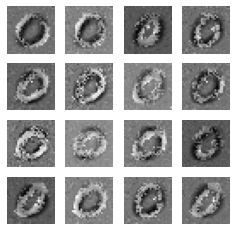

81
gen_loss: tf.Tensor(3.6281018, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.052269228, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.055645276, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.07672990e-23]
 [1.00000000e+00 1.21859462e-27]
 [1.00000000e+00 9.10086007e-10]
 [1.00000000e+00 3.66508216e-23]
 [1.00000000e+00 5.15080379e-22]
 [1.00000000e+00 4.91206860e-20]
 [1.00000000e+00 2.02247821e-21]
 [1.00000000e+00 1.88422141e-22]
 [1.00000000e+00 1.24147155e-22]
 [1.00000000e+00 1.21162282e-20]
 [1.00000000e+00 6.44278289e-23]
 [1.00000000e+00 1.52394018e-22]
 [9.99991298e-01 8.66746268e-06]
 [1.00000000e+00 7.36142278e-24]
 [1.00000000e+00 1.11722053e-22]
 [1.00000000e+00 1.56429855e-22]
 [1.00000000e+00 1.19878093e-22]
 [1.00000000e+00 5.39202206e-24]
 [1.00000000e+00 8.31784878e-24]
 [1.00000000e+00 4.06127169e-24]
 [9.97039735e-01 2.96019297e-03]
 [1.00000000e+00 1.07865173e-27]
 [1.00000000e+00 7.54513704e-25]
 [1.00000000e+00

gen_loss: tf.Tensor(3.5222902, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.035371274, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.052964017, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.70814466e-23]
 [1.00000000e+00 1.40537342e-27]
 [1.00000000e+00 1.43827228e-09]
 [1.00000000e+00 5.83724569e-23]
 [1.00000000e+00 7.00081161e-22]
 [1.00000000e+00 7.26995922e-20]
 [1.00000000e+00 3.27655066e-21]
 [1.00000000e+00 2.68674665e-22]
 [1.00000000e+00 2.25058861e-22]
 [1.00000000e+00 2.40201004e-20]
 [1.00000000e+00 1.00723225e-22]
 [1.00000000e+00 2.62778428e-22]
 [9.99992609e-01 7.34921650e-06]
 [1.00000000e+00 1.35723061e-23]
 [1.00000000e+00 1.92360639e-22]
 [1.00000000e+00 2.08934582e-22]
 [1.00000000e+00 1.98596326e-22]
 [1.00000000e+00 8.75889618e-24]
 [1.00000000e+00 1.55151459e-23]
 [1.00000000e+00 6.23829429e-24]
 [9.97051358e-01 2.94857821e-03]
 [1.00000000e+00 9.73306638e-28]
 [1.00000000e+00 1.36786450e-24]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.6052241, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.031680696, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051379003, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.66015667e-23]
 [1.00000000e+00 1.40952900e-27]
 [1.00000000e+00 1.48101842e-09]
 [1.00000000e+00 5.32920601e-23]
 [1.00000000e+00 5.40036455e-22]
 [1.00000000e+00 6.81515464e-20]
 [1.00000000e+00 3.13412494e-21]
 [1.00000000e+00 2.33232798e-22]
 [1.00000000e+00 2.39775976e-22]
 [1.00000000e+00 2.88966177e-20]
 [1.00000000e+00 7.88742134e-23]
 [1.00000000e+00 3.17374166e-22]
 [9.99995589e-01 4.35812672e-06]
 [1.00000000e+00 1.52971142e-23]
 [1.00000000e+00 1.93196049e-22]
 [1.00000000e+00 1.82404281e-22]
 [1.00000000e+00 1.96028944e-22]
 [1.00000000e+00 7.97768249e-24]
 [1.00000000e+00 1.57693358e-23]
 [1.00000000e+00 5.38152153e-24]
 [9.97759104e-01 2.24082428e-03]
 [1.00000000e+00 8.50962805e-28]
 [1.00000000e+00 1.26634244e-24]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.6953614, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.059746012, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04547868, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.22678489e-24]
 [1.00000000e+00 5.60438825e-28]
 [1.00000000e+00 8.14455670e-10]
 [1.00000000e+00 2.29276253e-23]
 [1.00000000e+00 2.05638860e-22]
 [1.00000000e+00 3.95186959e-20]
 [1.00000000e+00 1.45431559e-21]
 [1.00000000e+00 7.51466816e-23]
 [1.00000000e+00 1.12086608e-22]
 [1.00000000e+00 2.49835267e-20]
 [1.00000000e+00 1.92139790e-23]
 [1.00000000e+00 3.08870119e-22]
 [9.99997973e-01 1.97339023e-06]
 [1.00000000e+00 1.00789666e-23]
 [1.00000000e+00 8.18724087e-23]
 [1.00000000e+00 9.89398561e-23]
 [1.00000000e+00 9.98041448e-23]
 [1.00000000e+00 3.00240618e-24]
 [1.00000000e+00 6.61115807e-24]
 [1.00000000e+00 2.01790521e-24]
 [9.98279452e-01 1.72055198e-03]
 [1.00000000e+00 3.29258933e-28]
 [1.00000000e+00 5.05259641e-25]
 [1.00000000e+00 7.7

gen_loss: tf.Tensor(3.6318207, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04259087, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05063329, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.15308599e-24]
 [1.00000000e+00 2.72761225e-28]
 [1.00000000e+00 4.15048051e-10]
 [1.00000000e+00 1.14573590e-23]
 [1.00000000e+00 1.10285746e-22]
 [1.00000000e+00 2.94557627e-20]
 [1.00000000e+00 6.63078965e-22]
 [1.00000000e+00 3.49225978e-23]
 [1.00000000e+00 4.48822349e-23]
 [1.00000000e+00 2.58571490e-20]
 [1.00000000e+00 6.41761263e-24]
 [1.00000000e+00 2.66750652e-22]
 [9.99998689e-01 1.27191140e-06]
 [1.00000000e+00 9.92414471e-24]
 [1.00000000e+00 3.17678042e-23]
 [1.00000000e+00 6.93623874e-23]
 [1.00000000e+00 5.42874133e-23]
 [1.00000000e+00 1.62939378e-24]
 [1.00000000e+00 2.91587682e-24]
 [1.00000000e+00 9.04879566e-25]
 [9.97740149e-01 2.25984282e-03]
 [1.00000000e+00 1.70975045e-28]
 [1.00000000e+00 2.47847869e-25]
 [1.00000000e+00 4.07

gen_loss: tf.Tensor(3.796119, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06589804, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049245626, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.11408680e-24]
 [1.00000000e+00 3.13477141e-28]
 [1.00000000e+00 3.49512169e-10]
 [1.00000000e+00 1.25168047e-23]
 [1.00000000e+00 1.43086683e-22]
 [1.00000000e+00 3.44598790e-20]
 [1.00000000e+00 6.93873015e-22]
 [1.00000000e+00 5.79681562e-23]
 [1.00000000e+00 4.06511763e-23]
 [1.00000000e+00 2.61234510e-20]
 [1.00000000e+00 9.37486875e-24]
 [1.00000000e+00 1.95197674e-22]
 [9.99998331e-01 1.70704914e-06]
 [1.00000000e+00 1.23695638e-23]
 [1.00000000e+00 3.00870224e-23]
 [1.00000000e+00 8.50296509e-23]
 [1.00000000e+00 5.99311324e-23]
 [1.00000000e+00 2.23155635e-24]
 [1.00000000e+00 3.91471120e-24]
 [1.00000000e+00 1.01706910e-24]
 [9.96606231e-01 3.39382607e-03]
 [1.00000000e+00 1.93090835e-28]
 [1.00000000e+00 3.10626653e-25]
 [1.00000000e+00 4.48

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.12680466e-24]
 [1.00000000e+00 4.09378750e-28]
 [1.00000000e+00 2.85925367e-10]
 [1.00000000e+00 1.31267094e-23]
 [1.00000000e+00 1.70720090e-22]
 [1.00000000e+00 3.61004173e-20]
 [1.00000000e+00 7.07199539e-22]
 [1.00000000e+00 9.48737136e-23]
 [1.00000000e+00 3.90823717e-23]
 [1.00000000e+00 2.33728235e-20]
 [1.00000000e+00 1.33122313e-23]
 [1.00000000e+00 1.41774006e-22]
 [9.99997735e-01 2.21488767e-06]
 [1.00000000e+00 1.17720940e-23]
 [1.00000000e+00 3.00318684e-23]
 [1.00000000e+00 9.75915288e-23]
 [1.00000000e+00 6.03155223e-23]
 [1.00000000e+00 2.90291386e-24]
 [1.00000000e+00 5.36199328e-24]
 [1.00000000e+00 1.13109618e-24]
 [9.96038914e-01 3.96108674e-03]
 [1.00000000e+00 2.66421376e-28]
 [1.00000000e+00 3.73482868e-25]
 [1.00000000e+00 4.48423367e-24]
 [1.00000000e+00 1.42391893e-22]
 [1.00000000e+00 8.51794871e-19]
 [1.00000000e+00 1.41890949e-21]
 [1.00000000e+00 4.39999097e-21]
 [1.00000000e+00 7.73626118e-13]
 [1.0

gen_loss: tf.Tensor(3.8328118, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.027495656, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.040976394, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.37352785e-23]
 [1.00000000e+00 9.08253443e-28]
 [1.00000000e+00 2.02915865e-10]
 [1.00000000e+00 2.22755166e-23]
 [1.00000000e+00 4.29829279e-22]
 [1.00000000e+00 6.61452650e-20]
 [1.00000000e+00 1.22490878e-21]
 [1.00000000e+00 1.93293351e-22]
 [1.00000000e+00 6.56334230e-23]
 [1.00000000e+00 4.43220271e-20]
 [1.00000000e+00 3.03419728e-23]
 [1.00000000e+00 1.98720613e-22]
 [9.99997616e-01 2.37593053e-06]
 [1.00000000e+00 1.71747483e-23]
 [1.00000000e+00 5.15703365e-23]
 [1.00000000e+00 2.29076170e-22]
 [1.00000000e+00 9.55798893e-23]
 [1.00000000e+00 8.23004225e-24]
 [1.00000000e+00 7.79951195e-24]
 [1.00000000e+00 2.72828372e-24]
 [9.95923162e-01 4.07680217e-03]
 [1.00000000e+00 6.46953717e-28]
 [1.00000000e+00 9.11719187e-25]
 [1.00000000e+00 7.

gen_loss: tf.Tensor(3.8070025, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0464771, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.039938144, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.06269505e-25]
 [1.00000000e+00 2.94319290e-29]
 [1.00000000e+00 2.21857602e-11]
 [1.00000000e+00 1.55356886e-24]
 [1.00000000e+00 5.50328363e-23]
 [1.00000000e+00 8.99865958e-21]
 [1.00000000e+00 9.26370847e-23]
 [1.00000000e+00 3.99635554e-24]
 [1.00000000e+00 4.18337040e-24]
 [1.00000000e+00 4.68607147e-21]
 [1.00000000e+00 1.05699571e-24]
 [1.00000000e+00 3.09581268e-23]
 [9.99999166e-01 8.15850854e-07]
 [1.00000000e+00 1.08865704e-24]
 [1.00000000e+00 3.26189212e-24]
 [1.00000000e+00 3.55328164e-23]
 [1.00000000e+00 1.00973612e-23]
 [1.00000000e+00 6.23362867e-25]
 [1.00000000e+00 1.62873424e-25]
 [1.00000000e+00 2.42075084e-25]
 [9.93820250e-01 6.17972715e-03]
 [1.00000000e+00 2.96761219e-29]
 [1.00000000e+00 6.31008975e-26]
 [1.00000000e+00 6.30

 [1.00000000e+00 1.11980131e-23]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.747487, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043829158, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04032278, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.94686496e-25]
 [1.00000000e+00 3.69883633e-29]
 [1.00000000e+00 1.33995887e-11]
 [1.00000000e+00 4.42136717e-25]
 [1.00000000e+00 3.31959926e-23]
 [1.00000000e+00 7.65266548e-21]
 [1.00000000e+00 3.02769959e-23]
 [1.00000000e+00 2.14158519e-24]
 [1.00000000e+00 1.36923218e-24]
 [1.00000000e+00 3.92519940e-21]
 [1.00000000e+00 3.82207053e-25]
 [1.00000000e+00 1.23974351e-23]
 [9.99999523e-01 4.41128890e-07]
 [1.00000000e+00 1.42400437e-24]
 [1.00000000e+00 1.06915334e-24]
 [1.00000000e+00 3.11146431e-23]
 [1.00000000e+00 7.94712597e-24]
 [1.00000000e+00 3.37193639e-25]
 [1.00000000e+00 4.18722993e-26]
 [1.00000000e+00 1.04701872e-25]
 [9.89468038e-01 1.05320085e-02]
 [1.00000000e+00 2.04

gen_loss: tf.Tensor(3.6443124, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043160163, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.053177916, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 1.9706857e-25]
 [1.0000000e+00 6.7594315e-29]
 [1.0000000e+00 8.1019714e-12]
 [1.0000000e+00 1.2095370e-25]
 [1.0000000e+00 1.2296548e-23]
 [1.0000000e+00 2.9399954e-21]
 [1.0000000e+00 1.1028611e-23]
 [1.0000000e+00 1.6888037e-24]
 [1.0000000e+00 6.1820751e-25]
 [1.0000000e+00 1.0569368e-21]
 [1.0000000e+00 1.8957829e-25]
 [1.0000000e+00 3.1758944e-24]
 [9.9999976e-01 2.3257572e-07]
 [1.0000000e+00 6.1583965e-25]
 [1.0000000e+00 5.1316546e-25]
 [1.0000000e+00 1.6685309e-23]
 [1.0000000e+00 5.1653196e-24]
 [1.0000000e+00 1.1152431e-25]
 [1.0000000e+00 2.9761531e-26]
 [1.0000000e+00 3.4163184e-26]
 [9.9443120e-01 5.5688131e-03]
 [1.0000000e+00 2.6928217e-29]
 [1.0000000e+00 9.6922039e-27]
 [1.0000000e+00 4.3959366e-26]
 [1.0000000e+00 3.4505190e-24]
 [1

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.84468257e-25]
 [1.00000000e+00 4.17314292e-29]
 [1.00000000e+00 7.01100289e-12]
 [1.00000000e+00 1.22670188e-25]
 [1.00000000e+00 9.27003150e-24]
 [1.00000000e+00 2.21298622e-21]
 [1.00000000e+00 1.04525585e-23]
 [1.00000000e+00 1.26906509e-24]
 [1.00000000e+00 6.39517506e-25]
 [1.00000000e+00 7.83802502e-22]
 [1.00000000e+00 1.74422668e-25]
 [1.00000000e+00 3.48829046e-24]
 [9.99999762e-01 1.78917006e-07]
 [1.00000000e+00 3.73619661e-25]
 [1.00000000e+00 5.97037987e-25]
 [1.00000000e+00 1.28678084e-23]
 [1.00000000e+00 5.05485463e-24]
 [1.00000000e+00 8.18613534e-26]
 [1.00000000e+00 3.78674497e-26]
 [1.00000000e+00 2.74741456e-26]
 [9.96154130e-01 3.84590751e-03]
 [1.00000000e+00 2.04862206e-29]
 [1.00000000e+00 8.85898654e-27]
 [1.00000000e+00 4.10346985e-26]
 [1.00000000e+00 3.29244529e-24]
 [1.00000000e+00 1.42770120e-19]
 [1.00000000e+00 1.84963806e-23]
 [1.00000000e+00 9.14921951e-23]
 [1.00000000e+00 3.20544320e-11]
 [1.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.03937874e-25]
 [1.00000000e+00 4.08908751e-29]
 [1.00000000e+00 6.53906313e-12]
 [1.00000000e+00 1.59935336e-25]
 [1.00000000e+00 9.26133668e-24]
 [1.00000000e+00 2.23946509e-21]
 [1.00000000e+00 1.27488347e-23]
 [1.00000000e+00 1.16751315e-24]
 [1.00000000e+00 9.19101249e-25]
 [1.00000000e+00 7.72557965e-22]
 [1.00000000e+00 1.78047496e-25]
 [1.00000000e+00 6.21881100e-24]
 [9.99999881e-01 1.40322328e-07]
 [1.00000000e+00 3.37277258e-25]
 [1.00000000e+00 9.47390787e-25]
 [1.00000000e+00 1.31480583e-23]
 [1.00000000e+00 6.46885940e-24]
 [1.00000000e+00 7.87105813e-26]
 [1.00000000e+00 6.19564699e-26]
 [1.00000000e+00 2.95195633e-26]
 [9.97555196e-01 2.44478881e-03]
 [1.00000000e+00 2.40941404e-29]
 [1.00000000e+00 1.02585868e-26]
 [1.00000000e+00 4.94084416e-26]
 [1.00000000e+00 3.97997051e-24]
 [1.00000000e+00 1.45867847e-19]
 [1.00000000e+00 2.34756359e-23]
 [1.00000000e+00 7.70024295e-23]
 [1.00000000e+00 9.78142133e-12]
 [1.0

disc_real_loss: tf.Tensor(0.044288065, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.044505827, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.61989310e-25]
 [1.00000000e+00 3.45472471e-29]
 [1.00000000e+00 8.20966385e-12]
 [1.00000000e+00 3.04724371e-25]
 [1.00000000e+00 1.54818007e-23]
 [1.00000000e+00 3.56100648e-21]
 [1.00000000e+00 2.03855637e-23]
 [1.00000000e+00 1.56296084e-24]
 [1.00000000e+00 1.56110179e-24]
 [1.00000000e+00 1.40275857e-21]
 [1.00000000e+00 2.95925268e-25]
 [1.00000000e+00 1.33117753e-23]
 [9.99999881e-01 1.69839112e-07]
 [1.00000000e+00 5.23051216e-25]
 [1.00000000e+00 1.76591267e-24]
 [1.00000000e+00 1.78958082e-23]
 [1.00000000e+00 1.07952657e-23]
 [1.00000000e+00 1.27518379e-25]
 [1.00000000e+00 1.37934425e-25]
 [1.00000000e+00 5.09752796e-26]
 [9.97432768e-01 2.56729056e-03]
 [1.00000000e+00 2.24955930e-29]
 [1.00000000e+00 2.01743365e-26]
 [1.00000000e+00 9.42301069e-26]
 [1.00000000e+00 6.70758804e-24]
 [1.00000

gen_loss: tf.Tensor(3.5718017, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04428506, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04496743, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.00800161e-25]
 [1.00000000e+00 4.03343957e-29]
 [1.00000000e+00 1.33768361e-11]
 [1.00000000e+00 9.36842829e-25]
 [1.00000000e+00 6.08134008e-23]
 [1.00000000e+00 1.34322297e-20]
 [1.00000000e+00 5.02674443e-23]
 [1.00000000e+00 3.84501731e-24]
 [1.00000000e+00 3.82869775e-24]
 [1.00000000e+00 7.14524187e-21]
 [1.00000000e+00 8.42311852e-25]
 [1.00000000e+00 5.25940886e-23]
 [9.99999762e-01 2.52762106e-07]
 [1.00000000e+00 2.49133357e-24]
 [1.00000000e+00 4.44597786e-24]
 [1.00000000e+00 4.68560185e-23]
 [1.00000000e+00 3.12308202e-23]
 [1.00000000e+00 4.69710413e-25]
 [1.00000000e+00 4.91020160e-25]
 [1.00000000e+00 2.02925926e-25]
 [9.95922923e-01 4.07711975e-03]
 [1.00000000e+00 2.53486897e-29]
 [1.00000000e+00 8.94422204e-26]
 [1.00000000e+00 3.19

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.12527663e-25]
 [1.00000000e+00 3.66915594e-29]
 [1.00000000e+00 1.22838701e-11]
 [1.00000000e+00 7.76222762e-25]
 [1.00000000e+00 7.03295561e-23]
 [1.00000000e+00 1.23957991e-20]
 [1.00000000e+00 4.69146814e-23]
 [1.00000000e+00 4.14265295e-24]
 [1.00000000e+00 3.61709212e-24]
 [1.00000000e+00 5.73742247e-21]
 [1.00000000e+00 8.99157268e-25]
 [1.00000000e+00 3.73423402e-23]
 [9.99999642e-01 3.22679881e-07]
 [1.00000000e+00 2.61730717e-24]
 [1.00000000e+00 3.95925502e-24]
 [1.00000000e+00 4.75804610e-23]
 [1.00000000e+00 3.18608897e-23]
 [1.00000000e+00 4.86328114e-25]
 [1.00000000e+00 6.08676496e-25]
 [1.00000000e+00 2.31464189e-25]
 [9.95414972e-01 4.58505424e-03]
 [1.00000000e+00 2.03460355e-29]
 [1.00000000e+00 1.03465468e-25]
 [1.00000000e+00 2.87024181e-25]
 [1.00000000e+00 1.84714195e-23]
 [1.00000000e+00 5.79868499e-19]
 [1.00000000e+00 1.55050358e-22]
 [1.00000000e+00 1.76793650e-22]
 [1.00000000e+00 2.07287551e-12]
 [1.0

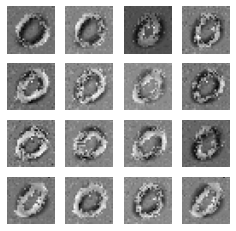

82
gen_loss: tf.Tensor(3.6107578, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0436694, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.047975183, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.77356271e-25]
 [1.00000000e+00 2.26108780e-29]
 [1.00000000e+00 6.41224357e-12]
 [1.00000000e+00 2.81453319e-25]
 [1.00000000e+00 3.32274146e-23]
 [1.00000000e+00 5.66660038e-21]
 [1.00000000e+00 2.02562630e-23]
 [1.00000000e+00 2.04443500e-24]
 [1.00000000e+00 1.62573682e-24]
 [1.00000000e+00 2.30857991e-21]
 [1.00000000e+00 4.34523815e-25]
 [1.00000000e+00 1.49581549e-23]
 [9.99999762e-01 2.57627221e-07]
 [1.00000000e+00 1.03634590e-24]
 [1.00000000e+00 1.59574639e-24]
 [1.00000000e+00 2.42101175e-23]
 [1.00000000e+00 1.57949833e-23]
 [1.00000000e+00 2.37352173e-25]
 [1.00000000e+00 2.58457432e-25]
 [1.00000000e+00 1.20522601e-25]
 [9.96271968e-01 3.72797064e-03]
 [1.00000000e+00 1.25166714e-29]
 [1.00000000e+00 4.81278461e-26]
 [1.00000000e+00 1

gen_loss: tf.Tensor(3.6408653, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.025538482, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048390873, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.69390635e-25]
 [1.00000000e+00 1.78392496e-29]
 [1.00000000e+00 2.90903976e-12]
 [1.00000000e+00 8.84329037e-26]
 [1.00000000e+00 1.33383095e-23]
 [1.00000000e+00 2.39619744e-21]
 [1.00000000e+00 8.13651806e-24]
 [1.00000000e+00 1.01147430e-24]
 [1.00000000e+00 6.79364546e-25]
 [1.00000000e+00 8.22490311e-22]
 [1.00000000e+00 2.01345209e-25]
 [1.00000000e+00 5.34840831e-24]
 [9.99999881e-01 1.57041953e-07]
 [1.00000000e+00 3.20621520e-25]
 [1.00000000e+00 5.82180679e-25]
 [1.00000000e+00 1.15896731e-23]
 [1.00000000e+00 6.56411514e-24]
 [1.00000000e+00 1.08957468e-25]
 [1.00000000e+00 9.02221573e-26]
 [1.00000000e+00 5.97563985e-26]
 [9.97785211e-01 2.21479684e-03]
 [1.00000000e+00 1.10737692e-29]
 [1.00000000e+00 1.90767213e-26]
 [1.00000000e+00 3.

gen_loss: tf.Tensor(3.6026669, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06027406, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.045386575, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.20585084e-26]
 [1.00000000e+00 9.04290614e-30]
 [1.00000000e+00 1.33781311e-12]
 [1.00000000e+00 3.70391087e-26]
 [1.00000000e+00 6.38681589e-24]
 [1.00000000e+00 1.33065593e-21]
 [1.00000000e+00 3.62776028e-24]
 [1.00000000e+00 4.64528633e-25]
 [1.00000000e+00 2.90960868e-25]
 [1.00000000e+00 4.84133555e-22]
 [1.00000000e+00 9.83676823e-26]
 [1.00000000e+00 2.59544369e-24]
 [9.99999881e-01 8.98568260e-08]
 [1.00000000e+00 1.26228567e-25]
 [1.00000000e+00 2.18263219e-25]
 [1.00000000e+00 6.29302861e-24]
 [1.00000000e+00 3.08591855e-24]
 [1.00000000e+00 6.47860770e-26]
 [1.00000000e+00 2.71955267e-26]
 [1.00000000e+00 3.54417918e-26]
 [9.98439372e-01 1.56059489e-03]
 [1.00000000e+00 7.30614765e-30]
 [1.00000000e+00 9.11217546e-27]
 [1.00000000e+00 1.5

gen_loss: tf.Tensor(3.6974537, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.048874162, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.045520104, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.61346579e-26]
 [1.00000000e+00 4.69823914e-30]
 [1.00000000e+00 9.36239476e-13]
 [1.00000000e+00 2.36479915e-26]
 [1.00000000e+00 3.99527322e-24]
 [1.00000000e+00 9.67394391e-22]
 [1.00000000e+00 2.07381987e-24]
 [1.00000000e+00 2.58623117e-25]
 [1.00000000e+00 1.75226283e-25]
 [1.00000000e+00 4.30914449e-22]
 [1.00000000e+00 5.34106288e-26]
 [1.00000000e+00 2.13064980e-24]
 [9.99999881e-01 6.50064962e-08]
 [1.00000000e+00 7.23113170e-26]
 [1.00000000e+00 1.21491975e-25]
 [1.00000000e+00 4.16413718e-24]
 [1.00000000e+00 1.98044615e-24]
 [1.00000000e+00 4.74835624e-26]
 [1.00000000e+00 1.32645621e-26]
 [1.00000000e+00 2.74253503e-26]
 [9.98425126e-01 1.57490547e-03]
 [1.00000000e+00 4.51232747e-30]
 [1.00000000e+00 6.16791198e-27]
 [1.00000000e+00 1.

test_discriminator_output: tf.Tensor(
[[1.0000000e+00 5.7467611e-26]
 [1.0000000e+00 2.8076308e-30]
 [1.0000000e+00 1.5704111e-12]
 [1.0000000e+00 3.8185712e-26]
 [1.0000000e+00 5.3810908e-24]
 [1.0000000e+00 1.2621245e-21]
 [1.0000000e+00 2.7671282e-24]
 [1.0000000e+00 2.4202060e-25]
 [1.0000000e+00 2.5280564e-25]
 [1.0000000e+00 7.6961941e-22]
 [1.0000000e+00 5.1728075e-26]
 [1.0000000e+00 4.3313887e-24]
 [9.9999988e-01 8.3555371e-08]
 [1.0000000e+00 9.7509513e-26]
 [1.0000000e+00 1.7772178e-25]
 [1.0000000e+00 4.9892979e-24]
 [1.0000000e+00 2.5858675e-24]
 [1.0000000e+00 6.0784087e-26]
 [1.0000000e+00 2.0051042e-26]
 [1.0000000e+00 4.2797627e-26]
 [9.9735570e-01 2.6443137e-03]
 [1.0000000e+00 2.7611939e-30]
 [1.0000000e+00 1.0299759e-26]
 [1.0000000e+00 1.8088504e-26]
 [1.0000000e+00 1.8282416e-24]
 [1.0000000e+00 2.1310606e-20]
 [1.0000000e+00 7.7637418e-24]
 [1.0000000e+00 1.9682236e-23]
 [1.0000000e+00 7.5605728e-12]
 [1.0000000e+00 2.0100227e-24]
 [1.0000000e+00 3.0402230e-15]
 

gen_loss: tf.Tensor(3.6913948, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04047821, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.043303587, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.27200299e-26]
 [1.00000000e+00 2.11501432e-30]
 [1.00000000e+00 4.32204012e-12]
 [1.00000000e+00 4.11037885e-26]
 [1.00000000e+00 5.54938522e-24]
 [1.00000000e+00 7.81303895e-22]
 [1.00000000e+00 3.08966426e-24]
 [1.00000000e+00 2.46797797e-25]
 [1.00000000e+00 4.16917376e-25]
 [1.00000000e+00 4.04607516e-22]
 [1.00000000e+00 3.62922362e-26]
 [1.00000000e+00 3.51469719e-24]
 [9.99999881e-01 1.55667593e-07]
 [1.00000000e+00 9.76040403e-26]
 [1.00000000e+00 2.86916896e-25]
 [1.00000000e+00 3.65236564e-24]
 [1.00000000e+00 2.66799247e-24]
 [1.00000000e+00 3.62904366e-26]
 [1.00000000e+00 1.18741920e-25]
 [1.00000000e+00 4.74350444e-26]
 [9.96048152e-01 3.95185826e-03]
 [1.00000000e+00 1.36388998e-30]
 [1.00000000e+00 1.48329547e-26]
 [1.00000000e+00 2.1

gen_loss: tf.Tensor(3.7761264, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.038194194, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05612652, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.31745540e-25]
 [1.00000000e+00 2.02797734e-30]
 [1.00000000e+00 3.71880261e-12]
 [1.00000000e+00 2.47818419e-26]
 [1.00000000e+00 3.04894286e-24]
 [1.00000000e+00 5.51217327e-22]
 [1.00000000e+00 1.86680541e-24]
 [1.00000000e+00 1.75026541e-25]
 [1.00000000e+00 3.52214463e-25]
 [1.00000000e+00 2.68477967e-22]
 [1.00000000e+00 1.87559045e-26]
 [1.00000000e+00 2.62076395e-24]
 [1.00000000e+00 5.85565658e-08]
 [1.00000000e+00 3.24941976e-26]
 [1.00000000e+00 2.01821977e-25]
 [1.00000000e+00 2.21616765e-24]
 [1.00000000e+00 1.50869145e-24]
 [1.00000000e+00 2.58724622e-26]
 [1.00000000e+00 8.14846785e-26]
 [1.00000000e+00 4.12053636e-26]
 [9.98088658e-01 1.91128615e-03]
 [1.00000000e+00 1.52368988e-30]
 [1.00000000e+00 9.97830005e-27]
 [1.00000000e+00 1.3

gen_loss: tf.Tensor(3.6965332, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.061038617, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05365905, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.81757172e-26]
 [1.00000000e+00 3.66839625e-31]
 [1.00000000e+00 8.01469676e-13]
 [1.00000000e+00 8.94865399e-27]
 [1.00000000e+00 1.72263793e-24]
 [1.00000000e+00 4.85574407e-22]
 [1.00000000e+00 4.47587450e-25]
 [1.00000000e+00 5.88041632e-26]
 [1.00000000e+00 5.90584168e-26]
 [1.00000000e+00 2.47105264e-22]
 [1.00000000e+00 5.43347516e-27]
 [1.00000000e+00 8.86315302e-25]
 [1.00000000e+00 2.55325272e-08]
 [1.00000000e+00 1.70624035e-26]
 [1.00000000e+00 2.90843093e-26]
 [1.00000000e+00 1.15104036e-24]
 [1.00000000e+00 6.80202119e-25]
 [1.00000000e+00 1.75115257e-26]
 [1.00000000e+00 5.92357310e-27]
 [1.00000000e+00 1.61205637e-26]
 [9.96875286e-01 3.12466733e-03]
 [1.00000000e+00 3.04136970e-31]
 [1.00000000e+00 3.21142655e-27]
 [1.00000000e+00 6.3

gen_loss: tf.Tensor(3.7092829, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.098272875, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0471431, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.77545579e-26]
 [1.00000000e+00 4.45895523e-31]
 [1.00000000e+00 8.40327211e-13]
 [1.00000000e+00 1.05616026e-26]
 [1.00000000e+00 3.22755695e-24]
 [1.00000000e+00 5.07156682e-22]
 [1.00000000e+00 5.16933846e-25]
 [1.00000000e+00 7.22170419e-26]
 [1.00000000e+00 7.30750021e-26]
 [1.00000000e+00 1.46296161e-22]
 [1.00000000e+00 5.88611376e-27]
 [1.00000000e+00 4.47594254e-25]
 [1.00000000e+00 4.09855616e-08]
 [1.00000000e+00 2.77485244e-26]
 [1.00000000e+00 3.06496251e-26]
 [1.00000000e+00 1.64232360e-24]
 [1.00000000e+00 9.25882396e-25]
 [1.00000000e+00 1.98651230e-26]
 [1.00000000e+00 8.33203131e-27]
 [1.00000000e+00 1.56711456e-26]
 [9.93388653e-01 6.61132624e-03]
 [1.00000000e+00 1.75504704e-31]
 [1.00000000e+00 4.40341965e-27]
 [1.00000000e+00 8.71

gen_loss: tf.Tensor(3.7545166, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051589273, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.047770783, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.68650647e-26]
 [1.00000000e+00 1.14371876e-30]
 [1.00000000e+00 9.72371380e-13]
 [1.00000000e+00 1.75573444e-26]
 [1.00000000e+00 5.07479348e-24]
 [1.00000000e+00 6.36816283e-22]
 [1.00000000e+00 8.28993711e-25]
 [1.00000000e+00 9.17664388e-26]
 [1.00000000e+00 1.77138334e-25]
 [1.00000000e+00 1.54011687e-22]
 [1.00000000e+00 7.94435548e-27]
 [1.00000000e+00 6.80840702e-25]
 [1.00000000e+00 3.56582817e-08]
 [1.00000000e+00 3.12856257e-26]
 [1.00000000e+00 5.65110863e-26]
 [1.00000000e+00 2.71315179e-24]
 [1.00000000e+00 1.22198992e-24]
 [1.00000000e+00 3.26257340e-26]
 [1.00000000e+00 1.19633445e-26]
 [1.00000000e+00 2.51421588e-26]
 [9.94745851e-01 5.25416387e-03]
 [1.00000000e+00 2.96037273e-31]
 [1.00000000e+00 7.97709244e-27]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.6689503, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0397369, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.043968167, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.84528693e-26]
 [1.00000000e+00 6.92135635e-31]
 [1.00000000e+00 1.28741158e-12]
 [1.00000000e+00 2.86236793e-26]
 [1.00000000e+00 3.92263373e-24]
 [1.00000000e+00 6.44935164e-22]
 [1.00000000e+00 9.26214408e-25]
 [1.00000000e+00 4.47097457e-26]
 [1.00000000e+00 3.34282520e-25]
 [1.00000000e+00 2.44036431e-22]
 [1.00000000e+00 4.42997244e-27]
 [1.00000000e+00 2.39665074e-24]
 [1.00000000e+00 3.43182762e-08]
 [1.00000000e+00 2.01942783e-26]
 [1.00000000e+00 1.00224045e-25]
 [1.00000000e+00 2.41546645e-24]
 [1.00000000e+00 1.19320004e-24]
 [1.00000000e+00 3.34594922e-26]
 [1.00000000e+00 1.26068262e-26]
 [1.00000000e+00 3.19269049e-26]
 [9.95436966e-01 4.56299819e-03]
 [1.00000000e+00 1.72725765e-31]
 [1.00000000e+00 1.04534193e-26]
 [1.00000000e+00 2.04

gen_loss: tf.Tensor(3.7057304, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.045266487, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05287586, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.44704038e-26]
 [1.00000000e+00 3.41301399e-31]
 [1.00000000e+00 1.28136553e-12]
 [1.00000000e+00 2.86075230e-26]
 [1.00000000e+00 2.57011317e-24]
 [1.00000000e+00 4.46144286e-22]
 [1.00000000e+00 7.03879977e-25]
 [1.00000000e+00 2.61574751e-26]
 [1.00000000e+00 3.63389417e-25]
 [1.00000000e+00 2.18382649e-22]
 [1.00000000e+00 2.59116618e-27]
 [1.00000000e+00 3.83722218e-24]
 [1.00000000e+00 5.50177219e-08]
 [1.00000000e+00 1.42757631e-26]
 [1.00000000e+00 1.17154559e-25]
 [1.00000000e+00 1.41971948e-24]
 [1.00000000e+00 8.71134167e-25]
 [1.00000000e+00 2.02038325e-26]
 [1.00000000e+00 2.12847044e-26]
 [1.00000000e+00 2.28546763e-26]
 [9.95907426e-01 4.09255689e-03]
 [1.00000000e+00 8.38183661e-32]
 [1.00000000e+00 9.12995564e-27]
 [1.00000000e+00 1.9

gen_loss: tf.Tensor(3.6921663, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03287151, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04750123, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.63377377e-26]
 [1.00000000e+00 2.17523725e-30]
 [1.00000000e+00 3.06113831e-13]
 [1.00000000e+00 7.29872136e-27]
 [1.00000000e+00 1.04833008e-24]
 [1.00000000e+00 1.95491269e-22]
 [1.00000000e+00 2.15421051e-25]
 [1.00000000e+00 3.77988989e-26]
 [1.00000000e+00 1.26164065e-25]
 [1.00000000e+00 6.51400504e-23]
 [1.00000000e+00 2.49829610e-27]
 [1.00000000e+00 1.18064917e-24]
 [1.00000000e+00 3.51160345e-08]
 [1.00000000e+00 8.31748669e-27]
 [1.00000000e+00 3.48776792e-26]
 [1.00000000e+00 7.59950041e-25]
 [1.00000000e+00 3.87727181e-25]
 [1.00000000e+00 8.15219491e-27]
 [1.00000000e+00 1.86112225e-26]
 [1.00000000e+00 6.97507038e-27]
 [9.99060214e-01 9.39795224e-04]
 [1.00000000e+00 6.38564831e-31]
 [1.00000000e+00 2.97058246e-27]
 [1.00000000e+00 4.95

gen_loss: tf.Tensor(3.7844305, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.032351144, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04749271, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.23148829e-26]
 [1.00000000e+00 1.62157584e-30]
 [1.00000000e+00 1.49528122e-13]
 [1.00000000e+00 6.82358520e-27]
 [1.00000000e+00 1.10848279e-24]
 [1.00000000e+00 2.49639716e-22]
 [1.00000000e+00 1.49712697e-25]
 [1.00000000e+00 3.16259267e-26]
 [1.00000000e+00 7.07300638e-26]
 [1.00000000e+00 9.80344331e-23]
 [1.00000000e+00 3.24923217e-27]
 [1.00000000e+00 1.40613165e-24]
 [1.00000000e+00 2.78774763e-08]
 [1.00000000e+00 1.30715238e-26]
 [1.00000000e+00 1.99331376e-26]
 [1.00000000e+00 8.81187608e-25]
 [1.00000000e+00 4.32377620e-25]
 [1.00000000e+00 9.21702000e-27]
 [1.00000000e+00 1.65445795e-26]
 [1.00000000e+00 6.97131943e-27]
 [9.99015212e-01 9.84787708e-04]
 [1.00000000e+00 5.80737185e-31]
 [1.00000000e+00 3.36659911e-27]
 [1.00000000e+00 5.2

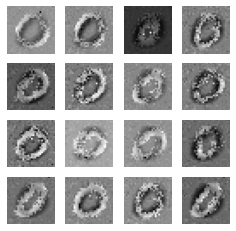

83
gen_loss: tf.Tensor(3.8356447, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05921069, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.044756114, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.69427469e-27]
 [1.00000000e+00 8.73394089e-31]
 [1.00000000e+00 1.23954652e-13]
 [1.00000000e+00 4.85378681e-27]
 [1.00000000e+00 7.92305762e-25]
 [1.00000000e+00 1.70123294e-22]
 [1.00000000e+00 1.03935037e-25]
 [1.00000000e+00 2.01087979e-26]
 [1.00000000e+00 4.49093953e-26]
 [1.00000000e+00 6.31113400e-23]
 [1.00000000e+00 2.86009610e-27]
 [1.00000000e+00 8.32536781e-25]
 [1.00000000e+00 2.25608883e-08]
 [1.00000000e+00 1.04580862e-26]
 [1.00000000e+00 1.28592008e-26]
 [1.00000000e+00 5.97092665e-25]
 [1.00000000e+00 3.02193853e-25]
 [1.00000000e+00 7.58258187e-27]
 [1.00000000e+00 1.39407576e-26]
 [1.00000000e+00 5.68095485e-27]
 [9.98946726e-01 1.05326273e-03]
 [1.00000000e+00 3.00983800e-31]
 [1.00000000e+00 2.79072122e-27]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.6828167, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036205463, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051771156, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.97513118e-27]
 [1.00000000e+00 4.50243818e-31]
 [1.00000000e+00 1.06342608e-13]
 [1.00000000e+00 2.46444731e-27]
 [1.00000000e+00 2.32033525e-25]
 [1.00000000e+00 5.05364270e-23]
 [1.00000000e+00 4.89760903e-26]
 [1.00000000e+00 4.45921962e-27]
 [1.00000000e+00 2.31410220e-26]
 [1.00000000e+00 1.95269816e-23]
 [1.00000000e+00 9.94819372e-28]
 [1.00000000e+00 4.74368785e-25]
 [1.00000000e+00 7.12423320e-09]
 [1.00000000e+00 5.75682917e-27]
 [1.00000000e+00 7.20813178e-27]
 [1.00000000e+00 2.19549210e-25]
 [1.00000000e+00 1.34889348e-25]
 [1.00000000e+00 3.30687795e-27]
 [1.00000000e+00 7.50654461e-27]
 [1.00000000e+00 2.54597731e-27]
 [9.99260247e-01 7.39782292e-04]
 [1.00000000e+00 1.24153691e-31]
 [1.00000000e+00 1.28463976e-27]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.5462987, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05709159, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.058988117, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.19483854e-26]
 [1.00000000e+00 1.49032531e-30]
 [1.00000000e+00 2.07613481e-13]
 [1.00000000e+00 6.42142291e-27]
 [1.00000000e+00 5.66265608e-25]
 [1.00000000e+00 9.80991513e-23]
 [1.00000000e+00 1.09544270e-25]
 [1.00000000e+00 1.03317128e-26]
 [1.00000000e+00 4.83490322e-26]
 [1.00000000e+00 4.09773545e-23]
 [1.00000000e+00 1.98282423e-27]
 [1.00000000e+00 6.98066713e-25]
 [1.00000000e+00 6.70757538e-09]
 [1.00000000e+00 2.31787471e-26]
 [1.00000000e+00 1.64734156e-26]
 [1.00000000e+00 4.93412282e-25]
 [1.00000000e+00 2.45664992e-25]
 [1.00000000e+00 1.13278770e-26]
 [1.00000000e+00 1.42726601e-26]
 [1.00000000e+00 6.76748825e-27]
 [9.98915792e-01 1.08417880e-03]
 [1.00000000e+00 2.51584990e-31]
 [1.00000000e+00 3.51006934e-27]
 [1.00000000e+00 5.6

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.33824752e-26]
 [1.00000000e+00 1.53215288e-30]
 [1.00000000e+00 2.57479856e-13]
 [1.00000000e+00 1.27340886e-26]
 [1.00000000e+00 1.08311056e-24]
 [1.00000000e+00 1.69633380e-22]
 [1.00000000e+00 1.87617106e-25]
 [1.00000000e+00 1.37203866e-26]
 [1.00000000e+00 7.46075801e-26]
 [1.00000000e+00 8.45077405e-23]
 [1.00000000e+00 2.56817847e-27]
 [1.00000000e+00 1.25184702e-24]
 [1.00000000e+00 7.21961824e-09]
 [1.00000000e+00 4.38006790e-26]
 [1.00000000e+00 2.60770730e-26]
 [1.00000000e+00 8.83944973e-25]
 [1.00000000e+00 3.63949878e-25]
 [1.00000000e+00 2.49482130e-26]
 [1.00000000e+00 1.50951308e-26]
 [1.00000000e+00 1.34497241e-26]
 [9.98532057e-01 1.46798696e-03]
 [1.00000000e+00 2.43969221e-31]
 [1.00000000e+00 6.90438798e-27]
 [1.00000000e+00 1.25665904e-26]
 [1.00000000e+00 2.56389359e-25]
 [1.00000000e+00 9.14308823e-21]
 [1.00000000e+00 1.09552684e-24]
 [1.00000000e+00 1.10785713e-24]
 [1.00000000e+00 9.59024526e-14]
 [1.0

gen_loss: tf.Tensor(3.7286878, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044176847, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04611256, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.70022390e-26]
 [1.00000000e+00 1.07617994e-30]
 [1.00000000e+00 3.83601408e-13]
 [1.00000000e+00 8.18188905e-26]
 [1.00000000e+00 5.04710919e-24]
 [1.00000000e+00 8.06680377e-22]
 [1.00000000e+00 7.74572268e-25]
 [1.00000000e+00 2.76083074e-26]
 [1.00000000e+00 2.39828654e-25]
 [1.00000000e+00 6.84511091e-22]
 [1.00000000e+00 5.50986794e-27]
 [1.00000000e+00 8.42977710e-24]
 [1.00000000e+00 9.88309790e-09]
 [1.00000000e+00 1.79698767e-25]
 [1.00000000e+00 9.05307190e-26]
 [1.00000000e+00 3.89650468e-24]
 [1.00000000e+00 1.21820595e-24]
 [1.00000000e+00 1.86182624e-25]
 [1.00000000e+00 1.78182601e-26]
 [1.00000000e+00 7.83863718e-26]
 [9.97041881e-01 2.95804860e-03]
 [1.00000000e+00 2.02192787e-31]
 [1.00000000e+00 3.86461509e-26]
 [1.00000000e+00 9.8

gen_loss: tf.Tensor(3.9041567, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.068384975, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.036058195, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.86403110e-27]
 [1.00000000e+00 6.28151784e-31]
 [1.00000000e+00 1.46611374e-13]
 [1.00000000e+00 6.24185821e-26]
 [1.00000000e+00 2.92224628e-24]
 [1.00000000e+00 7.18256819e-22]
 [1.00000000e+00 5.13400390e-25]
 [1.00000000e+00 1.35216938e-26]
 [1.00000000e+00 1.23659654e-25]
 [1.00000000e+00 6.03249936e-22]
 [1.00000000e+00 1.93763132e-27]
 [1.00000000e+00 8.07871349e-24]
 [1.00000000e+00 5.65782265e-09]
 [1.00000000e+00 9.84758118e-26]
 [1.00000000e+00 4.54063715e-26]
 [1.00000000e+00 3.36461403e-24]
 [1.00000000e+00 7.62272792e-25]
 [1.00000000e+00 2.07758771e-25]
 [1.00000000e+00 3.48458774e-27]
 [1.00000000e+00 6.23410088e-26]
 [9.97790098e-01 2.20992346e-03]
 [1.00000000e+00 1.92221127e-31]
 [1.00000000e+00 2.14562262e-26]
 [1.00000000e+00 8.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.15782627e-27]
 [1.00000000e+00 7.21664617e-31]
 [1.00000000e+00 1.09585897e-13]
 [1.00000000e+00 3.93630036e-26]
 [1.00000000e+00 1.86068405e-24]
 [1.00000000e+00 5.34462023e-22]
 [1.00000000e+00 3.51181425e-25]
 [1.00000000e+00 1.02146170e-26]
 [1.00000000e+00 8.42732463e-26]
 [1.00000000e+00 3.68947822e-22]
 [1.00000000e+00 1.13683465e-27]
 [1.00000000e+00 5.10475244e-24]
 [1.00000000e+00 4.87502261e-09]
 [1.00000000e+00 7.23714800e-26]
 [1.00000000e+00 3.00136121e-26]
 [1.00000000e+00 2.61680801e-24]
 [1.00000000e+00 5.42693458e-25]
 [1.00000000e+00 1.54640194e-25]
 [1.00000000e+00 1.97263933e-27]
 [1.00000000e+00 4.29241775e-26]
 [9.98269081e-01 1.73084391e-03]
 [1.00000000e+00 2.37729297e-31]
 [1.00000000e+00 1.27025041e-26]
 [1.00000000e+00 5.50781143e-26]
 [1.00000000e+00 2.34385662e-25]
 [1.00000000e+00 3.07169029e-20]
 [1.00000000e+00 4.24420873e-25]
 [1.00000000e+00 1.03810269e-24]
 [1.00000000e+00 4.33007241e-14]
 [1.0

gen_loss: tf.Tensor(3.708447, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04876613, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.044252574, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.85226898e-26]
 [1.00000000e+00 1.67624441e-30]
 [1.00000000e+00 3.10775521e-13]
 [1.00000000e+00 1.05789464e-25]
 [1.00000000e+00 4.38731343e-24]
 [1.00000000e+00 1.09629351e-21]
 [1.00000000e+00 8.44847646e-25]
 [1.00000000e+00 2.67371554e-26]
 [1.00000000e+00 2.34276602e-25]
 [1.00000000e+00 8.41590539e-22]
 [1.00000000e+00 2.77983066e-27]
 [1.00000000e+00 8.93403513e-24]
 [1.00000000e+00 9.16858856e-09]
 [1.00000000e+00 3.60509236e-25]
 [1.00000000e+00 9.45552593e-26]
 [1.00000000e+00 5.76257211e-24]
 [1.00000000e+00 1.77580222e-24]
 [1.00000000e+00 3.72930492e-25]
 [1.00000000e+00 1.08182112e-26]
 [1.00000000e+00 1.09082651e-25]
 [9.97187078e-01 2.81296880e-03]
 [1.00000000e+00 3.73555836e-31]
 [1.00000000e+00 3.73489832e-26]
 [1.00000000e+00 1.37

gen_loss: tf.Tensor(3.8213587, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.035722677, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.044125028, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.53204121e-26]
 [1.00000000e+00 1.93367786e-30]
 [1.00000000e+00 6.08716202e-13]
 [1.00000000e+00 1.40848230e-25]
 [1.00000000e+00 3.09438224e-24]
 [1.00000000e+00 7.09683100e-22]
 [1.00000000e+00 1.04145042e-24]
 [1.00000000e+00 2.21938019e-26]
 [1.00000000e+00 4.46114647e-25]
 [1.00000000e+00 6.22351629e-22]
 [1.00000000e+00 2.40494454e-27]
 [1.00000000e+00 1.55323194e-23]
 [1.00000000e+00 8.22891177e-09]
 [1.00000000e+00 3.77314957e-25]
 [1.00000000e+00 2.07241895e-25]
 [1.00000000e+00 5.07762076e-24]
 [1.00000000e+00 2.45337339e-24]
 [1.00000000e+00 2.63574156e-25]
 [1.00000000e+00 2.73563866e-26]
 [1.00000000e+00 1.07361985e-25]
 [9.98635471e-01 1.36445404e-03]
 [1.00000000e+00 3.97005444e-31]
 [1.00000000e+00 4.38102039e-26]
 [1.00000000e+00 1.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.95386502e-26]
 [1.00000000e+00 1.18813656e-30]
 [1.00000000e+00 6.25146744e-13]
 [1.00000000e+00 1.38836068e-25]
 [1.00000000e+00 2.07585395e-24]
 [1.00000000e+00 5.23876746e-22]
 [1.00000000e+00 9.42103841e-25]
 [1.00000000e+00 1.41770477e-26]
 [1.00000000e+00 4.84970188e-25]
 [1.00000000e+00 5.46938142e-22]
 [1.00000000e+00 1.68344323e-27]
 [1.00000000e+00 2.25215907e-23]
 [1.00000000e+00 6.34482955e-09]
 [1.00000000e+00 2.84408392e-25]
 [1.00000000e+00 2.33782035e-25]
 [1.00000000e+00 4.19340432e-24]
 [1.00000000e+00 2.52307694e-24]
 [1.00000000e+00 1.87303892e-25]
 [1.00000000e+00 2.33257233e-26]
 [1.00000000e+00 9.14048447e-26]
 [9.99078274e-01 9.21735715e-04]
 [1.00000000e+00 2.64462649e-31]
 [1.00000000e+00 3.66854556e-26]
 [1.00000000e+00 1.38006014e-25]
 [1.00000000e+00 2.50399489e-25]
 [1.00000000e+00 2.79659231e-20]
 [1.00000000e+00 5.91556242e-25]
 [1.00000000e+00 1.52030970e-24]
 [1.00000000e+00 1.37083846e-14]
 [1.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.21160992e-26]
 [1.00000000e+00 5.14771593e-31]
 [1.00000000e+00 6.94715769e-13]
 [1.00000000e+00 1.45584453e-25]
 [1.00000000e+00 1.69630614e-24]
 [1.00000000e+00 4.85170762e-22]
 [1.00000000e+00 8.37934069e-25]
 [1.00000000e+00 9.35384885e-27]
 [1.00000000e+00 4.83120013e-25]
 [1.00000000e+00 6.75620717e-22]
 [1.00000000e+00 1.38184973e-27]
 [1.00000000e+00 3.59920091e-23]
 [1.00000000e+00 6.42216769e-09]
 [1.00000000e+00 2.37582250e-25]
 [1.00000000e+00 2.43111548e-25]
 [1.00000000e+00 3.69471367e-24]
 [1.00000000e+00 2.69791830e-24]
 [1.00000000e+00 1.64609239e-25]
 [1.00000000e+00 1.60385529e-26]
 [1.00000000e+00 9.57227796e-26]
 [9.99035716e-01 9.64266423e-04]
 [1.00000000e+00 1.16930960e-31]
 [1.00000000e+00 3.66237920e-26]
 [1.00000000e+00 1.41877127e-25]
 [1.00000000e+00 1.85177529e-25]
 [1.00000000e+00 1.94625355e-20]
 [1.00000000e+00 5.03793100e-25]
 [1.00000000e+00 1.16707228e-24]
 [1.00000000e+00 2.12654381e-14]
 [1.0

gen_loss: tf.Tensor(3.5026531, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.064689465, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05394171, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.47887659e-27]
 [1.00000000e+00 1.36376952e-31]
 [1.00000000e+00 6.33917940e-13]
 [1.00000000e+00 7.52527081e-26]
 [1.00000000e+00 6.96741821e-25]
 [1.00000000e+00 2.35465918e-22]
 [1.00000000e+00 3.78621261e-25]
 [1.00000000e+00 5.10996592e-27]
 [1.00000000e+00 2.42199773e-25]
 [1.00000000e+00 4.15519191e-22]
 [1.00000000e+00 6.29119172e-28]
 [1.00000000e+00 2.49247561e-23]
 [1.00000000e+00 1.12355814e-08]
 [1.00000000e+00 1.08259363e-25]
 [1.00000000e+00 1.29483518e-25]
 [1.00000000e+00 1.76241308e-24]
 [1.00000000e+00 1.60456073e-24]
 [1.00000000e+00 6.65304703e-26]
 [1.00000000e+00 4.78034070e-27]
 [1.00000000e+00 4.72632699e-26]
 [9.98497725e-01 1.50230050e-03]
 [1.00000000e+00 2.86958566e-32]
 [1.00000000e+00 1.63310077e-26]
 [1.00000000e+00 7.0

gen_loss: tf.Tensor(3.777646, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07878496, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.043929458, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.26837630e-27]
 [1.00000000e+00 2.20411186e-31]
 [1.00000000e+00 3.49630318e-13]
 [1.00000000e+00 2.51959246e-26]
 [1.00000000e+00 4.08463721e-25]
 [1.00000000e+00 1.03690061e-22]
 [1.00000000e+00 1.63069246e-25]
 [1.00000000e+00 7.63273000e-27]
 [1.00000000e+00 8.24228683e-26]
 [1.00000000e+00 7.94673611e-23]
 [1.00000000e+00 5.47276683e-28]
 [1.00000000e+00 3.25120857e-24]
 [1.00000000e+00 1.63481122e-08]
 [1.00000000e+00 5.45561781e-26]
 [1.00000000e+00 4.71930089e-26]
 [1.00000000e+00 9.64658657e-25]
 [1.00000000e+00 6.88692827e-25]
 [1.00000000e+00 3.56775502e-26]
 [1.00000000e+00 2.15668312e-27]
 [1.00000000e+00 2.02306707e-26]
 [9.98469532e-01 1.53050618e-03]
 [1.00000000e+00 4.01263872e-32]
 [1.00000000e+00 5.65811601e-27]
 [1.00000000e+00 2.36

 [1.00000000e+00 6.37196156e-27]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.6040683, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.032249466, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.052905627, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.99785746e-27]
 [1.00000000e+00 2.03208837e-31]
 [1.00000000e+00 2.73479075e-13]
 [1.00000000e+00 2.21001940e-26]
 [1.00000000e+00 3.42640871e-25]
 [1.00000000e+00 6.87937323e-23]
 [1.00000000e+00 1.55035339e-25]
 [1.00000000e+00 3.98450639e-27]
 [1.00000000e+00 7.14268930e-26]
 [1.00000000e+00 2.42446822e-23]
 [1.00000000e+00 3.64708154e-28]
 [1.00000000e+00 2.97468068e-24]
 [1.00000000e+00 1.23367894e-08]
 [1.00000000e+00 2.48837714e-26]
 [1.00000000e+00 4.64790744e-26]
 [1.00000000e+00 7.94903235e-25]
 [1.00000000e+00 4.10738722e-25]
 [1.00000000e+00 2.39087732e-26]
 [1.00000000e+00 1.25406755e-27]
 [1.00000000e+00 1.55725796e-26]
 [9.98695791e-01 1.30424195e-03]
 [1.00000000e+00 5.

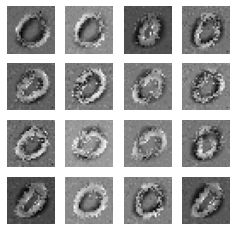

84
gen_loss: tf.Tensor(3.5365272, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04164771, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049114104, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.23244709e-27]
 [1.00000000e+00 1.50437016e-31]
 [1.00000000e+00 4.21033813e-13]
 [1.00000000e+00 4.77281802e-26]
 [1.00000000e+00 6.98922035e-25]
 [1.00000000e+00 1.17930906e-22]
 [1.00000000e+00 3.12291223e-25]
 [1.00000000e+00 4.52724808e-27]
 [1.00000000e+00 1.32388880e-25]
 [1.00000000e+00 3.82624676e-23]
 [1.00000000e+00 6.41219116e-28]
 [1.00000000e+00 6.32918921e-24]
 [1.00000000e+00 1.54613797e-08]
 [1.00000000e+00 3.96089772e-26]
 [1.00000000e+00 9.81244482e-26]
 [1.00000000e+00 1.37615996e-24]
 [1.00000000e+00 7.11715338e-25]
 [1.00000000e+00 4.26189068e-26]
 [1.00000000e+00 1.97525224e-27]
 [1.00000000e+00 3.09689443e-26]
 [9.97891366e-01 2.10865820e-03]
 [1.00000000e+00 4.14848707e-32]
 [1.00000000e+00 7.19181684e-27]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.7607024, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044050403, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04121998, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.44094460e-27]
 [1.00000000e+00 1.17501522e-31]
 [1.00000000e+00 7.24598007e-13]
 [1.00000000e+00 9.11193695e-26]
 [1.00000000e+00 1.33501120e-24]
 [1.00000000e+00 2.09870777e-22]
 [1.00000000e+00 5.74593070e-25]
 [1.00000000e+00 5.25604886e-27]
 [1.00000000e+00 2.40846334e-25]
 [1.00000000e+00 7.31149861e-23]
 [1.00000000e+00 1.05012563e-27]
 [1.00000000e+00 1.32969558e-23]
 [1.00000000e+00 2.05132231e-08]
 [1.00000000e+00 7.06386545e-26]
 [1.00000000e+00 2.00697234e-25]
 [1.00000000e+00 2.33689413e-24]
 [1.00000000e+00 1.27902338e-24]
 [1.00000000e+00 7.53087049e-26]
 [1.00000000e+00 3.04242023e-27]
 [1.00000000e+00 5.91695907e-26]
 [9.96405005e-01 3.59501829e-03]
 [1.00000000e+00 2.76618829e-32]
 [1.00000000e+00 1.46744121e-26]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.6961212, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.05856356, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048332892, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.77527812e-27]
 [1.00000000e+00 2.51890384e-31]
 [1.00000000e+00 3.96738089e-13]
 [1.00000000e+00 2.30017896e-26]
 [1.00000000e+00 4.84953523e-25]
 [1.00000000e+00 8.65421497e-23]
 [1.00000000e+00 2.28791997e-25]
 [1.00000000e+00 4.21181812e-27]
 [1.00000000e+00 1.24326586e-25]
 [1.00000000e+00 2.00033227e-23]
 [1.00000000e+00 6.78208622e-28]
 [1.00000000e+00 3.35538554e-24]
 [1.00000000e+00 1.67736971e-08]
 [1.00000000e+00 2.08832158e-26]
 [1.00000000e+00 1.22553720e-25]
 [1.00000000e+00 9.90262222e-25]
 [1.00000000e+00 4.83123662e-25]
 [1.00000000e+00 3.15762593e-26]
 [1.00000000e+00 1.61250449e-27]
 [1.00000000e+00 2.14527888e-26]
 [9.98951912e-01 1.04802183e-03]
 [1.00000000e+00 4.19437896e-32]
 [1.00000000e+00 4.83929226e-27]
 [1.00000000e+00 2.3

gen_loss: tf.Tensor(3.7067513, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.040455606, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04872156, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.11909019e-27]
 [1.00000000e+00 1.63532223e-31]
 [1.00000000e+00 2.19890417e-13]
 [1.00000000e+00 1.71824552e-26]
 [1.00000000e+00 4.39922681e-25]
 [1.00000000e+00 8.67570038e-23]
 [1.00000000e+00 2.09727201e-25]
 [1.00000000e+00 3.43643218e-27]
 [1.00000000e+00 1.00212957e-25]
 [1.00000000e+00 1.75823717e-23]
 [1.00000000e+00 7.54751482e-28]
 [1.00000000e+00 3.04912884e-24]
 [1.00000000e+00 1.52420103e-08]
 [1.00000000e+00 1.17120545e-26]
 [1.00000000e+00 1.14515351e-25]
 [1.00000000e+00 9.55929220e-25]
 [1.00000000e+00 4.05257199e-25]
 [1.00000000e+00 3.07061488e-26]
 [1.00000000e+00 8.02831360e-28]
 [1.00000000e+00 1.91113911e-26]
 [9.99496937e-01 5.03005111e-04]
 [1.00000000e+00 3.52265623e-32]
 [1.00000000e+00 3.87929476e-27]
 [1.00000000e+00 2.0

gen_loss: tf.Tensor(3.8790376, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.040477723, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04080961, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.68588531e-27]
 [1.00000000e+00 9.19708249e-32]
 [1.00000000e+00 2.24188032e-13]
 [1.00000000e+00 4.06345241e-26]
 [1.00000000e+00 1.14490953e-24]
 [1.00000000e+00 2.41751536e-22]
 [1.00000000e+00 4.02557766e-25]
 [1.00000000e+00 6.80211801e-27]
 [1.00000000e+00 1.32365153e-25]
 [1.00000000e+00 6.93893790e-23]
 [1.00000000e+00 2.78369330e-27]
 [1.00000000e+00 6.82882965e-24]
 [1.00000000e+00 1.97385521e-08]
 [1.00000000e+00 2.71484693e-26]
 [1.00000000e+00 1.79671342e-25]
 [1.00000000e+00 1.98963894e-24]
 [1.00000000e+00 8.70801860e-25]
 [1.00000000e+00 9.35885103e-26]
 [1.00000000e+00 1.06901707e-27]
 [1.00000000e+00 4.96216929e-26]
 [9.99387145e-01 6.12820266e-04]
 [1.00000000e+00 2.45134271e-32]
 [1.00000000e+00 1.04013113e-26]
 [1.00000000e+00 5.5

gen_loss: tf.Tensor(3.9069695, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07238218, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03726878, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.50798138e-27]
 [1.00000000e+00 1.78880823e-32]
 [1.00000000e+00 1.33357816e-13]
 [1.00000000e+00 1.15612627e-26]
 [1.00000000e+00 3.99035157e-25]
 [1.00000000e+00 8.30998699e-23]
 [1.00000000e+00 1.32369196e-25]
 [1.00000000e+00 4.30456590e-27]
 [1.00000000e+00 3.09012070e-26]
 [1.00000000e+00 2.57514886e-23]
 [1.00000000e+00 1.91292510e-27]
 [1.00000000e+00 1.15697890e-24]
 [1.00000000e+00 1.69906915e-08]
 [1.00000000e+00 1.07251818e-26]
 [1.00000000e+00 4.41656042e-26]
 [1.00000000e+00 5.45116888e-25]
 [1.00000000e+00 2.13210417e-25]
 [1.00000000e+00 4.20397104e-26]
 [1.00000000e+00 3.85933707e-28]
 [1.00000000e+00 1.98163816e-26]
 [9.99282300e-01 7.17693125e-04]
 [1.00000000e+00 4.64461181e-33]
 [1.00000000e+00 4.06501642e-27]
 [1.00000000e+00 1.74

gen_loss: tf.Tensor(3.728252, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036626365, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04101219, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.10008560e-27]
 [1.00000000e+00 7.63963917e-33]
 [1.00000000e+00 8.22823187e-14]
 [1.00000000e+00 2.72762409e-27]
 [1.00000000e+00 8.05584017e-26]
 [1.00000000e+00 1.83314503e-23]
 [1.00000000e+00 3.58699676e-26]
 [1.00000000e+00 2.04341822e-27]
 [1.00000000e+00 8.95620132e-27]
 [1.00000000e+00 5.30243586e-24]
 [1.00000000e+00 6.02139879e-28]
 [1.00000000e+00 2.28713456e-25]
 [1.00000000e+00 1.37366420e-08]
 [1.00000000e+00 2.49187139e-27]
 [1.00000000e+00 1.21666757e-26]
 [1.00000000e+00 1.10420707e-25]
 [1.00000000e+00 3.74017352e-26]
 [1.00000000e+00 1.16695531e-26]
 [1.00000000e+00 1.43845866e-28]
 [1.00000000e+00 4.72657721e-27]
 [9.99503851e-01 4.96185443e-04]
 [1.00000000e+00 1.91575273e-33]
 [1.00000000e+00 1.00720281e-27]
 [1.00000000e+00 3.83

gen_loss: tf.Tensor(3.6918, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04776334, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04709647, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.11534397e-27]
 [1.00000000e+00 1.08876476e-32]
 [1.00000000e+00 1.01515218e-13]
 [1.00000000e+00 3.77090111e-27]
 [1.00000000e+00 5.94778135e-26]
 [1.00000000e+00 1.57034233e-23]
 [1.00000000e+00 3.79297635e-26]
 [1.00000000e+00 1.24733094e-27]
 [1.00000000e+00 1.60981951e-26]
 [1.00000000e+00 5.86049145e-24]
 [1.00000000e+00 3.02281012e-28]
 [1.00000000e+00 6.69380723e-25]
 [1.00000000e+00 7.40072892e-09]
 [1.00000000e+00 2.54557922e-27]
 [1.00000000e+00 2.03921438e-26]
 [1.00000000e+00 1.05743476e-25]
 [1.00000000e+00 2.99104008e-26]
 [1.00000000e+00 1.05560035e-26]
 [1.00000000e+00 1.79162546e-28]
 [1.00000000e+00 4.19558985e-27]
 [9.99748051e-01 2.51900026e-04]
 [1.00000000e+00 2.68428323e-33]
 [1.00000000e+00 1.01673000e-27]
 [1.00000000e+00 4.27374

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.24199480e-28]
 [1.00000000e+00 6.73065143e-33]
 [1.00000000e+00 8.65871231e-14]
 [1.00000000e+00 5.80352989e-27]
 [1.00000000e+00 6.03934838e-26]
 [1.00000000e+00 2.13077279e-23]
 [1.00000000e+00 4.28115060e-26]
 [1.00000000e+00 6.30637720e-28]
 [1.00000000e+00 2.24297314e-26]
 [1.00000000e+00 1.00897377e-23]
 [1.00000000e+00 1.90561909e-28]
 [1.00000000e+00 2.22516402e-24]
 [1.00000000e+00 3.85275500e-09]
 [1.00000000e+00 2.81500276e-27]
 [1.00000000e+00 2.78680769e-26]
 [1.00000000e+00 1.37637986e-25]
 [1.00000000e+00 3.82236019e-26]
 [1.00000000e+00 1.17077212e-26]
 [1.00000000e+00 1.22283612e-28]
 [1.00000000e+00 4.87261663e-27]
 [9.99825776e-01 1.74273431e-04]
 [1.00000000e+00 1.97617314e-33]
 [1.00000000e+00 1.20257955e-27]
 [1.00000000e+00 6.13108204e-27]
 [1.00000000e+00 1.61384600e-27]
 [1.00000000e+00 2.84390531e-21]
 [1.00000000e+00 1.14743116e-26]
 [1.00000000e+00 6.98922035e-25]
 [1.00000000e+00 3.41486686e-14]
 [1.0

gen_loss: tf.Tensor(3.7768612, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07119337, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048740998, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.27108187e-28]
 [1.00000000e+00 2.37393766e-33]
 [1.00000000e+00 4.15124817e-14]
 [1.00000000e+00 5.15645248e-27]
 [1.00000000e+00 4.67333126e-26]
 [1.00000000e+00 1.62951274e-23]
 [1.00000000e+00 3.32375048e-26]
 [1.00000000e+00 1.82129092e-28]
 [1.00000000e+00 1.77982890e-26]
 [1.00000000e+00 6.20639275e-24]
 [1.00000000e+00 1.20361148e-28]
 [1.00000000e+00 3.44404878e-24]
 [1.00000000e+00 1.31784317e-09]
 [1.00000000e+00 2.03417106e-27]
 [1.00000000e+00 2.15157313e-26]
 [1.00000000e+00 1.18873351e-25]
 [1.00000000e+00 3.29495490e-26]
 [1.00000000e+00 7.43098730e-27]
 [1.00000000e+00 4.61231092e-29]
 [1.00000000e+00 3.33346233e-27]
 [9.99936461e-01 6.34820390e-05]
 [1.00000000e+00 1.16577209e-33]
 [1.00000000e+00 8.64541574e-28]
 [1.00000000e+00 5.6

gen_loss: tf.Tensor(3.6372142, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10167006, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.045853652, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.75072557e-28]
 [1.00000000e+00 2.95824743e-33]
 [1.00000000e+00 4.23716306e-14]
 [1.00000000e+00 3.97003225e-27]
 [1.00000000e+00 6.40496137e-26]
 [1.00000000e+00 1.06756854e-23]
 [1.00000000e+00 3.19604161e-26]
 [1.00000000e+00 3.14725649e-28]
 [1.00000000e+00 1.37060530e-26]
 [1.00000000e+00 2.80528404e-24]
 [1.00000000e+00 2.79240222e-28]
 [1.00000000e+00 1.32023317e-24]
 [1.00000000e+00 2.14090723e-09]
 [1.00000000e+00 4.73995626e-27]
 [1.00000000e+00 1.84349275e-26]
 [1.00000000e+00 8.49426318e-26]
 [1.00000000e+00 3.57754029e-26]
 [1.00000000e+00 6.41571792e-27]
 [1.00000000e+00 9.98544843e-29]
 [1.00000000e+00 2.52155267e-27]
 [9.99940038e-01 5.99284285e-05]
 [1.00000000e+00 1.31469887e-33]
 [1.00000000e+00 8.08073116e-28]
 [1.00000000e+00 4.4

gen_loss: tf.Tensor(3.671116, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.039828666, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04770596, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.20298724e-28]
 [1.00000000e+00 1.02232735e-33]
 [1.00000000e+00 3.72280162e-14]
 [1.00000000e+00 1.73120591e-27]
 [1.00000000e+00 2.60086239e-26]
 [1.00000000e+00 2.94339110e-24]
 [1.00000000e+00 1.50970890e-26]
 [1.00000000e+00 1.16870942e-28]
 [1.00000000e+00 8.31669320e-27]
 [1.00000000e+00 5.81565811e-25]
 [1.00000000e+00 1.58395328e-28]
 [1.00000000e+00 6.52076122e-25]
 [1.00000000e+00 1.34066580e-09]
 [1.00000000e+00 1.76953095e-27]
 [1.00000000e+00 1.12226711e-26]
 [1.00000000e+00 3.10434608e-26]
 [1.00000000e+00 1.84792146e-26]
 [1.00000000e+00 2.21750033e-27]
 [1.00000000e+00 6.62783272e-29]
 [1.00000000e+00 9.76486252e-28]
 [9.99969721e-01 3.02886001e-05]
 [1.00000000e+00 6.41701677e-34]
 [1.00000000e+00 3.34349624e-28]
 [1.00000000e+00 1.76

gen_loss: tf.Tensor(3.6769567, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08437656, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05429828, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.35149729e-29]
 [1.00000000e+00 7.11014702e-34]
 [1.00000000e+00 6.78565412e-14]
 [1.00000000e+00 1.47605274e-27]
 [1.00000000e+00 1.98065563e-26]
 [1.00000000e+00 1.97939637e-24]
 [1.00000000e+00 1.22614453e-26]
 [1.00000000e+00 5.39295472e-29]
 [1.00000000e+00 1.04135795e-26]
 [1.00000000e+00 4.38863339e-25]
 [1.00000000e+00 9.30817169e-29]
 [1.00000000e+00 1.03956100e-24]
 [1.00000000e+00 9.01970831e-10]
 [1.00000000e+00 1.79051261e-27]
 [1.00000000e+00 1.34515206e-26]
 [1.00000000e+00 2.12941261e-26]
 [1.00000000e+00 1.86174717e-26]
 [1.00000000e+00 1.86998149e-27]
 [1.00000000e+00 7.33583827e-29]
 [1.00000000e+00 8.71588167e-28]
 [9.99969602e-01 3.04213554e-05]
 [1.00000000e+00 3.81590537e-34]
 [1.00000000e+00 3.02460942e-28]
 [1.00000000e+00 1.36

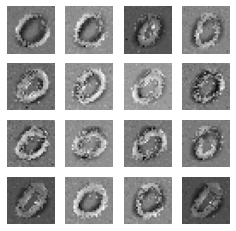

85
gen_loss: tf.Tensor(3.41894, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.039462656, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0644806, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.40525478e-28]
 [1.00000000e+00 2.03041247e-33]
 [1.00000000e+00 1.06252789e-13]
 [1.00000000e+00 1.23737388e-27]
 [1.00000000e+00 1.95189826e-26]
 [1.00000000e+00 1.70812427e-24]
 [1.00000000e+00 1.13051271e-26]
 [1.00000000e+00 6.64509808e-29]
 [1.00000000e+00 1.39187050e-26]
 [1.00000000e+00 3.67832849e-25]
 [1.00000000e+00 8.97086131e-29]
 [1.00000000e+00 1.03256548e-24]
 [1.00000000e+00 8.24933732e-10]
 [1.00000000e+00 2.40383482e-27]
 [1.00000000e+00 1.68651004e-26]
 [1.00000000e+00 1.88076334e-26]
 [1.00000000e+00 1.89684532e-26]
 [1.00000000e+00 2.10400913e-27]
 [1.00000000e+00 1.29003602e-28]
 [1.00000000e+00 8.93950524e-28]
 [9.99972939e-01 2.70578676e-05]
 [1.00000000e+00 7.53690427e-34]
 [1.00000000e+00 3.00845352e-28]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.4592295, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06286348, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.067920886, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.18488795e-28]
 [1.00000000e+00 2.73330281e-33]
 [1.00000000e+00 1.24694498e-13]
 [1.00000000e+00 1.20397026e-27]
 [1.00000000e+00 1.41592120e-26]
 [1.00000000e+00 1.22626732e-24]
 [1.00000000e+00 1.10723916e-26]
 [1.00000000e+00 4.16716170e-29]
 [1.00000000e+00 2.06490536e-26]
 [1.00000000e+00 2.22416990e-25]
 [1.00000000e+00 3.42566995e-29]
 [1.00000000e+00 1.94429048e-24]
 [1.00000000e+00 5.47486334e-10]
 [1.00000000e+00 1.68156911e-27]
 [1.00000000e+00 2.34468720e-26]
 [1.00000000e+00 1.47577772e-26]
 [1.00000000e+00 1.63402306e-26]
 [1.00000000e+00 1.62756488e-27]
 [1.00000000e+00 1.78251774e-28]
 [1.00000000e+00 7.24802597e-28]
 [9.99985218e-01 1.48072832e-05]
 [1.00000000e+00 1.08249842e-33]
 [1.00000000e+00 2.55263766e-28]
 [1.00000000e+00 9.8

gen_loss: tf.Tensor(3.664024, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.10246718, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.061276518, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.06000958e-28]
 [1.00000000e+00 2.65361789e-33]
 [1.00000000e+00 1.17823516e-13]
 [1.00000000e+00 4.14902009e-27]
 [1.00000000e+00 5.37476634e-26]
 [1.00000000e+00 9.41910334e-24]
 [1.00000000e+00 2.56293405e-26]
 [1.00000000e+00 1.19216941e-28]
 [1.00000000e+00 3.42229215e-26]
 [1.00000000e+00 2.53181200e-24]
 [1.00000000e+00 9.81160677e-29]
 [1.00000000e+00 8.53591518e-24]
 [1.00000000e+00 7.56643748e-10]
 [1.00000000e+00 8.33505117e-27]
 [1.00000000e+00 3.75959922e-26]
 [1.00000000e+00 6.03891019e-26]
 [1.00000000e+00 5.49419249e-26]
 [1.00000000e+00 1.04911313e-26]
 [1.00000000e+00 2.00863901e-28]
 [1.00000000e+00 2.66502829e-27]
 [9.99971509e-01 2.85049991e-05]
 [1.00000000e+00 1.26961122e-33]
 [1.00000000e+00 1.23123401e-27]
 [1.00000000e+00 3.92

gen_loss: tf.Tensor(3.7638216, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.037538435, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.042553253, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 4.6449404e-29]
 [1.0000000e+00 3.2577471e-34]
 [1.0000000e+00 1.9152525e-14]
 [1.0000000e+00 4.8223360e-28]
 [1.0000000e+00 9.6277169e-27]
 [1.0000000e+00 2.2119952e-24]
 [1.0000000e+00 2.9809694e-27]
 [1.0000000e+00 5.0796035e-29]
 [1.0000000e+00 3.9733052e-27]
 [1.0000000e+00 3.5585141e-25]
 [1.0000000e+00 2.5024523e-29]
 [1.0000000e+00 5.0564530e-25]
 [1.0000000e+00 1.0865122e-09]
 [1.0000000e+00 5.4099565e-28]
 [1.0000000e+00 3.8235980e-27]
 [1.0000000e+00 1.1214625e-26]
 [1.0000000e+00 9.8935499e-27]
 [1.0000000e+00 2.7653195e-27]
 [1.0000000e+00 1.7607757e-29]
 [1.0000000e+00 4.0045272e-28]
 [9.9997675e-01 2.3278430e-05]
 [1.0000000e+00 1.5461235e-34]
 [1.0000000e+00 2.0626597e-28]
 [1.0000000e+00 4.8914798e-28]
 [1.0000000e+00 8.5705766e-29]
 [1

gen_loss: tf.Tensor(3.8911433, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.038656086, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048451465, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.41914225e-29]
 [1.00000000e+00 6.27200256e-34]
 [1.00000000e+00 8.08466944e-15]
 [1.00000000e+00 1.30545177e-28]
 [1.00000000e+00 3.52594555e-27]
 [1.00000000e+00 1.01020956e-24]
 [1.00000000e+00 9.57519020e-28]
 [1.00000000e+00 3.85043831e-29]
 [1.00000000e+00 1.64543770e-27]
 [1.00000000e+00 1.01119217e-25]
 [1.00000000e+00 8.54996738e-30]
 [1.00000000e+00 8.74953672e-26]
 [1.00000000e+00 7.16016635e-10]
 [1.00000000e+00 1.38181212e-28]
 [1.00000000e+00 1.30949735e-27]
 [1.00000000e+00 5.74976216e-27]
 [1.00000000e+00 4.14026096e-27]
 [1.00000000e+00 1.17154444e-27]
 [1.00000000e+00 6.11621597e-30]
 [1.00000000e+00 1.24122152e-28]
 [9.99990106e-01 9.87489420e-06]
 [1.00000000e+00 2.87264945e-34]
 [1.00000000e+00 6.82847369e-29]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.819024, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036492378, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.043020226, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.27030111e-29]
 [1.00000000e+00 2.93644550e-34]
 [1.00000000e+00 2.07955804e-14]
 [1.00000000e+00 4.08971368e-28]
 [1.00000000e+00 6.37004141e-27]
 [1.00000000e+00 1.69741311e-24]
 [1.00000000e+00 2.43204045e-27]
 [1.00000000e+00 1.04676489e-29]
 [1.00000000e+00 6.92427513e-27]
 [1.00000000e+00 2.57445866e-25]
 [1.00000000e+00 4.62331821e-30]
 [1.00000000e+00 7.20269696e-25]
 [1.00000000e+00 3.01913272e-10]
 [1.00000000e+00 1.96797083e-28]
 [1.00000000e+00 4.72850661e-27]
 [1.00000000e+00 1.20301596e-26]
 [1.00000000e+00 1.12368074e-26]
 [1.00000000e+00 1.54929951e-27]
 [1.00000000e+00 9.65311447e-30]
 [1.00000000e+00 2.75918546e-28]
 [9.99987364e-01 1.26258119e-05]
 [1.00000000e+00 1.28779998e-34]
 [1.00000000e+00 1.97638931e-28]
 [1.00000000e+00 3.7

gen_loss: tf.Tensor(3.7920587, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04392375, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.040059954, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.88510610e-29]
 [1.00000000e+00 4.65022948e-34]
 [1.00000000e+00 2.84849184e-14]
 [1.00000000e+00 8.65756066e-28]
 [1.00000000e+00 1.14956478e-26]
 [1.00000000e+00 2.44045481e-24]
 [1.00000000e+00 5.50856486e-27]
 [1.00000000e+00 4.06952496e-30]
 [1.00000000e+00 2.36323899e-26]
 [1.00000000e+00 3.87558611e-25]
 [1.00000000e+00 2.98651925e-30]
 [1.00000000e+00 3.74320337e-24]
 [1.00000000e+00 1.00137676e-10]
 [1.00000000e+00 2.83380225e-28]
 [1.00000000e+00 1.36344531e-26]
 [1.00000000e+00 2.57378967e-26]
 [1.00000000e+00 2.29730286e-26]
 [1.00000000e+00 1.92286059e-27]
 [1.00000000e+00 1.25626883e-29]
 [1.00000000e+00 5.41379630e-28]
 [9.99993682e-01 6.29692477e-06]
 [1.00000000e+00 1.96114518e-34]
 [1.00000000e+00 4.06990164e-28]
 [1.00000000e+00 7.8

gen_loss: tf.Tensor(3.6573448, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036710225, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04699746, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.10924719e-29]
 [1.00000000e+00 3.17037218e-33]
 [1.00000000e+00 2.91634223e-14]
 [1.00000000e+00 1.12993443e-27]
 [1.00000000e+00 2.90696661e-26]
 [1.00000000e+00 3.37236262e-24]
 [1.00000000e+00 1.17271199e-26]
 [1.00000000e+00 9.49591871e-30]
 [1.00000000e+00 5.08087097e-26]
 [1.00000000e+00 4.00783421e-25]
 [1.00000000e+00 7.30191211e-30]
 [1.00000000e+00 3.32937522e-24]
 [1.00000000e+00 9.48569279e-11]
 [1.00000000e+00 6.53821149e-28]
 [1.00000000e+00 2.61399199e-26]
 [1.00000000e+00 5.50583682e-26]
 [1.00000000e+00 3.77549446e-26]
 [1.00000000e+00 3.51760281e-27]
 [1.00000000e+00 3.29202245e-29]
 [1.00000000e+00 1.02621434e-27]
 [9.99996424e-01 3.52868506e-06]
 [1.00000000e+00 1.12608410e-33]
 [1.00000000e+00 7.79473682e-28]
 [1.00000000e+00 1.0

 [1.00000000e+00 1.24926842e-28]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(3.7198997, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04445092, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04370775, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.76187851e-28]
 [1.00000000e+00 1.74113489e-33]
 [1.00000000e+00 2.07437234e-14]
 [1.00000000e+00 1.45028900e-27]
 [1.00000000e+00 1.34839958e-25]
 [1.00000000e+00 8.72245238e-24]
 [1.00000000e+00 2.40744247e-26]
 [1.00000000e+00 4.19024337e-29]
 [1.00000000e+00 4.68443293e-26]
 [1.00000000e+00 1.00178994e-24]
 [1.00000000e+00 7.39168181e-29]
 [1.00000000e+00 1.22629552e-24]
 [1.00000000e+00 2.58630034e-10]
 [1.00000000e+00 1.58699632e-27]
 [1.00000000e+00 2.21464410e-26]
 [1.00000000e+00 1.35707914e-25]
 [1.00000000e+00 6.21821149e-26]
 [1.00000000e+00 1.38649176e-26]
 [1.00000000e+00 2.46350499e-29]
 [1.00000000e+00 3.37038973e-27]
 [9.99992013e-01 7.98105521e-06]
 [1.00000000e+00 7.26

gen_loss: tf.Tensor(3.74504, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03620763, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04796782, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.56524889e-28]
 [1.00000000e+00 9.35538669e-34]
 [1.00000000e+00 1.52457443e-14]
 [1.00000000e+00 1.16084541e-27]
 [1.00000000e+00 1.48016486e-25]
 [1.00000000e+00 8.50588009e-24]
 [1.00000000e+00 2.29932801e-26]
 [1.00000000e+00 4.75077686e-29]
 [1.00000000e+00 3.71446620e-26]
 [1.00000000e+00 9.72866360e-25]
 [1.00000000e+00 9.40769593e-29]
 [1.00000000e+00 8.15907889e-25]
 [1.00000000e+00 2.79243850e-10]
 [1.00000000e+00 1.31716766e-27]
 [1.00000000e+00 1.64323055e-26]
 [1.00000000e+00 1.34229244e-25]
 [1.00000000e+00 5.54514736e-26]
 [1.00000000e+00 1.47279699e-26]
 [1.00000000e+00 1.49047959e-29]
 [1.00000000e+00 3.58944500e-27]
 [9.99992967e-01 7.00092642e-06]
 [1.00000000e+00 4.49232661e-34]
 [1.00000000e+00 2.79307489e-27]
 [1.00000000e+00 1.6356

gen_loss: tf.Tensor(3.8027945, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.054067075, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.037074633, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.21788299e-28]
 [1.00000000e+00 4.17034769e-34]
 [1.00000000e+00 1.74268016e-14]
 [1.00000000e+00 1.00442485e-27]
 [1.00000000e+00 1.40680696e-25]
 [1.00000000e+00 6.02324883e-24]
 [1.00000000e+00 2.35479803e-26]
 [1.00000000e+00 4.54520550e-29]
 [1.00000000e+00 4.04878422e-26]
 [1.00000000e+00 9.09270563e-25]
 [1.00000000e+00 8.71298531e-29]
 [1.00000000e+00 7.56303235e-25]
 [1.00000000e+00 3.21136839e-10]
 [1.00000000e+00 9.89856636e-28]
 [1.00000000e+00 1.71525925e-26]
 [1.00000000e+00 1.05446199e-25]
 [1.00000000e+00 4.25336390e-26]
 [1.00000000e+00 1.12097497e-26]
 [1.00000000e+00 1.45280148e-29]
 [1.00000000e+00 3.21873623e-27]
 [9.99994397e-01 5.60098897e-06]
 [1.00000000e+00 2.01183815e-34]
 [1.00000000e+00 2.72290441e-27]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.759253, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051719487, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0466846, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.41660034e-29]
 [1.00000000e+00 4.39419166e-34]
 [1.00000000e+00 2.48255192e-14]
 [1.00000000e+00 6.48035560e-28]
 [1.00000000e+00 6.90349619e-26]
 [1.00000000e+00 2.66640508e-24]
 [1.00000000e+00 1.49741176e-26]
 [1.00000000e+00 2.71543303e-29]
 [1.00000000e+00 3.49122904e-26]
 [1.00000000e+00 5.70515349e-25]
 [1.00000000e+00 4.35125051e-29]
 [1.00000000e+00 6.59201557e-25]
 [1.00000000e+00 2.77874668e-10]
 [1.00000000e+00 8.89728597e-28]
 [1.00000000e+00 1.62142455e-26]
 [1.00000000e+00 4.42816715e-26]
 [1.00000000e+00 2.22867874e-26]
 [1.00000000e+00 4.28559318e-27]
 [1.00000000e+00 2.52134819e-29]
 [1.00000000e+00 1.33420472e-27]
 [9.99995708e-01 4.33373998e-06]
 [1.00000000e+00 1.88219122e-34]
 [1.00000000e+00 1.41272653e-27]
 [1.00000000e+00 7.196

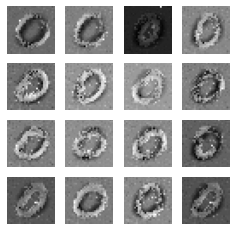

86
gen_loss: tf.Tensor(3.768878, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0494277, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.060798723, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.16722520e-29]
 [1.00000000e+00 3.29250389e-34]
 [1.00000000e+00 2.25702872e-14]
 [1.00000000e+00 1.16841523e-28]
 [1.00000000e+00 1.13864514e-26]
 [1.00000000e+00 4.04301395e-25]
 [1.00000000e+00 3.11877796e-27]
 [1.00000000e+00 7.56791915e-30]
 [1.00000000e+00 1.04637931e-26]
 [1.00000000e+00 7.57608023e-26]
 [1.00000000e+00 1.24637835e-29]
 [1.00000000e+00 1.35179870e-25]
 [1.00000000e+00 1.78220771e-10]
 [1.00000000e+00 2.30903834e-28]
 [1.00000000e+00 5.60924631e-27]
 [1.00000000e+00 6.58248496e-27]
 [1.00000000e+00 3.90919868e-27]
 [1.00000000e+00 5.64506967e-28]
 [1.00000000e+00 1.76575306e-29]
 [1.00000000e+00 1.70866169e-28]
 [9.99997139e-01 2.83573445e-06]
 [1.00000000e+00 1.19975729e-34]
 [1.00000000e+00 1.95644354e-28]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.8292375, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.055376984, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.044338085, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.05947967e-30]
 [1.00000000e+00 4.80122833e-35]
 [1.00000000e+00 1.31866199e-14]
 [1.00000000e+00 3.91833156e-29]
 [1.00000000e+00 3.36993983e-27]
 [1.00000000e+00 1.62729334e-25]
 [1.00000000e+00 7.91476848e-28]
 [1.00000000e+00 2.05798103e-30]
 [1.00000000e+00 3.28683095e-27]
 [1.00000000e+00 2.49969883e-26]
 [1.00000000e+00 5.23008018e-30]
 [1.00000000e+00 6.85984014e-26]
 [1.00000000e+00 1.34005668e-10]
 [1.00000000e+00 5.35997558e-29]
 [1.00000000e+00 1.90164782e-27]
 [1.00000000e+00 1.96521853e-27]
 [1.00000000e+00 1.45975802e-27]
 [1.00000000e+00 1.79429287e-28]
 [1.00000000e+00 4.65723339e-30]
 [1.00000000e+00 4.22787905e-29]
 [9.99996185e-01 3.83697898e-06]
 [1.00000000e+00 1.85875116e-35]
 [1.00000000e+00 4.85143107e-29]
 [1.00000000e+00 3.

gen_loss: tf.Tensor(3.5918345, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04639099, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.057565786, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.52634162e-30]
 [1.00000000e+00 4.46950445e-35]
 [1.00000000e+00 1.04842333e-14]
 [1.00000000e+00 3.05350957e-29]
 [1.00000000e+00 2.08211593e-27]
 [1.00000000e+00 1.07324317e-25]
 [1.00000000e+00 3.94450362e-28]
 [1.00000000e+00 1.56607153e-30]
 [1.00000000e+00 2.08763545e-27]
 [1.00000000e+00 2.42343817e-26]
 [1.00000000e+00 3.04825904e-30]
 [1.00000000e+00 6.97371652e-26]
 [1.00000000e+00 1.48852805e-10]
 [1.00000000e+00 2.14800246e-29]
 [1.00000000e+00 1.27828005e-27]
 [1.00000000e+00 1.08104913e-27]
 [1.00000000e+00 8.88588928e-28]
 [1.00000000e+00 1.52067191e-28]
 [1.00000000e+00 2.20197006e-30]
 [1.00000000e+00 2.14341874e-29]
 [9.99994755e-01 5.25803762e-06]
 [1.00000000e+00 1.91150219e-35]
 [1.00000000e+00 2.63050283e-29]
 [1.00000000e+00 2.4

gen_loss: tf.Tensor(3.95013, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07706182, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.034237303, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.36230055e-30]
 [1.00000000e+00 1.42204293e-34]
 [1.00000000e+00 2.35191268e-14]
 [1.00000000e+00 6.01710228e-29]
 [1.00000000e+00 2.38387256e-27]
 [1.00000000e+00 1.11853648e-25]
 [1.00000000e+00 4.96562951e-28]
 [1.00000000e+00 3.87381737e-30]
 [1.00000000e+00 4.16511586e-27]
 [1.00000000e+00 3.48344644e-26]
 [1.00000000e+00 3.09586054e-30]
 [1.00000000e+00 1.52970976e-25]
 [1.00000000e+00 3.73480746e-10]
 [1.00000000e+00 2.22202843e-29]
 [1.00000000e+00 2.91842077e-27]
 [1.00000000e+00 9.90438267e-28]
 [1.00000000e+00 1.17116012e-27]
 [1.00000000e+00 1.99805458e-28]
 [1.00000000e+00 6.20575817e-30]
 [1.00000000e+00 2.17312350e-29]
 [9.99991059e-01 8.98004510e-06]
 [1.00000000e+00 4.44773399e-35]
 [1.00000000e+00 3.18392873e-29]
 [1.00000000e+00 4.079

gen_loss: tf.Tensor(4.226521, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.035443127, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.036731046, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.48375375e-30]
 [1.00000000e+00 1.57421423e-34]
 [1.00000000e+00 2.29415977e-14]
 [1.00000000e+00 4.60608656e-29]
 [1.00000000e+00 1.21034355e-27]
 [1.00000000e+00 8.64905309e-26]
 [1.00000000e+00 2.50947974e-28]
 [1.00000000e+00 3.91201210e-30]
 [1.00000000e+00 2.99518333e-27]
 [1.00000000e+00 2.02765649e-26]
 [1.00000000e+00 1.43082827e-30]
 [1.00000000e+00 1.21247514e-25]
 [1.00000000e+00 4.82269280e-10]
 [1.00000000e+00 1.41495259e-29]
 [1.00000000e+00 2.50016483e-27]
 [1.00000000e+00 5.02642486e-28]
 [1.00000000e+00 9.32402582e-28]
 [1.00000000e+00 1.28792172e-28]
 [1.00000000e+00 5.61234117e-30]
 [1.00000000e+00 1.04604643e-29]
 [9.99989152e-01 1.08825825e-05]
 [1.00000000e+00 4.40182313e-35]
 [1.00000000e+00 1.41921221e-29]
 [1.00000000e+00 2.6

gen_loss: tf.Tensor(3.8976057, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03673364, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03882715, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.48150920e-30]
 [1.00000000e+00 8.51651454e-35]
 [1.00000000e+00 1.41163961e-14]
 [1.00000000e+00 5.14748532e-29]
 [1.00000000e+00 8.81478780e-28]
 [1.00000000e+00 1.37052749e-25]
 [1.00000000e+00 1.50296708e-28]
 [1.00000000e+00 2.52212601e-30]
 [1.00000000e+00 2.09740589e-27]
 [1.00000000e+00 2.23146902e-26]
 [1.00000000e+00 6.44369046e-31]
 [1.00000000e+00 1.73588965e-25]
 [1.00000000e+00 2.61797500e-10]
 [1.00000000e+00 1.20715611e-29]
 [1.00000000e+00 1.97046573e-27]
 [1.00000000e+00 5.00346825e-28]
 [1.00000000e+00 1.13058973e-27]
 [1.00000000e+00 1.51637372e-28]
 [1.00000000e+00 2.29040278e-30]
 [1.00000000e+00 9.12795701e-30]
 [9.99987483e-01 1.25669021e-05]
 [1.00000000e+00 3.63390332e-35]
 [1.00000000e+00 8.83012548e-30]
 [1.00000000e+00 2.80

gen_loss: tf.Tensor(3.6615386, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.037946608, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.052505367, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.09219112e-30]
 [1.00000000e+00 1.15173720e-34]
 [1.00000000e+00 1.43629751e-14]
 [1.00000000e+00 1.16231593e-28]
 [1.00000000e+00 1.86664597e-27]
 [1.00000000e+00 3.67295831e-25]
 [1.00000000e+00 1.98555577e-28]
 [1.00000000e+00 4.66552015e-30]
 [1.00000000e+00 2.99381265e-27]
 [1.00000000e+00 4.94521895e-26]
 [1.00000000e+00 1.04775122e-30]
 [1.00000000e+00 2.57709197e-25]
 [1.00000000e+00 2.33027431e-10]
 [1.00000000e+00 2.37151671e-29]
 [1.00000000e+00 3.05182397e-27]
 [1.00000000e+00 1.03096205e-27]
 [1.00000000e+00 1.88499296e-27]
 [1.00000000e+00 4.93255311e-28]
 [1.00000000e+00 2.09842706e-30]
 [1.00000000e+00 2.07761528e-29]
 [9.99980688e-01 1.92897023e-05]
 [1.00000000e+00 6.85392300e-35]
 [1.00000000e+00 1.42734550e-29]
 [1.00000000e+00 6.

gen_loss: tf.Tensor(3.9160352, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.034796853, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.047524557, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.04740331e-29]
 [1.00000000e+00 7.45171124e-34]
 [1.00000000e+00 2.14494018e-14]
 [1.00000000e+00 1.91955427e-28]
 [1.00000000e+00 3.34034907e-27]
 [1.00000000e+00 3.55841892e-25]
 [1.00000000e+00 2.80023184e-28]
 [1.00000000e+00 2.41143702e-29]
 [1.00000000e+00 5.43573466e-27]
 [1.00000000e+00 3.88539850e-26]
 [1.00000000e+00 2.58110949e-30]
 [1.00000000e+00 1.06207967e-25]
 [1.00000000e+00 6.96409708e-10]
 [1.00000000e+00 3.20664898e-29]
 [1.00000000e+00 5.70754192e-27]
 [1.00000000e+00 1.17401396e-27]
 [1.00000000e+00 1.39247528e-27]
 [1.00000000e+00 1.01759147e-27]
 [1.00000000e+00 6.00029756e-30]
 [1.00000000e+00 3.15828377e-29]
 [9.99984026e-01 1.59858319e-05]
 [1.00000000e+00 3.57307946e-34]
 [1.00000000e+00 1.87903235e-29]
 [1.00000000e+00 8.

disc_fake_loss: tf.Tensor(0.04430077, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.24597511e-29]
 [1.00000000e+00 7.57321740e-34]
 [1.00000000e+00 2.69791141e-14]
 [1.00000000e+00 2.99940092e-28]
 [1.00000000e+00 4.57643942e-27]
 [1.00000000e+00 4.23545879e-25]
 [1.00000000e+00 3.30802422e-28]
 [1.00000000e+00 2.63892516e-29]
 [1.00000000e+00 7.70545774e-27]
 [1.00000000e+00 6.73532399e-26]
 [1.00000000e+00 2.69291292e-30]
 [1.00000000e+00 1.44086085e-25]
 [1.00000000e+00 8.52060367e-10]
 [1.00000000e+00 4.03651805e-29]
 [1.00000000e+00 7.73260642e-27]
 [1.00000000e+00 1.36013554e-27]
 [1.00000000e+00 1.36506313e-27]
 [1.00000000e+00 1.46270123e-27]
 [1.00000000e+00 5.66525609e-30]
 [1.00000000e+00 4.47617265e-29]
 [9.99982476e-01 1.75156656e-05]
 [1.00000000e+00 3.59874152e-34]
 [1.00000000e+00 2.58108106e-29]
 [1.00000000e+00 1.38200195e-28]
 [1.00000000e+00 2.23386621e-30]
 [1.00000000e+00 1.70987305e-22]
 [1.00000000e+00 2.23031670e-29]
 [1.0000

gen_loss: tf.Tensor(3.797958, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.023383182, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.048051447, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.76088979e-29]
 [1.00000000e+00 5.23585847e-34]
 [1.00000000e+00 3.99745849e-14]
 [1.00000000e+00 1.67903073e-27]
 [1.00000000e+00 2.09329850e-26]
 [1.00000000e+00 1.63190058e-24]
 [1.00000000e+00 9.03284833e-28]
 [1.00000000e+00 3.51649891e-29]
 [1.00000000e+00 2.40534953e-26]
 [1.00000000e+00 6.00780244e-25]
 [1.00000000e+00 6.17986645e-30]
 [1.00000000e+00 9.34726020e-25]
 [1.00000000e+00 8.40243541e-10]
 [1.00000000e+00 1.52474959e-28]
 [1.00000000e+00 2.26522657e-26]
 [1.00000000e+00 4.69027767e-27]
 [1.00000000e+00 3.82634132e-27]
 [1.00000000e+00 7.04005433e-27]
 [1.00000000e+00 5.72797069e-30]
 [1.00000000e+00 2.05599016e-28]
 [9.99968529e-01 3.14284553e-05]
 [1.00000000e+00 3.12313604e-34]
 [1.00000000e+00 1.24031273e-28]
 [1.00000000e+00 8.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.54001842e-29]
 [1.00000000e+00 3.87865932e-34]
 [1.00000000e+00 3.86803084e-14]
 [1.00000000e+00 3.11181399e-27]
 [1.00000000e+00 3.37623346e-26]
 [1.00000000e+00 2.57726044e-24]
 [1.00000000e+00 1.19820643e-27]
 [1.00000000e+00 3.91946785e-29]
 [1.00000000e+00 3.09390692e-26]
 [1.00000000e+00 1.25726925e-24]
 [1.00000000e+00 8.18974174e-30]
 [1.00000000e+00 1.78018375e-24]
 [1.00000000e+00 8.27641289e-10]
 [1.00000000e+00 2.29073719e-28]
 [1.00000000e+00 2.91649704e-26]
 [1.00000000e+00 7.17849634e-27]
 [1.00000000e+00 5.62761391e-27]
 [1.00000000e+00 1.17002209e-26]
 [1.00000000e+00 5.02266279e-30]
 [1.00000000e+00 3.23436606e-28]
 [9.99960899e-01 3.91182693e-05]
 [1.00000000e+00 2.79232989e-34]
 [1.00000000e+00 2.00105229e-28]
 [1.00000000e+00 1.49426693e-27]
 [1.00000000e+00 9.80273515e-30]
 [1.00000000e+00 1.45198104e-22]
 [1.00000000e+00 1.65281611e-28]
 [1.00000000e+00 2.90189387e-25]
 [1.00000000e+00 2.01737562e-15]
 [1.0

gen_loss: tf.Tensor(3.8953555, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.031786233, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.037755787, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.69867834e-29]
 [1.00000000e+00 2.21120796e-34]
 [1.00000000e+00 3.52051220e-14]
 [1.00000000e+00 3.64681922e-27]
 [1.00000000e+00 3.44763400e-26]
 [1.00000000e+00 2.20513740e-24]
 [1.00000000e+00 1.05927871e-27]
 [1.00000000e+00 4.14610467e-29]
 [1.00000000e+00 2.13693144e-26]
 [1.00000000e+00 1.19870659e-24]
 [1.00000000e+00 8.79194317e-30]
 [1.00000000e+00 1.40960648e-24]
 [1.00000000e+00 1.43090362e-09]
 [1.00000000e+00 2.78323503e-28]
 [1.00000000e+00 2.27097154e-26]
 [1.00000000e+00 6.13147993e-27]
 [1.00000000e+00 4.71492572e-27]
 [1.00000000e+00 1.14840768e-26]
 [1.00000000e+00 3.97010221e-30]
 [1.00000000e+00 2.86764372e-28]
 [9.99933362e-01 6.66033739e-05]
 [1.00000000e+00 1.91437107e-34]
 [1.00000000e+00 1.88475477e-28]
 [1.00000000e+00 1.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.13263670e-29]
 [1.00000000e+00 3.80305897e-34]
 [1.00000000e+00 3.58852420e-14]
 [1.00000000e+00 2.88600506e-27]
 [1.00000000e+00 2.84041787e-26]
 [1.00000000e+00 1.78723301e-24]
 [1.00000000e+00 9.38687277e-28]
 [1.00000000e+00 5.21468282e-29]
 [1.00000000e+00 1.80032819e-26]
 [1.00000000e+00 8.93365549e-25]
 [1.00000000e+00 9.12391857e-30]
 [1.00000000e+00 9.73876299e-25]
 [1.00000000e+00 1.44716872e-09]
 [1.00000000e+00 2.98130898e-28]
 [1.00000000e+00 1.93814234e-26]
 [1.00000000e+00 5.18568655e-27]
 [1.00000000e+00 3.86200453e-27]
 [1.00000000e+00 9.79411567e-27]
 [1.00000000e+00 4.46592008e-30]
 [1.00000000e+00 2.34934949e-28]
 [9.99940991e-01 5.90123273e-05]
 [1.00000000e+00 3.46407234e-34]
 [1.00000000e+00 1.45943998e-28]
 [1.00000000e+00 1.39289494e-27]
 [1.00000000e+00 7.58537665e-30]
 [1.00000000e+00 2.76637111e-22]
 [1.00000000e+00 1.70126023e-28]
 [1.00000000e+00 4.18153374e-25]
 [1.00000000e+00 4.08271066e-15]
 [1.0

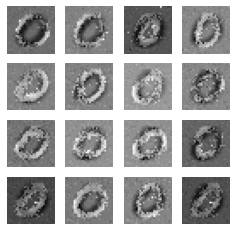

87
gen_loss: tf.Tensor(3.769823, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.039379478, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.040171634, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 2.4127620e-29]
 [1.0000000e+00 6.5204575e-34]
 [1.0000000e+00 3.8204012e-14]
 [1.0000000e+00 2.2574875e-27]
 [1.0000000e+00 1.7403908e-26]
 [1.0000000e+00 1.3515210e-24]
 [1.0000000e+00 8.0170209e-28]
 [1.0000000e+00 4.1845568e-29]
 [1.0000000e+00 1.5182391e-26]
 [1.0000000e+00 5.9456515e-25]
 [1.0000000e+00 6.0201068e-30]
 [1.0000000e+00 7.2302805e-25]
 [1.0000000e+00 9.4137464e-10]
 [1.0000000e+00 3.7656668e-28]
 [1.0000000e+00 1.6999450e-26]
 [1.0000000e+00 4.1516482e-27]
 [1.0000000e+00 3.2038278e-27]
 [1.0000000e+00 6.4278197e-27]
 [1.0000000e+00 4.6766386e-30]
 [1.0000000e+00 1.6261553e-28]
 [9.9994349e-01 5.6551195e-05]
 [1.0000000e+00 8.1017881e-34]
 [1.0000000e+00 8.9692189e-29]
 [1.0000000e+00 1.0491405e-27]
 [1.0000000e+00 7.0484274e-30]
 

gen_loss: tf.Tensor(3.9397197, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.02405605, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.037803687, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.87205416e-29]
 [1.00000000e+00 7.76429447e-34]
 [1.00000000e+00 6.61416858e-14]
 [1.00000000e+00 4.07198482e-27]
 [1.00000000e+00 2.24670683e-26]
 [1.00000000e+00 2.30007602e-24]
 [1.00000000e+00 1.31945576e-27]
 [1.00000000e+00 3.91934809e-29]
 [1.00000000e+00 2.81876518e-26]
 [1.00000000e+00 1.03306197e-24]
 [1.00000000e+00 6.75342231e-30]
 [1.00000000e+00 1.76363049e-24]
 [1.00000000e+00 7.40521533e-10]
 [1.00000000e+00 7.54693897e-28]
 [1.00000000e+00 3.57429363e-26]
 [1.00000000e+00 6.68979239e-27]
 [1.00000000e+00 5.26630444e-27]
 [1.00000000e+00 8.48871958e-27]
 [1.00000000e+00 9.66372514e-30]
 [1.00000000e+00 2.55456648e-28]
 [9.99931335e-01 6.86075000e-05]
 [1.00000000e+00 1.25434128e-33]
 [1.00000000e+00 1.33277458e-28]
 [1.00000000e+00 1.8

gen_loss: tf.Tensor(3.8839343, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04274328, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.049107257, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.48568854e-29]
 [1.00000000e+00 5.93794084e-34]
 [1.00000000e+00 4.68330005e-14]
 [1.00000000e+00 2.77015517e-27]
 [1.00000000e+00 1.00305082e-26]
 [1.00000000e+00 1.04407969e-24]
 [1.00000000e+00 7.78573262e-28]
 [1.00000000e+00 2.32008264e-29]
 [1.00000000e+00 2.31064447e-26]
 [1.00000000e+00 4.34015246e-25]
 [1.00000000e+00 2.66942993e-30]
 [1.00000000e+00 1.26266684e-24]
 [1.00000000e+00 7.95115529e-10]
 [1.00000000e+00 3.23171430e-28]
 [1.00000000e+00 3.10634812e-26]
 [1.00000000e+00 3.60561126e-27]
 [1.00000000e+00 2.96984599e-27]
 [1.00000000e+00 3.34917831e-27]
 [1.00000000e+00 8.45719322e-30]
 [1.00000000e+00 1.21522833e-28]
 [9.99962330e-01 3.76392454e-05]
 [1.00000000e+00 1.18545005e-33]
 [1.00000000e+00 6.22166613e-29]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.9539385, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.041919023, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.038650297, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.41067327e-29]
 [1.00000000e+00 5.39571927e-34]
 [1.00000000e+00 2.58145539e-14]
 [1.00000000e+00 1.36430836e-27]
 [1.00000000e+00 5.31522691e-27]
 [1.00000000e+00 3.92751288e-25]
 [1.00000000e+00 4.01319793e-28]
 [1.00000000e+00 2.55952990e-29]
 [1.00000000e+00 1.50695282e-26]
 [1.00000000e+00 1.10982351e-25]
 [1.00000000e+00 1.78692764e-30]
 [1.00000000e+00 2.90303426e-25]
 [1.00000000e+00 9.87440685e-10]
 [1.00000000e+00 1.48081768e-28]
 [1.00000000e+00 2.21214501e-26]
 [1.00000000e+00 1.46087217e-27]
 [1.00000000e+00 1.17095905e-27]
 [1.00000000e+00 1.68773844e-27]
 [1.00000000e+00 7.66776733e-30]
 [1.00000000e+00 6.12044346e-29]
 [9.99985337e-01 1.46953607e-05]
 [1.00000000e+00 9.09415511e-34]
 [1.00000000e+00 3.09101224e-29]
 [1.00000000e+00 5.

gen_loss: tf.Tensor(3.863175, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06814876, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.052221894, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.81600035e-30]
 [1.00000000e+00 1.03622995e-34]
 [1.00000000e+00 1.13539041e-14]
 [1.00000000e+00 4.87560769e-28]
 [1.00000000e+00 1.76853910e-27]
 [1.00000000e+00 1.56048175e-25]
 [1.00000000e+00 1.33151442e-28]
 [1.00000000e+00 5.50618255e-30]
 [1.00000000e+00 5.17531157e-27]
 [1.00000000e+00 3.65933469e-26]
 [1.00000000e+00 5.12784255e-31]
 [1.00000000e+00 1.43525439e-25]
 [1.00000000e+00 3.46199430e-10]
 [1.00000000e+00 6.92236699e-29]
 [1.00000000e+00 8.52031870e-27]
 [1.00000000e+00 4.40534953e-28]
 [1.00000000e+00 5.60032791e-28]
 [1.00000000e+00 6.30656931e-28]
 [1.00000000e+00 1.77982521e-30]
 [1.00000000e+00 2.35839932e-29]
 [9.99989986e-01 9.95778282e-06]
 [1.00000000e+00 1.66824161e-34]
 [1.00000000e+00 1.04006213e-29]
 [1.00000000e+00 1.73

gen_loss: tf.Tensor(3.820979, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.064692035, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.051685013, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.54145368e-31]
 [1.00000000e+00 7.53384977e-36]
 [1.00000000e+00 4.23727385e-15]
 [1.00000000e+00 6.24506437e-29]
 [1.00000000e+00 1.84895606e-28]
 [1.00000000e+00 2.05255984e-26]
 [1.00000000e+00 1.79068844e-29]
 [1.00000000e+00 1.76226563e-31]
 [1.00000000e+00 8.16650822e-28]
 [1.00000000e+00 4.30210379e-27]
 [1.00000000e+00 3.77294895e-32]
 [1.00000000e+00 4.84188002e-26]
 [1.00000000e+00 6.60274613e-11]
 [1.00000000e+00 8.46661900e-30]
 [1.00000000e+00 1.47466828e-27]
 [1.00000000e+00 5.32065832e-29]
 [1.00000000e+00 1.27415095e-28]
 [1.00000000e+00 6.55506507e-29]
 [1.00000000e+00 1.36102545e-31]
 [1.00000000e+00 3.36193528e-30]
 [9.99994040e-01 5.91854132e-06]
 [1.00000000e+00 1.17679813e-35]
 [1.00000000e+00 1.26181551e-30]
 [1.00000000e+00 2.1

gen_loss: tf.Tensor(3.7580132, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.030803336, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.0477594, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.10578326e-31]
 [1.00000000e+00 7.89570745e-36]
 [1.00000000e+00 4.36904549e-15]
 [1.00000000e+00 3.55773307e-29]
 [1.00000000e+00 9.86369475e-29]
 [1.00000000e+00 1.08035703e-26]
 [1.00000000e+00 1.06033277e-29]
 [1.00000000e+00 1.02302286e-31]
 [1.00000000e+00 5.58803566e-28]
 [1.00000000e+00 2.14226003e-27]
 [1.00000000e+00 2.43958865e-32]
 [1.00000000e+00 3.13138028e-26]
 [1.00000000e+00 5.43758337e-11]
 [1.00000000e+00 5.32705301e-30]
 [1.00000000e+00 1.09594735e-27]
 [1.00000000e+00 3.02102184e-29]
 [1.00000000e+00 9.51873602e-29]
 [1.00000000e+00 3.57918643e-29]
 [1.00000000e+00 1.09961349e-31]
 [1.00000000e+00 2.04828499e-30]
 [9.99995112e-01 4.85334749e-06]
 [1.00000000e+00 9.70359107e-36]
 [1.00000000e+00 7.52453400e-31]
 [1.00000000e+00 1.14

gen_loss: tf.Tensor(3.9437282, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.064869195, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03925138, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.20327666e-31]
 [1.00000000e+00 5.28157303e-35]
 [1.00000000e+00 7.80579824e-15]
 [1.00000000e+00 3.34960926e-29]
 [1.00000000e+00 9.58980644e-29]
 [1.00000000e+00 8.53879992e-27]
 [1.00000000e+00 1.06888555e-29]
 [1.00000000e+00 2.24941964e-31]
 [1.00000000e+00 6.99152918e-28]
 [1.00000000e+00 2.17420350e-27]
 [1.00000000e+00 3.78514500e-32]
 [1.00000000e+00 3.07719293e-26]
 [1.00000000e+00 8.53598719e-11]
 [1.00000000e+00 8.20112128e-30]
 [1.00000000e+00 1.64266571e-27]
 [1.00000000e+00 2.87047701e-29]
 [1.00000000e+00 1.29111912e-28]
 [1.00000000e+00 3.15293901e-29]
 [1.00000000e+00 3.12355791e-31]
 [1.00000000e+00 1.96135859e-30]
 [9.99996781e-01 3.21578091e-06]
 [1.00000000e+00 3.42406552e-35]
 [1.00000000e+00 8.61692184e-31]
 [1.00000000e+00 9.5

gen_loss: tf.Tensor(3.8912454, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06372304, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05442892, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.10639249e-30]
 [1.00000000e+00 1.90305613e-34]
 [1.00000000e+00 6.72350190e-15]
 [1.00000000e+00 3.69316838e-29]
 [1.00000000e+00 1.09783387e-28]
 [1.00000000e+00 8.77272645e-27]
 [1.00000000e+00 1.20246820e-29]
 [1.00000000e+00 3.03735821e-31]
 [1.00000000e+00 8.57689308e-28]
 [1.00000000e+00 2.86020530e-27]
 [1.00000000e+00 4.30368495e-32]
 [1.00000000e+00 3.99914238e-26]
 [1.00000000e+00 7.83056814e-11]
 [1.00000000e+00 8.28444709e-30]
 [1.00000000e+00 2.07925072e-27]
 [1.00000000e+00 3.26600524e-29]
 [1.00000000e+00 1.35455829e-28]
 [1.00000000e+00 3.53419670e-29]
 [1.00000000e+00 3.57899168e-31]
 [1.00000000e+00 2.17434143e-30]
 [9.99998450e-01 1.57980173e-06]
 [1.00000000e+00 1.35244758e-34]
 [1.00000000e+00 1.02299606e-30]
 [1.00000000e+00 9.96

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.21317995e-30]
 [1.00000000e+00 2.31492284e-34]
 [1.00000000e+00 6.27620370e-15]
 [1.00000000e+00 5.95190293e-29]
 [1.00000000e+00 1.97967916e-28]
 [1.00000000e+00 1.25008962e-26]
 [1.00000000e+00 1.83220261e-29]
 [1.00000000e+00 3.52124717e-31]
 [1.00000000e+00 1.27018200e-27]
 [1.00000000e+00 5.46007071e-27]
 [1.00000000e+00 6.40240169e-32]
 [1.00000000e+00 7.43589657e-26]
 [1.00000000e+00 8.49112100e-11]
 [1.00000000e+00 9.88595263e-30]
 [1.00000000e+00 3.31704840e-27]
 [1.00000000e+00 4.80905189e-29]
 [1.00000000e+00 1.84176873e-28]
 [1.00000000e+00 6.00206317e-29]
 [1.00000000e+00 4.16375710e-31]
 [1.00000000e+00 3.81087971e-30]
 [9.99998689e-01 1.26385487e-06]
 [1.00000000e+00 2.09314631e-34]
 [1.00000000e+00 1.89316920e-30]
 [1.00000000e+00 1.64852712e-29]
 [1.00000000e+00 2.09520254e-31]
 [1.00000000e+00 1.45129847e-24]
 [1.00000000e+00 3.50261393e-30]
 [1.00000000e+00 4.65766705e-27]
 [1.00000000e+00 1.88044385e-15]
 [1.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.41508681e-30]
 [1.00000000e+00 9.87254887e-35]
 [1.00000000e+00 9.83097101e-15]
 [1.00000000e+00 2.04422802e-28]
 [1.00000000e+00 7.07378132e-28]
 [1.00000000e+00 3.45983392e-26]
 [1.00000000e+00 5.19823839e-29]
 [1.00000000e+00 4.78211885e-31]
 [1.00000000e+00 2.87317490e-27]
 [1.00000000e+00 2.14053770e-26]
 [1.00000000e+00 1.80661844e-31]
 [1.00000000e+00 2.33125703e-25]
 [1.00000000e+00 1.59262589e-10]
 [1.00000000e+00 2.23189973e-29]
 [1.00000000e+00 7.78918253e-27]
 [1.00000000e+00 1.19067862e-28]
 [1.00000000e+00 4.66477710e-28]
 [1.00000000e+00 1.86120558e-28]
 [1.00000000e+00 6.69674947e-31]
 [1.00000000e+00 1.35531738e-29]
 [9.99997139e-01 2.83786085e-06]
 [1.00000000e+00 1.04544140e-34]
 [1.00000000e+00 7.66419909e-30]
 [1.00000000e+00 6.45930001e-29]
 [1.00000000e+00 5.55544414e-31]
 [1.00000000e+00 2.66198430e-24]
 [1.00000000e+00 1.34401126e-29]
 [1.00000000e+00 6.29842262e-27]
 [1.00000000e+00 1.01581409e-14]
 [1.0

gen_loss: tf.Tensor(3.899291, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.046824828, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04503122, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.90197130e-30]
 [1.00000000e+00 4.60203283e-35]
 [1.00000000e+00 1.76639319e-14]
 [1.00000000e+00 6.01570477e-28]
 [1.00000000e+00 3.64474692e-27]
 [1.00000000e+00 1.28124459e-25]
 [1.00000000e+00 1.42812496e-28]
 [1.00000000e+00 8.57442631e-31]
 [1.00000000e+00 4.76642932e-27]
 [1.00000000e+00 9.38430474e-26]
 [1.00000000e+00 8.94365379e-31]
 [1.00000000e+00 3.46299140e-25]
 [1.00000000e+00 4.17315960e-10]
 [1.00000000e+00 9.77835198e-29]
 [1.00000000e+00 1.36573578e-26]
 [1.00000000e+00 3.07730720e-28]
 [1.00000000e+00 1.01238376e-27]
 [1.00000000e+00 1.09520337e-27]
 [1.00000000e+00 1.05620246e-30]
 [1.00000000e+00 6.69956699e-29]
 [9.99987960e-01 1.20973555e-05]
 [1.00000000e+00 5.26957874e-35]
 [1.00000000e+00 3.77351607e-29]
 [1.00000000e+00 2.31

gen_loss: tf.Tensor(3.920154, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.047067158, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03600675, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.82358220e-30]
 [1.00000000e+00 1.18974883e-34]
 [1.00000000e+00 2.60156785e-14]
 [1.00000000e+00 4.65865987e-28]
 [1.00000000e+00 5.92965480e-27]
 [1.00000000e+00 1.66376879e-25]
 [1.00000000e+00 1.47756743e-28]
 [1.00000000e+00 1.72590839e-30]
 [1.00000000e+00 3.31578307e-27]
 [1.00000000e+00 9.96248308e-26]
 [1.00000000e+00 2.31189157e-30]
 [1.00000000e+00 1.08678939e-25]
 [1.00000000e+00 5.05619269e-10]
 [1.00000000e+00 2.67344787e-28]
 [1.00000000e+00 9.77694407e-27]
 [1.00000000e+00 3.38249535e-28]
 [1.00000000e+00 9.60918286e-28]
 [1.00000000e+00 2.21329179e-27]
 [1.00000000e+00 1.53805574e-30]
 [1.00000000e+00 1.00151276e-28]
 [9.99980330e-01 1.96761357e-05]
 [1.00000000e+00 1.18248211e-34]
 [1.00000000e+00 4.96235109e-29]
 [1.00000000e+00 1.92

gen_loss: tf.Tensor(4.0446806, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.029079946, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03716502, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.74605864e-30]
 [1.00000000e+00 2.45218201e-34]
 [1.00000000e+00 3.09850852e-14]
 [1.00000000e+00 3.34010515e-28]
 [1.00000000e+00 4.92742127e-27]
 [1.00000000e+00 9.87432664e-26]
 [1.00000000e+00 1.44664699e-28]
 [1.00000000e+00 1.48766709e-30]
 [1.00000000e+00 3.00453276e-27]
 [1.00000000e+00 6.50947435e-26]
 [1.00000000e+00 1.62539083e-30]
 [1.00000000e+00 6.83111512e-26]
 [1.00000000e+00 3.27149807e-10]
 [1.00000000e+00 2.22049587e-28]
 [1.00000000e+00 9.14410661e-27]
 [1.00000000e+00 2.74720208e-28]
 [1.00000000e+00 7.43004802e-28]
 [1.00000000e+00 1.58850442e-27]
 [1.00000000e+00 1.86937230e-30]
 [1.00000000e+00 7.78890727e-29]
 [9.99988556e-01 1.14482455e-05]
 [1.00000000e+00 2.79356577e-34]
 [1.00000000e+00 3.80122659e-29]
 [1.00000000e+00 1.3

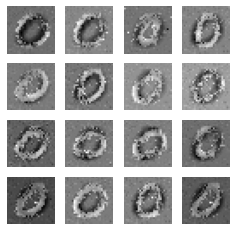

88
gen_loss: tf.Tensor(3.8447976, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.041218195, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04527714, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.21519110e-30]
 [1.00000000e+00 4.47269631e-34]
 [1.00000000e+00 3.22845998e-14]
 [1.00000000e+00 3.42410387e-28]
 [1.00000000e+00 4.73424626e-27]
 [1.00000000e+00 7.56496161e-26]
 [1.00000000e+00 1.67185248e-28]
 [1.00000000e+00 1.16894008e-30]
 [1.00000000e+00 3.85172045e-27]
 [1.00000000e+00 6.30426697e-26]
 [1.00000000e+00 9.72618508e-31]
 [1.00000000e+00 9.07731335e-26]
 [1.00000000e+00 2.14127369e-10]
 [1.00000000e+00 2.05150876e-28]
 [1.00000000e+00 1.18863766e-26]
 [1.00000000e+00 2.62483066e-28]
 [1.00000000e+00 7.02717188e-28]
 [1.00000000e+00 1.32032185e-27]
 [1.00000000e+00 2.22899721e-30]
 [1.00000000e+00 6.91983259e-29]
 [9.99993205e-01 6.79871346e-06]
 [1.00000000e+00 5.30133718e-34]
 [1.00000000e+00 3.52964278e-29]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.9630187, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.02529603, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.037858583, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.36789138e-30]
 [1.00000000e+00 5.98825750e-34]
 [1.00000000e+00 4.39712049e-14]
 [1.00000000e+00 4.17430727e-28]
 [1.00000000e+00 4.92644406e-27]
 [1.00000000e+00 5.53379947e-26]
 [1.00000000e+00 1.73366340e-28]
 [1.00000000e+00 6.34969793e-31]
 [1.00000000e+00 5.25402394e-27]
 [1.00000000e+00 1.13152285e-25]
 [1.00000000e+00 3.43768386e-31]
 [1.00000000e+00 2.24778815e-25]
 [1.00000000e+00 1.61091376e-10]
 [1.00000000e+00 1.89165513e-28]
 [1.00000000e+00 1.78837695e-26]
 [1.00000000e+00 2.20036004e-28]
 [1.00000000e+00 6.30618460e-28]
 [1.00000000e+00 1.08979805e-27]
 [1.00000000e+00 2.23120902e-30]
 [1.00000000e+00 5.89006072e-29]
 [9.99995112e-01 4.88581327e-06]
 [1.00000000e+00 6.25332046e-34]
 [1.00000000e+00 3.52891574e-29]
 [1.00000000e+00 1.4

gen_loss: tf.Tensor(3.9892516, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.033279043, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.042300813, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.31136570e-29]
 [1.00000000e+00 1.29444474e-33]
 [1.00000000e+00 9.43385859e-14]
 [1.00000000e+00 6.62065911e-28]
 [1.00000000e+00 7.20519050e-27]
 [1.00000000e+00 6.83200136e-26]
 [1.00000000e+00 2.49912425e-28]
 [1.00000000e+00 1.44230345e-30]
 [1.00000000e+00 9.26248813e-27]
 [1.00000000e+00 2.52749727e-25]
 [1.00000000e+00 5.69674185e-31]
 [1.00000000e+00 3.32585754e-25]
 [1.00000000e+00 2.05173892e-10]
 [1.00000000e+00 1.90026187e-28]
 [1.00000000e+00 3.25357484e-26]
 [1.00000000e+00 2.54461664e-28]
 [1.00000000e+00 8.03413473e-28]
 [1.00000000e+00 1.98582945e-27]
 [1.00000000e+00 4.82906847e-30]
 [1.00000000e+00 9.54651816e-29]
 [9.99995470e-01 4.58921204e-06]
 [1.00000000e+00 1.18362455e-33]
 [1.00000000e+00 6.09393123e-29]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(4.077382, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.035408176, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.047019064, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.09822800e-29]
 [1.00000000e+00 2.07153329e-33]
 [1.00000000e+00 7.90375184e-14]
 [1.00000000e+00 4.75756215e-28]
 [1.00000000e+00 5.06049995e-27]
 [1.00000000e+00 4.33917347e-26]
 [1.00000000e+00 1.80166606e-28]
 [1.00000000e+00 1.91177699e-30]
 [1.00000000e+00 7.50600073e-27]
 [1.00000000e+00 1.66620760e-25]
 [1.00000000e+00 6.28132600e-31]
 [1.00000000e+00 1.98597532e-25]
 [1.00000000e+00 1.64830413e-10]
 [1.00000000e+00 8.81394256e-29]
 [1.00000000e+00 2.67911646e-26]
 [1.00000000e+00 1.87289320e-28]
 [1.00000000e+00 5.70238149e-28]
 [1.00000000e+00 1.76892371e-27]
 [1.00000000e+00 4.39846062e-30]
 [1.00000000e+00 7.61410987e-29]
 [9.99997616e-01 2.36064443e-06]
 [1.00000000e+00 2.20527020e-33]
 [1.00000000e+00 4.37882502e-29]
 [1.00000000e+00 1.3

gen_loss: tf.Tensor(4.0497155, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.029599909, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03466473, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.93925603e-29]
 [1.00000000e+00 1.81862035e-33]
 [1.00000000e+00 5.12144546e-14]
 [1.00000000e+00 2.68325615e-28]
 [1.00000000e+00 2.66962741e-27]
 [1.00000000e+00 2.35664029e-26]
 [1.00000000e+00 9.58505241e-29]
 [1.00000000e+00 1.67707572e-30]
 [1.00000000e+00 3.92596621e-27]
 [1.00000000e+00 8.28231474e-26]
 [1.00000000e+00 5.18781298e-31]
 [1.00000000e+00 8.97200412e-26]
 [1.00000000e+00 1.28995439e-10]
 [1.00000000e+00 3.08363954e-29]
 [1.00000000e+00 1.48789705e-26]
 [1.00000000e+00 1.11522430e-28]
 [1.00000000e+00 3.19791639e-28]
 [1.00000000e+00 1.21345479e-27]
 [1.00000000e+00 2.41264103e-30]
 [1.00000000e+00 4.33395596e-29]
 [9.99998569e-01 1.40407349e-06]
 [1.00000000e+00 2.53770827e-33]
 [1.00000000e+00 2.25946671e-29]
 [1.00000000e+00 6.6

gen_loss: tf.Tensor(4.1632833, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.028968498, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03285111, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.98353346e-29]
 [1.00000000e+00 1.79473320e-33]
 [1.00000000e+00 4.06481828e-14]
 [1.00000000e+00 2.30224847e-28]
 [1.00000000e+00 2.08671197e-27]
 [1.00000000e+00 2.08462842e-26]
 [1.00000000e+00 7.60052845e-29]
 [1.00000000e+00 1.69998037e-30]
 [1.00000000e+00 3.07558378e-27]
 [1.00000000e+00 6.60117203e-26]
 [1.00000000e+00 5.50582276e-31]
 [1.00000000e+00 7.75656976e-26]
 [1.00000000e+00 9.80670128e-11]
 [1.00000000e+00 1.94319561e-29]
 [1.00000000e+00 1.21799569e-26]
 [1.00000000e+00 1.04712895e-28]
 [1.00000000e+00 3.03254666e-28]
 [1.00000000e+00 1.18445924e-27]
 [1.00000000e+00 1.85216626e-30]
 [1.00000000e+00 3.66837203e-29]
 [9.99998927e-01 1.02833633e-06]
 [1.00000000e+00 3.06723229e-33]
 [1.00000000e+00 1.77514076e-29]
 [1.00000000e+00 5.3

gen_loss: tf.Tensor(4.0431643, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06826852, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.035351813, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.15568211e-30]
 [1.00000000e+00 2.09081599e-34]
 [1.00000000e+00 2.89326634e-14]
 [1.00000000e+00 8.76164754e-29]
 [1.00000000e+00 6.43986677e-28]
 [1.00000000e+00 5.96254429e-27]
 [1.00000000e+00 2.68105488e-29]
 [1.00000000e+00 3.29905922e-31]
 [1.00000000e+00 1.10094630e-27]
 [1.00000000e+00 1.82184868e-26]
 [1.00000000e+00 1.47591474e-31]
 [1.00000000e+00 3.44447918e-26]
 [1.00000000e+00 1.12064844e-10]
 [1.00000000e+00 3.85001032e-30]
 [1.00000000e+00 4.52942438e-27]
 [1.00000000e+00 3.18256854e-29]
 [1.00000000e+00 1.17570295e-28]
 [1.00000000e+00 3.15650264e-28]
 [1.00000000e+00 5.56813148e-31]
 [1.00000000e+00 1.08888694e-29]
 [9.99998689e-01 1.33363471e-06]
 [1.00000000e+00 4.16278182e-34]
 [1.00000000e+00 5.51303427e-30]
 [1.00000000e+00 1.9

 [1.00000000e+00 6.87346953e-31]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.0128684, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.046350315, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.037267722, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.77676348e-30]
 [1.00000000e+00 2.02902562e-34]
 [1.00000000e+00 1.01418067e-13]
 [1.00000000e+00 1.87324324e-28]
 [1.00000000e+00 9.42159921e-28]
 [1.00000000e+00 1.26478662e-26]
 [1.00000000e+00 4.21779500e-29]
 [1.00000000e+00 2.79057704e-31]
 [1.00000000e+00 2.38581948e-27]
 [1.00000000e+00 4.72077723e-26]
 [1.00000000e+00 1.27245383e-31]
 [1.00000000e+00 1.54463908e-25]
 [1.00000000e+00 1.83188492e-10]
 [1.00000000e+00 1.70498846e-29]
 [1.00000000e+00 1.01586603e-26]
 [1.00000000e+00 4.86395774e-29]
 [1.00000000e+00 2.91352491e-28]
 [1.00000000e+00 3.87139845e-28]
 [1.00000000e+00 1.92235155e-30]
 [1.00000000e+00 1.42428869e-29]
 [9.99995351e-01 4.62401476e-06]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(3.9516034, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04039533, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.033160254, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.50916699e-30]
 [1.00000000e+00 5.21429182e-34]
 [1.00000000e+00 1.84925588e-13]
 [1.00000000e+00 2.62257877e-28]
 [1.00000000e+00 1.15886768e-27]
 [1.00000000e+00 1.61940325e-26]
 [1.00000000e+00 5.64607910e-29]
 [1.00000000e+00 3.82542843e-31]
 [1.00000000e+00 3.84388230e-27]
 [1.00000000e+00 6.14105658e-26]
 [1.00000000e+00 1.37940312e-31]
 [1.00000000e+00 2.77376387e-25]
 [1.00000000e+00 2.28282865e-10]
 [1.00000000e+00 3.73211519e-29]
 [1.00000000e+00 1.67684249e-26]
 [1.00000000e+00 6.23925408e-29]
 [1.00000000e+00 4.28371116e-28]
 [1.00000000e+00 4.06192973e-28]
 [1.00000000e+00 5.10841859e-30]
 [1.00000000e+00 1.51757081e-29]
 [9.99994159e-01 5.78479285e-06]
 [1.00000000e+00 4.18836305e-34]
 [1.00000000e+00 1.39429173e-29]
 [1.00000000e+00 4.6

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.76699878e-30]
 [1.00000000e+00 6.95487937e-34]
 [1.00000000e+00 1.25736268e-13]
 [1.00000000e+00 1.11693585e-28]
 [1.00000000e+00 3.29183581e-28]
 [1.00000000e+00 5.31380789e-27]
 [1.00000000e+00 2.77465778e-29]
 [1.00000000e+00 1.78503954e-31]
 [1.00000000e+00 2.35712447e-27]
 [1.00000000e+00 1.68221784e-26]
 [1.00000000e+00 4.54119505e-32]
 [1.00000000e+00 1.59573952e-25]
 [1.00000000e+00 1.37658981e-10]
 [1.00000000e+00 9.88617908e-30]
 [1.00000000e+00 1.03213521e-26]
 [1.00000000e+00 2.49867488e-29]
 [1.00000000e+00 2.06994280e-28]
 [1.00000000e+00 1.16911964e-28]
 [1.00000000e+00 3.08597980e-30]
 [1.00000000e+00 4.77167952e-30]
 [9.99997497e-01 2.44515832e-06]
 [1.00000000e+00 6.46024466e-34]
 [1.00000000e+00 4.21694022e-30]
 [1.00000000e+00 1.65379288e-29]
 [1.00000000e+00 1.15664824e-31]
 [1.00000000e+00 7.23839390e-25]
 [1.00000000e+00 6.93946940e-30]
 [1.00000000e+00 3.35133804e-27]
 [1.00000000e+00 4.83699859e-14]
 [1.0

gen_loss: tf.Tensor(4.0047793, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.033191495, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.053551495, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 1.3421917e-30]
 [1.0000000e+00 8.4143125e-34]
 [1.0000000e+00 1.2695467e-13]
 [1.0000000e+00 1.3286527e-28]
 [1.0000000e+00 2.4567211e-28]
 [1.0000000e+00 4.0427323e-27]
 [1.0000000e+00 3.1200122e-29]
 [1.0000000e+00 1.9645999e-31]
 [1.0000000e+00 3.2007617e-27]
 [1.0000000e+00 1.1397881e-26]
 [1.0000000e+00 4.5282902e-32]
 [1.0000000e+00 2.8086771e-25]
 [1.0000000e+00 1.8624230e-10]
 [1.0000000e+00 3.8648136e-30]
 [1.0000000e+00 1.5949536e-26]
 [1.0000000e+00 1.9519921e-29]
 [1.0000000e+00 2.3820624e-28]
 [1.0000000e+00 7.9558114e-29]
 [1.0000000e+00 4.0633202e-30]
 [1.0000000e+00 4.0065553e-30]
 [9.9999833e-01 1.7008546e-06]
 [1.0000000e+00 9.9069222e-34]
 [1.0000000e+00 3.3201321e-30]
 [1.0000000e+00 1.7115572e-29]
 [1.0000000e+00 8.5922671e-32]
 [1

gen_loss: tf.Tensor(4.0499516, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.030815057, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03728929, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.37056248e-30]
 [1.00000000e+00 5.75972992e-34]
 [1.00000000e+00 2.96573503e-13]
 [1.00000000e+00 6.94021759e-28]
 [1.00000000e+00 1.34627039e-27]
 [1.00000000e+00 1.79199631e-26]
 [1.00000000e+00 1.11619473e-28]
 [1.00000000e+00 1.24728621e-30]
 [1.00000000e+00 7.70686906e-27]
 [1.00000000e+00 4.51035722e-26]
 [1.00000000e+00 5.19161406e-31]
 [1.00000000e+00 9.08088554e-25]
 [1.00000000e+00 9.18799758e-10]
 [1.00000000e+00 1.00920166e-29]
 [1.00000000e+00 4.89585320e-26]
 [1.00000000e+00 6.42773943e-29]
 [1.00000000e+00 9.50114590e-28]
 [1.00000000e+00 3.69594671e-28]
 [1.00000000e+00 1.59913665e-29]
 [1.00000000e+00 1.88504862e-29]
 [9.99994278e-01 5.74256819e-06]
 [1.00000000e+00 9.38326427e-34]
 [1.00000000e+00 1.78986901e-29]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(3.7954547, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051490657, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.053813796, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.89776792e-30]
 [1.00000000e+00 2.34562597e-34]
 [1.00000000e+00 9.02595463e-14]
 [1.00000000e+00 1.76020572e-28]
 [1.00000000e+00 3.03742071e-28]
 [1.00000000e+00 6.28733196e-27]
 [1.00000000e+00 2.15929051e-29]
 [1.00000000e+00 3.98048765e-31]
 [1.00000000e+00 1.21824130e-27]
 [1.00000000e+00 9.93924681e-27]
 [1.00000000e+00 2.31398155e-31]
 [1.00000000e+00 1.80085802e-25]
 [1.00000000e+00 4.98461550e-10]
 [1.00000000e+00 1.59967873e-30]
 [1.00000000e+00 8.62127980e-27]
 [1.00000000e+00 1.69708508e-29]
 [1.00000000e+00 2.58987022e-28]
 [1.00000000e+00 1.08535830e-28]
 [1.00000000e+00 1.95474065e-30]
 [1.00000000e+00 4.20078837e-30]
 [9.99996305e-01 3.65284882e-06]
 [1.00000000e+00 7.59966878e-34]
 [1.00000000e+00 3.20206354e-30]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(4.0084815, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.033984687, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03993018, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.46849666e-30]
 [1.00000000e+00 2.68535738e-34]
 [1.00000000e+00 6.59761213e-14]
 [1.00000000e+00 1.55502424e-28]
 [1.00000000e+00 2.92755122e-28]
 [1.00000000e+00 8.83637304e-27]
 [1.00000000e+00 1.57275953e-29]
 [1.00000000e+00 3.02955880e-31]
 [1.00000000e+00 6.96823169e-28]
 [1.00000000e+00 9.98923009e-27]
 [1.00000000e+00 2.17307152e-31]
 [1.00000000e+00 1.59378672e-25]
 [1.00000000e+00 5.07815123e-10]
 [1.00000000e+00 1.69190651e-30]
 [1.00000000e+00 4.99368867e-27]
 [1.00000000e+00 1.75720599e-29]
 [1.00000000e+00 1.95197080e-28]
 [1.00000000e+00 1.42674190e-28]
 [1.00000000e+00 7.37832084e-31]
 [1.00000000e+00 3.24317199e-30]
 [9.99994755e-01 5.26487702e-06]
 [1.00000000e+00 1.19000803e-33]
 [1.00000000e+00 2.35439820e-30]
 [1.00000000e+00 2.0

gen_loss: tf.Tensor(3.7166064, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036205076, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04605438, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.04201255e-30]
 [1.00000000e+00 1.57648578e-34]
 [1.00000000e+00 2.06780407e-13]
 [1.00000000e+00 1.14471556e-27]
 [1.00000000e+00 3.06873960e-27]
 [1.00000000e+00 7.28940387e-26]
 [1.00000000e+00 9.34638515e-29]
 [1.00000000e+00 9.69728767e-31]
 [1.00000000e+00 2.15272957e-27]
 [1.00000000e+00 9.28648044e-26]
 [1.00000000e+00 1.14695184e-30]
 [1.00000000e+00 6.60364338e-25]
 [1.00000000e+00 2.05786965e-09]
 [1.00000000e+00 1.45094055e-29]
 [1.00000000e+00 1.52979666e-26]
 [1.00000000e+00 1.13434325e-28]
 [1.00000000e+00 9.06972411e-28]
 [1.00000000e+00 1.45527677e-27]
 [1.00000000e+00 1.45481381e-30]
 [1.00000000e+00 2.00247919e-29]
 [9.99954939e-01 4.50050902e-05]
 [1.00000000e+00 6.57651345e-34]
 [1.00000000e+00 2.28990603e-29]
 [1.00000000e+00 2.1

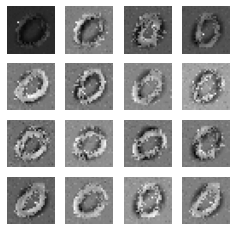

89
gen_loss: tf.Tensor(3.8910415, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0241509, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03836517, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.38686272e-30]
 [1.00000000e+00 1.27619014e-34]
 [1.00000000e+00 3.73812987e-13]
 [1.00000000e+00 2.04348062e-27]
 [1.00000000e+00 6.03430175e-27]
 [1.00000000e+00 1.40826746e-25]
 [1.00000000e+00 1.67331366e-28]
 [1.00000000e+00 1.63365823e-30]
 [1.00000000e+00 3.06062624e-27]
 [1.00000000e+00 1.86306241e-25]
 [1.00000000e+00 2.04247993e-30]
 [1.00000000e+00 8.93304216e-25]
 [1.00000000e+00 3.90174026e-09]
 [1.00000000e+00 2.59585294e-29]
 [1.00000000e+00 2.16057909e-26]
 [1.00000000e+00 1.85217513e-28]
 [1.00000000e+00 1.33098187e-27]
 [1.00000000e+00 2.82702307e-27]
 [1.00000000e+00 1.94753591e-30]
 [1.00000000e+00 3.41038860e-29]
 [9.99907851e-01 9.21479732e-05]
 [1.00000000e+00 4.99056678e-34]
 [1.00000000e+00 4.75411263e-29]
 [1.00000000e+00 4.

gen_loss: tf.Tensor(3.9423568, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.034314632, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.042881772, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.50416032e-30]
 [1.00000000e+00 1.78052784e-34]
 [1.00000000e+00 5.67198686e-13]
 [1.00000000e+00 2.20064652e-27]
 [1.00000000e+00 7.13380860e-27]
 [1.00000000e+00 1.73108882e-25]
 [1.00000000e+00 2.11680838e-28]
 [1.00000000e+00 1.94998902e-30]
 [1.00000000e+00 3.55931152e-27]
 [1.00000000e+00 2.48484973e-25]
 [1.00000000e+00 2.19725435e-30]
 [1.00000000e+00 8.58607253e-25]
 [1.00000000e+00 4.97552799e-09]
 [1.00000000e+00 2.94964446e-29]
 [1.00000000e+00 2.41123825e-26]
 [1.00000000e+00 2.04002131e-28]
 [1.00000000e+00 1.33011896e-27]
 [1.00000000e+00 3.40697200e-27]
 [1.00000000e+00 2.13259483e-30]
 [1.00000000e+00 3.83200475e-29]
 [9.99894381e-01 1.05654006e-04]
 [1.00000000e+00 6.78579185e-34]
 [1.00000000e+00 6.09788481e-29]
 [1.00000000e+00 4.

gen_loss: tf.Tensor(4.042874, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.029149212, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03998172, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.38992861e-30]
 [1.00000000e+00 1.26520202e-33]
 [1.00000000e+00 1.38134382e-12]
 [1.00000000e+00 2.62316050e-27]
 [1.00000000e+00 8.92267936e-27]
 [1.00000000e+00 2.97203642e-25]
 [1.00000000e+00 3.56685331e-28]
 [1.00000000e+00 3.56763890e-30]
 [1.00000000e+00 5.45108008e-27]
 [1.00000000e+00 5.92231408e-25]
 [1.00000000e+00 3.18430361e-30]
 [1.00000000e+00 8.28285609e-25]
 [1.00000000e+00 3.83861298e-09]
 [1.00000000e+00 5.73840577e-29]
 [1.00000000e+00 3.55135196e-26]
 [1.00000000e+00 2.95006221e-28]
 [1.00000000e+00 1.75542563e-27]
 [1.00000000e+00 4.90832337e-27]
 [1.00000000e+00 3.27664819e-30]
 [1.00000000e+00 4.63089283e-29]
 [9.99928832e-01 7.11724206e-05]
 [1.00000000e+00 4.91175502e-33]
 [1.00000000e+00 9.52258607e-29]
 [1.00000000e+00 4.48

gen_loss: tf.Tensor(4.02025, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.035053305, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.044487294, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.26800897e-30]
 [1.00000000e+00 5.04518024e-33]
 [1.00000000e+00 3.16006444e-12]
 [1.00000000e+00 2.94951241e-27]
 [1.00000000e+00 8.19228506e-27]
 [1.00000000e+00 4.29197771e-25]
 [1.00000000e+00 4.61394989e-28]
 [1.00000000e+00 4.43339744e-30]
 [1.00000000e+00 6.71315854e-27]
 [1.00000000e+00 8.89767259e-25]
 [1.00000000e+00 3.15998122e-30]
 [1.00000000e+00 8.23521974e-25]
 [1.00000000e+00 3.42919559e-09]
 [1.00000000e+00 1.45719254e-28]
 [1.00000000e+00 4.89889833e-26]
 [1.00000000e+00 3.30280398e-28]
 [1.00000000e+00 2.87698054e-27]
 [1.00000000e+00 4.10437588e-27]
 [1.00000000e+00 7.29751256e-30]
 [1.00000000e+00 4.02084249e-29]
 [9.99921679e-01 7.83098658e-05]
 [1.00000000e+00 1.65186726e-32]
 [1.00000000e+00 1.07598396e-28]
 [1.00000000e+00 4.42

gen_loss: tf.Tensor(4.048276, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.039740648, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.041341282, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.37442411e-30]
 [1.00000000e+00 2.34808909e-33]
 [1.00000000e+00 7.49881754e-12]
 [1.00000000e+00 2.95473765e-27]
 [1.00000000e+00 4.22251628e-27]
 [1.00000000e+00 2.94886289e-25]
 [1.00000000e+00 4.35816328e-28]
 [1.00000000e+00 2.08667701e-30]
 [1.00000000e+00 7.06655744e-27]
 [1.00000000e+00 7.14566380e-25]
 [1.00000000e+00 1.54944487e-30]
 [1.00000000e+00 9.31600553e-25]
 [1.00000000e+00 5.75760639e-09]
 [1.00000000e+00 1.52160045e-28]
 [1.00000000e+00 6.38639479e-26]
 [1.00000000e+00 1.75416624e-28]
 [1.00000000e+00 3.24625892e-27]
 [1.00000000e+00 1.79953771e-27]
 [1.00000000e+00 1.34238190e-29]
 [1.00000000e+00 2.35155384e-29]
 [9.99840617e-01 1.59371077e-04]
 [1.00000000e+00 6.52357047e-33]
 [1.00000000e+00 8.46775424e-29]
 [1.00000000e+00 4.0

 [1.00000000e+00 7.78554622e-30]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.151717, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.07597987, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03946437, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.68458441e-30]
 [1.00000000e+00 4.29137098e-33]
 [1.00000000e+00 7.79108462e-12]
 [1.00000000e+00 1.37501402e-27]
 [1.00000000e+00 7.90912406e-28]
 [1.00000000e+00 1.02119338e-25]
 [1.00000000e+00 2.24199575e-28]
 [1.00000000e+00 8.13174172e-31]
 [1.00000000e+00 5.75865225e-27]
 [1.00000000e+00 3.16406636e-25]
 [1.00000000e+00 4.55801461e-31]
 [1.00000000e+00 7.74625417e-25]
 [1.00000000e+00 2.68541189e-09]
 [1.00000000e+00 4.97524008e-29]
 [1.00000000e+00 5.56336881e-26]
 [1.00000000e+00 4.65025926e-29]
 [1.00000000e+00 1.81184671e-27]
 [1.00000000e+00 5.79368357e-28]
 [1.00000000e+00 1.09619704e-29]
 [1.00000000e+00 8.66885443e-30]
 [9.99944091e-01 5.59581968e-05]
 [1.00000000e+00 1.365

gen_loss: tf.Tensor(3.924088, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.09783998, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04082158, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.47708295e-30]
 [1.00000000e+00 1.89673011e-33]
 [1.00000000e+00 1.13647538e-11]
 [1.00000000e+00 8.35911952e-28]
 [1.00000000e+00 3.27950240e-28]
 [1.00000000e+00 3.86697459e-26]
 [1.00000000e+00 1.58103152e-28]
 [1.00000000e+00 7.15731803e-31]
 [1.00000000e+00 4.03796982e-27]
 [1.00000000e+00 1.44497797e-25]
 [1.00000000e+00 4.14847332e-31]
 [1.00000000e+00 3.09576210e-25]
 [1.00000000e+00 5.16972554e-09]
 [1.00000000e+00 1.89680627e-29]
 [1.00000000e+00 3.94210065e-26]
 [1.00000000e+00 1.44817564e-29]
 [1.00000000e+00 1.01905210e-27]
 [1.00000000e+00 2.48844112e-28]
 [1.00000000e+00 1.19354754e-29]
 [1.00000000e+00 4.16348927e-30]
 [9.99947786e-01 5.21946458e-05]
 [1.00000000e+00 5.93266819e-33]
 [1.00000000e+00 1.91290855e-29]
 [1.00000000e+00 7.818

gen_loss: tf.Tensor(3.9020853, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03835763, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.038949724, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.46183350e-30]
 [1.00000000e+00 6.83880481e-34]
 [1.00000000e+00 3.44092671e-11]
 [1.00000000e+00 1.00756402e-27]
 [1.00000000e+00 2.29164623e-28]
 [1.00000000e+00 1.96261999e-26]
 [1.00000000e+00 1.98682857e-28]
 [1.00000000e+00 1.63227528e-30]
 [1.00000000e+00 4.34932990e-27]
 [1.00000000e+00 8.47607254e-26]
 [1.00000000e+00 8.26093231e-31]
 [1.00000000e+00 1.34005158e-25]
 [1.00000000e+00 4.43970904e-08]
 [1.00000000e+00 1.43600722e-29]
 [1.00000000e+00 4.48806265e-26]
 [1.00000000e+00 5.57895637e-30]
 [1.00000000e+00 9.63465618e-28]
 [1.00000000e+00 1.45782629e-28]
 [1.00000000e+00 4.07653466e-29]
 [1.00000000e+00 2.42350711e-30]
 [9.99884009e-01 1.16009134e-04]
 [1.00000000e+00 1.60256541e-33]
 [1.00000000e+00 2.56803860e-29]
 [1.00000000e+00 8.8

gen_loss: tf.Tensor(3.9976363, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.027592896, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.031967252, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.59472756e-30]
 [1.00000000e+00 1.61382866e-33]
 [1.00000000e+00 4.22206714e-11]
 [1.00000000e+00 2.08477853e-27]
 [1.00000000e+00 3.58688347e-28]
 [1.00000000e+00 5.26239126e-26]
 [1.00000000e+00 3.29666147e-28]
 [1.00000000e+00 4.95858274e-30]
 [1.00000000e+00 4.96532897e-27]
 [1.00000000e+00 1.57600591e-25]
 [1.00000000e+00 1.40225455e-30]
 [1.00000000e+00 1.88639766e-25]
 [9.99999881e-01 7.69407578e-08]
 [1.00000000e+00 5.23772959e-29]
 [1.00000000e+00 4.63217182e-26]
 [1.00000000e+00 1.20965456e-29]
 [1.00000000e+00 2.16424066e-27]
 [1.00000000e+00 2.39417864e-28]
 [1.00000000e+00 7.34233347e-29]
 [1.00000000e+00 2.73757494e-30]
 [9.99844193e-01 1.55753471e-04]
 [1.00000000e+00 4.19823473e-33]
 [1.00000000e+00 4.50501977e-29]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.824286, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.037925355, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.045677565, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.09585491e-30]
 [1.00000000e+00 2.01348995e-33]
 [1.00000000e+00 7.04520262e-11]
 [1.00000000e+00 4.10533114e-27]
 [1.00000000e+00 5.90700721e-28]
 [1.00000000e+00 1.36976969e-25]
 [1.00000000e+00 4.92717447e-28]
 [1.00000000e+00 9.12189936e-30]
 [1.00000000e+00 6.47314453e-27]
 [1.00000000e+00 3.05051181e-25]
 [1.00000000e+00 2.43990761e-30]
 [1.00000000e+00 3.29229299e-25]
 [9.99999881e-01 1.34588348e-07]
 [1.00000000e+00 1.46163518e-28]
 [1.00000000e+00 6.04324276e-26]
 [1.00000000e+00 2.49315257e-29]
 [1.00000000e+00 4.36099257e-27]
 [1.00000000e+00 4.36859989e-28]
 [1.00000000e+00 1.27098593e-28]
 [1.00000000e+00 3.99154398e-30]
 [9.99664545e-01 3.35414719e-04]
 [1.00000000e+00 5.03837156e-33]
 [1.00000000e+00 7.56258402e-29]
 [1.00000000e+00 3.4

gen_loss: tf.Tensor(3.935298, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.045250252, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.035690166, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.10417107e-29]
 [1.00000000e+00 1.82324647e-33]
 [1.00000000e+00 1.13506787e-10]
 [1.00000000e+00 6.24726261e-27]
 [1.00000000e+00 5.62705307e-28]
 [1.00000000e+00 1.60407642e-25]
 [1.00000000e+00 5.91250767e-28]
 [1.00000000e+00 8.45841950e-30]
 [1.00000000e+00 1.16967395e-26]
 [1.00000000e+00 3.40379306e-25]
 [1.00000000e+00 3.56282445e-30]
 [1.00000000e+00 6.22279465e-25]
 [9.99999881e-01 1.52688884e-07]
 [1.00000000e+00 1.15604571e-28]
 [1.00000000e+00 1.12768776e-25]
 [1.00000000e+00 2.84792136e-29]
 [1.00000000e+00 5.30849964e-27]
 [1.00000000e+00 5.83404769e-28]
 [1.00000000e+00 2.38658302e-28]
 [1.00000000e+00 5.98530089e-30]
 [9.99641657e-01 3.58349178e-04]
 [1.00000000e+00 5.38969450e-33]
 [1.00000000e+00 9.22679032e-29]
 [1.00000000e+00 4.7

gen_loss: tf.Tensor(3.7093773, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.044456877, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04510587, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.56300990e-30]
 [1.00000000e+00 3.34894920e-34]
 [1.00000000e+00 7.05532854e-11]
 [1.00000000e+00 2.79885577e-27]
 [1.00000000e+00 1.61018625e-28]
 [1.00000000e+00 8.25764496e-26]
 [1.00000000e+00 1.77906683e-28]
 [1.00000000e+00 1.55298348e-30]
 [1.00000000e+00 5.33566373e-27]
 [1.00000000e+00 2.17423082e-25]
 [1.00000000e+00 1.18114114e-30]
 [1.00000000e+00 8.27464504e-25]
 [9.99999881e-01 9.47286836e-08]
 [1.00000000e+00 2.67470111e-29]
 [1.00000000e+00 4.75733108e-26]
 [1.00000000e+00 9.26533675e-30]
 [1.00000000e+00 2.16272207e-27]
 [1.00000000e+00 2.71793204e-28]
 [1.00000000e+00 5.40263252e-29]
 [1.00000000e+00 2.82473343e-30]
 [9.99589503e-01 4.10478970e-04]
 [1.00000000e+00 1.21771719e-33]
 [1.00000000e+00 2.73754481e-29]
 [1.00000000e+00 1.8

gen_loss: tf.Tensor(3.687406, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.02408725, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05661101, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.57165139e-30]
 [1.00000000e+00 3.98902649e-33]
 [1.00000000e+00 3.54714799e-11]
 [1.00000000e+00 1.35141580e-27]
 [1.00000000e+00 7.34541496e-29]
 [1.00000000e+00 5.90322858e-26]
 [1.00000000e+00 7.34844168e-29]
 [1.00000000e+00 2.97473967e-30]
 [1.00000000e+00 2.68763177e-27]
 [1.00000000e+00 1.27451745e-25]
 [1.00000000e+00 9.98802880e-31]
 [1.00000000e+00 6.40161857e-25]
 [9.99999881e-01 1.33776012e-07]
 [1.00000000e+00 2.67529304e-29]
 [1.00000000e+00 2.73282248e-26]
 [1.00000000e+00 4.57744534e-30]
 [1.00000000e+00 1.05913725e-27]
 [1.00000000e+00 1.89714006e-28]
 [1.00000000e+00 5.70967029e-29]
 [1.00000000e+00 1.33545017e-30]
 [9.99812901e-01 1.87112688e-04]
 [1.00000000e+00 1.26740052e-32]
 [1.00000000e+00 8.26758843e-30]
 [1.00000000e+00 7.147

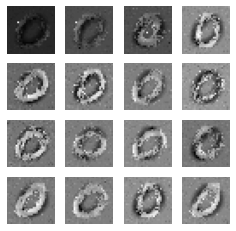

90
gen_loss: tf.Tensor(3.6169393, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.028699074, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.06335337, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.24818318e-30]
 [1.00000000e+00 4.17326208e-33]
 [1.00000000e+00 2.12127260e-11]
 [1.00000000e+00 1.14584714e-27]
 [1.00000000e+00 5.91455794e-29]
 [1.00000000e+00 5.90780212e-26]
 [1.00000000e+00 5.10205264e-29]
 [1.00000000e+00 3.08367339e-30]
 [1.00000000e+00 1.81510500e-27]
 [1.00000000e+00 1.23739883e-25]
 [1.00000000e+00 9.14429751e-31]
 [1.00000000e+00 6.66155810e-25]
 [9.99999881e-01 1.46077269e-07]
 [1.00000000e+00 2.26174336e-29]
 [1.00000000e+00 2.04457324e-26]
 [1.00000000e+00 3.72211804e-30]
 [1.00000000e+00 8.53941448e-28]
 [1.00000000e+00 1.66103297e-28]
 [1.00000000e+00 4.58011990e-29]
 [1.00000000e+00 9.61463161e-31]
 [9.99849319e-01 1.50689491e-04]
 [1.00000000e+00 1.60781384e-32]
 [1.00000000e+00 5.56416395e-30]
 [1.00000000e+00 

gen_loss: tf.Tensor(3.602199, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04487446, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05273464, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.30466558e-30]
 [1.00000000e+00 8.20473476e-34]
 [1.00000000e+00 9.89139933e-12]
 [1.00000000e+00 1.21828319e-27]
 [1.00000000e+00 5.74322360e-29]
 [1.00000000e+00 9.15182311e-26]
 [1.00000000e+00 3.59083830e-29]
 [1.00000000e+00 1.90953208e-30]
 [1.00000000e+00 1.06881322e-27]
 [1.00000000e+00 2.13892264e-25]
 [1.00000000e+00 7.52154966e-31]
 [1.00000000e+00 1.09793247e-24]
 [9.99999881e-01 1.45799746e-07]
 [1.00000000e+00 1.52601149e-29]
 [1.00000000e+00 1.48080778e-26]
 [1.00000000e+00 3.89316469e-30]
 [1.00000000e+00 7.58764157e-28]
 [1.00000000e+00 1.90099409e-28]
 [1.00000000e+00 1.86848216e-29]
 [1.00000000e+00 8.11934261e-31]
 [9.99800265e-01 1.99716364e-04]
 [1.00000000e+00 5.53796107e-33]
 [1.00000000e+00 4.90029026e-30]
 [1.00000000e+00 6.218

gen_loss: tf.Tensor(3.963081, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.032171153, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05099871, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.88009341e-29]
 [1.00000000e+00 4.61705455e-33]
 [1.00000000e+00 1.96117549e-11]
 [1.00000000e+00 3.20193403e-27]
 [1.00000000e+00 1.28445781e-28]
 [1.00000000e+00 3.06857870e-25]
 [1.00000000e+00 9.95798467e-29]
 [1.00000000e+00 7.04805122e-30]
 [1.00000000e+00 3.95841851e-27]
 [1.00000000e+00 9.78583531e-25]
 [1.00000000e+00 1.72954640e-30]
 [1.00000000e+00 5.09490864e-24]
 [9.99999881e-01 1.33271001e-07]
 [1.00000000e+00 5.06165325e-29]
 [1.00000000e+00 5.90971819e-26]
 [1.00000000e+00 1.26890692e-29]
 [1.00000000e+00 2.27865015e-27]
 [1.00000000e+00 7.09540180e-28]
 [1.00000000e+00 5.85448819e-29]
 [1.00000000e+00 2.77350275e-30]
 [9.99774396e-01 2.25659795e-04]
 [1.00000000e+00 2.07158956e-32]
 [1.00000000e+00 1.46250997e-29]
 [1.00000000e+00 1.57

gen_loss: tf.Tensor(4.009343, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.035147563, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.033823896, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.22691128e-29]
 [1.00000000e+00 1.07746506e-31]
 [1.00000000e+00 3.30655156e-11]
 [1.00000000e+00 2.59648945e-27]
 [1.00000000e+00 1.00859025e-28]
 [1.00000000e+00 2.33090130e-25]
 [1.00000000e+00 1.52526165e-28]
 [1.00000000e+00 1.54321065e-29]
 [1.00000000e+00 1.14011417e-26]
 [1.00000000e+00 6.79367110e-25]
 [1.00000000e+00 1.08766997e-30]
 [1.00000000e+00 6.33189382e-24]
 [9.99999881e-01 6.99610894e-08]
 [1.00000000e+00 7.14646639e-29]
 [1.00000000e+00 1.63600113e-25]
 [1.00000000e+00 1.59357071e-29]
 [1.00000000e+00 2.56076306e-27]
 [1.00000000e+00 7.61658300e-28]
 [1.00000000e+00 2.00015179e-28]
 [1.00000000e+00 3.35993525e-30]
 [9.99911189e-01 8.87522765e-05]
 [1.00000000e+00 2.19048271e-31]
 [1.00000000e+00 1.17109638e-29]
 [1.00000000e+00 1.0

gen_loss: tf.Tensor(4.1345177, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.041973233, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.033586, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.06385483e-29]
 [1.00000000e+00 4.92987196e-32]
 [1.00000000e+00 5.85983762e-11]
 [1.00000000e+00 5.70836969e-27]
 [1.00000000e+00 2.55038914e-28]
 [1.00000000e+00 3.61750435e-25]
 [1.00000000e+00 4.34006291e-28]
 [1.00000000e+00 2.11192753e-29]
 [1.00000000e+00 2.56523253e-26]
 [1.00000000e+00 1.34309209e-24]
 [1.00000000e+00 1.64633306e-30]
 [1.00000000e+00 9.88707614e-24]
 [9.99999881e-01 1.45866224e-07]
 [1.00000000e+00 1.47889825e-28]
 [1.00000000e+00 4.19351407e-25]
 [1.00000000e+00 3.16221387e-29]
 [1.00000000e+00 4.58274607e-27]
 [1.00000000e+00 1.42053530e-27]
 [1.00000000e+00 4.58716887e-28]
 [1.00000000e+00 7.41441125e-30]
 [9.99770939e-01 2.29065103e-04]
 [1.00000000e+00 9.58244187e-32]
 [1.00000000e+00 2.90205383e-29]
 [1.00000000e+00 2.599

gen_loss: tf.Tensor(3.964127, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03959386, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.039733708, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.95811254e-29]
 [1.00000000e+00 1.00346869e-32]
 [1.00000000e+00 5.08125868e-11]
 [1.00000000e+00 6.32879300e-27]
 [1.00000000e+00 3.64059019e-28]
 [1.00000000e+00 4.37509407e-25]
 [1.00000000e+00 4.92296631e-28]
 [1.00000000e+00 1.54289287e-29]
 [1.00000000e+00 1.86509521e-26]
 [1.00000000e+00 1.95421731e-24]
 [1.00000000e+00 1.92858017e-30]
 [1.00000000e+00 8.69637106e-24]
 [9.99999762e-01 2.73438644e-07]
 [1.00000000e+00 1.54830022e-28]
 [1.00000000e+00 3.29798709e-25]
 [1.00000000e+00 3.21826625e-29]
 [1.00000000e+00 4.06937596e-27]
 [1.00000000e+00 1.63367951e-27]
 [1.00000000e+00 3.04873892e-28]
 [1.00000000e+00 8.13307953e-30]
 [9.99417067e-01 5.82956127e-04]
 [1.00000000e+00 2.54173029e-32]
 [1.00000000e+00 3.77518621e-29]
 [1.00000000e+00 3.15

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.91667887e-29]
 [1.00000000e+00 5.73524282e-33]
 [1.00000000e+00 3.66655178e-11]
 [1.00000000e+00 6.47119395e-27]
 [1.00000000e+00 4.56137874e-28]
 [1.00000000e+00 5.33707395e-25]
 [1.00000000e+00 5.09806704e-28]
 [1.00000000e+00 1.77943920e-29]
 [1.00000000e+00 1.26556855e-26]
 [1.00000000e+00 2.66174055e-24]
 [1.00000000e+00 3.07165119e-30]
 [1.00000000e+00 6.28204333e-24]
 [9.99999642e-01 4.06380025e-07]
 [1.00000000e+00 1.41078702e-28]
 [1.00000000e+00 2.30737772e-25]
 [1.00000000e+00 3.41752537e-29]
 [1.00000000e+00 3.75426609e-27]
 [1.00000000e+00 1.98199242e-27]
 [1.00000000e+00 1.99951094e-28]
 [1.00000000e+00 9.01308131e-30]
 [9.99134600e-01 8.65393260e-04]
 [1.00000000e+00 2.13803394e-32]
 [1.00000000e+00 4.37281581e-29]
 [1.00000000e+00 3.27402746e-28]
 [1.00000000e+00 1.45569730e-29]
 [1.00000000e+00 1.86696303e-23]
 [1.00000000e+00 5.94981450e-29]
 [1.00000000e+00 8.54858685e-25]
 [1.00000000e+00 7.95487894e-12]
 [1.0

gen_loss: tf.Tensor(4.1286664, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04612027, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.031698518, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.11932448e-28]
 [1.00000000e+00 7.64523673e-33]
 [1.00000000e+00 1.88283798e-11]
 [1.00000000e+00 2.76262036e-27]
 [1.00000000e+00 2.92039037e-28]
 [1.00000000e+00 2.70191319e-25]
 [1.00000000e+00 2.96597256e-28]
 [1.00000000e+00 2.61240300e-29]
 [1.00000000e+00 4.63305328e-27]
 [1.00000000e+00 1.60599981e-24]
 [1.00000000e+00 5.09052173e-30]
 [1.00000000e+00 1.30297674e-24]
 [9.99999404e-01 5.58521492e-07]
 [1.00000000e+00 3.84524221e-29]
 [1.00000000e+00 8.14912051e-26]
 [1.00000000e+00 2.11836631e-29]
 [1.00000000e+00 1.76107304e-27]
 [1.00000000e+00 1.19621069e-27]
 [1.00000000e+00 6.50256482e-29]
 [1.00000000e+00 5.29051940e-30]
 [9.99449790e-01 5.50208963e-04]
 [1.00000000e+00 5.18854273e-32]
 [1.00000000e+00 2.53988301e-29]
 [1.00000000e+00 1.2

gen_loss: tf.Tensor(3.9279642, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051165897, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03621622, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.73678111e-28]
 [1.00000000e+00 1.27284644e-32]
 [1.00000000e+00 6.30987276e-11]
 [1.00000000e+00 5.72295630e-27]
 [1.00000000e+00 5.39622941e-28]
 [1.00000000e+00 2.91784488e-25]
 [1.00000000e+00 8.58435606e-28]
 [1.00000000e+00 5.45415295e-29]
 [1.00000000e+00 1.44433252e-26]
 [1.00000000e+00 2.53015125e-24]
 [1.00000000e+00 1.07939970e-29]
 [1.00000000e+00 2.89645408e-24]
 [9.99997616e-01 2.32641241e-06]
 [1.00000000e+00 6.81972636e-29]
 [1.00000000e+00 2.78556548e-25]
 [1.00000000e+00 3.29697419e-29]
 [1.00000000e+00 4.73211541e-27]
 [1.00000000e+00 1.21644884e-27]
 [1.00000000e+00 2.75026383e-28]
 [1.00000000e+00 8.01578964e-30]
 [9.98833358e-01 1.16665859e-03]
 [1.00000000e+00 5.68729323e-32]
 [1.00000000e+00 6.15349904e-29]
 [1.00000000e+00 2.6

gen_loss: tf.Tensor(4.0329857, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.08706183, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.038777363, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.87314984e-29]
 [1.00000000e+00 9.27377322e-33]
 [1.00000000e+00 1.31786249e-10]
 [1.00000000e+00 2.49138683e-27]
 [1.00000000e+00 1.47041525e-28]
 [1.00000000e+00 8.04932775e-26]
 [1.00000000e+00 5.82708594e-28]
 [1.00000000e+00 1.07282348e-29]
 [1.00000000e+00 1.09677181e-26]
 [1.00000000e+00 7.36872358e-25]
 [1.00000000e+00 2.31835623e-30]
 [1.00000000e+00 2.29856752e-24]
 [9.99997258e-01 2.68368831e-06]
 [1.00000000e+00 2.65242894e-29]
 [1.00000000e+00 2.01991422e-25]
 [1.00000000e+00 1.23693377e-29]
 [1.00000000e+00 3.09812178e-27]
 [1.00000000e+00 1.91364672e-28]
 [1.00000000e+00 8.90437761e-29]
 [1.00000000e+00 2.04880089e-30]
 [9.98195231e-01 1.80481689e-03]
 [1.00000000e+00 2.58167800e-32]
 [1.00000000e+00 2.36245130e-29]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(3.9844208, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03357684, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03910619, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.59112449e-29]
 [1.00000000e+00 1.06191033e-31]
 [1.00000000e+00 1.54600083e-10]
 [1.00000000e+00 1.95744490e-27]
 [1.00000000e+00 1.20486105e-28]
 [1.00000000e+00 8.72294224e-26]
 [1.00000000e+00 7.89007902e-28]
 [1.00000000e+00 1.69966357e-29]
 [1.00000000e+00 1.27767618e-26]
 [1.00000000e+00 5.71020467e-25]
 [1.00000000e+00 4.44148898e-30]
 [1.00000000e+00 1.66290025e-24]
 [9.99998808e-01 1.19410879e-06]
 [1.00000000e+00 4.06188104e-29]
 [1.00000000e+00 1.97963695e-25]
 [1.00000000e+00 1.75225259e-29]
 [1.00000000e+00 3.60225667e-27]
 [1.00000000e+00 2.36184878e-28]
 [1.00000000e+00 5.57689548e-29]
 [1.00000000e+00 2.17543643e-30]
 [9.98769104e-01 1.23083766e-03]
 [1.00000000e+00 2.74909549e-31]
 [1.00000000e+00 2.08450605e-29]
 [1.00000000e+00 9.27

gen_loss: tf.Tensor(3.9287572, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.034976255, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.039220043, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.65886847e-29]
 [1.00000000e+00 1.99210675e-32]
 [1.00000000e+00 2.23333088e-10]
 [1.00000000e+00 3.31010889e-27]
 [1.00000000e+00 2.87524561e-28]
 [1.00000000e+00 8.36320996e-26]
 [1.00000000e+00 1.53709027e-27]
 [1.00000000e+00 9.90180394e-30]
 [1.00000000e+00 2.09985667e-26]
 [1.00000000e+00 4.08183355e-25]
 [1.00000000e+00 6.61835443e-30]
 [1.00000000e+00 1.50019769e-24]
 [9.99997377e-01 2.59661920e-06]
 [1.00000000e+00 5.83144143e-29]
 [1.00000000e+00 3.40904268e-25]
 [1.00000000e+00 3.21833998e-29]
 [1.00000000e+00 6.50711254e-27]
 [1.00000000e+00 3.12725860e-28]
 [1.00000000e+00 8.67570653e-29]
 [1.00000000e+00 3.36930460e-30]
 [9.97111320e-01 2.88865506e-03]
 [1.00000000e+00 6.19785039e-32]
 [1.00000000e+00 4.60359217e-29]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(3.6771011, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.028689891, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.05589722, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.97332979e-29]
 [1.00000000e+00 1.99693039e-32]
 [1.00000000e+00 1.89842808e-10]
 [1.00000000e+00 2.15291851e-27]
 [1.00000000e+00 1.77476924e-28]
 [1.00000000e+00 5.89373328e-26]
 [1.00000000e+00 9.26598215e-28]
 [1.00000000e+00 7.85397617e-30]
 [1.00000000e+00 1.47406718e-26]
 [1.00000000e+00 2.21730805e-25]
 [1.00000000e+00 2.98007792e-30]
 [1.00000000e+00 1.18592596e-24]
 [9.99997497e-01 2.45200499e-06]
 [1.00000000e+00 4.39730492e-29]
 [1.00000000e+00 2.50404247e-25]
 [1.00000000e+00 2.01566128e-29]
 [1.00000000e+00 4.09714864e-27]
 [1.00000000e+00 2.12960546e-28]
 [1.00000000e+00 6.62914717e-29]
 [1.00000000e+00 2.17769488e-30]
 [9.97324824e-01 2.67509511e-03]
 [1.00000000e+00 6.87999799e-32]
 [1.00000000e+00 2.47218476e-29]
 [1.00000000e+00 1.2

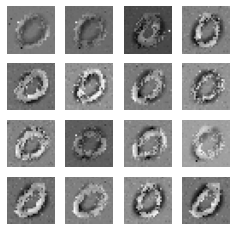

91
gen_loss: tf.Tensor(3.9250379, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.018472668, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.044443823, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.69107498e-29]
 [1.00000000e+00 2.39097946e-32]
 [1.00000000e+00 2.00822831e-10]
 [1.00000000e+00 2.35730436e-27]
 [1.00000000e+00 1.58374780e-28]
 [1.00000000e+00 7.47314868e-26]
 [1.00000000e+00 8.30141191e-28]
 [1.00000000e+00 8.56655144e-30]
 [1.00000000e+00 1.56198188e-26]
 [1.00000000e+00 3.26386959e-25]
 [1.00000000e+00 2.45050380e-30]
 [1.00000000e+00 1.95570136e-24]
 [9.99998093e-01 1.89021557e-06]
 [1.00000000e+00 4.65796449e-29]
 [1.00000000e+00 2.60719145e-25]
 [1.00000000e+00 2.05189133e-29]
 [1.00000000e+00 4.53253592e-27]
 [1.00000000e+00 2.37793150e-28]
 [1.00000000e+00 5.49625920e-29]
 [1.00000000e+00 2.47300407e-30]
 [9.97177839e-01 2.82213767e-03]
 [1.00000000e+00 8.07673940e-32]
 [1.00000000e+00 2.44892570e-29]
 [1.00000000e+00

gen_loss: tf.Tensor(3.725781, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04063248, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04696019, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.97809484e-30]
 [1.00000000e+00 1.10099387e-32]
 [1.00000000e+00 1.56266194e-10]
 [1.00000000e+00 1.87333703e-27]
 [1.00000000e+00 8.92982155e-29]
 [1.00000000e+00 8.24046320e-26]
 [1.00000000e+00 4.17233319e-28]
 [1.00000000e+00 4.33205290e-30]
 [1.00000000e+00 9.87627969e-27]
 [1.00000000e+00 6.00399915e-25]
 [1.00000000e+00 1.12439025e-30]
 [1.00000000e+00 3.26712246e-24]
 [9.99999404e-01 6.07342258e-07]
 [1.00000000e+00 2.50405650e-29]
 [1.00000000e+00 1.53954476e-25]
 [1.00000000e+00 1.28078268e-29]
 [1.00000000e+00 2.85477688e-27]
 [1.00000000e+00 2.01335681e-28]
 [1.00000000e+00 1.46401716e-29]
 [1.00000000e+00 2.47081653e-30]
 [9.96769905e-01 3.23008397e-03]
 [1.00000000e+00 4.57744054e-32]
 [1.00000000e+00 1.84167653e-29]
 [1.00000000e+00 1.177

gen_loss: tf.Tensor(3.9504263, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04796482, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.045610834, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.07301991e-29]
 [1.00000000e+00 3.65417443e-33]
 [1.00000000e+00 8.53957044e-11]
 [1.00000000e+00 1.19893338e-27]
 [1.00000000e+00 8.86127529e-29]
 [1.00000000e+00 5.80191665e-26]
 [1.00000000e+00 2.34828301e-28]
 [1.00000000e+00 3.92891138e-30]
 [1.00000000e+00 3.39773100e-27]
 [1.00000000e+00 3.60198549e-25]
 [1.00000000e+00 1.38213761e-30]
 [1.00000000e+00 8.86501276e-25]
 [9.99999166e-01 8.70405643e-07]
 [1.00000000e+00 1.59836808e-29]
 [1.00000000e+00 5.72645286e-26]
 [1.00000000e+00 7.04783606e-30]
 [1.00000000e+00 1.30076981e-27]
 [1.00000000e+00 2.08843101e-28]
 [1.00000000e+00 7.08919917e-30]
 [1.00000000e+00 2.04653548e-30]
 [9.91313875e-01 8.68609641e-03]
 [1.00000000e+00 1.84104853e-32]
 [1.00000000e+00 1.44201266e-29]
 [1.00000000e+00 8.4

gen_loss: tf.Tensor(4.050739, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.033176497, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.036400862, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.98835295e-29]
 [1.00000000e+00 5.56838102e-33]
 [1.00000000e+00 7.00921474e-11]
 [1.00000000e+00 2.53000269e-27]
 [1.00000000e+00 4.82263017e-28]
 [1.00000000e+00 1.36164245e-25]
 [1.00000000e+00 3.96353879e-28]
 [1.00000000e+00 2.08555583e-29]
 [1.00000000e+00 2.44655657e-27]
 [1.00000000e+00 8.19410628e-25]
 [1.00000000e+00 1.33137656e-29]
 [1.00000000e+00 3.28512940e-25]
 [9.99996305e-01 3.67814710e-06]
 [1.00000000e+00 4.72925971e-29]
 [1.00000000e+00 4.59508981e-26]
 [1.00000000e+00 1.24809123e-29]
 [1.00000000e+00 1.36146453e-27]
 [1.00000000e+00 1.17407665e-27]
 [1.00000000e+00 1.07108149e-29]
 [1.00000000e+00 6.97891861e-30]
 [9.66202199e-01 3.37978117e-02]
 [1.00000000e+00 3.11528631e-32]
 [1.00000000e+00 5.49672082e-29]
 [1.00000000e+00 2.1

gen_loss: tf.Tensor(4.1253586, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.037857812, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032809336, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.23495625e-29]
 [1.00000000e+00 9.82979380e-33]
 [1.00000000e+00 3.92309379e-11]
 [1.00000000e+00 3.07211287e-27]
 [1.00000000e+00 6.65364933e-28]
 [1.00000000e+00 1.65931924e-25]
 [1.00000000e+00 3.54283745e-28]
 [1.00000000e+00 2.48720612e-29]
 [1.00000000e+00 1.93411611e-27]
 [1.00000000e+00 8.24307729e-25]
 [1.00000000e+00 1.70454640e-29]
 [1.00000000e+00 2.86759345e-25]
 [9.99995589e-01 4.40768235e-06]
 [1.00000000e+00 3.10164247e-29]
 [1.00000000e+00 3.58826941e-26]
 [1.00000000e+00 1.54609789e-29]
 [1.00000000e+00 9.46858227e-28]
 [1.00000000e+00 1.82980177e-27]
 [1.00000000e+00 6.79502766e-30]
 [1.00000000e+00 9.70436076e-30]
 [9.70119417e-01 2.98805684e-02]
 [1.00000000e+00 7.21523840e-32]
 [1.00000000e+00 6.73883489e-29]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(4.12942, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.031232048, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.035372093, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.62818661e-29]
 [1.00000000e+00 1.53251373e-32]
 [1.00000000e+00 6.20555760e-11]
 [1.00000000e+00 1.03723869e-26]
 [1.00000000e+00 8.56826010e-28]
 [1.00000000e+00 3.53204730e-25]
 [1.00000000e+00 7.21475794e-28]
 [1.00000000e+00 1.80068943e-29]
 [1.00000000e+00 8.13715724e-27]
 [1.00000000e+00 2.47014556e-24]
 [1.00000000e+00 9.92252499e-30]
 [1.00000000e+00 3.26530335e-24]
 [9.99997616e-01 2.35478933e-06]
 [1.00000000e+00 3.83835431e-29]
 [1.00000000e+00 1.42011418e-25]
 [1.00000000e+00 3.98188905e-29]
 [1.00000000e+00 2.11003729e-27]
 [1.00000000e+00 3.07241755e-27]
 [1.00000000e+00 9.82204937e-30]
 [1.00000000e+00 2.37425032e-29]
 [9.79240954e-01 2.07590740e-02]
 [1.00000000e+00 1.14897003e-31]
 [1.00000000e+00 1.51386544e-28]
 [1.00000000e+00 8.64

gen_loss: tf.Tensor(4.2446103, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04045055, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032520726, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.32856969e-29]
 [1.00000000e+00 2.47358659e-32]
 [1.00000000e+00 8.83836615e-11]
 [1.00000000e+00 2.05259112e-26]
 [1.00000000e+00 7.04647211e-28]
 [1.00000000e+00 4.61931062e-25]
 [1.00000000e+00 1.13392419e-27]
 [1.00000000e+00 1.57986712e-29]
 [1.00000000e+00 2.07629531e-26]
 [1.00000000e+00 3.48979443e-24]
 [1.00000000e+00 5.65295120e-30]
 [1.00000000e+00 1.06553423e-23]
 [9.99998808e-01 1.22648771e-06]
 [1.00000000e+00 5.23461379e-29]
 [1.00000000e+00 3.36755303e-25]
 [1.00000000e+00 6.89485328e-29]
 [1.00000000e+00 3.53096606e-27]
 [1.00000000e+00 3.80915624e-27]
 [1.00000000e+00 1.45535304e-29]
 [1.00000000e+00 3.46766395e-29]
 [9.85552609e-01 1.44473352e-02]
 [1.00000000e+00 1.59742782e-31]
 [1.00000000e+00 1.97438490e-28]
 [1.00000000e+00 1.5

gen_loss: tf.Tensor(4.1991243, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.029256925, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032010972, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.11521587e-28]
 [1.00000000e+00 9.43927959e-32]
 [1.00000000e+00 7.34940581e-11]
 [1.00000000e+00 1.23011734e-26]
 [1.00000000e+00 3.46599934e-28]
 [1.00000000e+00 2.51006764e-25]
 [1.00000000e+00 9.06488136e-28]
 [1.00000000e+00 2.45429393e-29]
 [1.00000000e+00 1.61058110e-26]
 [1.00000000e+00 1.11125169e-24]
 [1.00000000e+00 4.98460311e-30]
 [1.00000000e+00 2.33731322e-24]
 [9.99999285e-01 7.36881418e-07]
 [1.00000000e+00 6.75345150e-29]
 [1.00000000e+00 2.35826023e-25]
 [1.00000000e+00 5.97405834e-29]
 [1.00000000e+00 2.44651921e-27]
 [1.00000000e+00 3.70412103e-27]
 [1.00000000e+00 1.93915251e-29]
 [1.00000000e+00 2.37329052e-29]
 [9.90987122e-01 9.01285745e-03]
 [1.00000000e+00 4.82032382e-31]
 [1.00000000e+00 1.10584514e-28]
 [1.00000000e+00 8.

gen_loss: tf.Tensor(4.173622, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.050894663, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.036612615, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.23587322e-28]
 [1.00000000e+00 2.28416302e-31]
 [1.00000000e+00 4.12778110e-11]
 [1.00000000e+00 7.44670828e-27]
 [1.00000000e+00 1.85417581e-28]
 [1.00000000e+00 2.58818533e-25]
 [1.00000000e+00 5.80390352e-28]
 [1.00000000e+00 2.22128259e-29]
 [1.00000000e+00 8.21616505e-27]
 [1.00000000e+00 9.14844260e-25]
 [1.00000000e+00 3.95879000e-30]
 [1.00000000e+00 1.26361120e-24]
 [9.99999762e-01 2.63338819e-07]
 [1.00000000e+00 1.32921040e-28]
 [1.00000000e+00 1.25830981e-25]
 [1.00000000e+00 5.19459056e-29]
 [1.00000000e+00 2.03597989e-27]
 [1.00000000e+00 3.34631792e-27]
 [1.00000000e+00 1.50352250e-29]
 [1.00000000e+00 1.48928612e-29]
 [9.95345652e-01 4.65434603e-03]
 [1.00000000e+00 1.05020809e-30]
 [1.00000000e+00 7.06498632e-29]
 [1.00000000e+00 4.5

gen_loss: tf.Tensor(4.1673255, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03404089, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032224823, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 2.8345253e-29]
 [1.0000000e+00 1.2232629e-32]
 [1.0000000e+00 2.7191274e-11]
 [1.0000000e+00 1.5886506e-26]
 [1.0000000e+00 3.0577537e-28]
 [1.0000000e+00 5.0936818e-25]
 [1.0000000e+00 8.5151478e-28]
 [1.0000000e+00 5.2522329e-30]
 [1.0000000e+00 8.7706518e-27]
 [1.0000000e+00 2.9741247e-24]
 [1.0000000e+00 2.5265942e-30]
 [1.0000000e+00 5.6647549e-24]
 [9.9999976e-01 2.3615220e-07]
 [1.0000000e+00 2.2564101e-28]
 [1.0000000e+00 1.6636037e-25]
 [1.0000000e+00 7.1712086e-29]
 [1.0000000e+00 3.7595254e-27]
 [1.0000000e+00 3.4307476e-27]
 [1.0000000e+00 9.7432344e-30]
 [1.0000000e+00 1.8809685e-29]
 [9.9360895e-01 6.3910182e-03]
 [1.0000000e+00 7.3302599e-32]
 [1.0000000e+00 1.5590275e-28]
 [1.0000000e+00 1.1586113e-27]
 [1.0000000e+00 1.4353829e-29]
 [1.

gen_loss: tf.Tensor(4.1879425, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.039156448, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032609902, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 1.8812413e-29]
 [1.0000000e+00 5.0806008e-33]
 [1.0000000e+00 3.4669486e-11]
 [1.0000000e+00 2.7778498e-26]
 [1.0000000e+00 4.5763673e-28]
 [1.0000000e+00 8.1269905e-25]
 [1.0000000e+00 1.3385583e-27]
 [1.0000000e+00 4.6437511e-30]
 [1.0000000e+00 1.4553607e-26]
 [1.0000000e+00 6.8874310e-24]
 [1.0000000e+00 2.6867563e-30]
 [1.0000000e+00 1.5055302e-23]
 [9.9999976e-01 2.8890133e-07]
 [1.0000000e+00 3.6862314e-28]
 [1.0000000e+00 2.8961100e-25]
 [1.0000000e+00 9.2587343e-29]
 [1.0000000e+00 6.4816695e-27]
 [1.0000000e+00 4.3351839e-27]
 [1.0000000e+00 1.4055274e-29]
 [1.0000000e+00 2.6600487e-29]
 [9.9206662e-01 7.9334145e-03]
 [1.0000000e+00 2.6899942e-32]
 [1.0000000e+00 3.0257866e-28]
 [1.0000000e+00 2.1536167e-27]
 [1.0000000e+00 1.5247547e-29]
 [1

gen_loss: tf.Tensor(4.1353064, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.025264408, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.033182025, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.27510586e-29]
 [1.00000000e+00 2.55479503e-32]
 [1.00000000e+00 5.06769869e-11]
 [1.00000000e+00 2.46757186e-26]
 [1.00000000e+00 4.70487978e-28]
 [1.00000000e+00 7.50849988e-25]
 [1.00000000e+00 1.67526881e-27]
 [1.00000000e+00 1.29997969e-29]
 [1.00000000e+00 2.33066890e-26]
 [1.00000000e+00 1.03089337e-23]
 [1.00000000e+00 4.59031484e-30]
 [1.00000000e+00 1.40648109e-23]
 [9.99999642e-01 3.69578743e-07]
 [1.00000000e+00 7.36239058e-28]
 [1.00000000e+00 4.49526125e-25]
 [1.00000000e+00 8.86296590e-29]
 [1.00000000e+00 8.52887137e-27]
 [1.00000000e+00 5.24897569e-27]
 [1.00000000e+00 4.82088041e-29]
 [1.00000000e+00 3.32925278e-29]
 [9.94530618e-01 5.46935247e-03]
 [1.00000000e+00 6.64577251e-32]
 [1.00000000e+00 4.78959277e-28]
 [1.00000000e+00 1.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.70901728e-29]
 [1.00000000e+00 6.20712504e-32]
 [1.00000000e+00 4.60085164e-11]
 [1.00000000e+00 1.99455360e-26]
 [1.00000000e+00 4.07571265e-28]
 [1.00000000e+00 7.05589734e-25]
 [1.00000000e+00 1.63561257e-27]
 [1.00000000e+00 1.99799268e-29]
 [1.00000000e+00 2.33690075e-26]
 [1.00000000e+00 1.05532416e-23]
 [1.00000000e+00 5.49095454e-30]
 [1.00000000e+00 1.12800728e-23]
 [9.99999642e-01 3.38920472e-07]
 [1.00000000e+00 8.92162010e-28]
 [1.00000000e+00 4.34384630e-25]
 [1.00000000e+00 8.89127587e-29]
 [1.00000000e+00 9.34033498e-27]
 [1.00000000e+00 5.11966336e-27]
 [1.00000000e+00 6.39931030e-29]
 [1.00000000e+00 3.23303212e-29]
 [9.96043801e-01 3.95627739e-03]
 [1.00000000e+00 1.29492998e-31]
 [1.00000000e+00 4.65127296e-28]
 [1.00000000e+00 1.44742052e-27]
 [1.00000000e+00 1.27874210e-29]
 [1.00000000e+00 4.61503509e-23]
 [1.00000000e+00 6.39638168e-29]
 [1.00000000e+00 1.65597504e-24]
 [1.00000000e+00 7.40269066e-13]
 [1.0

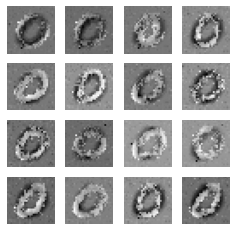

92
gen_loss: tf.Tensor(4.3767204, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.02049225, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03149976, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.53301557e-29]
 [1.00000000e+00 6.96486868e-32]
 [1.00000000e+00 3.10870704e-11]
 [1.00000000e+00 1.11387345e-26]
 [1.00000000e+00 2.54336479e-28]
 [1.00000000e+00 4.71953737e-25]
 [1.00000000e+00 1.14621432e-27]
 [1.00000000e+00 1.62892356e-29]
 [1.00000000e+00 1.54293643e-26]
 [1.00000000e+00 7.40053134e-24]
 [1.00000000e+00 4.13052126e-30]
 [1.00000000e+00 6.94325077e-24]
 [9.99999762e-01 2.51620406e-07]
 [1.00000000e+00 7.02325936e-28]
 [1.00000000e+00 2.85798340e-25]
 [1.00000000e+00 6.80164428e-29]
 [1.00000000e+00 7.31974404e-27]
 [1.00000000e+00 3.30106742e-27]
 [1.00000000e+00 4.73818007e-29]
 [1.00000000e+00 2.20598152e-29]
 [9.97357428e-01 2.64259032e-03]
 [1.00000000e+00 1.34143865e-31]
 [1.00000000e+00 2.99183587e-28]
 [1.00000000e+00 7

gen_loss: tf.Tensor(4.1130524, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.034817077, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.031002227, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.66413251e-30]
 [1.00000000e+00 2.93538296e-33]
 [1.00000000e+00 2.07998965e-11]
 [1.00000000e+00 5.49569887e-27]
 [1.00000000e+00 1.20799971e-28]
 [1.00000000e+00 2.04522174e-25]
 [1.00000000e+00 5.94845563e-28]
 [1.00000000e+00 2.10270605e-30]
 [1.00000000e+00 6.44031243e-27]
 [1.00000000e+00 4.05271334e-24]
 [1.00000000e+00 1.22521626e-30]
 [1.00000000e+00 5.19777532e-24]
 [9.99999762e-01 2.29523096e-07]
 [1.00000000e+00 4.12514020e-28]
 [1.00000000e+00 1.38618047e-25]
 [1.00000000e+00 3.35833522e-29]
 [1.00000000e+00 6.29693311e-27]
 [1.00000000e+00 9.29192828e-28]
 [1.00000000e+00 1.93185775e-29]
 [1.00000000e+00 9.05450385e-30]
 [9.95417595e-01 4.58243256e-03]
 [1.00000000e+00 5.55175219e-33]
 [1.00000000e+00 1.54087612e-28]
 [1.00000000e+00 4.

gen_loss: tf.Tensor(4.2762585, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.047387727, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.034250412, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.33446634e-30]
 [1.00000000e+00 5.48539810e-33]
 [1.00000000e+00 1.39338992e-11]
 [1.00000000e+00 3.49449165e-27]
 [1.00000000e+00 7.75268294e-29]
 [1.00000000e+00 1.47759219e-25]
 [1.00000000e+00 4.51481120e-28]
 [1.00000000e+00 1.33294618e-30]
 [1.00000000e+00 4.88244079e-27]
 [1.00000000e+00 2.88597643e-24]
 [1.00000000e+00 8.40011837e-31]
 [1.00000000e+00 3.99353615e-24]
 [9.99999881e-01 1.18459091e-07]
 [1.00000000e+00 4.77745797e-28]
 [1.00000000e+00 9.18448873e-26]
 [1.00000000e+00 3.21463467e-29]
 [1.00000000e+00 6.21645350e-27]
 [1.00000000e+00 4.98462688e-28]
 [1.00000000e+00 1.83799890e-29]
 [1.00000000e+00 5.78996607e-30]
 [9.97832716e-01 2.16732919e-03]
 [1.00000000e+00 1.13619449e-32]
 [1.00000000e+00 8.65659890e-29]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(4.185995, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.031069703, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.037965626, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.00212907e-30]
 [1.00000000e+00 3.16473113e-32]
 [1.00000000e+00 7.70842678e-12]
 [1.00000000e+00 2.58447299e-27]
 [1.00000000e+00 5.96449430e-29]
 [1.00000000e+00 8.04493786e-26]
 [1.00000000e+00 4.05607683e-28]
 [1.00000000e+00 1.09674441e-30]
 [1.00000000e+00 5.08701615e-27]
 [1.00000000e+00 1.34212929e-24]
 [1.00000000e+00 7.26442955e-31]
 [1.00000000e+00 2.28745859e-24]
 [9.99999881e-01 8.84338718e-08]
 [1.00000000e+00 3.65656819e-28]
 [1.00000000e+00 7.62970614e-26]
 [1.00000000e+00 2.83913521e-29]
 [1.00000000e+00 3.82873563e-27]
 [1.00000000e+00 3.17215877e-28]
 [1.00000000e+00 2.75712189e-29]
 [1.00000000e+00 3.89679010e-30]
 [9.99454081e-01 5.45878545e-04]
 [1.00000000e+00 9.36446466e-32]
 [1.00000000e+00 4.68426517e-29]
 [1.00000000e+00 1.7

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.75357840e-30]
 [1.00000000e+00 1.01325438e-32]
 [1.00000000e+00 6.39721782e-12]
 [1.00000000e+00 1.89862527e-27]
 [1.00000000e+00 4.07566378e-29]
 [1.00000000e+00 3.05822360e-26]
 [1.00000000e+00 3.18664007e-28]
 [1.00000000e+00 3.74594667e-31]
 [1.00000000e+00 4.44290237e-27]
 [1.00000000e+00 4.80171054e-25]
 [1.00000000e+00 3.75083696e-31]
 [1.00000000e+00 1.30531503e-24]
 [9.99999881e-01 1.23589800e-07]
 [1.00000000e+00 1.25152934e-28]
 [1.00000000e+00 6.36776103e-26]
 [1.00000000e+00 1.61517468e-29]
 [1.00000000e+00 2.11766551e-27]
 [1.00000000e+00 1.38449254e-28]
 [1.00000000e+00 2.44384907e-29]
 [1.00000000e+00 2.13293657e-30]
 [9.99541163e-01 4.58888448e-04]
 [1.00000000e+00 3.65873733e-32]
 [1.00000000e+00 2.75836321e-29]
 [1.00000000e+00 1.26213448e-28]
 [1.00000000e+00 1.07497360e-30]
 [1.00000000e+00 8.16917374e-24]
 [1.00000000e+00 4.65645173e-30]
 [1.00000000e+00 1.16566130e-25]
 [1.00000000e+00 3.30121867e-12]
 [1.0

gen_loss: tf.Tensor(4.218725, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.062244568, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03962934, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.12757330e-30]
 [1.00000000e+00 1.81816246e-33]
 [1.00000000e+00 1.07215417e-11]
 [1.00000000e+00 2.31050214e-27]
 [1.00000000e+00 6.35692660e-29]
 [1.00000000e+00 2.11259955e-26]
 [1.00000000e+00 3.67589634e-28]
 [1.00000000e+00 3.30553431e-31]
 [1.00000000e+00 5.22711600e-27]
 [1.00000000e+00 2.66131274e-25]
 [1.00000000e+00 6.39779069e-31]
 [1.00000000e+00 4.68899415e-25]
 [9.99999523e-01 5.02243211e-07]
 [1.00000000e+00 6.51865897e-29]
 [1.00000000e+00 5.78134834e-26]
 [1.00000000e+00 1.35096086e-29]
 [1.00000000e+00 1.27410791e-27]
 [1.00000000e+00 1.63326106e-28]
 [1.00000000e+00 2.51205498e-29]
 [1.00000000e+00 2.46851782e-30]
 [9.98805404e-01 1.19462248e-03]
 [1.00000000e+00 5.96211653e-33]
 [1.00000000e+00 3.75771502e-29]
 [1.00000000e+00 1.62

gen_loss: tf.Tensor(4.040371, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04130909, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.033782363, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.46907381e-30]
 [1.00000000e+00 9.36378155e-33]
 [1.00000000e+00 1.11503619e-11]
 [1.00000000e+00 3.94170760e-27]
 [1.00000000e+00 1.68480424e-28]
 [1.00000000e+00 6.49273447e-26]
 [1.00000000e+00 6.60736297e-28]
 [1.00000000e+00 1.78496560e-30]
 [1.00000000e+00 6.60875234e-27]
 [1.00000000e+00 6.51052082e-25]
 [1.00000000e+00 3.13898031e-30]
 [1.00000000e+00 2.52368190e-25]
 [9.99999523e-01 5.05897617e-07]
 [1.00000000e+00 1.90303292e-28]
 [1.00000000e+00 4.96555892e-26]
 [1.00000000e+00 3.39877765e-29]
 [1.00000000e+00 1.13339225e-27]
 [1.00000000e+00 8.70963395e-28]
 [1.00000000e+00 1.78547729e-29]
 [1.00000000e+00 6.53291988e-30]
 [9.98254836e-01 1.74519198e-03]
 [1.00000000e+00 2.71566731e-32]
 [1.00000000e+00 6.87499754e-29]
 [1.00000000e+00 2.98

gen_loss: tf.Tensor(4.107638, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.025956417, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.04236769, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.35751054e-30]
 [1.00000000e+00 2.47559588e-33]
 [1.00000000e+00 4.15360454e-12]
 [1.00000000e+00 1.27740751e-27]
 [1.00000000e+00 6.84244992e-29]
 [1.00000000e+00 2.57565582e-26]
 [1.00000000e+00 2.17699947e-28]
 [1.00000000e+00 1.99037675e-30]
 [1.00000000e+00 1.24157732e-27]
 [1.00000000e+00 9.73352175e-26]
 [1.00000000e+00 2.09749871e-30]
 [1.00000000e+00 2.47266016e-26]
 [9.99999046e-01 9.06923276e-07]
 [1.00000000e+00 3.84591719e-29]
 [1.00000000e+00 7.39975796e-27]
 [1.00000000e+00 1.39803044e-29]
 [1.00000000e+00 1.62893048e-28]
 [1.00000000e+00 3.71749594e-28]
 [1.00000000e+00 1.85059844e-30]
 [1.00000000e+00 1.66372004e-30]
 [9.98346210e-01 1.65381224e-03]
 [1.00000000e+00 1.08844091e-32]
 [1.00000000e+00 1.52463837e-29]
 [1.00000000e+00 1.04

gen_loss: tf.Tensor(4.160101, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.031469785, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032617915, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.53725624e-30]
 [1.00000000e+00 9.89936690e-34]
 [1.00000000e+00 1.79726772e-11]
 [1.00000000e+00 4.66771655e-27]
 [1.00000000e+00 2.37534762e-28]
 [1.00000000e+00 4.66076218e-26]
 [1.00000000e+00 7.12531968e-28]
 [1.00000000e+00 8.02307056e-30]
 [1.00000000e+00 4.14139803e-27]
 [1.00000000e+00 1.52171885e-25]
 [1.00000000e+00 6.67805375e-30]
 [1.00000000e+00 5.18867714e-26]
 [9.99996305e-01 3.75093168e-06]
 [1.00000000e+00 1.07742154e-28]
 [1.00000000e+00 2.40575320e-26]
 [1.00000000e+00 2.75861599e-29]
 [1.00000000e+00 3.81332685e-28]
 [1.00000000e+00 8.43014589e-28]
 [1.00000000e+00 8.48265387e-30]
 [1.00000000e+00 3.80034051e-30]
 [9.93945062e-01 6.05490105e-03]
 [1.00000000e+00 3.09468688e-33]
 [1.00000000e+00 5.32134865e-29]
 [1.00000000e+00 4.4

gen_loss: tf.Tensor(4.3363643, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.024019282, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.037573215, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.39776382e-29]
 [1.00000000e+00 1.06066233e-33]
 [1.00000000e+00 2.03936989e-11]
 [1.00000000e+00 9.28371264e-27]
 [1.00000000e+00 3.58573441e-28]
 [1.00000000e+00 8.31777650e-26]
 [1.00000000e+00 1.26069641e-27]
 [1.00000000e+00 9.44072954e-30]
 [1.00000000e+00 6.51767049e-27]
 [1.00000000e+00 2.37537851e-25]
 [1.00000000e+00 8.50481636e-30]
 [1.00000000e+00 1.09458641e-25]
 [9.99998331e-01 1.67296571e-06]
 [1.00000000e+00 1.17331047e-28]
 [1.00000000e+00 3.18863741e-26]
 [1.00000000e+00 5.09936777e-29]
 [1.00000000e+00 4.83534083e-28]
 [1.00000000e+00 1.06843005e-27]
 [1.00000000e+00 6.68386464e-30]
 [1.00000000e+00 5.83595593e-30]
 [9.95233715e-01 4.76629985e-03]
 [1.00000000e+00 5.32101256e-33]
 [1.00000000e+00 7.01241324e-29]
 [1.00000000e+00 9.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.62536059e-29]
 [1.00000000e+00 1.64488045e-33]
 [1.00000000e+00 1.34797208e-11]
 [1.00000000e+00 9.38387025e-27]
 [1.00000000e+00 3.34929160e-28]
 [1.00000000e+00 9.42232783e-26]
 [1.00000000e+00 1.33987129e-27]
 [1.00000000e+00 7.07515041e-30]
 [1.00000000e+00 6.19528946e-27]
 [1.00000000e+00 2.37821644e-25]
 [1.00000000e+00 7.07898421e-30]
 [1.00000000e+00 1.24522606e-25]
 [9.99999404e-01 6.01553666e-07]
 [1.00000000e+00 9.81849558e-29]
 [1.00000000e+00 2.69633120e-26]
 [1.00000000e+00 6.00146794e-29]
 [1.00000000e+00 4.04231366e-28]
 [1.00000000e+00 9.95833085e-28]
 [1.00000000e+00 4.08707386e-30]
 [1.00000000e+00 5.86841537e-30]
 [9.97553170e-01 2.44688778e-03]
 [1.00000000e+00 1.18611560e-32]
 [1.00000000e+00 5.63738473e-29]
 [1.00000000e+00 9.71841102e-28]
 [1.00000000e+00 9.63891074e-30]
 [1.00000000e+00 1.16167682e-22]
 [1.00000000e+00 6.11941610e-29]
 [1.00000000e+00 4.66437755e-24]
 [1.00000000e+00 3.59277197e-13]
 [1.0

gen_loss: tf.Tensor(3.9786842, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.034886174, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.044386223, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.20448817e-29]
 [1.00000000e+00 1.81248409e-33]
 [1.00000000e+00 1.45097042e-11]
 [1.00000000e+00 9.86927547e-27]
 [1.00000000e+00 4.27652696e-28]
 [1.00000000e+00 9.62643696e-26]
 [1.00000000e+00 1.80194185e-27]
 [1.00000000e+00 4.14807995e-30]
 [1.00000000e+00 9.35056707e-27]
 [1.00000000e+00 2.15957501e-25]
 [1.00000000e+00 4.86530980e-30]
 [1.00000000e+00 2.04943918e-25]
 [9.99999642e-01 3.32742871e-07]
 [1.00000000e+00 1.09206969e-28]
 [1.00000000e+00 3.74508479e-26]
 [1.00000000e+00 6.56337244e-29]
 [1.00000000e+00 4.36573459e-28]
 [1.00000000e+00 8.39651145e-28]
 [1.00000000e+00 6.05054289e-30]
 [1.00000000e+00 6.14348105e-30]
 [9.98201489e-01 1.79847435e-03]
 [1.00000000e+00 1.21763891e-32]
 [1.00000000e+00 6.26874127e-29]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(4.2954454, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.036349937, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.029269962, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.39931263e-30]
 [1.00000000e+00 1.11423916e-33]
 [1.00000000e+00 1.15559715e-11]
 [1.00000000e+00 8.48528834e-27]
 [1.00000000e+00 4.08461526e-28]
 [1.00000000e+00 7.46471526e-26]
 [1.00000000e+00 1.74048947e-27]
 [1.00000000e+00 2.00900486e-30]
 [1.00000000e+00 1.14360757e-26]
 [1.00000000e+00 1.53645280e-25]
 [1.00000000e+00 2.61209252e-30]
 [1.00000000e+00 2.81934721e-25]
 [9.99999642e-01 3.51350025e-07]
 [1.00000000e+00 7.12648487e-29]
 [1.00000000e+00 4.05970317e-26]
 [1.00000000e+00 4.70791167e-29]
 [1.00000000e+00 3.86785570e-28]
 [1.00000000e+00 5.07145503e-28]
 [1.00000000e+00 8.77438636e-30]
 [1.00000000e+00 4.42876619e-30]
 [9.98506844e-01 1.49314851e-03]
 [1.00000000e+00 7.17059195e-33]
 [1.00000000e+00 5.66476182e-29]
 [1.00000000e+00 9.

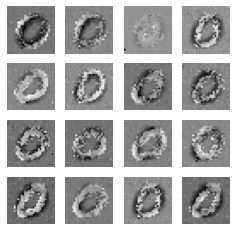

93
gen_loss: tf.Tensor(4.217918, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.028885206, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.031658206, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.52149407e-30]
 [1.00000000e+00 1.38920271e-33]
 [1.00000000e+00 7.70497294e-12]
 [1.00000000e+00 7.32086108e-27]
 [1.00000000e+00 3.46170500e-28]
 [1.00000000e+00 6.27236310e-26]
 [1.00000000e+00 1.57490446e-27]
 [1.00000000e+00 1.55521260e-30]
 [1.00000000e+00 1.12070133e-26]
 [1.00000000e+00 1.23771980e-25]
 [1.00000000e+00 2.05627045e-30]
 [1.00000000e+00 2.91010813e-25]
 [9.99999762e-01 2.84975670e-07]
 [1.00000000e+00 5.65849894e-29]
 [1.00000000e+00 3.74429901e-26]
 [1.00000000e+00 3.97042194e-29]
 [1.00000000e+00 3.58855325e-28]
 [1.00000000e+00 4.01448421e-28]
 [1.00000000e+00 9.20558628e-30]
 [1.00000000e+00 3.57156035e-30]
 [9.98941123e-01 1.05894229e-03]
 [1.00000000e+00 9.23479970e-33]
 [1.00000000e+00 4.73846926e-29]
 [1.00000000e+00 

gen_loss: tf.Tensor(4.371851, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.02818555, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02562099, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.42193609e-30]
 [1.00000000e+00 1.98652796e-33]
 [1.00000000e+00 2.97146661e-12]
 [1.00000000e+00 2.75746137e-27]
 [1.00000000e+00 1.11757514e-28]
 [1.00000000e+00 2.39363325e-26]
 [1.00000000e+00 6.28843234e-28]
 [1.00000000e+00 5.94114452e-31]
 [1.00000000e+00 5.40383356e-27]
 [1.00000000e+00 4.75107411e-26]
 [1.00000000e+00 7.62939562e-31]
 [1.00000000e+00 1.58491671e-25]
 [9.99999881e-01 1.29127940e-07]
 [1.00000000e+00 1.85057824e-29]
 [1.00000000e+00 1.62896942e-26]
 [1.00000000e+00 1.49430527e-29]
 [1.00000000e+00 1.63435811e-28]
 [1.00000000e+00 1.33538024e-28]
 [1.00000000e+00 5.00640336e-30]
 [1.00000000e+00 1.18853547e-30]
 [9.99562800e-01 4.37146169e-04]
 [1.00000000e+00 1.56660762e-32]
 [1.00000000e+00 1.58295583e-29]
 [1.00000000e+00 2.685

gen_loss: tf.Tensor(4.2662787, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.024776097, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02877286, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.46893216e-30]
 [1.00000000e+00 4.82561774e-33]
 [1.00000000e+00 2.85374242e-12]
 [1.00000000e+00 1.88226256e-27]
 [1.00000000e+00 6.66586622e-29]
 [1.00000000e+00 2.04572787e-26]
 [1.00000000e+00 4.70757271e-28]
 [1.00000000e+00 4.67415721e-31]
 [1.00000000e+00 4.61905909e-27]
 [1.00000000e+00 4.32677696e-26]
 [1.00000000e+00 5.64887384e-31]
 [1.00000000e+00 1.57183309e-25]
 [1.00000000e+00 5.84847939e-08]
 [1.00000000e+00 1.91934086e-29]
 [1.00000000e+00 1.28892569e-26]
 [1.00000000e+00 1.32386092e-29]
 [1.00000000e+00 1.81927026e-28]
 [1.00000000e+00 8.58929788e-29]
 [1.00000000e+00 6.00813105e-30]
 [1.00000000e+00 8.36992321e-31]
 [9.99721944e-01 2.78034946e-04]
 [1.00000000e+00 3.61831972e-32]
 [1.00000000e+00 1.23736793e-29]
 [1.00000000e+00 1.8

gen_loss: tf.Tensor(4.3219376, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04040154, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.023762079, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.76448004e-31]
 [1.00000000e+00 1.34915555e-33]
 [1.00000000e+00 3.90196512e-12]
 [1.00000000e+00 7.42749761e-28]
 [1.00000000e+00 1.63420136e-29]
 [1.00000000e+00 1.13376045e-26]
 [1.00000000e+00 1.90895131e-28]
 [1.00000000e+00 1.28368685e-31]
 [1.00000000e+00 1.96823454e-27]
 [1.00000000e+00 2.81042267e-26]
 [1.00000000e+00 1.58696886e-31]
 [1.00000000e+00 1.10211979e-25]
 [1.00000000e+00 3.72662115e-08]
 [1.00000000e+00 1.22371753e-29]
 [1.00000000e+00 5.37273441e-27]
 [1.00000000e+00 5.47088274e-30]
 [1.00000000e+00 1.43529050e-28]
 [1.00000000e+00 2.73247450e-29]
 [1.00000000e+00 2.73262940e-30]
 [1.00000000e+00 3.19597260e-31]
 [9.99402642e-01 5.97325678e-04]
 [1.00000000e+00 7.59552801e-33]
 [1.00000000e+00 5.20599477e-30]
 [1.00000000e+00 7.3

gen_loss: tf.Tensor(4.237789, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.01672515, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.028049525, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.80334132e-31]
 [1.00000000e+00 1.13218317e-33]
 [1.00000000e+00 8.09520506e-12]
 [1.00000000e+00 8.16354903e-28]
 [1.00000000e+00 1.24730107e-29]
 [1.00000000e+00 1.56516690e-26]
 [1.00000000e+00 2.22526135e-28]
 [1.00000000e+00 1.73433553e-31]
 [1.00000000e+00 2.27933693e-27]
 [1.00000000e+00 3.96835369e-26]
 [1.00000000e+00 1.49817366e-31]
 [1.00000000e+00 1.51589607e-25]
 [1.00000000e+00 4.49087807e-08]
 [1.00000000e+00 1.57808428e-29]
 [1.00000000e+00 6.42088403e-27]
 [1.00000000e+00 6.72006610e-30]
 [1.00000000e+00 2.57784519e-28]
 [1.00000000e+00 2.79659021e-29]
 [1.00000000e+00 3.20321195e-30]
 [1.00000000e+00 3.55767527e-31]
 [9.98770058e-01 1.22994115e-03]
 [1.00000000e+00 5.69017657e-33]
 [1.00000000e+00 6.24489442e-30]
 [1.00000000e+00 8.79

gen_loss: tf.Tensor(4.327982, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.01811947, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.028364463, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.43171206e-30]
 [1.00000000e+00 1.28916759e-32]
 [1.00000000e+00 1.53229044e-11]
 [1.00000000e+00 8.84348319e-28]
 [1.00000000e+00 1.07422399e-29]
 [1.00000000e+00 1.88024689e-26]
 [1.00000000e+00 3.15670751e-28]
 [1.00000000e+00 8.58437569e-31]
 [1.00000000e+00 4.51498569e-27]
 [1.00000000e+00 4.26691721e-26]
 [1.00000000e+00 2.99975109e-31]
 [1.00000000e+00 1.43618550e-25]
 [1.00000000e+00 5.21684775e-08]
 [1.00000000e+00 2.39267109e-29]
 [1.00000000e+00 1.36262902e-26]
 [1.00000000e+00 9.37748681e-30]
 [1.00000000e+00 3.68120059e-28]
 [1.00000000e+00 5.22447919e-29]
 [1.00000000e+00 1.20922084e-29]
 [1.00000000e+00 5.26219732e-31]
 [9.99297976e-01 7.01972633e-04]
 [1.00000000e+00 5.85115244e-32]
 [1.00000000e+00 8.55335957e-30]
 [1.00000000e+00 9.20

gen_loss: tf.Tensor(4.3396673, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.031006437, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02869631, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.27622915e-30]
 [1.00000000e+00 1.94017811e-32]
 [1.00000000e+00 2.31583312e-11]
 [1.00000000e+00 2.03027933e-27]
 [1.00000000e+00 2.32373198e-29]
 [1.00000000e+00 4.60632184e-26]
 [1.00000000e+00 5.38056678e-28]
 [1.00000000e+00 2.65967201e-30]
 [1.00000000e+00 8.08354090e-27]
 [1.00000000e+00 1.02178176e-25]
 [1.00000000e+00 6.70697580e-31]
 [1.00000000e+00 3.41495174e-25]
 [9.99999881e-01 1.65828382e-07]
 [1.00000000e+00 5.32776681e-29]
 [1.00000000e+00 3.10637185e-26]
 [1.00000000e+00 1.71608122e-29]
 [1.00000000e+00 6.88505270e-28]
 [1.00000000e+00 1.89625738e-28]
 [1.00000000e+00 2.64378181e-29]
 [1.00000000e+00 1.29054666e-30]
 [9.98819888e-01 1.18010212e-03]
 [1.00000000e+00 9.33842394e-32]
 [1.00000000e+00 2.41213623e-29]
 [1.00000000e+00 2.3

gen_loss: tf.Tensor(4.309011, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.032190967, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.031252503, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.91804568e-30]
 [1.00000000e+00 9.96221911e-33]
 [1.00000000e+00 3.55297805e-11]
 [1.00000000e+00 1.05389845e-26]
 [1.00000000e+00 1.12886963e-28]
 [1.00000000e+00 2.11604468e-25]
 [1.00000000e+00 1.67030434e-27]
 [1.00000000e+00 3.84578305e-30]
 [1.00000000e+00 2.52263157e-26]
 [1.00000000e+00 5.05286660e-25]
 [1.00000000e+00 1.32243180e-30]
 [1.00000000e+00 3.28117346e-24]
 [9.99999642e-01 3.86946738e-07]
 [1.00000000e+00 1.89991388e-28]
 [1.00000000e+00 1.18913263e-25]
 [1.00000000e+00 6.27874528e-29]
 [1.00000000e+00 2.87864916e-27]
 [1.00000000e+00 8.96652026e-28]
 [1.00000000e+00 5.24560784e-29]
 [1.00000000e+00 5.36437054e-30]
 [9.97404039e-01 2.59597739e-03]
 [1.00000000e+00 5.61015200e-32]
 [1.00000000e+00 1.32801428e-28]
 [1.00000000e+00 1.4

gen_loss: tf.Tensor(4.3526597, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043322116, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.028526774, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.72338192e-30]
 [1.00000000e+00 7.57215257e-33]
 [1.00000000e+00 2.04415998e-11]
 [1.00000000e+00 1.01858229e-26]
 [1.00000000e+00 1.14701430e-28]
 [1.00000000e+00 2.28396088e-25]
 [1.00000000e+00 1.45543219e-27]
 [1.00000000e+00 1.64386039e-30]
 [1.00000000e+00 2.51241336e-26]
 [1.00000000e+00 5.80765512e-25]
 [1.00000000e+00 6.65843823e-31]
 [1.00000000e+00 8.04712513e-24]
 [9.99999762e-01 2.07004348e-07]
 [1.00000000e+00 2.10955340e-28]
 [1.00000000e+00 1.21594897e-25]
 [1.00000000e+00 6.78785463e-29]
 [1.00000000e+00 3.79133947e-27]
 [1.00000000e+00 9.35298796e-28]
 [1.00000000e+00 2.20992336e-29]
 [1.00000000e+00 5.07849671e-30]
 [9.98410344e-01 1.58961315e-03]
 [1.00000000e+00 4.17786738e-32]
 [1.00000000e+00 1.19933074e-28]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(4.4811687, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.047327187, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.028603755, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.89846306e-30]
 [1.00000000e+00 2.22664932e-32]
 [1.00000000e+00 1.40215044e-11]
 [1.00000000e+00 5.02000804e-27]
 [1.00000000e+00 7.91283244e-29]
 [1.00000000e+00 1.23280027e-25]
 [1.00000000e+00 1.11356692e-27]
 [1.00000000e+00 1.55781326e-30]
 [1.00000000e+00 2.22742072e-26]
 [1.00000000e+00 2.85569472e-25]
 [1.00000000e+00 4.33855029e-31]
 [1.00000000e+00 3.65247687e-24]
 [9.99999881e-01 1.14142296e-07]
 [1.00000000e+00 2.21516586e-28]
 [1.00000000e+00 9.13103971e-26]
 [1.00000000e+00 5.62243710e-29]
 [1.00000000e+00 2.87031566e-27]
 [1.00000000e+00 7.09873174e-28]
 [1.00000000e+00 1.56160403e-29]
 [1.00000000e+00 3.44334231e-30]
 [9.99340117e-01 6.59863872e-04]
 [1.00000000e+00 7.44654689e-32]
 [1.00000000e+00 6.52791547e-29]
 [1.00000000e+00 5.

 [1.00000000e+00 8.28213635e-31]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.400878, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.030503027, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02658416, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.81653600e-30]
 [1.00000000e+00 1.78296294e-32]
 [1.00000000e+00 1.22629424e-11]
 [1.00000000e+00 1.54374802e-27]
 [1.00000000e+00 3.81659912e-29]
 [1.00000000e+00 3.23433218e-26]
 [1.00000000e+00 5.95526717e-28]
 [1.00000000e+00 1.38989925e-30]
 [1.00000000e+00 1.16516720e-26]
 [1.00000000e+00 6.31401434e-26]
 [1.00000000e+00 3.11779611e-31]
 [1.00000000e+00 4.33482469e-25]
 [9.99999881e-01 1.46060557e-07]
 [1.00000000e+00 1.16879861e-28]
 [1.00000000e+00 4.08113060e-26]
 [1.00000000e+00 2.27326494e-29]
 [1.00000000e+00 1.34570041e-27]
 [1.00000000e+00 2.65194463e-28]
 [1.00000000e+00 1.24458242e-29]
 [1.00000000e+00 1.36195587e-30]
 [9.99539852e-01 4.60171228e-04]
 [1.00000000e+00 3.66

gen_loss: tf.Tensor(4.308155, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.018900232, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.035605334, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 2.3806975e-30]
 [1.0000000e+00 1.2113197e-32]
 [1.0000000e+00 1.3251564e-11]
 [1.0000000e+00 1.5172483e-27]
 [1.0000000e+00 4.2773243e-29]
 [1.0000000e+00 3.0346095e-26]
 [1.0000000e+00 6.3224679e-28]
 [1.0000000e+00 1.8461000e-30]
 [1.0000000e+00 1.1275409e-26]
 [1.0000000e+00 6.6708112e-26]
 [1.0000000e+00 4.3125451e-31]
 [1.0000000e+00 3.2258689e-25]
 [9.9999988e-01 1.5936401e-07]
 [1.0000000e+00 1.2357035e-28]
 [1.0000000e+00 3.8199844e-26]
 [1.0000000e+00 2.1020093e-29]
 [1.0000000e+00 1.4861208e-27]
 [1.0000000e+00 2.6634109e-28]
 [1.0000000e+00 1.3725077e-29]
 [1.0000000e+00 1.4397748e-30]
 [9.9952579e-01 4.7425154e-04]
 [1.0000000e+00 2.2637683e-32]
 [1.0000000e+00 2.5173117e-29]
 [1.0000000e+00 1.4941066e-28]
 [1.0000000e+00 1.7266928e-29]
 [1.

 [1.00000000e+00 6.69506381e-31]], shape=(256, 2), dtype=float32)


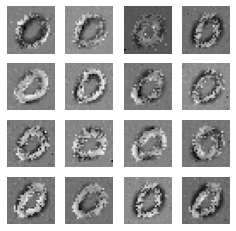

94
gen_loss: tf.Tensor(4.167578, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.016185284, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032140024, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.15526532e-30]
 [1.00000000e+00 2.88557782e-33]
 [1.00000000e+00 1.24811212e-11]
 [1.00000000e+00 1.49256354e-27]
 [1.00000000e+00 3.29355507e-29]
 [1.00000000e+00 2.28872184e-26]
 [1.00000000e+00 5.14393547e-28]
 [1.00000000e+00 1.84328517e-30]
 [1.00000000e+00 7.66903686e-27]
 [1.00000000e+00 7.26780140e-26]
 [1.00000000e+00 4.57515614e-31]
 [1.00000000e+00 2.34974744e-25]
 [9.99999881e-01 1.52692664e-07]
 [1.00000000e+00 8.12300676e-29]
 [1.00000000e+00 2.62961390e-26]
 [1.00000000e+00 1.21422224e-29]
 [1.00000000e+00 1.38886782e-27]
 [1.00000000e+00 1.86020482e-28]
 [1.00000000e+00 9.80153897e-30]
 [1.00000000e+00 1.09197698e-30]
 [9.99529719e-01 4.70289291e-04]
 [1.00000000e+00 6.04423583e-33]
 [1.00000000e+00 1.84250573e-29]
 [1.00000000e+00 

gen_loss: tf.Tensor(4.1287346, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.016339175, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.040122136, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.64314467e-31]
 [1.00000000e+00 1.52119604e-33]
 [1.00000000e+00 7.34155618e-12]
 [1.00000000e+00 7.64467269e-28]
 [1.00000000e+00 1.17921034e-29]
 [1.00000000e+00 1.35191145e-26]
 [1.00000000e+00 2.62417994e-28]
 [1.00000000e+00 6.32769361e-31]
 [1.00000000e+00 4.22446570e-27]
 [1.00000000e+00 4.38535111e-26]
 [1.00000000e+00 1.23516903e-31]
 [1.00000000e+00 2.25677525e-25]
 [9.99999881e-01 6.39874358e-08]
 [1.00000000e+00 3.37248268e-29]
 [1.00000000e+00 1.25680279e-26]
 [1.00000000e+00 5.62648923e-30]
 [1.00000000e+00 7.32395817e-28]
 [1.00000000e+00 6.37582117e-29]
 [1.00000000e+00 3.15217970e-30]
 [1.00000000e+00 4.01152352e-31]
 [9.99805868e-01 1.94199660e-04]
 [1.00000000e+00 3.83995727e-33]
 [1.00000000e+00 5.84063308e-30]
 [1.00000000e+00 6.

gen_loss: tf.Tensor(4.433713, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.016756196, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.026355498, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.02835388e-31]
 [1.00000000e+00 1.89126792e-33]
 [1.00000000e+00 1.02213602e-11]
 [1.00000000e+00 9.38737448e-28]
 [1.00000000e+00 1.06232475e-29]
 [1.00000000e+00 1.69711344e-26]
 [1.00000000e+00 3.59073051e-28]
 [1.00000000e+00 5.42749816e-31]
 [1.00000000e+00 7.01135104e-27]
 [1.00000000e+00 5.51426530e-26]
 [1.00000000e+00 7.37913287e-32]
 [1.00000000e+00 5.32440485e-25]
 [9.99999881e-01 6.10617761e-08]
 [1.00000000e+00 4.44205029e-29]
 [1.00000000e+00 1.93894091e-26]
 [1.00000000e+00 5.72709687e-30]
 [1.00000000e+00 9.12323126e-28]
 [1.00000000e+00 4.90423857e-29]
 [1.00000000e+00 4.18048598e-30]
 [1.00000000e+00 3.42203544e-31]
 [9.99834299e-01 1.65685153e-04]
 [1.00000000e+00 3.87843929e-33]
 [1.00000000e+00 5.53039097e-30]
 [1.00000000e+00 8.4

gen_loss: tf.Tensor(4.226651, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.024057839, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.035349548, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.14916968e-31]
 [1.00000000e+00 1.63373676e-33]
 [1.00000000e+00 8.65109460e-12]
 [1.00000000e+00 3.67441024e-28]
 [1.00000000e+00 3.74399164e-30]
 [1.00000000e+00 4.82101403e-27]
 [1.00000000e+00 2.29551349e-28]
 [1.00000000e+00 6.04548751e-31]
 [1.00000000e+00 4.38514835e-27]
 [1.00000000e+00 1.38130762e-26]
 [1.00000000e+00 5.15252676e-32]
 [1.00000000e+00 1.15724317e-25]
 [9.99999881e-01 1.19535599e-07]
 [1.00000000e+00 1.67022618e-29]
 [1.00000000e+00 1.28171816e-26]
 [1.00000000e+00 1.68097009e-30]
 [1.00000000e+00 3.34870395e-28]
 [1.00000000e+00 1.98638052e-29]
 [1.00000000e+00 4.95563291e-30]
 [1.00000000e+00 1.34865266e-31]
 [9.99847054e-01 1.52944558e-04]
 [1.00000000e+00 2.34531400e-33]
 [1.00000000e+00 2.62015622e-30]
 [1.00000000e+00 3.0

gen_loss: tf.Tensor(4.3657637, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.042642526, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.035053477, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.24244149e-31]
 [1.00000000e+00 7.74949977e-34]
 [1.00000000e+00 7.94414361e-12]
 [1.00000000e+00 3.81447614e-28]
 [1.00000000e+00 3.98968688e-30]
 [1.00000000e+00 4.87585219e-27]
 [1.00000000e+00 2.79295616e-28]
 [1.00000000e+00 6.46082164e-31]
 [1.00000000e+00 4.25420553e-27]
 [1.00000000e+00 1.62893845e-26]
 [1.00000000e+00 8.01144069e-32]
 [1.00000000e+00 7.27742859e-26]
 [9.99999881e-01 1.35690115e-07]
 [1.00000000e+00 1.59849011e-29]
 [1.00000000e+00 1.28644016e-26]
 [1.00000000e+00 1.16233258e-30]
 [1.00000000e+00 2.37049572e-28]
 [1.00000000e+00 3.43354580e-29]
 [1.00000000e+00 4.35770990e-30]
 [1.00000000e+00 1.90763079e-31]
 [9.99716341e-01 2.83583620e-04]
 [1.00000000e+00 1.10989515e-33]
 [1.00000000e+00 3.75706802e-30]
 [1.00000000e+00 3.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.87666639e-31]
 [1.00000000e+00 1.04590413e-34]
 [1.00000000e+00 4.17841976e-12]
 [1.00000000e+00 3.80015589e-28]
 [1.00000000e+00 4.68921511e-30]
 [1.00000000e+00 6.66254202e-27]
 [1.00000000e+00 1.95569736e-28]
 [1.00000000e+00 3.15474049e-31]
 [1.00000000e+00 2.09519068e-27]
 [1.00000000e+00 2.58458273e-26]
 [1.00000000e+00 5.44182062e-32]
 [1.00000000e+00 6.01897050e-26]
 [9.99999881e-01 1.12752161e-07]
 [1.00000000e+00 1.28221013e-29]
 [1.00000000e+00 6.77549550e-27]
 [1.00000000e+00 8.91000832e-31]
 [1.00000000e+00 1.28241127e-28]
 [1.00000000e+00 5.49391137e-29]
 [1.00000000e+00 8.03773979e-31]
 [1.00000000e+00 1.94470647e-31]
 [9.99413252e-01 5.86803129e-04]
 [1.00000000e+00 2.25633431e-34]
 [1.00000000e+00 3.58274992e-30]
 [1.00000000e+00 3.50845936e-29]
 [1.00000000e+00 2.58406497e-30]
 [1.00000000e+00 5.30800127e-24]
 [1.00000000e+00 1.20139924e-30]
 [1.00000000e+00 1.33169996e-24]
 [1.00000000e+00 3.66439491e-13]
 [1.0

gen_loss: tf.Tensor(4.3579683, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.035184715, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027570596, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.71269840e-32]
 [1.00000000e+00 1.25226509e-35]
 [1.00000000e+00 2.35558296e-12]
 [1.00000000e+00 3.79693887e-28]
 [1.00000000e+00 6.44499667e-30]
 [1.00000000e+00 1.04421410e-26]
 [1.00000000e+00 1.27138351e-28]
 [1.00000000e+00 1.07574025e-31]
 [1.00000000e+00 1.10143356e-27]
 [1.00000000e+00 4.09580680e-26]
 [1.00000000e+00 2.13207213e-32]
 [1.00000000e+00 5.53373599e-26]
 [9.99999881e-01 1.01589507e-07]
 [1.00000000e+00 1.35112577e-29]
 [1.00000000e+00 4.41600213e-27]
 [1.00000000e+00 7.08441058e-31]
 [1.00000000e+00 6.51632137e-29]
 [1.00000000e+00 8.63364542e-29]
 [1.00000000e+00 1.10203230e-31]
 [1.00000000e+00 1.79452966e-31]
 [9.98275757e-01 1.72421103e-03]
 [1.00000000e+00 3.36990037e-35]
 [1.00000000e+00 3.63151507e-30]
 [1.00000000e+00 4.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.54849742e-32]
 [1.00000000e+00 2.07539095e-35]
 [1.00000000e+00 2.70900056e-12]
 [1.00000000e+00 5.86327464e-28]
 [1.00000000e+00 1.13214227e-29]
 [1.00000000e+00 1.68462602e-26]
 [1.00000000e+00 1.92401148e-28]
 [1.00000000e+00 1.42985087e-31]
 [1.00000000e+00 1.80183188e-27]
 [1.00000000e+00 6.12472716e-26]
 [1.00000000e+00 2.21038371e-32]
 [1.00000000e+00 7.15474285e-26]
 [9.99999881e-01 1.34294737e-07]
 [1.00000000e+00 2.77127266e-29]
 [1.00000000e+00 7.78855853e-27]
 [1.00000000e+00 1.15914445e-30]
 [1.00000000e+00 9.89135170e-29]
 [1.00000000e+00 1.32172708e-28]
 [1.00000000e+00 1.44979925e-31]
 [1.00000000e+00 2.49604306e-31]
 [9.97517824e-01 2.48225080e-03]
 [1.00000000e+00 4.39997637e-35]
 [1.00000000e+00 5.73803066e-30]
 [1.00000000e+00 6.66479793e-29]
 [1.00000000e+00 2.17231845e-30]
 [1.00000000e+00 3.62582323e-24]
 [1.00000000e+00 7.54868383e-31]
 [1.00000000e+00 7.15171732e-25]
 [1.00000000e+00 2.17889465e-12]
 [1.0

gen_loss: tf.Tensor(4.3049774, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.021525584, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027655125, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.12673945e-32]
 [1.00000000e+00 5.62726881e-35]
 [1.00000000e+00 3.23667568e-12]
 [1.00000000e+00 8.24290698e-28]
 [1.00000000e+00 1.92153867e-29]
 [1.00000000e+00 2.27258347e-26]
 [1.00000000e+00 2.74752708e-28]
 [1.00000000e+00 2.01785948e-31]
 [1.00000000e+00 3.34256697e-27]
 [1.00000000e+00 6.26903817e-26]
 [1.00000000e+00 1.92934343e-32]
 [1.00000000e+00 5.86992755e-26]
 [9.99999762e-01 2.19197588e-07]
 [1.00000000e+00 5.86553159e-29]
 [1.00000000e+00 1.67032422e-26]
 [1.00000000e+00 1.96621291e-30]
 [1.00000000e+00 1.68047162e-28]
 [1.00000000e+00 1.65142956e-28]
 [1.00000000e+00 2.35419028e-31]
 [1.00000000e+00 2.85780027e-31]
 [9.96451139e-01 3.54884122e-03]
 [1.00000000e+00 8.97905033e-35]
 [1.00000000e+00 7.84900411e-30]
 [1.00000000e+00 9.

disc_real_loss: tf.Tensor(0.0289909, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.024205338, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.90966502e-32]
 [1.00000000e+00 8.31478812e-35]
 [1.00000000e+00 2.98749241e-12]
 [1.00000000e+00 7.48932237e-28]
 [1.00000000e+00 1.85302236e-29]
 [1.00000000e+00 2.18835855e-26]
 [1.00000000e+00 2.44557545e-28]
 [1.00000000e+00 2.09397203e-31]
 [1.00000000e+00 3.33828525e-27]
 [1.00000000e+00 5.22490557e-26]
 [1.00000000e+00 1.57942477e-32]
 [1.00000000e+00 4.46957619e-26]
 [9.99999762e-01 2.22763930e-07]
 [1.00000000e+00 6.50574080e-29]
 [1.00000000e+00 1.80181901e-26]
 [1.00000000e+00 2.01086026e-30]
 [1.00000000e+00 1.67115108e-28]
 [1.00000000e+00 1.51108439e-28]
 [1.00000000e+00 2.27602178e-31]
 [1.00000000e+00 2.52255774e-31]
 [9.96775210e-01 3.22473352e-03]
 [1.00000000e+00 1.25504421e-34]
 [1.00000000e+00 6.88762051e-30]
 [1.00000000e+00 8.50134968e-29]
 [1.00000000e+00 2.11507883e-30]
 [1.0000000

gen_loss: tf.Tensor(4.2763567, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.017551202, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.028156433, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.22134441e-32]
 [1.00000000e+00 1.06535351e-34]
 [1.00000000e+00 1.97069141e-12]
 [1.00000000e+00 1.05482297e-27]
 [1.00000000e+00 1.98865508e-29]
 [1.00000000e+00 2.59823449e-26]
 [1.00000000e+00 2.97469750e-28]
 [1.00000000e+00 1.54535342e-31]
 [1.00000000e+00 5.09773935e-27]
 [1.00000000e+00 5.92468313e-26]
 [1.00000000e+00 1.17410506e-32]
 [1.00000000e+00 7.13381215e-26]
 [9.99999881e-01 1.01477184e-07]
 [1.00000000e+00 6.15565909e-29]
 [1.00000000e+00 2.88232087e-26]
 [1.00000000e+00 2.79316642e-30]
 [1.00000000e+00 2.60000663e-28]
 [1.00000000e+00 1.57208257e-28]
 [1.00000000e+00 2.39568241e-31]
 [1.00000000e+00 2.98306777e-31]
 [9.98378992e-01 1.62097323e-03]
 [1.00000000e+00 1.95397628e-34]
 [1.00000000e+00 7.72336727e-30]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(4.331973, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.042765833, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027682442, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.97973354e-33]
 [1.00000000e+00 1.29436435e-35]
 [1.00000000e+00 5.93943135e-13]
 [1.00000000e+00 3.66794008e-28]
 [1.00000000e+00 4.73552169e-30]
 [1.00000000e+00 6.35734529e-27]
 [1.00000000e+00 8.71072595e-29]
 [1.00000000e+00 1.71301118e-32]
 [1.00000000e+00 1.85154032e-27]
 [1.00000000e+00 1.52909655e-26]
 [1.00000000e+00 2.06766481e-33]
 [1.00000000e+00 3.06233277e-26]
 [9.99999881e-01 6.41888818e-08]
 [1.00000000e+00 8.40945273e-30]
 [1.00000000e+00 1.06773387e-26]
 [1.00000000e+00 7.31130168e-31]
 [1.00000000e+00 9.38346712e-29]
 [1.00000000e+00 3.32224962e-29]
 [1.00000000e+00 5.40738686e-32]
 [1.00000000e+00 8.32746588e-32]
 [9.98983800e-01 1.01617875e-03]
 [1.00000000e+00 2.81982756e-35]
 [1.00000000e+00 2.02899879e-30]
 [1.00000000e+00 3.4

gen_loss: tf.Tensor(4.3679104, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0289242, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.030119225, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 3.7205935e-33]
 [1.0000000e+00 4.8567281e-36]
 [1.0000000e+00 2.4745684e-13]
 [1.0000000e+00 1.4452349e-28]
 [1.0000000e+00 1.7527932e-30]
 [1.0000000e+00 1.8987194e-27]
 [1.0000000e+00 3.9434935e-29]
 [1.0000000e+00 5.8719668e-33]
 [1.0000000e+00 1.0278794e-27]
 [1.0000000e+00 5.7286786e-27]
 [1.0000000e+00 8.7438284e-34]
 [1.0000000e+00 9.9337125e-27]
 [9.9999988e-01 8.7720572e-08]
 [1.0000000e+00 2.2131027e-30]
 [1.0000000e+00 5.8413771e-27]
 [1.0000000e+00 2.5784215e-31]
 [1.0000000e+00 4.8762936e-29]
 [1.0000000e+00 1.2130278e-29]
 [1.0000000e+00 2.8472545e-32]
 [1.0000000e+00 3.7899419e-32]
 [9.9899787e-01 1.0021214e-03]
 [1.0000000e+00 7.5398291e-36]
 [1.0000000e+00 8.7748171e-31]
 [1.0000000e+00 1.1325051e-29]
 [1.0000000e+00 2.2730372e-31]
 [1.0

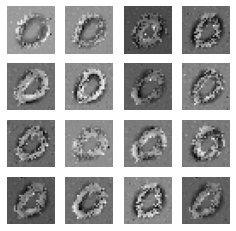

95
gen_loss: tf.Tensor(4.1992826, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.019854244, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027394908, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.47469013e-33]
 [1.00000000e+00 2.20094830e-35]
 [1.00000000e+00 1.52725272e-13]
 [1.00000000e+00 3.81258295e-29]
 [1.00000000e+00 5.32154615e-31]
 [1.00000000e+00 4.31029862e-28]
 [1.00000000e+00 1.73821858e-29]
 [1.00000000e+00 7.71937957e-33]
 [1.00000000e+00 6.41933780e-28]
 [1.00000000e+00 1.49589810e-27]
 [1.00000000e+00 6.83192128e-34]
 [1.00000000e+00 1.54331228e-27]
 [9.99999881e-01 1.00900685e-07]
 [1.00000000e+00 6.31197537e-31]
 [1.00000000e+00 3.29287991e-27]
 [1.00000000e+00 8.92310003e-32]
 [1.00000000e+00 2.21285890e-29]
 [1.00000000e+00 4.70656277e-30]
 [1.00000000e+00 3.55814852e-32]
 [1.00000000e+00 1.54208431e-32]
 [9.99493957e-01 5.06047101e-04]
 [1.00000000e+00 2.46092383e-35]
 [1.00000000e+00 3.31556128e-31]
 [1.00000000e+00

gen_loss: tf.Tensor(4.5135508, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.028888645, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.024816621, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.14882404e-33]
 [1.00000000e+00 5.01413142e-35]
 [1.00000000e+00 1.08004073e-13]
 [1.00000000e+00 2.31393095e-29]
 [1.00000000e+00 2.48083569e-31]
 [1.00000000e+00 1.91509274e-28]
 [1.00000000e+00 1.34655665e-29]
 [1.00000000e+00 5.27718793e-33]
 [1.00000000e+00 6.78627897e-28]
 [1.00000000e+00 7.88105507e-28]
 [1.00000000e+00 3.91063139e-34]
 [1.00000000e+00 1.10962338e-27]
 [1.00000000e+00 5.67227190e-08]
 [1.00000000e+00 3.27346071e-31]
 [1.00000000e+00 2.92605670e-27]
 [1.00000000e+00 5.47025112e-32]
 [1.00000000e+00 1.74638031e-29]
 [1.00000000e+00 2.04741004e-30]
 [1.00000000e+00 4.24738406e-32]
 [1.00000000e+00 8.69795731e-33]
 [9.99762237e-01 2.37775341e-04]
 [1.00000000e+00 5.62842824e-35]
 [1.00000000e+00 2.09638579e-31]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(4.354345, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.04347623, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.026549531, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.17760378e-32]
 [1.00000000e+00 3.82244475e-35]
 [1.00000000e+00 9.52923585e-14]
 [1.00000000e+00 3.73969674e-29]
 [1.00000000e+00 5.32658291e-31]
 [1.00000000e+00 4.25714151e-28]
 [1.00000000e+00 2.18441021e-29]
 [1.00000000e+00 7.92115097e-33]
 [1.00000000e+00 7.94226065e-28]
 [1.00000000e+00 1.42160863e-27]
 [1.00000000e+00 6.25208022e-34]
 [1.00000000e+00 1.74011776e-27]
 [9.99999881e-01 6.17844975e-08]
 [1.00000000e+00 6.28938237e-31]
 [1.00000000e+00 3.01252055e-27]
 [1.00000000e+00 1.04908239e-31]
 [1.00000000e+00 2.81785759e-29]
 [1.00000000e+00 3.24406273e-30]
 [1.00000000e+00 4.47642178e-32]
 [1.00000000e+00 1.37319164e-32]
 [9.99574482e-01 4.25487699e-04]
 [1.00000000e+00 5.39306190e-35]
 [1.00000000e+00 4.21001045e-31]
 [1.00000000e+00 1.74

gen_loss: tf.Tensor(4.464046, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.024001025, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.022274245, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.67003207e-32]
 [1.00000000e+00 4.33186026e-35]
 [1.00000000e+00 1.60548197e-13]
 [1.00000000e+00 1.50316208e-28]
 [1.00000000e+00 4.18808400e-30]
 [1.00000000e+00 3.47431445e-27]
 [1.00000000e+00 9.26926550e-29]
 [1.00000000e+00 4.84131110e-32]
 [1.00000000e+00 1.81092766e-27]
 [1.00000000e+00 8.36087712e-27]
 [1.00000000e+00 3.55449729e-33]
 [1.00000000e+00 4.72895766e-27]
 [9.99999881e-01 1.14359231e-07]
 [1.00000000e+00 3.89910987e-30]
 [1.00000000e+00 6.13690875e-27]
 [1.00000000e+00 6.56942744e-31]
 [1.00000000e+00 1.07255809e-28]
 [1.00000000e+00 1.92979535e-29]
 [1.00000000e+00 8.84866244e-32]
 [1.00000000e+00 7.21832172e-32]
 [9.98498559e-01 1.50139804e-03]
 [1.00000000e+00 7.40345513e-35]
 [1.00000000e+00 2.72029423e-30]
 [1.00000000e+00 8.7

gen_loss: tf.Tensor(4.5244417, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.020458946, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.028473075, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.70728975e-32]
 [1.00000000e+00 8.18188321e-35]
 [1.00000000e+00 2.15534147e-13]
 [1.00000000e+00 2.83104696e-28]
 [1.00000000e+00 1.09859159e-29]
 [1.00000000e+00 8.79289556e-27]
 [1.00000000e+00 1.81392737e-28]
 [1.00000000e+00 1.39801837e-31]
 [1.00000000e+00 3.01208375e-27]
 [1.00000000e+00 1.80981671e-26]
 [1.00000000e+00 9.23282781e-33]
 [1.00000000e+00 7.19096635e-27]
 [9.99999762e-01 1.83389389e-07]
 [1.00000000e+00 8.58893285e-30]
 [1.00000000e+00 1.03014880e-26]
 [1.00000000e+00 1.61802904e-30]
 [1.00000000e+00 2.14179323e-28]
 [1.00000000e+00 4.57554462e-29]
 [1.00000000e+00 1.67341319e-31]
 [1.00000000e+00 1.59185574e-31]
 [9.97841001e-01 2.15899223e-03]
 [1.00000000e+00 1.39056459e-34]
 [1.00000000e+00 6.48267342e-30]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(4.396182, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.015108924, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.021264438, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.60293384e-31]
 [1.00000000e+00 1.53105143e-34]
 [1.00000000e+00 2.95809709e-13]
 [1.00000000e+00 5.52440823e-28]
 [1.00000000e+00 2.70936966e-29]
 [1.00000000e+00 2.02973048e-26]
 [1.00000000e+00 3.66596769e-28]
 [1.00000000e+00 3.55390428e-31]
 [1.00000000e+00 5.61858322e-27]
 [1.00000000e+00 3.90481865e-26]
 [1.00000000e+00 2.24954721e-32]
 [1.00000000e+00 1.24337429e-26]
 [9.99999762e-01 2.83434019e-07]
 [1.00000000e+00 1.63850852e-29]
 [1.00000000e+00 1.87423876e-26]
 [1.00000000e+00 3.77929107e-30]
 [1.00000000e+00 4.33950005e-28]
 [1.00000000e+00 1.01083191e-28]
 [1.00000000e+00 3.20041338e-31]
 [1.00000000e+00 3.46586187e-31]
 [9.97371197e-01 2.62874691e-03]
 [1.00000000e+00 2.62167061e-34]
 [1.00000000e+00 1.53739359e-29]
 [1.00000000e+00 3.6

 [1.00000000e+00 1.47299627e-30]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.2889633, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.024129368, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02654488, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.79062322e-31]
 [1.00000000e+00 2.86686932e-34]
 [1.00000000e+00 4.51102399e-13]
 [1.00000000e+00 1.42752113e-27]
 [1.00000000e+00 8.09837833e-29]
 [1.00000000e+00 6.04031596e-26]
 [1.00000000e+00 1.02060035e-27]
 [1.00000000e+00 9.19992942e-31]
 [1.00000000e+00 1.49458126e-26]
 [1.00000000e+00 1.28166502e-25]
 [1.00000000e+00 5.79875713e-32]
 [1.00000000e+00 3.93194838e-26]
 [9.99999523e-01 4.94915184e-07]
 [1.00000000e+00 2.88972547e-29]
 [1.00000000e+00 4.68439719e-26]
 [1.00000000e+00 1.12453236e-29]
 [1.00000000e+00 1.13084424e-27]
 [1.00000000e+00 2.54597611e-28]
 [1.00000000e+00 6.79432443e-31]
 [1.00000000e+00 9.97371316e-31]
 [9.97280121e-01 2.71988823e-03]
 [1.00000000e+00 5.1

gen_loss: tf.Tensor(4.4043694, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.013521073, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.022700556, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.49390607e-31]
 [1.00000000e+00 3.17389191e-34]
 [1.00000000e+00 5.54989269e-13]
 [1.00000000e+00 2.21081081e-27]
 [1.00000000e+00 1.19543916e-28]
 [1.00000000e+00 8.90721090e-26]
 [1.00000000e+00 1.62700617e-27]
 [1.00000000e+00 1.26990874e-30]
 [1.00000000e+00 2.34294370e-26]
 [1.00000000e+00 2.05040874e-25]
 [1.00000000e+00 8.44757613e-32]
 [1.00000000e+00 6.75621894e-26]
 [9.99999404e-01 6.50218738e-07]
 [1.00000000e+00 3.36705788e-29]
 [1.00000000e+00 7.23080136e-26]
 [1.00000000e+00 1.62519944e-29]
 [1.00000000e+00 1.70016473e-27]
 [1.00000000e+00 3.45354050e-28]
 [1.00000000e+00 1.00623727e-30]
 [1.00000000e+00 1.53194251e-30]
 [9.97349262e-01 2.65073008e-03]
 [1.00000000e+00 6.11177211e-34]
 [1.00000000e+00 7.85077476e-29]
 [1.00000000e+00 1.

test_discriminator_output: tf.Tensor(
[[1.0000000e+00 8.3180406e-31]
 [1.0000000e+00 3.7251503e-34]
 [1.0000000e+00 6.3532448e-13]
 [1.0000000e+00 3.0147621e-27]
 [1.0000000e+00 1.5200339e-28]
 [1.0000000e+00 1.0647855e-25]
 [1.0000000e+00 2.4532386e-27]
 [1.0000000e+00 1.5538842e-30]
 [1.0000000e+00 3.4412482e-26]
 [1.0000000e+00 2.5256082e-25]
 [1.0000000e+00 1.1355148e-31]
 [1.0000000e+00 8.4336922e-26]
 [9.9999917e-01 8.0504122e-07]
 [1.0000000e+00 3.5601769e-29]
 [1.0000000e+00 1.0492417e-25]
 [1.0000000e+00 2.0291932e-29]
 [1.0000000e+00 2.2387066e-27]
 [1.0000000e+00 4.1781148e-28]
 [1.0000000e+00 1.5645190e-30]
 [1.0000000e+00 2.1475672e-30]
 [9.9778640e-01 2.2135959e-03]
 [1.0000000e+00 7.6510388e-34]
 [1.0000000e+00 1.1521890e-28]
 [1.0000000e+00 2.0895945e-28]
 [1.0000000e+00 1.6051015e-29]
 [1.0000000e+00 9.5794109e-24]
 [1.0000000e+00 1.6477476e-29]
 [1.0000000e+00 6.8391527e-24]
 [1.0000000e+00 7.1407751e-13]
 [1.0000000e+00 3.0357295e-28]
 [1.0000000e+00 6.2833453e-14]
 

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.07678771e-30]
 [1.00000000e+00 4.06008907e-34]
 [1.00000000e+00 7.17574112e-13]
 [1.00000000e+00 3.35575189e-27]
 [1.00000000e+00 1.39498934e-28]
 [1.00000000e+00 1.04824552e-25]
 [1.00000000e+00 2.96590611e-27]
 [1.00000000e+00 1.54259193e-30]
 [1.00000000e+00 4.12119642e-26]
 [1.00000000e+00 2.56006244e-25]
 [1.00000000e+00 1.18359868e-31]
 [1.00000000e+00 9.17268910e-26]
 [9.99999046e-01 9.54892016e-07]
 [1.00000000e+00 3.28961233e-29]
 [1.00000000e+00 1.27665859e-25]
 [1.00000000e+00 1.88244726e-29]
 [1.00000000e+00 2.27776364e-27]
 [1.00000000e+00 3.91812440e-28]
 [1.00000000e+00 2.13469473e-30]
 [1.00000000e+00 2.35394907e-30]
 [9.98010695e-01 1.98934134e-03]
 [1.00000000e+00 8.76954969e-34]
 [1.00000000e+00 1.27863043e-28]
 [1.00000000e+00 2.27137629e-28]
 [1.00000000e+00 1.77690239e-29]
 [1.00000000e+00 8.79247326e-24]
 [1.00000000e+00 1.86153843e-29]
 [1.00000000e+00 7.01920229e-24]
 [1.00000000e+00 6.84413680e-13]
 [1.0

gen_loss: tf.Tensor(4.3774166, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03022411, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.022086874, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.20208113e-31]
 [1.00000000e+00 2.57312132e-34]
 [1.00000000e+00 5.53013256e-13]
 [1.00000000e+00 1.17727880e-27]
 [1.00000000e+00 3.23219373e-29]
 [1.00000000e+00 3.91139331e-26]
 [1.00000000e+00 1.06606877e-27]
 [1.00000000e+00 5.45364774e-31]
 [1.00000000e+00 1.43368320e-26]
 [1.00000000e+00 9.50086571e-26]
 [1.00000000e+00 4.07788159e-32]
 [1.00000000e+00 3.48207826e-26]
 [9.99998689e-01 1.25927943e-06]
 [1.00000000e+00 1.49730671e-29]
 [1.00000000e+00 4.99517757e-26]
 [1.00000000e+00 5.01072128e-30]
 [1.00000000e+00 8.44952748e-28]
 [1.00000000e+00 1.10799857e-28]
 [1.00000000e+00 1.21740797e-30]
 [1.00000000e+00 7.37618191e-31]
 [9.97900367e-01 2.09957315e-03]
 [1.00000000e+00 5.24181400e-34]
 [1.00000000e+00 4.15915766e-29]
 [1.00000000e+00 7.4

gen_loss: tf.Tensor(4.3370695, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.017086204, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.026117017, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.92854236e-31]
 [1.00000000e+00 2.27070244e-34]
 [1.00000000e+00 4.00464926e-13]
 [1.00000000e+00 3.47676529e-28]
 [1.00000000e+00 6.21722649e-30]
 [1.00000000e+00 1.36598584e-26]
 [1.00000000e+00 3.35676156e-28]
 [1.00000000e+00 1.80446952e-31]
 [1.00000000e+00 5.00578081e-27]
 [1.00000000e+00 2.78777527e-26]
 [1.00000000e+00 1.08343669e-32]
 [1.00000000e+00 1.42545948e-26]
 [9.99998450e-01 1.55372595e-06]
 [1.00000000e+00 5.13025156e-30]
 [1.00000000e+00 1.88594332e-26]
 [1.00000000e+00 1.53619103e-30]
 [1.00000000e+00 3.22299802e-28]
 [1.00000000e+00 2.47577106e-29]
 [1.00000000e+00 6.12520202e-31]
 [1.00000000e+00 1.90878089e-31]
 [9.97980297e-01 2.01967708e-03]
 [1.00000000e+00 4.49664701e-34]
 [1.00000000e+00 1.01832041e-29]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(4.426526, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.021534853, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.023438523, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.83198835e-32]
 [1.00000000e+00 1.64277884e-34]
 [1.00000000e+00 2.26849288e-13]
 [1.00000000e+00 1.70929400e-28]
 [1.00000000e+00 2.37396839e-30]
 [1.00000000e+00 8.44344174e-27]
 [1.00000000e+00 1.74130549e-28]
 [1.00000000e+00 5.79628036e-32]
 [1.00000000e+00 2.62189997e-27]
 [1.00000000e+00 1.53536815e-26]
 [1.00000000e+00 2.94132362e-33]
 [1.00000000e+00 9.76140413e-27]
 [9.99998569e-01 1.38343432e-06]
 [1.00000000e+00 3.20304080e-30]
 [1.00000000e+00 1.02476352e-26]
 [1.00000000e+00 9.24277478e-31]
 [1.00000000e+00 2.30276655e-28]
 [1.00000000e+00 9.23386360e-30]
 [1.00000000e+00 2.56502060e-31]
 [1.00000000e+00 7.79950964e-32]
 [9.97900605e-01 2.09933938e-03]
 [1.00000000e+00 3.14996165e-34]
 [1.00000000e+00 4.36709580e-30]
 [1.00000000e+00 9.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.26481683e-32]
 [1.00000000e+00 1.47033221e-34]
 [1.00000000e+00 1.50783398e-13]
 [1.00000000e+00 9.63189524e-29]
 [1.00000000e+00 1.21208824e-30]
 [1.00000000e+00 5.21106915e-27]
 [1.00000000e+00 1.03010060e-28]
 [1.00000000e+00 3.29753496e-32]
 [1.00000000e+00 1.67844795e-27]
 [1.00000000e+00 8.63437843e-27]
 [1.00000000e+00 1.43745125e-33]
 [1.00000000e+00 6.44235199e-27]
 [9.99998808e-01 1.24617043e-06]
 [1.00000000e+00 1.83956214e-30]
 [1.00000000e+00 6.65708008e-27]
 [1.00000000e+00 5.88233078e-31]
 [1.00000000e+00 1.59750954e-28]
 [1.00000000e+00 4.69924273e-30]
 [1.00000000e+00 1.52110474e-31]
 [1.00000000e+00 4.08657085e-32]
 [9.98279810e-01 1.72017526e-03]
 [1.00000000e+00 2.85070742e-34]
 [1.00000000e+00 2.28420783e-30]
 [1.00000000e+00 4.78513206e-30]
 [1.00000000e+00 5.72825168e-31]
 [1.00000000e+00 4.33823257e-25]
 [1.00000000e+00 1.81067531e-31]
 [1.00000000e+00 4.07859602e-25]
 [1.00000000e+00 9.22666388e-11]
 [1.0

gen_loss: tf.Tensor(4.505243, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.013960792, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.026127215, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.29996851e-31]
 [1.00000000e+00 3.83230191e-34]
 [1.00000000e+00 3.42858717e-13]
 [1.00000000e+00 5.45858909e-28]
 [1.00000000e+00 6.45774467e-30]
 [1.00000000e+00 2.20791274e-26]
 [1.00000000e+00 5.76940145e-28]
 [1.00000000e+00 1.26294655e-31]
 [1.00000000e+00 9.19952639e-27]
 [1.00000000e+00 5.27477144e-26]
 [1.00000000e+00 5.42248418e-33]
 [1.00000000e+00 3.33010883e-26]
 [9.99997735e-01 2.25553958e-06]
 [1.00000000e+00 1.07347032e-29]
 [1.00000000e+00 3.76792663e-26]
 [1.00000000e+00 2.44141581e-30]
 [1.00000000e+00 7.73112769e-28]
 [1.00000000e+00 1.96377778e-29]
 [1.00000000e+00 8.46819736e-31]
 [1.00000000e+00 2.09047635e-31]
 [9.96462762e-01 3.53724044e-03]
 [1.00000000e+00 6.36202935e-34]
 [1.00000000e+00 1.52115273e-29]
 [1.00000000e+00 2.7

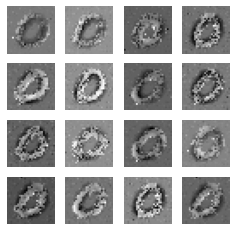

96
gen_loss: tf.Tensor(4.215694, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.024702478, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027724842, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.85647055e-31]
 [1.00000000e+00 5.63343637e-34]
 [1.00000000e+00 5.29070657e-13]
 [1.00000000e+00 1.21416787e-27]
 [1.00000000e+00 1.36380215e-29]
 [1.00000000e+00 4.04446182e-26]
 [1.00000000e+00 1.26194740e-27]
 [1.00000000e+00 2.33273539e-31]
 [1.00000000e+00 1.97332523e-26]
 [1.00000000e+00 1.14955658e-25]
 [1.00000000e+00 1.12633812e-32]
 [1.00000000e+00 6.16024932e-26]
 [9.99997139e-01 2.82739575e-06]
 [1.00000000e+00 2.35345645e-29]
 [1.00000000e+00 8.11775281e-26]
 [1.00000000e+00 4.33304446e-30]
 [1.00000000e+00 1.48388896e-27]
 [1.00000000e+00 3.81869658e-29]
 [1.00000000e+00 1.89982494e-30]
 [1.00000000e+00 4.45684639e-31]
 [9.95112240e-01 4.88781556e-03]
 [1.00000000e+00 9.26404526e-34]
 [1.00000000e+00 3.61646220e-29]
 [1.00000000e+00 

 [1.00000000e+00 6.68245875e-31]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.2701216, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.020252086, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02890955, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.96302743e-31]
 [1.00000000e+00 9.32467322e-34]
 [1.00000000e+00 5.56983984e-13]
 [1.00000000e+00 1.68791871e-27]
 [1.00000000e+00 1.95685316e-29]
 [1.00000000e+00 5.17811811e-26]
 [1.00000000e+00 1.71079529e-27]
 [1.00000000e+00 3.34454991e-31]
 [1.00000000e+00 2.64446174e-26]
 [1.00000000e+00 1.59019765e-25]
 [1.00000000e+00 1.71980760e-32]
 [1.00000000e+00 7.43033880e-26]
 [9.99997139e-01 2.88911178e-06]
 [1.00000000e+00 3.03594809e-29]
 [1.00000000e+00 1.07663021e-25]
 [1.00000000e+00 5.82999269e-30]
 [1.00000000e+00 1.87155151e-27]
 [1.00000000e+00 5.12847399e-29]
 [1.00000000e+00 2.43418079e-30]
 [1.00000000e+00 6.34645262e-31]
 [9.95403528e-01 4.59647644e-03]
 [1.00000000e+00 1.7

gen_loss: tf.Tensor(4.313752, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.017436836, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.025671821, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.46548432e-31]
 [1.00000000e+00 1.75380047e-33]
 [1.00000000e+00 5.39544754e-13]
 [1.00000000e+00 2.25073745e-27]
 [1.00000000e+00 2.92479275e-29]
 [1.00000000e+00 6.91327314e-26]
 [1.00000000e+00 2.25406257e-27]
 [1.00000000e+00 4.69925872e-31]
 [1.00000000e+00 3.31179031e-26]
 [1.00000000e+00 2.17752604e-25]
 [1.00000000e+00 2.62725956e-32]
 [1.00000000e+00 8.75644849e-26]
 [9.99997258e-01 2.70771739e-06]
 [1.00000000e+00 4.19033937e-29]
 [1.00000000e+00 1.36115435e-25]
 [1.00000000e+00 8.50306496e-30]
 [1.00000000e+00 2.30955940e-27]
 [1.00000000e+00 7.09686046e-29]
 [1.00000000e+00 2.82117967e-30]
 [1.00000000e+00 9.04493720e-31]
 [9.95953083e-01 4.04687412e-03]
 [1.00000000e+00 3.62200483e-33]
 [1.00000000e+00 7.13812952e-29]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(4.388173, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.024320576, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.024657529, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.53197759e-30]
 [1.00000000e+00 5.21419503e-33]
 [1.00000000e+00 6.70220281e-13]
 [1.00000000e+00 3.19915048e-27]
 [1.00000000e+00 4.07603693e-29]
 [1.00000000e+00 8.30164183e-26]
 [1.00000000e+00 3.14043427e-27]
 [1.00000000e+00 6.86450803e-31]
 [1.00000000e+00 4.91953567e-26]
 [1.00000000e+00 2.77261066e-25]
 [1.00000000e+00 3.63176091e-32]
 [1.00000000e+00 1.08767686e-25]
 [9.99997258e-01 2.72585135e-06]
 [1.00000000e+00 7.84185530e-29]
 [1.00000000e+00 2.14585278e-25]
 [1.00000000e+00 1.20691665e-29]
 [1.00000000e+00 3.30945215e-27]
 [1.00000000e+00 8.34079935e-29]
 [1.00000000e+00 5.28297705e-30]
 [1.00000000e+00 1.13426422e-30]
 [9.96076286e-01 3.92367272e-03]
 [1.00000000e+00 9.14031199e-33]
 [1.00000000e+00 9.64285077e-29]
 [1.00000000e+00 1.4

gen_loss: tf.Tensor(4.4805026, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.023906324, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.023541592, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 1.7481190e-30]
 [1.0000000e+00 8.3601504e-33]
 [1.0000000e+00 7.5988223e-13]
 [1.0000000e+00 3.6168799e-27]
 [1.0000000e+00 4.3779231e-29]
 [1.0000000e+00 7.8842204e-26]
 [1.0000000e+00 3.6407171e-27]
 [1.0000000e+00 6.4046767e-31]
 [1.0000000e+00 6.3946107e-26]
 [1.0000000e+00 2.6039712e-25]
 [1.0000000e+00 3.3408884e-32]
 [1.0000000e+00 1.2403288e-25]
 [9.9999726e-01 2.6927792e-06]
 [1.0000000e+00 9.8474531e-29]
 [1.0000000e+00 2.8110674e-25]
 [1.0000000e+00 1.3603937e-29]
 [1.0000000e+00 3.7907178e-27]
 [1.0000000e+00 7.6241079e-29]
 [1.0000000e+00 7.2937833e-30]
 [1.0000000e+00 1.1675051e-30]
 [9.9657464e-01 3.4254410e-03]
 [1.0000000e+00 1.3191957e-32]
 [1.0000000e+00 1.0429590e-28]
 [1.0000000e+00 1.6095170e-28]
 [1.0000000e+00 2.9611889e-29]
 [1

gen_loss: tf.Tensor(4.2636147, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.014514493, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02815077, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.86615352e-30]
 [1.00000000e+00 1.63314560e-32]
 [1.00000000e+00 1.42507273e-12]
 [1.00000000e+00 6.33437242e-27]
 [1.00000000e+00 6.53903170e-29]
 [1.00000000e+00 1.07472622e-25]
 [1.00000000e+00 5.82473322e-27]
 [1.00000000e+00 6.84275574e-31]
 [1.00000000e+00 1.31170855e-25]
 [1.00000000e+00 4.14763145e-25]
 [1.00000000e+00 4.19661975e-32]
 [1.00000000e+00 2.53071953e-25]
 [9.99997139e-01 2.81142707e-06]
 [1.00000000e+00 2.09879756e-28]
 [1.00000000e+00 5.87131915e-25]
 [1.00000000e+00 2.05579299e-29]
 [1.00000000e+00 6.62601868e-27]
 [1.00000000e+00 1.03235864e-28]
 [1.00000000e+00 1.75104979e-29]
 [1.00000000e+00 1.97997184e-30]
 [9.96523023e-01 3.47705418e-03]
 [1.00000000e+00 1.92111806e-32]
 [1.00000000e+00 1.91224573e-28]
 [1.00000000e+00 2.7

gen_loss: tf.Tensor(4.317561, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.017075587, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.024760194, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.76708512e-30]
 [1.00000000e+00 2.06633319e-32]
 [1.00000000e+00 1.98771663e-12]
 [1.00000000e+00 9.94637738e-27]
 [1.00000000e+00 1.11905124e-28]
 [1.00000000e+00 1.53623019e-25]
 [1.00000000e+00 8.27249080e-27]
 [1.00000000e+00 7.56725147e-31]
 [1.00000000e+00 2.03958101e-25]
 [1.00000000e+00 7.81475589e-25]
 [1.00000000e+00 7.21661490e-32]
 [1.00000000e+00 4.01720168e-25]
 [9.99994874e-01 5.10598056e-06]
 [1.00000000e+00 4.25572884e-28]
 [1.00000000e+00 9.34633329e-25]
 [1.00000000e+00 3.09915892e-29]
 [1.00000000e+00 1.15736179e-26]
 [1.00000000e+00 1.70543817e-28]
 [1.00000000e+00 2.64023419e-29]
 [1.00000000e+00 3.54182015e-30]
 [9.93838131e-01 6.16181875e-03]
 [1.00000000e+00 1.73624762e-32]
 [1.00000000e+00 3.65475540e-28]
 [1.00000000e+00 4.2

gen_loss: tf.Tensor(4.3106556, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.021887962, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.026379332, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.31387995e-30]
 [1.00000000e+00 2.40492009e-32]
 [1.00000000e+00 1.71498362e-12]
 [1.00000000e+00 1.00896450e-26]
 [1.00000000e+00 1.16396658e-28]
 [1.00000000e+00 1.29830235e-25]
 [1.00000000e+00 7.87640020e-27]
 [1.00000000e+00 5.83370481e-31]
 [1.00000000e+00 2.29654173e-25]
 [1.00000000e+00 8.21921376e-25]
 [1.00000000e+00 8.23390241e-32]
 [1.00000000e+00 4.26534084e-25]
 [9.99993563e-01 6.47674142e-06]
 [1.00000000e+00 3.43088964e-28]
 [1.00000000e+00 1.01341312e-24]
 [1.00000000e+00 3.19439134e-29]
 [1.00000000e+00 1.29965943e-26]
 [1.00000000e+00 1.77084696e-28]
 [1.00000000e+00 2.21316284e-29]
 [1.00000000e+00 3.93698298e-30]
 [9.93541956e-01 6.45801378e-03]
 [1.00000000e+00 1.93757454e-32]
 [1.00000000e+00 4.02026176e-28]
 [1.00000000e+00 3.

gen_loss: tf.Tensor(4.2871866, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.030324228, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.025307152, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.67551472e-31]
 [1.00000000e+00 1.44059110e-33]
 [1.00000000e+00 2.27945755e-13]
 [1.00000000e+00 6.32492823e-28]
 [1.00000000e+00 6.56750161e-30]
 [1.00000000e+00 8.47309412e-27]
 [1.00000000e+00 4.35651805e-28]
 [1.00000000e+00 2.56851481e-32]
 [1.00000000e+00 1.29046558e-26]
 [1.00000000e+00 3.61315828e-26]
 [1.00000000e+00 5.75119207e-33]
 [1.00000000e+00 3.00847945e-26]
 [9.99993682e-01 6.30877184e-06]
 [1.00000000e+00 8.86766231e-30]
 [1.00000000e+00 5.57928716e-26]
 [1.00000000e+00 2.17879176e-30]
 [1.00000000e+00 9.37670868e-28]
 [1.00000000e+00 1.16179670e-29]
 [1.00000000e+00 6.87242099e-31]
 [1.00000000e+00 2.35379531e-31]
 [9.94845390e-01 5.15463250e-03]
 [1.00000000e+00 2.39613705e-33]
 [1.00000000e+00 1.89770364e-29]
 [1.00000000e+00 2.

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.71175135e-31]
 [1.00000000e+00 9.91826665e-34]
 [1.00000000e+00 1.72861806e-13]
 [1.00000000e+00 4.29775504e-28]
 [1.00000000e+00 4.56043434e-30]
 [1.00000000e+00 6.81380456e-27]
 [1.00000000e+00 2.72895486e-28]
 [1.00000000e+00 1.76568979e-32]
 [1.00000000e+00 7.69230055e-27]
 [1.00000000e+00 2.42131287e-26]
 [1.00000000e+00 4.57448843e-33]
 [1.00000000e+00 2.08773210e-26]
 [9.99991894e-01 8.08427103e-06]
 [1.00000000e+00 8.06006572e-30]
 [1.00000000e+00 3.54254383e-26]
 [1.00000000e+00 1.50423893e-30]
 [1.00000000e+00 6.58582241e-28]
 [1.00000000e+00 9.02842931e-30]
 [1.00000000e+00 4.82437082e-31]
 [1.00000000e+00 1.61603578e-31]
 [9.91581261e-01 8.41872301e-03]
 [1.00000000e+00 1.75361313e-33]
 [1.00000000e+00 1.24270381e-29]
 [1.00000000e+00 1.63662186e-29]
 [1.00000000e+00 3.81707805e-30]
 [1.00000000e+00 7.26958004e-25]
 [1.00000000e+00 1.00792001e-30]
 [1.00000000e+00 8.65972059e-25]
 [1.00000000e+00 1.22628672e-08]
 [1.0

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.69874145e-31]
 [1.00000000e+00 9.97700830e-34]
 [1.00000000e+00 1.90041044e-13]
 [1.00000000e+00 4.73112058e-28]
 [1.00000000e+00 5.04170543e-30]
 [1.00000000e+00 8.20498310e-27]
 [1.00000000e+00 2.80134310e-28]
 [1.00000000e+00 1.88184847e-32]
 [1.00000000e+00 7.77792894e-27]
 [1.00000000e+00 2.50492981e-26]
 [1.00000000e+00 5.49721256e-33]
 [1.00000000e+00 2.28736891e-26]
 [9.99988198e-01 1.17435147e-05]
 [1.00000000e+00 1.26941052e-29]
 [1.00000000e+00 3.89685762e-26]
 [1.00000000e+00 1.55191755e-30]
 [1.00000000e+00 7.33273608e-28]
 [1.00000000e+00 1.05363151e-29]
 [1.00000000e+00 6.38316378e-31]
 [1.00000000e+00 1.74989943e-31]
 [9.84864950e-01 1.51350778e-02]
 [1.00000000e+00 1.63586955e-33]
 [1.00000000e+00 1.35063105e-29]
 [1.00000000e+00 1.82447481e-29]
 [1.00000000e+00 4.38733349e-30]
 [1.00000000e+00 8.98265953e-25]
 [1.00000000e+00 1.01735312e-30]
 [1.00000000e+00 1.01554157e-24]
 [1.00000000e+00 4.47325874e-08]
 [1.0

gen_loss: tf.Tensor(4.305156, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.027052391, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02942617, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.04044992e-31]
 [1.00000000e+00 1.13901031e-33]
 [1.00000000e+00 1.96085932e-13]
 [1.00000000e+00 2.77723239e-28]
 [1.00000000e+00 2.87386100e-30]
 [1.00000000e+00 4.58449442e-27]
 [1.00000000e+00 1.58851568e-28]
 [1.00000000e+00 1.04780606e-32]
 [1.00000000e+00 5.12787245e-27]
 [1.00000000e+00 9.56114208e-27]
 [1.00000000e+00 3.71801149e-33]
 [1.00000000e+00 1.17405937e-26]
 [9.99982595e-01 1.74233373e-05]
 [1.00000000e+00 1.43292107e-29]
 [1.00000000e+00 2.89690401e-26]
 [1.00000000e+00 7.87205903e-31]
 [1.00000000e+00 5.00301036e-28]
 [1.00000000e+00 6.05225103e-30]
 [1.00000000e+00 8.56259425e-31]
 [1.00000000e+00 9.27614918e-32]
 [9.73366439e-01 2.66336016e-02]
 [1.00000000e+00 1.42215761e-33]
 [1.00000000e+00 7.76010589e-30]
 [1.00000000e+00 1.03

gen_loss: tf.Tensor(4.307677, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03217925, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.026918225, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.93698507e-32]
 [1.00000000e+00 2.59662018e-33]
 [1.00000000e+00 2.06289562e-13]
 [1.00000000e+00 2.28588384e-28]
 [1.00000000e+00 1.98435728e-30]
 [1.00000000e+00 2.83860734e-27]
 [1.00000000e+00 1.33158556e-28]
 [1.00000000e+00 6.43827880e-33]
 [1.00000000e+00 6.58549943e-27]
 [1.00000000e+00 5.70808658e-27]
 [1.00000000e+00 2.34570761e-33]
 [1.00000000e+00 1.23405124e-26]
 [9.99989510e-01 1.05016434e-05]
 [1.00000000e+00 1.11890978e-29]
 [1.00000000e+00 3.68992092e-26]
 [1.00000000e+00 6.19357535e-31]
 [1.00000000e+00 4.85674802e-28]
 [1.00000000e+00 4.06090303e-30]
 [1.00000000e+00 1.37170608e-30]
 [1.00000000e+00 6.86856454e-32]
 [9.84673858e-01 1.53260864e-02]
 [1.00000000e+00 3.02816914e-33]
 [1.00000000e+00 5.98123838e-30]
 [1.00000000e+00 7.72

gen_loss: tf.Tensor(4.3596, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.026211556, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02297688, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.06871005e-31]
 [1.00000000e+00 1.80637629e-32]
 [1.00000000e+00 2.21849340e-13]
 [1.00000000e+00 4.23283531e-28]
 [1.00000000e+00 3.74607743e-30]
 [1.00000000e+00 4.58379493e-27]
 [1.00000000e+00 2.68335847e-28]
 [1.00000000e+00 1.37635915e-32]
 [1.00000000e+00 1.73934215e-26]
 [1.00000000e+00 1.11423044e-26]
 [1.00000000e+00 4.08159887e-33]
 [1.00000000e+00 2.92086135e-26]
 [9.99995232e-01 4.78335187e-06]
 [1.00000000e+00 1.98062997e-29]
 [1.00000000e+00 9.36563647e-26]
 [1.00000000e+00 1.43451180e-30]
 [1.00000000e+00 1.04100385e-27]
 [1.00000000e+00 8.28912574e-30]
 [1.00000000e+00 3.46571846e-30]
 [1.00000000e+00 1.49215066e-31]
 [9.94225204e-01 5.77480393e-03]
 [1.00000000e+00 2.22378023e-32]
 [1.00000000e+00 1.17146284e-29]
 [1.00000000e+00 1.3129

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.33081177e-31]
 [1.00000000e+00 3.18417910e-32]
 [1.00000000e+00 2.40374181e-13]
 [1.00000000e+00 4.73113839e-28]
 [1.00000000e+00 4.45431635e-30]
 [1.00000000e+00 5.20026661e-27]
 [1.00000000e+00 2.88912073e-28]
 [1.00000000e+00 1.87956698e-32]
 [1.00000000e+00 2.02218761e-26]
 [1.00000000e+00 1.29060841e-26]
 [1.00000000e+00 5.27091079e-33]
 [1.00000000e+00 3.06849543e-26]
 [9.99995828e-01 4.18652826e-06]
 [1.00000000e+00 2.39619675e-29]
 [1.00000000e+00 1.11103503e-25]
 [1.00000000e+00 1.68466772e-30]
 [1.00000000e+00 1.18649418e-27]
 [1.00000000e+00 1.03185022e-29]
 [1.00000000e+00 5.05645910e-30]
 [1.00000000e+00 1.80086616e-31]
 [9.95597780e-01 4.40230500e-03]
 [1.00000000e+00 3.89063710e-32]
 [1.00000000e+00 1.38951301e-29]
 [1.00000000e+00 1.41266585e-29]
 [1.00000000e+00 7.41412837e-30]
 [1.00000000e+00 4.90881567e-25]
 [1.00000000e+00 1.11793218e-30]
 [1.00000000e+00 5.72687083e-25]
 [1.00000000e+00 1.80524362e-09]
 [1.0

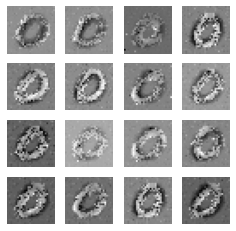

97
gen_loss: tf.Tensor(4.3873596, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.019425556, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.026646193, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.91762100e-31]
 [1.00000000e+00 5.55749749e-32]
 [1.00000000e+00 2.47966171e-13]
 [1.00000000e+00 4.97753946e-28]
 [1.00000000e+00 4.98190380e-30]
 [1.00000000e+00 5.89771133e-27]
 [1.00000000e+00 3.02244131e-28]
 [1.00000000e+00 2.81979965e-32]
 [1.00000000e+00 2.25463996e-26]
 [1.00000000e+00 1.41901948e-26]
 [1.00000000e+00 6.74921469e-33]
 [1.00000000e+00 2.76860349e-26]
 [9.99996305e-01 3.71631882e-06]
 [1.00000000e+00 2.97019444e-29]
 [1.00000000e+00 1.24686590e-25]
 [1.00000000e+00 1.97317052e-30]
 [1.00000000e+00 1.35611526e-27]
 [1.00000000e+00 1.25928201e-29]
 [1.00000000e+00 7.20259582e-30]
 [1.00000000e+00 2.01832145e-31]
 [9.96675014e-01 3.32500879e-03]
 [1.00000000e+00 6.63938664e-32]
 [1.00000000e+00 1.56186629e-29]
 [1.00000000e+00

gen_loss: tf.Tensor(4.278474, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.014978822, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.026806012, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.00277332e-30]
 [1.00000000e+00 5.08694475e-32]
 [1.00000000e+00 3.54563601e-13]
 [1.00000000e+00 9.98229231e-28]
 [1.00000000e+00 1.48030286e-29]
 [1.00000000e+00 1.97599180e-26]
 [1.00000000e+00 5.76625448e-28]
 [1.00000000e+00 9.89212938e-32]
 [1.00000000e+00 3.60521421e-26]
 [1.00000000e+00 3.63186877e-26]
 [1.00000000e+00 2.06028836e-32]
 [1.00000000e+00 3.83907757e-26]
 [9.99995351e-01 4.64112554e-06]
 [1.00000000e+00 9.54615404e-29]
 [1.00000000e+00 2.10462937e-25]
 [1.00000000e+00 5.70751145e-30]
 [1.00000000e+00 3.46658300e-27]
 [1.00000000e+00 3.61701410e-29]
 [1.00000000e+00 1.38667468e-29]
 [1.00000000e+00 5.17745358e-31]
 [9.95722771e-01 4.27719066e-03]
 [1.00000000e+00 5.55715836e-32]
 [1.00000000e+00 4.33147693e-29]
 [1.00000000e+00 3.0

gen_loss: tf.Tensor(4.508401, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.023871204, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.022228703, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.43314437e-30]
 [1.00000000e+00 2.52975494e-32]
 [1.00000000e+00 4.12446363e-13]
 [1.00000000e+00 2.58532098e-27]
 [1.00000000e+00 5.46143959e-29]
 [1.00000000e+00 7.89050848e-26]
 [1.00000000e+00 1.40912581e-27]
 [1.00000000e+00 1.80405657e-31]
 [1.00000000e+00 6.85379796e-26]
 [1.00000000e+00 1.17090230e-25]
 [1.00000000e+00 5.43588672e-32]
 [1.00000000e+00 8.97895472e-26]
 [9.99996305e-01 3.64112429e-06]
 [1.00000000e+00 2.31825247e-28]
 [1.00000000e+00 4.07601398e-25]
 [1.00000000e+00 2.20520739e-29]
 [1.00000000e+00 9.89656975e-27]
 [1.00000000e+00 1.18948009e-28]
 [1.00000000e+00 1.75751429e-29]
 [1.00000000e+00 1.79987125e-30]
 [9.95673478e-01 4.32654889e-03]
 [1.00000000e+00 3.50287736e-32]
 [1.00000000e+00 1.48577430e-28]
 [1.00000000e+00 9.0

gen_loss: tf.Tensor(4.3608155, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.013891755, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027209682, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.54798651e-30]
 [1.00000000e+00 4.06886908e-32]
 [1.00000000e+00 7.07413240e-13]
 [1.00000000e+00 1.06761169e-26]
 [1.00000000e+00 2.74711831e-28]
 [1.00000000e+00 3.27129869e-25]
 [1.00000000e+00 5.59919835e-27]
 [1.00000000e+00 3.42841179e-31]
 [1.00000000e+00 2.78524698e-25]
 [1.00000000e+00 4.83083134e-25]
 [1.00000000e+00 1.56256783e-31]
 [1.00000000e+00 4.21954155e-25]
 [9.99997258e-01 2.71676276e-06]
 [1.00000000e+00 6.64822013e-28]
 [1.00000000e+00 1.64446763e-24]
 [1.00000000e+00 1.18104320e-28]
 [1.00000000e+00 3.97726505e-26]
 [1.00000000e+00 4.36084080e-28]
 [1.00000000e+00 3.90776301e-29]
 [1.00000000e+00 8.44661867e-30]
 [9.97091293e-01 2.90873554e-03]
 [1.00000000e+00 6.54174067e-32]
 [1.00000000e+00 7.44071286e-28]
 [1.00000000e+00 4.

gen_loss: tf.Tensor(4.276654, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.017058525, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027348861, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.86726509e-30]
 [1.00000000e+00 2.80297427e-31]
 [1.00000000e+00 1.68232941e-12]
 [1.00000000e+00 3.10739090e-26]
 [1.00000000e+00 1.12302882e-27]
 [1.00000000e+00 9.29502676e-25]
 [1.00000000e+00 1.75965024e-26]
 [1.00000000e+00 7.17218615e-31]
 [1.00000000e+00 1.15571298e-24]
 [1.00000000e+00 1.46246913e-24]
 [1.00000000e+00 3.76290388e-31]
 [1.00000000e+00 1.32120554e-24]
 [9.99996901e-01 3.07450728e-06]
 [1.00000000e+00 2.65863131e-27]
 [1.00000000e+00 6.69559814e-24]
 [1.00000000e+00 4.78289198e-28]
 [1.00000000e+00 1.36420564e-25]
 [1.00000000e+00 1.25070430e-27]
 [1.00000000e+00 1.27409270e-28]
 [1.00000000e+00 2.86907559e-29]
 [9.97974455e-01 2.02549016e-03]
 [1.00000000e+00 2.69394929e-31]
 [1.00000000e+00 2.88211044e-27]
 [1.00000000e+00 1.2

gen_loss: tf.Tensor(4.3586974, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.034079313, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02733215, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.28646282e-29]
 [1.00000000e+00 1.62203362e-30]
 [1.00000000e+00 2.69483351e-12]
 [1.00000000e+00 3.48869945e-26]
 [1.00000000e+00 1.53611720e-27]
 [1.00000000e+00 1.02387361e-24]
 [1.00000000e+00 2.35348685e-26]
 [1.00000000e+00 7.01791898e-31]
 [1.00000000e+00 2.25151374e-24]
 [1.00000000e+00 1.33823873e-24]
 [1.00000000e+00 3.16435838e-31]
 [1.00000000e+00 1.35884634e-24]
 [9.99996543e-01 3.39855296e-06]
 [1.00000000e+00 4.85321288e-27]
 [1.00000000e+00 1.19566109e-23]
 [1.00000000e+00 7.16683647e-28]
 [1.00000000e+00 1.97453105e-25]
 [1.00000000e+00 1.28467905e-27]
 [1.00000000e+00 2.45841804e-28]
 [1.00000000e+00 3.48131578e-29]
 [9.98566806e-01 1.43326679e-03]
 [1.00000000e+00 8.65896786e-31]
 [1.00000000e+00 3.85900047e-27]
 [1.00000000e+00 1.2

 [1.00000000e+00 1.31018992e-30]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.410342, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.01872924, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027872823, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.90889676e-30]
 [1.00000000e+00 1.20501609e-30]
 [1.00000000e+00 2.29953296e-12]
 [1.00000000e+00 1.52450112e-26]
 [1.00000000e+00 5.07070006e-28]
 [1.00000000e+00 3.83163251e-25]
 [1.00000000e+00 1.02510757e-26]
 [1.00000000e+00 1.94349018e-31]
 [1.00000000e+00 1.34146389e-24]
 [1.00000000e+00 3.64330479e-25]
 [1.00000000e+00 7.30809128e-32]
 [1.00000000e+00 5.29624744e-25]
 [9.99997020e-01 2.97461406e-06]
 [1.00000000e+00 1.55348947e-27]
 [1.00000000e+00 6.76300788e-24]
 [1.00000000e+00 2.89910114e-28]
 [1.00000000e+00 9.20395449e-26]
 [1.00000000e+00 4.09978870e-28]
 [1.00000000e+00 1.15133657e-28]
 [1.00000000e+00 1.23750952e-29]
 [9.98896718e-01 1.10323098e-03]
 [1.00000000e+00 6.40

gen_loss: tf.Tensor(4.2460747, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.022455156, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.029293936, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.90104520e-30]
 [1.00000000e+00 7.80781921e-31]
 [1.00000000e+00 1.76818152e-12]
 [1.00000000e+00 1.17865449e-26]
 [1.00000000e+00 3.60210385e-28]
 [1.00000000e+00 4.65316113e-25]
 [1.00000000e+00 7.54688514e-27]
 [1.00000000e+00 1.16585342e-31]
 [1.00000000e+00 9.06437665e-25]
 [1.00000000e+00 2.94234567e-25]
 [1.00000000e+00 4.16733025e-32]
 [1.00000000e+00 3.75156387e-25]
 [9.99997497e-01 2.52211680e-06]
 [1.00000000e+00 1.67454043e-27]
 [1.00000000e+00 4.36224737e-24]
 [1.00000000e+00 2.28502945e-28]
 [1.00000000e+00 6.63563416e-26]
 [1.00000000e+00 3.96378073e-28]
 [1.00000000e+00 5.97045866e-29]
 [1.00000000e+00 9.83089586e-30]
 [9.98437345e-01 1.56260515e-03]
 [1.00000000e+00 4.85901969e-31]
 [1.00000000e+00 9.53142152e-28]
 [1.00000000e+00 3.

gen_loss: tf.Tensor(4.475854, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.019998284, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027230218, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.73811191e-30]
 [1.00000000e+00 1.56001360e-30]
 [1.00000000e+00 1.41640128e-12]
 [1.00000000e+00 1.52972656e-26]
 [1.00000000e+00 5.54632628e-28]
 [1.00000000e+00 9.78758954e-25]
 [1.00000000e+00 1.17201881e-26]
 [1.00000000e+00 1.87469156e-31]
 [1.00000000e+00 1.19251294e-24]
 [1.00000000e+00 5.10188789e-25]
 [1.00000000e+00 7.07104227e-32]
 [1.00000000e+00 4.30821740e-25]
 [9.99997735e-01 2.22703488e-06]
 [1.00000000e+00 4.04099006e-27]
 [1.00000000e+00 4.99382992e-24]
 [1.00000000e+00 3.79585288e-28]
 [1.00000000e+00 9.19083228e-26]
 [1.00000000e+00 7.93045373e-28]
 [1.00000000e+00 5.98350082e-29]
 [1.00000000e+00 1.50971813e-29]
 [9.98047709e-01 1.95234444e-03]
 [1.00000000e+00 1.02932182e-30]
 [1.00000000e+00 1.20330447e-27]
 [1.00000000e+00 5.3

gen_loss: tf.Tensor(4.560018, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.051128827, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.021196095, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.51773814e-30]
 [1.00000000e+00 3.90700092e-30]
 [1.00000000e+00 1.79622506e-12]
 [1.00000000e+00 4.12096068e-26]
 [1.00000000e+00 2.25346091e-27]
 [1.00000000e+00 3.52842652e-24]
 [1.00000000e+00 4.06044642e-26]
 [1.00000000e+00 4.64525463e-31]
 [1.00000000e+00 3.16556490e-24]
 [1.00000000e+00 2.18254995e-24]
 [1.00000000e+00 2.42451399e-31]
 [1.00000000e+00 1.09505046e-24]
 [9.99997377e-01 2.63805350e-06]
 [1.00000000e+00 2.13329898e-26]
 [1.00000000e+00 1.12092962e-23]
 [1.00000000e+00 1.13461646e-27]
 [1.00000000e+00 2.27393741e-25]
 [1.00000000e+00 3.10086488e-27]
 [1.00000000e+00 1.18351465e-28]
 [1.00000000e+00 4.97789786e-29]
 [9.97405708e-01 2.59431615e-03]
 [1.00000000e+00 2.54373103e-30]
 [1.00000000e+00 4.29079473e-27]
 [1.00000000e+00 1.7

gen_loss: tf.Tensor(4.504056, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.017397735, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.022554602, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.90413594e-29]
 [1.00000000e+00 8.70185404e-30]
 [1.00000000e+00 3.26689305e-12]
 [1.00000000e+00 2.49397586e-25]
 [1.00000000e+00 1.75187426e-26]
 [1.00000000e+00 1.79594772e-23]
 [1.00000000e+00 2.69619888e-25]
 [1.00000000e+00 1.37904088e-30]
 [1.00000000e+00 1.70358946e-23]
 [1.00000000e+00 1.43229136e-23]
 [1.00000000e+00 1.24528937e-30]
 [1.00000000e+00 6.80365946e-24]
 [9.99996543e-01 3.48856975e-06]
 [1.00000000e+00 1.57547097e-25]
 [1.00000000e+00 5.70437564e-23]
 [1.00000000e+00 5.08402865e-27]
 [1.00000000e+00 1.02350660e-24]
 [1.00000000e+00 1.66777737e-26]
 [1.00000000e+00 5.48844679e-28]
 [1.00000000e+00 2.87075218e-28]
 [9.96781945e-01 3.21802101e-03]
 [1.00000000e+00 6.27134549e-30]
 [1.00000000e+00 3.12680859e-26]
 [1.00000000e+00 1.2

 [1.00000000e+00 3.75433381e-29]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.247772, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.022572294, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032799534, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.97506103e-29]
 [1.00000000e+00 8.90182575e-30]
 [1.00000000e+00 4.72448599e-12]
 [1.00000000e+00 7.30343548e-25]
 [1.00000000e+00 4.80882058e-26]
 [1.00000000e+00 3.98433228e-23]
 [1.00000000e+00 7.45001176e-25]
 [1.00000000e+00 2.44115495e-30]
 [1.00000000e+00 4.38565895e-23]
 [1.00000000e+00 3.89750299e-23]
 [1.00000000e+00 2.82275145e-30]
 [1.00000000e+00 2.21715810e-23]
 [9.99995947e-01 4.06970594e-06]
 [1.00000000e+00 4.74575121e-25]
 [1.00000000e+00 1.56405988e-22]
 [1.00000000e+00 8.32612179e-27]
 [1.00000000e+00 1.86564500e-24]
 [1.00000000e+00 4.25193624e-26]
 [1.00000000e+00 1.49057781e-27]
 [1.00000000e+00 7.23708525e-28]
 [9.96272445e-01 3.72751569e-03]
 [1.00000000e+00 6.6

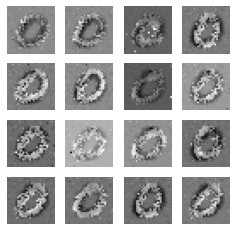

98
gen_loss: tf.Tensor(4.420252, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.053471, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.029933795, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.07317692e-29]
 [1.00000000e+00 3.02899409e-30]
 [1.00000000e+00 3.26851350e-12]
 [1.00000000e+00 4.96895300e-25]
 [1.00000000e+00 2.68070127e-26]
 [1.00000000e+00 2.41485027e-23]
 [1.00000000e+00 5.06359461e-25]
 [1.00000000e+00 1.44254560e-30]
 [1.00000000e+00 3.02001703e-23]
 [1.00000000e+00 2.62223534e-23]
 [1.00000000e+00 1.62198416e-30]
 [1.00000000e+00 1.67871399e-23]
 [9.99996424e-01 3.53367932e-06]
 [1.00000000e+00 2.29589338e-25]
 [1.00000000e+00 1.08166651e-22]
 [1.00000000e+00 4.10813530e-27]
 [1.00000000e+00 1.12991456e-24]
 [1.00000000e+00 2.67816613e-26]
 [1.00000000e+00 9.24479884e-28]
 [1.00000000e+00 4.28773298e-28]
 [9.96950984e-01 3.04902066e-03]
 [1.00000000e+00 2.55245978e-30]
 [1.00000000e+00 5.11384937e-26]
 [1.00000000e+00 2.8

gen_loss: tf.Tensor(4.411065, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.06616462, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.024287045, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 6.55268699e-30]
 [1.00000000e+00 5.27660724e-32]
 [1.00000000e+00 8.74435615e-13]
 [1.00000000e+00 8.83078384e-26]
 [1.00000000e+00 3.36816605e-27]
 [1.00000000e+00 3.55550338e-24]
 [1.00000000e+00 8.84740662e-26]
 [1.00000000e+00 1.54835105e-31]
 [1.00000000e+00 5.14618302e-24]
 [1.00000000e+00 3.91898446e-24]
 [1.00000000e+00 1.95986929e-31]
 [1.00000000e+00 2.84938492e-24]
 [9.99996424e-01 3.58000761e-06]
 [1.00000000e+00 1.47464650e-26]
 [1.00000000e+00 1.39074742e-23]
 [1.00000000e+00 4.22177325e-28]
 [1.00000000e+00 1.80560425e-25]
 [1.00000000e+00 4.34422272e-27]
 [1.00000000e+00 7.04437224e-29]
 [1.00000000e+00 6.51517785e-29]
 [9.95588422e-01 4.41154325e-03]
 [1.00000000e+00 4.75183893e-32]
 [1.00000000e+00 6.86454819e-27]
 [1.00000000e+00 5.07

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.33078788e-30]
 [1.00000000e+00 1.65209413e-32]
 [1.00000000e+00 3.96926578e-13]
 [1.00000000e+00 2.73866683e-26]
 [1.00000000e+00 1.09505295e-27]
 [1.00000000e+00 1.20686449e-24]
 [1.00000000e+00 3.14385199e-26]
 [1.00000000e+00 7.49682454e-32]
 [1.00000000e+00 1.81303862e-24]
 [1.00000000e+00 1.35155707e-24]
 [1.00000000e+00 7.23497260e-32]
 [1.00000000e+00 8.21134783e-25]
 [9.99996185e-01 3.80911320e-06]
 [1.00000000e+00 4.74543823e-27]
 [1.00000000e+00 4.33735763e-24]
 [1.00000000e+00 1.39307496e-28]
 [1.00000000e+00 6.55480057e-26]
 [1.00000000e+00 1.59323190e-27]
 [1.00000000e+00 2.05883807e-29]
 [1.00000000e+00 2.15026512e-29]
 [9.96121585e-01 3.87836294e-03]
 [1.00000000e+00 1.32917731e-32]
 [1.00000000e+00 1.91965045e-27]
 [1.00000000e+00 1.52190884e-27]
 [1.00000000e+00 1.42185197e-28]
 [1.00000000e+00 2.70941946e-23]
 [1.00000000e+00 2.55761691e-29]
 [1.00000000e+00 2.73466068e-24]
 [1.00000000e+00 3.33004868e-09]
 [1.0

gen_loss: tf.Tensor(4.3989115, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.034242034, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027352385, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 9.25392317e-31]
 [1.00000000e+00 5.46897571e-33]
 [1.00000000e+00 1.67073034e-13]
 [1.00000000e+00 2.66056899e-27]
 [1.00000000e+00 7.40104905e-29]
 [1.00000000e+00 8.44019354e-26]
 [1.00000000e+00 3.80519152e-27]
 [1.00000000e+00 1.19855997e-32]
 [1.00000000e+00 3.42004926e-25]
 [1.00000000e+00 9.65504858e-26]
 [1.00000000e+00 5.51292083e-33]
 [1.00000000e+00 7.72550466e-26]
 [9.99997258e-01 2.70578425e-06]
 [1.00000000e+00 4.10448316e-28]
 [1.00000000e+00 7.64485941e-25]
 [1.00000000e+00 1.18285065e-29]
 [1.00000000e+00 7.45705514e-27]
 [1.00000000e+00 1.24653589e-28]
 [1.00000000e+00 4.08183849e-30]
 [1.00000000e+00 1.70669912e-30]
 [9.98189986e-01 1.81001460e-03]
 [1.00000000e+00 2.87489827e-33]
 [1.00000000e+00 1.20868186e-28]
 [1.00000000e+00 1.

gen_loss: tf.Tensor(4.321994, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.043905586, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.030535612, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.73708424e-30]
 [1.00000000e+00 1.50709763e-32]
 [1.00000000e+00 3.83317645e-13]
 [1.00000000e+00 4.11487952e-27]
 [1.00000000e+00 9.90101566e-29]
 [1.00000000e+00 6.23238880e-26]
 [1.00000000e+00 7.74952687e-27]
 [1.00000000e+00 9.89329400e-33]
 [1.00000000e+00 1.01650279e-24]
 [1.00000000e+00 6.44734600e-26]
 [1.00000000e+00 5.52483667e-33]
 [1.00000000e+00 1.08139666e-25]
 [9.99996543e-01 3.45639751e-06]
 [1.00000000e+00 8.04674090e-28]
 [1.00000000e+00 2.31884993e-24]
 [1.00000000e+00 1.58206238e-29]
 [1.00000000e+00 1.31929036e-26]
 [1.00000000e+00 9.20920838e-29]
 [1.00000000e+00 2.11936854e-29]
 [1.00000000e+00 2.06715534e-30]
 [9.98609662e-01 1.39030570e-03]
 [1.00000000e+00 4.12772711e-33]
 [1.00000000e+00 1.68984416e-28]
 [1.00000000e+00 1.7

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.94425863e-30]
 [1.00000000e+00 2.33548555e-32]
 [1.00000000e+00 9.22021574e-13]
 [1.00000000e+00 1.64510594e-26]
 [1.00000000e+00 4.25180235e-28]
 [1.00000000e+00 2.36789666e-25]
 [1.00000000e+00 2.88203491e-26]
 [1.00000000e+00 1.99146846e-32]
 [1.00000000e+00 3.33573186e-24]
 [1.00000000e+00 2.69472839e-25]
 [1.00000000e+00 1.56437418e-32]
 [1.00000000e+00 3.63281294e-25]
 [9.99995828e-01 4.12262852e-06]
 [1.00000000e+00 4.88715509e-27]
 [1.00000000e+00 7.83410113e-24]
 [1.00000000e+00 6.03982283e-29]
 [1.00000000e+00 4.88941412e-26]
 [1.00000000e+00 3.17364751e-28]
 [1.00000000e+00 7.42910865e-29]
 [1.00000000e+00 8.35190730e-30]
 [9.97424245e-01 2.57580657e-03]
 [1.00000000e+00 4.76317915e-33]
 [1.00000000e+00 7.97644879e-28]
 [1.00000000e+00 7.85764010e-28]
 [1.00000000e+00 4.84588229e-29]
 [1.00000000e+00 6.60080112e-24]
 [1.00000000e+00 1.37279038e-29]
 [1.00000000e+00 4.14693528e-25]
 [9.99999881e-01 1.24384869e-07]
 [1.0

 [1.00000000e+00 2.50158251e-30]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.376211, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.01702825, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03581067, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.58553929e-29]
 [1.00000000e+00 8.46628765e-32]
 [1.00000000e+00 4.02109205e-12]
 [1.00000000e+00 3.79200877e-25]
 [1.00000000e+00 1.78754479e-26]
 [1.00000000e+00 7.73884460e-24]
 [1.00000000e+00 5.32747302e-25]
 [1.00000000e+00 3.43026931e-31]
 [1.00000000e+00 3.24428450e-23]
 [1.00000000e+00 1.02437028e-23]
 [1.00000000e+00 4.69438512e-31]
 [1.00000000e+00 3.15622006e-24]
 [9.99994159e-01 5.79299649e-06]
 [1.00000000e+00 2.43449353e-25]
 [1.00000000e+00 7.55908860e-23]
 [1.00000000e+00 1.99887897e-27]
 [1.00000000e+00 8.70858362e-25]
 [1.00000000e+00 1.30267729e-26]
 [1.00000000e+00 6.35688134e-28]
 [1.00000000e+00 3.60787947e-28]
 [9.91045535e-01 8.95447750e-03]
 [1.00000000e+00 1.638

gen_loss: tf.Tensor(4.395159, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.025680965, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02651493, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 1.2489539e-28]
 [1.0000000e+00 1.1935463e-31]
 [1.0000000e+00 4.7221259e-12]
 [1.0000000e+00 7.0276921e-25]
 [1.0000000e+00 4.2484992e-26]
 [1.0000000e+00 1.8264162e-23]
 [1.0000000e+00 8.7167266e-25]
 [1.0000000e+00 9.0578507e-31]
 [1.0000000e+00 4.0067069e-23]
 [1.0000000e+00 2.4230074e-23]
 [1.0000000e+00 1.3037584e-30]
 [1.0000000e+00 3.6068137e-24]
 [9.9999464e-01 5.3827948e-06]
 [1.0000000e+00 5.4356367e-25]
 [1.0000000e+00 9.1760629e-23]
 [1.0000000e+00 4.3885954e-27]
 [1.0000000e+00 1.4770013e-24]
 [1.0000000e+00 3.6116012e-26]
 [1.0000000e+00 7.1990597e-28]
 [1.0000000e+00 8.9564698e-28]
 [9.8983473e-01 1.0165277e-02]
 [1.0000000e+00 2.8758981e-32]
 [1.0000000e+00 7.2167473e-26]
 [1.0000000e+00 5.4646158e-26]
 [1.0000000e+00 2.6910584e-27]
 [1.0

gen_loss: tf.Tensor(4.584733, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03966226, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.023434553, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.01224303e-28]
 [1.00000000e+00 1.93253387e-31]
 [1.00000000e+00 3.29734222e-12]
 [1.00000000e+00 9.23089335e-25]
 [1.00000000e+00 6.76122082e-26]
 [1.00000000e+00 2.80708391e-23]
 [1.00000000e+00 1.08432185e-24]
 [1.00000000e+00 2.90142155e-30]
 [1.00000000e+00 3.52464820e-23]
 [1.00000000e+00 3.59844582e-23]
 [1.00000000e+00 3.44870558e-30]
 [1.00000000e+00 2.18799348e-24]
 [9.99996543e-01 3.50179630e-06]
 [1.00000000e+00 4.76196329e-25]
 [1.00000000e+00 7.08065645e-23]
 [1.00000000e+00 7.49652900e-27]
 [1.00000000e+00 1.87062646e-24]
 [1.00000000e+00 7.24383236e-26]
 [1.00000000e+00 4.81660009e-28]
 [1.00000000e+00 1.51028412e-27]
 [9.95286524e-01 4.71349480e-03]
 [1.00000000e+00 8.24106704e-32]
 [1.00000000e+00 9.32087107e-26]
 [1.00000000e+00 7.70

gen_loss: tf.Tensor(4.418314, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.021452222, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.028580813, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.82333578e-28]
 [1.00000000e+00 1.73555323e-31]
 [1.00000000e+00 3.22442615e-12]
 [1.00000000e+00 1.17428898e-24]
 [1.00000000e+00 6.07493155e-26]
 [1.00000000e+00 2.86024367e-23]
 [1.00000000e+00 1.22729698e-24]
 [1.00000000e+00 4.15321000e-30]
 [1.00000000e+00 4.15343061e-23]
 [1.00000000e+00 4.39121695e-23]
 [1.00000000e+00 3.25976733e-30]
 [1.00000000e+00 3.35561589e-24]
 [9.99997020e-01 3.00664851e-06]
 [1.00000000e+00 3.50985886e-25]
 [1.00000000e+00 8.01376909e-23]
 [1.00000000e+00 7.27137547e-27]
 [1.00000000e+00 2.36167324e-24]
 [1.00000000e+00 6.82314578e-26]
 [1.00000000e+00 4.12654083e-28]
 [1.00000000e+00 1.48301748e-27]
 [9.97044027e-01 2.95596546e-03]
 [1.00000000e+00 7.97144449e-32]
 [1.00000000e+00 8.68754273e-26]
 [1.00000000e+00 9.8

gen_loss: tf.Tensor(4.347058, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.019274635, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03911216, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.0000000e+00 4.4314069e-28]
 [1.0000000e+00 3.9577160e-31]
 [1.0000000e+00 7.9499645e-12]
 [1.0000000e+00 5.0856072e-24]
 [1.0000000e+00 1.3894097e-25]
 [1.0000000e+00 6.8248219e-23]
 [1.0000000e+00 3.8759280e-24]
 [1.0000000e+00 8.1263185e-30]
 [1.0000000e+00 1.7895066e-22]
 [1.0000000e+00 1.9668586e-22]
 [1.0000000e+00 5.7849323e-30]
 [1.0000000e+00 2.3948334e-23]
 [9.9999702e-01 2.9300168e-06]
 [1.0000000e+00 1.5090368e-24]
 [1.0000000e+00 3.3166772e-22]
 [1.0000000e+00 1.5532474e-26]
 [1.0000000e+00 7.3833310e-24]
 [1.0000000e+00 1.9530091e-25]
 [1.0000000e+00 1.4628574e-27]
 [1.0000000e+00 4.3372019e-27]
 [9.9643719e-01 3.5628066e-03]
 [1.0000000e+00 1.1364248e-31]
 [1.0000000e+00 2.7496910e-25]
 [1.0000000e+00 4.1604199e-25]
 [1.0000000e+00 5.2558081e-27]
 [1.0

gen_loss: tf.Tensor(4.438814, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.01879594, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03011046, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.56522578e-28]
 [1.00000000e+00 1.12026304e-30]
 [1.00000000e+00 8.87955681e-12]
 [1.00000000e+00 9.86669276e-24]
 [1.00000000e+00 1.52306041e-25]
 [1.00000000e+00 7.38493967e-23]
 [1.00000000e+00 4.97994282e-24]
 [1.00000000e+00 5.90948056e-30]
 [1.00000000e+00 3.08274472e-22]
 [1.00000000e+00 3.66328097e-22]
 [1.00000000e+00 4.91883147e-30]
 [1.00000000e+00 8.04139121e-23]
 [9.99998450e-01 1.53865892e-06]
 [1.00000000e+00 2.33759859e-24]
 [1.00000000e+00 5.56596980e-22]
 [1.00000000e+00 1.87173089e-26]
 [1.00000000e+00 8.78124382e-24]
 [1.00000000e+00 3.04953461e-25]
 [1.00000000e+00 1.88302369e-27]
 [1.00000000e+00 5.59808786e-27]
 [9.97425318e-01 2.57475069e-03]
 [1.00000000e+00 3.29440614e-31]
 [1.00000000e+00 3.41130622e-25]
 [1.00000000e+00 7.439

gen_loss: tf.Tensor(4.399534, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.013835965, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.035386916, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 5.01030579e-28]
 [1.00000000e+00 3.28550972e-30]
 [1.00000000e+00 5.19766868e-12]
 [1.00000000e+00 9.24361807e-24]
 [1.00000000e+00 8.24939582e-26]
 [1.00000000e+00 4.53494898e-23]
 [1.00000000e+00 3.23066092e-24]
 [1.00000000e+00 4.63720146e-30]
 [1.00000000e+00 2.34321653e-22]
 [1.00000000e+00 2.16598889e-22]
 [1.00000000e+00 3.85465437e-30]
 [1.00000000e+00 7.04813014e-23]
 [9.99999046e-01 9.90189164e-07]
 [1.00000000e+00 1.44851635e-24]
 [1.00000000e+00 4.30902938e-22]
 [1.00000000e+00 1.22330394e-26]
 [1.00000000e+00 5.90873226e-24]
 [1.00000000e+00 2.60709211e-25]
 [1.00000000e+00 1.58564075e-27]
 [1.00000000e+00 3.51249408e-27]
 [9.98485267e-01 1.51474320e-03]
 [1.00000000e+00 1.16752290e-30]
 [1.00000000e+00 1.91744217e-25]
 [1.00000000e+00 6.2

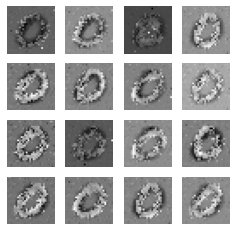

99
gen_loss: tf.Tensor(4.4170074, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.02030299, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.029355085, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.27412726e-28]
 [1.00000000e+00 5.68552049e-30]
 [1.00000000e+00 5.73692309e-12]
 [1.00000000e+00 1.15340126e-23]
 [1.00000000e+00 5.65212183e-26]
 [1.00000000e+00 4.85437075e-23]
 [1.00000000e+00 2.84951528e-24]
 [1.00000000e+00 1.02894936e-29]
 [1.00000000e+00 2.13598239e-22]
 [1.00000000e+00 1.45770843e-22]
 [1.00000000e+00 6.63822838e-30]
 [1.00000000e+00 5.98151068e-23]
 [9.99998450e-01 1.57214879e-06]
 [1.00000000e+00 1.48644626e-24]
 [1.00000000e+00 4.64403551e-22]
 [1.00000000e+00 8.81549828e-27]
 [1.00000000e+00 4.90565421e-24]
 [1.00000000e+00 3.19341100e-25]
 [1.00000000e+00 2.74738163e-27]
 [1.00000000e+00 3.17701635e-27]
 [9.97924328e-01 2.07567774e-03]
 [1.00000000e+00 2.02321743e-30]
 [1.00000000e+00 1.53299290e-25]
 [1.00000000e+00 

 [1.00000000e+00 1.62257460e-27]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.563328, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.014291736, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032097805, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 1.01323377e-27]
 [1.00000000e+00 1.00597302e-29]
 [1.00000000e+00 5.18459884e-12]
 [1.00000000e+00 8.89295994e-24]
 [1.00000000e+00 2.00991343e-26]
 [1.00000000e+00 3.52075122e-23]
 [1.00000000e+00 1.82241345e-24]
 [1.00000000e+00 1.42774844e-29]
 [1.00000000e+00 1.75503502e-22]
 [1.00000000e+00 7.22736502e-23]
 [1.00000000e+00 5.29568857e-30]
 [1.00000000e+00 4.90445932e-23]
 [9.99998093e-01 1.85572151e-06]
 [1.00000000e+00 6.95889210e-25]
 [1.00000000e+00 3.87535556e-22]
 [1.00000000e+00 4.93812829e-27]
 [1.00000000e+00 3.08216554e-24]
 [1.00000000e+00 2.19115805e-25]
 [1.00000000e+00 2.77076820e-27]
 [1.00000000e+00 1.90035706e-27]
 [9.97834146e-01 2.16584560e-03]
 [1.00000000e+00 3.9

gen_loss: tf.Tensor(4.6188755, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0164684, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.020987544, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 8.94892304e-28]
 [1.00000000e+00 1.74556766e-29]
 [1.00000000e+00 4.38067551e-12]
 [1.00000000e+00 5.71947270e-24]
 [1.00000000e+00 8.87109294e-27]
 [1.00000000e+00 2.17468915e-23]
 [1.00000000e+00 1.18210935e-24]
 [1.00000000e+00 1.20354206e-29]
 [1.00000000e+00 1.45312243e-22]
 [1.00000000e+00 3.80486516e-23]
 [1.00000000e+00 3.22358505e-30]
 [1.00000000e+00 3.79408174e-23]
 [9.99998569e-01 1.47202343e-06]
 [1.00000000e+00 3.22931650e-25]
 [1.00000000e+00 3.07990028e-22]
 [1.00000000e+00 3.10041537e-27]
 [1.00000000e+00 1.99725855e-24]
 [1.00000000e+00 1.32164844e-25]
 [1.00000000e+00 2.19736666e-27]
 [1.00000000e+00 1.13070615e-27]
 [9.98518288e-01 1.48169557e-03]
 [1.00000000e+00 7.38804180e-30]
 [1.00000000e+00 2.96685810e-26]
 [1.00000000e+00 2.76

gen_loss: tf.Tensor(4.7285876, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.0470863, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.019973587, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.36711056e-28]
 [1.00000000e+00 2.15685376e-29]
 [1.00000000e+00 5.08092656e-12]
 [1.00000000e+00 5.83241273e-24]
 [1.00000000e+00 6.92895206e-27]
 [1.00000000e+00 2.66090956e-23]
 [1.00000000e+00 1.13150185e-24]
 [1.00000000e+00 1.24228665e-29]
 [1.00000000e+00 1.44330004e-22]
 [1.00000000e+00 3.95785274e-23]
 [1.00000000e+00 2.67685342e-30]
 [1.00000000e+00 4.39009456e-23]
 [9.99998212e-01 1.82948645e-06]
 [1.00000000e+00 2.90496179e-25]
 [1.00000000e+00 3.18373356e-22]
 [1.00000000e+00 3.12061067e-27]
 [1.00000000e+00 1.67362974e-24]
 [1.00000000e+00 1.38526070e-25]
 [1.00000000e+00 1.88823160e-27]
 [1.00000000e+00 1.10250543e-27]
 [9.97865379e-01 2.13464512e-03]
 [1.00000000e+00 9.25954166e-30]
 [1.00000000e+00 2.39012944e-26]
 [1.00000000e+00 2.87

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 7.13383229e-28]
 [1.00000000e+00 1.65923996e-29]
 [1.00000000e+00 6.25049274e-12]
 [1.00000000e+00 8.52498078e-24]
 [1.00000000e+00 1.08439516e-26]
 [1.00000000e+00 4.72537874e-23]
 [1.00000000e+00 1.52564871e-24]
 [1.00000000e+00 1.59337616e-29]
 [1.00000000e+00 1.54579087e-22]
 [1.00000000e+00 6.92442160e-23]
 [1.00000000e+00 3.78338781e-30]
 [1.00000000e+00 5.97904691e-23]
 [9.99997258e-01 2.69505290e-06]
 [1.00000000e+00 5.29337944e-25]
 [1.00000000e+00 3.71168346e-22]
 [1.00000000e+00 4.70003867e-27]
 [1.00000000e+00 2.12061135e-24]
 [1.00000000e+00 2.22754943e-25]
 [1.00000000e+00 1.92848739e-27]
 [1.00000000e+00 1.61948888e-27]
 [9.95900333e-01 4.09965077e-03]
 [1.00000000e+00 6.77452930e-30]
 [1.00000000e+00 3.68126040e-26]
 [1.00000000e+00 4.72281508e-25]
 [1.00000000e+00 6.61414956e-27]
 [1.00000000e+00 3.20781035e-22]
 [1.00000000e+00 2.60292417e-28]
 [1.00000000e+00 1.25517640e-22]
 [1.00000000e+00 4.50714119e-11]
 [1.0

 [1.00000000e+00 4.24814039e-27]], shape=(256, 2), dtype=float32)
gen_loss: tf.Tensor(4.4921274, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.01902813, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.029763434, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.50024110e-27]
 [1.00000000e+00 3.46435857e-29]
 [1.00000000e+00 1.55145896e-11]
 [1.00000000e+00 4.96740411e-23]
 [1.00000000e+00 7.67527456e-26]
 [1.00000000e+00 3.35926963e-22]
 [1.00000000e+00 7.79597154e-24]
 [1.00000000e+00 8.23652228e-29]
 [1.00000000e+00 4.92373252e-22]
 [1.00000000e+00 5.00798993e-22]
 [1.00000000e+00 2.65706712e-29]
 [1.00000000e+00 2.34322562e-22]
 [9.99994159e-01 5.78659137e-06]
 [1.00000000e+00 5.86230267e-24]
 [1.00000000e+00 1.45975699e-21]
 [1.00000000e+00 2.94493794e-26]
 [1.00000000e+00 1.00435025e-23]
 [1.00000000e+00 1.42554798e-24]
 [1.00000000e+00 7.94429462e-27]
 [1.00000000e+00 9.83357412e-27]
 [9.86671269e-01 1.33287339e-02]
 [1.00000000e+00 1.1

gen_loss: tf.Tensor(4.552718, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.03696598, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02338788, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.94054739e-27]
 [1.00000000e+00 4.97417721e-29]
 [1.00000000e+00 1.41503571e-11]
 [1.00000000e+00 3.39332116e-23]
 [1.00000000e+00 5.72509886e-26]
 [1.00000000e+00 2.47529810e-22]
 [1.00000000e+00 5.76815883e-24]
 [1.00000000e+00 8.82019882e-29]
 [1.00000000e+00 3.27066704e-22]
 [1.00000000e+00 2.76650818e-22]
 [1.00000000e+00 2.87876693e-29]
 [1.00000000e+00 1.04428788e-22]
 [9.99993920e-01 6.05535979e-06]
 [1.00000000e+00 5.20450154e-24]
 [1.00000000e+00 1.00537099e-21]
 [1.00000000e+00 2.14013757e-26]
 [1.00000000e+00 7.57516306e-24]
 [1.00000000e+00 9.95610502e-25]
 [1.00000000e+00 8.10967037e-27]
 [1.00000000e+00 6.33364750e-27]
 [9.89305019e-01 1.06950495e-02]
 [1.00000000e+00 1.37833164e-29]
 [1.00000000e+00 1.82215542e-25]
 [1.00000000e+00 2.327

test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.75023803e-27]
 [1.00000000e+00 9.55475211e-29]
 [1.00000000e+00 1.60526627e-11]
 [1.00000000e+00 3.28584738e-23]
 [1.00000000e+00 5.27668320e-26]
 [1.00000000e+00 2.46947896e-22]
 [1.00000000e+00 6.23905593e-24]
 [1.00000000e+00 1.03892461e-28]
 [1.00000000e+00 3.57152042e-22]
 [1.00000000e+00 2.27069888e-22]
 [1.00000000e+00 3.39279312e-29]
 [1.00000000e+00 8.92065621e-23]
 [9.99994636e-01 5.33719867e-06]
 [1.00000000e+00 5.76954486e-24]
 [1.00000000e+00 1.10672263e-21]
 [1.00000000e+00 2.23736730e-26]
 [1.00000000e+00 8.53415681e-24]
 [1.00000000e+00 8.59069131e-25]
 [1.00000000e+00 1.20381476e-26]
 [1.00000000e+00 5.83718936e-27]
 [9.92252767e-01 7.74729997e-03]
 [1.00000000e+00 2.37517432e-29]
 [1.00000000e+00 1.72705207e-25]
 [1.00000000e+00 2.19434598e-24]
 [1.00000000e+00 4.96544522e-26]
 [1.00000000e+00 2.15757845e-21]
 [1.00000000e+00 1.35969980e-27]
 [1.00000000e+00 4.95210021e-22]
 [1.00000000e+00 2.90656197e-11]
 [1.0

gen_loss: tf.Tensor(4.5291643, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.021428023, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.02274678, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.57305402e-27]
 [1.00000000e+00 6.85070253e-29]
 [1.00000000e+00 2.18971976e-11]
 [1.00000000e+00 2.22964293e-23]
 [1.00000000e+00 2.38210124e-26]
 [1.00000000e+00 1.60828821e-22]
 [1.00000000e+00 4.24192834e-24]
 [1.00000000e+00 5.38571804e-29]
 [1.00000000e+00 2.51441272e-22]
 [1.00000000e+00 1.15337106e-22]
 [1.00000000e+00 2.11094486e-29]
 [1.00000000e+00 6.17192529e-23]
 [9.99995947e-01 4.05252513e-06]
 [1.00000000e+00 3.88841215e-24]
 [1.00000000e+00 8.29244828e-22]
 [1.00000000e+00 1.15142569e-26]
 [1.00000000e+00 6.82981888e-24]
 [1.00000000e+00 3.75265176e-25]
 [1.00000000e+00 1.31801278e-26]
 [1.00000000e+00 3.10586055e-27]
 [9.93900299e-01 6.09972700e-03]
 [1.00000000e+00 1.46257693e-29]
 [1.00000000e+00 1.01552942e-25]
 [1.00000000e+00 1.4

gen_loss: tf.Tensor(4.367349, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.024859775, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.027271373, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 4.62348372e-27]
 [1.00000000e+00 3.09946617e-29]
 [1.00000000e+00 3.78294791e-11]
 [1.00000000e+00 2.44899864e-23]
 [1.00000000e+00 1.49426772e-26]
 [1.00000000e+00 1.54034015e-22]
 [1.00000000e+00 3.90951773e-24]
 [1.00000000e+00 4.54593374e-29]
 [1.00000000e+00 2.41956337e-22]
 [1.00000000e+00 1.00479915e-22]
 [1.00000000e+00 1.85994849e-29]
 [1.00000000e+00 7.86968901e-23]
 [9.99995947e-01 4.03781542e-06]
 [1.00000000e+00 3.59897948e-24]
 [1.00000000e+00 8.67725993e-22]
 [1.00000000e+00 7.14165022e-27]
 [1.00000000e+00 7.40295946e-24]
 [1.00000000e+00 2.71763568e-25]
 [1.00000000e+00 1.65946398e-26]
 [1.00000000e+00 2.65085383e-27]
 [9.93060827e-01 6.93923002e-03]
 [1.00000000e+00 5.56424897e-30]
 [1.00000000e+00 9.65954324e-26]
 [1.00000000e+00 1.5

gen_loss: tf.Tensor(4.2232075, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.020888926, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.030847577, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.33648948e-27]
 [1.00000000e+00 1.08233546e-29]
 [1.00000000e+00 2.26156992e-11]
 [1.00000000e+00 1.02191929e-23]
 [1.00000000e+00 3.41794595e-27]
 [1.00000000e+00 4.31068750e-23]
 [1.00000000e+00 1.58873717e-24]
 [1.00000000e+00 2.45877322e-29]
 [1.00000000e+00 9.64729555e-23]
 [1.00000000e+00 2.73597693e-23]
 [1.00000000e+00 7.32009635e-30]
 [1.00000000e+00 3.78045812e-23]
 [9.99996424e-01 3.55086399e-06]
 [1.00000000e+00 7.05982833e-25]
 [1.00000000e+00 3.48261668e-22]
 [1.00000000e+00 1.71631866e-27]
 [1.00000000e+00 2.74233886e-24]
 [1.00000000e+00 7.50666356e-26]
 [1.00000000e+00 7.14222261e-27]
 [1.00000000e+00 7.28244764e-28]
 [9.95935798e-01 4.06417344e-03]
 [1.00000000e+00 2.04332158e-30]
 [1.00000000e+00 2.88942123e-26]
 [1.00000000e+00 5.

gen_loss: tf.Tensor(4.4146843, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.016682962, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.03034108, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 2.73650359e-27]
 [1.00000000e+00 1.83769045e-29]
 [1.00000000e+00 1.08381620e-11]
 [1.00000000e+00 5.69015942e-24]
 [1.00000000e+00 1.61231999e-27]
 [1.00000000e+00 1.59186830e-23]
 [1.00000000e+00 1.06817496e-24]
 [1.00000000e+00 4.19328153e-29]
 [1.00000000e+00 5.94243808e-23]
 [1.00000000e+00 1.06171212e-23]
 [1.00000000e+00 7.11048671e-30]
 [1.00000000e+00 1.73836971e-23]
 [9.99996662e-01 3.30339094e-06]
 [1.00000000e+00 2.60053643e-25]
 [1.00000000e+00 2.03205887e-22]
 [1.00000000e+00 8.55826452e-28]
 [1.00000000e+00 1.62851134e-24]
 [1.00000000e+00 3.65509364e-26]
 [1.00000000e+00 6.16809995e-27]
 [1.00000000e+00 3.30313163e-28]
 [9.98731792e-01 1.26818370e-03]
 [1.00000000e+00 3.70167158e-30]
 [1.00000000e+00 1.39966019e-26]
 [1.00000000e+00 2.8

gen_loss: tf.Tensor(4.3117886, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.028406197, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.032375567, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.31984601e-27]
 [1.00000000e+00 2.66130747e-29]
 [1.00000000e+00 7.69806874e-12]
 [1.00000000e+00 6.15020614e-24]
 [1.00000000e+00 1.67799343e-27]
 [1.00000000e+00 1.09317283e-23]
 [1.00000000e+00 1.27262828e-24]
 [1.00000000e+00 7.89016544e-29]
 [1.00000000e+00 6.17331495e-23]
 [1.00000000e+00 7.32168233e-24]
 [1.00000000e+00 1.03945922e-29]
 [1.00000000e+00 1.43774917e-23]
 [9.99995232e-01 4.77259346e-06]
 [1.00000000e+00 2.20783802e-25]
 [1.00000000e+00 1.99315060e-22]
 [1.00000000e+00 8.21343447e-28]
 [1.00000000e+00 1.74498616e-24]
 [1.00000000e+00 3.14488367e-26]
 [1.00000000e+00 9.21209887e-27]
 [1.00000000e+00 2.90942677e-28]
 [9.98936832e-01 1.06320903e-03]
 [1.00000000e+00 5.06244228e-30]
 [1.00000000e+00 1.36552747e-26]
 [1.00000000e+00 2.

gen_loss: tf.Tensor(4.5019255, shape=(), dtype=float32)
disc_real_loss: tf.Tensor(0.026371635, shape=(), dtype=float32)
disc_fake_loss: tf.Tensor(0.022235755, shape=(), dtype=float32)
test_discriminator_output: tf.Tensor(
[[1.00000000e+00 3.13870979e-27]
 [1.00000000e+00 1.63735883e-29]
 [1.00000000e+00 1.13520374e-11]
 [1.00000000e+00 1.45539631e-23]
 [1.00000000e+00 4.55312334e-27]
 [1.00000000e+00 2.58266481e-23]
 [1.00000000e+00 2.32404812e-24]
 [1.00000000e+00 1.35268905e-28]
 [1.00000000e+00 8.13608734e-23]
 [1.00000000e+00 1.42128628e-23]
 [1.00000000e+00 2.16903211e-29]
 [1.00000000e+00 2.84534555e-23]
 [9.99991417e-01 8.63438163e-06]
 [1.00000000e+00 7.94860784e-25]
 [1.00000000e+00 2.84056443e-22]
 [1.00000000e+00 1.74340667e-27]
 [1.00000000e+00 2.95515933e-24]
 [1.00000000e+00 8.16000802e-26]
 [1.00000000e+00 1.43303794e-26]
 [1.00000000e+00 7.05548257e-28]
 [9.94368494e-01 5.63154696e-03]
 [1.00000000e+00 2.49675846e-30]
 [1.00000000e+00 3.27484265e-26]
 [1.00000000e+00 8.

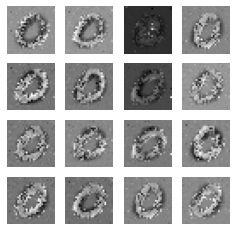

In [21]:
seed = tf.random.normal([generate_show_num, noise_dim])
train(datasets_0, epochs)

## 检验

In [22]:
plt.imshow(generator((tf.random.normal([BATCH_SIZE, noise_dim])+1)/2))

<tf.Tensor: shape=(256, 28, 28, 1), dtype=float32, numpy=
array([[[[ 3.79171371e-02],
         [-9.23047066e-02],
         [-1.53732300e-03],
         ...,
         [-2.49463826e-01],
         [ 6.20603561e-02],
         [-1.54557645e-01]],

        [[-5.71231842e-02],
         [-1.05683371e-01],
         [ 4.25338745e-04],
         ...,
         [ 1.22184753e-01],
         [ 4.57558751e-01],
         [ 6.64780140e-02]],

        [[-2.90958852e-01],
         [-9.28502083e-02],
         [-9.59396362e-04],
         ...,
         [-6.98080063e-02],
         [ 1.17950439e-02],
         [ 5.40164232e-01]],

        ...,

        [[ 9.05308723e-02],
         [ 1.60547018e-01],
         [ 1.52785063e-01],
         ...,
         [ 1.44252777e-02],
         [-2.72979736e-02],
         [ 7.63702393e-03]],

        [[-4.52041626e-04],
         [ 3.23405266e-02],
         [-2.75406927e-01],
         ...,
         [-2.61383057e-02],
         [-1.73460245e-01],
         [-8.29696655e-03]],

        